### RNN with LSTM cell
* Architecture reference from https://arxiv.org/pdf/2004.00959.pdf
* Country-specific network

(Something new: Maybe decrease number of classifier by grouping countries in the same GDP/ bracket)

#### Data partition
* Test data is the last 10 days
* Validation 10 days before last 10 days
* Data logged

In [1]:
import torch
import pandas as pd
import numpy as np
import os
import copy
#import writer
import random
from sklearn.preprocessing import normalize
#import 
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Assuming that we are on a CUDA machine, this should print a CUDA device:

print(device)

cuda:0


In [2]:
# read data in
csse_country = "CPSC540_Covid/active_data/csse_world_normalized.csv"
df_csse = pd.read_csv(csse_country)
df_csse.head(10)
#list(df_csse.columns.values.tolist()) 
countries = df_csse["Country/Region"].tolist()

In [3]:
countries
df_csse.shape

(171, 81)

#### What if use grouping from k-means? or hierarchical clustering to decide which countries are in the same bracket


In [4]:
validation_d = 5
test_d = 5

# Convert to numpy array

cases = df_csse.loc[:,'1/22/20':]
casesA = cases.to_numpy()
casesA
count, days = casesA.shape

print(days)
# last 10 days for test

case_test = casesA[:,-test_d:]
case_validation = casesA[:,days-validation_d-test_d:days-test_d]
case_train = casesA[:,:days-validation_d-test_d]

print(case_test.shape)
print(case_validation.shape)
print(case_train.shape)

79
(171, 5)
(171, 5)
(171, 69)


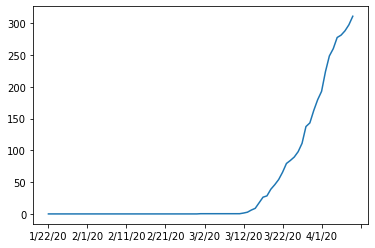

In [5]:
# plot 
#epoch = np.linspace(1, len(trainErr), len(trainErr))

cases.loc[50,:].plot.line()


In [6]:
case_train

array([[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        1.41700405e+01, 1.82186235e+01, 1.82186235e+01],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        1.69184222e+00, 3.38368444e+00, 3.38368444e+00],
       ...,
       [3.02112385e-03, 3.02112385e-03, 6.04224770e-03, ...,
        3.66960808e+02, 4.25703540e+02, 4.88911494e+02],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        1.91862032e+05, 1.91862032e+05, 1.91862032e+05],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        9.77039570e+02, 9.77039570e+02, 9.77039570e+02]])

In [7]:
# log transform
case_test_log = np.log(case_test)
case_validation_log = np.log(case_validation)
case_train_log = np.log(case_train)
case_train_log

/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in log
  
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in log
  This is separate from the ipykernel package so we can avoid doing imports until
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log
  after removing the cwd from sys.path.


array([[       -inf,        -inf,        -inf, ...,        -inf,
               -inf,        -inf],
       [       -inf,        -inf,        -inf, ...,  2.65112991,
         2.90244434,  2.90244434],
       [       -inf,        -inf,        -inf, ...,  0.52581801,
         1.21896519,  1.21896519],
       ...,
       [-5.80212638, -5.80212638, -5.1089792 , ...,  5.90525505,
         6.05374319,  6.19218148],
       [       -inf,        -inf,        -inf, ..., 12.16453181,
        12.16453181, 12.16453181],
       [       -inf,        -inf,        -inf, ...,  6.88452715,
         6.88452715,  6.88452715]])

### Divide data into training sets
* specify number of days for train and prediction
* offset the dataset so for example: [1,2,3,4] then get [1,2],[2,3] which predicts 3 and 4 respectively

In [8]:
# test 
np.array(case_train[3,:])
#total_days-pred_days-t_days

array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.00869841, 0.00869841, 0.00869841, 0.04349203,
       0.04349203, 0.05219044, 0.05219044, 0.07828566, 0.07828566,
       0.09568248, 0.09568248, 0.10438088, 0.10438088, 0.10438088,
       0.13917451, 0.13917451, 0.18266655, 0.20006336])

In [9]:
t_days = 40
pred_days = test_d
total_days = case_train.shape[1]

country_train_X = []
country_train_Y = []

country_valid_X = []
country_valid_Y = []

country_test_X = []
country_test_Y = []


for i in range(len(countries)):
    # split dataset
    cur_c = [] # current country 
    out = []
    
    cur_v = [] # current country 
    out_v = []
    
    cur_t = [] # current country 
    out_t = []
    
    for j in range(total_days-pred_days-t_days): 
        
        #print(j)
        #print(case_train[i,j:j+t_days].shape)
        #print(len(case_train[i,j+t_days]))
        cur_c.append(case_train[i,j:j+t_days])
        #print(str(j))
        out.append(case_train[i,j+t_days:j+t_days+pred_days])
        #print(len(cur_c))
    
    country_train_X.append(cur_c)
    country_train_Y.append(out)
    
    country_valid_X.append(case_train[i,-t_days:])
    country_valid_Y.append(case_validation[i])
    
    country_test_X.append(casesA[i,days-test_d-t_days:days-test_d])
    country_test_Y.append(case_test[i])


In [10]:
# check dimension

#len(country_test_X[33])
total_days-pred_days-test_d
pred_days
test_d
total_days
case_train[0,29:64].shape
case_train[0,0:40].shape

(40,)

In [11]:
len(country_train_X[1])
len(country_train_Y[1])
len(country_train_Y[1][0])
#len(country_test_Y[1])
#a = torch.tensor(country_train_X[10]).unsqueeze_(1).unsqueeze_(1)
#torch.max(torch.tensor(country_train_X[2])).item()
#torch.randn(a.shape[0],a.shape[1],a.shape[2])*0.05
#a+a

5

#### Data size & index
The first axis is the sequence itself, the second indexes instances in the mini-batch, and the third indexes elements of the input. We haven’t discussed mini-batching, so lets just ignore that and assume we will always have just 1 dimension on the second axis.

In [12]:
#import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

torch.manual_seed(1)

### Optimized hyperparameters
|Parameter |Description|Distribution/Selection|Values|
|----------|------------|----------------------|---------|
|Learning rate|Minimum learning rate| Log uniform|1e-1 to 1e-7|
|Hidden layers|Number of layers in the network|Discrete numeric|1 to 20|
|Hidden state|Number of memory cell in each layer|Discrete numeric|1 to 200|
|Activation|Activation in each layer|Category|{ReLu,sigmoid,tanh}|
|Batch size|Batch size during training|Discrete numeric|1 to 10|
|Dropout|Dropout size before dense layer|Log uniform|0 to 0.|

In [13]:
# Parameter
num_epochs = 30 # max
batch_size = 1
# Loss and optimizer
criterion = torch.nn.MSELoss()
#optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
learning_rate = 0.01 # to be changed/optimized 
#optimizer = torch.optim.SGD(model.parameters(), lr = learning_rate, momentum=0.9)
output_directory = "mock/"
output_file_path = "mock/Train"
input_dim = t_days
hidden_dim = 2
hidden_state = 100
output_dim= pred_days
num_layers=2
lstm_input_size = t_days
#model = LSTM(lstm_input_size, hidden_dim, batch_size=batch_size, output_dim=output_dim, num_layers=num_layers)

model_name = "mock"
output_file_path = "./outputs/" + model_name + "/training/"
directory = os.path.dirname(output_file_path)
if not os.path.exists(directory):
    print("Creating directory %s" % output_file_path)
    os.makedirs(directory)
else:
     print("Directory %s exists" % output_file_path)


Directory ./outputs/mock/training/ exists


In [14]:
# RNN structure

class RNN(nn.Module):

    # you can also accept arguments in your model constructor
    def __init__(self, data_size, hidden_size, output_size):
        super(RNN, self).__init__()

        self.hidden_size = hidden_size
        input_size = data_size + hidden_size

        self.i2h = nn.Linear(input_size, hidden_size)
        self.h2o = nn.Linear(hidden_size, output_size)

    def forward(self, data, last_hidden):
        input = torch.cat((data, last_hidden), 1)
        hidden = self.i2h(input)
        output = self.h2o(hidden)
        return hidden, output
    
    def initHidden(self):
        return torch.zeros(1, self.hidden_size)


In [15]:
# LSTM structure

class LSTM(nn.Module):
 
    def __init__(self, input_dim, hidden_dim, batch_size, output_dim=pred_days,
                    num_layers=2):
        super(LSTM, self).__init__()
        self.input_dim = input_dim
        self.hidden_dim = hidden_dim
        self.batch_size = batch_size
        self.num_layers = num_layers
 
        # Define the LSTM layer
        self.lstm = nn.LSTM(self.input_dim, self.hidden_dim, self.num_layers,dropout=0)
 
        # Define the output layer
        self.linear = nn.Linear(self.hidden_dim, output_dim)
 
    def init_hidden(self):
        # This is what we'll initialise our hidden state as
        return (torch.zeros(self.num_layers, self.batch_size, self.hidden_dim),
                torch.zeros(self.num_layers, self.batch_size, self.hidden_dim))
 
    def forward(self, input):
        # Forward pass through LSTM layer
        # shape of lstm_out: [input_size, batch_size, hidden_dim]
        # shape of self.hidden: (a, b), where a and b both 
        # have shape (num_layers, batch_size, hidden_dim).
        lstm_out, self.hidden = self.lstm(input.view(len(input), self.batch_size, -1))
        
        # Only take the output from the final timetep
        # Can pass on the entirety of lstm_out to the next layer if it is a seq2seq prediction
        y_pred = self.linear(lstm_out[-1].view(self.batch_size, -1))
        
        return y_pred.view(-1)

#model = LSTM(lstm_input_size, h1, batch_size=num_train, output_dim=output_dim, num_layers=num_layers)

In [16]:
# training function
def train_model(train_loader, test_loader, model, device, criterion, optimizer, num_epochs, output_directory,learning_rate,hidden_dim,num_layers):
    
    total_step = len(train_loader)
    model.train()
    model.hidden = model.init_hidden() # LSTM hidden reinitialization
    
    #open files to log error
    train_error = open(output_directory + "training_error"+ "_"+str(learning_rate)+ "_"+ str(hidden_dim) + "_"+ str(num_layers) +".txt", "a")
    test_error = open(output_directory + "validation_error"+ "_"+str(learning_rate)+ "_"+ str(hidden_dim) + "_"+ str(num_layers) +".txt", "a")

    #best_model_wts = copy.deepcopy(model.state_dict())
    best_loss_valid = float('inf')
    best_epoch = 1

    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        for i, (seqs, labels) in enumerate(train_loader):
            #print(seqs.shape)
            # add gaussian noise to sequence
            noiselevel = torch.max(torch.tensor(country_train_X[2])).item()/1000
            noise = torch.randn(seqs.shape[0],seqs.shape[1],seqs.shape[2],seqs.shape[3])*noiselevel
            #print(noise.shape)
            seqs += noise # add gaussian noise
            #print(seqs.shape)
            seqs = seqs.to(device)
            labels = labels.to(device)

            # Forward pass
            #seqs = seqs.squeeze()
            #print(seqs.shape)
            #print(model(seqs))
            outputs = model(seqs) # error 
            loss = criterion(outputs, labels) # change input to 
            running_loss += loss.item()
        
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            #if (i+1) % 100 == 0:
            #    print ('Epoch [{}/{}], Step [{}/{}], Loss: {:.4f}'
            #           .format(epoch+1, num_epochs, i+1, total_step, loss.item()))

        #save training loss to file
        epoch_loss = running_loss / len(train_loader.dataset)
        print("%s, %s" % (epoch, epoch_loss), file=train_error)
        
        #calculate test loss for epoch
        test_loss = 0.0
        with torch.no_grad():
            model.eval()
            for i, (seqs, labels) in enumerate(test_loader):
                x = seqs.to(device)
                y = labels.to(device)
                outputs = model(x)
                #print(outputs.shape)
                #print(y.shape)
                loss = criterion(outputs, y)
                test_loss += loss.item() 
                
                # for metrics
                #updateYlist(outputs,y)
                

        test_loss = test_loss / len(test_loader.dataset)
        
        #save outputs for epoch
        print("%s, %s" % (epoch, test_loss), file=test_error)
        
        # for each epoch, calculate metrics (f1, pr)
        #calculateMetrics(outputs,y)
        
        if test_loss < best_loss_valid:
            best_loss_valid = test_loss
            best_epoch = epoch
            best_model_wts = copy.deepcopy(model.state_dict())
            print ('Saving the best model weights at Epoch [{}], Best Valid Loss: {:.4f}' 
                       .format(epoch+1, best_loss_valid))

        
    train_error.close()
    test_error.close()

    #model.load_state_dict(best_model_wts)
    print("train error:", epoch_loss)
    return model, best_loss_valid


In [17]:
def test_model(test_loader, model, device,criterion):
    #predictions = torch.zeros(0, numClass)
    test_loss = 0.0
    
    with torch.no_grad():
        model.eval()
        for i, (seqs, labels) in enumerate(test_loader):            
            seqs = seqs.to(device)
            y = labels.to(device).float()
            print(y)
            pred = model(seqs).float()
            print(pred)
            loss = criterion(pred, y)
            test_loss += loss.item() 
            
    return pred,test_loss

In [18]:
#dimension check
a = torch.tensor(country_train_X[0]).unsqueeze_(2).unsqueeze_(2) #torch.Size([19, 30, 1, 1])
torch.tensor(country_valid_X[0]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).shape
torch.tensor(country_valid_Y[0]).unsqueeze_(0).shape
#torch.tensor(country_train_Y[0])
torch.tensor(country_train_X[0])
a.size(-1)
torch.tensor(country_test_Y[0]).unsqueeze_(0).shape
torch.tensor(country_valid_Y[0]).unsqueeze_(0).shape
torch.tensor(country_train_Y[0]).unsqueeze_(1).shape
#torch.tensor(country_valid_Y[0]).unsqueeze_(0).unsqueeze_(0).shape
torch.tensor(country_train_Y[0]).unsqueeze_(1).shape
torch.tensor(country_valid_Y[0]).unsqueeze_(0).shape
torch.tensor(country_valid_X[0]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).shape
torch.tensor(country_train_X[0]).unsqueeze_(2).unsqueeze_(2).shape
torch.tensor(country_valid_X[0]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).shape

torch.Size([1, 40, 1, 1])

In [19]:
# test if it runs
learning_rate = 0.01 # to be changed/optimized 
num_layers = 2
hidden_dim = 100

net =  LSTM(lstm_input_size, hidden_dim, batch_size=batch_size, output_dim=output_dim, num_layers=num_layers)
print(net)
model = net.to(device)
optimizer = torch.optim.SGD(model.parameters(), lr = learning_rate, momentum=0.9)

train_dataset = torch.utils.data.TensorDataset(torch.tensor(country_train_X[0]).unsqueeze_(2).unsqueeze_(2).float(), torch.tensor(country_train_Y[0]).unsqueeze_(1).float())
train_loader = torch.utils.data.DataLoader(dataset=train_dataset, batch_size=batch_size, shuffle=True)

# load validation
valid_dataset = torch.utils.data.TensorDataset(torch.tensor(country_valid_X[0]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).float(), torch.tensor(country_valid_Y[0]).unsqueeze_(0).float())
valid_loader = torch.utils.data.DataLoader(dataset=valid_dataset, batch_size=batch_size, shuffle=False)

# load test
test_dataset = torch.utils.data.TensorDataset(torch.tensor(country_test_X[0]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).float(), torch.tensor(country_test_Y[0]).unsqueeze_(0).float())
test_loader = torch.utils.data.DataLoader(dataset=test_dataset, batch_size=batch_size, shuffle=False)


# mock trial
err = train_model(train_loader, valid_loader, model, device, criterion,  optimizer, num_epochs, output_file_path,learning_rate,hidden_dim, num_layers)



LSTM(
  (lstm): LSTM(40, 100, num_layers=2)
  (linear): Linear(in_features=100, out_features=5, bias=True)
)


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [1], Best Valid Loss: 0.0484
train error: 6.7692523542930635e-12


In [20]:
torch.tensor(country_train_Y[0]).unsqueeze_(0).shape


torch.Size([1, 24, 5])

In [ ]:
# optimization grid
lr_list = [0.1,0.01,0.001,0.005,1e-4,5e-4,1e-5,1e-6]
hidden_lst = [1,2,3,4,5]
hState_lst = [30,50,100,200,300]

country_result = dict()
#optimizer = torch.optim.SGD(model.parameters(), lr = learning_rate, momentum=0.9)
best_error = 1e10

for i in range(len(countries)):
    country_result[countries[i]] = [] # store best validation parameter, test loss, test result
    best_error = 1e10
    
    best_param = [0,0,0]

    learning_rate = lr_list[0] # to be changed/optimized 
    hidden_dim = hidden_lst[0]
    hidden_state = hState_lst[0]
    
    
    model_name = countries[i]
    output_file_path = "./outputs/" + model_name + "/training/"
    directory = os.path.dirname(output_file_path)
    if not os.path.exists(directory):
        print("Creating directory %s" % output_file_path)
        os.makedirs(directory)
    else:
         print("Directory %s exists" % output_file_path)

    
    train_dataset = torch.utils.data.TensorDataset(torch.tensor(country_train_X[i]).unsqueeze_(2).unsqueeze_(2).float(), torch.tensor(country_train_Y[i]).unsqueeze_(1).float())
    train_loader = torch.utils.data.DataLoader(dataset=train_dataset, batch_size=batch_size, shuffle=True)

    # load validation
    valid_dataset = torch.utils.data.TensorDataset(torch.tensor(country_valid_X[i]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).float(), torch.tensor(country_valid_Y[i]).unsqueeze_(0).float())
    valid_loader = torch.utils.data.DataLoader(dataset=valid_dataset, batch_size=batch_size, shuffle=False)

    # load test
    test_dataset = torch.utils.data.TensorDataset(torch.tensor(country_test_X[i]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).float(), torch.tensor(country_test_Y[i]).unsqueeze_(0).float())
    test_loader = torch.utils.data.DataLoader(dataset=test_dataset, batch_size=batch_size, shuffle=False)
    
    bestmodel = 0
    
    # optimize (learning rate, hidden layer, hidden state, activation)
    for j in range(len(lr_list)):
        for k in range(len(hidden_lst)): # hidden layer
            for m in range(len(hState_lst)): # hidden state
                # train
                # specific parameters
                learning_rate = lr_list[j]
                hidden_dim = hState_lst[m]
                num_layers = hidden_lst[k]
                
                net =  LSTM(lstm_input_size, hidden_dim, batch_size=batch_size, output_dim=output_dim, num_layers=num_layers)
                #print(net)
                model = net.to(device)
                
                #
                optimizer = torch.optim.SGD(model.parameters(), lr = learning_rate, momentum=0.9)
                # to be changed/optimized 
                
                model, err = train_model(train_loader, valid_loader, model, device, criterion,  optimizer, num_epochs, output_file_path,learning_rate,hidden_dim,num_layers)
                print(err)
                if err < best_error:
                    best_error = err
                    best_param = [lr_list[j],hidden_lst[k],hState_lst[m]]
                    bestmodel = model
    
    country_result[countries[i]].append(best_param)
    
    # test data
    pred,final_loss = test_model(test_loader,bestmodel,device,criterion)
    print("test loss: ",final_loss)
    country_result[countries[i]].append([pred.tolist(),country_test_Y[i].tolist()])
    country_result[countries[i]].append(final_loss)
    torch.save(bestmodel.state_dict(), output_file_path+countries[i]+".th")

Directory ./outputs/Burundi/training/ exists
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0477
train error: 1.2224617261756092e-09
0.04767756909132004
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0494
train error: 3.541498357594042e-10
0.049432095140218735
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0493
train error: 2.5686448685650437e-10
0.049295779317617416
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0487
train error: 1.1491109431181756e-10
0.04872298240661621
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0494
train error: 8.300809974277901e-11
0.0493806600570

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0489
train error: 3.914692726149739e-17
0.04894004389643669
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0467
train error: 3.313604262530599e-17
0.04665930196642876
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0510
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0494
train error: 2.6179417088225853e-17
0.04944324493408203
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0464
train error: 1.771061195445542e-17
0.0464303158223629
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0623
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0604
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0573
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0561
Saving the best model weights at

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0508
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0506
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0505
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0503
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0498
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0496
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0495
Saving the best model weights at E

Saving the best model weights at Epoch [68], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0495
Saving the best model weights at E

Saving the best model weights at Epoch [85], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0495
Saving the best model weights at E

Saving the best model weights at Epoch [95], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0495
train error: 3.1722979007119817e-12
0.049508821219205856
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0741
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0684
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0661
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0641
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0609
Saving the best model weights at Epoch [8], Best Val

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0524
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0516
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0514
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0510
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0508
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0507
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0506
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0503
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0503
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0502
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0496
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0495
Saving the best model weights at E

Saving the best model weights at Epoch [62], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0495
Saving the best model weights at E

Saving the best model weights at Epoch [82], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0495
train error: 2.3518571711072154e-12
0.0495082326233387
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0448
train error: 2.759431974188517e-13
0.04483025148510933
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0478
train error: 5.006396185562473e-13
0.047771479934453964
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0475
train error: 8.459216093807213e-10
0.04747023060917854
Saving the best model we

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0495
Saving the best model weights at Epoc

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0495
train error: 2.537012133888433e-16
0.0495082326233387
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0530
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0503
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [6], Best Valid

Saving the best model weights at Epoch [88], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0586
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0585
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0584
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0583
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0579
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0577
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0576
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0575
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0574
train error: 0.0017328808559492852
0.057415544986724854
Saving the best model weights at Epoch [1], Be

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0581
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0579
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0577
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0576
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0575
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0574
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0573
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0572
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0571
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0570
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0568
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0511
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0511
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0511
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0510
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0510
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0510
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0508
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0508
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0508
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0508
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0514
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0514
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0514
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0514
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0513
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0513
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0513
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0513
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0513
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0512
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0479
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0479
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0479
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0479
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0479
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0479
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0479
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0478
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0478
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0478
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0478
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0478
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0478
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0478
Saving the best model weights at E

train error: 0.0004393177769088652
0.032824140042066574
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0443
train error: 0.0001646349525496286
0.044297732412815094
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1317
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1307
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1296
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1286
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1275
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1265
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1256
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1246
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1236
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1227
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1217
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1208
S

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0581
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0577
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0576
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0575
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0574
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0573
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0572
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0570
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0568
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0567
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0558
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0556
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0554
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0552
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0551
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0551
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0550
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0549
Saving the best model weights at E

Saving the best model weights at Epoch [59], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0499
Saving the best model weights at E

Saving the best model weights at Epoch [81], Best Valid Loss: 0.0531
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0530
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0530
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0529
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0529
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0529
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0527
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0527
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0527
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0526
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0526
Saving the best model weights at E

Saving the best model weights at Epoch [100], Best Valid Loss: 0.0481
train error: 0.0018111430836142972
0.04813796281814575
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0447
train error: 0.0006268280097477449
0.04469873011112213
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0601
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0598
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0597
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0596
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0595
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0594
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0593
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0591
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0590
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0589
Sa

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0538
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0538
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0537
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0536
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0536
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0532
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0505
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0505
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0505
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0503
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0503
Saving the best model weights at E

Saving the best model weights at Epoch [57], Best Valid Loss: 0.0547
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0545
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0538
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0537
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0536
Saving the best model weights at E

Saving the best model weights at Epoch [77], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0538
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0538
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0537
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0537
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0536
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0536
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0536
Saving the best model weights at E

Saving the best model weights at Epoch [96], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0517
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0517
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0517
train error: 0.0005724851653212681
0.05169117450714111
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0614
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0611
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0610
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0609
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0608
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0606
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0605
Saving the best model weights at Epoch [9], Best Valid 

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0496
Saving the best model weights at E

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0538
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0531
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0529
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0527
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0522
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0520
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0496
Saving the best model weights at E

Saving the best model weights at Epoch [53], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0496
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0495
Saving the best model weights at E

Saving the best model weights at Epoch [93], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0495
train error: 5.640715997993576e-08
0.04954889789223671
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0579
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0574
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0561
Saving the best model weights at Epoch [6], Best Val

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0507
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0506
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0506
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0505
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0503
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0503
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0501
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0537
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0531
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0529
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0527
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0522
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0518
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0513
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0511
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0510
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0508
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0507
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0507
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0506
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0505
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0505
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0504
Saving the best model weights at E

Saving the best model weights at Epoch [61], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0497
Saving the best model weights at E

Saving the best model weights at Epoch [81], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0495
Saving the best model weights at E

Saving the best model weights at Epoch [63], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0496
Saving the best model weights at E

Saving the best model weights at Epoch [86], Best Valid Loss: 0.0880
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0880
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0879
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0879
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0878
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0878
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0877
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0877
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0876
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0876
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0875
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0875
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0875
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0874
Saving the best model weights at E

train error: 0.0011219966302936275
0.04255983978509903
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [14], Best Valid L

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0586
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0585
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0585
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0585
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0585
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0585
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0584
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0584
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0584
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0584
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0584
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0583
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0583
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0583
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0576
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0576
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0576
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0576
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0575
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0575
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0575
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0575
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0575
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0575
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0575
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0575
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0574
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0574
Saving the best model weights at E

Saving the best model weights at Epoch [64], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0527
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0527
Saving the best model weights at E

Saving the best model weights at Epoch [84], Best Valid Loss: 0.0516
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0516
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0516
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0516
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0516
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0516
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0515
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0678
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0678
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0677
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0677
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0677
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0676
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0676
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0676
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0676
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0674
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0495
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0534
Saving the best model weights at E

Saving the best model weights at Epoch [63], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0542
Saving the best model weights at E

Saving the best model weights at Epoch [85], Best Valid Loss: 0.0755
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0755
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0754
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0754
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0754
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0753
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0753
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0752
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0752
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0752
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0750
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0651
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0650
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0650
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0650
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0650
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0649
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0649
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0649
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0649
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0649
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0648
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0648
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0648
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0648
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0556
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0556
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0600
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0600
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0600
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0600
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0598
Saving the best model weights at E

Saving the best model weights at Epoch [65], Best Valid Loss: 0.0788
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0788
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0787
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0787
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0785
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0785
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0784
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0784
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0784
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0783
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0783
Saving the best model weights at E

Saving the best model weights at Epoch [85], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0629
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0629
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0629
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0629
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0629
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0627
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0627
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0554
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0553
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0892
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0892
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0892
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0892
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0892
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0891
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0891
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0891
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0891
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0891
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0891
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0891
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0891
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0891
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0493
Saving the best model weights at E

Saving the best model weights at Epoch [97], Best Valid Loss: 0.0459
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0459
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0459
train error: 0.00345841224770993
0.04594679921865463
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [11], Best Valid Lo

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0436
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0569
Saving the best model weights at E

Saving the best model weights at Epoch [56], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0521
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0555
Saving the best model weights at E

Saving the best model weights at Epoch [97], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0356
train error: 0.020646104977155726
0.03562804311513901
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0438
train error: 0.0011519754043547437
0.04379094019532204
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0666
Sa

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0519
Saving the best model weights at E

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0496
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0877
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0877
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0877
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0876
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0876
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0876
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0876
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0876
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0876
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0876
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0876
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0876
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0876
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0876
Saving the best model weights at E

Saving the best model weights at Epoch [61], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0525
Saving the best model weights at E

Saving the best model weights at Epoch [78], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0569
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 1297.3815
Saving the best model weights at Epoch [16], Best Valid Loss: 1285.7948
Saving the best model weights at Epoch [58], Best Valid Loss: 1285.2889
train error: 19.295544881373644
1285.2889404296875
Saving the best model weights at Epoch [1], Best Valid Loss: 1560.0731
Saving the best model weights at Epoch [2], Best Valid Loss: 1402.1490
Saving the best model weights at Epoch [4], Best Valid Loss: 1304.0121
Saving the best model weights at Epoch [6], Best Valid Loss: 1286.7090
Saving the best model weights at Epoch [36], Best Valid Loss: 1170.7227
Saving the best model weights at Epoch [37], Best Valid Loss: 1061.6458
Saving the best model weights at Epoch [39], Best Valid Loss: 1054.4768
train error: 8.125155583024025
1054.476806640625
Saving the best model weights at Epoch [1], Best Valid Loss: 1431.0172
Saving the best model weights at Epoch [3], Best Valid Loss: 1296.4823
Saving the best model weights at Epoch [17]

train error: 0.18995911094437665
731.111572265625
Saving the best model weights at Epoch [1], Best Valid Loss: 1634.9574
Saving the best model weights at Epoch [2], Best Valid Loss: 1550.5470
Saving the best model weights at Epoch [3], Best Valid Loss: 1543.1761
Saving the best model weights at Epoch [4], Best Valid Loss: 1439.9006
Saving the best model weights at Epoch [5], Best Valid Loss: 1234.0870
Saving the best model weights at Epoch [6], Best Valid Loss: 899.2555
Saving the best model weights at Epoch [7], Best Valid Loss: 862.5803
Saving the best model weights at Epoch [9], Best Valid Loss: 806.6032
Saving the best model weights at Epoch [13], Best Valid Loss: 769.7829
Saving the best model weights at Epoch [17], Best Valid Loss: 759.9102
Saving the best model weights at Epoch [21], Best Valid Loss: 759.5050
Saving the best model weights at Epoch [22], Best Valid Loss: 744.7742
Saving the best model weights at Epoch [24], Best Valid Loss: 738.7516
Saving the best model weights 

Saving the best model weights at Epoch [5], Best Valid Loss: 1553.1758
Saving the best model weights at Epoch [10], Best Valid Loss: 1534.0262
Saving the best model weights at Epoch [11], Best Valid Loss: 1470.9980
Saving the best model weights at Epoch [12], Best Valid Loss: 1179.1918
Saving the best model weights at Epoch [13], Best Valid Loss: 913.5280
Saving the best model weights at Epoch [14], Best Valid Loss: 776.8550
Saving the best model weights at Epoch [23], Best Valid Loss: 722.0229
Saving the best model weights at Epoch [32], Best Valid Loss: 717.1468
Saving the best model weights at Epoch [33], Best Valid Loss: 708.5038
Saving the best model weights at Epoch [34], Best Valid Loss: 698.6965
Saving the best model weights at Epoch [82], Best Valid Loss: 698.4354
train error: 0.44853433502915624
698.4353637695312
Saving the best model weights at Epoch [1], Best Valid Loss: 1652.3990
Saving the best model weights at Epoch [2], Best Valid Loss: 1553.0247
Saving the best model w

Saving the best model weights at Epoch [11], Best Valid Loss: 1195.1669
Saving the best model weights at Epoch [12], Best Valid Loss: 1140.0262
Saving the best model weights at Epoch [13], Best Valid Loss: 1066.5446
Saving the best model weights at Epoch [14], Best Valid Loss: 1030.7369
Saving the best model weights at Epoch [15], Best Valid Loss: 1000.9518
Saving the best model weights at Epoch [16], Best Valid Loss: 970.5331
Saving the best model weights at Epoch [17], Best Valid Loss: 937.1998
Saving the best model weights at Epoch [18], Best Valid Loss: 919.5041
Saving the best model weights at Epoch [19], Best Valid Loss: 900.1554
Saving the best model weights at Epoch [20], Best Valid Loss: 882.3185
Saving the best model weights at Epoch [21], Best Valid Loss: 878.2827
Saving the best model weights at Epoch [22], Best Valid Loss: 858.8091
Saving the best model weights at Epoch [23], Best Valid Loss: 850.2487
Saving the best model weights at Epoch [24], Best Valid Loss: 841.0509
S

Saving the best model weights at Epoch [37], Best Valid Loss: 718.1032
Saving the best model weights at Epoch [38], Best Valid Loss: 716.7355
Saving the best model weights at Epoch [40], Best Valid Loss: 714.0844
Saving the best model weights at Epoch [41], Best Valid Loss: 711.2148
Saving the best model weights at Epoch [42], Best Valid Loss: 708.9077
Saving the best model weights at Epoch [43], Best Valid Loss: 707.5706
Saving the best model weights at Epoch [44], Best Valid Loss: 706.6006
Saving the best model weights at Epoch [46], Best Valid Loss: 703.6371
Saving the best model weights at Epoch [47], Best Valid Loss: 702.6729
Saving the best model weights at Epoch [48], Best Valid Loss: 701.6717
Saving the best model weights at Epoch [50], Best Valid Loss: 699.6470
Saving the best model weights at Epoch [53], Best Valid Loss: 696.9450
Saving the best model weights at Epoch [54], Best Valid Loss: 695.2006
Saving the best model weights at Epoch [55], Best Valid Loss: 694.1171
Saving

Saving the best model weights at Epoch [3], Best Valid Loss: 1624.0643
Saving the best model weights at Epoch [4], Best Valid Loss: 1574.9774
Saving the best model weights at Epoch [5], Best Valid Loss: 1480.2161
Saving the best model weights at Epoch [6], Best Valid Loss: 1397.7588
Saving the best model weights at Epoch [7], Best Valid Loss: 1258.7834
Saving the best model weights at Epoch [8], Best Valid Loss: 1156.1921
Saving the best model weights at Epoch [9], Best Valid Loss: 996.7125
Saving the best model weights at Epoch [10], Best Valid Loss: 895.9049
Saving the best model weights at Epoch [11], Best Valid Loss: 751.4597
Saving the best model weights at Epoch [12], Best Valid Loss: 673.8903
Saving the best model weights at Epoch [13], Best Valid Loss: 604.4629
Saving the best model weights at Epoch [14], Best Valid Loss: 552.2673
Saving the best model weights at Epoch [15], Best Valid Loss: 493.7463
Saving the best model weights at Epoch [16], Best Valid Loss: 461.1719
Saving 

Saving the best model weights at Epoch [98], Best Valid Loss: 271.0711
Saving the best model weights at Epoch [100], Best Valid Loss: 270.5669
train error: 1.153996804729104
270.56689453125
Saving the best model weights at Epoch [1], Best Valid Loss: 1721.5419
Saving the best model weights at Epoch [2], Best Valid Loss: 1705.9707
Saving the best model weights at Epoch [3], Best Valid Loss: 1694.8168
Saving the best model weights at Epoch [4], Best Valid Loss: 1678.3534
Saving the best model weights at Epoch [5], Best Valid Loss: 1671.1396
Saving the best model weights at Epoch [6], Best Valid Loss: 1656.2227
Saving the best model weights at Epoch [7], Best Valid Loss: 1645.6442
Saving the best model weights at Epoch [8], Best Valid Loss: 1634.6292
Saving the best model weights at Epoch [9], Best Valid Loss: 1627.6471
Saving the best model weights at Epoch [10], Best Valid Loss: 1618.9725
Saving the best model weights at Epoch [11], Best Valid Loss: 1610.9725
Saving the best model weigh

Saving the best model weights at Epoch [26], Best Valid Loss: 1456.3643
Saving the best model weights at Epoch [27], Best Valid Loss: 1433.7028
Saving the best model weights at Epoch [28], Best Valid Loss: 1400.7402
Saving the best model weights at Epoch [29], Best Valid Loss: 1370.9823
Saving the best model weights at Epoch [30], Best Valid Loss: 1325.8832
Saving the best model weights at Epoch [31], Best Valid Loss: 1290.6005
Saving the best model weights at Epoch [32], Best Valid Loss: 1225.8568
Saving the best model weights at Epoch [33], Best Valid Loss: 1182.1991
Saving the best model weights at Epoch [34], Best Valid Loss: 1127.6188
Saving the best model weights at Epoch [35], Best Valid Loss: 1081.0791
Saving the best model weights at Epoch [36], Best Valid Loss: 1042.6614
Saving the best model weights at Epoch [37], Best Valid Loss: 1019.7581
Saving the best model weights at Epoch [38], Best Valid Loss: 993.4045
Saving the best model weights at Epoch [39], Best Valid Loss: 964

Saving the best model weights at Epoch [67], Best Valid Loss: 708.8996
Saving the best model weights at Epoch [68], Best Valid Loss: 708.5576
Saving the best model weights at Epoch [69], Best Valid Loss: 708.3038
Saving the best model weights at Epoch [70], Best Valid Loss: 706.3644
Saving the best model weights at Epoch [75], Best Valid Loss: 704.9963
Saving the best model weights at Epoch [78], Best Valid Loss: 704.4406
Saving the best model weights at Epoch [80], Best Valid Loss: 701.7998
Saving the best model weights at Epoch [87], Best Valid Loss: 699.9054
Saving the best model weights at Epoch [89], Best Valid Loss: 698.8041
Saving the best model weights at Epoch [91], Best Valid Loss: 696.0137
Saving the best model weights at Epoch [95], Best Valid Loss: 695.2299
Saving the best model weights at Epoch [96], Best Valid Loss: 693.9743
Saving the best model weights at Epoch [98], Best Valid Loss: 693.0337
train error: 1.2540536920229595
693.03369140625
Saving the best model weights

Saving the best model weights at Epoch [36], Best Valid Loss: 597.8374
Saving the best model weights at Epoch [37], Best Valid Loss: 592.2822
Saving the best model weights at Epoch [38], Best Valid Loss: 586.5098
Saving the best model weights at Epoch [39], Best Valid Loss: 585.3415
Saving the best model weights at Epoch [40], Best Valid Loss: 585.0357
Saving the best model weights at Epoch [41], Best Valid Loss: 576.0779
Saving the best model weights at Epoch [42], Best Valid Loss: 566.9961
Saving the best model weights at Epoch [45], Best Valid Loss: 565.5120
Saving the best model weights at Epoch [46], Best Valid Loss: 559.5041
Saving the best model weights at Epoch [48], Best Valid Loss: 554.1616
Saving the best model weights at Epoch [49], Best Valid Loss: 552.2019
Saving the best model weights at Epoch [51], Best Valid Loss: 551.6284
Saving the best model weights at Epoch [52], Best Valid Loss: 547.6670
Saving the best model weights at Epoch [53], Best Valid Loss: 547.1662
Saving

Saving the best model weights at Epoch [34], Best Valid Loss: 1567.7728
Saving the best model weights at Epoch [36], Best Valid Loss: 1566.2357
Saving the best model weights at Epoch [43], Best Valid Loss: 1565.7113
Saving the best model weights at Epoch [44], Best Valid Loss: 1564.4836
Saving the best model weights at Epoch [50], Best Valid Loss: 1563.4934
Saving the best model weights at Epoch [53], Best Valid Loss: 1561.2269
Saving the best model weights at Epoch [62], Best Valid Loss: 1560.2074
Saving the best model weights at Epoch [69], Best Valid Loss: 1556.4843
Saving the best model weights at Epoch [71], Best Valid Loss: 1556.0220
Saving the best model weights at Epoch [72], Best Valid Loss: 1555.3818
Saving the best model weights at Epoch [73], Best Valid Loss: 1554.5026
Saving the best model weights at Epoch [77], Best Valid Loss: 1551.7711
Saving the best model weights at Epoch [78], Best Valid Loss: 1548.1790
Saving the best model weights at Epoch [80], Best Valid Loss: 15

Saving the best model weights at Epoch [11], Best Valid Loss: 1613.5238
Saving the best model weights at Epoch [12], Best Valid Loss: 1607.5059
Saving the best model weights at Epoch [13], Best Valid Loss: 1603.5562
Saving the best model weights at Epoch [14], Best Valid Loss: 1598.7469
Saving the best model weights at Epoch [15], Best Valid Loss: 1596.4174
Saving the best model weights at Epoch [16], Best Valid Loss: 1590.6425
Saving the best model weights at Epoch [17], Best Valid Loss: 1589.6262
Saving the best model weights at Epoch [18], Best Valid Loss: 1585.6155
Saving the best model weights at Epoch [19], Best Valid Loss: 1581.2678
Saving the best model weights at Epoch [21], Best Valid Loss: 1577.7190
Saving the best model weights at Epoch [22], Best Valid Loss: 1573.0686
Saving the best model weights at Epoch [24], Best Valid Loss: 1569.0502
Saving the best model weights at Epoch [28], Best Valid Loss: 1565.7036
Saving the best model weights at Epoch [32], Best Valid Loss: 15

Saving the best model weights at Epoch [76], Best Valid Loss: 1385.8086
Saving the best model weights at Epoch [77], Best Valid Loss: 1344.5375
Saving the best model weights at Epoch [78], Best Valid Loss: 1280.9968
Saving the best model weights at Epoch [79], Best Valid Loss: 1219.8550
Saving the best model weights at Epoch [80], Best Valid Loss: 1151.8335
Saving the best model weights at Epoch [81], Best Valid Loss: 1091.7119
Saving the best model weights at Epoch [82], Best Valid Loss: 1000.3112
Saving the best model weights at Epoch [83], Best Valid Loss: 935.9884
Saving the best model weights at Epoch [84], Best Valid Loss: 890.7915
Saving the best model weights at Epoch [85], Best Valid Loss: 871.5387
Saving the best model weights at Epoch [86], Best Valid Loss: 839.5850
Saving the best model weights at Epoch [87], Best Valid Loss: 811.7785
Saving the best model weights at Epoch [88], Best Valid Loss: 797.9535
Saving the best model weights at Epoch [89], Best Valid Loss: 791.0414

Saving the best model weights at Epoch [3], Best Valid Loss: 1695.1481
Saving the best model weights at Epoch [4], Best Valid Loss: 1680.8271
Saving the best model weights at Epoch [5], Best Valid Loss: 1669.4291
Saving the best model weights at Epoch [6], Best Valid Loss: 1660.4442
Saving the best model weights at Epoch [7], Best Valid Loss: 1647.7455
Saving the best model weights at Epoch [8], Best Valid Loss: 1641.1562
Saving the best model weights at Epoch [9], Best Valid Loss: 1628.6973
Saving the best model weights at Epoch [10], Best Valid Loss: 1623.0020
Saving the best model weights at Epoch [11], Best Valid Loss: 1617.0945
Saving the best model weights at Epoch [12], Best Valid Loss: 1608.5614
Saving the best model weights at Epoch [13], Best Valid Loss: 1601.8319
Saving the best model weights at Epoch [14], Best Valid Loss: 1596.9622
Saving the best model weights at Epoch [15], Best Valid Loss: 1596.9174
Saving the best model weights at Epoch [16], Best Valid Loss: 1593.8369

Saving the best model weights at Epoch [29], Best Valid Loss: 1571.5813
Saving the best model weights at Epoch [30], Best Valid Loss: 1570.9847
Saving the best model weights at Epoch [31], Best Valid Loss: 1569.9716
Saving the best model weights at Epoch [32], Best Valid Loss: 1569.5325
Saving the best model weights at Epoch [34], Best Valid Loss: 1569.0520
Saving the best model weights at Epoch [41], Best Valid Loss: 1568.5399
Saving the best model weights at Epoch [46], Best Valid Loss: 1567.4060
Saving the best model weights at Epoch [55], Best Valid Loss: 1567.2747
Saving the best model weights at Epoch [62], Best Valid Loss: 1566.5848
Saving the best model weights at Epoch [70], Best Valid Loss: 1566.0448
Saving the best model weights at Epoch [73], Best Valid Loss: 1564.6233
train error: 15.481523090352615
1564.623291015625
Saving the best model weights at Epoch [1], Best Valid Loss: 1727.5699
Saving the best model weights at Epoch [2], Best Valid Loss: 1711.2255
Saving the best 

Saving the best model weights at Epoch [20], Best Valid Loss: 735.4080
Saving the best model weights at Epoch [21], Best Valid Loss: 728.7702
Saving the best model weights at Epoch [23], Best Valid Loss: 726.0966
Saving the best model weights at Epoch [24], Best Valid Loss: 721.6123
Saving the best model weights at Epoch [25], Best Valid Loss: 716.4798
Saving the best model weights at Epoch [26], Best Valid Loss: 714.3676
Saving the best model weights at Epoch [27], Best Valid Loss: 710.8856
Saving the best model weights at Epoch [28], Best Valid Loss: 708.5424
Saving the best model weights at Epoch [30], Best Valid Loss: 705.5685
Saving the best model weights at Epoch [31], Best Valid Loss: 702.2646
Saving the best model weights at Epoch [32], Best Valid Loss: 700.9904
Saving the best model weights at Epoch [33], Best Valid Loss: 698.9234
Saving the best model weights at Epoch [35], Best Valid Loss: 697.0834
Saving the best model weights at Epoch [36], Best Valid Loss: 696.1799
Saving

Saving the best model weights at Epoch [25], Best Valid Loss: 337.6888
Saving the best model weights at Epoch [27], Best Valid Loss: 335.9431
Saving the best model weights at Epoch [29], Best Valid Loss: 334.9049
Saving the best model weights at Epoch [30], Best Valid Loss: 327.9841
Saving the best model weights at Epoch [33], Best Valid Loss: 327.1942
Saving the best model weights at Epoch [34], Best Valid Loss: 327.0965
Saving the best model weights at Epoch [35], Best Valid Loss: 326.6359
Saving the best model weights at Epoch [36], Best Valid Loss: 320.1422
Saving the best model weights at Epoch [39], Best Valid Loss: 314.3211
Saving the best model weights at Epoch [45], Best Valid Loss: 312.5272
Saving the best model weights at Epoch [47], Best Valid Loss: 307.0089
Saving the best model weights at Epoch [49], Best Valid Loss: 305.2549
Saving the best model weights at Epoch [51], Best Valid Loss: 304.0344
Saving the best model weights at Epoch [53], Best Valid Loss: 303.4649
Saving

Saving the best model weights at Epoch [23], Best Valid Loss: 776.9496
Saving the best model weights at Epoch [26], Best Valid Loss: 768.6976
Saving the best model weights at Epoch [27], Best Valid Loss: 759.6721
Saving the best model weights at Epoch [31], Best Valid Loss: 753.1212
Saving the best model weights at Epoch [32], Best Valid Loss: 741.5112
Saving the best model weights at Epoch [33], Best Valid Loss: 737.2378
Saving the best model weights at Epoch [34], Best Valid Loss: 728.4431
Saving the best model weights at Epoch [38], Best Valid Loss: 723.9904
Saving the best model weights at Epoch [41], Best Valid Loss: 718.6031
Saving the best model weights at Epoch [45], Best Valid Loss: 716.1633
Saving the best model weights at Epoch [66], Best Valid Loss: 715.3691
train error: 0.5278265401915027
715.3690795898438
Saving the best model weights at Epoch [1], Best Valid Loss: 1687.4957
Saving the best model weights at Epoch [2], Best Valid Loss: 1632.9596
Saving the best model weigh

Saving the best model weights at Epoch [57], Best Valid Loss: 777.6362
Saving the best model weights at Epoch [61], Best Valid Loss: 770.6396
Saving the best model weights at Epoch [72], Best Valid Loss: 770.2040
Saving the best model weights at Epoch [74], Best Valid Loss: 767.9421
train error: 0.5892413275626799
767.9420776367188
Saving the best model weights at Epoch [1], Best Valid Loss: 1683.9159
Saving the best model weights at Epoch [2], Best Valid Loss: 1627.8199
Saving the best model weights at Epoch [3], Best Valid Loss: 1605.5397
Saving the best model weights at Epoch [4], Best Valid Loss: 1573.6648
Saving the best model weights at Epoch [5], Best Valid Loss: 1559.7887
Saving the best model weights at Epoch [8], Best Valid Loss: 1553.1647
Saving the best model weights at Epoch [19], Best Valid Loss: 1530.7596
Saving the best model weights at Epoch [21], Best Valid Loss: 1489.3518
Saving the best model weights at Epoch [22], Best Valid Loss: 1444.9493
Saving the best model we

Saving the best model weights at Epoch [8], Best Valid Loss: 1549.6846
Saving the best model weights at Epoch [13], Best Valid Loss: 1546.3225
Saving the best model weights at Epoch [14], Best Valid Loss: 1538.6523
Saving the best model weights at Epoch [17], Best Valid Loss: 1497.4957
Saving the best model weights at Epoch [18], Best Valid Loss: 1424.7363
Saving the best model weights at Epoch [19], Best Valid Loss: 1274.2870
Saving the best model weights at Epoch [20], Best Valid Loss: 1073.5569
Saving the best model weights at Epoch [21], Best Valid Loss: 845.4477
Saving the best model weights at Epoch [22], Best Valid Loss: 755.3097
Saving the best model weights at Epoch [23], Best Valid Loss: 737.6341
Saving the best model weights at Epoch [24], Best Valid Loss: 703.7744
Saving the best model weights at Epoch [25], Best Valid Loss: 698.6349
Saving the best model weights at Epoch [27], Best Valid Loss: 696.0220
Saving the best model weights at Epoch [28], Best Valid Loss: 687.2304


Saving the best model weights at Epoch [15], Best Valid Loss: 1705.7606
Saving the best model weights at Epoch [16], Best Valid Loss: 1702.0820
Saving the best model weights at Epoch [17], Best Valid Loss: 1699.2936
Saving the best model weights at Epoch [18], Best Valid Loss: 1696.7059
Saving the best model weights at Epoch [19], Best Valid Loss: 1693.9567
Saving the best model weights at Epoch [20], Best Valid Loss: 1691.1097
Saving the best model weights at Epoch [21], Best Valid Loss: 1688.5465
Saving the best model weights at Epoch [22], Best Valid Loss: 1685.0081
Saving the best model weights at Epoch [23], Best Valid Loss: 1682.3362
Saving the best model weights at Epoch [24], Best Valid Loss: 1679.1621
Saving the best model weights at Epoch [25], Best Valid Loss: 1676.2533
Saving the best model weights at Epoch [26], Best Valid Loss: 1673.4926
Saving the best model weights at Epoch [27], Best Valid Loss: 1669.8547
Saving the best model weights at Epoch [28], Best Valid Loss: 16

Saving the best model weights at Epoch [32], Best Valid Loss: 1627.0750
Saving the best model weights at Epoch [33], Best Valid Loss: 1622.2660
Saving the best model weights at Epoch [34], Best Valid Loss: 1618.3267
Saving the best model weights at Epoch [35], Best Valid Loss: 1612.7781
Saving the best model weights at Epoch [36], Best Valid Loss: 1608.5426
Saving the best model weights at Epoch [37], Best Valid Loss: 1602.7222
Saving the best model weights at Epoch [38], Best Valid Loss: 1597.6299
Saving the best model weights at Epoch [39], Best Valid Loss: 1592.4098
Saving the best model weights at Epoch [40], Best Valid Loss: 1586.5736
Saving the best model weights at Epoch [41], Best Valid Loss: 1580.6504
Saving the best model weights at Epoch [42], Best Valid Loss: 1573.7626
Saving the best model weights at Epoch [43], Best Valid Loss: 1567.8268
Saving the best model weights at Epoch [44], Best Valid Loss: 1562.7588
Saving the best model weights at Epoch [45], Best Valid Loss: 15

Saving the best model weights at Epoch [48], Best Valid Loss: 1486.8229
Saving the best model weights at Epoch [49], Best Valid Loss: 1478.8300
Saving the best model weights at Epoch [50], Best Valid Loss: 1469.0872
Saving the best model weights at Epoch [51], Best Valid Loss: 1463.3817
Saving the best model weights at Epoch [52], Best Valid Loss: 1452.5725
Saving the best model weights at Epoch [53], Best Valid Loss: 1445.2968
Saving the best model weights at Epoch [54], Best Valid Loss: 1437.0198
Saving the best model weights at Epoch [55], Best Valid Loss: 1428.5377
Saving the best model weights at Epoch [56], Best Valid Loss: 1419.3442
Saving the best model weights at Epoch [57], Best Valid Loss: 1408.9664
Saving the best model weights at Epoch [58], Best Valid Loss: 1402.2588
Saving the best model weights at Epoch [59], Best Valid Loss: 1393.8641
Saving the best model weights at Epoch [60], Best Valid Loss: 1383.5116
Saving the best model weights at Epoch [61], Best Valid Loss: 13

Saving the best model weights at Epoch [64], Best Valid Loss: 1243.0944
Saving the best model weights at Epoch [65], Best Valid Loss: 1227.5778
Saving the best model weights at Epoch [66], Best Valid Loss: 1209.9608
Saving the best model weights at Epoch [67], Best Valid Loss: 1196.9600
Saving the best model weights at Epoch [68], Best Valid Loss: 1182.1995
Saving the best model weights at Epoch [69], Best Valid Loss: 1169.5868
Saving the best model weights at Epoch [70], Best Valid Loss: 1158.2045
Saving the best model weights at Epoch [71], Best Valid Loss: 1145.1371
Saving the best model weights at Epoch [72], Best Valid Loss: 1123.3730
Saving the best model weights at Epoch [73], Best Valid Loss: 1110.3215
Saving the best model weights at Epoch [74], Best Valid Loss: 1094.6123
Saving the best model weights at Epoch [75], Best Valid Loss: 1078.5239
Saving the best model weights at Epoch [76], Best Valid Loss: 1066.7312
Saving the best model weights at Epoch [77], Best Valid Loss: 10

Saving the best model weights at Epoch [78], Best Valid Loss: 966.6388
Saving the best model weights at Epoch [79], Best Valid Loss: 949.9865
Saving the best model weights at Epoch [80], Best Valid Loss: 934.4887
Saving the best model weights at Epoch [81], Best Valid Loss: 920.0377
Saving the best model weights at Epoch [82], Best Valid Loss: 905.5734
Saving the best model weights at Epoch [83], Best Valid Loss: 890.9763
Saving the best model weights at Epoch [84], Best Valid Loss: 877.0307
Saving the best model weights at Epoch [85], Best Valid Loss: 861.3371
Saving the best model weights at Epoch [86], Best Valid Loss: 852.1175
Saving the best model weights at Epoch [87], Best Valid Loss: 838.2026
Saving the best model weights at Epoch [88], Best Valid Loss: 826.0515
Saving the best model weights at Epoch [89], Best Valid Loss: 811.9660
Saving the best model weights at Epoch [90], Best Valid Loss: 795.0579
Saving the best model weights at Epoch [91], Best Valid Loss: 785.7523
Saving

Saving the best model weights at Epoch [93], Best Valid Loss: 1628.2081
Saving the best model weights at Epoch [94], Best Valid Loss: 1628.0116
Saving the best model weights at Epoch [95], Best Valid Loss: 1626.7412
Saving the best model weights at Epoch [96], Best Valid Loss: 1625.8916
Saving the best model weights at Epoch [97], Best Valid Loss: 1625.1124
Saving the best model weights at Epoch [98], Best Valid Loss: 1624.1071
Saving the best model weights at Epoch [99], Best Valid Loss: 1622.8707
Saving the best model weights at Epoch [100], Best Valid Loss: 1622.0662
train error: 15.928431349496046
1622.066162109375
Saving the best model weights at Epoch [1], Best Valid Loss: 1736.0309
Saving the best model weights at Epoch [2], Best Valid Loss: 1733.9869
Saving the best model weights at Epoch [3], Best Valid Loss: 1732.3828
Saving the best model weights at Epoch [4], Best Valid Loss: 1730.8333
Saving the best model weights at Epoch [5], Best Valid Loss: 1728.7040
Saving the best mo

Saving the best model weights at Epoch [6], Best Valid Loss: 1728.6321
Saving the best model weights at Epoch [7], Best Valid Loss: 1727.0153
Saving the best model weights at Epoch [8], Best Valid Loss: 1725.0472
Saving the best model weights at Epoch [9], Best Valid Loss: 1723.3577
Saving the best model weights at Epoch [10], Best Valid Loss: 1721.7480
Saving the best model weights at Epoch [11], Best Valid Loss: 1719.9911
Saving the best model weights at Epoch [12], Best Valid Loss: 1718.4896
Saving the best model weights at Epoch [13], Best Valid Loss: 1716.7848
Saving the best model weights at Epoch [14], Best Valid Loss: 1715.0848
Saving the best model weights at Epoch [15], Best Valid Loss: 1713.7590
Saving the best model weights at Epoch [16], Best Valid Loss: 1711.6776
Saving the best model weights at Epoch [17], Best Valid Loss: 1710.0209
Saving the best model weights at Epoch [18], Best Valid Loss: 1708.5328
Saving the best model weights at Epoch [19], Best Valid Loss: 1706.6

Saving the best model weights at Epoch [21], Best Valid Loss: 1703.6598
Saving the best model weights at Epoch [22], Best Valid Loss: 1702.0009
Saving the best model weights at Epoch [23], Best Valid Loss: 1700.7250
Saving the best model weights at Epoch [24], Best Valid Loss: 1698.8656
Saving the best model weights at Epoch [25], Best Valid Loss: 1697.4286
Saving the best model weights at Epoch [26], Best Valid Loss: 1695.6533
Saving the best model weights at Epoch [27], Best Valid Loss: 1694.6024
Saving the best model weights at Epoch [28], Best Valid Loss: 1692.9872
Saving the best model weights at Epoch [29], Best Valid Loss: 1690.9677
Saving the best model weights at Epoch [30], Best Valid Loss: 1689.4437
Saving the best model weights at Epoch [31], Best Valid Loss: 1688.1849
Saving the best model weights at Epoch [32], Best Valid Loss: 1686.6051
Saving the best model weights at Epoch [33], Best Valid Loss: 1684.8848
Saving the best model weights at Epoch [34], Best Valid Loss: 16

Saving the best model weights at Epoch [35], Best Valid Loss: 1681.6761
Saving the best model weights at Epoch [36], Best Valid Loss: 1680.5325
Saving the best model weights at Epoch [37], Best Valid Loss: 1678.6891
Saving the best model weights at Epoch [38], Best Valid Loss: 1677.3848
Saving the best model weights at Epoch [39], Best Valid Loss: 1675.8281
Saving the best model weights at Epoch [40], Best Valid Loss: 1674.5029
Saving the best model weights at Epoch [41], Best Valid Loss: 1672.9379
Saving the best model weights at Epoch [42], Best Valid Loss: 1671.1926
Saving the best model weights at Epoch [43], Best Valid Loss: 1669.9945
Saving the best model weights at Epoch [44], Best Valid Loss: 1669.0055
Saving the best model weights at Epoch [45], Best Valid Loss: 1667.2753
Saving the best model weights at Epoch [46], Best Valid Loss: 1666.0502
Saving the best model weights at Epoch [47], Best Valid Loss: 1664.4215
Saving the best model weights at Epoch [48], Best Valid Loss: 16

Saving the best model weights at Epoch [49], Best Valid Loss: 1670.6793
Saving the best model weights at Epoch [50], Best Valid Loss: 1669.3571
Saving the best model weights at Epoch [51], Best Valid Loss: 1668.3578
Saving the best model weights at Epoch [52], Best Valid Loss: 1666.9502
Saving the best model weights at Epoch [53], Best Valid Loss: 1666.1715
Saving the best model weights at Epoch [54], Best Valid Loss: 1665.4319
Saving the best model weights at Epoch [55], Best Valid Loss: 1664.0223
Saving the best model weights at Epoch [56], Best Valid Loss: 1662.9784
Saving the best model weights at Epoch [57], Best Valid Loss: 1661.9668
Saving the best model weights at Epoch [58], Best Valid Loss: 1660.9688
Saving the best model weights at Epoch [59], Best Valid Loss: 1659.9033
Saving the best model weights at Epoch [60], Best Valid Loss: 1658.6227
Saving the best model weights at Epoch [61], Best Valid Loss: 1657.7688
Saving the best model weights at Epoch [62], Best Valid Loss: 16

Saving the best model weights at Epoch [63], Best Valid Loss: 1654.8418
Saving the best model weights at Epoch [64], Best Valid Loss: 1653.9866
Saving the best model weights at Epoch [65], Best Valid Loss: 1652.8773
Saving the best model weights at Epoch [66], Best Valid Loss: 1651.7147
Saving the best model weights at Epoch [67], Best Valid Loss: 1650.9762
Saving the best model weights at Epoch [68], Best Valid Loss: 1649.8909
Saving the best model weights at Epoch [69], Best Valid Loss: 1648.8643
Saving the best model weights at Epoch [70], Best Valid Loss: 1647.9808
Saving the best model weights at Epoch [71], Best Valid Loss: 1647.0205
Saving the best model weights at Epoch [72], Best Valid Loss: 1646.3231
Saving the best model weights at Epoch [73], Best Valid Loss: 1645.6028
Saving the best model weights at Epoch [74], Best Valid Loss: 1644.2363
Saving the best model weights at Epoch [75], Best Valid Loss: 1643.4397
Saving the best model weights at Epoch [76], Best Valid Loss: 16

Saving the best model weights at Epoch [77], Best Valid Loss: 1641.9330
Saving the best model weights at Epoch [78], Best Valid Loss: 1641.1328
Saving the best model weights at Epoch [79], Best Valid Loss: 1640.0350
Saving the best model weights at Epoch [80], Best Valid Loss: 1639.4657
Saving the best model weights at Epoch [81], Best Valid Loss: 1638.3420
Saving the best model weights at Epoch [82], Best Valid Loss: 1638.1141
Saving the best model weights at Epoch [83], Best Valid Loss: 1637.0944
Saving the best model weights at Epoch [84], Best Valid Loss: 1635.9291
Saving the best model weights at Epoch [85], Best Valid Loss: 1635.4561
Saving the best model weights at Epoch [86], Best Valid Loss: 1634.4286
Saving the best model weights at Epoch [87], Best Valid Loss: 1633.7202
Saving the best model weights at Epoch [88], Best Valid Loss: 1632.9891
Saving the best model weights at Epoch [89], Best Valid Loss: 1632.3610
Saving the best model weights at Epoch [90], Best Valid Loss: 16

Saving the best model weights at Epoch [91], Best Valid Loss: 1628.5836
Saving the best model weights at Epoch [92], Best Valid Loss: 1628.0399
Saving the best model weights at Epoch [93], Best Valid Loss: 1627.3373
Saving the best model weights at Epoch [94], Best Valid Loss: 1626.4995
Saving the best model weights at Epoch [95], Best Valid Loss: 1625.4590
Saving the best model weights at Epoch [96], Best Valid Loss: 1624.9755
Saving the best model weights at Epoch [97], Best Valid Loss: 1624.0698
Saving the best model weights at Epoch [98], Best Valid Loss: 1623.3180
Saving the best model weights at Epoch [99], Best Valid Loss: 1622.3307
Saving the best model weights at Epoch [100], Best Valid Loss: 1622.0472
train error: 15.939467476059994
1622.0472412109375
Saving the best model weights at Epoch [1], Best Valid Loss: 1737.0957
Saving the best model weights at Epoch [2], Best Valid Loss: 1735.3446
Saving the best model weights at Epoch [3], Best Valid Loss: 1733.5500
Saving the best

Saving the best model weights at Epoch [5], Best Valid Loss: 1734.7920
Saving the best model weights at Epoch [6], Best Valid Loss: 1732.7919
Saving the best model weights at Epoch [7], Best Valid Loss: 1731.2610
Saving the best model weights at Epoch [8], Best Valid Loss: 1729.8060
Saving the best model weights at Epoch [9], Best Valid Loss: 1727.6367
Saving the best model weights at Epoch [10], Best Valid Loss: 1725.6781
Saving the best model weights at Epoch [11], Best Valid Loss: 1723.9863
Saving the best model weights at Epoch [12], Best Valid Loss: 1722.5844
Saving the best model weights at Epoch [13], Best Valid Loss: 1720.9235
Saving the best model weights at Epoch [14], Best Valid Loss: 1719.2203
Saving the best model weights at Epoch [15], Best Valid Loss: 1717.1176
Saving the best model weights at Epoch [16], Best Valid Loss: 1715.7145
Saving the best model weights at Epoch [17], Best Valid Loss: 1713.8925
Saving the best model weights at Epoch [18], Best Valid Loss: 1712.32

Saving the best model weights at Epoch [20], Best Valid Loss: 1709.0227
Saving the best model weights at Epoch [21], Best Valid Loss: 1707.5472
Saving the best model weights at Epoch [22], Best Valid Loss: 1706.1937
Saving the best model weights at Epoch [23], Best Valid Loss: 1704.8539
Saving the best model weights at Epoch [24], Best Valid Loss: 1703.3431
Saving the best model weights at Epoch [25], Best Valid Loss: 1701.6149
Saving the best model weights at Epoch [26], Best Valid Loss: 1700.4270
Saving the best model weights at Epoch [27], Best Valid Loss: 1699.1930
Saving the best model weights at Epoch [28], Best Valid Loss: 1697.7262
Saving the best model weights at Epoch [29], Best Valid Loss: 1696.1244
Saving the best model weights at Epoch [30], Best Valid Loss: 1695.0885
Saving the best model weights at Epoch [31], Best Valid Loss: 1693.8094
Saving the best model weights at Epoch [32], Best Valid Loss: 1692.2067
Saving the best model weights at Epoch [33], Best Valid Loss: 16

Saving the best model weights at Epoch [34], Best Valid Loss: 1686.1879
Saving the best model weights at Epoch [35], Best Valid Loss: 1685.0497
Saving the best model weights at Epoch [36], Best Valid Loss: 1683.3942
Saving the best model weights at Epoch [37], Best Valid Loss: 1682.3215
Saving the best model weights at Epoch [38], Best Valid Loss: 1680.9755
Saving the best model weights at Epoch [39], Best Valid Loss: 1679.5184
Saving the best model weights at Epoch [40], Best Valid Loss: 1678.4092
Saving the best model weights at Epoch [41], Best Valid Loss: 1677.2889
Saving the best model weights at Epoch [42], Best Valid Loss: 1675.9127
Saving the best model weights at Epoch [43], Best Valid Loss: 1674.4922
Saving the best model weights at Epoch [44], Best Valid Loss: 1673.1514
Saving the best model weights at Epoch [45], Best Valid Loss: 1672.2961
Saving the best model weights at Epoch [46], Best Valid Loss: 1670.9463
Saving the best model weights at Epoch [47], Best Valid Loss: 16

Saving the best model weights at Epoch [49], Best Valid Loss: 1668.6859
Saving the best model weights at Epoch [50], Best Valid Loss: 1667.4862
Saving the best model weights at Epoch [51], Best Valid Loss: 1666.4066
Saving the best model weights at Epoch [52], Best Valid Loss: 1665.2880
Saving the best model weights at Epoch [53], Best Valid Loss: 1664.1117
Saving the best model weights at Epoch [54], Best Valid Loss: 1663.0598
Saving the best model weights at Epoch [55], Best Valid Loss: 1662.0262
Saving the best model weights at Epoch [56], Best Valid Loss: 1660.7118
Saving the best model weights at Epoch [57], Best Valid Loss: 1659.9430
Saving the best model weights at Epoch [58], Best Valid Loss: 1658.7865
Saving the best model weights at Epoch [59], Best Valid Loss: 1658.0342
Saving the best model weights at Epoch [60], Best Valid Loss: 1656.9594
Saving the best model weights at Epoch [61], Best Valid Loss: 1655.8223
Saving the best model weights at Epoch [62], Best Valid Loss: 16

Saving the best model weights at Epoch [64], Best Valid Loss: 1652.8495
Saving the best model weights at Epoch [65], Best Valid Loss: 1652.0262
Saving the best model weights at Epoch [66], Best Valid Loss: 1651.1104
Saving the best model weights at Epoch [67], Best Valid Loss: 1649.9332
Saving the best model weights at Epoch [68], Best Valid Loss: 1649.1884
Saving the best model weights at Epoch [69], Best Valid Loss: 1647.9686
Saving the best model weights at Epoch [70], Best Valid Loss: 1647.4481
Saving the best model weights at Epoch [71], Best Valid Loss: 1646.6405
Saving the best model weights at Epoch [72], Best Valid Loss: 1645.3485
Saving the best model weights at Epoch [73], Best Valid Loss: 1644.5312
Saving the best model weights at Epoch [74], Best Valid Loss: 1643.5227
Saving the best model weights at Epoch [75], Best Valid Loss: 1642.8197
Saving the best model weights at Epoch [76], Best Valid Loss: 1641.7184
Saving the best model weights at Epoch [77], Best Valid Loss: 16

Saving the best model weights at Epoch [80], Best Valid Loss: 1639.7512
Saving the best model weights at Epoch [81], Best Valid Loss: 1639.0146
Saving the best model weights at Epoch [82], Best Valid Loss: 1638.1771
Saving the best model weights at Epoch [83], Best Valid Loss: 1637.2454
Saving the best model weights at Epoch [84], Best Valid Loss: 1636.5474
Saving the best model weights at Epoch [85], Best Valid Loss: 1635.6545
Saving the best model weights at Epoch [86], Best Valid Loss: 1634.7633
Saving the best model weights at Epoch [87], Best Valid Loss: 1633.8944
Saving the best model weights at Epoch [88], Best Valid Loss: 1633.6926
Saving the best model weights at Epoch [89], Best Valid Loss: 1632.5016
Saving the best model weights at Epoch [90], Best Valid Loss: 1631.8453
Saving the best model weights at Epoch [91], Best Valid Loss: 1631.1405
Saving the best model weights at Epoch [92], Best Valid Loss: 1630.5408
Saving the best model weights at Epoch [93], Best Valid Loss: 16

Saving the best model weights at Epoch [96], Best Valid Loss: 1624.2427
Saving the best model weights at Epoch [97], Best Valid Loss: 1623.5112
Saving the best model weights at Epoch [98], Best Valid Loss: 1622.5487
Saving the best model weights at Epoch [99], Best Valid Loss: 1621.9760
Saving the best model weights at Epoch [100], Best Valid Loss: 1621.4980
train error: 15.924021281301975
1621.498046875
Saving the best model weights at Epoch [1], Best Valid Loss: 1738.0989
Saving the best model weights at Epoch [2], Best Valid Loss: 1736.7008
Saving the best model weights at Epoch [3], Best Valid Loss: 1734.6031
Saving the best model weights at Epoch [4], Best Valid Loss: 1733.0594
Saving the best model weights at Epoch [5], Best Valid Loss: 1731.3184
Saving the best model weights at Epoch [6], Best Valid Loss: 1729.2379
Saving the best model weights at Epoch [7], Best Valid Loss: 1727.8743
Saving the best model weights at Epoch [8], Best Valid Loss: 1726.0199
Saving the best model we

Saving the best model weights at Epoch [10], Best Valid Loss: 1723.3549
Saving the best model weights at Epoch [11], Best Valid Loss: 1721.6727
Saving the best model weights at Epoch [12], Best Valid Loss: 1719.9481
Saving the best model weights at Epoch [13], Best Valid Loss: 1718.2473
Saving the best model weights at Epoch [14], Best Valid Loss: 1717.0717
Saving the best model weights at Epoch [15], Best Valid Loss: 1715.1555
Saving the best model weights at Epoch [16], Best Valid Loss: 1713.8344
Saving the best model weights at Epoch [17], Best Valid Loss: 1711.9879
Saving the best model weights at Epoch [18], Best Valid Loss: 1710.5481
Saving the best model weights at Epoch [19], Best Valid Loss: 1708.7542
Saving the best model weights at Epoch [20], Best Valid Loss: 1707.6318
Saving the best model weights at Epoch [21], Best Valid Loss: 1706.0282
Saving the best model weights at Epoch [22], Best Valid Loss: 1704.4042
Saving the best model weights at Epoch [23], Best Valid Loss: 17

Saving the best model weights at Epoch [25], Best Valid Loss: 1701.0098
Saving the best model weights at Epoch [26], Best Valid Loss: 1699.7848
Saving the best model weights at Epoch [27], Best Valid Loss: 1698.1553
Saving the best model weights at Epoch [28], Best Valid Loss: 1696.7822
Saving the best model weights at Epoch [29], Best Valid Loss: 1695.3229
Saving the best model weights at Epoch [30], Best Valid Loss: 1694.2559
Saving the best model weights at Epoch [31], Best Valid Loss: 1692.6693
Saving the best model weights at Epoch [32], Best Valid Loss: 1691.2567
Saving the best model weights at Epoch [33], Best Valid Loss: 1690.1055
Saving the best model weights at Epoch [34], Best Valid Loss: 1688.5824
Saving the best model weights at Epoch [35], Best Valid Loss: 1687.2715
Saving the best model weights at Epoch [36], Best Valid Loss: 1685.9459
Saving the best model weights at Epoch [37], Best Valid Loss: 1684.6813
Saving the best model weights at Epoch [38], Best Valid Loss: 16

Saving the best model weights at Epoch [40], Best Valid Loss: 947.8590
Saving the best model weights at Epoch [41], Best Valid Loss: 937.5801
Saving the best model weights at Epoch [42], Best Valid Loss: 928.3545
Saving the best model weights at Epoch [43], Best Valid Loss: 919.7775
Saving the best model weights at Epoch [44], Best Valid Loss: 912.7887
Saving the best model weights at Epoch [45], Best Valid Loss: 904.9664
Saving the best model weights at Epoch [46], Best Valid Loss: 900.7606
Saving the best model weights at Epoch [47], Best Valid Loss: 895.1504
Saving the best model weights at Epoch [48], Best Valid Loss: 887.8735
Saving the best model weights at Epoch [49], Best Valid Loss: 881.8307
Saving the best model weights at Epoch [50], Best Valid Loss: 879.6910
Saving the best model weights at Epoch [51], Best Valid Loss: 872.4889
Saving the best model weights at Epoch [52], Best Valid Loss: 869.3725
Saving the best model weights at Epoch [53], Best Valid Loss: 863.7219
Saving

Saving the best model weights at Epoch [59], Best Valid Loss: 739.5600
Saving the best model weights at Epoch [61], Best Valid Loss: 735.2084
Saving the best model weights at Epoch [62], Best Valid Loss: 733.1563
Saving the best model weights at Epoch [63], Best Valid Loss: 733.1100
Saving the best model weights at Epoch [64], Best Valid Loss: 729.6241
Saving the best model weights at Epoch [65], Best Valid Loss: 727.7043
Saving the best model weights at Epoch [66], Best Valid Loss: 726.1123
Saving the best model weights at Epoch [67], Best Valid Loss: 723.9042
Saving the best model weights at Epoch [69], Best Valid Loss: 721.9180
Saving the best model weights at Epoch [70], Best Valid Loss: 720.6833
Saving the best model weights at Epoch [71], Best Valid Loss: 719.0353
Saving the best model weights at Epoch [72], Best Valid Loss: 718.7264
Saving the best model weights at Epoch [73], Best Valid Loss: 717.4051
Saving the best model weights at Epoch [74], Best Valid Loss: 715.2689
Saving

Saving the best model weights at Epoch [86], Best Valid Loss: 542.3682
Saving the best model weights at Epoch [88], Best Valid Loss: 542.2875
Saving the best model weights at Epoch [89], Best Valid Loss: 540.2782
Saving the best model weights at Epoch [91], Best Valid Loss: 539.1097
Saving the best model weights at Epoch [92], Best Valid Loss: 538.8224
Saving the best model weights at Epoch [96], Best Valid Loss: 538.4817
Saving the best model weights at Epoch [97], Best Valid Loss: 538.4395
Saving the best model weights at Epoch [98], Best Valid Loss: 537.2641
Saving the best model weights at Epoch [100], Best Valid Loss: 536.8169
train error: 1.2601005309261382
536.81689453125
Saving the best model weights at Epoch [1], Best Valid Loss: 1721.1084
Saving the best model weights at Epoch [2], Best Valid Loss: 1703.4899
Saving the best model weights at Epoch [3], Best Valid Loss: 1680.4086
Saving the best model weights at Epoch [4], Best Valid Loss: 1656.3818
Saving the best model weight

Saving the best model weights at Epoch [30], Best Valid Loss: 386.4071
Saving the best model weights at Epoch [31], Best Valid Loss: 372.2124
Saving the best model weights at Epoch [32], Best Valid Loss: 362.8244
Saving the best model weights at Epoch [33], Best Valid Loss: 346.7991
Saving the best model weights at Epoch [34], Best Valid Loss: 340.2805
Saving the best model weights at Epoch [35], Best Valid Loss: 332.8615
Saving the best model weights at Epoch [36], Best Valid Loss: 326.5396
Saving the best model weights at Epoch [37], Best Valid Loss: 319.1434
Saving the best model weights at Epoch [38], Best Valid Loss: 316.3160
Saving the best model weights at Epoch [39], Best Valid Loss: 316.0871
Saving the best model weights at Epoch [40], Best Valid Loss: 308.3446
Saving the best model weights at Epoch [41], Best Valid Loss: 305.4986
Saving the best model weights at Epoch [42], Best Valid Loss: 302.9427
Saving the best model weights at Epoch [43], Best Valid Loss: 302.5656
Saving

Saving the best model weights at Epoch [77], Best Valid Loss: 1022.7850
Saving the best model weights at Epoch [78], Best Valid Loss: 1014.0195
Saving the best model weights at Epoch [79], Best Valid Loss: 1007.7220
Saving the best model weights at Epoch [80], Best Valid Loss: 999.0343
Saving the best model weights at Epoch [81], Best Valid Loss: 990.8647
Saving the best model weights at Epoch [82], Best Valid Loss: 982.2194
Saving the best model weights at Epoch [83], Best Valid Loss: 976.8495
Saving the best model weights at Epoch [84], Best Valid Loss: 972.0836
Saving the best model weights at Epoch [85], Best Valid Loss: 964.3066
Saving the best model weights at Epoch [86], Best Valid Loss: 957.1776
Saving the best model weights at Epoch [87], Best Valid Loss: 954.0063
Saving the best model weights at Epoch [88], Best Valid Loss: 946.1777
Saving the best model weights at Epoch [89], Best Valid Loss: 941.4324
Saving the best model weights at Epoch [90], Best Valid Loss: 938.6110
Sav

Saving the best model weights at Epoch [93], Best Valid Loss: 867.6074
Saving the best model weights at Epoch [94], Best Valid Loss: 863.0688
Saving the best model weights at Epoch [95], Best Valid Loss: 863.0392
Saving the best model weights at Epoch [96], Best Valid Loss: 856.7373
Saving the best model weights at Epoch [97], Best Valid Loss: 855.9858
Saving the best model weights at Epoch [98], Best Valid Loss: 850.8959
Saving the best model weights at Epoch [99], Best Valid Loss: 849.5125
Saving the best model weights at Epoch [100], Best Valid Loss: 848.0449
train error: 1.3701354889199138
848.0448608398438
Saving the best model weights at Epoch [1], Best Valid Loss: 1735.8170
Saving the best model weights at Epoch [2], Best Valid Loss: 1726.5492
Saving the best model weights at Epoch [3], Best Valid Loss: 1717.4941
Saving the best model weights at Epoch [4], Best Valid Loss: 1709.9794
Saving the best model weights at Epoch [5], Best Valid Loss: 1701.2216
Saving the best model weig

Saving the best model weights at Epoch [11], Best Valid Loss: 1655.4807
Saving the best model weights at Epoch [12], Best Valid Loss: 1648.7880
Saving the best model weights at Epoch [13], Best Valid Loss: 1640.9164
Saving the best model weights at Epoch [14], Best Valid Loss: 1634.8705
Saving the best model weights at Epoch [15], Best Valid Loss: 1629.8795
Saving the best model weights at Epoch [16], Best Valid Loss: 1623.8031
Saving the best model weights at Epoch [17], Best Valid Loss: 1617.5468
Saving the best model weights at Epoch [18], Best Valid Loss: 1611.8549
Saving the best model weights at Epoch [19], Best Valid Loss: 1607.1450
Saving the best model weights at Epoch [20], Best Valid Loss: 1602.8475
Saving the best model weights at Epoch [21], Best Valid Loss: 1595.2557
Saving the best model weights at Epoch [22], Best Valid Loss: 1589.3853
Saving the best model weights at Epoch [23], Best Valid Loss: 1579.6182
Saving the best model weights at Epoch [24], Best Valid Loss: 15

Saving the best model weights at Epoch [33], Best Valid Loss: 1504.3038
Saving the best model weights at Epoch [34], Best Valid Loss: 1494.7811
Saving the best model weights at Epoch [35], Best Valid Loss: 1487.5068
Saving the best model weights at Epoch [36], Best Valid Loss: 1481.0121
Saving the best model weights at Epoch [37], Best Valid Loss: 1460.6627
Saving the best model weights at Epoch [38], Best Valid Loss: 1447.6821
Saving the best model weights at Epoch [39], Best Valid Loss: 1430.5674
Saving the best model weights at Epoch [40], Best Valid Loss: 1411.4510
Saving the best model weights at Epoch [41], Best Valid Loss: 1390.7311
Saving the best model weights at Epoch [42], Best Valid Loss: 1372.8016
Saving the best model weights at Epoch [43], Best Valid Loss: 1350.7916
Saving the best model weights at Epoch [44], Best Valid Loss: 1329.1420
Saving the best model weights at Epoch [45], Best Valid Loss: 1303.8754
Saving the best model weights at Epoch [46], Best Valid Loss: 12

Saving the best model weights at Epoch [73], Best Valid Loss: 1567.1309
Saving the best model weights at Epoch [76], Best Valid Loss: 1566.1367
Saving the best model weights at Epoch [77], Best Valid Loss: 1565.7522
Saving the best model weights at Epoch [78], Best Valid Loss: 1565.2081
Saving the best model weights at Epoch [79], Best Valid Loss: 1565.1506
Saving the best model weights at Epoch [83], Best Valid Loss: 1565.0262
Saving the best model weights at Epoch [85], Best Valid Loss: 1564.9773
Saving the best model weights at Epoch [87], Best Valid Loss: 1564.2344
Saving the best model weights at Epoch [88], Best Valid Loss: 1563.6826
Saving the best model weights at Epoch [93], Best Valid Loss: 1563.5443
Saving the best model weights at Epoch [94], Best Valid Loss: 1562.8430
Saving the best model weights at Epoch [96], Best Valid Loss: 1562.6785
Saving the best model weights at Epoch [97], Best Valid Loss: 1562.5695
Saving the best model weights at Epoch [100], Best Valid Loss: 1

Saving the best model weights at Epoch [51], Best Valid Loss: 1571.6268
Saving the best model weights at Epoch [53], Best Valid Loss: 1571.2831
Saving the best model weights at Epoch [57], Best Valid Loss: 1571.0990
Saving the best model weights at Epoch [60], Best Valid Loss: 1568.6517
Saving the best model weights at Epoch [65], Best Valid Loss: 1568.3400
Saving the best model weights at Epoch [66], Best Valid Loss: 1567.6338
Saving the best model weights at Epoch [67], Best Valid Loss: 1565.9514
Saving the best model weights at Epoch [75], Best Valid Loss: 1565.4160
Saving the best model weights at Epoch [76], Best Valid Loss: 1565.0811
Saving the best model weights at Epoch [79], Best Valid Loss: 1563.7239
Saving the best model weights at Epoch [93], Best Valid Loss: 1561.7596
Saving the best model weights at Epoch [99], Best Valid Loss: 1561.2848
train error: 15.426699490596851
1561.2847900390625
Saving the best model weights at Epoch [1], Best Valid Loss: 1732.8018
Saving the bes

Saving the best model weights at Epoch [36], Best Valid Loss: 1583.3842
Saving the best model weights at Epoch [38], Best Valid Loss: 1582.1036
Saving the best model weights at Epoch [39], Best Valid Loss: 1581.4717
Saving the best model weights at Epoch [40], Best Valid Loss: 1578.9137
Saving the best model weights at Epoch [41], Best Valid Loss: 1576.8147
Saving the best model weights at Epoch [42], Best Valid Loss: 1574.7344
Saving the best model weights at Epoch [43], Best Valid Loss: 1573.6838
Saving the best model weights at Epoch [45], Best Valid Loss: 1573.4524
Saving the best model weights at Epoch [46], Best Valid Loss: 1571.6638
Saving the best model weights at Epoch [49], Best Valid Loss: 1571.4110
Saving the best model weights at Epoch [51], Best Valid Loss: 1569.7181
Saving the best model weights at Epoch [52], Best Valid Loss: 1569.5391
Saving the best model weights at Epoch [53], Best Valid Loss: 1568.6136
Saving the best model weights at Epoch [54], Best Valid Loss: 15

Saving the best model weights at Epoch [30], Best Valid Loss: 1599.1433
Saving the best model weights at Epoch [31], Best Valid Loss: 1597.9299
Saving the best model weights at Epoch [32], Best Valid Loss: 1596.3262
Saving the best model weights at Epoch [33], Best Valid Loss: 1593.0511
Saving the best model weights at Epoch [35], Best Valid Loss: 1589.5870
Saving the best model weights at Epoch [37], Best Valid Loss: 1587.4928
Saving the best model weights at Epoch [38], Best Valid Loss: 1587.0671
Saving the best model weights at Epoch [39], Best Valid Loss: 1586.2216
Saving the best model weights at Epoch [40], Best Valid Loss: 1584.4857
Saving the best model weights at Epoch [41], Best Valid Loss: 1583.2655
Saving the best model weights at Epoch [42], Best Valid Loss: 1582.7706
Saving the best model weights at Epoch [43], Best Valid Loss: 1581.5717
Saving the best model weights at Epoch [45], Best Valid Loss: 1578.7612
Saving the best model weights at Epoch [49], Best Valid Loss: 15

Saving the best model weights at Epoch [35], Best Valid Loss: 1589.3805
Saving the best model weights at Epoch [36], Best Valid Loss: 1588.8141
Saving the best model weights at Epoch [37], Best Valid Loss: 1586.9252
Saving the best model weights at Epoch [38], Best Valid Loss: 1586.5238
Saving the best model weights at Epoch [39], Best Valid Loss: 1586.0941
Saving the best model weights at Epoch [40], Best Valid Loss: 1581.5377
Saving the best model weights at Epoch [43], Best Valid Loss: 1579.5822
Saving the best model weights at Epoch [44], Best Valid Loss: 1577.9258
Saving the best model weights at Epoch [47], Best Valid Loss: 1577.2716
Saving the best model weights at Epoch [48], Best Valid Loss: 1576.3120
Saving the best model weights at Epoch [49], Best Valid Loss: 1576.1243
Saving the best model weights at Epoch [51], Best Valid Loss: 1574.7761
Saving the best model weights at Epoch [52], Best Valid Loss: 1572.6628
Saving the best model weights at Epoch [56], Best Valid Loss: 15

Saving the best model weights at Epoch [42], Best Valid Loss: 1580.9081
Saving the best model weights at Epoch [43], Best Valid Loss: 1579.4220
Saving the best model weights at Epoch [44], Best Valid Loss: 1578.5259
Saving the best model weights at Epoch [46], Best Valid Loss: 1577.0887
Saving the best model weights at Epoch [47], Best Valid Loss: 1576.9186
Saving the best model weights at Epoch [50], Best Valid Loss: 1575.1364
Saving the best model weights at Epoch [53], Best Valid Loss: 1574.9938
Saving the best model weights at Epoch [54], Best Valid Loss: 1573.2081
Saving the best model weights at Epoch [58], Best Valid Loss: 1572.5929
Saving the best model weights at Epoch [61], Best Valid Loss: 1571.6702
Saving the best model weights at Epoch [62], Best Valid Loss: 1570.0739
Saving the best model weights at Epoch [68], Best Valid Loss: 1569.7566
Saving the best model weights at Epoch [71], Best Valid Loss: 1569.1276
Saving the best model weights at Epoch [75], Best Valid Loss: 15

Saving the best model weights at Epoch [36], Best Valid Loss: 1587.0631
Saving the best model weights at Epoch [37], Best Valid Loss: 1586.5089
Saving the best model weights at Epoch [38], Best Valid Loss: 1585.3363
Saving the best model weights at Epoch [39], Best Valid Loss: 1582.6100
Saving the best model weights at Epoch [41], Best Valid Loss: 1580.6901
Saving the best model weights at Epoch [42], Best Valid Loss: 1578.6982
Saving the best model weights at Epoch [43], Best Valid Loss: 1578.2372
Saving the best model weights at Epoch [44], Best Valid Loss: 1577.6903
Saving the best model weights at Epoch [45], Best Valid Loss: 1576.7859
Saving the best model weights at Epoch [46], Best Valid Loss: 1576.5801
Saving the best model weights at Epoch [47], Best Valid Loss: 1575.6299
Saving the best model weights at Epoch [49], Best Valid Loss: 1573.7623
Saving the best model weights at Epoch [50], Best Valid Loss: 1573.6302
Saving the best model weights at Epoch [53], Best Valid Loss: 15

Saving the best model weights at Epoch [43], Best Valid Loss: 1577.1160
Saving the best model weights at Epoch [45], Best Valid Loss: 1576.7639
Saving the best model weights at Epoch [46], Best Valid Loss: 1575.6234
Saving the best model weights at Epoch [51], Best Valid Loss: 1572.5028
Saving the best model weights at Epoch [57], Best Valid Loss: 1569.9539
Saving the best model weights at Epoch [64], Best Valid Loss: 1569.1638
Saving the best model weights at Epoch [65], Best Valid Loss: 1568.7643
Saving the best model weights at Epoch [75], Best Valid Loss: 1568.7421
Saving the best model weights at Epoch [76], Best Valid Loss: 1568.7090
Saving the best model weights at Epoch [84], Best Valid Loss: 1568.5363
Saving the best model weights at Epoch [86], Best Valid Loss: 1568.4706
Saving the best model weights at Epoch [88], Best Valid Loss: 1567.8889
Saving the best model weights at Epoch [91], Best Valid Loss: 1567.0394
train error: 15.460315429915985
1567.0394287109375
Saving the be

Saving the best model weights at Epoch [4], Best Valid Loss: 1739.7880
Saving the best model weights at Epoch [5], Best Valid Loss: 1739.4047
Saving the best model weights at Epoch [6], Best Valid Loss: 1739.1438
Saving the best model weights at Epoch [7], Best Valid Loss: 1738.7158
Saving the best model weights at Epoch [8], Best Valid Loss: 1738.3727
Saving the best model weights at Epoch [9], Best Valid Loss: 1738.0879
Saving the best model weights at Epoch [10], Best Valid Loss: 1737.7356
Saving the best model weights at Epoch [11], Best Valid Loss: 1737.3229
Saving the best model weights at Epoch [12], Best Valid Loss: 1736.9686
Saving the best model weights at Epoch [13], Best Valid Loss: 1736.6053
Saving the best model weights at Epoch [14], Best Valid Loss: 1736.2242
Saving the best model weights at Epoch [15], Best Valid Loss: 1735.8606
Saving the best model weights at Epoch [16], Best Valid Loss: 1735.4760
Saving the best model weights at Epoch [17], Best Valid Loss: 1735.122

Saving the best model weights at Epoch [21], Best Valid Loss: 1729.8395
Saving the best model weights at Epoch [22], Best Valid Loss: 1729.5277
Saving the best model weights at Epoch [23], Best Valid Loss: 1729.1644
Saving the best model weights at Epoch [24], Best Valid Loss: 1728.7578
Saving the best model weights at Epoch [25], Best Valid Loss: 1728.4020
Saving the best model weights at Epoch [26], Best Valid Loss: 1728.0155
Saving the best model weights at Epoch [27], Best Valid Loss: 1727.6122
Saving the best model weights at Epoch [28], Best Valid Loss: 1727.2627
Saving the best model weights at Epoch [29], Best Valid Loss: 1726.8652
Saving the best model weights at Epoch [30], Best Valid Loss: 1726.5250
Saving the best model weights at Epoch [31], Best Valid Loss: 1726.1188
Saving the best model weights at Epoch [32], Best Valid Loss: 1725.7139
Saving the best model weights at Epoch [33], Best Valid Loss: 1725.3352
Saving the best model weights at Epoch [34], Best Valid Loss: 17

Saving the best model weights at Epoch [37], Best Valid Loss: 1720.0634
Saving the best model weights at Epoch [38], Best Valid Loss: 1719.6965
Saving the best model weights at Epoch [39], Best Valid Loss: 1719.0801
Saving the best model weights at Epoch [40], Best Valid Loss: 1718.6100
Saving the best model weights at Epoch [41], Best Valid Loss: 1718.1913
Saving the best model weights at Epoch [42], Best Valid Loss: 1717.6125
Saving the best model weights at Epoch [43], Best Valid Loss: 1717.1659
Saving the best model weights at Epoch [44], Best Valid Loss: 1716.8434
Saving the best model weights at Epoch [45], Best Valid Loss: 1716.1332
Saving the best model weights at Epoch [46], Best Valid Loss: 1715.7887
Saving the best model weights at Epoch [47], Best Valid Loss: 1715.2484
Saving the best model weights at Epoch [48], Best Valid Loss: 1714.7333
Saving the best model weights at Epoch [49], Best Valid Loss: 1714.2083
Saving the best model weights at Epoch [50], Best Valid Loss: 17

Saving the best model weights at Epoch [53], Best Valid Loss: 1710.9469
Saving the best model weights at Epoch [54], Best Valid Loss: 1710.6165
Saving the best model weights at Epoch [55], Best Valid Loss: 1710.0559
Saving the best model weights at Epoch [56], Best Valid Loss: 1709.5524
Saving the best model weights at Epoch [57], Best Valid Loss: 1708.9268
Saving the best model weights at Epoch [58], Best Valid Loss: 1708.4062
Saving the best model weights at Epoch [59], Best Valid Loss: 1707.8131
Saving the best model weights at Epoch [60], Best Valid Loss: 1707.4397
Saving the best model weights at Epoch [61], Best Valid Loss: 1706.8049
Saving the best model weights at Epoch [62], Best Valid Loss: 1706.3918
Saving the best model weights at Epoch [63], Best Valid Loss: 1705.8311
Saving the best model weights at Epoch [64], Best Valid Loss: 1705.2825
Saving the best model weights at Epoch [65], Best Valid Loss: 1704.7762
Saving the best model weights at Epoch [66], Best Valid Loss: 17

Saving the best model weights at Epoch [69], Best Valid Loss: 1725.4056
Saving the best model weights at Epoch [70], Best Valid Loss: 1725.2450
Saving the best model weights at Epoch [71], Best Valid Loss: 1725.0793
Saving the best model weights at Epoch [72], Best Valid Loss: 1724.9176
Saving the best model weights at Epoch [73], Best Valid Loss: 1724.7457
Saving the best model weights at Epoch [74], Best Valid Loss: 1724.5800
Saving the best model weights at Epoch [75], Best Valid Loss: 1724.3744
Saving the best model weights at Epoch [76], Best Valid Loss: 1724.2539
Saving the best model weights at Epoch [77], Best Valid Loss: 1724.0908
Saving the best model weights at Epoch [78], Best Valid Loss: 1723.8948
Saving the best model weights at Epoch [79], Best Valid Loss: 1723.7047
Saving the best model weights at Epoch [80], Best Valid Loss: 1723.5625
Saving the best model weights at Epoch [81], Best Valid Loss: 1723.3922
Saving the best model weights at Epoch [82], Best Valid Loss: 17

Saving the best model weights at Epoch [83], Best Valid Loss: 1724.5742
Saving the best model weights at Epoch [84], Best Valid Loss: 1724.4410
Saving the best model weights at Epoch [85], Best Valid Loss: 1724.2604
Saving the best model weights at Epoch [86], Best Valid Loss: 1724.0393
Saving the best model weights at Epoch [87], Best Valid Loss: 1723.8557
Saving the best model weights at Epoch [88], Best Valid Loss: 1723.6949
Saving the best model weights at Epoch [89], Best Valid Loss: 1723.5341
Saving the best model weights at Epoch [90], Best Valid Loss: 1723.3785
Saving the best model weights at Epoch [91], Best Valid Loss: 1723.1768
Saving the best model weights at Epoch [92], Best Valid Loss: 1723.0234
Saving the best model weights at Epoch [93], Best Valid Loss: 1722.8254
Saving the best model weights at Epoch [94], Best Valid Loss: 1722.6855
Saving the best model weights at Epoch [95], Best Valid Loss: 1722.4938
Saving the best model weights at Epoch [96], Best Valid Loss: 17

Saving the best model weights at Epoch [98], Best Valid Loss: 1722.0215
Saving the best model weights at Epoch [99], Best Valid Loss: 1721.8700
Saving the best model weights at Epoch [100], Best Valid Loss: 1721.6907
train error: 19.221662170253694
1721.690673828125
Saving the best model weights at Epoch [1], Best Valid Loss: 1739.1600
Saving the best model weights at Epoch [2], Best Valid Loss: 1738.9336
Saving the best model weights at Epoch [3], Best Valid Loss: 1738.7313
Saving the best model weights at Epoch [4], Best Valid Loss: 1738.5433
Saving the best model weights at Epoch [5], Best Valid Loss: 1738.3719
Saving the best model weights at Epoch [6], Best Valid Loss: 1738.1887
Saving the best model weights at Epoch [7], Best Valid Loss: 1737.9537
Saving the best model weights at Epoch [8], Best Valid Loss: 1737.8145
Saving the best model weights at Epoch [9], Best Valid Loss: 1737.5819
Saving the best model weights at Epoch [10], Best Valid Loss: 1737.3778
Saving the best model 

Saving the best model weights at Epoch [11], Best Valid Loss: 1737.2867
Saving the best model weights at Epoch [12], Best Valid Loss: 1737.1025
Saving the best model weights at Epoch [13], Best Valid Loss: 1736.9176
Saving the best model weights at Epoch [14], Best Valid Loss: 1736.7434
Saving the best model weights at Epoch [15], Best Valid Loss: 1736.5380
Saving the best model weights at Epoch [16], Best Valid Loss: 1736.3436
Saving the best model weights at Epoch [17], Best Valid Loss: 1736.1887
Saving the best model weights at Epoch [18], Best Valid Loss: 1735.9707
Saving the best model weights at Epoch [19], Best Valid Loss: 1735.8177
Saving the best model weights at Epoch [20], Best Valid Loss: 1735.6302
Saving the best model weights at Epoch [21], Best Valid Loss: 1735.4000
Saving the best model weights at Epoch [22], Best Valid Loss: 1735.2235
Saving the best model weights at Epoch [23], Best Valid Loss: 1735.0049
Saving the best model weights at Epoch [24], Best Valid Loss: 17

Saving the best model weights at Epoch [25], Best Valid Loss: 1737.6067
Saving the best model weights at Epoch [26], Best Valid Loss: 1737.4563
Saving the best model weights at Epoch [27], Best Valid Loss: 1737.2489
Saving the best model weights at Epoch [28], Best Valid Loss: 1737.0846
Saving the best model weights at Epoch [29], Best Valid Loss: 1736.8821
Saving the best model weights at Epoch [30], Best Valid Loss: 1736.7262
Saving the best model weights at Epoch [31], Best Valid Loss: 1736.5756
Saving the best model weights at Epoch [32], Best Valid Loss: 1736.3848
Saving the best model weights at Epoch [33], Best Valid Loss: 1736.1934
Saving the best model weights at Epoch [34], Best Valid Loss: 1735.9840
Saving the best model weights at Epoch [35], Best Valid Loss: 1735.8500
Saving the best model weights at Epoch [36], Best Valid Loss: 1735.6497
Saving the best model weights at Epoch [37], Best Valid Loss: 1735.4745
Saving the best model weights at Epoch [38], Best Valid Loss: 17

Saving the best model weights at Epoch [39], Best Valid Loss: 1734.2040
Saving the best model weights at Epoch [40], Best Valid Loss: 1734.0824
Saving the best model weights at Epoch [41], Best Valid Loss: 1733.8783
Saving the best model weights at Epoch [42], Best Valid Loss: 1733.7084
Saving the best model weights at Epoch [43], Best Valid Loss: 1733.5043
Saving the best model weights at Epoch [44], Best Valid Loss: 1733.3264
Saving the best model weights at Epoch [45], Best Valid Loss: 1733.1367
Saving the best model weights at Epoch [46], Best Valid Loss: 1732.9703
Saving the best model weights at Epoch [47], Best Valid Loss: 1732.8055
Saving the best model weights at Epoch [48], Best Valid Loss: 1732.6210
Saving the best model weights at Epoch [49], Best Valid Loss: 1732.4407
Saving the best model weights at Epoch [50], Best Valid Loss: 1732.2969
Saving the best model weights at Epoch [51], Best Valid Loss: 1732.0963
Saving the best model weights at Epoch [52], Best Valid Loss: 17

Saving the best model weights at Epoch [53], Best Valid Loss: 1730.0469
Saving the best model weights at Epoch [54], Best Valid Loss: 1729.8778
Saving the best model weights at Epoch [55], Best Valid Loss: 1729.7059
Saving the best model weights at Epoch [56], Best Valid Loss: 1729.4951
Saving the best model weights at Epoch [57], Best Valid Loss: 1729.3516
Saving the best model weights at Epoch [58], Best Valid Loss: 1729.1699
Saving the best model weights at Epoch [59], Best Valid Loss: 1728.9950
Saving the best model weights at Epoch [60], Best Valid Loss: 1728.8258
Saving the best model weights at Epoch [61], Best Valid Loss: 1728.6527
Saving the best model weights at Epoch [62], Best Valid Loss: 1728.5002
Saving the best model weights at Epoch [63], Best Valid Loss: 1728.3571
Saving the best model weights at Epoch [64], Best Valid Loss: 1728.1252
Saving the best model weights at Epoch [65], Best Valid Loss: 1727.9817
Saving the best model weights at Epoch [66], Best Valid Loss: 17

Saving the best model weights at Epoch [67], Best Valid Loss: 1726.5110
Saving the best model weights at Epoch [68], Best Valid Loss: 1726.2982
Saving the best model weights at Epoch [69], Best Valid Loss: 1726.1484
Saving the best model weights at Epoch [70], Best Valid Loss: 1725.9395
Saving the best model weights at Epoch [71], Best Valid Loss: 1725.7782
Saving the best model weights at Epoch [72], Best Valid Loss: 1725.6514
Saving the best model weights at Epoch [73], Best Valid Loss: 1725.4521
Saving the best model weights at Epoch [74], Best Valid Loss: 1725.2708
Saving the best model weights at Epoch [75], Best Valid Loss: 1725.1031
Saving the best model weights at Epoch [76], Best Valid Loss: 1724.9508
Saving the best model weights at Epoch [77], Best Valid Loss: 1724.8053
Saving the best model weights at Epoch [78], Best Valid Loss: 1724.6102
Saving the best model weights at Epoch [79], Best Valid Loss: 1724.4336
Saving the best model weights at Epoch [80], Best Valid Loss: 17

Saving the best model weights at Epoch [81], Best Valid Loss: 1725.1936
Saving the best model weights at Epoch [82], Best Valid Loss: 1724.9840
Saving the best model weights at Epoch [83], Best Valid Loss: 1724.8102
Saving the best model weights at Epoch [84], Best Valid Loss: 1724.6838
Saving the best model weights at Epoch [85], Best Valid Loss: 1724.5012
Saving the best model weights at Epoch [86], Best Valid Loss: 1724.3030
Saving the best model weights at Epoch [87], Best Valid Loss: 1724.1475
Saving the best model weights at Epoch [88], Best Valid Loss: 1723.9882
Saving the best model weights at Epoch [89], Best Valid Loss: 1723.7936
Saving the best model weights at Epoch [90], Best Valid Loss: 1723.6591
Saving the best model weights at Epoch [91], Best Valid Loss: 1723.5117
Saving the best model weights at Epoch [92], Best Valid Loss: 1723.3356
Saving the best model weights at Epoch [93], Best Valid Loss: 1723.1820
Saving the best model weights at Epoch [94], Best Valid Loss: 17

Saving the best model weights at Epoch [97], Best Valid Loss: 1727.0785
Saving the best model weights at Epoch [98], Best Valid Loss: 1726.9189
Saving the best model weights at Epoch [99], Best Valid Loss: 1726.7346
Saving the best model weights at Epoch [100], Best Valid Loss: 1726.5951
train error: 19.418255379035447
1726.5950927734375
Saving the best model weights at Epoch [1], Best Valid Loss: 1741.1254
Saving the best model weights at Epoch [2], Best Valid Loss: 1740.9512
Saving the best model weights at Epoch [3], Best Valid Loss: 1740.7523
Saving the best model weights at Epoch [4], Best Valid Loss: 1740.5804
Saving the best model weights at Epoch [5], Best Valid Loss: 1740.4062
Saving the best model weights at Epoch [6], Best Valid Loss: 1740.2137
Saving the best model weights at Epoch [7], Best Valid Loss: 1739.9954
Saving the best model weights at Epoch [8], Best Valid Loss: 1739.8414
Saving the best model weights at Epoch [9], Best Valid Loss: 1739.6699
Saving the best model

Saving the best model weights at Epoch [12], Best Valid Loss: 1736.2721
Saving the best model weights at Epoch [13], Best Valid Loss: 1736.1080
Saving the best model weights at Epoch [14], Best Valid Loss: 1735.9270
Saving the best model weights at Epoch [15], Best Valid Loss: 1735.7633
Saving the best model weights at Epoch [16], Best Valid Loss: 1735.5907
Saving the best model weights at Epoch [17], Best Valid Loss: 1735.4169
Saving the best model weights at Epoch [18], Best Valid Loss: 1735.2356
Saving the best model weights at Epoch [19], Best Valid Loss: 1735.1074
Saving the best model weights at Epoch [20], Best Valid Loss: 1734.8704
Saving the best model weights at Epoch [21], Best Valid Loss: 1734.6903
Saving the best model weights at Epoch [22], Best Valid Loss: 1734.5481
Saving the best model weights at Epoch [23], Best Valid Loss: 1734.3705
Saving the best model weights at Epoch [24], Best Valid Loss: 1734.1923
Saving the best model weights at Epoch [25], Best Valid Loss: 17

Saving the best model weights at Epoch [28], Best Valid Loss: 1735.2512
Saving the best model weights at Epoch [29], Best Valid Loss: 1735.0820
Saving the best model weights at Epoch [30], Best Valid Loss: 1734.8951
Saving the best model weights at Epoch [31], Best Valid Loss: 1734.7223
Saving the best model weights at Epoch [32], Best Valid Loss: 1734.5436
Saving the best model weights at Epoch [33], Best Valid Loss: 1734.3563
Saving the best model weights at Epoch [34], Best Valid Loss: 1734.1879
Saving the best model weights at Epoch [35], Best Valid Loss: 1734.0204
Saving the best model weights at Epoch [36], Best Valid Loss: 1733.8762
Saving the best model weights at Epoch [37], Best Valid Loss: 1733.6545
Saving the best model weights at Epoch [38], Best Valid Loss: 1733.4664
Saving the best model weights at Epoch [39], Best Valid Loss: 1733.3229
Saving the best model weights at Epoch [40], Best Valid Loss: 1733.1256
Saving the best model weights at Epoch [41], Best Valid Loss: 17

Saving the best model weights at Epoch [42], Best Valid Loss: 1735.2327
Saving the best model weights at Epoch [43], Best Valid Loss: 1735.0491
Saving the best model weights at Epoch [44], Best Valid Loss: 1734.8809
Saving the best model weights at Epoch [45], Best Valid Loss: 1734.6942
Saving the best model weights at Epoch [46], Best Valid Loss: 1734.5114
Saving the best model weights at Epoch [47], Best Valid Loss: 1734.3512
Saving the best model weights at Epoch [48], Best Valid Loss: 1734.1698
Saving the best model weights at Epoch [49], Best Valid Loss: 1734.0062
Saving the best model weights at Epoch [50], Best Valid Loss: 1733.7754
Saving the best model weights at Epoch [51], Best Valid Loss: 1733.6107
Saving the best model weights at Epoch [52], Best Valid Loss: 1733.4305
Saving the best model weights at Epoch [53], Best Valid Loss: 1733.2825
Saving the best model weights at Epoch [54], Best Valid Loss: 1733.0853
Saving the best model weights at Epoch [55], Best Valid Loss: 17

Saving the best model weights at Epoch [56], Best Valid Loss: 1727.3516
Saving the best model weights at Epoch [57], Best Valid Loss: 1727.1454
Saving the best model weights at Epoch [58], Best Valid Loss: 1727.0062
Saving the best model weights at Epoch [59], Best Valid Loss: 1726.8215
Saving the best model weights at Epoch [60], Best Valid Loss: 1726.6432
Saving the best model weights at Epoch [61], Best Valid Loss: 1726.4906
Saving the best model weights at Epoch [62], Best Valid Loss: 1726.3375
Saving the best model weights at Epoch [63], Best Valid Loss: 1726.1351
Saving the best model weights at Epoch [64], Best Valid Loss: 1725.9824
Saving the best model weights at Epoch [65], Best Valid Loss: 1725.8187
Saving the best model weights at Epoch [66], Best Valid Loss: 1725.6309
Saving the best model weights at Epoch [67], Best Valid Loss: 1725.4668
Saving the best model weights at Epoch [68], Best Valid Loss: 1725.3212
Saving the best model weights at Epoch [69], Best Valid Loss: 17

Saving the best model weights at Epoch [70], Best Valid Loss: 1728.3422
Saving the best model weights at Epoch [71], Best Valid Loss: 1728.1497
Saving the best model weights at Epoch [72], Best Valid Loss: 1727.9563
Saving the best model weights at Epoch [73], Best Valid Loss: 1727.8020
Saving the best model weights at Epoch [74], Best Valid Loss: 1727.6259
Saving the best model weights at Epoch [75], Best Valid Loss: 1727.4501
Saving the best model weights at Epoch [76], Best Valid Loss: 1727.3176
Saving the best model weights at Epoch [77], Best Valid Loss: 1727.1132
Saving the best model weights at Epoch [78], Best Valid Loss: 1726.9130
Saving the best model weights at Epoch [79], Best Valid Loss: 1726.7938
Saving the best model weights at Epoch [80], Best Valid Loss: 1726.5950
Saving the best model weights at Epoch [81], Best Valid Loss: 1726.4313
Saving the best model weights at Epoch [82], Best Valid Loss: 1726.2262
Saving the best model weights at Epoch [83], Best Valid Loss: 17

Saving the best model weights at Epoch [84], Best Valid Loss: 1723.4052
Saving the best model weights at Epoch [85], Best Valid Loss: 1723.2360
Saving the best model weights at Epoch [86], Best Valid Loss: 1723.0361
Saving the best model weights at Epoch [87], Best Valid Loss: 1722.9203
Saving the best model weights at Epoch [88], Best Valid Loss: 1722.7059
Saving the best model weights at Epoch [89], Best Valid Loss: 1722.5836
Saving the best model weights at Epoch [90], Best Valid Loss: 1722.3831
Saving the best model weights at Epoch [91], Best Valid Loss: 1722.2321
Saving the best model weights at Epoch [92], Best Valid Loss: 1722.0668
Saving the best model weights at Epoch [93], Best Valid Loss: 1721.9213
Saving the best model weights at Epoch [94], Best Valid Loss: 1721.7670
Saving the best model weights at Epoch [95], Best Valid Loss: 1721.5800
Saving the best model weights at Epoch [96], Best Valid Loss: 1721.4291
Saving the best model weights at Epoch [97], Best Valid Loss: 17

Saving the best model weights at Epoch [99], Best Valid Loss: 1721.7063
Saving the best model weights at Epoch [100], Best Valid Loss: 1721.5787
train error: 19.188346900511533
1721.5787353515625
Saving the best model weights at Epoch [1], Best Valid Loss: 1738.2411
Saving the best model weights at Epoch [2], Best Valid Loss: 1738.0715
Saving the best model weights at Epoch [3], Best Valid Loss: 1737.8573
Saving the best model weights at Epoch [4], Best Valid Loss: 1737.6859
Saving the best model weights at Epoch [5], Best Valid Loss: 1737.5055
Saving the best model weights at Epoch [6], Best Valid Loss: 1737.3737
Saving the best model weights at Epoch [7], Best Valid Loss: 1737.1840
Saving the best model weights at Epoch [8], Best Valid Loss: 1736.9772
Saving the best model weights at Epoch [9], Best Valid Loss: 1736.8558
Saving the best model weights at Epoch [10], Best Valid Loss: 1736.6418
Saving the best model weights at Epoch [11], Best Valid Loss: 1736.4290
Saving the best model

Saving the best model weights at Epoch [14], Best Valid Loss: 1748.2167
Saving the best model weights at Epoch [15], Best Valid Loss: 1748.1859
Saving the best model weights at Epoch [16], Best Valid Loss: 1748.1617
Saving the best model weights at Epoch [17], Best Valid Loss: 1748.1224
Saving the best model weights at Epoch [18], Best Valid Loss: 1748.0902
Saving the best model weights at Epoch [19], Best Valid Loss: 1748.0585
Saving the best model weights at Epoch [20], Best Valid Loss: 1748.0260
Saving the best model weights at Epoch [21], Best Valid Loss: 1747.9875
Saving the best model weights at Epoch [22], Best Valid Loss: 1747.9551
Saving the best model weights at Epoch [23], Best Valid Loss: 1747.9252
Saving the best model weights at Epoch [24], Best Valid Loss: 1747.8949
Saving the best model weights at Epoch [25], Best Valid Loss: 1747.8571
Saving the best model weights at Epoch [26], Best Valid Loss: 1747.8236
Saving the best model weights at Epoch [27], Best Valid Loss: 17

Saving the best model weights at Epoch [30], Best Valid Loss: 1740.5087
Saving the best model weights at Epoch [31], Best Valid Loss: 1740.4359
Saving the best model weights at Epoch [32], Best Valid Loss: 1740.3729
Saving the best model weights at Epoch [33], Best Valid Loss: 1740.3160
Saving the best model weights at Epoch [34], Best Valid Loss: 1740.2526
Saving the best model weights at Epoch [35], Best Valid Loss: 1740.2002
Saving the best model weights at Epoch [36], Best Valid Loss: 1740.1293
Saving the best model weights at Epoch [37], Best Valid Loss: 1740.0660
Saving the best model weights at Epoch [38], Best Valid Loss: 1739.9993
Saving the best model weights at Epoch [39], Best Valid Loss: 1739.9440
Saving the best model weights at Epoch [40], Best Valid Loss: 1739.8711
Saving the best model weights at Epoch [41], Best Valid Loss: 1739.8070
Saving the best model weights at Epoch [42], Best Valid Loss: 1739.7555
Saving the best model weights at Epoch [43], Best Valid Loss: 17

Saving the best model weights at Epoch [47], Best Valid Loss: 1736.1552
Saving the best model weights at Epoch [48], Best Valid Loss: 1736.1141
Saving the best model weights at Epoch [49], Best Valid Loss: 1736.0660
Saving the best model weights at Epoch [50], Best Valid Loss: 1736.0289
Saving the best model weights at Epoch [51], Best Valid Loss: 1735.9879
Saving the best model weights at Epoch [52], Best Valid Loss: 1735.9391
Saving the best model weights at Epoch [53], Best Valid Loss: 1735.8906
Saving the best model weights at Epoch [54], Best Valid Loss: 1735.8451
Saving the best model weights at Epoch [55], Best Valid Loss: 1735.7991
Saving the best model weights at Epoch [56], Best Valid Loss: 1735.7522
Saving the best model weights at Epoch [57], Best Valid Loss: 1735.7070
Saving the best model weights at Epoch [58], Best Valid Loss: 1735.6696
Saving the best model weights at Epoch [59], Best Valid Loss: 1735.6262
Saving the best model weights at Epoch [60], Best Valid Loss: 17

Saving the best model weights at Epoch [63], Best Valid Loss: 1736.2057
Saving the best model weights at Epoch [64], Best Valid Loss: 1736.1477
Saving the best model weights at Epoch [65], Best Valid Loss: 1736.1028
Saving the best model weights at Epoch [66], Best Valid Loss: 1736.0547
Saving the best model weights at Epoch [67], Best Valid Loss: 1736.0295
Saving the best model weights at Epoch [68], Best Valid Loss: 1735.9735
Saving the best model weights at Epoch [69], Best Valid Loss: 1735.9205
Saving the best model weights at Epoch [70], Best Valid Loss: 1735.8737
Saving the best model weights at Epoch [71], Best Valid Loss: 1735.8451
Saving the best model weights at Epoch [72], Best Valid Loss: 1735.7871
Saving the best model weights at Epoch [73], Best Valid Loss: 1735.7506
Saving the best model weights at Epoch [74], Best Valid Loss: 1735.7090
Saving the best model weights at Epoch [75], Best Valid Loss: 1735.6614
Saving the best model weights at Epoch [76], Best Valid Loss: 17

Saving the best model weights at Epoch [77], Best Valid Loss: 1735.2377
Saving the best model weights at Epoch [78], Best Valid Loss: 1735.2001
Saving the best model weights at Epoch [79], Best Valid Loss: 1735.1390
Saving the best model weights at Epoch [80], Best Valid Loss: 1735.0934
Saving the best model weights at Epoch [81], Best Valid Loss: 1735.0248
Saving the best model weights at Epoch [82], Best Valid Loss: 1734.9719
Saving the best model weights at Epoch [83], Best Valid Loss: 1734.9286
Saving the best model weights at Epoch [84], Best Valid Loss: 1734.8710
Saving the best model weights at Epoch [85], Best Valid Loss: 1734.8138
Saving the best model weights at Epoch [86], Best Valid Loss: 1734.7698
Saving the best model weights at Epoch [87], Best Valid Loss: 1734.7197
Saving the best model weights at Epoch [88], Best Valid Loss: 1734.6562
Saving the best model weights at Epoch [89], Best Valid Loss: 1734.6086
Saving the best model weights at Epoch [90], Best Valid Loss: 17

Saving the best model weights at Epoch [93], Best Valid Loss: 1744.9160
Saving the best model weights at Epoch [94], Best Valid Loss: 1744.8978
Saving the best model weights at Epoch [95], Best Valid Loss: 1744.8754
Saving the best model weights at Epoch [96], Best Valid Loss: 1744.8577
Saving the best model weights at Epoch [97], Best Valid Loss: 1744.8398
Saving the best model weights at Epoch [98], Best Valid Loss: 1744.8242
Saving the best model weights at Epoch [99], Best Valid Loss: 1744.8036
Saving the best model weights at Epoch [100], Best Valid Loss: 1744.7848
train error: 20.3488066107966
1744.7847900390625
Saving the best model weights at Epoch [1], Best Valid Loss: 1742.6754
Saving the best model weights at Epoch [2], Best Valid Loss: 1742.6591
Saving the best model weights at Epoch [3], Best Valid Loss: 1742.6399
Saving the best model weights at Epoch [4], Best Valid Loss: 1742.6207
Saving the best model weights at Epoch [5], Best Valid Loss: 1742.6039
Saving the best mod

Saving the best model weights at Epoch [7], Best Valid Loss: 1737.6953
Saving the best model weights at Epoch [8], Best Valid Loss: 1737.6809
Saving the best model weights at Epoch [9], Best Valid Loss: 1737.6598
Saving the best model weights at Epoch [10], Best Valid Loss: 1737.6403
Saving the best model weights at Epoch [11], Best Valid Loss: 1737.6223
Saving the best model weights at Epoch [12], Best Valid Loss: 1737.6044
Saving the best model weights at Epoch [13], Best Valid Loss: 1737.5820
Saving the best model weights at Epoch [14], Best Valid Loss: 1737.5638
Saving the best model weights at Epoch [15], Best Valid Loss: 1737.5452
Saving the best model weights at Epoch [16], Best Valid Loss: 1737.5277
Saving the best model weights at Epoch [17], Best Valid Loss: 1737.5096
Saving the best model weights at Epoch [18], Best Valid Loss: 1737.4954
Saving the best model weights at Epoch [19], Best Valid Loss: 1737.4711
Saving the best model weights at Epoch [20], Best Valid Loss: 1737.

Saving the best model weights at Epoch [23], Best Valid Loss: 1737.2480
Saving the best model weights at Epoch [24], Best Valid Loss: 1737.2289
Saving the best model weights at Epoch [25], Best Valid Loss: 1737.2133
Saving the best model weights at Epoch [26], Best Valid Loss: 1737.1927
Saving the best model weights at Epoch [27], Best Valid Loss: 1737.1766
Saving the best model weights at Epoch [28], Best Valid Loss: 1737.1582
Saving the best model weights at Epoch [29], Best Valid Loss: 1737.1348
Saving the best model weights at Epoch [30], Best Valid Loss: 1737.1178
Saving the best model weights at Epoch [31], Best Valid Loss: 1737.0963
Saving the best model weights at Epoch [32], Best Valid Loss: 1737.0770
Saving the best model weights at Epoch [33], Best Valid Loss: 1737.0618
Saving the best model weights at Epoch [34], Best Valid Loss: 1737.0387
Saving the best model weights at Epoch [35], Best Valid Loss: 1737.0182
Saving the best model weights at Epoch [36], Best Valid Loss: 17

Saving the best model weights at Epoch [39], Best Valid Loss: 1737.5726
Saving the best model weights at Epoch [40], Best Valid Loss: 1737.5559
Saving the best model weights at Epoch [41], Best Valid Loss: 1737.5342
Saving the best model weights at Epoch [42], Best Valid Loss: 1737.5126
Saving the best model weights at Epoch [43], Best Valid Loss: 1737.4980
Saving the best model weights at Epoch [44], Best Valid Loss: 1737.4745
Saving the best model weights at Epoch [45], Best Valid Loss: 1737.4598
Saving the best model weights at Epoch [46], Best Valid Loss: 1737.4371
Saving the best model weights at Epoch [47], Best Valid Loss: 1737.4182
Saving the best model weights at Epoch [48], Best Valid Loss: 1737.4008
Saving the best model weights at Epoch [49], Best Valid Loss: 1737.3782
Saving the best model weights at Epoch [50], Best Valid Loss: 1737.3597
Saving the best model weights at Epoch [51], Best Valid Loss: 1737.3402
Saving the best model weights at Epoch [52], Best Valid Loss: 17

Saving the best model weights at Epoch [53], Best Valid Loss: 1730.5081
Saving the best model weights at Epoch [54], Best Valid Loss: 1730.4886
Saving the best model weights at Epoch [55], Best Valid Loss: 1730.4719
Saving the best model weights at Epoch [56], Best Valid Loss: 1730.4524
Saving the best model weights at Epoch [57], Best Valid Loss: 1730.4398
Saving the best model weights at Epoch [58], Best Valid Loss: 1730.4231
Saving the best model weights at Epoch [59], Best Valid Loss: 1730.4027
Saving the best model weights at Epoch [60], Best Valid Loss: 1730.3864
Saving the best model weights at Epoch [61], Best Valid Loss: 1730.3672
Saving the best model weights at Epoch [62], Best Valid Loss: 1730.3506
Saving the best model weights at Epoch [63], Best Valid Loss: 1730.3346
Saving the best model weights at Epoch [64], Best Valid Loss: 1730.3147
Saving the best model weights at Epoch [65], Best Valid Loss: 1730.3033
Saving the best model weights at Epoch [66], Best Valid Loss: 17

Saving the best model weights at Epoch [67], Best Valid Loss: 1739.9769
Saving the best model weights at Epoch [68], Best Valid Loss: 1739.9590
Saving the best model weights at Epoch [69], Best Valid Loss: 1739.9404
Saving the best model weights at Epoch [70], Best Valid Loss: 1739.9219
Saving the best model weights at Epoch [71], Best Valid Loss: 1739.9026
Saving the best model weights at Epoch [72], Best Valid Loss: 1739.8867
Saving the best model weights at Epoch [73], Best Valid Loss: 1739.8666
Saving the best model weights at Epoch [74], Best Valid Loss: 1739.8496
Saving the best model weights at Epoch [75], Best Valid Loss: 1739.8352
Saving the best model weights at Epoch [76], Best Valid Loss: 1739.8148
Saving the best model weights at Epoch [77], Best Valid Loss: 1739.7948
Saving the best model weights at Epoch [78], Best Valid Loss: 1739.7782
Saving the best model weights at Epoch [79], Best Valid Loss: 1739.7601
Saving the best model weights at Epoch [80], Best Valid Loss: 17

Saving the best model weights at Epoch [81], Best Valid Loss: 1739.7382
Saving the best model weights at Epoch [82], Best Valid Loss: 1739.7207
Saving the best model weights at Epoch [83], Best Valid Loss: 1739.7025
Saving the best model weights at Epoch [84], Best Valid Loss: 1739.6813
Saving the best model weights at Epoch [85], Best Valid Loss: 1739.6635
Saving the best model weights at Epoch [86], Best Valid Loss: 1739.6464
Saving the best model weights at Epoch [87], Best Valid Loss: 1739.6278
Saving the best model weights at Epoch [88], Best Valid Loss: 1739.6078
Saving the best model weights at Epoch [89], Best Valid Loss: 1739.5917
Saving the best model weights at Epoch [90], Best Valid Loss: 1739.5754
Saving the best model weights at Epoch [91], Best Valid Loss: 1739.5563
Saving the best model weights at Epoch [92], Best Valid Loss: 1739.5344
Saving the best model weights at Epoch [93], Best Valid Loss: 1739.5165
Saving the best model weights at Epoch [94], Best Valid Loss: 17

Saving the best model weights at Epoch [96], Best Valid Loss: 1737.8534
Saving the best model weights at Epoch [97], Best Valid Loss: 1737.8348
Saving the best model weights at Epoch [98], Best Valid Loss: 1737.8163
Saving the best model weights at Epoch [99], Best Valid Loss: 1737.8018
Saving the best model weights at Epoch [100], Best Valid Loss: 1737.7799
train error: 20.019337170985334
1737.7799072265625
Saving the best model weights at Epoch [1], Best Valid Loss: 1739.8424
Saving the best model weights at Epoch [2], Best Valid Loss: 1739.8254
Saving the best model weights at Epoch [3], Best Valid Loss: 1739.8124
Saving the best model weights at Epoch [4], Best Valid Loss: 1739.7903
Saving the best model weights at Epoch [5], Best Valid Loss: 1739.7719
Saving the best model weights at Epoch [6], Best Valid Loss: 1739.7516
Saving the best model weights at Epoch [7], Best Valid Loss: 1739.7324
Saving the best model weights at Epoch [8], Best Valid Loss: 1739.7161
Saving the best mode

Saving the best model weights at Epoch [11], Best Valid Loss: 1738.3915
Saving the best model weights at Epoch [12], Best Valid Loss: 1738.3750
Saving the best model weights at Epoch [13], Best Valid Loss: 1738.3551
Saving the best model weights at Epoch [14], Best Valid Loss: 1738.3398
Saving the best model weights at Epoch [15], Best Valid Loss: 1738.3186
Saving the best model weights at Epoch [16], Best Valid Loss: 1738.3011
Saving the best model weights at Epoch [17], Best Valid Loss: 1738.2832
Saving the best model weights at Epoch [18], Best Valid Loss: 1738.2655
Saving the best model weights at Epoch [19], Best Valid Loss: 1738.2467
Saving the best model weights at Epoch [20], Best Valid Loss: 1738.2317
Saving the best model weights at Epoch [21], Best Valid Loss: 1738.2106
Saving the best model weights at Epoch [22], Best Valid Loss: 1738.1932
Saving the best model weights at Epoch [23], Best Valid Loss: 1738.1742
Saving the best model weights at Epoch [24], Best Valid Loss: 17

Saving the best model weights at Epoch [25], Best Valid Loss: 1739.2799
Saving the best model weights at Epoch [26], Best Valid Loss: 1739.2649
Saving the best model weights at Epoch [27], Best Valid Loss: 1739.2463
Saving the best model weights at Epoch [28], Best Valid Loss: 1739.2294
Saving the best model weights at Epoch [29], Best Valid Loss: 1739.2086
Saving the best model weights at Epoch [30], Best Valid Loss: 1739.1913
Saving the best model weights at Epoch [31], Best Valid Loss: 1739.1731
Saving the best model weights at Epoch [32], Best Valid Loss: 1739.1547
Saving the best model weights at Epoch [33], Best Valid Loss: 1739.1356
Saving the best model weights at Epoch [34], Best Valid Loss: 1739.1156
Saving the best model weights at Epoch [35], Best Valid Loss: 1739.0989
Saving the best model weights at Epoch [36], Best Valid Loss: 1739.0801
Saving the best model weights at Epoch [37], Best Valid Loss: 1739.0634
Saving the best model weights at Epoch [38], Best Valid Loss: 17

Saving the best model weights at Epoch [41], Best Valid Loss: 1740.9540
Saving the best model weights at Epoch [42], Best Valid Loss: 1740.9303
Saving the best model weights at Epoch [43], Best Valid Loss: 1740.9189
Saving the best model weights at Epoch [44], Best Valid Loss: 1740.8934
Saving the best model weights at Epoch [45], Best Valid Loss: 1740.8801
Saving the best model weights at Epoch [46], Best Valid Loss: 1740.8578
Saving the best model weights at Epoch [47], Best Valid Loss: 1740.8379
Saving the best model weights at Epoch [48], Best Valid Loss: 1740.8229
Saving the best model weights at Epoch [49], Best Valid Loss: 1740.8020
Saving the best model weights at Epoch [50], Best Valid Loss: 1740.7842
Saving the best model weights at Epoch [51], Best Valid Loss: 1740.7662
Saving the best model weights at Epoch [52], Best Valid Loss: 1740.7469
Saving the best model weights at Epoch [53], Best Valid Loss: 1740.7301
Saving the best model weights at Epoch [54], Best Valid Loss: 17

Saving the best model weights at Epoch [55], Best Valid Loss: 1737.8184
Saving the best model weights at Epoch [56], Best Valid Loss: 1737.8024
Saving the best model weights at Epoch [57], Best Valid Loss: 1737.7844
Saving the best model weights at Epoch [58], Best Valid Loss: 1737.7649
Saving the best model weights at Epoch [59], Best Valid Loss: 1737.7477
Saving the best model weights at Epoch [60], Best Valid Loss: 1737.7308
Saving the best model weights at Epoch [61], Best Valid Loss: 1737.7102
Saving the best model weights at Epoch [62], Best Valid Loss: 1737.6918
Saving the best model weights at Epoch [63], Best Valid Loss: 1737.6713
Saving the best model weights at Epoch [64], Best Valid Loss: 1737.6555
Saving the best model weights at Epoch [65], Best Valid Loss: 1737.6383
Saving the best model weights at Epoch [66], Best Valid Loss: 1737.6195
Saving the best model weights at Epoch [67], Best Valid Loss: 1737.5995
Saving the best model weights at Epoch [68], Best Valid Loss: 17

Saving the best model weights at Epoch [71], Best Valid Loss: 1738.0465
Saving the best model weights at Epoch [72], Best Valid Loss: 1738.0276
Saving the best model weights at Epoch [73], Best Valid Loss: 1738.0078
Saving the best model weights at Epoch [74], Best Valid Loss: 1737.9922
Saving the best model weights at Epoch [75], Best Valid Loss: 1737.9758
Saving the best model weights at Epoch [76], Best Valid Loss: 1737.9528
Saving the best model weights at Epoch [77], Best Valid Loss: 1737.9371
Saving the best model weights at Epoch [78], Best Valid Loss: 1737.9198
Saving the best model weights at Epoch [79], Best Valid Loss: 1737.9000
Saving the best model weights at Epoch [80], Best Valid Loss: 1737.8840
Saving the best model weights at Epoch [81], Best Valid Loss: 1737.8636
Saving the best model weights at Epoch [82], Best Valid Loss: 1737.8469
Saving the best model weights at Epoch [83], Best Valid Loss: 1737.8293
Saving the best model weights at Epoch [84], Best Valid Loss: 17

Saving the best model weights at Epoch [86], Best Valid Loss: 1739.3160
Saving the best model weights at Epoch [87], Best Valid Loss: 1739.2958
Saving the best model weights at Epoch [88], Best Valid Loss: 1739.2797
Saving the best model weights at Epoch [89], Best Valid Loss: 1739.2633
Saving the best model weights at Epoch [90], Best Valid Loss: 1739.2411
Saving the best model weights at Epoch [91], Best Valid Loss: 1739.2269
Saving the best model weights at Epoch [92], Best Valid Loss: 1739.2070
Saving the best model weights at Epoch [93], Best Valid Loss: 1739.1875
Saving the best model weights at Epoch [94], Best Valid Loss: 1739.1699
Saving the best model weights at Epoch [95], Best Valid Loss: 1739.1497
Saving the best model weights at Epoch [96], Best Valid Loss: 1739.1340
Saving the best model weights at Epoch [97], Best Valid Loss: 1739.1141
Saving the best model weights at Epoch [98], Best Valid Loss: 1739.0961
Saving the best model weights at Epoch [99], Best Valid Loss: 17

Saving the best model weights at Epoch [1], Best Valid Loss: 1737.4039
Saving the best model weights at Epoch [2], Best Valid Loss: 1737.3895
Saving the best model weights at Epoch [3], Best Valid Loss: 1737.3695
Saving the best model weights at Epoch [4], Best Valid Loss: 1737.3544
Saving the best model weights at Epoch [5], Best Valid Loss: 1737.3340
Saving the best model weights at Epoch [6], Best Valid Loss: 1737.3192
Saving the best model weights at Epoch [7], Best Valid Loss: 1737.2988
Saving the best model weights at Epoch [8], Best Valid Loss: 1737.2783
Saving the best model weights at Epoch [9], Best Valid Loss: 1737.2611
Saving the best model weights at Epoch [10], Best Valid Loss: 1737.2430
Saving the best model weights at Epoch [11], Best Valid Loss: 1737.2246
Saving the best model weights at Epoch [12], Best Valid Loss: 1737.2079
Saving the best model weights at Epoch [13], Best Valid Loss: 1737.1907
Saving the best model weights at Epoch [14], Best Valid Loss: 1737.1721
S

Saving the best model weights at Epoch [16], Best Valid Loss: 1740.1249
Saving the best model weights at Epoch [17], Best Valid Loss: 1740.1067
Saving the best model weights at Epoch [18], Best Valid Loss: 1740.0883
Saving the best model weights at Epoch [19], Best Valid Loss: 1740.0684
Saving the best model weights at Epoch [20], Best Valid Loss: 1740.0507
Saving the best model weights at Epoch [21], Best Valid Loss: 1740.0352
Saving the best model weights at Epoch [22], Best Valid Loss: 1740.0153
Saving the best model weights at Epoch [23], Best Valid Loss: 1739.9950
Saving the best model weights at Epoch [24], Best Valid Loss: 1739.9775
Saving the best model weights at Epoch [25], Best Valid Loss: 1739.9579
Saving the best model weights at Epoch [26], Best Valid Loss: 1739.9388
Saving the best model weights at Epoch [27], Best Valid Loss: 1739.9211
Saving the best model weights at Epoch [28], Best Valid Loss: 1739.9026
Saving the best model weights at Epoch [29], Best Valid Loss: 17

Saving the best model weights at Epoch [31], Best Valid Loss: 1740.1123
Saving the best model weights at Epoch [32], Best Valid Loss: 1740.0953
Saving the best model weights at Epoch [33], Best Valid Loss: 1740.0739
Saving the best model weights at Epoch [34], Best Valid Loss: 1740.0580
Saving the best model weights at Epoch [35], Best Valid Loss: 1740.0399
Saving the best model weights at Epoch [36], Best Valid Loss: 1740.0199
Saving the best model weights at Epoch [37], Best Valid Loss: 1739.9999
Saving the best model weights at Epoch [38], Best Valid Loss: 1739.9823
Saving the best model weights at Epoch [39], Best Valid Loss: 1739.9648
Saving the best model weights at Epoch [40], Best Valid Loss: 1739.9452
Saving the best model weights at Epoch [41], Best Valid Loss: 1739.9281
Saving the best model weights at Epoch [42], Best Valid Loss: 1739.9075
Saving the best model weights at Epoch [43], Best Valid Loss: 1739.8895
Saving the best model weights at Epoch [44], Best Valid Loss: 17

Saving the best model weights at Epoch [12], Best Valid Loss: 1.9683
Saving the best model weights at Epoch [13], Best Valid Loss: 1.6871
Saving the best model weights at Epoch [23], Best Valid Loss: 1.6549
Saving the best model weights at Epoch [48], Best Valid Loss: 1.6198
Saving the best model weights at Epoch [54], Best Valid Loss: 1.2927
train error: 0.040947922236227896
1.2927055358886719
Saving the best model weights at Epoch [1], Best Valid Loss: 28.4008
Saving the best model weights at Epoch [4], Best Valid Loss: 26.2047
Saving the best model weights at Epoch [5], Best Valid Loss: 23.2085
Saving the best model weights at Epoch [6], Best Valid Loss: 19.5620
Saving the best model weights at Epoch [7], Best Valid Loss: 12.5287
Saving the best model weights at Epoch [8], Best Valid Loss: 7.2392
Saving the best model weights at Epoch [9], Best Valid Loss: 3.0170
Saving the best model weights at Epoch [10], Best Valid Loss: 0.8418
Saving the best model weights at Epoch [17], Best Va

Saving the best model weights at Epoch [12], Best Valid Loss: 28.8107
Saving the best model weights at Epoch [27], Best Valid Loss: 27.7300
train error: 0.38401963784902665
27.73002052307129
Saving the best model weights at Epoch [1], Best Valid Loss: 35.8803
Saving the best model weights at Epoch [2], Best Valid Loss: 34.1371
Saving the best model weights at Epoch [3], Best Valid Loss: 33.1045
Saving the best model weights at Epoch [4], Best Valid Loss: 31.8592
Saving the best model weights at Epoch [11], Best Valid Loss: 30.1444
Saving the best model weights at Epoch [16], Best Valid Loss: 27.6756
train error: 0.4030963826614122
27.675642013549805
Saving the best model weights at Epoch [1], Best Valid Loss: 31.3880
Saving the best model weights at Epoch [2], Best Valid Loss: 31.0479
Saving the best model weights at Epoch [3], Best Valid Loss: 29.5941
Saving the best model weights at Epoch [28], Best Valid Loss: 29.0394
Saving the best model weights at Epoch [82], Best Valid Loss: 28.

Saving the best model weights at Epoch [47], Best Valid Loss: 17.3806
Saving the best model weights at Epoch [48], Best Valid Loss: 16.7499
Saving the best model weights at Epoch [49], Best Valid Loss: 15.9174
Saving the best model weights at Epoch [50], Best Valid Loss: 15.1350
Saving the best model weights at Epoch [51], Best Valid Loss: 14.5755
Saving the best model weights at Epoch [52], Best Valid Loss: 13.7332
Saving the best model weights at Epoch [53], Best Valid Loss: 13.4346
Saving the best model weights at Epoch [54], Best Valid Loss: 12.5613
Saving the best model weights at Epoch [55], Best Valid Loss: 11.8497
Saving the best model weights at Epoch [56], Best Valid Loss: 11.2565
Saving the best model weights at Epoch [57], Best Valid Loss: 10.8473
Saving the best model weights at Epoch [58], Best Valid Loss: 10.3309
Saving the best model weights at Epoch [59], Best Valid Loss: 9.9249
Saving the best model weights at Epoch [60], Best Valid Loss: 9.5266
Saving the best model 

Saving the best model weights at Epoch [99], Best Valid Loss: 3.1755
train error: 0.04613254623594306
3.1754555702209473
Saving the best model weights at Epoch [1], Best Valid Loss: 34.6310
Saving the best model weights at Epoch [2], Best Valid Loss: 32.3215
Saving the best model weights at Epoch [3], Best Valid Loss: 31.9130
Saving the best model weights at Epoch [5], Best Valid Loss: 31.7700
Saving the best model weights at Epoch [7], Best Valid Loss: 31.7037
Saving the best model weights at Epoch [8], Best Valid Loss: 31.3646
Saving the best model weights at Epoch [9], Best Valid Loss: 30.9566
Saving the best model weights at Epoch [11], Best Valid Loss: 30.8647
Saving the best model weights at Epoch [13], Best Valid Loss: 30.4652
Saving the best model weights at Epoch [14], Best Valid Loss: 30.2026
Saving the best model weights at Epoch [15], Best Valid Loss: 30.1936
Saving the best model weights at Epoch [17], Best Valid Loss: 29.4224
Saving the best model weights at Epoch [18], B

Saving the best model weights at Epoch [42], Best Valid Loss: 14.7956
Saving the best model weights at Epoch [43], Best Valid Loss: 14.2750
Saving the best model weights at Epoch [44], Best Valid Loss: 12.8018
Saving the best model weights at Epoch [45], Best Valid Loss: 12.2483
Saving the best model weights at Epoch [46], Best Valid Loss: 11.3065
Saving the best model weights at Epoch [47], Best Valid Loss: 10.7605
Saving the best model weights at Epoch [48], Best Valid Loss: 9.7149
Saving the best model weights at Epoch [49], Best Valid Loss: 9.2699
Saving the best model weights at Epoch [50], Best Valid Loss: 8.3929
Saving the best model weights at Epoch [51], Best Valid Loss: 7.4998
Saving the best model weights at Epoch [52], Best Valid Loss: 6.9114
Saving the best model weights at Epoch [53], Best Valid Loss: 6.3223
Saving the best model weights at Epoch [54], Best Valid Loss: 5.5752
Saving the best model weights at Epoch [55], Best Valid Loss: 5.0613
Saving the best model weight

Saving the best model weights at Epoch [73], Best Valid Loss: 31.9522
Saving the best model weights at Epoch [82], Best Valid Loss: 31.5644
train error: 0.30079980089794844
31.56442642211914
Saving the best model weights at Epoch [1], Best Valid Loss: 34.5055
Saving the best model weights at Epoch [2], Best Valid Loss: 32.9747
Saving the best model weights at Epoch [4], Best Valid Loss: 32.2448
Saving the best model weights at Epoch [12], Best Valid Loss: 31.9466
Saving the best model weights at Epoch [59], Best Valid Loss: 31.9381
Saving the best model weights at Epoch [76], Best Valid Loss: 31.8602
Saving the best model weights at Epoch [88], Best Valid Loss: 31.7806
Saving the best model weights at Epoch [95], Best Valid Loss: 31.7433
Saving the best model weights at Epoch [98], Best Valid Loss: 31.3719
train error: 0.2993592420825735
31.37188720703125
Saving the best model weights at Epoch [1], Best Valid Loss: 33.8650
Saving the best model weights at Epoch [2], Best Valid Loss: 33

Saving the best model weights at Epoch [15], Best Valid Loss: 32.1923
train error: 0.30763522651977837
32.19229507446289
Saving the best model weights at Epoch [1], Best Valid Loss: 34.6486
Saving the best model weights at Epoch [2], Best Valid Loss: 32.5951
Saving the best model weights at Epoch [5], Best Valid Loss: 32.4635
Saving the best model weights at Epoch [6], Best Valid Loss: 32.2058
train error: 0.3029415961743022
32.20579147338867
Saving the best model weights at Epoch [1], Best Valid Loss: 34.1885
Saving the best model weights at Epoch [2], Best Valid Loss: 33.9819
Saving the best model weights at Epoch [3], Best Valid Loss: 33.7448
Saving the best model weights at Epoch [4], Best Valid Loss: 33.5035
Saving the best model weights at Epoch [5], Best Valid Loss: 33.2971
Saving the best model weights at Epoch [6], Best Valid Loss: 33.1109
Saving the best model weights at Epoch [7], Best Valid Loss: 32.9686
Saving the best model weights at Epoch [8], Best Valid Loss: 32.9253
S

Saving the best model weights at Epoch [55], Best Valid Loss: 32.2301
Saving the best model weights at Epoch [57], Best Valid Loss: 32.2101
Saving the best model weights at Epoch [59], Best Valid Loss: 32.1649
Saving the best model weights at Epoch [61], Best Valid Loss: 32.1591
Saving the best model weights at Epoch [62], Best Valid Loss: 32.1468
Saving the best model weights at Epoch [64], Best Valid Loss: 32.1195
Saving the best model weights at Epoch [65], Best Valid Loss: 32.0804
Saving the best model weights at Epoch [67], Best Valid Loss: 32.0616
Saving the best model weights at Epoch [68], Best Valid Loss: 32.0567
Saving the best model weights at Epoch [69], Best Valid Loss: 32.0128
Saving the best model weights at Epoch [74], Best Valid Loss: 32.0090
Saving the best model weights at Epoch [75], Best Valid Loss: 31.9233
Saving the best model weights at Epoch [79], Best Valid Loss: 31.9169
Saving the best model weights at Epoch [82], Best Valid Loss: 31.8668
Saving the best mode

Saving the best model weights at Epoch [31], Best Valid Loss: 32.2456
Saving the best model weights at Epoch [32], Best Valid Loss: 32.2386
Saving the best model weights at Epoch [33], Best Valid Loss: 32.1576
Saving the best model weights at Epoch [36], Best Valid Loss: 32.1080
Saving the best model weights at Epoch [37], Best Valid Loss: 32.0830
Saving the best model weights at Epoch [39], Best Valid Loss: 32.0030
Saving the best model weights at Epoch [40], Best Valid Loss: 31.9657
Saving the best model weights at Epoch [43], Best Valid Loss: 31.9581
Saving the best model weights at Epoch [44], Best Valid Loss: 31.9476
Saving the best model weights at Epoch [45], Best Valid Loss: 31.9309
Saving the best model weights at Epoch [46], Best Valid Loss: 31.8689
Saving the best model weights at Epoch [49], Best Valid Loss: 31.8631
Saving the best model weights at Epoch [50], Best Valid Loss: 31.7616
Saving the best model weights at Epoch [54], Best Valid Loss: 31.7593
Saving the best mode

Saving the best model weights at Epoch [4], Best Valid Loss: 35.1331
Saving the best model weights at Epoch [5], Best Valid Loss: 34.8329
Saving the best model weights at Epoch [6], Best Valid Loss: 34.6939
Saving the best model weights at Epoch [7], Best Valid Loss: 34.5126
Saving the best model weights at Epoch [8], Best Valid Loss: 34.3432
Saving the best model weights at Epoch [9], Best Valid Loss: 34.1086
Saving the best model weights at Epoch [10], Best Valid Loss: 33.9833
Saving the best model weights at Epoch [11], Best Valid Loss: 33.8618
Saving the best model weights at Epoch [12], Best Valid Loss: 33.7664
Saving the best model weights at Epoch [13], Best Valid Loss: 33.6572
Saving the best model weights at Epoch [14], Best Valid Loss: 33.5534
Saving the best model weights at Epoch [15], Best Valid Loss: 33.4421
Saving the best model weights at Epoch [16], Best Valid Loss: 33.4101
Saving the best model weights at Epoch [17], Best Valid Loss: 33.3330
Saving the best model weig

Saving the best model weights at Epoch [6], Best Valid Loss: 34.4515
Saving the best model weights at Epoch [7], Best Valid Loss: 34.2560
Saving the best model weights at Epoch [8], Best Valid Loss: 34.1097
Saving the best model weights at Epoch [9], Best Valid Loss: 33.9691
Saving the best model weights at Epoch [10], Best Valid Loss: 33.8792
Saving the best model weights at Epoch [11], Best Valid Loss: 33.7233
Saving the best model weights at Epoch [12], Best Valid Loss: 33.6637
Saving the best model weights at Epoch [13], Best Valid Loss: 33.5207
Saving the best model weights at Epoch [14], Best Valid Loss: 33.4924
Saving the best model weights at Epoch [15], Best Valid Loss: 33.3984
Saving the best model weights at Epoch [16], Best Valid Loss: 33.3392
Saving the best model weights at Epoch [17], Best Valid Loss: 33.2376
Saving the best model weights at Epoch [19], Best Valid Loss: 33.1528
Saving the best model weights at Epoch [20], Best Valid Loss: 33.0674
Saving the best model we

Saving the best model weights at Epoch [14], Best Valid Loss: 33.3549
Saving the best model weights at Epoch [15], Best Valid Loss: 33.3121
Saving the best model weights at Epoch [16], Best Valid Loss: 33.2299
Saving the best model weights at Epoch [17], Best Valid Loss: 33.1762
Saving the best model weights at Epoch [18], Best Valid Loss: 33.1053
Saving the best model weights at Epoch [20], Best Valid Loss: 33.0641
Saving the best model weights at Epoch [21], Best Valid Loss: 33.0245
Saving the best model weights at Epoch [23], Best Valid Loss: 32.9846
Saving the best model weights at Epoch [24], Best Valid Loss: 32.9440
Saving the best model weights at Epoch [26], Best Valid Loss: 32.9126
Saving the best model weights at Epoch [27], Best Valid Loss: 32.8853
Saving the best model weights at Epoch [29], Best Valid Loss: 32.8587
Saving the best model weights at Epoch [34], Best Valid Loss: 32.8424
Saving the best model weights at Epoch [36], Best Valid Loss: 32.7885
Saving the best mode

Saving the best model weights at Epoch [61], Best Valid Loss: 32.7176
Saving the best model weights at Epoch [66], Best Valid Loss: 32.6996
train error: 0.2999527408198143
32.699554443359375
Saving the best model weights at Epoch [1], Best Valid Loss: 34.8876
Saving the best model weights at Epoch [2], Best Valid Loss: 34.6994
Saving the best model weights at Epoch [3], Best Valid Loss: 34.4723
Saving the best model weights at Epoch [4], Best Valid Loss: 34.3077
Saving the best model weights at Epoch [5], Best Valid Loss: 34.1447
Saving the best model weights at Epoch [6], Best Valid Loss: 34.0162
Saving the best model weights at Epoch [7], Best Valid Loss: 33.9416
Saving the best model weights at Epoch [8], Best Valid Loss: 33.7500
Saving the best model weights at Epoch [9], Best Valid Loss: 33.6607
Saving the best model weights at Epoch [10], Best Valid Loss: 33.5840
Saving the best model weights at Epoch [11], Best Valid Loss: 33.4880
Saving the best model weights at Epoch [12], Bes

Saving the best model weights at Epoch [12], Best Valid Loss: 33.6278
Saving the best model weights at Epoch [13], Best Valid Loss: 33.6107
Saving the best model weights at Epoch [14], Best Valid Loss: 33.5003
Saving the best model weights at Epoch [15], Best Valid Loss: 33.4099
Saving the best model weights at Epoch [16], Best Valid Loss: 33.2722
Saving the best model weights at Epoch [17], Best Valid Loss: 33.2507
Saving the best model weights at Epoch [18], Best Valid Loss: 33.2263
Saving the best model weights at Epoch [19], Best Valid Loss: 33.1620
Saving the best model weights at Epoch [20], Best Valid Loss: 33.1316
Saving the best model weights at Epoch [21], Best Valid Loss: 33.0943
Saving the best model weights at Epoch [22], Best Valid Loss: 33.0737
Saving the best model weights at Epoch [23], Best Valid Loss: 32.9945
Saving the best model weights at Epoch [25], Best Valid Loss: 32.9253
Saving the best model weights at Epoch [27], Best Valid Loss: 32.9027
Saving the best mode

Saving the best model weights at Epoch [20], Best Valid Loss: 33.1698
Saving the best model weights at Epoch [21], Best Valid Loss: 33.1571
Saving the best model weights at Epoch [22], Best Valid Loss: 33.1430
Saving the best model weights at Epoch [23], Best Valid Loss: 33.0528
Saving the best model weights at Epoch [25], Best Valid Loss: 32.9818
Saving the best model weights at Epoch [27], Best Valid Loss: 32.9371
Saving the best model weights at Epoch [28], Best Valid Loss: 32.9119
Saving the best model weights at Epoch [29], Best Valid Loss: 32.8934
Saving the best model weights at Epoch [30], Best Valid Loss: 32.8764
Saving the best model weights at Epoch [31], Best Valid Loss: 32.8700
Saving the best model weights at Epoch [34], Best Valid Loss: 32.8570
Saving the best model weights at Epoch [35], Best Valid Loss: 32.8436
Saving the best model weights at Epoch [36], Best Valid Loss: 32.8374
Saving the best model weights at Epoch [37], Best Valid Loss: 32.8113
Saving the best mode

Saving the best model weights at Epoch [28], Best Valid Loss: 32.8922
Saving the best model weights at Epoch [33], Best Valid Loss: 32.8075
Saving the best model weights at Epoch [34], Best Valid Loss: 32.7943
Saving the best model weights at Epoch [37], Best Valid Loss: 32.7629
Saving the best model weights at Epoch [40], Best Valid Loss: 32.7527
Saving the best model weights at Epoch [42], Best Valid Loss: 32.7458
Saving the best model weights at Epoch [50], Best Valid Loss: 32.7273
Saving the best model weights at Epoch [59], Best Valid Loss: 32.7125
Saving the best model weights at Epoch [90], Best Valid Loss: 32.7077
train error: 0.3001970814075321
32.70769119262695
Saving the best model weights at Epoch [1], Best Valid Loss: 35.7026
Saving the best model weights at Epoch [2], Best Valid Loss: 33.9994
Saving the best model weights at Epoch [3], Best Valid Loss: 33.5034
Saving the best model weights at Epoch [4], Best Valid Loss: 32.9581
Saving the best model weights at Epoch [5], 

Saving the best model weights at Epoch [42], Best Valid Loss: 28.8263
Saving the best model weights at Epoch [43], Best Valid Loss: 28.4128
Saving the best model weights at Epoch [46], Best Valid Loss: 28.0460
Saving the best model weights at Epoch [47], Best Valid Loss: 27.9404
Saving the best model weights at Epoch [48], Best Valid Loss: 27.5528
Saving the best model weights at Epoch [51], Best Valid Loss: 27.3252
Saving the best model weights at Epoch [52], Best Valid Loss: 27.0462
Saving the best model weights at Epoch [55], Best Valid Loss: 26.4866
Saving the best model weights at Epoch [56], Best Valid Loss: 26.4449
Saving the best model weights at Epoch [57], Best Valid Loss: 26.1939
Saving the best model weights at Epoch [58], Best Valid Loss: 26.0432
Saving the best model weights at Epoch [59], Best Valid Loss: 25.6509
Saving the best model weights at Epoch [61], Best Valid Loss: 25.4243
Saving the best model weights at Epoch [62], Best Valid Loss: 25.3049
Saving the best mode

Saving the best model weights at Epoch [87], Best Valid Loss: 14.0977
Saving the best model weights at Epoch [88], Best Valid Loss: 13.8027
Saving the best model weights at Epoch [89], Best Valid Loss: 13.3418
Saving the best model weights at Epoch [90], Best Valid Loss: 12.9741
Saving the best model weights at Epoch [91], Best Valid Loss: 12.8455
Saving the best model weights at Epoch [92], Best Valid Loss: 12.3992
Saving the best model weights at Epoch [93], Best Valid Loss: 11.8638
Saving the best model weights at Epoch [94], Best Valid Loss: 11.6801
Saving the best model weights at Epoch [95], Best Valid Loss: 11.0414
Saving the best model weights at Epoch [96], Best Valid Loss: 10.6706
Saving the best model weights at Epoch [97], Best Valid Loss: 10.4623
Saving the best model weights at Epoch [98], Best Valid Loss: 9.9387
Saving the best model weights at Epoch [99], Best Valid Loss: 9.5658
Saving the best model weights at Epoch [100], Best Valid Loss: 9.2152
train error: 0.1439964

Saving the best model weights at Epoch [32], Best Valid Loss: 28.7504
Saving the best model weights at Epoch [34], Best Valid Loss: 28.5435
Saving the best model weights at Epoch [36], Best Valid Loss: 28.2829
Saving the best model weights at Epoch [39], Best Valid Loss: 27.6741
Saving the best model weights at Epoch [40], Best Valid Loss: 27.4873
Saving the best model weights at Epoch [41], Best Valid Loss: 27.4263
Saving the best model weights at Epoch [42], Best Valid Loss: 27.2272
Saving the best model weights at Epoch [43], Best Valid Loss: 27.0287
Saving the best model weights at Epoch [44], Best Valid Loss: 26.8762
Saving the best model weights at Epoch [45], Best Valid Loss: 26.4745
Saving the best model weights at Epoch [46], Best Valid Loss: 26.1967
Saving the best model weights at Epoch [48], Best Valid Loss: 25.8380
Saving the best model weights at Epoch [49], Best Valid Loss: 25.4816
Saving the best model weights at Epoch [51], Best Valid Loss: 24.8887
Saving the best mode

Saving the best model weights at Epoch [4], Best Valid Loss: 33.0605
Saving the best model weights at Epoch [5], Best Valid Loss: 32.6648
Saving the best model weights at Epoch [7], Best Valid Loss: 32.6411
Saving the best model weights at Epoch [8], Best Valid Loss: 32.6002
Saving the best model weights at Epoch [14], Best Valid Loss: 32.5781
Saving the best model weights at Epoch [17], Best Valid Loss: 32.5228
Saving the best model weights at Epoch [23], Best Valid Loss: 32.4864
Saving the best model weights at Epoch [33], Best Valid Loss: 32.4682
Saving the best model weights at Epoch [34], Best Valid Loss: 32.4179
Saving the best model weights at Epoch [57], Best Valid Loss: 32.4062
Saving the best model weights at Epoch [62], Best Valid Loss: 32.3954
Saving the best model weights at Epoch [71], Best Valid Loss: 32.3737
Saving the best model weights at Epoch [78], Best Valid Loss: 32.1817
train error: 0.29934002315470326
32.18165588378906
Saving the best model weights at Epoch [1],

Saving the best model weights at Epoch [4], Best Valid Loss: 32.9102
Saving the best model weights at Epoch [6], Best Valid Loss: 32.8894
Saving the best model weights at Epoch [7], Best Valid Loss: 32.7268
Saving the best model weights at Epoch [10], Best Valid Loss: 32.6139
Saving the best model weights at Epoch [15], Best Valid Loss: 32.5949
Saving the best model weights at Epoch [18], Best Valid Loss: 32.5201
Saving the best model weights at Epoch [94], Best Valid Loss: 32.5140
Saving the best model weights at Epoch [95], Best Valid Loss: 32.5113
train error: 0.3020120638345058
32.511260986328125
Saving the best model weights at Epoch [1], Best Valid Loss: 34.9466
Saving the best model weights at Epoch [2], Best Valid Loss: 34.0137
Saving the best model weights at Epoch [3], Best Valid Loss: 33.2041
Saving the best model weights at Epoch [4], Best Valid Loss: 33.0826
Saving the best model weights at Epoch [5], Best Valid Loss: 33.0204
Saving the best model weights at Epoch [6], Bes

Saving the best model weights at Epoch [84], Best Valid Loss: 34.1454
Saving the best model weights at Epoch [85], Best Valid Loss: 34.1340
Saving the best model weights at Epoch [86], Best Valid Loss: 34.1099
Saving the best model weights at Epoch [87], Best Valid Loss: 34.0938
Saving the best model weights at Epoch [88], Best Valid Loss: 34.0816
Saving the best model weights at Epoch [89], Best Valid Loss: 34.0665
Saving the best model weights at Epoch [90], Best Valid Loss: 34.0506
Saving the best model weights at Epoch [91], Best Valid Loss: 34.0371
Saving the best model weights at Epoch [92], Best Valid Loss: 34.0198
Saving the best model weights at Epoch [93], Best Valid Loss: 34.0034
Saving the best model weights at Epoch [94], Best Valid Loss: 33.9862
Saving the best model weights at Epoch [95], Best Valid Loss: 33.9763
Saving the best model weights at Epoch [96], Best Valid Loss: 33.9585
Saving the best model weights at Epoch [97], Best Valid Loss: 33.9414
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 35.5673
Saving the best model weights at Epoch [3], Best Valid Loss: 35.5392
Saving the best model weights at Epoch [4], Best Valid Loss: 35.5105
Saving the best model weights at Epoch [5], Best Valid Loss: 35.4763
Saving the best model weights at Epoch [6], Best Valid Loss: 35.4430
Saving the best model weights at Epoch [7], Best Valid Loss: 35.4219
Saving the best model weights at Epoch [8], Best Valid Loss: 35.3920
Saving the best model weights at Epoch [9], Best Valid Loss: 35.3596
Saving the best model weights at Epoch [10], Best Valid Loss: 35.3330
Saving the best model weights at Epoch [11], Best Valid Loss: 35.3083
Saving the best model weights at Epoch [12], Best Valid Loss: 35.2814
Saving the best model weights at Epoch [13], Best Valid Loss: 35.2550
Saving the best model weights at Epoch [14], Best Valid Loss: 35.2214
Saving the best model weights at Epoch [15], Best Valid Loss: 35.1990
Saving the best model weight

Saving the best model weights at Epoch [22], Best Valid Loss: 35.7736
Saving the best model weights at Epoch [23], Best Valid Loss: 35.7498
Saving the best model weights at Epoch [24], Best Valid Loss: 35.7150
Saving the best model weights at Epoch [25], Best Valid Loss: 35.6921
Saving the best model weights at Epoch [26], Best Valid Loss: 35.6531
Saving the best model weights at Epoch [27], Best Valid Loss: 35.6233
Saving the best model weights at Epoch [28], Best Valid Loss: 35.5984
Saving the best model weights at Epoch [29], Best Valid Loss: 35.5615
Saving the best model weights at Epoch [30], Best Valid Loss: 35.5397
Saving the best model weights at Epoch [31], Best Valid Loss: 35.5037
Saving the best model weights at Epoch [32], Best Valid Loss: 35.4805
Saving the best model weights at Epoch [33], Best Valid Loss: 35.4553
Saving the best model weights at Epoch [34], Best Valid Loss: 35.4221
Saving the best model weights at Epoch [35], Best Valid Loss: 35.3904
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 34.9819
Saving the best model weights at Epoch [40], Best Valid Loss: 34.9513
Saving the best model weights at Epoch [41], Best Valid Loss: 34.9247
Saving the best model weights at Epoch [42], Best Valid Loss: 34.9008
Saving the best model weights at Epoch [43], Best Valid Loss: 34.8774
Saving the best model weights at Epoch [44], Best Valid Loss: 34.8471
Saving the best model weights at Epoch [45], Best Valid Loss: 34.8265
Saving the best model weights at Epoch [46], Best Valid Loss: 34.7939
Saving the best model weights at Epoch [47], Best Valid Loss: 34.7713
Saving the best model weights at Epoch [48], Best Valid Loss: 34.7461
Saving the best model weights at Epoch [49], Best Valid Loss: 34.7255
Saving the best model weights at Epoch [50], Best Valid Loss: 34.7010
Saving the best model weights at Epoch [51], Best Valid Loss: 34.6750
Saving the best model weights at Epoch [52], Best Valid Loss: 34.6519
Saving the best mode

Saving the best model weights at Epoch [56], Best Valid Loss: 35.1548
Saving the best model weights at Epoch [57], Best Valid Loss: 35.1359
Saving the best model weights at Epoch [58], Best Valid Loss: 35.1140
Saving the best model weights at Epoch [59], Best Valid Loss: 35.0875
Saving the best model weights at Epoch [60], Best Valid Loss: 35.0610
Saving the best model weights at Epoch [61], Best Valid Loss: 35.0336
Saving the best model weights at Epoch [62], Best Valid Loss: 35.0129
Saving the best model weights at Epoch [63], Best Valid Loss: 34.9886
Saving the best model weights at Epoch [64], Best Valid Loss: 34.9704
Saving the best model weights at Epoch [65], Best Valid Loss: 34.9453
Saving the best model weights at Epoch [66], Best Valid Loss: 34.9236
Saving the best model weights at Epoch [67], Best Valid Loss: 34.9012
Saving the best model weights at Epoch [68], Best Valid Loss: 34.8748
Saving the best model weights at Epoch [69], Best Valid Loss: 34.8577
Saving the best mode

Saving the best model weights at Epoch [75], Best Valid Loss: 33.9594
Saving the best model weights at Epoch [76], Best Valid Loss: 33.9521
Saving the best model weights at Epoch [77], Best Valid Loss: 33.9376
Saving the best model weights at Epoch [78], Best Valid Loss: 33.9201
Saving the best model weights at Epoch [79], Best Valid Loss: 33.9053
Saving the best model weights at Epoch [80], Best Valid Loss: 33.8953
Saving the best model weights at Epoch [81], Best Valid Loss: 33.8834
Saving the best model weights at Epoch [82], Best Valid Loss: 33.8717
Saving the best model weights at Epoch [83], Best Valid Loss: 33.8593
Saving the best model weights at Epoch [84], Best Valid Loss: 33.8503
Saving the best model weights at Epoch [85], Best Valid Loss: 33.8351
Saving the best model weights at Epoch [86], Best Valid Loss: 33.8236
Saving the best model weights at Epoch [87], Best Valid Loss: 33.8156
Saving the best model weights at Epoch [88], Best Valid Loss: 33.8010
Saving the best mode

Saving the best model weights at Epoch [93], Best Valid Loss: 33.7648
Saving the best model weights at Epoch [94], Best Valid Loss: 33.7555
Saving the best model weights at Epoch [95], Best Valid Loss: 33.7474
Saving the best model weights at Epoch [96], Best Valid Loss: 33.7345
Saving the best model weights at Epoch [97], Best Valid Loss: 33.7255
Saving the best model weights at Epoch [98], Best Valid Loss: 33.7194
Saving the best model weights at Epoch [99], Best Valid Loss: 33.7013
Saving the best model weights at Epoch [100], Best Valid Loss: 33.6899
train error: 0.3079733649113526
33.689937591552734
Saving the best model weights at Epoch [1], Best Valid Loss: 35.8638
Saving the best model weights at Epoch [2], Best Valid Loss: 35.8297
Saving the best model weights at Epoch [3], Best Valid Loss: 35.7990
Saving the best model weights at Epoch [4], Best Valid Loss: 35.7634
Saving the best model weights at Epoch [5], Best Valid Loss: 35.7256
Saving the best model weights at Epoch [6],

Saving the best model weights at Epoch [9], Best Valid Loss: 35.5028
Saving the best model weights at Epoch [10], Best Valid Loss: 35.4831
Saving the best model weights at Epoch [11], Best Valid Loss: 35.4495
Saving the best model weights at Epoch [12], Best Valid Loss: 35.4173
Saving the best model weights at Epoch [13], Best Valid Loss: 35.3886
Saving the best model weights at Epoch [14], Best Valid Loss: 35.3574
Saving the best model weights at Epoch [15], Best Valid Loss: 35.3296
Saving the best model weights at Epoch [16], Best Valid Loss: 35.3066
Saving the best model weights at Epoch [17], Best Valid Loss: 35.2724
Saving the best model weights at Epoch [18], Best Valid Loss: 35.2499
Saving the best model weights at Epoch [19], Best Valid Loss: 35.2254
Saving the best model weights at Epoch [20], Best Valid Loss: 35.1932
Saving the best model weights at Epoch [21], Best Valid Loss: 35.1699
Saving the best model weights at Epoch [22], Best Valid Loss: 35.1496
Saving the best model

Saving the best model weights at Epoch [27], Best Valid Loss: 35.4498
Saving the best model weights at Epoch [28], Best Valid Loss: 35.4205
Saving the best model weights at Epoch [29], Best Valid Loss: 35.3837
Saving the best model weights at Epoch [30], Best Valid Loss: 35.3624
Saving the best model weights at Epoch [31], Best Valid Loss: 35.3359
Saving the best model weights at Epoch [32], Best Valid Loss: 35.3032
Saving the best model weights at Epoch [33], Best Valid Loss: 35.2756
Saving the best model weights at Epoch [34], Best Valid Loss: 35.2511
Saving the best model weights at Epoch [35], Best Valid Loss: 35.2196
Saving the best model weights at Epoch [36], Best Valid Loss: 35.1922
Saving the best model weights at Epoch [37], Best Valid Loss: 35.1729
Saving the best model weights at Epoch [38], Best Valid Loss: 35.1441
Saving the best model weights at Epoch [39], Best Valid Loss: 35.1214
Saving the best model weights at Epoch [40], Best Valid Loss: 35.0908
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 34.6562
Saving the best model weights at Epoch [45], Best Valid Loss: 34.6405
Saving the best model weights at Epoch [46], Best Valid Loss: 34.6266
Saving the best model weights at Epoch [47], Best Valid Loss: 34.5979
Saving the best model weights at Epoch [48], Best Valid Loss: 34.5806
Saving the best model weights at Epoch [49], Best Valid Loss: 34.5590
Saving the best model weights at Epoch [50], Best Valid Loss: 34.5435
Saving the best model weights at Epoch [51], Best Valid Loss: 34.5265
Saving the best model weights at Epoch [52], Best Valid Loss: 34.5045
Saving the best model weights at Epoch [53], Best Valid Loss: 34.4920
Saving the best model weights at Epoch [54], Best Valid Loss: 34.4739
Saving the best model weights at Epoch [55], Best Valid Loss: 34.4514
Saving the best model weights at Epoch [56], Best Valid Loss: 34.4339
Saving the best model weights at Epoch [57], Best Valid Loss: 34.4165
Saving the best mode

Saving the best model weights at Epoch [62], Best Valid Loss: 34.6595
Saving the best model weights at Epoch [63], Best Valid Loss: 34.6353
Saving the best model weights at Epoch [64], Best Valid Loss: 34.6124
Saving the best model weights at Epoch [65], Best Valid Loss: 34.5931
Saving the best model weights at Epoch [66], Best Valid Loss: 34.5756
Saving the best model weights at Epoch [67], Best Valid Loss: 34.5564
Saving the best model weights at Epoch [68], Best Valid Loss: 34.5356
Saving the best model weights at Epoch [69], Best Valid Loss: 34.5257
Saving the best model weights at Epoch [70], Best Valid Loss: 34.5121
Saving the best model weights at Epoch [71], Best Valid Loss: 34.4842
Saving the best model weights at Epoch [72], Best Valid Loss: 34.4662
Saving the best model weights at Epoch [73], Best Valid Loss: 34.4477
Saving the best model weights at Epoch [74], Best Valid Loss: 34.4320
Saving the best model weights at Epoch [75], Best Valid Loss: 34.4143
Saving the best mode

Saving the best model weights at Epoch [79], Best Valid Loss: 34.1288
Saving the best model weights at Epoch [80], Best Valid Loss: 34.1144
Saving the best model weights at Epoch [81], Best Valid Loss: 34.0971
Saving the best model weights at Epoch [82], Best Valid Loss: 34.0878
Saving the best model weights at Epoch [83], Best Valid Loss: 34.0750
Saving the best model weights at Epoch [84], Best Valid Loss: 34.0597
Saving the best model weights at Epoch [85], Best Valid Loss: 34.0505
Saving the best model weights at Epoch [86], Best Valid Loss: 34.0295
Saving the best model weights at Epoch [87], Best Valid Loss: 34.0208
Saving the best model weights at Epoch [88], Best Valid Loss: 34.0006
Saving the best model weights at Epoch [89], Best Valid Loss: 33.9937
Saving the best model weights at Epoch [90], Best Valid Loss: 33.9715
Saving the best model weights at Epoch [91], Best Valid Loss: 33.9622
Saving the best model weights at Epoch [92], Best Valid Loss: 33.9576
Saving the best mode

Saving the best model weights at Epoch [97], Best Valid Loss: 33.9034
Saving the best model weights at Epoch [98], Best Valid Loss: 33.8913
Saving the best model weights at Epoch [99], Best Valid Loss: 33.8757
Saving the best model weights at Epoch [100], Best Valid Loss: 33.8694
train error: 0.31008037658951554
33.8693733215332
Saving the best model weights at Epoch [1], Best Valid Loss: 35.4348
Saving the best model weights at Epoch [2], Best Valid Loss: 35.4068
Saving the best model weights at Epoch [3], Best Valid Loss: 35.3779
Saving the best model weights at Epoch [4], Best Valid Loss: 35.3516
Saving the best model weights at Epoch [5], Best Valid Loss: 35.3207
Saving the best model weights at Epoch [6], Best Valid Loss: 35.2949
Saving the best model weights at Epoch [7], Best Valid Loss: 35.2703
Saving the best model weights at Epoch [8], Best Valid Loss: 35.2423
Saving the best model weights at Epoch [9], Best Valid Loss: 35.2180
Saving the best model weights at Epoch [10], Bes

Saving the best model weights at Epoch [14], Best Valid Loss: 35.6384
Saving the best model weights at Epoch [15], Best Valid Loss: 35.6136
Saving the best model weights at Epoch [16], Best Valid Loss: 35.5833
Saving the best model weights at Epoch [17], Best Valid Loss: 35.5475
Saving the best model weights at Epoch [18], Best Valid Loss: 35.5198
Saving the best model weights at Epoch [19], Best Valid Loss: 35.4898
Saving the best model weights at Epoch [20], Best Valid Loss: 35.4661
Saving the best model weights at Epoch [21], Best Valid Loss: 35.4378
Saving the best model weights at Epoch [22], Best Valid Loss: 35.4090
Saving the best model weights at Epoch [23], Best Valid Loss: 35.3841
Saving the best model weights at Epoch [24], Best Valid Loss: 35.3539
Saving the best model weights at Epoch [25], Best Valid Loss: 35.3275
Saving the best model weights at Epoch [26], Best Valid Loss: 35.2949
Saving the best model weights at Epoch [27], Best Valid Loss: 35.2677
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 35.0773
Saving the best model weights at Epoch [33], Best Valid Loss: 35.0491
Saving the best model weights at Epoch [34], Best Valid Loss: 35.0239
Saving the best model weights at Epoch [35], Best Valid Loss: 35.0088
Saving the best model weights at Epoch [36], Best Valid Loss: 34.9811
Saving the best model weights at Epoch [37], Best Valid Loss: 34.9536
Saving the best model weights at Epoch [38], Best Valid Loss: 34.9279
Saving the best model weights at Epoch [39], Best Valid Loss: 34.9106
Saving the best model weights at Epoch [40], Best Valid Loss: 34.8874
Saving the best model weights at Epoch [41], Best Valid Loss: 34.8654
Saving the best model weights at Epoch [42], Best Valid Loss: 34.8454
Saving the best model weights at Epoch [43], Best Valid Loss: 34.8251
Saving the best model weights at Epoch [44], Best Valid Loss: 34.7979
Saving the best model weights at Epoch [45], Best Valid Loss: 34.7775
Saving the best mode

Saving the best model weights at Epoch [49], Best Valid Loss: 34.6032
Saving the best model weights at Epoch [50], Best Valid Loss: 34.5840
Saving the best model weights at Epoch [51], Best Valid Loss: 34.5643
Saving the best model weights at Epoch [52], Best Valid Loss: 34.5493
Saving the best model weights at Epoch [53], Best Valid Loss: 34.5295
Saving the best model weights at Epoch [54], Best Valid Loss: 34.5040
Saving the best model weights at Epoch [55], Best Valid Loss: 34.4907
Saving the best model weights at Epoch [56], Best Valid Loss: 34.4679
Saving the best model weights at Epoch [57], Best Valid Loss: 34.4485
Saving the best model weights at Epoch [58], Best Valid Loss: 34.4356
Saving the best model weights at Epoch [59], Best Valid Loss: 34.4110
Saving the best model weights at Epoch [60], Best Valid Loss: 34.4008
Saving the best model weights at Epoch [61], Best Valid Loss: 34.3812
Saving the best model weights at Epoch [62], Best Valid Loss: 34.3657
Saving the best mode

Saving the best model weights at Epoch [66], Best Valid Loss: 34.4672
Saving the best model weights at Epoch [67], Best Valid Loss: 34.4388
Saving the best model weights at Epoch [68], Best Valid Loss: 34.4238
Saving the best model weights at Epoch [69], Best Valid Loss: 34.4071
Saving the best model weights at Epoch [70], Best Valid Loss: 34.3922
Saving the best model weights at Epoch [71], Best Valid Loss: 34.3777
Saving the best model weights at Epoch [72], Best Valid Loss: 34.3522
Saving the best model weights at Epoch [73], Best Valid Loss: 34.3361
Saving the best model weights at Epoch [74], Best Valid Loss: 34.3190
Saving the best model weights at Epoch [75], Best Valid Loss: 34.3076
Saving the best model weights at Epoch [76], Best Valid Loss: 34.2912
Saving the best model weights at Epoch [77], Best Valid Loss: 34.2736
Saving the best model weights at Epoch [78], Best Valid Loss: 34.2602
Saving the best model weights at Epoch [79], Best Valid Loss: 34.2384
Saving the best mode

Saving the best model weights at Epoch [83], Best Valid Loss: 33.8988
Saving the best model weights at Epoch [84], Best Valid Loss: 33.8864
Saving the best model weights at Epoch [85], Best Valid Loss: 33.8724
Saving the best model weights at Epoch [86], Best Valid Loss: 33.8644
Saving the best model weights at Epoch [87], Best Valid Loss: 33.8487
Saving the best model weights at Epoch [88], Best Valid Loss: 33.8410
Saving the best model weights at Epoch [89], Best Valid Loss: 33.8294
Saving the best model weights at Epoch [90], Best Valid Loss: 33.8146
Saving the best model weights at Epoch [91], Best Valid Loss: 33.8061
Saving the best model weights at Epoch [92], Best Valid Loss: 33.8024
Saving the best model weights at Epoch [93], Best Valid Loss: 33.7873
Saving the best model weights at Epoch [94], Best Valid Loss: 33.7762
Saving the best model weights at Epoch [95], Best Valid Loss: 33.7648
Saving the best model weights at Epoch [96], Best Valid Loss: 33.7571
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 36.3511
Saving the best model weights at Epoch [2], Best Valid Loss: 36.3189
Saving the best model weights at Epoch [3], Best Valid Loss: 36.2799
Saving the best model weights at Epoch [4], Best Valid Loss: 36.2384
Saving the best model weights at Epoch [5], Best Valid Loss: 36.2109
Saving the best model weights at Epoch [6], Best Valid Loss: 36.1653
Saving the best model weights at Epoch [7], Best Valid Loss: 36.1293
Saving the best model weights at Epoch [8], Best Valid Loss: 36.0956
Saving the best model weights at Epoch [9], Best Valid Loss: 36.0562
Saving the best model weights at Epoch [10], Best Valid Loss: 36.0290
Saving the best model weights at Epoch [11], Best Valid Loss: 35.9909
Saving the best model weights at Epoch [12], Best Valid Loss: 35.9530
Saving the best model weights at Epoch [13], Best Valid Loss: 35.9220
Saving the best model weights at Epoch [14], Best Valid Loss: 35.8913
Saving the best model weights

Saving the best model weights at Epoch [18], Best Valid Loss: 35.4362
Saving the best model weights at Epoch [19], Best Valid Loss: 35.4128
Saving the best model weights at Epoch [20], Best Valid Loss: 35.3825
Saving the best model weights at Epoch [21], Best Valid Loss: 35.3510
Saving the best model weights at Epoch [22], Best Valid Loss: 35.3284
Saving the best model weights at Epoch [23], Best Valid Loss: 35.3040
Saving the best model weights at Epoch [24], Best Valid Loss: 35.2746
Saving the best model weights at Epoch [25], Best Valid Loss: 35.2447
Saving the best model weights at Epoch [26], Best Valid Loss: 35.2145
Saving the best model weights at Epoch [27], Best Valid Loss: 35.1860
Saving the best model weights at Epoch [28], Best Valid Loss: 35.1672
Saving the best model weights at Epoch [29], Best Valid Loss: 35.1408
Saving the best model weights at Epoch [30], Best Valid Loss: 35.1181
Saving the best model weights at Epoch [31], Best Valid Loss: 35.0949
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 34.9337
Saving the best model weights at Epoch [36], Best Valid Loss: 34.9209
Saving the best model weights at Epoch [37], Best Valid Loss: 34.8887
Saving the best model weights at Epoch [38], Best Valid Loss: 34.8621
Saving the best model weights at Epoch [39], Best Valid Loss: 34.8427
Saving the best model weights at Epoch [40], Best Valid Loss: 34.8233
Saving the best model weights at Epoch [41], Best Valid Loss: 34.8032
Saving the best model weights at Epoch [42], Best Valid Loss: 34.7750
Saving the best model weights at Epoch [43], Best Valid Loss: 34.7633
Saving the best model weights at Epoch [44], Best Valid Loss: 34.7334
Saving the best model weights at Epoch [45], Best Valid Loss: 34.7135
Saving the best model weights at Epoch [46], Best Valid Loss: 34.7007
Saving the best model weights at Epoch [47], Best Valid Loss: 34.6710
Saving the best model weights at Epoch [48], Best Valid Loss: 34.6539
Saving the best mode

Saving the best model weights at Epoch [56], Best Valid Loss: 32.8628
Saving the best model weights at Epoch [57], Best Valid Loss: 32.8463
Saving the best model weights at Epoch [59], Best Valid Loss: 32.8103
Saving the best model weights at Epoch [60], Best Valid Loss: 32.7945
Saving the best model weights at Epoch [61], Best Valid Loss: 32.7504
Saving the best model weights at Epoch [62], Best Valid Loss: 32.7296
Saving the best model weights at Epoch [65], Best Valid Loss: 32.6833
Saving the best model weights at Epoch [66], Best Valid Loss: 32.6638
Saving the best model weights at Epoch [69], Best Valid Loss: 32.6368
Saving the best model weights at Epoch [71], Best Valid Loss: 32.6081
Saving the best model weights at Epoch [74], Best Valid Loss: 32.5821
Saving the best model weights at Epoch [75], Best Valid Loss: 32.5702
Saving the best model weights at Epoch [76], Best Valid Loss: 32.5374
Saving the best model weights at Epoch [77], Best Valid Loss: 32.5320
Saving the best mode

Saving the best model weights at Epoch [11], Best Valid Loss: 34.1040
Saving the best model weights at Epoch [12], Best Valid Loss: 34.0373
Saving the best model weights at Epoch [13], Best Valid Loss: 33.9244
Saving the best model weights at Epoch [14], Best Valid Loss: 33.8432
Saving the best model weights at Epoch [15], Best Valid Loss: 33.7522
Saving the best model weights at Epoch [16], Best Valid Loss: 33.6875
Saving the best model weights at Epoch [17], Best Valid Loss: 33.6157
Saving the best model weights at Epoch [18], Best Valid Loss: 33.5615
Saving the best model weights at Epoch [19], Best Valid Loss: 33.5227
Saving the best model weights at Epoch [20], Best Valid Loss: 33.4462
Saving the best model weights at Epoch [21], Best Valid Loss: 33.4130
Saving the best model weights at Epoch [22], Best Valid Loss: 33.3659
Saving the best model weights at Epoch [23], Best Valid Loss: 33.2671
Saving the best model weights at Epoch [24], Best Valid Loss: 33.2162
Saving the best mode

Saving the best model weights at Epoch [58], Best Valid Loss: 32.2182
Saving the best model weights at Epoch [59], Best Valid Loss: 32.1786
Saving the best model weights at Epoch [60], Best Valid Loss: 32.1484
Saving the best model weights at Epoch [62], Best Valid Loss: 32.1122
Saving the best model weights at Epoch [64], Best Valid Loss: 32.1071
Saving the best model weights at Epoch [65], Best Valid Loss: 32.0762
Saving the best model weights at Epoch [66], Best Valid Loss: 32.0650
Saving the best model weights at Epoch [67], Best Valid Loss: 32.0507
Saving the best model weights at Epoch [68], Best Valid Loss: 32.0285
Saving the best model weights at Epoch [69], Best Valid Loss: 32.0151
Saving the best model weights at Epoch [70], Best Valid Loss: 31.9826
Saving the best model weights at Epoch [72], Best Valid Loss: 31.9510
Saving the best model weights at Epoch [73], Best Valid Loss: 31.9483
Saving the best model weights at Epoch [74], Best Valid Loss: 31.9375
Saving the best mode

Saving the best model weights at Epoch [5], Best Valid Loss: 35.1359
Saving the best model weights at Epoch [6], Best Valid Loss: 35.0086
Saving the best model weights at Epoch [7], Best Valid Loss: 34.8794
Saving the best model weights at Epoch [8], Best Valid Loss: 34.7864
Saving the best model weights at Epoch [9], Best Valid Loss: 34.6638
Saving the best model weights at Epoch [10], Best Valid Loss: 34.5920
Saving the best model weights at Epoch [11], Best Valid Loss: 34.4644
Saving the best model weights at Epoch [12], Best Valid Loss: 34.4255
Saving the best model weights at Epoch [13], Best Valid Loss: 34.3099
Saving the best model weights at Epoch [14], Best Valid Loss: 34.2445
Saving the best model weights at Epoch [15], Best Valid Loss: 34.1543
Saving the best model weights at Epoch [16], Best Valid Loss: 34.0762
Saving the best model weights at Epoch [17], Best Valid Loss: 33.9938
Saving the best model weights at Epoch [18], Best Valid Loss: 33.9061
Saving the best model wei

Saving the best model weights at Epoch [62], Best Valid Loss: 32.8477
Saving the best model weights at Epoch [66], Best Valid Loss: 32.8243
Saving the best model weights at Epoch [68], Best Valid Loss: 32.8242
Saving the best model weights at Epoch [69], Best Valid Loss: 32.8162
Saving the best model weights at Epoch [71], Best Valid Loss: 32.8109
Saving the best model weights at Epoch [72], Best Valid Loss: 32.7992
Saving the best model weights at Epoch [78], Best Valid Loss: 32.7741
Saving the best model weights at Epoch [80], Best Valid Loss: 32.7711
Saving the best model weights at Epoch [82], Best Valid Loss: 32.7693
Saving the best model weights at Epoch [87], Best Valid Loss: 32.7634
Saving the best model weights at Epoch [90], Best Valid Loss: 32.7608
Saving the best model weights at Epoch [91], Best Valid Loss: 32.7395
train error: 0.29956566891632974
32.73952102661133
Saving the best model weights at Epoch [1], Best Valid Loss: 35.6554
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [41], Best Valid Loss: 33.0389
Saving the best model weights at Epoch [42], Best Valid Loss: 33.0219
Saving the best model weights at Epoch [43], Best Valid Loss: 33.0020
Saving the best model weights at Epoch [44], Best Valid Loss: 32.9887
Saving the best model weights at Epoch [45], Best Valid Loss: 32.9684
Saving the best model weights at Epoch [46], Best Valid Loss: 32.9341
Saving the best model weights at Epoch [47], Best Valid Loss: 32.9340
Saving the best model weights at Epoch [48], Best Valid Loss: 32.9089
Saving the best model weights at Epoch [49], Best Valid Loss: 32.8981
Saving the best model weights at Epoch [50], Best Valid Loss: 32.8901
Saving the best model weights at Epoch [52], Best Valid Loss: 32.8857
Saving the best model weights at Epoch [53], Best Valid Loss: 32.8634
Saving the best model weights at Epoch [54], Best Valid Loss: 32.8486
Saving the best model weights at Epoch [57], Best Valid Loss: 32.8448
Saving the best mode

Saving the best model weights at Epoch [28], Best Valid Loss: 33.4645
Saving the best model weights at Epoch [30], Best Valid Loss: 33.4139
Saving the best model weights at Epoch [31], Best Valid Loss: 33.3574
Saving the best model weights at Epoch [32], Best Valid Loss: 33.3277
Saving the best model weights at Epoch [33], Best Valid Loss: 33.2895
Saving the best model weights at Epoch [34], Best Valid Loss: 33.2859
Saving the best model weights at Epoch [35], Best Valid Loss: 33.2655
Saving the best model weights at Epoch [36], Best Valid Loss: 33.2318
Saving the best model weights at Epoch [37], Best Valid Loss: 33.1984
Saving the best model weights at Epoch [39], Best Valid Loss: 33.1516
Saving the best model weights at Epoch [40], Best Valid Loss: 33.1313
Saving the best model weights at Epoch [41], Best Valid Loss: 33.1188
Saving the best model weights at Epoch [42], Best Valid Loss: 33.1053
Saving the best model weights at Epoch [43], Best Valid Loss: 33.0740
Saving the best mode

Saving the best model weights at Epoch [16], Best Valid Loss: 34.2557
Saving the best model weights at Epoch [17], Best Valid Loss: 34.2004
Saving the best model weights at Epoch [18], Best Valid Loss: 34.1204
Saving the best model weights at Epoch [19], Best Valid Loss: 34.0288
Saving the best model weights at Epoch [20], Best Valid Loss: 33.9713
Saving the best model weights at Epoch [21], Best Valid Loss: 33.9186
Saving the best model weights at Epoch [22], Best Valid Loss: 33.8322
Saving the best model weights at Epoch [23], Best Valid Loss: 33.7713
Saving the best model weights at Epoch [24], Best Valid Loss: 33.7374
Saving the best model weights at Epoch [25], Best Valid Loss: 33.6861
Saving the best model weights at Epoch [26], Best Valid Loss: 33.6366
Saving the best model weights at Epoch [27], Best Valid Loss: 33.5730
Saving the best model weights at Epoch [28], Best Valid Loss: 33.5324
Saving the best model weights at Epoch [29], Best Valid Loss: 33.4855
Saving the best mode

Saving the best model weights at Epoch [6], Best Valid Loss: 35.1105
Saving the best model weights at Epoch [7], Best Valid Loss: 34.9899
Saving the best model weights at Epoch [8], Best Valid Loss: 34.9219
Saving the best model weights at Epoch [9], Best Valid Loss: 34.7856
Saving the best model weights at Epoch [10], Best Valid Loss: 34.6663
Saving the best model weights at Epoch [11], Best Valid Loss: 34.5851
Saving the best model weights at Epoch [12], Best Valid Loss: 34.4633
Saving the best model weights at Epoch [13], Best Valid Loss: 34.3952
Saving the best model weights at Epoch [14], Best Valid Loss: 34.2876
Saving the best model weights at Epoch [15], Best Valid Loss: 34.2081
Saving the best model weights at Epoch [16], Best Valid Loss: 34.1212
Saving the best model weights at Epoch [17], Best Valid Loss: 34.0606
Saving the best model weights at Epoch [18], Best Valid Loss: 33.9918
Saving the best model weights at Epoch [19], Best Valid Loss: 33.9215
Saving the best model we

Saving the best model weights at Epoch [84], Best Valid Loss: 32.7718
Saving the best model weights at Epoch [89], Best Valid Loss: 32.7647
Saving the best model weights at Epoch [91], Best Valid Loss: 32.7646
Saving the best model weights at Epoch [97], Best Valid Loss: 32.7639
Saving the best model weights at Epoch [99], Best Valid Loss: 32.7618
train error: 0.2998730131657794
32.761837005615234
Saving the best model weights at Epoch [1], Best Valid Loss: 36.6526
Saving the best model weights at Epoch [2], Best Valid Loss: 36.4379
Saving the best model weights at Epoch [3], Best Valid Loss: 36.2158
Saving the best model weights at Epoch [4], Best Valid Loss: 36.0367
Saving the best model weights at Epoch [5], Best Valid Loss: 35.8524
Saving the best model weights at Epoch [6], Best Valid Loss: 35.7336
Saving the best model weights at Epoch [7], Best Valid Loss: 35.5579
Saving the best model weights at Epoch [8], Best Valid Loss: 35.4294
Saving the best model weights at Epoch [9], Bes

Saving the best model weights at Epoch [48], Best Valid Loss: 32.9709
Saving the best model weights at Epoch [49], Best Valid Loss: 32.9682
Saving the best model weights at Epoch [52], Best Valid Loss: 32.9547
Saving the best model weights at Epoch [53], Best Valid Loss: 32.9284
Saving the best model weights at Epoch [55], Best Valid Loss: 32.9219
Saving the best model weights at Epoch [56], Best Valid Loss: 32.9029
Saving the best model weights at Epoch [58], Best Valid Loss: 32.8983
Saving the best model weights at Epoch [60], Best Valid Loss: 32.8792
Saving the best model weights at Epoch [61], Best Valid Loss: 32.8744
Saving the best model weights at Epoch [63], Best Valid Loss: 32.8664
Saving the best model weights at Epoch [64], Best Valid Loss: 32.8461
Saving the best model weights at Epoch [65], Best Valid Loss: 32.8449
Saving the best model weights at Epoch [66], Best Valid Loss: 32.8300
Saving the best model weights at Epoch [68], Best Valid Loss: 32.8262
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 33.1527
Saving the best model weights at Epoch [40], Best Valid Loss: 33.1311
Saving the best model weights at Epoch [41], Best Valid Loss: 33.0962
Saving the best model weights at Epoch [43], Best Valid Loss: 33.0646
Saving the best model weights at Epoch [44], Best Valid Loss: 33.0575
Saving the best model weights at Epoch [45], Best Valid Loss: 33.0271
Saving the best model weights at Epoch [46], Best Valid Loss: 33.0214
Saving the best model weights at Epoch [47], Best Valid Loss: 33.0213
Saving the best model weights at Epoch [48], Best Valid Loss: 32.9936
Saving the best model weights at Epoch [50], Best Valid Loss: 32.9804
Saving the best model weights at Epoch [51], Best Valid Loss: 32.9571
Saving the best model weights at Epoch [53], Best Valid Loss: 32.9407
Saving the best model weights at Epoch [54], Best Valid Loss: 32.9229
Saving the best model weights at Epoch [56], Best Valid Loss: 32.9105
Saving the best mode

Saving the best model weights at Epoch [21], Best Valid Loss: 33.9698
Saving the best model weights at Epoch [22], Best Valid Loss: 33.9092
Saving the best model weights at Epoch [23], Best Valid Loss: 33.8329
Saving the best model weights at Epoch [24], Best Valid Loss: 33.8157
Saving the best model weights at Epoch [25], Best Valid Loss: 33.7514
Saving the best model weights at Epoch [26], Best Valid Loss: 33.7163
Saving the best model weights at Epoch [27], Best Valid Loss: 33.6478
Saving the best model weights at Epoch [28], Best Valid Loss: 33.5919
Saving the best model weights at Epoch [29], Best Valid Loss: 33.5420
Saving the best model weights at Epoch [30], Best Valid Loss: 33.5083
Saving the best model weights at Epoch [31], Best Valid Loss: 33.4678
Saving the best model weights at Epoch [32], Best Valid Loss: 33.4271
Saving the best model weights at Epoch [33], Best Valid Loss: 33.3830
Saving the best model weights at Epoch [34], Best Valid Loss: 33.3521
Saving the best mode

Saving the best model weights at Epoch [92], Best Valid Loss: 32.7779
Saving the best model weights at Epoch [96], Best Valid Loss: 32.7652
Saving the best model weights at Epoch [97], Best Valid Loss: 32.7568
train error: 0.29984045901801437
32.7568359375
Saving the best model weights at Epoch [1], Best Valid Loss: 35.3399
Saving the best model weights at Epoch [2], Best Valid Loss: 35.2117
Saving the best model weights at Epoch [3], Best Valid Loss: 35.1020
Saving the best model weights at Epoch [4], Best Valid Loss: 34.9615
Saving the best model weights at Epoch [5], Best Valid Loss: 34.8265
Saving the best model weights at Epoch [6], Best Valid Loss: 34.7376
Saving the best model weights at Epoch [7], Best Valid Loss: 34.6147
Saving the best model weights at Epoch [8], Best Valid Loss: 34.5167
Saving the best model weights at Epoch [9], Best Valid Loss: 34.4256
Saving the best model weights at Epoch [10], Best Valid Loss: 34.3292
Saving the best model weights at Epoch [11], Best Va

Saving the best model weights at Epoch [68], Best Valid Loss: 32.8327
Saving the best model weights at Epoch [72], Best Valid Loss: 32.8089
Saving the best model weights at Epoch [78], Best Valid Loss: 32.7937
Saving the best model weights at Epoch [81], Best Valid Loss: 32.7826
Saving the best model weights at Epoch [82], Best Valid Loss: 32.7702
Saving the best model weights at Epoch [90], Best Valid Loss: 32.7577
Saving the best model weights at Epoch [99], Best Valid Loss: 32.7512
train error: 0.3001811118641247
32.75118637084961
Saving the best model weights at Epoch [1], Best Valid Loss: 36.2483
Saving the best model weights at Epoch [2], Best Valid Loss: 36.2440
Saving the best model weights at Epoch [3], Best Valid Loss: 36.2408
Saving the best model weights at Epoch [4], Best Valid Loss: 36.2379
Saving the best model weights at Epoch [5], Best Valid Loss: 36.2339
Saving the best model weights at Epoch [6], Best Valid Loss: 36.2298
Saving the best model weights at Epoch [7], Be

Saving the best model weights at Epoch [13], Best Valid Loss: 34.4658
Saving the best model weights at Epoch [14], Best Valid Loss: 34.4637
Saving the best model weights at Epoch [15], Best Valid Loss: 34.4609
Saving the best model weights at Epoch [16], Best Valid Loss: 34.4576
Saving the best model weights at Epoch [17], Best Valid Loss: 34.4547
Saving the best model weights at Epoch [18], Best Valid Loss: 34.4521
Saving the best model weights at Epoch [19], Best Valid Loss: 34.4497
Saving the best model weights at Epoch [20], Best Valid Loss: 34.4465
Saving the best model weights at Epoch [21], Best Valid Loss: 34.4440
Saving the best model weights at Epoch [22], Best Valid Loss: 34.4409
Saving the best model weights at Epoch [23], Best Valid Loss: 34.4386
Saving the best model weights at Epoch [24], Best Valid Loss: 34.4353
Saving the best model weights at Epoch [25], Best Valid Loss: 34.4337
Saving the best model weights at Epoch [26], Best Valid Loss: 34.4304
Saving the best mode

Saving the best model weights at Epoch [33], Best Valid Loss: 36.1585
Saving the best model weights at Epoch [34], Best Valid Loss: 36.1552
Saving the best model weights at Epoch [35], Best Valid Loss: 36.1516
Saving the best model weights at Epoch [36], Best Valid Loss: 36.1476
Saving the best model weights at Epoch [37], Best Valid Loss: 36.1446
Saving the best model weights at Epoch [38], Best Valid Loss: 36.1412
Saving the best model weights at Epoch [39], Best Valid Loss: 36.1378
Saving the best model weights at Epoch [40], Best Valid Loss: 36.1346
Saving the best model weights at Epoch [41], Best Valid Loss: 36.1305
Saving the best model weights at Epoch [42], Best Valid Loss: 36.1274
Saving the best model weights at Epoch [43], Best Valid Loss: 36.1242
Saving the best model weights at Epoch [44], Best Valid Loss: 36.1204
Saving the best model weights at Epoch [45], Best Valid Loss: 36.1166
Saving the best model weights at Epoch [46], Best Valid Loss: 36.1145
Saving the best mode

Saving the best model weights at Epoch [53], Best Valid Loss: 35.5170
Saving the best model weights at Epoch [54], Best Valid Loss: 35.5144
Saving the best model weights at Epoch [55], Best Valid Loss: 35.5104
Saving the best model weights at Epoch [56], Best Valid Loss: 35.5078
Saving the best model weights at Epoch [57], Best Valid Loss: 35.5049
Saving the best model weights at Epoch [58], Best Valid Loss: 35.5023
Saving the best model weights at Epoch [59], Best Valid Loss: 35.4994
Saving the best model weights at Epoch [60], Best Valid Loss: 35.4964
Saving the best model weights at Epoch [61], Best Valid Loss: 35.4936
Saving the best model weights at Epoch [62], Best Valid Loss: 35.4908
Saving the best model weights at Epoch [63], Best Valid Loss: 35.4884
Saving the best model weights at Epoch [64], Best Valid Loss: 35.4853
Saving the best model weights at Epoch [65], Best Valid Loss: 35.4820
Saving the best model weights at Epoch [66], Best Valid Loss: 35.4791
Saving the best mode

Saving the best model weights at Epoch [74], Best Valid Loss: 35.6499
Saving the best model weights at Epoch [75], Best Valid Loss: 35.6456
Saving the best model weights at Epoch [76], Best Valid Loss: 35.6430
Saving the best model weights at Epoch [77], Best Valid Loss: 35.6391
Saving the best model weights at Epoch [78], Best Valid Loss: 35.6362
Saving the best model weights at Epoch [79], Best Valid Loss: 35.6330
Saving the best model weights at Epoch [80], Best Valid Loss: 35.6296
Saving the best model weights at Epoch [81], Best Valid Loss: 35.6264
Saving the best model weights at Epoch [82], Best Valid Loss: 35.6231
Saving the best model weights at Epoch [83], Best Valid Loss: 35.6204
Saving the best model weights at Epoch [84], Best Valid Loss: 35.6171
Saving the best model weights at Epoch [85], Best Valid Loss: 35.6134
Saving the best model weights at Epoch [86], Best Valid Loss: 35.6109
Saving the best model weights at Epoch [87], Best Valid Loss: 35.6068
Saving the best mode

Saving the best model weights at Epoch [91], Best Valid Loss: 34.6934
Saving the best model weights at Epoch [92], Best Valid Loss: 34.6910
Saving the best model weights at Epoch [93], Best Valid Loss: 34.6889
Saving the best model weights at Epoch [94], Best Valid Loss: 34.6871
Saving the best model weights at Epoch [95], Best Valid Loss: 34.6847
Saving the best model weights at Epoch [96], Best Valid Loss: 34.6827
Saving the best model weights at Epoch [97], Best Valid Loss: 34.6804
Saving the best model weights at Epoch [98], Best Valid Loss: 34.6781
Saving the best model weights at Epoch [99], Best Valid Loss: 34.6760
Saving the best model weights at Epoch [100], Best Valid Loss: 34.6735
train error: 0.3402477039489895
34.67348098754883
Saving the best model weights at Epoch [1], Best Valid Loss: 35.6772
Saving the best model weights at Epoch [2], Best Valid Loss: 35.6751
Saving the best model weights at Epoch [3], Best Valid Loss: 35.6707
Saving the best model weights at Epoch [4]

Saving the best model weights at Epoch [7], Best Valid Loss: 36.2191
Saving the best model weights at Epoch [8], Best Valid Loss: 36.2161
Saving the best model weights at Epoch [9], Best Valid Loss: 36.2125
Saving the best model weights at Epoch [10], Best Valid Loss: 36.2085
Saving the best model weights at Epoch [11], Best Valid Loss: 36.2055
Saving the best model weights at Epoch [12], Best Valid Loss: 36.2013
Saving the best model weights at Epoch [13], Best Valid Loss: 36.1977
Saving the best model weights at Epoch [14], Best Valid Loss: 36.1933
Saving the best model weights at Epoch [15], Best Valid Loss: 36.1896
Saving the best model weights at Epoch [16], Best Valid Loss: 36.1864
Saving the best model weights at Epoch [17], Best Valid Loss: 36.1833
Saving the best model weights at Epoch [18], Best Valid Loss: 36.1797
Saving the best model weights at Epoch [19], Best Valid Loss: 36.1754
Saving the best model weights at Epoch [20], Best Valid Loss: 36.1719
Saving the best model w

Saving the best model weights at Epoch [27], Best Valid Loss: 35.4621
Saving the best model weights at Epoch [28], Best Valid Loss: 35.4583
Saving the best model weights at Epoch [29], Best Valid Loss: 35.4559
Saving the best model weights at Epoch [30], Best Valid Loss: 35.4526
Saving the best model weights at Epoch [31], Best Valid Loss: 35.4501
Saving the best model weights at Epoch [32], Best Valid Loss: 35.4467
Saving the best model weights at Epoch [33], Best Valid Loss: 35.4434
Saving the best model weights at Epoch [34], Best Valid Loss: 35.4409
Saving the best model weights at Epoch [35], Best Valid Loss: 35.4387
Saving the best model weights at Epoch [36], Best Valid Loss: 35.4351
Saving the best model weights at Epoch [37], Best Valid Loss: 35.4321
Saving the best model weights at Epoch [38], Best Valid Loss: 35.4288
Saving the best model weights at Epoch [39], Best Valid Loss: 35.4261
Saving the best model weights at Epoch [40], Best Valid Loss: 35.4244
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 35.9269
Saving the best model weights at Epoch [45], Best Valid Loss: 35.9235
Saving the best model weights at Epoch [46], Best Valid Loss: 35.9195
Saving the best model weights at Epoch [47], Best Valid Loss: 35.9163
Saving the best model weights at Epoch [48], Best Valid Loss: 35.9130
Saving the best model weights at Epoch [49], Best Valid Loss: 35.9098
Saving the best model weights at Epoch [50], Best Valid Loss: 35.9066
Saving the best model weights at Epoch [51], Best Valid Loss: 35.9025
Saving the best model weights at Epoch [52], Best Valid Loss: 35.9002
Saving the best model weights at Epoch [53], Best Valid Loss: 35.8963
Saving the best model weights at Epoch [54], Best Valid Loss: 35.8923
Saving the best model weights at Epoch [55], Best Valid Loss: 35.8900
Saving the best model weights at Epoch [56], Best Valid Loss: 35.8867
Saving the best model weights at Epoch [57], Best Valid Loss: 35.8825
Saving the best mode

Saving the best model weights at Epoch [63], Best Valid Loss: 34.6954
Saving the best model weights at Epoch [64], Best Valid Loss: 34.6934
Saving the best model weights at Epoch [65], Best Valid Loss: 34.6918
Saving the best model weights at Epoch [66], Best Valid Loss: 34.6899
Saving the best model weights at Epoch [67], Best Valid Loss: 34.6873
Saving the best model weights at Epoch [68], Best Valid Loss: 34.6854
Saving the best model weights at Epoch [69], Best Valid Loss: 34.6831
Saving the best model weights at Epoch [70], Best Valid Loss: 34.6814
Saving the best model weights at Epoch [71], Best Valid Loss: 34.6792
Saving the best model weights at Epoch [72], Best Valid Loss: 34.6775
Saving the best model weights at Epoch [73], Best Valid Loss: 34.6747
Saving the best model weights at Epoch [74], Best Valid Loss: 34.6727
Saving the best model weights at Epoch [75], Best Valid Loss: 34.6709
Saving the best model weights at Epoch [76], Best Valid Loss: 34.6688
Saving the best mode

Saving the best model weights at Epoch [80], Best Valid Loss: 35.4618
Saving the best model weights at Epoch [81], Best Valid Loss: 35.4587
Saving the best model weights at Epoch [82], Best Valid Loss: 35.4557
Saving the best model weights at Epoch [83], Best Valid Loss: 35.4528
Saving the best model weights at Epoch [84], Best Valid Loss: 35.4505
Saving the best model weights at Epoch [85], Best Valid Loss: 35.4477
Saving the best model weights at Epoch [86], Best Valid Loss: 35.4443
Saving the best model weights at Epoch [87], Best Valid Loss: 35.4415
Saving the best model weights at Epoch [88], Best Valid Loss: 35.4393
Saving the best model weights at Epoch [89], Best Valid Loss: 35.4359
Saving the best model weights at Epoch [90], Best Valid Loss: 35.4331
Saving the best model weights at Epoch [91], Best Valid Loss: 35.4301
Saving the best model weights at Epoch [92], Best Valid Loss: 35.4270
Saving the best model weights at Epoch [93], Best Valid Loss: 35.4241
Saving the best mode

Saving the best model weights at Epoch [97], Best Valid Loss: 35.9917
Saving the best model weights at Epoch [98], Best Valid Loss: 35.9882
Saving the best model weights at Epoch [99], Best Valid Loss: 35.9846
Saving the best model weights at Epoch [100], Best Valid Loss: 35.9819
train error: 0.38398191522962105
35.98190689086914
Saving the best model weights at Epoch [1], Best Valid Loss: 35.8627
Saving the best model weights at Epoch [2], Best Valid Loss: 35.8592
Saving the best model weights at Epoch [3], Best Valid Loss: 35.8561
Saving the best model weights at Epoch [4], Best Valid Loss: 35.8525
Saving the best model weights at Epoch [5], Best Valid Loss: 35.8495
Saving the best model weights at Epoch [6], Best Valid Loss: 35.8463
Saving the best model weights at Epoch [7], Best Valid Loss: 35.8429
Saving the best model weights at Epoch [8], Best Valid Loss: 35.8399
Saving the best model weights at Epoch [9], Best Valid Loss: 35.8360
Saving the best model weights at Epoch [10], Be

Saving the best model weights at Epoch [13], Best Valid Loss: 35.5562
Saving the best model weights at Epoch [14], Best Valid Loss: 35.5536
Saving the best model weights at Epoch [15], Best Valid Loss: 35.5500
Saving the best model weights at Epoch [16], Best Valid Loss: 35.5474
Saving the best model weights at Epoch [17], Best Valid Loss: 35.5448
Saving the best model weights at Epoch [18], Best Valid Loss: 35.5414
Saving the best model weights at Epoch [19], Best Valid Loss: 35.5390
Saving the best model weights at Epoch [20], Best Valid Loss: 35.5354
Saving the best model weights at Epoch [21], Best Valid Loss: 35.5332
Saving the best model weights at Epoch [22], Best Valid Loss: 35.5303
Saving the best model weights at Epoch [23], Best Valid Loss: 35.5273
Saving the best model weights at Epoch [24], Best Valid Loss: 35.5237
Saving the best model weights at Epoch [25], Best Valid Loss: 35.5206
Saving the best model weights at Epoch [26], Best Valid Loss: 35.5182
Saving the best mode

Saving the best model weights at Epoch [30], Best Valid Loss: 35.6935
Saving the best model weights at Epoch [31], Best Valid Loss: 35.6907
Saving the best model weights at Epoch [32], Best Valid Loss: 35.6875
Saving the best model weights at Epoch [33], Best Valid Loss: 35.6856
Saving the best model weights at Epoch [34], Best Valid Loss: 35.6817
Saving the best model weights at Epoch [35], Best Valid Loss: 35.6792
Saving the best model weights at Epoch [36], Best Valid Loss: 35.6756
Saving the best model weights at Epoch [37], Best Valid Loss: 35.6722
Saving the best model weights at Epoch [38], Best Valid Loss: 35.6698
Saving the best model weights at Epoch [39], Best Valid Loss: 35.6662
Saving the best model weights at Epoch [40], Best Valid Loss: 35.6631
Saving the best model weights at Epoch [41], Best Valid Loss: 35.6608
Saving the best model weights at Epoch [42], Best Valid Loss: 35.6573
Saving the best model weights at Epoch [43], Best Valid Loss: 35.6537
Saving the best mode

Saving the best model weights at Epoch [47], Best Valid Loss: 35.9896
Saving the best model weights at Epoch [48], Best Valid Loss: 35.9860
Saving the best model weights at Epoch [49], Best Valid Loss: 35.9825
Saving the best model weights at Epoch [50], Best Valid Loss: 35.9795
Saving the best model weights at Epoch [51], Best Valid Loss: 35.9763
Saving the best model weights at Epoch [52], Best Valid Loss: 35.9734
Saving the best model weights at Epoch [53], Best Valid Loss: 35.9691
Saving the best model weights at Epoch [54], Best Valid Loss: 35.9667
Saving the best model weights at Epoch [55], Best Valid Loss: 35.9621
Saving the best model weights at Epoch [56], Best Valid Loss: 35.9584
Saving the best model weights at Epoch [57], Best Valid Loss: 35.9555
Saving the best model weights at Epoch [58], Best Valid Loss: 35.9521
Saving the best model weights at Epoch [59], Best Valid Loss: 35.9483
Saving the best model weights at Epoch [60], Best Valid Loss: 35.9451
Saving the best mode

Saving the best model weights at Epoch [64], Best Valid Loss: 35.7353
Saving the best model weights at Epoch [65], Best Valid Loss: 35.7322
Saving the best model weights at Epoch [66], Best Valid Loss: 35.7287
Saving the best model weights at Epoch [67], Best Valid Loss: 35.7253
Saving the best model weights at Epoch [68], Best Valid Loss: 35.7231
Saving the best model weights at Epoch [69], Best Valid Loss: 35.7192
Saving the best model weights at Epoch [70], Best Valid Loss: 35.7159
Saving the best model weights at Epoch [71], Best Valid Loss: 35.7131
Saving the best model weights at Epoch [72], Best Valid Loss: 35.7098
Saving the best model weights at Epoch [73], Best Valid Loss: 35.7067
Saving the best model weights at Epoch [74], Best Valid Loss: 35.7034
Saving the best model weights at Epoch [75], Best Valid Loss: 35.7004
Saving the best model weights at Epoch [76], Best Valid Loss: 35.6969
Saving the best model weights at Epoch [77], Best Valid Loss: 35.6947
Saving the best mode

Saving the best model weights at Epoch [81], Best Valid Loss: 35.5615
Saving the best model weights at Epoch [82], Best Valid Loss: 35.5596
Saving the best model weights at Epoch [83], Best Valid Loss: 35.5558
Saving the best model weights at Epoch [84], Best Valid Loss: 35.5529
Saving the best model weights at Epoch [85], Best Valid Loss: 35.5504
Saving the best model weights at Epoch [86], Best Valid Loss: 35.5473
Saving the best model weights at Epoch [87], Best Valid Loss: 35.5442
Saving the best model weights at Epoch [88], Best Valid Loss: 35.5417
Saving the best model weights at Epoch [89], Best Valid Loss: 35.5379
Saving the best model weights at Epoch [90], Best Valid Loss: 35.5352
Saving the best model weights at Epoch [91], Best Valid Loss: 35.5329
Saving the best model weights at Epoch [92], Best Valid Loss: 35.5291
Saving the best model weights at Epoch [93], Best Valid Loss: 35.5264
Saving the best model weights at Epoch [94], Best Valid Loss: 35.5235
Saving the best mode

Saving the best model weights at Epoch [100], Best Valid Loss: 35.6658
train error: 0.36441092010742676
35.66581726074219
Saving the best model weights at Epoch [1], Best Valid Loss: 36.8583
Saving the best model weights at Epoch [2], Best Valid Loss: 36.8532
Saving the best model weights at Epoch [3], Best Valid Loss: 36.8500
Saving the best model weights at Epoch [4], Best Valid Loss: 36.8449
Saving the best model weights at Epoch [5], Best Valid Loss: 36.8400
Saving the best model weights at Epoch [6], Best Valid Loss: 36.8360
Saving the best model weights at Epoch [7], Best Valid Loss: 36.8316
Saving the best model weights at Epoch [8], Best Valid Loss: 36.8271
Saving the best model weights at Epoch [9], Best Valid Loss: 36.8237
Saving the best model weights at Epoch [10], Best Valid Loss: 36.8187
Saving the best model weights at Epoch [11], Best Valid Loss: 36.8150
Saving the best model weights at Epoch [12], Best Valid Loss: 36.8098
Saving the best model weights at Epoch [13], Be

Saving the best model weights at Epoch [17], Best Valid Loss: 36.9212
Saving the best model weights at Epoch [18], Best Valid Loss: 36.9159
Saving the best model weights at Epoch [19], Best Valid Loss: 36.9110
Saving the best model weights at Epoch [20], Best Valid Loss: 36.9071
Saving the best model weights at Epoch [21], Best Valid Loss: 36.9031
Saving the best model weights at Epoch [22], Best Valid Loss: 36.8983
Saving the best model weights at Epoch [23], Best Valid Loss: 36.8934
Saving the best model weights at Epoch [24], Best Valid Loss: 36.8890
Saving the best model weights at Epoch [25], Best Valid Loss: 36.8844
Saving the best model weights at Epoch [26], Best Valid Loss: 36.8802
Saving the best model weights at Epoch [27], Best Valid Loss: 36.8760
Saving the best model weights at Epoch [28], Best Valid Loss: 36.8715
Saving the best model weights at Epoch [29], Best Valid Loss: 36.8670
Saving the best model weights at Epoch [30], Best Valid Loss: 36.8624
Saving the best mode

Saving the best model weights at Epoch [34], Best Valid Loss: 36.2117
Saving the best model weights at Epoch [35], Best Valid Loss: 36.2075
Saving the best model weights at Epoch [36], Best Valid Loss: 36.2037
Saving the best model weights at Epoch [37], Best Valid Loss: 36.2002
Saving the best model weights at Epoch [38], Best Valid Loss: 36.1963
Saving the best model weights at Epoch [39], Best Valid Loss: 36.1928
Saving the best model weights at Epoch [40], Best Valid Loss: 36.1894
Saving the best model weights at Epoch [41], Best Valid Loss: 36.1860
Saving the best model weights at Epoch [42], Best Valid Loss: 36.1821
Saving the best model weights at Epoch [43], Best Valid Loss: 36.1784
Saving the best model weights at Epoch [44], Best Valid Loss: 36.1746
Saving the best model weights at Epoch [45], Best Valid Loss: 36.1712
Saving the best model weights at Epoch [46], Best Valid Loss: 36.1677
Saving the best model weights at Epoch [47], Best Valid Loss: 36.1640
Saving the best mode

Saving the best model weights at Epoch [53], Best Valid Loss: 35.7576
Saving the best model weights at Epoch [54], Best Valid Loss: 35.7540
Saving the best model weights at Epoch [55], Best Valid Loss: 35.7510
Saving the best model weights at Epoch [56], Best Valid Loss: 35.7483
Saving the best model weights at Epoch [57], Best Valid Loss: 35.7448
Saving the best model weights at Epoch [58], Best Valid Loss: 35.7423
Saving the best model weights at Epoch [59], Best Valid Loss: 35.7388
Saving the best model weights at Epoch [60], Best Valid Loss: 35.7357
Saving the best model weights at Epoch [61], Best Valid Loss: 35.7323
Saving the best model weights at Epoch [62], Best Valid Loss: 35.7286
Saving the best model weights at Epoch [63], Best Valid Loss: 35.7260
Saving the best model weights at Epoch [64], Best Valid Loss: 35.7224
Saving the best model weights at Epoch [65], Best Valid Loss: 35.7198
Saving the best model weights at Epoch [66], Best Valid Loss: 35.7170
Saving the best mode

Saving the best model weights at Epoch [70], Best Valid Loss: 35.8149
Saving the best model weights at Epoch [71], Best Valid Loss: 35.8116
Saving the best model weights at Epoch [72], Best Valid Loss: 35.8083
Saving the best model weights at Epoch [73], Best Valid Loss: 35.8052
Saving the best model weights at Epoch [74], Best Valid Loss: 35.8017
Saving the best model weights at Epoch [75], Best Valid Loss: 35.7984
Saving the best model weights at Epoch [76], Best Valid Loss: 35.7957
Saving the best model weights at Epoch [77], Best Valid Loss: 35.7920
Saving the best model weights at Epoch [78], Best Valid Loss: 35.7892
Saving the best model weights at Epoch [79], Best Valid Loss: 35.7863
Saving the best model weights at Epoch [80], Best Valid Loss: 35.7824
Saving the best model weights at Epoch [81], Best Valid Loss: 35.7792
Saving the best model weights at Epoch [82], Best Valid Loss: 35.7767
Saving the best model weights at Epoch [83], Best Valid Loss: 35.7724
Saving the best mode

Saving the best model weights at Epoch [89], Best Valid Loss: 36.2942
Saving the best model weights at Epoch [90], Best Valid Loss: 36.2938
Saving the best model weights at Epoch [91], Best Valid Loss: 36.2934
Saving the best model weights at Epoch [92], Best Valid Loss: 36.2930
Saving the best model weights at Epoch [93], Best Valid Loss: 36.2926
Saving the best model weights at Epoch [94], Best Valid Loss: 36.2922
Saving the best model weights at Epoch [95], Best Valid Loss: 36.2918
Saving the best model weights at Epoch [96], Best Valid Loss: 36.2915
Saving the best model weights at Epoch [97], Best Valid Loss: 36.2910
Saving the best model weights at Epoch [98], Best Valid Loss: 36.2907
Saving the best model weights at Epoch [99], Best Valid Loss: 36.2903
Saving the best model weights at Epoch [100], Best Valid Loss: 36.2900
train error: 0.4123065094463527
36.28995895385742
Saving the best model weights at Epoch [1], Best Valid Loss: 36.5343
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [9], Best Valid Loss: 36.4062
Saving the best model weights at Epoch [10], Best Valid Loss: 36.4058
Saving the best model weights at Epoch [11], Best Valid Loss: 36.4054
Saving the best model weights at Epoch [12], Best Valid Loss: 36.4051
Saving the best model weights at Epoch [13], Best Valid Loss: 36.4047
Saving the best model weights at Epoch [14], Best Valid Loss: 36.4043
Saving the best model weights at Epoch [15], Best Valid Loss: 36.4039
Saving the best model weights at Epoch [16], Best Valid Loss: 36.4036
Saving the best model weights at Epoch [17], Best Valid Loss: 36.4032
Saving the best model weights at Epoch [18], Best Valid Loss: 36.4028
Saving the best model weights at Epoch [19], Best Valid Loss: 36.4024
Saving the best model weights at Epoch [20], Best Valid Loss: 36.4021
Saving the best model weights at Epoch [21], Best Valid Loss: 36.4016
Saving the best model weights at Epoch [22], Best Valid Loss: 36.4012
Saving the best model

Saving the best model weights at Epoch [29], Best Valid Loss: 35.9081
Saving the best model weights at Epoch [30], Best Valid Loss: 35.9077
Saving the best model weights at Epoch [31], Best Valid Loss: 35.9074
Saving the best model weights at Epoch [32], Best Valid Loss: 35.9069
Saving the best model weights at Epoch [33], Best Valid Loss: 35.9066
Saving the best model weights at Epoch [34], Best Valid Loss: 35.9062
Saving the best model weights at Epoch [35], Best Valid Loss: 35.9058
Saving the best model weights at Epoch [36], Best Valid Loss: 35.9055
Saving the best model weights at Epoch [37], Best Valid Loss: 35.9050
Saving the best model weights at Epoch [38], Best Valid Loss: 35.9047
Saving the best model weights at Epoch [39], Best Valid Loss: 35.9043
Saving the best model weights at Epoch [40], Best Valid Loss: 35.9039
Saving the best model weights at Epoch [41], Best Valid Loss: 35.9036
Saving the best model weights at Epoch [42], Best Valid Loss: 35.9033
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 35.6991
Saving the best model weights at Epoch [51], Best Valid Loss: 35.6987
Saving the best model weights at Epoch [52], Best Valid Loss: 35.6984
Saving the best model weights at Epoch [53], Best Valid Loss: 35.6981
Saving the best model weights at Epoch [54], Best Valid Loss: 35.6977
Saving the best model weights at Epoch [55], Best Valid Loss: 35.6974
Saving the best model weights at Epoch [56], Best Valid Loss: 35.6970
Saving the best model weights at Epoch [57], Best Valid Loss: 35.6967
Saving the best model weights at Epoch [58], Best Valid Loss: 35.6964
Saving the best model weights at Epoch [59], Best Valid Loss: 35.6960
Saving the best model weights at Epoch [60], Best Valid Loss: 35.6956
Saving the best model weights at Epoch [61], Best Valid Loss: 35.6953
Saving the best model weights at Epoch [62], Best Valid Loss: 35.6949
Saving the best model weights at Epoch [63], Best Valid Loss: 35.6945
Saving the best mode

Saving the best model weights at Epoch [68], Best Valid Loss: 36.4617
Saving the best model weights at Epoch [69], Best Valid Loss: 36.4613
Saving the best model weights at Epoch [70], Best Valid Loss: 36.4609
Saving the best model weights at Epoch [71], Best Valid Loss: 36.4606
Saving the best model weights at Epoch [72], Best Valid Loss: 36.4602
Saving the best model weights at Epoch [73], Best Valid Loss: 36.4598
Saving the best model weights at Epoch [74], Best Valid Loss: 36.4594
Saving the best model weights at Epoch [75], Best Valid Loss: 36.4590
Saving the best model weights at Epoch [76], Best Valid Loss: 36.4586
Saving the best model weights at Epoch [77], Best Valid Loss: 36.4582
Saving the best model weights at Epoch [78], Best Valid Loss: 36.4578
Saving the best model weights at Epoch [79], Best Valid Loss: 36.4574
Saving the best model weights at Epoch [80], Best Valid Loss: 36.4571
Saving the best model weights at Epoch [81], Best Valid Loss: 36.4567
Saving the best mode

Saving the best model weights at Epoch [88], Best Valid Loss: 36.6257
Saving the best model weights at Epoch [89], Best Valid Loss: 36.6254
Saving the best model weights at Epoch [90], Best Valid Loss: 36.6249
Saving the best model weights at Epoch [91], Best Valid Loss: 36.6245
Saving the best model weights at Epoch [92], Best Valid Loss: 36.6240
Saving the best model weights at Epoch [93], Best Valid Loss: 36.6237
Saving the best model weights at Epoch [94], Best Valid Loss: 36.6233
Saving the best model weights at Epoch [95], Best Valid Loss: 36.6228
Saving the best model weights at Epoch [96], Best Valid Loss: 36.6224
Saving the best model weights at Epoch [97], Best Valid Loss: 36.6219
Saving the best model weights at Epoch [98], Best Valid Loss: 36.6215
Saving the best model weights at Epoch [99], Best Valid Loss: 36.6212
Saving the best model weights at Epoch [100], Best Valid Loss: 36.6207
train error: 0.42242160631576553
36.620697021484375
Saving the best model weights at Epoc

Saving the best model weights at Epoch [4], Best Valid Loss: 35.7789
Saving the best model weights at Epoch [5], Best Valid Loss: 35.7786
Saving the best model weights at Epoch [6], Best Valid Loss: 35.7782
Saving the best model weights at Epoch [7], Best Valid Loss: 35.7780
Saving the best model weights at Epoch [8], Best Valid Loss: 35.7776
Saving the best model weights at Epoch [9], Best Valid Loss: 35.7773
Saving the best model weights at Epoch [10], Best Valid Loss: 35.7770
Saving the best model weights at Epoch [11], Best Valid Loss: 35.7766
Saving the best model weights at Epoch [12], Best Valid Loss: 35.7763
Saving the best model weights at Epoch [13], Best Valid Loss: 35.7760
Saving the best model weights at Epoch [14], Best Valid Loss: 35.7756
Saving the best model weights at Epoch [15], Best Valid Loss: 35.7753
Saving the best model weights at Epoch [16], Best Valid Loss: 35.7750
Saving the best model weights at Epoch [17], Best Valid Loss: 35.7747
Saving the best model weig

Saving the best model weights at Epoch [24], Best Valid Loss: 35.8897
Saving the best model weights at Epoch [25], Best Valid Loss: 35.8893
Saving the best model weights at Epoch [26], Best Valid Loss: 35.8890
Saving the best model weights at Epoch [27], Best Valid Loss: 35.8887
Saving the best model weights at Epoch [28], Best Valid Loss: 35.8883
Saving the best model weights at Epoch [29], Best Valid Loss: 35.8881
Saving the best model weights at Epoch [30], Best Valid Loss: 35.8877
Saving the best model weights at Epoch [31], Best Valid Loss: 35.8873
Saving the best model weights at Epoch [32], Best Valid Loss: 35.8870
Saving the best model weights at Epoch [33], Best Valid Loss: 35.8866
Saving the best model weights at Epoch [34], Best Valid Loss: 35.8863
Saving the best model weights at Epoch [35], Best Valid Loss: 35.8860
Saving the best model weights at Epoch [36], Best Valid Loss: 35.8857
Saving the best model weights at Epoch [37], Best Valid Loss: 35.8854
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 37.1324
Saving the best model weights at Epoch [42], Best Valid Loss: 37.1319
Saving the best model weights at Epoch [43], Best Valid Loss: 37.1314
Saving the best model weights at Epoch [44], Best Valid Loss: 37.1309
Saving the best model weights at Epoch [45], Best Valid Loss: 37.1305
Saving the best model weights at Epoch [46], Best Valid Loss: 37.1301
Saving the best model weights at Epoch [47], Best Valid Loss: 37.1295
Saving the best model weights at Epoch [48], Best Valid Loss: 37.1291
Saving the best model weights at Epoch [49], Best Valid Loss: 37.1286
Saving the best model weights at Epoch [50], Best Valid Loss: 37.1281
Saving the best model weights at Epoch [51], Best Valid Loss: 37.1277
Saving the best model weights at Epoch [52], Best Valid Loss: 37.1272
Saving the best model weights at Epoch [53], Best Valid Loss: 37.1267
Saving the best model weights at Epoch [54], Best Valid Loss: 37.1262
Saving the best mode

Saving the best model weights at Epoch [59], Best Valid Loss: 34.9911
Saving the best model weights at Epoch [60], Best Valid Loss: 34.9909
Saving the best model weights at Epoch [61], Best Valid Loss: 34.9907
Saving the best model weights at Epoch [62], Best Valid Loss: 34.9904
Saving the best model weights at Epoch [63], Best Valid Loss: 34.9902
Saving the best model weights at Epoch [64], Best Valid Loss: 34.9899
Saving the best model weights at Epoch [65], Best Valid Loss: 34.9897
Saving the best model weights at Epoch [66], Best Valid Loss: 34.9895
Saving the best model weights at Epoch [67], Best Valid Loss: 34.9893
Saving the best model weights at Epoch [68], Best Valid Loss: 34.9890
Saving the best model weights at Epoch [69], Best Valid Loss: 34.9888
Saving the best model weights at Epoch [70], Best Valid Loss: 34.9885
Saving the best model weights at Epoch [71], Best Valid Loss: 34.9883
Saving the best model weights at Epoch [72], Best Valid Loss: 34.9880
Saving the best mode

Saving the best model weights at Epoch [77], Best Valid Loss: 35.4785
Saving the best model weights at Epoch [78], Best Valid Loss: 35.4783
Saving the best model weights at Epoch [79], Best Valid Loss: 35.4780
Saving the best model weights at Epoch [80], Best Valid Loss: 35.4776
Saving the best model weights at Epoch [81], Best Valid Loss: 35.4773
Saving the best model weights at Epoch [82], Best Valid Loss: 35.4771
Saving the best model weights at Epoch [83], Best Valid Loss: 35.4767
Saving the best model weights at Epoch [84], Best Valid Loss: 35.4765
Saving the best model weights at Epoch [85], Best Valid Loss: 35.4762
Saving the best model weights at Epoch [86], Best Valid Loss: 35.4759
Saving the best model weights at Epoch [87], Best Valid Loss: 35.4756
Saving the best model weights at Epoch [88], Best Valid Loss: 35.4753
Saving the best model weights at Epoch [89], Best Valid Loss: 35.4750
Saving the best model weights at Epoch [90], Best Valid Loss: 35.4748
Saving the best mode

Saving the best model weights at Epoch [94], Best Valid Loss: 35.9602
Saving the best model weights at Epoch [95], Best Valid Loss: 35.9597
Saving the best model weights at Epoch [96], Best Valid Loss: 35.9594
Saving the best model weights at Epoch [97], Best Valid Loss: 35.9591
Saving the best model weights at Epoch [98], Best Valid Loss: 35.9587
Saving the best model weights at Epoch [99], Best Valid Loss: 35.9585
Saving the best model weights at Epoch [100], Best Valid Loss: 35.9580
train error: 0.382203124841908
35.95804214477539
Saving the best model weights at Epoch [1], Best Valid Loss: 35.6845
Saving the best model weights at Epoch [2], Best Valid Loss: 35.6842
Saving the best model weights at Epoch [3], Best Valid Loss: 35.6839
Saving the best model weights at Epoch [4], Best Valid Loss: 35.6836
Saving the best model weights at Epoch [5], Best Valid Loss: 35.6832
Saving the best model weights at Epoch [6], Best Valid Loss: 35.6829
Saving the best model weights at Epoch [7], Be

Saving the best model weights at Epoch [12], Best Valid Loss: 36.6133
Saving the best model weights at Epoch [13], Best Valid Loss: 36.6128
Saving the best model weights at Epoch [14], Best Valid Loss: 36.6125
Saving the best model weights at Epoch [15], Best Valid Loss: 36.6120
Saving the best model weights at Epoch [16], Best Valid Loss: 36.6116
Saving the best model weights at Epoch [17], Best Valid Loss: 36.6112
Saving the best model weights at Epoch [18], Best Valid Loss: 36.6108
Saving the best model weights at Epoch [19], Best Valid Loss: 36.6104
Saving the best model weights at Epoch [20], Best Valid Loss: 36.6100
Saving the best model weights at Epoch [21], Best Valid Loss: 36.6095
Saving the best model weights at Epoch [22], Best Valid Loss: 36.6091
Saving the best model weights at Epoch [23], Best Valid Loss: 36.6087
Saving the best model weights at Epoch [24], Best Valid Loss: 36.6083
Saving the best model weights at Epoch [25], Best Valid Loss: 36.6079
Saving the best mode

Saving the best model weights at Epoch [29], Best Valid Loss: 36.4759
Saving the best model weights at Epoch [30], Best Valid Loss: 36.4755
Saving the best model weights at Epoch [31], Best Valid Loss: 36.4751
Saving the best model weights at Epoch [32], Best Valid Loss: 36.4747
Saving the best model weights at Epoch [33], Best Valid Loss: 36.4744
Saving the best model weights at Epoch [34], Best Valid Loss: 36.4739
Saving the best model weights at Epoch [35], Best Valid Loss: 36.4736
Saving the best model weights at Epoch [36], Best Valid Loss: 36.4732
Saving the best model weights at Epoch [37], Best Valid Loss: 36.4728
Saving the best model weights at Epoch [38], Best Valid Loss: 36.4724
Saving the best model weights at Epoch [39], Best Valid Loss: 36.4720
Saving the best model weights at Epoch [40], Best Valid Loss: 36.4716
Saving the best model weights at Epoch [41], Best Valid Loss: 36.4712
Saving the best model weights at Epoch [42], Best Valid Loss: 36.4709
Saving the best mode

Saving the best model weights at Epoch [46], Best Valid Loss: 35.6686
Saving the best model weights at Epoch [47], Best Valid Loss: 35.6684
Saving the best model weights at Epoch [48], Best Valid Loss: 35.6680
Saving the best model weights at Epoch [49], Best Valid Loss: 35.6678
Saving the best model weights at Epoch [50], Best Valid Loss: 35.6674
Saving the best model weights at Epoch [51], Best Valid Loss: 35.6671
Saving the best model weights at Epoch [52], Best Valid Loss: 35.6668
Saving the best model weights at Epoch [53], Best Valid Loss: 35.6664
Saving the best model weights at Epoch [54], Best Valid Loss: 35.6661
Saving the best model weights at Epoch [55], Best Valid Loss: 35.6658
Saving the best model weights at Epoch [56], Best Valid Loss: 35.6654
Saving the best model weights at Epoch [57], Best Valid Loss: 35.6651
Saving the best model weights at Epoch [58], Best Valid Loss: 35.6649
Saving the best model weights at Epoch [59], Best Valid Loss: 35.6646
Saving the best mode

Saving the best model weights at Epoch [63], Best Valid Loss: 35.7354
Saving the best model weights at Epoch [64], Best Valid Loss: 35.7351
Saving the best model weights at Epoch [65], Best Valid Loss: 35.7348
Saving the best model weights at Epoch [66], Best Valid Loss: 35.7344
Saving the best model weights at Epoch [67], Best Valid Loss: 35.7341
Saving the best model weights at Epoch [68], Best Valid Loss: 35.7338
Saving the best model weights at Epoch [69], Best Valid Loss: 35.7335
Saving the best model weights at Epoch [70], Best Valid Loss: 35.7332
Saving the best model weights at Epoch [71], Best Valid Loss: 35.7329
Saving the best model weights at Epoch [72], Best Valid Loss: 35.7325
Saving the best model weights at Epoch [73], Best Valid Loss: 35.7323
Saving the best model weights at Epoch [74], Best Valid Loss: 35.7319
Saving the best model weights at Epoch [75], Best Valid Loss: 35.7316
Saving the best model weights at Epoch [76], Best Valid Loss: 35.7313
Saving the best mode

Saving the best model weights at Epoch [80], Best Valid Loss: 35.9072
Saving the best model weights at Epoch [81], Best Valid Loss: 35.9068
Saving the best model weights at Epoch [82], Best Valid Loss: 35.9065
Saving the best model weights at Epoch [83], Best Valid Loss: 35.9062
Saving the best model weights at Epoch [84], Best Valid Loss: 35.9058
Saving the best model weights at Epoch [85], Best Valid Loss: 35.9055
Saving the best model weights at Epoch [86], Best Valid Loss: 35.9051
Saving the best model weights at Epoch [87], Best Valid Loss: 35.9048
Saving the best model weights at Epoch [88], Best Valid Loss: 35.9045
Saving the best model weights at Epoch [89], Best Valid Loss: 35.9042
Saving the best model weights at Epoch [90], Best Valid Loss: 35.9038
Saving the best model weights at Epoch [91], Best Valid Loss: 35.9035
Saving the best model weights at Epoch [92], Best Valid Loss: 35.9032
Saving the best model weights at Epoch [93], Best Valid Loss: 35.9028
Saving the best mode

Saving the best model weights at Epoch [97], Best Valid Loss: 36.6518
Saving the best model weights at Epoch [98], Best Valid Loss: 36.6513
Saving the best model weights at Epoch [99], Best Valid Loss: 36.6509
Saving the best model weights at Epoch [100], Best Valid Loss: 36.6505
train error: 0.4243555186937253
36.650489807128906
Saving the best model weights at Epoch [1], Best Valid Loss: 36.2066
Saving the best model weights at Epoch [2], Best Valid Loss: 36.2063
Saving the best model weights at Epoch [3], Best Valid Loss: 36.2060
Saving the best model weights at Epoch [4], Best Valid Loss: 36.2055
Saving the best model weights at Epoch [5], Best Valid Loss: 36.2052
Saving the best model weights at Epoch [6], Best Valid Loss: 36.2048
Saving the best model weights at Epoch [7], Best Valid Loss: 36.2044
Saving the best model weights at Epoch [8], Best Valid Loss: 36.2040
Saving the best model weights at Epoch [9], Best Valid Loss: 36.2037
Saving the best model weights at Epoch [10], Be

Saving the best model weights at Epoch [14], Best Valid Loss: 36.1248
Saving the best model weights at Epoch [15], Best Valid Loss: 36.1244
Saving the best model weights at Epoch [16], Best Valid Loss: 36.1241
Saving the best model weights at Epoch [17], Best Valid Loss: 36.1236
Saving the best model weights at Epoch [18], Best Valid Loss: 36.1233
Saving the best model weights at Epoch [19], Best Valid Loss: 36.1230
Saving the best model weights at Epoch [20], Best Valid Loss: 36.1226
Saving the best model weights at Epoch [21], Best Valid Loss: 36.1223
Saving the best model weights at Epoch [22], Best Valid Loss: 36.1219
Saving the best model weights at Epoch [23], Best Valid Loss: 36.1215
Saving the best model weights at Epoch [24], Best Valid Loss: 36.1212
Saving the best model weights at Epoch [25], Best Valid Loss: 36.1208
Saving the best model weights at Epoch [26], Best Valid Loss: 36.1205
Saving the best model weights at Epoch [27], Best Valid Loss: 36.1201
Saving the best mode

Saving the best model weights at Epoch [31], Best Valid Loss: 36.0186
Saving the best model weights at Epoch [32], Best Valid Loss: 36.0182
Saving the best model weights at Epoch [33], Best Valid Loss: 36.0178
Saving the best model weights at Epoch [34], Best Valid Loss: 36.0175
Saving the best model weights at Epoch [35], Best Valid Loss: 36.0171
Saving the best model weights at Epoch [36], Best Valid Loss: 36.0168
Saving the best model weights at Epoch [37], Best Valid Loss: 36.0165
Saving the best model weights at Epoch [38], Best Valid Loss: 36.0161
Saving the best model weights at Epoch [39], Best Valid Loss: 36.0158
Saving the best model weights at Epoch [40], Best Valid Loss: 36.0154
Saving the best model weights at Epoch [41], Best Valid Loss: 36.0151
Saving the best model weights at Epoch [42], Best Valid Loss: 36.0147
Saving the best model weights at Epoch [43], Best Valid Loss: 36.0144
Saving the best model weights at Epoch [44], Best Valid Loss: 36.0140
Saving the best mode

Saving the best model weights at Epoch [48], Best Valid Loss: 35.8937
Saving the best model weights at Epoch [49], Best Valid Loss: 35.8933
Saving the best model weights at Epoch [50], Best Valid Loss: 35.8930
Saving the best model weights at Epoch [51], Best Valid Loss: 35.8927
Saving the best model weights at Epoch [52], Best Valid Loss: 35.8924
Saving the best model weights at Epoch [53], Best Valid Loss: 35.8920
Saving the best model weights at Epoch [54], Best Valid Loss: 35.8916
Saving the best model weights at Epoch [55], Best Valid Loss: 35.8914
Saving the best model weights at Epoch [56], Best Valid Loss: 35.8910
Saving the best model weights at Epoch [57], Best Valid Loss: 35.8907
Saving the best model weights at Epoch [58], Best Valid Loss: 35.8904
Saving the best model weights at Epoch [59], Best Valid Loss: 35.8900
Saving the best model weights at Epoch [60], Best Valid Loss: 35.8897
Saving the best model weights at Epoch [61], Best Valid Loss: 35.8893
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0425
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0369
train error: 0.0028973792298832754
0.03685600310564041
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0478
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0379
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0331
train error: 0.002458816630678484
0.03308108448982239
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0480
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0455
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0443
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0369
train error: 0.0024859066788849304
0.036886777728796005
Saving the be

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0517
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0516
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0511
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0507
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0493
train error: 0.002021392443566583
0.049342405050992966
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0632
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0552
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0526
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0524
Saving the best model weights at Epoch [24], Best Val

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0527
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0521
train error: 0.002119379983317534
0.05209456756711006
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0611
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0558
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0536
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0524
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0514
train error: 0.0021257104420631854
0.05135917663574219
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0635
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0532
Sa

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0595
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0590
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0586
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0581
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0575
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0572
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0570
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0567
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0561
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0559
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0629
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0618
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0609
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0600
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0593
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0589
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0575
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0573
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0570
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0564
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0559
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0556
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0539
train error: 0.002110206584499489
0.05385585501790047
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0702
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0684
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0650
Saving the best model weights at Epoch [5], Best Vali

Saving the best model weights at Epoch [74], Best Valid Loss: 0.0535
train error: 0.0021102284445078112
0.053521085530519485
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0470
train error: 0.0021021543707320234
0.04700091481208801
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0740
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0715
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0694
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0657
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0641
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0618
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0607
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0602
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0594
Sa

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0560
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0558
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0554
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0550
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0548
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0541
Saving the best model weights at E

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0554
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0552
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0552
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0548
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0548
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0547
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0545
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0545
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0539
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0550
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0548
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0547
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0545
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0538
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0538
Saving the best model weights at E

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0551
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0551
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0548
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0545
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0539
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0550
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0538
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0538
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0532
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0529
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0526
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0524
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0522
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0519
train error: 0.0020882566883907807
0.05194420740008354
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0862
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0691
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0588
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0530
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0530
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0530
train error: 0.002108183588764708
0.05295220762491226
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0618
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0526
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0525
train error: 0.002120603952789679
0.052539873868227005
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0712
Sav

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0680
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0679
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0677
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0674
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0672
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0671
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0669
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0667
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0664
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0663
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0662
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0619
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0617
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0616
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0616
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0615
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0614
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0612
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0612
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0611
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0610
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0609
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0608
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0607
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0606
Saving the best model weights at E

Saving the best model weights at Epoch [51], Best Valid Loss: 0.0648
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0646
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0645
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0644
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0643
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0641
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0640
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0639
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0638
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0636
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0635
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0634
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0633
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0632
Saving the best model weights at E

Saving the best model weights at Epoch [71], Best Valid Loss: 0.0728
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0726
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0724
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0722
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0719
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0717
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0713
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0710
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0706
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0704
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0702
Saving the best model weights at E

Saving the best model weights at Epoch [91], Best Valid Loss: 0.0646
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0645
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0644
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0643
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0642
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0641
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0639
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0638
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0637
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0636
train error: 0.002662420948278547
0.06360865384340286
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0537
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0536
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [4], Best Va

Saving the best model weights at Epoch [56], Best Valid Loss: 0.0663
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0662
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0661
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0660
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0658
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0657
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0655
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0654
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0652
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0651
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0650
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0649
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0647
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0646
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 0.0665
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0664
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0662
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0661
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0660
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0658
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0657
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0656
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0654
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0653
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0651
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0650
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0649
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0648
Saving the best model weights at E

Saving the best model weights at Epoch [96], Best Valid Loss: 0.0597
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0596
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0595
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0595
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0594
train error: 0.0022824259431217797
0.05940220504999161
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0789
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0783
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0780
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0777
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0775
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0772
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0769
Saving the best model weights at Epoch [9], Best Valid 

Saving the best model weights at Epoch [15], Best Valid Loss: 0.1089
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1082
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1075
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1069
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1062
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1056
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1049
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1043
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1036
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1030
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1024
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1019
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1013
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1007
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0919
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0914
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0910
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0905
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0901
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0897
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0892
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0880
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0876
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0872
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0868
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0864
Saving the best model weights at E

Saving the best model weights at Epoch [54], Best Valid Loss: 0.0660
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0658
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0657
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0655
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0654
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0653
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0652
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0650
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0649
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0648
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0647
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0645
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0644
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0643
Saving the best model weights at E

Saving the best model weights at Epoch [74], Best Valid Loss: 0.0702
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0701
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0699
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0697
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0695
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0693
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0692
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0690
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0688
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0687
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0685
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0683
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0680
Saving the best model weights at E

Saving the best model weights at Epoch [94], Best Valid Loss: 0.0619
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0619
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0618
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0617
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0616
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0615
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0614
train error: 0.0025695737670806316
0.061419110745191574
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0411
train error: 0.002700310777678775
0.041124749928712845
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1008
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0997
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0992
Saving the best model weights at Epoch [5], Best Valid Loss: 0.09

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0595
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0594
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0593
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0592
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0591
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0590
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0589
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0589
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0588
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0586
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0586
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0585
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0584
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0812
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0808
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0805
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0799
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0796
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0793
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0790
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0787
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0784
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0781
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0776
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0773
Saving the best model weights at E

Saving the best model weights at Epoch [51], Best Valid Loss: 0.0663
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0662
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0661
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0659
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0658
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0656
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0655
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0654
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0653
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0651
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0650
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0649
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0648
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0646
Saving the best model weights at E

Saving the best model weights at Epoch [71], Best Valid Loss: 0.0651
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0650
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0649
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0647
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0646
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0645
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0643
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0642
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0641
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0640
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0638
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0637
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0636
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0635
Saving the best model weights at E

Saving the best model weights at Epoch [91], Best Valid Loss: 0.0584
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0584
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0583
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0581
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0581
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0579
train error: 0.0029187846036317446
0.057926058769226074
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0983
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0978
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0972
Saving the best model weights at Epoch [4], Best 

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0744
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0741
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0739
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0737
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0734
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0732
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0729
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0723
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0721
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0718
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0714
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0754
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0752
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0749
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0747
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0742
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0740
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0738
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0736
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0734
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0731
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0729
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0725
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0560
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0559
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0558
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0556
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0554
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0554
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0552
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0551
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0548
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0547
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0547
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0546
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0673
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0664
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0658
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0652
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0645
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0641
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0635
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0629
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0623
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0619
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0614
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0610
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0607
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0602
Saving the best model weights at Epoch

Saving the best model weights at Epoch [60], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0538
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0538
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0538
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0538
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0538
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0537
Saving the best model weights at E

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0622
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0617
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0608
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0605
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0601
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0597
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0594
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0592
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0588
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0585
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0583
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0578
Saving the best model weights at E

train error: 0.002104068998960429
0.05389491841197014
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0814
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0798
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0782
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0769
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0756
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0732
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0721
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0701
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0693
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0685
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [14], Best Valid Lo

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0545
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0540
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0576
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0575
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0572
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0570
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0567
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0564
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0561
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0561
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0559
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0558
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0558
Saving the best model weights at E

Saving the best model weights at Epoch [100], Best Valid Loss: 0.0540
train error: 0.0021035531108282157
0.05395254120230675
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0785
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0772
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0759
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0735
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0723
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0713
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0702
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0692
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0685
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0677
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0669
Saving the best model weights at Epoch [13], Best Valid 

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0564
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0560
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0559
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0558
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0556
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0554
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0554
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0551
Saving the best model weights at E

Saving the best model weights at Epoch [64], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0539
train error: 0.002101890215575016
0.05385005474090576
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0800
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0783
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0768
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0755
Saving the best model weights at Epoch [5], Best Vali

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0564
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0561
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0560
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0559
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0554
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0554
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0552
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0551
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0550
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0549
Saving the best model weights at E

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0709
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0700
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0691
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0673
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0667
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0659
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0652
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0647
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0641
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0634
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0629
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0625
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0620
Saving the best model weights at E

Saving the best model weights at Epoch [57], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0548
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0547
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0545
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0545
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0541
Saving the best model weights at E

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0577
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0576
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0573
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0571
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0570
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0567
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0564
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0561
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0560
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0560
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0557
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0688
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0688
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0688
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0688
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0687
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0687
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0687
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0687
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0686
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0686
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0686
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0686
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0685
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0685
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0623
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0623
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0623
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0622
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0622
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0622
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0622
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0622
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0622
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0622
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0622
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0621
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0621
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0621
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0820
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0820
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0820
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0819
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0819
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0819
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0818
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0818
Saving the best model weights at E

Saving the best model weights at Epoch [65], Best Valid Loss: 0.0874
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0874
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0874
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0873
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0873
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0872
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0872
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0872
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0871
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0871
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0870
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0870
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0869
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0869
Saving the best model weights at E

Saving the best model weights at Epoch [85], Best Valid Loss: 0.0830
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0830
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0830
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0829
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0829
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0829
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0828
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0828
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0828
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0827
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0827
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0827
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0826
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0826
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0606
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0606
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0606
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0606
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0606
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0606
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0605
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0605
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0605
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0605
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0605
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0605
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0605
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0605
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0771
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0771
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0770
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0770
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0770
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0769
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0769
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0769
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0769
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0768
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0768
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0768
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0767
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0767
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0801
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0801
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0801
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0801
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0800
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0800
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0800
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0799
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0799
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0799
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0798
Saving the best model weights at E

Saving the best model weights at Epoch [65], Best Valid Loss: 0.0686
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0686
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0685
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0685
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0685
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0685
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0685
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0685
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0684
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0684
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0684
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0684
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0684
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0683
Saving the best model weights at E

Saving the best model weights at Epoch [81], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0515
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0781
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0781
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0780
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0780
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0780
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0779
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0779
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0779
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0779
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0777
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0777
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0803
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0803
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0801
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0801
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0801
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0800
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0800
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0800
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0800
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0799
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.1102
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1101
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1100
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1100
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1099
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1098
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1097
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1097
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1096
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1095
Saving the best model weights at Epoch [51], Best Valid Loss: 0.1094
Saving the best model weights at Epoch [52], Best Valid Loss: 0.1094
Saving the best model weights at Epoch [53], Best Valid Loss: 0.1093
Saving the best model weights at Epoch [54], Best Valid Loss: 0.1092
Saving the best model weights at E

Saving the best model weights at Epoch [61], Best Valid Loss: 0.1076
Saving the best model weights at Epoch [62], Best Valid Loss: 0.1075
Saving the best model weights at Epoch [63], Best Valid Loss: 0.1075
Saving the best model weights at Epoch [64], Best Valid Loss: 0.1074
Saving the best model weights at Epoch [65], Best Valid Loss: 0.1073
Saving the best model weights at Epoch [66], Best Valid Loss: 0.1073
Saving the best model weights at Epoch [67], Best Valid Loss: 0.1072
Saving the best model weights at Epoch [68], Best Valid Loss: 0.1071
Saving the best model weights at Epoch [69], Best Valid Loss: 0.1071
Saving the best model weights at Epoch [70], Best Valid Loss: 0.1070
Saving the best model weights at Epoch [71], Best Valid Loss: 0.1069
Saving the best model weights at Epoch [72], Best Valid Loss: 0.1069
Saving the best model weights at Epoch [73], Best Valid Loss: 0.1068
Saving the best model weights at Epoch [74], Best Valid Loss: 0.1067
Saving the best model weights at E

Saving the best model weights at Epoch [81], Best Valid Loss: 0.1059
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1058
Saving the best model weights at Epoch [83], Best Valid Loss: 0.1058
Saving the best model weights at Epoch [84], Best Valid Loss: 0.1057
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1057
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1056
Saving the best model weights at Epoch [87], Best Valid Loss: 0.1055
Saving the best model weights at Epoch [88], Best Valid Loss: 0.1055
Saving the best model weights at Epoch [89], Best Valid Loss: 0.1054
Saving the best model weights at Epoch [90], Best Valid Loss: 0.1053
Saving the best model weights at Epoch [91], Best Valid Loss: 0.1053
Saving the best model weights at Epoch [92], Best Valid Loss: 0.1052
Saving the best model weights at Epoch [93], Best Valid Loss: 0.1051
Saving the best model weights at Epoch [94], Best Valid Loss: 0.1051
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0889
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0889
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0889
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0887
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0887
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0886
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0886
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0886
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0885
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0885
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0792
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0792
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0791
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0791
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0791
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0790
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0790
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0789
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0789
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0789
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0788
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0788
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0788
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0787
Saving the best model weights at E

Saving the best model weights at Epoch [67], Best Valid Loss: 0.0526
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0526
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0526
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0526
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0526
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0526
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0525
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0872
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0872
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0871
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0871
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0870
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0870
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0869
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0869
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0869
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0868
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0868
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0867
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0867
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0867
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0788
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0788
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0787
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0787
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0787
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0785
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0785
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0785
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0784
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0784
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0949
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0948
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0948
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0948
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0948
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0948
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0948
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0948
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0948
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0948
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0948
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0948
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0948
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0948
Saving the best model weights at E

Saving the best model weights at Epoch [66], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0540
Saving the best model weights at E

Saving the best model weights at Epoch [86], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0710
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0710
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0710
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0710
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0710
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0710
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0811
Saving the best model weights at Epoch

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0681
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0681
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0681
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0681
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0681
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0681
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0681
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0681
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0681
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0681
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0681
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0681
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0681
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0681
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0895
Saving the best model weights at E

Saving the best model weights at Epoch [65], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0911
Saving the best model weights at E

Saving the best model weights at Epoch [85], Best Valid Loss: 0.0754
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0754
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0753
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0753
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0753
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0753
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0753
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0753
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0753
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0753
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0753
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0753
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0753
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0753
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0674
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0674
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0674
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0674
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0674
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0674
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0674
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0674
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0674
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0785
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0785
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0785
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0785
Saving the best model weights at E

Saving the best model weights at Epoch [64], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0613
Saving the best model weights at E

Saving the best model weights at Epoch [84], Best Valid Loss: 0.0752
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0751
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0895
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0716
Saving the best model weights at E

Saving the best model weights at Epoch [62], Best Valid Loss: 0.1031
Saving the best model weights at Epoch [63], Best Valid Loss: 0.1031
Saving the best model weights at Epoch [64], Best Valid Loss: 0.1031
Saving the best model weights at Epoch [65], Best Valid Loss: 0.1031
Saving the best model weights at Epoch [66], Best Valid Loss: 0.1030
Saving the best model weights at Epoch [67], Best Valid Loss: 0.1030
Saving the best model weights at Epoch [68], Best Valid Loss: 0.1030
Saving the best model weights at Epoch [69], Best Valid Loss: 0.1030
Saving the best model weights at Epoch [70], Best Valid Loss: 0.1030
Saving the best model weights at Epoch [71], Best Valid Loss: 0.1030
Saving the best model weights at Epoch [72], Best Valid Loss: 0.1030
Saving the best model weights at Epoch [73], Best Valid Loss: 0.1030
Saving the best model weights at Epoch [74], Best Valid Loss: 0.1030
Saving the best model weights at Epoch [75], Best Valid Loss: 0.1030
Saving the best model weights at E

Saving the best model weights at Epoch [82], Best Valid Loss: 0.0807
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0807
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0807
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0806
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0806
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0806
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0806
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0806
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0806
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0806
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0806
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0806
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0806
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0806
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0824
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0824
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0824
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0824
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0824
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0823
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0823
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0823
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0823
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0823
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0823
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0823
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0823
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0823
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 2.6193
Saving the best model weights at Epoch [7], Best Valid Loss: 2.3089
Saving the best model weights at Epoch [9], Best Valid Loss: 2.2777
Saving the best model weights at Epoch [10], Best Valid Loss: 1.6690
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1404
Saving the best model weights at Epoch [13], Best Valid Loss: 0.9401
Saving the best model weights at Epoch [14], Best Valid Loss: 0.6617
Saving the best model weights at Epoch [15], Best Valid Loss: 0.4215
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3555
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2584
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2036
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1904
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1714
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1551
Saving the best model weights at Epoc

Saving the best model weights at Epoch [66], Best Valid Loss: 0.2006
Saving the best model weights at Epoch [67], Best Valid Loss: 0.1876
Saving the best model weights at Epoch [68], Best Valid Loss: 0.1250
train error: 0.004584684670893087
0.12503878772258759
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6242
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5655
Saving the best model weights at Epoch [48], Best Valid Loss: 2.3811
Saving the best model weights at Epoch [51], Best Valid Loss: 2.3508
Saving the best model weights at Epoch [54], Best Valid Loss: 1.9863
Saving the best model weights at Epoch [55], Best Valid Loss: 1.8284
Saving the best model weights at Epoch [56], Best Valid Loss: 1.5797
Saving the best model weights at Epoch [58], Best Valid Loss: 1.0555
Saving the best model weights at Epoch [59], Best Valid Loss: 0.7803
Saving the best model weights at Epoch [60], Best Valid Loss: 0.5689
Saving the best model weights at Epoch [61], Best 

Saving the best model weights at Epoch [80], Best Valid Loss: 2.5322
train error: 0.05134967913181754
2.5322320461273193
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5149
Saving the best model weights at Epoch [2], Best Valid Loss: 3.1454
Saving the best model weights at Epoch [3], Best Valid Loss: 3.1113
Saving the best model weights at Epoch [6], Best Valid Loss: 3.0839
Saving the best model weights at Epoch [9], Best Valid Loss: 3.0417
Saving the best model weights at Epoch [11], Best Valid Loss: 3.0356
Saving the best model weights at Epoch [12], Best Valid Loss: 3.0256
Saving the best model weights at Epoch [14], Best Valid Loss: 3.0034
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9906
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9266
Saving the best model weights at Epoch [19], Best Valid Loss: 2.9182
Saving the best model weights at Epoch [22], Best Valid Loss: 2.9016
Saving the best model weights at Epoch [26], Best Valid 

Saving the best model weights at Epoch [8], Best Valid Loss: 3.0401
Saving the best model weights at Epoch [10], Best Valid Loss: 3.0291
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9891
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9770
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8893
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8786
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8687
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8275
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8169
Saving the best model weights at Epoch [37], Best Valid Loss: 2.7778
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7652
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7140
Saving the best model weights at Epoch [44], Best Valid Loss: 2.6873
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6459
Saving the best model weights at Ep

Saving the best model weights at Epoch [21], Best Valid Loss: 2.9296
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8562
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8558
Saving the best model weights at Epoch [33], Best Valid Loss: 2.7901
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7448
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7014
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6482
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6177
Saving the best model weights at Epoch [51], Best Valid Loss: 2.5386
Saving the best model weights at Epoch [54], Best Valid Loss: 2.5093
Saving the best model weights at Epoch [56], Best Valid Loss: 2.4338
Saving the best model weights at Epoch [60], Best Valid Loss: 2.3833
Saving the best model weights at Epoch [63], Best Valid Loss: 2.3376
Saving the best model weights at Epoch [65], Best Valid Loss: 2.3166
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 3.0518
Saving the best model weights at Epoch [40], Best Valid Loss: 3.0394
train error: 0.041282692899888694
3.0393731594085693
Saving the best model weights at Epoch [1], Best Valid Loss: 3.4084
Saving the best model weights at Epoch [2], Best Valid Loss: 3.1753
Saving the best model weights at Epoch [3], Best Valid Loss: 3.0434
Saving the best model weights at Epoch [45], Best Valid Loss: 3.0220
train error: 0.0410787911581186
3.0219905376434326
Saving the best model weights at Epoch [1], Best Valid Loss: 3.3805
Saving the best model weights at Epoch [2], Best Valid Loss: 3.1127
Saving the best model weights at Epoch [3], Best Valid Loss: 3.0559
Saving the best model weights at Epoch [20], Best Valid Loss: 3.0457
Saving the best model weights at Epoch [64], Best Valid Loss: 3.0369
train error: 0.0410516025343289
3.036853075027466
Saving the best model weights at Epoch [1], Best Valid Loss: 3.3191
Saving the best model wei

Saving the best model weights at Epoch [5], Best Valid Loss: 3.3876
Saving the best model weights at Epoch [6], Best Valid Loss: 3.3555
Saving the best model weights at Epoch [7], Best Valid Loss: 3.3341
Saving the best model weights at Epoch [8], Best Valid Loss: 3.3090
Saving the best model weights at Epoch [9], Best Valid Loss: 3.2900
Saving the best model weights at Epoch [10], Best Valid Loss: 3.2759
Saving the best model weights at Epoch [11], Best Valid Loss: 3.2587
Saving the best model weights at Epoch [12], Best Valid Loss: 3.2471
Saving the best model weights at Epoch [13], Best Valid Loss: 3.2262
Saving the best model weights at Epoch [14], Best Valid Loss: 3.2111
Saving the best model weights at Epoch [15], Best Valid Loss: 3.2028
Saving the best model weights at Epoch [16], Best Valid Loss: 3.2024
Saving the best model weights at Epoch [17], Best Valid Loss: 3.1878
Saving the best model weights at Epoch [18], Best Valid Loss: 3.1876
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [18], Best Valid Loss: 3.1772
Saving the best model weights at Epoch [19], Best Valid Loss: 3.1693
Saving the best model weights at Epoch [20], Best Valid Loss: 3.1564
Saving the best model weights at Epoch [21], Best Valid Loss: 3.1485
Saving the best model weights at Epoch [23], Best Valid Loss: 3.1431
Saving the best model weights at Epoch [24], Best Valid Loss: 3.1404
Saving the best model weights at Epoch [25], Best Valid Loss: 3.1336
Saving the best model weights at Epoch [26], Best Valid Loss: 3.1254
Saving the best model weights at Epoch [27], Best Valid Loss: 3.1236
Saving the best model weights at Epoch [28], Best Valid Loss: 3.1116
Saving the best model weights at Epoch [31], Best Valid Loss: 3.1095
Saving the best model weights at Epoch [32], Best Valid Loss: 3.1073
Saving the best model weights at Epoch [33], Best Valid Loss: 3.0994
Saving the best model weights at Epoch [35], Best Valid Loss: 3.0940
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 3.1072
Saving the best model weights at Epoch [65], Best Valid Loss: 3.1071
Saving the best model weights at Epoch [70], Best Valid Loss: 3.1053
Saving the best model weights at Epoch [73], Best Valid Loss: 3.1018
train error: 0.04048393526560782
3.1018357276916504
Saving the best model weights at Epoch [1], Best Valid Loss: 3.4313
Saving the best model weights at Epoch [2], Best Valid Loss: 3.4071
Saving the best model weights at Epoch [3], Best Valid Loss: 3.3735
Saving the best model weights at Epoch [4], Best Valid Loss: 3.3420
Saving the best model weights at Epoch [5], Best Valid Loss: 3.3106
Saving the best model weights at Epoch [6], Best Valid Loss: 3.2982
Saving the best model weights at Epoch [7], Best Valid Loss: 3.2787
Saving the best model weights at Epoch [8], Best Valid Loss: 3.2588
Saving the best model weights at Epoch [9], Best Valid Loss: 3.2362
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [16], Best Valid Loss: 3.2014
Saving the best model weights at Epoch [17], Best Valid Loss: 3.1945
Saving the best model weights at Epoch [18], Best Valid Loss: 3.1907
Saving the best model weights at Epoch [19], Best Valid Loss: 3.1798
Saving the best model weights at Epoch [20], Best Valid Loss: 3.1688
Saving the best model weights at Epoch [21], Best Valid Loss: 3.1614
Saving the best model weights at Epoch [22], Best Valid Loss: 3.1565
Saving the best model weights at Epoch [24], Best Valid Loss: 3.1539
Saving the best model weights at Epoch [25], Best Valid Loss: 3.1534
Saving the best model weights at Epoch [26], Best Valid Loss: 3.1478
Saving the best model weights at Epoch [27], Best Valid Loss: 3.1426
Saving the best model weights at Epoch [28], Best Valid Loss: 3.1380
Saving the best model weights at Epoch [30], Best Valid Loss: 3.1288
Saving the best model weights at Epoch [32], Best Valid Loss: 3.1259
Saving the best model weights at E

Saving the best model weights at Epoch [15], Best Valid Loss: 3.2545
Saving the best model weights at Epoch [16], Best Valid Loss: 3.2434
Saving the best model weights at Epoch [17], Best Valid Loss: 3.2235
Saving the best model weights at Epoch [18], Best Valid Loss: 3.2121
Saving the best model weights at Epoch [19], Best Valid Loss: 3.2046
Saving the best model weights at Epoch [20], Best Valid Loss: 3.1864
Saving the best model weights at Epoch [22], Best Valid Loss: 3.1751
Saving the best model weights at Epoch [23], Best Valid Loss: 3.1709
Saving the best model weights at Epoch [24], Best Valid Loss: 3.1585
Saving the best model weights at Epoch [25], Best Valid Loss: 3.1572
Saving the best model weights at Epoch [26], Best Valid Loss: 3.1493
Saving the best model weights at Epoch [28], Best Valid Loss: 3.1405
Saving the best model weights at Epoch [29], Best Valid Loss: 3.1379
Saving the best model weights at Epoch [31], Best Valid Loss: 3.1376
Saving the best model weights at E

Saving the best model weights at Epoch [15], Best Valid Loss: 3.2551
Saving the best model weights at Epoch [16], Best Valid Loss: 3.2457
Saving the best model weights at Epoch [17], Best Valid Loss: 3.2359
Saving the best model weights at Epoch [18], Best Valid Loss: 3.2176
Saving the best model weights at Epoch [19], Best Valid Loss: 3.2040
Saving the best model weights at Epoch [20], Best Valid Loss: 3.1989
Saving the best model weights at Epoch [21], Best Valid Loss: 3.1963
Saving the best model weights at Epoch [22], Best Valid Loss: 3.1787
Saving the best model weights at Epoch [23], Best Valid Loss: 3.1712
Saving the best model weights at Epoch [24], Best Valid Loss: 3.1665
Saving the best model weights at Epoch [25], Best Valid Loss: 3.1610
Saving the best model weights at Epoch [26], Best Valid Loss: 3.1507
Saving the best model weights at Epoch [27], Best Valid Loss: 3.1483
Saving the best model weights at Epoch [28], Best Valid Loss: 3.1451
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 3.3681
Saving the best model weights at Epoch [10], Best Valid Loss: 3.3391
Saving the best model weights at Epoch [11], Best Valid Loss: 3.3143
Saving the best model weights at Epoch [12], Best Valid Loss: 3.2878
Saving the best model weights at Epoch [13], Best Valid Loss: 3.2739
Saving the best model weights at Epoch [14], Best Valid Loss: 3.2552
Saving the best model weights at Epoch [15], Best Valid Loss: 3.2415
Saving the best model weights at Epoch [16], Best Valid Loss: 3.2232
Saving the best model weights at Epoch [18], Best Valid Loss: 3.2079
Saving the best model weights at Epoch [19], Best Valid Loss: 3.1990
Saving the best model weights at Epoch [20], Best Valid Loss: 3.1900
Saving the best model weights at Epoch [21], Best Valid Loss: 3.1787
Saving the best model weights at Epoch [22], Best Valid Loss: 3.1717
Saving the best model weights at Epoch [23], Best Valid Loss: 3.1700
Saving the best model weights at Ep

Saving the best model weights at Epoch [18], Best Valid Loss: 3.1991
Saving the best model weights at Epoch [19], Best Valid Loss: 3.1969
Saving the best model weights at Epoch [20], Best Valid Loss: 3.1815
Saving the best model weights at Epoch [21], Best Valid Loss: 3.1757
Saving the best model weights at Epoch [22], Best Valid Loss: 3.1714
Saving the best model weights at Epoch [23], Best Valid Loss: 3.1631
Saving the best model weights at Epoch [25], Best Valid Loss: 3.1559
Saving the best model weights at Epoch [26], Best Valid Loss: 3.1525
Saving the best model weights at Epoch [27], Best Valid Loss: 3.1423
Saving the best model weights at Epoch [28], Best Valid Loss: 3.1406
Saving the best model weights at Epoch [29], Best Valid Loss: 3.1350
Saving the best model weights at Epoch [33], Best Valid Loss: 3.1313
Saving the best model weights at Epoch [34], Best Valid Loss: 3.1222
Saving the best model weights at Epoch [38], Best Valid Loss: 3.1181
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 3.1373
Saving the best model weights at Epoch [30], Best Valid Loss: 3.1319
Saving the best model weights at Epoch [31], Best Valid Loss: 3.1293
Saving the best model weights at Epoch [32], Best Valid Loss: 3.1272
Saving the best model weights at Epoch [34], Best Valid Loss: 3.1218
Saving the best model weights at Epoch [37], Best Valid Loss: 3.1187
Saving the best model weights at Epoch [41], Best Valid Loss: 3.1134
Saving the best model weights at Epoch [47], Best Valid Loss: 3.1100
Saving the best model weights at Epoch [61], Best Valid Loss: 3.1093
Saving the best model weights at Epoch [69], Best Valid Loss: 3.1083
Saving the best model weights at Epoch [85], Best Valid Loss: 3.1063
train error: 0.0405165424211494
3.106287717819214
Saving the best model weights at Epoch [1], Best Valid Loss: 3.4103
Saving the best model weights at Epoch [2], Best Valid Loss: 3.2682
Saving the best model weights at Epoch [3], Best Valid 

Saving the best model weights at Epoch [58], Best Valid Loss: 2.8521
Saving the best model weights at Epoch [60], Best Valid Loss: 2.8388
Saving the best model weights at Epoch [61], Best Valid Loss: 2.8227
Saving the best model weights at Epoch [68], Best Valid Loss: 2.8046
Saving the best model weights at Epoch [69], Best Valid Loss: 2.8013
Saving the best model weights at Epoch [70], Best Valid Loss: 2.7775
Saving the best model weights at Epoch [72], Best Valid Loss: 2.7630
Saving the best model weights at Epoch [77], Best Valid Loss: 2.7387
Saving the best model weights at Epoch [78], Best Valid Loss: 2.7216
Saving the best model weights at Epoch [82], Best Valid Loss: 2.7205
Saving the best model weights at Epoch [83], Best Valid Loss: 2.6902
Saving the best model weights at Epoch [85], Best Valid Loss: 2.6773
Saving the best model weights at Epoch [88], Best Valid Loss: 2.6634
Saving the best model weights at Epoch [90], Best Valid Loss: 2.6600
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 3.1767
Saving the best model weights at Epoch [5], Best Valid Loss: 3.1161
Saving the best model weights at Epoch [7], Best Valid Loss: 3.0882
Saving the best model weights at Epoch [14], Best Valid Loss: 3.0770
Saving the best model weights at Epoch [22], Best Valid Loss: 3.0694
Saving the best model weights at Epoch [86], Best Valid Loss: 3.0679
train error: 0.04045483236647366
3.0679163932800293
Saving the best model weights at Epoch [1], Best Valid Loss: 3.4815
Saving the best model weights at Epoch [2], Best Valid Loss: 3.2829
Saving the best model weights at Epoch [3], Best Valid Loss: 3.2163
Saving the best model weights at Epoch [4], Best Valid Loss: 3.1466
Saving the best model weights at Epoch [6], Best Valid Loss: 3.1341
Saving the best model weights at Epoch [8], Best Valid Loss: 3.0916
Saving the best model weights at Epoch [21], Best Valid Loss: 3.0857
Saving the best model weights at Epoch [28], Best Valid Loss

Saving the best model weights at Epoch [3], Best Valid Loss: 3.2112
Saving the best model weights at Epoch [4], Best Valid Loss: 3.1624
Saving the best model weights at Epoch [5], Best Valid Loss: 3.1262
Saving the best model weights at Epoch [9], Best Valid Loss: 3.0742
train error: 0.0410635568065724
3.0741803646087646
Saving the best model weights at Epoch [1], Best Valid Loss: 3.4872
Saving the best model weights at Epoch [2], Best Valid Loss: 3.2824
Saving the best model weights at Epoch [3], Best Valid Loss: 3.2117
Saving the best model weights at Epoch [4], Best Valid Loss: 3.1935
Saving the best model weights at Epoch [5], Best Valid Loss: 3.1586
Saving the best model weights at Epoch [6], Best Valid Loss: 3.1193
Saving the best model weights at Epoch [7], Best Valid Loss: 3.1159
Saving the best model weights at Epoch [8], Best Valid Loss: 3.1007
Saving the best model weights at Epoch [10], Best Valid Loss: 3.0967
Saving the best model weights at Epoch [17], Best Valid Loss: 3.

Saving the best model weights at Epoch [55], Best Valid Loss: 3.5650
Saving the best model weights at Epoch [56], Best Valid Loss: 3.5599
Saving the best model weights at Epoch [57], Best Valid Loss: 3.5546
Saving the best model weights at Epoch [58], Best Valid Loss: 3.5490
Saving the best model weights at Epoch [59], Best Valid Loss: 3.5445
Saving the best model weights at Epoch [60], Best Valid Loss: 3.5382
Saving the best model weights at Epoch [61], Best Valid Loss: 3.5330
Saving the best model weights at Epoch [62], Best Valid Loss: 3.5279
Saving the best model weights at Epoch [63], Best Valid Loss: 3.5220
Saving the best model weights at Epoch [64], Best Valid Loss: 3.5173
Saving the best model weights at Epoch [65], Best Valid Loss: 3.5126
Saving the best model weights at Epoch [66], Best Valid Loss: 3.5082
Saving the best model weights at Epoch [67], Best Valid Loss: 3.5028
Saving the best model weights at Epoch [68], Best Valid Loss: 3.4973
Saving the best model weights at E

Saving the best model weights at Epoch [75], Best Valid Loss: 3.3381
Saving the best model weights at Epoch [76], Best Valid Loss: 3.3361
Saving the best model weights at Epoch [77], Best Valid Loss: 3.3339
Saving the best model weights at Epoch [78], Best Valid Loss: 3.3325
Saving the best model weights at Epoch [79], Best Valid Loss: 3.3297
Saving the best model weights at Epoch [80], Best Valid Loss: 3.3285
Saving the best model weights at Epoch [81], Best Valid Loss: 3.3262
Saving the best model weights at Epoch [82], Best Valid Loss: 3.3240
Saving the best model weights at Epoch [83], Best Valid Loss: 3.3220
Saving the best model weights at Epoch [84], Best Valid Loss: 3.3206
Saving the best model weights at Epoch [85], Best Valid Loss: 3.3186
Saving the best model weights at Epoch [86], Best Valid Loss: 3.3167
Saving the best model weights at Epoch [87], Best Valid Loss: 3.3155
Saving the best model weights at Epoch [88], Best Valid Loss: 3.3134
Saving the best model weights at E

Saving the best model weights at Epoch [95], Best Valid Loss: 3.3257
Saving the best model weights at Epoch [96], Best Valid Loss: 3.3233
Saving the best model weights at Epoch [97], Best Valid Loss: 3.3203
Saving the best model weights at Epoch [98], Best Valid Loss: 3.3184
Saving the best model weights at Epoch [99], Best Valid Loss: 3.3162
Saving the best model weights at Epoch [100], Best Valid Loss: 3.3147
train error: 0.043807057512215884
3.3147034645080566
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6894
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6832
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6779
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6710
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6651
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6591
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6537
Saving the best model weights at Epoch [8], Best Valid L

Saving the best model weights at Epoch [15], Best Valid Loss: 3.6324
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6264
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6200
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6145
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6104
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6046
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5981
Saving the best model weights at Epoch [22], Best Valid Loss: 3.5940
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5884
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5828
Saving the best model weights at Epoch [25], Best Valid Loss: 3.5777
Saving the best model weights at Epoch [26], Best Valid Loss: 3.5727
Saving the best model weights at Epoch [27], Best Valid Loss: 3.5681
Saving the best model weights at Epoch [28], Best Valid Loss: 3.5627
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 3.5646
Saving the best model weights at Epoch [35], Best Valid Loss: 3.5595
Saving the best model weights at Epoch [36], Best Valid Loss: 3.5545
Saving the best model weights at Epoch [37], Best Valid Loss: 3.5501
Saving the best model weights at Epoch [38], Best Valid Loss: 3.5448
Saving the best model weights at Epoch [39], Best Valid Loss: 3.5397
Saving the best model weights at Epoch [40], Best Valid Loss: 3.5348
Saving the best model weights at Epoch [41], Best Valid Loss: 3.5300
Saving the best model weights at Epoch [42], Best Valid Loss: 3.5258
Saving the best model weights at Epoch [43], Best Valid Loss: 3.5213
Saving the best model weights at Epoch [44], Best Valid Loss: 3.5163
Saving the best model weights at Epoch [45], Best Valid Loss: 3.5119
Saving the best model weights at Epoch [46], Best Valid Loss: 3.5078
Saving the best model weights at Epoch [47], Best Valid Loss: 3.5031
Saving the best model weights at E

Saving the best model weights at Epoch [53], Best Valid Loss: 3.3527
Saving the best model weights at Epoch [54], Best Valid Loss: 3.3501
Saving the best model weights at Epoch [55], Best Valid Loss: 3.3481
Saving the best model weights at Epoch [56], Best Valid Loss: 3.3459
Saving the best model weights at Epoch [57], Best Valid Loss: 3.3430
Saving the best model weights at Epoch [58], Best Valid Loss: 3.3401
Saving the best model weights at Epoch [59], Best Valid Loss: 3.3379
Saving the best model weights at Epoch [60], Best Valid Loss: 3.3358
Saving the best model weights at Epoch [61], Best Valid Loss: 3.3341
Saving the best model weights at Epoch [62], Best Valid Loss: 3.3315
Saving the best model weights at Epoch [63], Best Valid Loss: 3.3292
Saving the best model weights at Epoch [64], Best Valid Loss: 3.3267
Saving the best model weights at Epoch [65], Best Valid Loss: 3.3251
Saving the best model weights at Epoch [66], Best Valid Loss: 3.3230
Saving the best model weights at E

Saving the best model weights at Epoch [72], Best Valid Loss: 3.4285
Saving the best model weights at Epoch [73], Best Valid Loss: 3.4248
Saving the best model weights at Epoch [74], Best Valid Loss: 3.4212
Saving the best model weights at Epoch [75], Best Valid Loss: 3.4185
Saving the best model weights at Epoch [76], Best Valid Loss: 3.4152
Saving the best model weights at Epoch [77], Best Valid Loss: 3.4125
Saving the best model weights at Epoch [78], Best Valid Loss: 3.4091
Saving the best model weights at Epoch [79], Best Valid Loss: 3.4057
Saving the best model weights at Epoch [80], Best Valid Loss: 3.4032
Saving the best model weights at Epoch [81], Best Valid Loss: 3.3990
Saving the best model weights at Epoch [82], Best Valid Loss: 3.3964
Saving the best model weights at Epoch [83], Best Valid Loss: 3.3931
Saving the best model weights at Epoch [84], Best Valid Loss: 3.3908
Saving the best model weights at Epoch [85], Best Valid Loss: 3.3875
Saving the best model weights at E

Saving the best model weights at Epoch [92], Best Valid Loss: 3.3051
Saving the best model weights at Epoch [93], Best Valid Loss: 3.3036
Saving the best model weights at Epoch [94], Best Valid Loss: 3.3013
Saving the best model weights at Epoch [95], Best Valid Loss: 3.2992
Saving the best model weights at Epoch [96], Best Valid Loss: 3.2973
Saving the best model weights at Epoch [97], Best Valid Loss: 3.2961
Saving the best model weights at Epoch [98], Best Valid Loss: 3.2938
Saving the best model weights at Epoch [99], Best Valid Loss: 3.2914
Saving the best model weights at Epoch [100], Best Valid Loss: 3.2901
train error: 0.04291304682798606
3.2901313304901123
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7128
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7059
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6996
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6926
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [12], Best Valid Loss: 3.7183
Saving the best model weights at Epoch [13], Best Valid Loss: 3.7121
Saving the best model weights at Epoch [14], Best Valid Loss: 3.7052
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6985
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6923
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6852
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6796
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6736
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6675
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6626
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6554
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6504
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6445
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6386
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 3.3740
Saving the best model weights at Epoch [34], Best Valid Loss: 3.3703
Saving the best model weights at Epoch [35], Best Valid Loss: 3.3678
Saving the best model weights at Epoch [36], Best Valid Loss: 3.3648
Saving the best model weights at Epoch [37], Best Valid Loss: 3.3628
Saving the best model weights at Epoch [38], Best Valid Loss: 3.3605
Saving the best model weights at Epoch [39], Best Valid Loss: 3.3574
Saving the best model weights at Epoch [40], Best Valid Loss: 3.3545
Saving the best model weights at Epoch [41], Best Valid Loss: 3.3516
Saving the best model weights at Epoch [42], Best Valid Loss: 3.3498
Saving the best model weights at Epoch [43], Best Valid Loss: 3.3474
Saving the best model weights at Epoch [44], Best Valid Loss: 3.3445
Saving the best model weights at Epoch [45], Best Valid Loss: 3.3422
Saving the best model weights at Epoch [46], Best Valid Loss: 3.3401
Saving the best model weights at E

Saving the best model weights at Epoch [53], Best Valid Loss: 3.3881
Saving the best model weights at Epoch [54], Best Valid Loss: 3.3855
Saving the best model weights at Epoch [55], Best Valid Loss: 3.3815
Saving the best model weights at Epoch [56], Best Valid Loss: 3.3789
Saving the best model weights at Epoch [57], Best Valid Loss: 3.3765
Saving the best model weights at Epoch [58], Best Valid Loss: 3.3737
Saving the best model weights at Epoch [59], Best Valid Loss: 3.3707
Saving the best model weights at Epoch [60], Best Valid Loss: 3.3675
Saving the best model weights at Epoch [61], Best Valid Loss: 3.3657
Saving the best model weights at Epoch [62], Best Valid Loss: 3.3625
Saving the best model weights at Epoch [63], Best Valid Loss: 3.3594
Saving the best model weights at Epoch [64], Best Valid Loss: 3.3571
Saving the best model weights at Epoch [65], Best Valid Loss: 3.3542
Saving the best model weights at Epoch [66], Best Valid Loss: 3.3517
Saving the best model weights at E

Saving the best model weights at Epoch [73], Best Valid Loss: 3.4079
Saving the best model weights at Epoch [74], Best Valid Loss: 3.4045
Saving the best model weights at Epoch [75], Best Valid Loss: 3.4018
Saving the best model weights at Epoch [76], Best Valid Loss: 3.3985
Saving the best model weights at Epoch [77], Best Valid Loss: 3.3961
Saving the best model weights at Epoch [78], Best Valid Loss: 3.3930
Saving the best model weights at Epoch [79], Best Valid Loss: 3.3893
Saving the best model weights at Epoch [80], Best Valid Loss: 3.3868
Saving the best model weights at Epoch [81], Best Valid Loss: 3.3836
Saving the best model weights at Epoch [82], Best Valid Loss: 3.3810
Saving the best model weights at Epoch [83], Best Valid Loss: 3.3781
Saving the best model weights at Epoch [84], Best Valid Loss: 3.3756
Saving the best model weights at Epoch [85], Best Valid Loss: 3.3720
Saving the best model weights at Epoch [86], Best Valid Loss: 3.3701
Saving the best model weights at E

Saving the best model weights at Epoch [93], Best Valid Loss: 3.3407
Saving the best model weights at Epoch [94], Best Valid Loss: 3.3377
Saving the best model weights at Epoch [95], Best Valid Loss: 3.3366
Saving the best model weights at Epoch [96], Best Valid Loss: 3.3330
Saving the best model weights at Epoch [97], Best Valid Loss: 3.3307
Saving the best model weights at Epoch [98], Best Valid Loss: 3.3286
Saving the best model weights at Epoch [99], Best Valid Loss: 3.3261
Saving the best model weights at Epoch [100], Best Valid Loss: 3.3236
train error: 0.04413930402855234
3.3235843181610107
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6701
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6638
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6581
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6520
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6469
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [13], Best Valid Loss: 3.6900
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6838
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6773
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6720
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6658
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6595
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6543
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6480
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6421
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6367
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6297
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6246
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6187
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6136
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 3.5085
Saving the best model weights at Epoch [34], Best Valid Loss: 3.5038
Saving the best model weights at Epoch [35], Best Valid Loss: 3.5000
Saving the best model weights at Epoch [36], Best Valid Loss: 3.4962
Saving the best model weights at Epoch [37], Best Valid Loss: 3.4921
Saving the best model weights at Epoch [38], Best Valid Loss: 3.4883
Saving the best model weights at Epoch [39], Best Valid Loss: 3.4839
Saving the best model weights at Epoch [40], Best Valid Loss: 3.4802
Saving the best model weights at Epoch [41], Best Valid Loss: 3.4765
Saving the best model weights at Epoch [42], Best Valid Loss: 3.4721
Saving the best model weights at Epoch [43], Best Valid Loss: 3.4684
Saving the best model weights at Epoch [44], Best Valid Loss: 3.4650
Saving the best model weights at Epoch [45], Best Valid Loss: 3.4604
Saving the best model weights at Epoch [46], Best Valid Loss: 3.4567
Saving the best model weights at E

Saving the best model weights at Epoch [53], Best Valid Loss: 3.4211
Saving the best model weights at Epoch [54], Best Valid Loss: 3.4183
Saving the best model weights at Epoch [55], Best Valid Loss: 3.4156
Saving the best model weights at Epoch [56], Best Valid Loss: 3.4114
Saving the best model weights at Epoch [57], Best Valid Loss: 3.4082
Saving the best model weights at Epoch [58], Best Valid Loss: 3.4054
Saving the best model weights at Epoch [59], Best Valid Loss: 3.4021
Saving the best model weights at Epoch [60], Best Valid Loss: 3.3991
Saving the best model weights at Epoch [61], Best Valid Loss: 3.3964
Saving the best model weights at Epoch [62], Best Valid Loss: 3.3938
Saving the best model weights at Epoch [63], Best Valid Loss: 3.3897
Saving the best model weights at Epoch [64], Best Valid Loss: 3.3880
Saving the best model weights at Epoch [65], Best Valid Loss: 3.3842
Saving the best model weights at Epoch [66], Best Valid Loss: 3.3816
Saving the best model weights at E

Saving the best model weights at Epoch [73], Best Valid Loss: 3.3929
Saving the best model weights at Epoch [74], Best Valid Loss: 3.3895
Saving the best model weights at Epoch [75], Best Valid Loss: 3.3876
Saving the best model weights at Epoch [76], Best Valid Loss: 3.3843
Saving the best model weights at Epoch [77], Best Valid Loss: 3.3812
Saving the best model weights at Epoch [78], Best Valid Loss: 3.3788
Saving the best model weights at Epoch [79], Best Valid Loss: 3.3756
Saving the best model weights at Epoch [80], Best Valid Loss: 3.3725
Saving the best model weights at Epoch [81], Best Valid Loss: 3.3700
Saving the best model weights at Epoch [82], Best Valid Loss: 3.3678
Saving the best model weights at Epoch [83], Best Valid Loss: 3.3647
Saving the best model weights at Epoch [84], Best Valid Loss: 3.3626
Saving the best model weights at Epoch [85], Best Valid Loss: 3.3594
Saving the best model weights at Epoch [86], Best Valid Loss: 3.3569
Saving the best model weights at E

Saving the best model weights at Epoch [93], Best Valid Loss: 3.3702
Saving the best model weights at Epoch [94], Best Valid Loss: 3.3680
Saving the best model weights at Epoch [95], Best Valid Loss: 3.3651
Saving the best model weights at Epoch [96], Best Valid Loss: 3.3630
Saving the best model weights at Epoch [97], Best Valid Loss: 3.3600
Saving the best model weights at Epoch [98], Best Valid Loss: 3.3576
Saving the best model weights at Epoch [99], Best Valid Loss: 3.3550
Saving the best model weights at Epoch [100], Best Valid Loss: 3.3518
train error: 0.04604487299123624
3.3518128395080566
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7478
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7401
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7331
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7271
Saving the best model weights at Epoch [5], Best Valid Loss: 3.7209
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [13], Best Valid Loss: 3.7114
Saving the best model weights at Epoch [14], Best Valid Loss: 3.7047
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6981
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6922
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6858
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6795
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6730
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6670
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6615
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6556
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6496
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6436
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6376
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6324
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 3.4851
Saving the best model weights at Epoch [33], Best Valid Loss: 3.4812
Saving the best model weights at Epoch [34], Best Valid Loss: 3.4769
Saving the best model weights at Epoch [35], Best Valid Loss: 3.4741
Saving the best model weights at Epoch [36], Best Valid Loss: 3.4695
Saving the best model weights at Epoch [37], Best Valid Loss: 3.4656
Saving the best model weights at Epoch [38], Best Valid Loss: 3.4620
Saving the best model weights at Epoch [39], Best Valid Loss: 3.4586
Saving the best model weights at Epoch [40], Best Valid Loss: 3.4544
Saving the best model weights at Epoch [41], Best Valid Loss: 3.4513
Saving the best model weights at Epoch [42], Best Valid Loss: 3.4475
Saving the best model weights at Epoch [43], Best Valid Loss: 3.4445
Saving the best model weights at Epoch [44], Best Valid Loss: 3.4403
Saving the best model weights at Epoch [45], Best Valid Loss: 3.4367
Saving the best model weights at E

Saving the best model weights at Epoch [52], Best Valid Loss: 3.3885
Saving the best model weights at Epoch [53], Best Valid Loss: 3.3863
Saving the best model weights at Epoch [54], Best Valid Loss: 3.3833
Saving the best model weights at Epoch [55], Best Valid Loss: 3.3800
Saving the best model weights at Epoch [56], Best Valid Loss: 3.3770
Saving the best model weights at Epoch [57], Best Valid Loss: 3.3745
Saving the best model weights at Epoch [58], Best Valid Loss: 3.3720
Saving the best model weights at Epoch [59], Best Valid Loss: 3.3692
Saving the best model weights at Epoch [60], Best Valid Loss: 3.3654
Saving the best model weights at Epoch [61], Best Valid Loss: 3.3635
Saving the best model weights at Epoch [62], Best Valid Loss: 3.3613
Saving the best model weights at Epoch [63], Best Valid Loss: 3.3576
Saving the best model weights at Epoch [64], Best Valid Loss: 3.3556
Saving the best model weights at Epoch [65], Best Valid Loss: 3.3530
Saving the best model weights at E

Saving the best model weights at Epoch [96], Best Valid Loss: 3.0915
Saving the best model weights at Epoch [99], Best Valid Loss: 3.0912
Saving the best model weights at Epoch [100], Best Valid Loss: 3.0899
train error: 0.040088194713462144
3.089857578277588
Saving the best model weights at Epoch [1], Best Valid Loss: 3.8298
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7924
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7563
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7172
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6856
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6535
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6234
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5955
Saving the best model weights at Epoch [9], Best Valid Loss: 3.5683
Saving the best model weights at Epoch [10], Best Valid Loss: 3.5383
Saving the best model weights at Epoch [11], Best Valid Los

Saving the best model weights at Epoch [44], Best Valid Loss: 3.1712
Saving the best model weights at Epoch [45], Best Valid Loss: 3.1673
Saving the best model weights at Epoch [46], Best Valid Loss: 3.1651
Saving the best model weights at Epoch [47], Best Valid Loss: 3.1619
Saving the best model weights at Epoch [48], Best Valid Loss: 3.1589
Saving the best model weights at Epoch [49], Best Valid Loss: 3.1578
Saving the best model weights at Epoch [50], Best Valid Loss: 3.1534
Saving the best model weights at Epoch [51], Best Valid Loss: 3.1518
Saving the best model weights at Epoch [52], Best Valid Loss: 3.1499
Saving the best model weights at Epoch [53], Best Valid Loss: 3.1451
Saving the best model weights at Epoch [54], Best Valid Loss: 3.1412
Saving the best model weights at Epoch [56], Best Valid Loss: 3.1396
Saving the best model weights at Epoch [57], Best Valid Loss: 3.1384
Saving the best model weights at Epoch [59], Best Valid Loss: 3.1374
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 3.5690
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5418
Saving the best model weights at Epoch [7], Best Valid Loss: 3.5152
Saving the best model weights at Epoch [8], Best Valid Loss: 3.4950
Saving the best model weights at Epoch [9], Best Valid Loss: 3.4714
Saving the best model weights at Epoch [10], Best Valid Loss: 3.4491
Saving the best model weights at Epoch [11], Best Valid Loss: 3.4308
Saving the best model weights at Epoch [12], Best Valid Loss: 3.4146
Saving the best model weights at Epoch [13], Best Valid Loss: 3.3928
Saving the best model weights at Epoch [14], Best Valid Loss: 3.3765
Saving the best model weights at Epoch [15], Best Valid Loss: 3.3600
Saving the best model weights at Epoch [16], Best Valid Loss: 3.3458
Saving the best model weights at Epoch [17], Best Valid Loss: 3.3350
Saving the best model weights at Epoch [18], Best Valid Loss: 3.3147
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [53], Best Valid Loss: 3.1380
Saving the best model weights at Epoch [54], Best Valid Loss: 3.1358
Saving the best model weights at Epoch [56], Best Valid Loss: 3.1355
Saving the best model weights at Epoch [57], Best Valid Loss: 3.1338
Saving the best model weights at Epoch [58], Best Valid Loss: 3.1322
Saving the best model weights at Epoch [60], Best Valid Loss: 3.1296
Saving the best model weights at Epoch [62], Best Valid Loss: 3.1284
Saving the best model weights at Epoch [66], Best Valid Loss: 3.1256
Saving the best model weights at Epoch [67], Best Valid Loss: 3.1246
Saving the best model weights at Epoch [70], Best Valid Loss: 3.1215
Saving the best model weights at Epoch [71], Best Valid Loss: 3.1213
Saving the best model weights at Epoch [74], Best Valid Loss: 3.1201
Saving the best model weights at Epoch [78], Best Valid Loss: 3.1181
Saving the best model weights at Epoch [82], Best Valid Loss: 3.1177
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 3.2192
Saving the best model weights at Epoch [37], Best Valid Loss: 3.2129
Saving the best model weights at Epoch [38], Best Valid Loss: 3.2056
Saving the best model weights at Epoch [39], Best Valid Loss: 3.1996
Saving the best model weights at Epoch [40], Best Valid Loss: 3.1956
Saving the best model weights at Epoch [41], Best Valid Loss: 3.1910
Saving the best model weights at Epoch [42], Best Valid Loss: 3.1840
Saving the best model weights at Epoch [44], Best Valid Loss: 3.1798
Saving the best model weights at Epoch [45], Best Valid Loss: 3.1748
Saving the best model weights at Epoch [47], Best Valid Loss: 3.1672
Saving the best model weights at Epoch [48], Best Valid Loss: 3.1651
Saving the best model weights at Epoch [49], Best Valid Loss: 3.1639
Saving the best model weights at Epoch [50], Best Valid Loss: 3.1588
Saving the best model weights at Epoch [52], Best Valid Loss: 3.1567
Saving the best model weights at E

Saving the best model weights at Epoch [19], Best Valid Loss: 3.3246
Saving the best model weights at Epoch [20], Best Valid Loss: 3.3114
Saving the best model weights at Epoch [21], Best Valid Loss: 3.3005
Saving the best model weights at Epoch [22], Best Valid Loss: 3.2933
Saving the best model weights at Epoch [23], Best Valid Loss: 3.2840
Saving the best model weights at Epoch [24], Best Valid Loss: 3.2756
Saving the best model weights at Epoch [25], Best Valid Loss: 3.2661
Saving the best model weights at Epoch [26], Best Valid Loss: 3.2543
Saving the best model weights at Epoch [28], Best Valid Loss: 3.2419
Saving the best model weights at Epoch [29], Best Valid Loss: 3.2340
Saving the best model weights at Epoch [30], Best Valid Loss: 3.2307
Saving the best model weights at Epoch [31], Best Valid Loss: 3.2202
Saving the best model weights at Epoch [32], Best Valid Loss: 3.2194
Saving the best model weights at Epoch [33], Best Valid Loss: 3.2136
Saving the best model weights at E

Saving the best model weights at Epoch [79], Best Valid Loss: 3.1245
Saving the best model weights at Epoch [80], Best Valid Loss: 3.1228
Saving the best model weights at Epoch [82], Best Valid Loss: 3.1219
Saving the best model weights at Epoch [84], Best Valid Loss: 3.1214
Saving the best model weights at Epoch [86], Best Valid Loss: 3.1201
Saving the best model weights at Epoch [87], Best Valid Loss: 3.1194
Saving the best model weights at Epoch [89], Best Valid Loss: 3.1187
Saving the best model weights at Epoch [90], Best Valid Loss: 3.1185
Saving the best model weights at Epoch [92], Best Valid Loss: 3.1178
Saving the best model weights at Epoch [93], Best Valid Loss: 3.1158
Saving the best model weights at Epoch [98], Best Valid Loss: 3.1143
train error: 0.04046335403108969
3.1142632961273193
Saving the best model weights at Epoch [1], Best Valid Loss: 3.8411
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7993
Saving the best model weights at Epoch [3], Best Vali

Saving the best model weights at Epoch [36], Best Valid Loss: 3.1636
Saving the best model weights at Epoch [37], Best Valid Loss: 3.1616
Saving the best model weights at Epoch [38], Best Valid Loss: 3.1614
Saving the best model weights at Epoch [39], Best Valid Loss: 3.1577
Saving the best model weights at Epoch [40], Best Valid Loss: 3.1543
Saving the best model weights at Epoch [41], Best Valid Loss: 3.1538
Saving the best model weights at Epoch [42], Best Valid Loss: 3.1476
Saving the best model weights at Epoch [43], Best Valid Loss: 3.1458
Saving the best model weights at Epoch [45], Best Valid Loss: 3.1439
Saving the best model weights at Epoch [46], Best Valid Loss: 3.1413
Saving the best model weights at Epoch [49], Best Valid Loss: 3.1368
Saving the best model weights at Epoch [52], Best Valid Loss: 3.1344
Saving the best model weights at Epoch [56], Best Valid Loss: 3.1297
Saving the best model weights at Epoch [57], Best Valid Loss: 3.1295
Saving the best model weights at E

Saving the best model weights at Epoch [24], Best Valid Loss: 3.2463
Saving the best model weights at Epoch [25], Best Valid Loss: 3.2410
Saving the best model weights at Epoch [26], Best Valid Loss: 3.2320
Saving the best model weights at Epoch [27], Best Valid Loss: 3.2273
Saving the best model weights at Epoch [28], Best Valid Loss: 3.2224
Saving the best model weights at Epoch [29], Best Valid Loss: 3.2183
Saving the best model weights at Epoch [30], Best Valid Loss: 3.2108
Saving the best model weights at Epoch [31], Best Valid Loss: 3.2073
Saving the best model weights at Epoch [32], Best Valid Loss: 3.2001
Saving the best model weights at Epoch [33], Best Valid Loss: 3.1979
Saving the best model weights at Epoch [34], Best Valid Loss: 3.1895
Saving the best model weights at Epoch [35], Best Valid Loss: 3.1878
Saving the best model weights at Epoch [36], Best Valid Loss: 3.1870
Saving the best model weights at Epoch [37], Best Valid Loss: 3.1782
Saving the best model weights at E

Saving the best model weights at Epoch [8], Best Valid Loss: 3.5574
Saving the best model weights at Epoch [9], Best Valid Loss: 3.5334
Saving the best model weights at Epoch [10], Best Valid Loss: 3.5141
Saving the best model weights at Epoch [11], Best Valid Loss: 3.4917
Saving the best model weights at Epoch [12], Best Valid Loss: 3.4721
Saving the best model weights at Epoch [13], Best Valid Loss: 3.4529
Saving the best model weights at Epoch [14], Best Valid Loss: 3.4371
Saving the best model weights at Epoch [15], Best Valid Loss: 3.4158
Saving the best model weights at Epoch [16], Best Valid Loss: 3.3991
Saving the best model weights at Epoch [17], Best Valid Loss: 3.3836
Saving the best model weights at Epoch [18], Best Valid Loss: 3.3719
Saving the best model weights at Epoch [19], Best Valid Loss: 3.3535
Saving the best model weights at Epoch [20], Best Valid Loss: 3.3419
Saving the best model weights at Epoch [21], Best Valid Loss: 3.3316
Saving the best model weights at Epo

Saving the best model weights at Epoch [60], Best Valid Loss: 3.1330
Saving the best model weights at Epoch [61], Best Valid Loss: 3.1326
Saving the best model weights at Epoch [62], Best Valid Loss: 3.1295
Saving the best model weights at Epoch [64], Best Valid Loss: 3.1286
Saving the best model weights at Epoch [65], Best Valid Loss: 3.1254
Saving the best model weights at Epoch [66], Best Valid Loss: 3.1250
Saving the best model weights at Epoch [67], Best Valid Loss: 3.1245
Saving the best model weights at Epoch [73], Best Valid Loss: 3.1240
Saving the best model weights at Epoch [75], Best Valid Loss: 3.1233
Saving the best model weights at Epoch [76], Best Valid Loss: 3.1201
Saving the best model weights at Epoch [78], Best Valid Loss: 3.1196
Saving the best model weights at Epoch [79], Best Valid Loss: 3.1192
Saving the best model weights at Epoch [80], Best Valid Loss: 3.1172
Saving the best model weights at Epoch [85], Best Valid Loss: 3.1147
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 3.1700
Saving the best model weights at Epoch [42], Best Valid Loss: 3.1630
Saving the best model weights at Epoch [43], Best Valid Loss: 3.1622
Saving the best model weights at Epoch [45], Best Valid Loss: 3.1581
Saving the best model weights at Epoch [46], Best Valid Loss: 3.1545
Saving the best model weights at Epoch [47], Best Valid Loss: 3.1537
Saving the best model weights at Epoch [48], Best Valid Loss: 3.1518
Saving the best model weights at Epoch [49], Best Valid Loss: 3.1506
Saving the best model weights at Epoch [50], Best Valid Loss: 3.1473
Saving the best model weights at Epoch [51], Best Valid Loss: 3.1437
Saving the best model weights at Epoch [53], Best Valid Loss: 3.1426
Saving the best model weights at Epoch [54], Best Valid Loss: 3.1420
Saving the best model weights at Epoch [56], Best Valid Loss: 3.1369
Saving the best model weights at Epoch [57], Best Valid Loss: 3.1341
Saving the best model weights at E

Saving the best model weights at Epoch [18], Best Valid Loss: 3.2790
Saving the best model weights at Epoch [19], Best Valid Loss: 3.2694
Saving the best model weights at Epoch [20], Best Valid Loss: 3.2569
Saving the best model weights at Epoch [21], Best Valid Loss: 3.2512
Saving the best model weights at Epoch [22], Best Valid Loss: 3.2452
Saving the best model weights at Epoch [23], Best Valid Loss: 3.2370
Saving the best model weights at Epoch [24], Best Valid Loss: 3.2314
Saving the best model weights at Epoch [25], Best Valid Loss: 3.2257
Saving the best model weights at Epoch [26], Best Valid Loss: 3.2219
Saving the best model weights at Epoch [27], Best Valid Loss: 3.2142
Saving the best model weights at Epoch [28], Best Valid Loss: 3.2092
Saving the best model weights at Epoch [29], Best Valid Loss: 3.2021
Saving the best model weights at Epoch [30], Best Valid Loss: 3.1993
Saving the best model weights at Epoch [31], Best Valid Loss: 3.1984
Saving the best model weights at E

Saving the best model weights at Epoch [8], Best Valid Loss: 3.4284
Saving the best model weights at Epoch [9], Best Valid Loss: 3.4131
Saving the best model weights at Epoch [10], Best Valid Loss: 3.3982
Saving the best model weights at Epoch [11], Best Valid Loss: 3.3835
Saving the best model weights at Epoch [12], Best Valid Loss: 3.3669
Saving the best model weights at Epoch [13], Best Valid Loss: 3.3550
Saving the best model weights at Epoch [14], Best Valid Loss: 3.3424
Saving the best model weights at Epoch [15], Best Valid Loss: 3.3270
Saving the best model weights at Epoch [16], Best Valid Loss: 3.3184
Saving the best model weights at Epoch [17], Best Valid Loss: 3.3080
Saving the best model weights at Epoch [18], Best Valid Loss: 3.2991
Saving the best model weights at Epoch [19], Best Valid Loss: 3.2857
Saving the best model weights at Epoch [20], Best Valid Loss: 3.2796
Saving the best model weights at Epoch [21], Best Valid Loss: 3.2686
Saving the best model weights at Epo

Saving the best model weights at Epoch [68], Best Valid Loss: 3.1278
Saving the best model weights at Epoch [70], Best Valid Loss: 3.1271
Saving the best model weights at Epoch [72], Best Valid Loss: 3.1197
Saving the best model weights at Epoch [77], Best Valid Loss: 3.1182
Saving the best model weights at Epoch [83], Best Valid Loss: 3.1172
Saving the best model weights at Epoch [85], Best Valid Loss: 3.1164
Saving the best model weights at Epoch [88], Best Valid Loss: 3.1164
Saving the best model weights at Epoch [89], Best Valid Loss: 3.1141
train error: 0.04044854379996347
3.114107608795166
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6239
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6232
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6227
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6219
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6213
Saving the best model weights at Epoch [6], Best Valid Lo

Saving the best model weights at Epoch [15], Best Valid Loss: 3.4145
Saving the best model weights at Epoch [16], Best Valid Loss: 3.4142
Saving the best model weights at Epoch [17], Best Valid Loss: 3.4139
Saving the best model weights at Epoch [18], Best Valid Loss: 3.4136
Saving the best model weights at Epoch [19], Best Valid Loss: 3.4132
Saving the best model weights at Epoch [20], Best Valid Loss: 3.4130
Saving the best model weights at Epoch [21], Best Valid Loss: 3.4126
Saving the best model weights at Epoch [22], Best Valid Loss: 3.4124
Saving the best model weights at Epoch [23], Best Valid Loss: 3.4120
Saving the best model weights at Epoch [24], Best Valid Loss: 3.4118
Saving the best model weights at Epoch [25], Best Valid Loss: 3.4114
Saving the best model weights at Epoch [26], Best Valid Loss: 3.4111
Saving the best model weights at Epoch [27], Best Valid Loss: 3.4107
Saving the best model weights at Epoch [28], Best Valid Loss: 3.4105
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 3.6088
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6081
Saving the best model weights at Epoch [36], Best Valid Loss: 3.6076
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6071
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6065
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6059
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6055
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6049
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6043
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6038
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6033
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6028
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6022
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6017
Saving the best model weights at E

Saving the best model weights at Epoch [53], Best Valid Loss: 3.5624
Saving the best model weights at Epoch [54], Best Valid Loss: 3.5618
Saving the best model weights at Epoch [55], Best Valid Loss: 3.5613
Saving the best model weights at Epoch [56], Best Valid Loss: 3.5607
Saving the best model weights at Epoch [57], Best Valid Loss: 3.5602
Saving the best model weights at Epoch [58], Best Valid Loss: 3.5597
Saving the best model weights at Epoch [59], Best Valid Loss: 3.5592
Saving the best model weights at Epoch [60], Best Valid Loss: 3.5586
Saving the best model weights at Epoch [61], Best Valid Loss: 3.5581
Saving the best model weights at Epoch [62], Best Valid Loss: 3.5576
Saving the best model weights at Epoch [63], Best Valid Loss: 3.5570
Saving the best model weights at Epoch [64], Best Valid Loss: 3.5565
Saving the best model weights at Epoch [65], Best Valid Loss: 3.5560
Saving the best model weights at Epoch [66], Best Valid Loss: 3.5555
Saving the best model weights at E

Saving the best model weights at Epoch [73], Best Valid Loss: 3.4924
Saving the best model weights at Epoch [74], Best Valid Loss: 3.4920
Saving the best model weights at Epoch [75], Best Valid Loss: 3.4915
Saving the best model weights at Epoch [76], Best Valid Loss: 3.4912
Saving the best model weights at Epoch [77], Best Valid Loss: 3.4907
Saving the best model weights at Epoch [78], Best Valid Loss: 3.4903
Saving the best model weights at Epoch [79], Best Valid Loss: 3.4899
Saving the best model weights at Epoch [80], Best Valid Loss: 3.4895
Saving the best model weights at Epoch [81], Best Valid Loss: 3.4891
Saving the best model weights at Epoch [82], Best Valid Loss: 3.4886
Saving the best model weights at Epoch [83], Best Valid Loss: 3.4883
Saving the best model weights at Epoch [84], Best Valid Loss: 3.4879
Saving the best model weights at Epoch [85], Best Valid Loss: 3.4874
Saving the best model weights at Epoch [86], Best Valid Loss: 3.4870
Saving the best model weights at E

Saving the best model weights at Epoch [93], Best Valid Loss: 3.4906
Saving the best model weights at Epoch [94], Best Valid Loss: 3.4903
Saving the best model weights at Epoch [95], Best Valid Loss: 3.4898
Saving the best model weights at Epoch [96], Best Valid Loss: 3.4894
Saving the best model weights at Epoch [97], Best Valid Loss: 3.4890
Saving the best model weights at Epoch [98], Best Valid Loss: 3.4886
Saving the best model weights at Epoch [99], Best Valid Loss: 3.4882
Saving the best model weights at Epoch [100], Best Valid Loss: 3.4878
train error: 0.05615971458610147
3.4877984523773193
Saving the best model weights at Epoch [1], Best Valid Loss: 3.8586
Saving the best model weights at Epoch [2], Best Valid Loss: 3.8578
Saving the best model weights at Epoch [3], Best Valid Loss: 3.8570
Saving the best model weights at Epoch [4], Best Valid Loss: 3.8561
Saving the best model weights at Epoch [5], Best Valid Loss: 3.8554
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [13], Best Valid Loss: 3.5625
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5620
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5615
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5611
Saving the best model weights at Epoch [17], Best Valid Loss: 3.5605
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5601
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5596
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5591
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5586
Saving the best model weights at Epoch [22], Best Valid Loss: 3.5582
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5577
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5571
Saving the best model weights at Epoch [25], Best Valid Loss: 3.5568
Saving the best model weights at Epoch [26], Best Valid Loss: 3.5563
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 3.5204
Saving the best model weights at Epoch [34], Best Valid Loss: 3.5200
Saving the best model weights at Epoch [35], Best Valid Loss: 3.5196
Saving the best model weights at Epoch [36], Best Valid Loss: 3.5191
Saving the best model weights at Epoch [37], Best Valid Loss: 3.5187
Saving the best model weights at Epoch [38], Best Valid Loss: 3.5183
Saving the best model weights at Epoch [39], Best Valid Loss: 3.5178
Saving the best model weights at Epoch [40], Best Valid Loss: 3.5174
Saving the best model weights at Epoch [41], Best Valid Loss: 3.5170
Saving the best model weights at Epoch [42], Best Valid Loss: 3.5165
Saving the best model weights at Epoch [43], Best Valid Loss: 3.5162
Saving the best model weights at Epoch [44], Best Valid Loss: 3.5157
Saving the best model weights at Epoch [45], Best Valid Loss: 3.5153
Saving the best model weights at Epoch [46], Best Valid Loss: 3.5148
Saving the best model weights at E

Saving the best model weights at Epoch [53], Best Valid Loss: 3.6005
Saving the best model weights at Epoch [54], Best Valid Loss: 3.6000
Saving the best model weights at Epoch [55], Best Valid Loss: 3.5994
Saving the best model weights at Epoch [56], Best Valid Loss: 3.5990
Saving the best model weights at Epoch [57], Best Valid Loss: 3.5984
Saving the best model weights at Epoch [58], Best Valid Loss: 3.5978
Saving the best model weights at Epoch [59], Best Valid Loss: 3.5974
Saving the best model weights at Epoch [60], Best Valid Loss: 3.5968
Saving the best model weights at Epoch [61], Best Valid Loss: 3.5963
Saving the best model weights at Epoch [62], Best Valid Loss: 3.5957
Saving the best model weights at Epoch [63], Best Valid Loss: 3.5952
Saving the best model weights at Epoch [64], Best Valid Loss: 3.5947
Saving the best model weights at Epoch [65], Best Valid Loss: 3.5942
Saving the best model weights at Epoch [66], Best Valid Loss: 3.5937
Saving the best model weights at E

Saving the best model weights at Epoch [73], Best Valid Loss: 3.5712
Saving the best model weights at Epoch [74], Best Valid Loss: 3.5706
Saving the best model weights at Epoch [75], Best Valid Loss: 3.5701
Saving the best model weights at Epoch [76], Best Valid Loss: 3.5697
Saving the best model weights at Epoch [77], Best Valid Loss: 3.5692
Saving the best model weights at Epoch [78], Best Valid Loss: 3.5686
Saving the best model weights at Epoch [79], Best Valid Loss: 3.5681
Saving the best model weights at Epoch [80], Best Valid Loss: 3.5677
Saving the best model weights at Epoch [81], Best Valid Loss: 3.5672
Saving the best model weights at Epoch [82], Best Valid Loss: 3.5667
Saving the best model weights at Epoch [83], Best Valid Loss: 3.5662
Saving the best model weights at Epoch [84], Best Valid Loss: 3.5657
Saving the best model weights at Epoch [85], Best Valid Loss: 3.5653
Saving the best model weights at Epoch [86], Best Valid Loss: 3.5648
Saving the best model weights at E

Saving the best model weights at Epoch [93], Best Valid Loss: 3.7278
Saving the best model weights at Epoch [94], Best Valid Loss: 3.7271
Saving the best model weights at Epoch [95], Best Valid Loss: 3.7264
Saving the best model weights at Epoch [96], Best Valid Loss: 3.7257
Saving the best model weights at Epoch [97], Best Valid Loss: 3.7250
Saving the best model weights at Epoch [98], Best Valid Loss: 3.7244
Saving the best model weights at Epoch [99], Best Valid Loss: 3.7237
Saving the best model weights at Epoch [100], Best Valid Loss: 3.7231
train error: 0.07382586887494351
3.723111867904663
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7416
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7410
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7403
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7396
Saving the best model weights at Epoch [5], Best Valid Loss: 3.7389
Saving the best model weights at Epoch [6], Best Valid L

Saving the best model weights at Epoch [13], Best Valid Loss: 3.6275
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6270
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6264
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6259
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6253
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6247
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6243
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6236
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6231
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6225
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6220
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6215
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6209
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6204
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 3.6586
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6581
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6575
Saving the best model weights at Epoch [36], Best Valid Loss: 3.6570
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6563
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6557
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6551
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6545
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6539
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6535
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6528
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6522
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6516
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6510
Saving the best model weights at E

Saving the best model weights at Epoch [53], Best Valid Loss: 3.8442
Saving the best model weights at Epoch [54], Best Valid Loss: 3.8432
Saving the best model weights at Epoch [55], Best Valid Loss: 3.8424
Saving the best model weights at Epoch [56], Best Valid Loss: 3.8416
Saving the best model weights at Epoch [57], Best Valid Loss: 3.8408
Saving the best model weights at Epoch [58], Best Valid Loss: 3.8399
Saving the best model weights at Epoch [59], Best Valid Loss: 3.8392
Saving the best model weights at Epoch [60], Best Valid Loss: 3.8384
Saving the best model weights at Epoch [61], Best Valid Loss: 3.8375
Saving the best model weights at Epoch [62], Best Valid Loss: 3.8367
Saving the best model weights at Epoch [63], Best Valid Loss: 3.8359
Saving the best model weights at Epoch [64], Best Valid Loss: 3.8351
Saving the best model weights at Epoch [65], Best Valid Loss: 3.8343
Saving the best model weights at Epoch [66], Best Valid Loss: 3.8335
Saving the best model weights at E

Saving the best model weights at Epoch [73], Best Valid Loss: 3.5132
Saving the best model weights at Epoch [74], Best Valid Loss: 3.5127
Saving the best model weights at Epoch [75], Best Valid Loss: 3.5123
Saving the best model weights at Epoch [76], Best Valid Loss: 3.5120
Saving the best model weights at Epoch [77], Best Valid Loss: 3.5115
Saving the best model weights at Epoch [78], Best Valid Loss: 3.5110
Saving the best model weights at Epoch [79], Best Valid Loss: 3.5106
Saving the best model weights at Epoch [80], Best Valid Loss: 3.5101
Saving the best model weights at Epoch [81], Best Valid Loss: 3.5098
Saving the best model weights at Epoch [82], Best Valid Loss: 3.5093
Saving the best model weights at Epoch [83], Best Valid Loss: 3.5090
Saving the best model weights at Epoch [84], Best Valid Loss: 3.5085
Saving the best model weights at Epoch [85], Best Valid Loss: 3.5081
Saving the best model weights at Epoch [86], Best Valid Loss: 3.5076
Saving the best model weights at E

Saving the best model weights at Epoch [93], Best Valid Loss: 3.6287
Saving the best model weights at Epoch [94], Best Valid Loss: 3.6281
Saving the best model weights at Epoch [95], Best Valid Loss: 3.6276
Saving the best model weights at Epoch [96], Best Valid Loss: 3.6271
Saving the best model weights at Epoch [97], Best Valid Loss: 3.6264
Saving the best model weights at Epoch [98], Best Valid Loss: 3.6260
Saving the best model weights at Epoch [99], Best Valid Loss: 3.6255
Saving the best model weights at Epoch [100], Best Valid Loss: 3.6249
train error: 0.06272560138798629
3.6249122619628906
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7260
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7255
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7248
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7240
Saving the best model weights at Epoch [5], Best Valid Loss: 3.7233
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [13], Best Valid Loss: 3.5696
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5691
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5686
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5681
Saving the best model weights at Epoch [17], Best Valid Loss: 3.5676
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5671
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5666
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5661
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5656
Saving the best model weights at Epoch [22], Best Valid Loss: 3.5652
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5646
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5642
Saving the best model weights at Epoch [25], Best Valid Loss: 3.5637
Saving the best model weights at Epoch [26], Best Valid Loss: 3.5632
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 3.3436
Saving the best model weights at Epoch [34], Best Valid Loss: 3.3434
Saving the best model weights at Epoch [35], Best Valid Loss: 3.3431
Saving the best model weights at Epoch [36], Best Valid Loss: 3.3429
Saving the best model weights at Epoch [37], Best Valid Loss: 3.3427
Saving the best model weights at Epoch [38], Best Valid Loss: 3.3424
Saving the best model weights at Epoch [39], Best Valid Loss: 3.3421
Saving the best model weights at Epoch [40], Best Valid Loss: 3.3419
Saving the best model weights at Epoch [41], Best Valid Loss: 3.3417
Saving the best model weights at Epoch [42], Best Valid Loss: 3.3414
Saving the best model weights at Epoch [43], Best Valid Loss: 3.3412
Saving the best model weights at Epoch [44], Best Valid Loss: 3.3409
Saving the best model weights at Epoch [45], Best Valid Loss: 3.3407
Saving the best model weights at Epoch [46], Best Valid Loss: 3.3405
Saving the best model weights at E

Saving the best model weights at Epoch [53], Best Valid Loss: 3.7562
Saving the best model weights at Epoch [54], Best Valid Loss: 3.7555
Saving the best model weights at Epoch [55], Best Valid Loss: 3.7548
Saving the best model weights at Epoch [56], Best Valid Loss: 3.7540
Saving the best model weights at Epoch [57], Best Valid Loss: 3.7534
Saving the best model weights at Epoch [58], Best Valid Loss: 3.7527
Saving the best model weights at Epoch [59], Best Valid Loss: 3.7520
Saving the best model weights at Epoch [60], Best Valid Loss: 3.7512
Saving the best model weights at Epoch [61], Best Valid Loss: 3.7506
Saving the best model weights at Epoch [62], Best Valid Loss: 3.7497
Saving the best model weights at Epoch [63], Best Valid Loss: 3.7492
Saving the best model weights at Epoch [64], Best Valid Loss: 3.7484
Saving the best model weights at Epoch [65], Best Valid Loss: 3.7477
Saving the best model weights at Epoch [66], Best Valid Loss: 3.7470
Saving the best model weights at E

Saving the best model weights at Epoch [73], Best Valid Loss: 3.5557
Saving the best model weights at Epoch [74], Best Valid Loss: 3.5552
Saving the best model weights at Epoch [75], Best Valid Loss: 3.5547
Saving the best model weights at Epoch [76], Best Valid Loss: 3.5543
Saving the best model weights at Epoch [77], Best Valid Loss: 3.5538
Saving the best model weights at Epoch [78], Best Valid Loss: 3.5533
Saving the best model weights at Epoch [79], Best Valid Loss: 3.5529
Saving the best model weights at Epoch [80], Best Valid Loss: 3.5524
Saving the best model weights at Epoch [81], Best Valid Loss: 3.5519
Saving the best model weights at Epoch [82], Best Valid Loss: 3.5514
Saving the best model weights at Epoch [83], Best Valid Loss: 3.5510
Saving the best model weights at Epoch [84], Best Valid Loss: 3.5505
Saving the best model weights at Epoch [85], Best Valid Loss: 3.5499
Saving the best model weights at Epoch [86], Best Valid Loss: 3.5495
Saving the best model weights at E

Saving the best model weights at Epoch [92], Best Valid Loss: 3.5507
Saving the best model weights at Epoch [93], Best Valid Loss: 3.5503
Saving the best model weights at Epoch [94], Best Valid Loss: 3.5497
Saving the best model weights at Epoch [95], Best Valid Loss: 3.5493
Saving the best model weights at Epoch [96], Best Valid Loss: 3.5488
Saving the best model weights at Epoch [97], Best Valid Loss: 3.5484
Saving the best model weights at Epoch [98], Best Valid Loss: 3.5479
Saving the best model weights at Epoch [99], Best Valid Loss: 3.5475
Saving the best model weights at Epoch [100], Best Valid Loss: 3.5469
train error: 0.05502532215056514
3.546926259994507
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7614
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7607
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7600
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7593
Saving the best model weights at Epoch [5], Best Valid 

Saving the best model weights at Epoch [10], Best Valid Loss: 4.0303
Saving the best model weights at Epoch [11], Best Valid Loss: 4.0302
Saving the best model weights at Epoch [12], Best Valid Loss: 4.0301
Saving the best model weights at Epoch [13], Best Valid Loss: 4.0300
Saving the best model weights at Epoch [14], Best Valid Loss: 4.0299
Saving the best model weights at Epoch [15], Best Valid Loss: 4.0297
Saving the best model weights at Epoch [16], Best Valid Loss: 4.0296
Saving the best model weights at Epoch [17], Best Valid Loss: 4.0295
Saving the best model weights at Epoch [18], Best Valid Loss: 4.0294
Saving the best model weights at Epoch [19], Best Valid Loss: 4.0293
Saving the best model weights at Epoch [20], Best Valid Loss: 4.0292
Saving the best model weights at Epoch [21], Best Valid Loss: 4.0291
Saving the best model weights at Epoch [22], Best Valid Loss: 4.0290
Saving the best model weights at Epoch [23], Best Valid Loss: 4.0289
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 3.9839
Saving the best model weights at Epoch [31], Best Valid Loss: 3.9838
Saving the best model weights at Epoch [32], Best Valid Loss: 3.9837
Saving the best model weights at Epoch [33], Best Valid Loss: 3.9836
Saving the best model weights at Epoch [34], Best Valid Loss: 3.9835
Saving the best model weights at Epoch [35], Best Valid Loss: 3.9834
Saving the best model weights at Epoch [36], Best Valid Loss: 3.9834
Saving the best model weights at Epoch [37], Best Valid Loss: 3.9833
Saving the best model weights at Epoch [38], Best Valid Loss: 3.9832
Saving the best model weights at Epoch [39], Best Valid Loss: 3.9831
Saving the best model weights at Epoch [40], Best Valid Loss: 3.9830
Saving the best model weights at Epoch [41], Best Valid Loss: 3.9829
Saving the best model weights at Epoch [42], Best Valid Loss: 3.9828
Saving the best model weights at Epoch [43], Best Valid Loss: 3.9827
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 3.7595
Saving the best model weights at Epoch [51], Best Valid Loss: 3.7594
Saving the best model weights at Epoch [52], Best Valid Loss: 3.7594
Saving the best model weights at Epoch [53], Best Valid Loss: 3.7593
Saving the best model weights at Epoch [54], Best Valid Loss: 3.7592
Saving the best model weights at Epoch [55], Best Valid Loss: 3.7592
Saving the best model weights at Epoch [56], Best Valid Loss: 3.7591
Saving the best model weights at Epoch [57], Best Valid Loss: 3.7590
Saving the best model weights at Epoch [58], Best Valid Loss: 3.7590
Saving the best model weights at Epoch [59], Best Valid Loss: 3.7589
Saving the best model weights at Epoch [60], Best Valid Loss: 3.7588
Saving the best model weights at Epoch [61], Best Valid Loss: 3.7587
Saving the best model weights at Epoch [62], Best Valid Loss: 3.7587
Saving the best model weights at Epoch [63], Best Valid Loss: 3.7586
Saving the best model weights at E

Saving the best model weights at Epoch [70], Best Valid Loss: 3.6196
Saving the best model weights at Epoch [71], Best Valid Loss: 3.6195
Saving the best model weights at Epoch [72], Best Valid Loss: 3.6195
Saving the best model weights at Epoch [73], Best Valid Loss: 3.6194
Saving the best model weights at Epoch [74], Best Valid Loss: 3.6193
Saving the best model weights at Epoch [75], Best Valid Loss: 3.6193
Saving the best model weights at Epoch [76], Best Valid Loss: 3.6192
Saving the best model weights at Epoch [77], Best Valid Loss: 3.6192
Saving the best model weights at Epoch [78], Best Valid Loss: 3.6191
Saving the best model weights at Epoch [79], Best Valid Loss: 3.6190
Saving the best model weights at Epoch [80], Best Valid Loss: 3.6190
Saving the best model weights at Epoch [81], Best Valid Loss: 3.6189
Saving the best model weights at Epoch [82], Best Valid Loss: 3.6189
Saving the best model weights at Epoch [83], Best Valid Loss: 3.6188
Saving the best model weights at E

Saving the best model weights at Epoch [90], Best Valid Loss: 3.8131
Saving the best model weights at Epoch [91], Best Valid Loss: 3.8131
Saving the best model weights at Epoch [92], Best Valid Loss: 3.8130
Saving the best model weights at Epoch [93], Best Valid Loss: 3.8129
Saving the best model weights at Epoch [94], Best Valid Loss: 3.8128
Saving the best model weights at Epoch [95], Best Valid Loss: 3.8128
Saving the best model weights at Epoch [96], Best Valid Loss: 3.8127
Saving the best model weights at Epoch [97], Best Valid Loss: 3.8126
Saving the best model weights at Epoch [98], Best Valid Loss: 3.8125
Saving the best model weights at Epoch [99], Best Valid Loss: 3.8124
Saving the best model weights at Epoch [100], Best Valid Loss: 3.8124
train error: 0.0764203600944408
3.812363386154175
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5417
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5417
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [11], Best Valid Loss: 3.6862
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6862
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6861
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6860
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6860
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6859
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6858
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6858
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6857
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6856
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6856
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6855
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6855
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6854
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 3.6587
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6586
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6586
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6585
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6585
Saving the best model weights at Epoch [36], Best Valid Loss: 3.6584
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6583
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6583
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6582
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6582
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6581
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6580
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6580
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6579
Saving the best model weights at E

Saving the best model weights at Epoch [51], Best Valid Loss: 3.7186
Saving the best model weights at Epoch [52], Best Valid Loss: 3.7185
Saving the best model weights at Epoch [53], Best Valid Loss: 3.7185
Saving the best model weights at Epoch [54], Best Valid Loss: 3.7184
Saving the best model weights at Epoch [55], Best Valid Loss: 3.7183
Saving the best model weights at Epoch [56], Best Valid Loss: 3.7183
Saving the best model weights at Epoch [57], Best Valid Loss: 3.7182
Saving the best model weights at Epoch [58], Best Valid Loss: 3.7181
Saving the best model weights at Epoch [59], Best Valid Loss: 3.7181
Saving the best model weights at Epoch [60], Best Valid Loss: 3.7180
Saving the best model weights at Epoch [61], Best Valid Loss: 3.7179
Saving the best model weights at Epoch [62], Best Valid Loss: 3.7179
Saving the best model weights at Epoch [63], Best Valid Loss: 3.7178
Saving the best model weights at Epoch [64], Best Valid Loss: 3.7177
Saving the best model weights at E

Saving the best model weights at Epoch [71], Best Valid Loss: 3.6249
Saving the best model weights at Epoch [72], Best Valid Loss: 3.6248
Saving the best model weights at Epoch [73], Best Valid Loss: 3.6248
Saving the best model weights at Epoch [74], Best Valid Loss: 3.6247
Saving the best model weights at Epoch [75], Best Valid Loss: 3.6247
Saving the best model weights at Epoch [76], Best Valid Loss: 3.6246
Saving the best model weights at Epoch [77], Best Valid Loss: 3.6245
Saving the best model weights at Epoch [78], Best Valid Loss: 3.6245
Saving the best model weights at Epoch [79], Best Valid Loss: 3.6244
Saving the best model weights at Epoch [80], Best Valid Loss: 3.6244
Saving the best model weights at Epoch [81], Best Valid Loss: 3.6243
Saving the best model weights at Epoch [82], Best Valid Loss: 3.6243
Saving the best model weights at Epoch [83], Best Valid Loss: 3.6242
Saving the best model weights at Epoch [84], Best Valid Loss: 3.6242
Saving the best model weights at E

Saving the best model weights at Epoch [90], Best Valid Loss: 3.6185
Saving the best model weights at Epoch [91], Best Valid Loss: 3.6184
Saving the best model weights at Epoch [92], Best Valid Loss: 3.6183
Saving the best model weights at Epoch [93], Best Valid Loss: 3.6183
Saving the best model weights at Epoch [94], Best Valid Loss: 3.6182
Saving the best model weights at Epoch [95], Best Valid Loss: 3.6182
Saving the best model weights at Epoch [96], Best Valid Loss: 3.6181
Saving the best model weights at Epoch [97], Best Valid Loss: 3.6181
Saving the best model weights at Epoch [98], Best Valid Loss: 3.6180
Saving the best model weights at Epoch [99], Best Valid Loss: 3.6180
Saving the best model weights at Epoch [100], Best Valid Loss: 3.6179
train error: 0.06611264337940763
3.6179168224334717
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6658
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6658
Saving the best model weights at Epoch [3], Best Val

Saving the best model weights at Epoch [10], Best Valid Loss: 3.5221
Saving the best model weights at Epoch [11], Best Valid Loss: 3.5220
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5220
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5220
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5219
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5219
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5218
Saving the best model weights at Epoch [17], Best Valid Loss: 3.5218
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5217
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5217
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5216
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5216
Saving the best model weights at Epoch [22], Best Valid Loss: 3.5215
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5215
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 3.7042
Saving the best model weights at Epoch [31], Best Valid Loss: 3.7042
Saving the best model weights at Epoch [32], Best Valid Loss: 3.7041
Saving the best model weights at Epoch [33], Best Valid Loss: 3.7040
Saving the best model weights at Epoch [34], Best Valid Loss: 3.7040
Saving the best model weights at Epoch [35], Best Valid Loss: 3.7039
Saving the best model weights at Epoch [36], Best Valid Loss: 3.7038
Saving the best model weights at Epoch [37], Best Valid Loss: 3.7038
Saving the best model weights at Epoch [38], Best Valid Loss: 3.7037
Saving the best model weights at Epoch [39], Best Valid Loss: 3.7036
Saving the best model weights at Epoch [40], Best Valid Loss: 3.7036
Saving the best model weights at Epoch [41], Best Valid Loss: 3.7035
Saving the best model weights at Epoch [42], Best Valid Loss: 3.7035
Saving the best model weights at Epoch [43], Best Valid Loss: 3.7034
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 3.6232
Saving the best model weights at Epoch [51], Best Valid Loss: 3.6231
Saving the best model weights at Epoch [52], Best Valid Loss: 3.6231
Saving the best model weights at Epoch [53], Best Valid Loss: 3.6230
Saving the best model weights at Epoch [54], Best Valid Loss: 3.6229
Saving the best model weights at Epoch [55], Best Valid Loss: 3.6229
Saving the best model weights at Epoch [56], Best Valid Loss: 3.6228
Saving the best model weights at Epoch [57], Best Valid Loss: 3.6228
Saving the best model weights at Epoch [58], Best Valid Loss: 3.6227
Saving the best model weights at Epoch [59], Best Valid Loss: 3.6227
Saving the best model weights at Epoch [60], Best Valid Loss: 3.6226
Saving the best model weights at Epoch [61], Best Valid Loss: 3.6226
Saving the best model weights at Epoch [62], Best Valid Loss: 3.6225
Saving the best model weights at Epoch [63], Best Valid Loss: 3.6224
Saving the best model weights at E

Saving the best model weights at Epoch [70], Best Valid Loss: 3.7262
Saving the best model weights at Epoch [71], Best Valid Loss: 3.7261
Saving the best model weights at Epoch [72], Best Valid Loss: 3.7260
Saving the best model weights at Epoch [73], Best Valid Loss: 3.7260
Saving the best model weights at Epoch [74], Best Valid Loss: 3.7259
Saving the best model weights at Epoch [75], Best Valid Loss: 3.7258
Saving the best model weights at Epoch [76], Best Valid Loss: 3.7258
Saving the best model weights at Epoch [77], Best Valid Loss: 3.7257
Saving the best model weights at Epoch [78], Best Valid Loss: 3.7257
Saving the best model weights at Epoch [79], Best Valid Loss: 3.7256
Saving the best model weights at Epoch [80], Best Valid Loss: 3.7255
Saving the best model weights at Epoch [81], Best Valid Loss: 3.7254
Saving the best model weights at Epoch [82], Best Valid Loss: 3.7254
Saving the best model weights at Epoch [83], Best Valid Loss: 3.7253
Saving the best model weights at E

Saving the best model weights at Epoch [90], Best Valid Loss: 3.6908
Saving the best model weights at Epoch [91], Best Valid Loss: 3.6907
Saving the best model weights at Epoch [92], Best Valid Loss: 3.6907
Saving the best model weights at Epoch [93], Best Valid Loss: 3.6906
Saving the best model weights at Epoch [94], Best Valid Loss: 3.6905
Saving the best model weights at Epoch [95], Best Valid Loss: 3.6905
Saving the best model weights at Epoch [96], Best Valid Loss: 3.6904
Saving the best model weights at Epoch [97], Best Valid Loss: 3.6903
Saving the best model weights at Epoch [98], Best Valid Loss: 3.6903
Saving the best model weights at Epoch [99], Best Valid Loss: 3.6902
Saving the best model weights at Epoch [100], Best Valid Loss: 3.6902
train error: 0.07072250597411767
3.6901581287384033
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6602
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6602
Saving the best model weights at Epoch [3], Best Val

Saving the best model weights at Epoch [10], Best Valid Loss: 3.6655
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6654
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6653
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6653
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6652
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6652
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6651
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6650
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6650
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6649
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6649
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6648
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6647
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6647
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 3.6380
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6379
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6378
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6378
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6377
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6377
Saving the best model weights at Epoch [36], Best Valid Loss: 3.6376
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6376
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6375
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6374
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6374
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6373
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6373
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6372
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 3.5511
Saving the best model weights at Epoch [51], Best Valid Loss: 3.5511
Saving the best model weights at Epoch [52], Best Valid Loss: 3.5510
Saving the best model weights at Epoch [53], Best Valid Loss: 3.5510
Saving the best model weights at Epoch [54], Best Valid Loss: 3.5509
Saving the best model weights at Epoch [55], Best Valid Loss: 3.5509
Saving the best model weights at Epoch [56], Best Valid Loss: 3.5508
Saving the best model weights at Epoch [57], Best Valid Loss: 3.5508
Saving the best model weights at Epoch [58], Best Valid Loss: 3.5507
Saving the best model weights at Epoch [59], Best Valid Loss: 3.5507
Saving the best model weights at Epoch [60], Best Valid Loss: 3.5507
Saving the best model weights at Epoch [61], Best Valid Loss: 3.5506
Saving the best model weights at Epoch [62], Best Valid Loss: 3.5506
Saving the best model weights at Epoch [63], Best Valid Loss: 3.5505
Saving the best model weights at E

Saving the best model weights at Epoch [70], Best Valid Loss: 3.7282
Saving the best model weights at Epoch [71], Best Valid Loss: 3.7281
Saving the best model weights at Epoch [72], Best Valid Loss: 3.7281
Saving the best model weights at Epoch [73], Best Valid Loss: 3.7280
Saving the best model weights at Epoch [74], Best Valid Loss: 3.7279
Saving the best model weights at Epoch [75], Best Valid Loss: 3.7278
Saving the best model weights at Epoch [76], Best Valid Loss: 3.7278
Saving the best model weights at Epoch [77], Best Valid Loss: 3.7277
Saving the best model weights at Epoch [78], Best Valid Loss: 3.7277
Saving the best model weights at Epoch [79], Best Valid Loss: 3.7276
Saving the best model weights at Epoch [80], Best Valid Loss: 3.7275
Saving the best model weights at Epoch [81], Best Valid Loss: 3.7274
Saving the best model weights at Epoch [82], Best Valid Loss: 3.7274
Saving the best model weights at Epoch [83], Best Valid Loss: 3.7273
Saving the best model weights at E

Saving the best model weights at Epoch [90], Best Valid Loss: 3.7135
Saving the best model weights at Epoch [91], Best Valid Loss: 3.7134
Saving the best model weights at Epoch [92], Best Valid Loss: 3.7134
Saving the best model weights at Epoch [93], Best Valid Loss: 3.7133
Saving the best model weights at Epoch [94], Best Valid Loss: 3.7132
Saving the best model weights at Epoch [95], Best Valid Loss: 3.7132
Saving the best model weights at Epoch [96], Best Valid Loss: 3.7131
Saving the best model weights at Epoch [97], Best Valid Loss: 3.7130
Saving the best model weights at Epoch [98], Best Valid Loss: 3.7130
Saving the best model weights at Epoch [99], Best Valid Loss: 3.7129
Saving the best model weights at Epoch [100], Best Valid Loss: 3.7128
train error: 0.07078786139997344
3.7128212451934814
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6827
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6826
Saving the best model weights at Epoch [3], Best Val

Saving the best model weights at Epoch [8], Best Valid Loss: 3.7937
Saving the best model weights at Epoch [9], Best Valid Loss: 3.7937
Saving the best model weights at Epoch [10], Best Valid Loss: 3.7936
Saving the best model weights at Epoch [11], Best Valid Loss: 3.7935
Saving the best model weights at Epoch [12], Best Valid Loss: 3.7934
Saving the best model weights at Epoch [13], Best Valid Loss: 3.7934
Saving the best model weights at Epoch [14], Best Valid Loss: 3.7933
Saving the best model weights at Epoch [15], Best Valid Loss: 3.7932
Saving the best model weights at Epoch [16], Best Valid Loss: 3.7932
Saving the best model weights at Epoch [17], Best Valid Loss: 3.7931
Saving the best model weights at Epoch [18], Best Valid Loss: 3.7930
Saving the best model weights at Epoch [19], Best Valid Loss: 3.7929
Saving the best model weights at Epoch [20], Best Valid Loss: 3.7929
Saving the best model weights at Epoch [21], Best Valid Loss: 3.7928
Saving the best model weights at Epo

Saving the best model weights at Epoch [16], Best Valid Loss: 0.2573
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1922
train error: 0.013513056178150388
0.19217169284820557
Saving the best model weights at Epoch [1], Best Valid Loss: 5.2774
Saving the best model weights at Epoch [2], Best Valid Loss: 4.2793
Saving the best model weights at Epoch [3], Best Valid Loss: 4.1250
Saving the best model weights at Epoch [4], Best Valid Loss: 3.1354
Saving the best model weights at Epoch [6], Best Valid Loss: 2.3642
Saving the best model weights at Epoch [9], Best Valid Loss: 1.6796
Saving the best model weights at Epoch [10], Best Valid Loss: 1.4496
Saving the best model weights at Epoch [11], Best Valid Loss: 0.6771
Saving the best model weights at Epoch [12], Best Valid Loss: 0.5670
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3131
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1541
Saving the best model weights at Epoch [15], Best Valid

Saving the best model weights at Epoch [35], Best Valid Loss: 3.2880
train error: 0.10135193733731285
3.288008213043213
Saving the best model weights at Epoch [1], Best Valid Loss: 4.6470
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6903
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6474
Saving the best model weights at Epoch [61], Best Valid Loss: 3.4758
train error: 0.10516550795485576
3.4758012294769287
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5676
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5010
Saving the best model weights at Epoch [15], Best Valid Loss: 3.4269
Saving the best model weights at Epoch [41], Best Valid Loss: 3.2587
Saving the best model weights at Epoch [75], Best Valid Loss: 3.2370
train error: 0.10431685626584415
3.237008810043335
Saving the best model weights at Epoch [1], Best Valid Loss: 3.9584
Saving the best model weights at Epoch [4], Best Valid Loss: 3.8619
Saving the best model w

Saving the best model weights at Epoch [65], Best Valid Loss: 2.2317
Saving the best model weights at Epoch [66], Best Valid Loss: 2.0485
Saving the best model weights at Epoch [67], Best Valid Loss: 2.0264
Saving the best model weights at Epoch [68], Best Valid Loss: 1.9508
Saving the best model weights at Epoch [69], Best Valid Loss: 1.9184
Saving the best model weights at Epoch [70], Best Valid Loss: 1.7987
Saving the best model weights at Epoch [71], Best Valid Loss: 1.7485
Saving the best model weights at Epoch [72], Best Valid Loss: 1.6588
Saving the best model weights at Epoch [73], Best Valid Loss: 1.6577
Saving the best model weights at Epoch [74], Best Valid Loss: 1.5988
Saving the best model weights at Epoch [75], Best Valid Loss: 1.4604
Saving the best model weights at Epoch [76], Best Valid Loss: 1.4091
Saving the best model weights at Epoch [77], Best Valid Loss: 1.3724
Saving the best model weights at Epoch [78], Best Valid Loss: 1.2850
Saving the best model weights at E

Saving the best model weights at Epoch [13], Best Valid Loss: 4.1815
Saving the best model weights at Epoch [14], Best Valid Loss: 4.1189
Saving the best model weights at Epoch [17], Best Valid Loss: 4.0784
Saving the best model weights at Epoch [19], Best Valid Loss: 4.0721
Saving the best model weights at Epoch [20], Best Valid Loss: 4.0069
Saving the best model weights at Epoch [22], Best Valid Loss: 3.9202
Saving the best model weights at Epoch [24], Best Valid Loss: 3.8819
Saving the best model weights at Epoch [29], Best Valid Loss: 3.7469
Saving the best model weights at Epoch [32], Best Valid Loss: 3.7014
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6656
Saving the best model weights at Epoch [35], Best Valid Loss: 3.5605
Saving the best model weights at Epoch [37], Best Valid Loss: 3.4830
Saving the best model weights at Epoch [40], Best Valid Loss: 3.3221
Saving the best model weights at Epoch [43], Best Valid Loss: 3.2987
Saving the best model weights at E

Saving the best model weights at Epoch [83], Best Valid Loss: 0.8735
Saving the best model weights at Epoch [84], Best Valid Loss: 0.7583
Saving the best model weights at Epoch [85], Best Valid Loss: 0.7418
Saving the best model weights at Epoch [86], Best Valid Loss: 0.6654
Saving the best model weights at Epoch [87], Best Valid Loss: 0.6169
Saving the best model weights at Epoch [88], Best Valid Loss: 0.5882
Saving the best model weights at Epoch [89], Best Valid Loss: 0.5138
Saving the best model weights at Epoch [90], Best Valid Loss: 0.4811
Saving the best model weights at Epoch [91], Best Valid Loss: 0.4585
Saving the best model weights at Epoch [92], Best Valid Loss: 0.4026
Saving the best model weights at Epoch [93], Best Valid Loss: 0.3796
Saving the best model weights at Epoch [94], Best Valid Loss: 0.3117
Saving the best model weights at Epoch [95], Best Valid Loss: 0.3100
Saving the best model weights at Epoch [96], Best Valid Loss: 0.2610
Saving the best model weights at E

Saving the best model weights at Epoch [11], Best Valid Loss: 4.3173
Saving the best model weights at Epoch [24], Best Valid Loss: 4.3110
Saving the best model weights at Epoch [27], Best Valid Loss: 4.2953
Saving the best model weights at Epoch [65], Best Valid Loss: 4.2855
train error: 0.09300543406667809
4.285504341125488
Saving the best model weights at Epoch [1], Best Valid Loss: 4.6769
Saving the best model weights at Epoch [2], Best Valid Loss: 4.5429
Saving the best model weights at Epoch [3], Best Valid Loss: 4.3329
Saving the best model weights at Epoch [25], Best Valid Loss: 4.2833
train error: 0.09266999383301784
4.283309459686279
Saving the best model weights at Epoch [1], Best Valid Loss: 4.7192
Saving the best model weights at Epoch [2], Best Valid Loss: 4.3964
Saving the best model weights at Epoch [3], Best Valid Loss: 4.3710
Saving the best model weights at Epoch [9], Best Valid Loss: 4.3632
Saving the best model weights at Epoch [20], Best Valid Loss: 4.2713
Saving t

train error: 0.09246267991450925
4.294861316680908
Saving the best model weights at Epoch [1], Best Valid Loss: 5.3455
Saving the best model weights at Epoch [2], Best Valid Loss: 5.2348
Saving the best model weights at Epoch [3], Best Valid Loss: 5.1553
Saving the best model weights at Epoch [4], Best Valid Loss: 5.0945
Saving the best model weights at Epoch [5], Best Valid Loss: 5.0217
Saving the best model weights at Epoch [6], Best Valid Loss: 4.9591
Saving the best model weights at Epoch [7], Best Valid Loss: 4.9168
Saving the best model weights at Epoch [8], Best Valid Loss: 4.8813
Saving the best model weights at Epoch [9], Best Valid Loss: 4.8393
Saving the best model weights at Epoch [10], Best Valid Loss: 4.7881
Saving the best model weights at Epoch [11], Best Valid Loss: 4.7590
Saving the best model weights at Epoch [12], Best Valid Loss: 4.7365
Saving the best model weights at Epoch [13], Best Valid Loss: 4.6985
Saving the best model weights at Epoch [14], Best Valid Loss:

Saving the best model weights at Epoch [1], Best Valid Loss: 5.4036
Saving the best model weights at Epoch [2], Best Valid Loss: 5.2979
Saving the best model weights at Epoch [3], Best Valid Loss: 5.2014
Saving the best model weights at Epoch [4], Best Valid Loss: 5.1195
Saving the best model weights at Epoch [5], Best Valid Loss: 5.0405
Saving the best model weights at Epoch [6], Best Valid Loss: 4.9840
Saving the best model weights at Epoch [7], Best Valid Loss: 4.9187
Saving the best model weights at Epoch [8], Best Valid Loss: 4.8626
Saving the best model weights at Epoch [9], Best Valid Loss: 4.8322
Saving the best model weights at Epoch [10], Best Valid Loss: 4.7803
Saving the best model weights at Epoch [11], Best Valid Loss: 4.7359
Saving the best model weights at Epoch [12], Best Valid Loss: 4.7116
Saving the best model weights at Epoch [13], Best Valid Loss: 4.6712
Saving the best model weights at Epoch [14], Best Valid Loss: 4.6474
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [10], Best Valid Loss: 4.6252
Saving the best model weights at Epoch [11], Best Valid Loss: 4.5888
Saving the best model weights at Epoch [12], Best Valid Loss: 4.5693
Saving the best model weights at Epoch [13], Best Valid Loss: 4.5473
Saving the best model weights at Epoch [14], Best Valid Loss: 4.5246
Saving the best model weights at Epoch [15], Best Valid Loss: 4.5226
Saving the best model weights at Epoch [16], Best Valid Loss: 4.4981
Saving the best model weights at Epoch [17], Best Valid Loss: 4.4828
Saving the best model weights at Epoch [18], Best Valid Loss: 4.4822
Saving the best model weights at Epoch [19], Best Valid Loss: 4.4611
Saving the best model weights at Epoch [20], Best Valid Loss: 4.4470
Saving the best model weights at Epoch [21], Best Valid Loss: 4.4402
Saving the best model weights at Epoch [22], Best Valid Loss: 4.4170
Saving the best model weights at Epoch [23], Best Valid Loss: 4.4105
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 4.9659
Saving the best model weights at Epoch [5], Best Valid Loss: 4.9135
Saving the best model weights at Epoch [6], Best Valid Loss: 4.8457
Saving the best model weights at Epoch [7], Best Valid Loss: 4.8007
Saving the best model weights at Epoch [8], Best Valid Loss: 4.7556
Saving the best model weights at Epoch [9], Best Valid Loss: 4.7205
Saving the best model weights at Epoch [10], Best Valid Loss: 4.6883
Saving the best model weights at Epoch [11], Best Valid Loss: 4.6634
Saving the best model weights at Epoch [12], Best Valid Loss: 4.6379
Saving the best model weights at Epoch [13], Best Valid Loss: 4.6049
Saving the best model weights at Epoch [14], Best Valid Loss: 4.5912
Saving the best model weights at Epoch [15], Best Valid Loss: 4.5668
Saving the best model weights at Epoch [16], Best Valid Loss: 4.5584
Saving the best model weights at Epoch [17], Best Valid Loss: 4.5379
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [3], Best Valid Loss: 5.1431
Saving the best model weights at Epoch [4], Best Valid Loss: 5.0618
Saving the best model weights at Epoch [5], Best Valid Loss: 4.9982
Saving the best model weights at Epoch [6], Best Valid Loss: 4.9551
Saving the best model weights at Epoch [7], Best Valid Loss: 4.8881
Saving the best model weights at Epoch [8], Best Valid Loss: 4.8359
Saving the best model weights at Epoch [9], Best Valid Loss: 4.7919
Saving the best model weights at Epoch [10], Best Valid Loss: 4.7652
Saving the best model weights at Epoch [11], Best Valid Loss: 4.7150
Saving the best model weights at Epoch [12], Best Valid Loss: 4.6950
Saving the best model weights at Epoch [13], Best Valid Loss: 4.6595
Saving the best model weights at Epoch [14], Best Valid Loss: 4.6263
Saving the best model weights at Epoch [15], Best Valid Loss: 4.6191
Saving the best model weights at Epoch [16], Best Valid Loss: 4.5918
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [12], Best Valid Loss: 4.6350
Saving the best model weights at Epoch [13], Best Valid Loss: 4.6095
Saving the best model weights at Epoch [14], Best Valid Loss: 4.5872
Saving the best model weights at Epoch [15], Best Valid Loss: 4.5860
Saving the best model weights at Epoch [16], Best Valid Loss: 4.5535
Saving the best model weights at Epoch [17], Best Valid Loss: 4.5451
Saving the best model weights at Epoch [18], Best Valid Loss: 4.5332
Saving the best model weights at Epoch [19], Best Valid Loss: 4.5298
Saving the best model weights at Epoch [20], Best Valid Loss: 4.5214
Saving the best model weights at Epoch [21], Best Valid Loss: 4.4904
Saving the best model weights at Epoch [22], Best Valid Loss: 4.4867
Saving the best model weights at Epoch [23], Best Valid Loss: 4.4776
Saving the best model weights at Epoch [26], Best Valid Loss: 4.4644
Saving the best model weights at Epoch [27], Best Valid Loss: 4.4559
Saving the best model weights at E

Saving the best model weights at Epoch [18], Best Valid Loss: 4.5060
Saving the best model weights at Epoch [19], Best Valid Loss: 4.4973
Saving the best model weights at Epoch [20], Best Valid Loss: 4.4942
Saving the best model weights at Epoch [21], Best Valid Loss: 4.4772
Saving the best model weights at Epoch [22], Best Valid Loss: 4.4765
Saving the best model weights at Epoch [23], Best Valid Loss: 4.4708
Saving the best model weights at Epoch [24], Best Valid Loss: 4.4691
Saving the best model weights at Epoch [25], Best Valid Loss: 4.4582
Saving the best model weights at Epoch [26], Best Valid Loss: 4.4477
Saving the best model weights at Epoch [30], Best Valid Loss: 4.4436
Saving the best model weights at Epoch [31], Best Valid Loss: 4.4340
Saving the best model weights at Epoch [35], Best Valid Loss: 4.4256
Saving the best model weights at Epoch [39], Best Valid Loss: 4.4241
Saving the best model weights at Epoch [46], Best Valid Loss: 4.4168
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 4.4405
Saving the best model weights at Epoch [31], Best Valid Loss: 4.4380
Saving the best model weights at Epoch [32], Best Valid Loss: 4.4356
Saving the best model weights at Epoch [35], Best Valid Loss: 4.4319
Saving the best model weights at Epoch [38], Best Valid Loss: 4.4284
Saving the best model weights at Epoch [41], Best Valid Loss: 4.4226
Saving the best model weights at Epoch [49], Best Valid Loss: 4.4182
Saving the best model weights at Epoch [54], Best Valid Loss: 4.4176
Saving the best model weights at Epoch [56], Best Valid Loss: 4.4156
Saving the best model weights at Epoch [67], Best Valid Loss: 4.4106
Saving the best model weights at Epoch [92], Best Valid Loss: 4.4103
train error: 0.09040209107721846
4.410253047943115
Saving the best model weights at Epoch [1], Best Valid Loss: 5.4563
Saving the best model weights at Epoch [2], Best Valid Loss: 5.3572
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [69], Best Valid Loss: 4.4119
train error: 0.09061366005335003
4.411886692047119
Saving the best model weights at Epoch [1], Best Valid Loss: 5.0372
Saving the best model weights at Epoch [2], Best Valid Loss: 4.9772
Saving the best model weights at Epoch [3], Best Valid Loss: 4.9296
Saving the best model weights at Epoch [4], Best Valid Loss: 4.8633
Saving the best model weights at Epoch [5], Best Valid Loss: 4.8255
Saving the best model weights at Epoch [6], Best Valid Loss: 4.7800
Saving the best model weights at Epoch [7], Best Valid Loss: 4.7514
Saving the best model weights at Epoch [8], Best Valid Loss: 4.7125
Saving the best model weights at Epoch [9], Best Valid Loss: 4.6840
Saving the best model weights at Epoch [10], Best Valid Loss: 4.6595
Saving the best model weights at Epoch [11], Best Valid Loss: 4.6237
Saving the best model weights at Epoch [12], Best Valid Loss: 4.6091
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [81], Best Valid Loss: 3.2187
Saving the best model weights at Epoch [82], Best Valid Loss: 3.2006
Saving the best model weights at Epoch [84], Best Valid Loss: 3.1862
Saving the best model weights at Epoch [85], Best Valid Loss: 3.1676
Saving the best model weights at Epoch [86], Best Valid Loss: 3.1326
Saving the best model weights at Epoch [87], Best Valid Loss: 3.0652
Saving the best model weights at Epoch [89], Best Valid Loss: 3.0524
Saving the best model weights at Epoch [90], Best Valid Loss: 3.0418
Saving the best model weights at Epoch [91], Best Valid Loss: 2.9981
Saving the best model weights at Epoch [92], Best Valid Loss: 2.9824
Saving the best model weights at Epoch [93], Best Valid Loss: 2.9571
Saving the best model weights at Epoch [95], Best Valid Loss: 2.8966
Saving the best model weights at Epoch [97], Best Valid Loss: 2.8167
Saving the best model weights at Epoch [98], Best Valid Loss: 2.8098
Saving the best model weights at E

Saving the best model weights at Epoch [100], Best Valid Loss: 2.9060
train error: 0.07459676646006604
2.905979871749878
Saving the best model weights at Epoch [1], Best Valid Loss: 4.9061
Saving the best model weights at Epoch [2], Best Valid Loss: 4.6592
Saving the best model weights at Epoch [3], Best Valid Loss: 4.5170
Saving the best model weights at Epoch [4], Best Valid Loss: 4.4017
Saving the best model weights at Epoch [5], Best Valid Loss: 4.3975
Saving the best model weights at Epoch [6], Best Valid Loss: 4.3498
Saving the best model weights at Epoch [8], Best Valid Loss: 4.3476
Saving the best model weights at Epoch [10], Best Valid Loss: 4.2921
Saving the best model weights at Epoch [11], Best Valid Loss: 4.2850
Saving the best model weights at Epoch [12], Best Valid Loss: 4.2519
Saving the best model weights at Epoch [17], Best Valid Loss: 4.2306
Saving the best model weights at Epoch [20], Best Valid Loss: 4.2143
Saving the best model weights at Epoch [21], Best Valid Lo

Saving the best model weights at Epoch [97], Best Valid Loss: 3.0133
Saving the best model weights at Epoch [98], Best Valid Loss: 2.9496
Saving the best model weights at Epoch [99], Best Valid Loss: 2.9176
train error: 0.07704047270817682
2.917574644088745
Saving the best model weights at Epoch [1], Best Valid Loss: 4.9110
Saving the best model weights at Epoch [2], Best Valid Loss: 4.6875
Saving the best model weights at Epoch [3], Best Valid Loss: 4.5424
Saving the best model weights at Epoch [4], Best Valid Loss: 4.4837
Saving the best model weights at Epoch [5], Best Valid Loss: 4.4589
Saving the best model weights at Epoch [6], Best Valid Loss: 4.4289
Saving the best model weights at Epoch [10], Best Valid Loss: 4.3971
Saving the best model weights at Epoch [15], Best Valid Loss: 4.3951
Saving the best model weights at Epoch [19], Best Valid Loss: 4.3926
Saving the best model weights at Epoch [27], Best Valid Loss: 4.3831
Saving the best model weights at Epoch [36], Best Valid Lo

Saving the best model weights at Epoch [3], Best Valid Loss: 4.5360
Saving the best model weights at Epoch [4], Best Valid Loss: 4.4584
Saving the best model weights at Epoch [5], Best Valid Loss: 4.4441
Saving the best model weights at Epoch [6], Best Valid Loss: 4.4431
Saving the best model weights at Epoch [7], Best Valid Loss: 4.3937
Saving the best model weights at Epoch [15], Best Valid Loss: 4.3866
Saving the best model weights at Epoch [20], Best Valid Loss: 4.3673
Saving the best model weights at Epoch [23], Best Valid Loss: 4.3659
Saving the best model weights at Epoch [43], Best Valid Loss: 4.3514
train error: 0.09074500866699964
4.351400852203369
Saving the best model weights at Epoch [1], Best Valid Loss: 4.7749
Saving the best model weights at Epoch [2], Best Valid Loss: 4.5893
Saving the best model weights at Epoch [3], Best Valid Loss: 4.5516
Saving the best model weights at Epoch [4], Best Valid Loss: 4.4429
Saving the best model weights at Epoch [6], Best Valid Loss: 

Saving the best model weights at Epoch [5], Best Valid Loss: 5.1132
Saving the best model weights at Epoch [6], Best Valid Loss: 5.1060
Saving the best model weights at Epoch [7], Best Valid Loss: 5.0991
Saving the best model weights at Epoch [8], Best Valid Loss: 5.0911
Saving the best model weights at Epoch [9], Best Valid Loss: 5.0846
Saving the best model weights at Epoch [10], Best Valid Loss: 5.0790
Saving the best model weights at Epoch [11], Best Valid Loss: 5.0708
Saving the best model weights at Epoch [12], Best Valid Loss: 5.0637
Saving the best model weights at Epoch [13], Best Valid Loss: 5.0567
Saving the best model weights at Epoch [14], Best Valid Loss: 5.0512
Saving the best model weights at Epoch [15], Best Valid Loss: 5.0436
Saving the best model weights at Epoch [16], Best Valid Loss: 5.0366
Saving the best model weights at Epoch [17], Best Valid Loss: 5.0295
Saving the best model weights at Epoch [18], Best Valid Loss: 5.0236
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [25], Best Valid Loss: 5.2140
Saving the best model weights at Epoch [26], Best Valid Loss: 5.2056
Saving the best model weights at Epoch [27], Best Valid Loss: 5.1973
Saving the best model weights at Epoch [28], Best Valid Loss: 5.1888
Saving the best model weights at Epoch [29], Best Valid Loss: 5.1811
Saving the best model weights at Epoch [30], Best Valid Loss: 5.1740
Saving the best model weights at Epoch [31], Best Valid Loss: 5.1650
Saving the best model weights at Epoch [32], Best Valid Loss: 5.1589
Saving the best model weights at Epoch [33], Best Valid Loss: 5.1500
Saving the best model weights at Epoch [34], Best Valid Loss: 5.1426
Saving the best model weights at Epoch [35], Best Valid Loss: 5.1345
Saving the best model weights at Epoch [36], Best Valid Loss: 5.1278
Saving the best model weights at Epoch [37], Best Valid Loss: 5.1204
Saving the best model weights at Epoch [38], Best Valid Loss: 5.1138
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 4.9145
Saving the best model weights at Epoch [46], Best Valid Loss: 4.9106
Saving the best model weights at Epoch [47], Best Valid Loss: 4.9046
Saving the best model weights at Epoch [48], Best Valid Loss: 4.8993
Saving the best model weights at Epoch [49], Best Valid Loss: 4.8924
Saving the best model weights at Epoch [50], Best Valid Loss: 4.8864
Saving the best model weights at Epoch [51], Best Valid Loss: 4.8807
Saving the best model weights at Epoch [52], Best Valid Loss: 4.8756
Saving the best model weights at Epoch [53], Best Valid Loss: 4.8699
Saving the best model weights at Epoch [54], Best Valid Loss: 4.8641
Saving the best model weights at Epoch [55], Best Valid Loss: 4.8593
Saving the best model weights at Epoch [56], Best Valid Loss: 4.8544
Saving the best model weights at Epoch [57], Best Valid Loss: 4.8495
Saving the best model weights at Epoch [58], Best Valid Loss: 4.8448
Saving the best model weights at E

Saving the best model weights at Epoch [65], Best Valid Loss: 4.7598
Saving the best model weights at Epoch [66], Best Valid Loss: 4.7557
Saving the best model weights at Epoch [67], Best Valid Loss: 4.7519
Saving the best model weights at Epoch [68], Best Valid Loss: 4.7487
Saving the best model weights at Epoch [69], Best Valid Loss: 4.7428
Saving the best model weights at Epoch [70], Best Valid Loss: 4.7417
Saving the best model weights at Epoch [71], Best Valid Loss: 4.7356
Saving the best model weights at Epoch [72], Best Valid Loss: 4.7322
Saving the best model weights at Epoch [73], Best Valid Loss: 4.7287
Saving the best model weights at Epoch [74], Best Valid Loss: 4.7249
Saving the best model weights at Epoch [75], Best Valid Loss: 4.7197
Saving the best model weights at Epoch [76], Best Valid Loss: 4.7175
Saving the best model weights at Epoch [77], Best Valid Loss: 4.7124
Saving the best model weights at Epoch [78], Best Valid Loss: 4.7110
Saving the best model weights at E

Saving the best model weights at Epoch [85], Best Valid Loss: 4.7056
Saving the best model weights at Epoch [86], Best Valid Loss: 4.7025
Saving the best model weights at Epoch [87], Best Valid Loss: 4.6987
Saving the best model weights at Epoch [88], Best Valid Loss: 4.6952
Saving the best model weights at Epoch [89], Best Valid Loss: 4.6930
Saving the best model weights at Epoch [90], Best Valid Loss: 4.6904
Saving the best model weights at Epoch [91], Best Valid Loss: 4.6874
Saving the best model weights at Epoch [92], Best Valid Loss: 4.6815
Saving the best model weights at Epoch [93], Best Valid Loss: 4.6791
Saving the best model weights at Epoch [94], Best Valid Loss: 4.6758
Saving the best model weights at Epoch [95], Best Valid Loss: 4.6719
Saving the best model weights at Epoch [96], Best Valid Loss: 4.6703
Saving the best model weights at Epoch [97], Best Valid Loss: 4.6668
Saving the best model weights at Epoch [98], Best Valid Loss: 4.6629
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 5.4071
Saving the best model weights at Epoch [8], Best Valid Loss: 5.3965
Saving the best model weights at Epoch [9], Best Valid Loss: 5.3852
Saving the best model weights at Epoch [10], Best Valid Loss: 5.3744
Saving the best model weights at Epoch [11], Best Valid Loss: 5.3653
Saving the best model weights at Epoch [12], Best Valid Loss: 5.3541
Saving the best model weights at Epoch [13], Best Valid Loss: 5.3442
Saving the best model weights at Epoch [14], Best Valid Loss: 5.3336
Saving the best model weights at Epoch [15], Best Valid Loss: 5.3231
Saving the best model weights at Epoch [16], Best Valid Loss: 5.3140
Saving the best model weights at Epoch [17], Best Valid Loss: 5.3032
Saving the best model weights at Epoch [18], Best Valid Loss: 5.2935
Saving the best model weights at Epoch [19], Best Valid Loss: 5.2848
Saving the best model weights at Epoch [20], Best Valid Loss: 5.2758
Saving the best model weights at Epoc

Saving the best model weights at Epoch [29], Best Valid Loss: 5.0732
Saving the best model weights at Epoch [30], Best Valid Loss: 5.0681
Saving the best model weights at Epoch [31], Best Valid Loss: 5.0595
Saving the best model weights at Epoch [32], Best Valid Loss: 5.0523
Saving the best model weights at Epoch [33], Best Valid Loss: 5.0460
Saving the best model weights at Epoch [34], Best Valid Loss: 5.0384
Saving the best model weights at Epoch [35], Best Valid Loss: 5.0330
Saving the best model weights at Epoch [36], Best Valid Loss: 5.0257
Saving the best model weights at Epoch [37], Best Valid Loss: 5.0198
Saving the best model weights at Epoch [38], Best Valid Loss: 5.0131
Saving the best model weights at Epoch [39], Best Valid Loss: 5.0061
Saving the best model weights at Epoch [40], Best Valid Loss: 4.9996
Saving the best model weights at Epoch [41], Best Valid Loss: 4.9940
Saving the best model weights at Epoch [42], Best Valid Loss: 4.9877
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 4.8885
Saving the best model weights at Epoch [50], Best Valid Loss: 4.8834
Saving the best model weights at Epoch [51], Best Valid Loss: 4.8795
Saving the best model weights at Epoch [52], Best Valid Loss: 4.8736
Saving the best model weights at Epoch [53], Best Valid Loss: 4.8698
Saving the best model weights at Epoch [54], Best Valid Loss: 4.8646
Saving the best model weights at Epoch [55], Best Valid Loss: 4.8587
Saving the best model weights at Epoch [56], Best Valid Loss: 4.8551
Saving the best model weights at Epoch [57], Best Valid Loss: 4.8502
Saving the best model weights at Epoch [58], Best Valid Loss: 4.8460
Saving the best model weights at Epoch [59], Best Valid Loss: 4.8413
Saving the best model weights at Epoch [60], Best Valid Loss: 4.8368
Saving the best model weights at Epoch [61], Best Valid Loss: 4.8325
Saving the best model weights at Epoch [62], Best Valid Loss: 4.8269
Saving the best model weights at E

Saving the best model weights at Epoch [69], Best Valid Loss: 4.7444
Saving the best model weights at Epoch [70], Best Valid Loss: 4.7417
Saving the best model weights at Epoch [71], Best Valid Loss: 4.7387
Saving the best model weights at Epoch [72], Best Valid Loss: 4.7345
Saving the best model weights at Epoch [73], Best Valid Loss: 4.7314
Saving the best model weights at Epoch [74], Best Valid Loss: 4.7278
Saving the best model weights at Epoch [75], Best Valid Loss: 4.7242
Saving the best model weights at Epoch [76], Best Valid Loss: 4.7215
Saving the best model weights at Epoch [77], Best Valid Loss: 4.7172
Saving the best model weights at Epoch [78], Best Valid Loss: 4.7149
Saving the best model weights at Epoch [79], Best Valid Loss: 4.7117
Saving the best model weights at Epoch [80], Best Valid Loss: 4.7084
Saving the best model weights at Epoch [81], Best Valid Loss: 4.7051
Saving the best model weights at Epoch [82], Best Valid Loss: 4.7026
Saving the best model weights at E

Saving the best model weights at Epoch [89], Best Valid Loss: 4.6107
Saving the best model weights at Epoch [90], Best Valid Loss: 4.6092
Saving the best model weights at Epoch [91], Best Valid Loss: 4.6072
Saving the best model weights at Epoch [92], Best Valid Loss: 4.6053
Saving the best model weights at Epoch [93], Best Valid Loss: 4.6021
Saving the best model weights at Epoch [94], Best Valid Loss: 4.6005
Saving the best model weights at Epoch [95], Best Valid Loss: 4.6001
Saving the best model weights at Epoch [96], Best Valid Loss: 4.5963
Saving the best model weights at Epoch [97], Best Valid Loss: 4.5943
Saving the best model weights at Epoch [98], Best Valid Loss: 4.5924
Saving the best model weights at Epoch [99], Best Valid Loss: 4.5910
Saving the best model weights at Epoch [100], Best Valid Loss: 4.5879
train error: 0.09323825980148588
4.587906360626221
Saving the best model weights at Epoch [1], Best Valid Loss: 4.8279
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [8], Best Valid Loss: 5.1061
Saving the best model weights at Epoch [9], Best Valid Loss: 5.0987
Saving the best model weights at Epoch [10], Best Valid Loss: 5.0918
Saving the best model weights at Epoch [11], Best Valid Loss: 5.0851
Saving the best model weights at Epoch [12], Best Valid Loss: 5.0778
Saving the best model weights at Epoch [13], Best Valid Loss: 5.0720
Saving the best model weights at Epoch [14], Best Valid Loss: 5.0649
Saving the best model weights at Epoch [15], Best Valid Loss: 5.0571
Saving the best model weights at Epoch [16], Best Valid Loss: 5.0491
Saving the best model weights at Epoch [17], Best Valid Loss: 5.0438
Saving the best model weights at Epoch [18], Best Valid Loss: 5.0373
Saving the best model weights at Epoch [19], Best Valid Loss: 5.0316
Saving the best model weights at Epoch [20], Best Valid Loss: 5.0227
Saving the best model weights at Epoch [21], Best Valid Loss: 5.0182
Saving the best model weights at Epo

Saving the best model weights at Epoch [28], Best Valid Loss: 4.9422
Saving the best model weights at Epoch [29], Best Valid Loss: 4.9365
Saving the best model weights at Epoch [30], Best Valid Loss: 4.9299
Saving the best model weights at Epoch [31], Best Valid Loss: 4.9241
Saving the best model weights at Epoch [32], Best Valid Loss: 4.9207
Saving the best model weights at Epoch [33], Best Valid Loss: 4.9146
Saving the best model weights at Epoch [34], Best Valid Loss: 4.9093
Saving the best model weights at Epoch [35], Best Valid Loss: 4.9049
Saving the best model weights at Epoch [36], Best Valid Loss: 4.8984
Saving the best model weights at Epoch [37], Best Valid Loss: 4.8920
Saving the best model weights at Epoch [38], Best Valid Loss: 4.8893
Saving the best model weights at Epoch [39], Best Valid Loss: 4.8835
Saving the best model weights at Epoch [40], Best Valid Loss: 4.8781
Saving the best model weights at Epoch [41], Best Valid Loss: 4.8750
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 4.8787
Saving the best model weights at Epoch [49], Best Valid Loss: 4.8742
Saving the best model weights at Epoch [50], Best Valid Loss: 4.8699
Saving the best model weights at Epoch [51], Best Valid Loss: 4.8647
Saving the best model weights at Epoch [52], Best Valid Loss: 4.8607
Saving the best model weights at Epoch [53], Best Valid Loss: 4.8559
Saving the best model weights at Epoch [54], Best Valid Loss: 4.8505
Saving the best model weights at Epoch [55], Best Valid Loss: 4.8479
Saving the best model weights at Epoch [56], Best Valid Loss: 4.8421
Saving the best model weights at Epoch [57], Best Valid Loss: 4.8382
Saving the best model weights at Epoch [58], Best Valid Loss: 4.8334
Saving the best model weights at Epoch [59], Best Valid Loss: 4.8290
Saving the best model weights at Epoch [60], Best Valid Loss: 4.8259
Saving the best model weights at Epoch [61], Best Valid Loss: 4.8199
Saving the best model weights at E

Saving the best model weights at Epoch [68], Best Valid Loss: 4.8453
Saving the best model weights at Epoch [69], Best Valid Loss: 4.8401
Saving the best model weights at Epoch [70], Best Valid Loss: 4.8356
Saving the best model weights at Epoch [71], Best Valid Loss: 4.8312
Saving the best model weights at Epoch [72], Best Valid Loss: 4.8260
Saving the best model weights at Epoch [73], Best Valid Loss: 4.8229
Saving the best model weights at Epoch [74], Best Valid Loss: 4.8186
Saving the best model weights at Epoch [75], Best Valid Loss: 4.8156
Saving the best model weights at Epoch [76], Best Valid Loss: 4.8100
Saving the best model weights at Epoch [77], Best Valid Loss: 4.8063
Saving the best model weights at Epoch [78], Best Valid Loss: 4.8021
Saving the best model weights at Epoch [79], Best Valid Loss: 4.7974
Saving the best model weights at Epoch [80], Best Valid Loss: 4.7947
Saving the best model weights at Epoch [81], Best Valid Loss: 4.7899
Saving the best model weights at E

Saving the best model weights at Epoch [88], Best Valid Loss: 4.7912
Saving the best model weights at Epoch [89], Best Valid Loss: 4.7879
Saving the best model weights at Epoch [90], Best Valid Loss: 4.7847
Saving the best model weights at Epoch [91], Best Valid Loss: 4.7803
Saving the best model weights at Epoch [92], Best Valid Loss: 4.7772
Saving the best model weights at Epoch [93], Best Valid Loss: 4.7722
Saving the best model weights at Epoch [94], Best Valid Loss: 4.7685
Saving the best model weights at Epoch [95], Best Valid Loss: 4.7638
Saving the best model weights at Epoch [96], Best Valid Loss: 4.7608
Saving the best model weights at Epoch [97], Best Valid Loss: 4.7572
Saving the best model weights at Epoch [98], Best Valid Loss: 4.7535
Saving the best model weights at Epoch [99], Best Valid Loss: 4.7513
Saving the best model weights at Epoch [100], Best Valid Loss: 4.7472
train error: 0.09767820505658165
4.747171401977539
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [8], Best Valid Loss: 5.0848
Saving the best model weights at Epoch [9], Best Valid Loss: 5.0772
Saving the best model weights at Epoch [10], Best Valid Loss: 5.0715
Saving the best model weights at Epoch [11], Best Valid Loss: 5.0638
Saving the best model weights at Epoch [12], Best Valid Loss: 5.0576
Saving the best model weights at Epoch [13], Best Valid Loss: 5.0498
Saving the best model weights at Epoch [14], Best Valid Loss: 5.0430
Saving the best model weights at Epoch [15], Best Valid Loss: 5.0371
Saving the best model weights at Epoch [16], Best Valid Loss: 5.0305
Saving the best model weights at Epoch [17], Best Valid Loss: 5.0230
Saving the best model weights at Epoch [18], Best Valid Loss: 5.0175
Saving the best model weights at Epoch [19], Best Valid Loss: 5.0105
Saving the best model weights at Epoch [20], Best Valid Loss: 5.0035
Saving the best model weights at Epoch [21], Best Valid Loss: 4.9976
Saving the best model weights at Epo

Saving the best model weights at Epoch [28], Best Valid Loss: 4.9114
Saving the best model weights at Epoch [29], Best Valid Loss: 4.9049
Saving the best model weights at Epoch [30], Best Valid Loss: 4.9000
Saving the best model weights at Epoch [31], Best Valid Loss: 4.8950
Saving the best model weights at Epoch [32], Best Valid Loss: 4.8914
Saving the best model weights at Epoch [33], Best Valid Loss: 4.8868
Saving the best model weights at Epoch [34], Best Valid Loss: 4.8794
Saving the best model weights at Epoch [35], Best Valid Loss: 4.8754
Saving the best model weights at Epoch [36], Best Valid Loss: 4.8708
Saving the best model weights at Epoch [37], Best Valid Loss: 4.8657
Saving the best model weights at Epoch [38], Best Valid Loss: 4.8612
Saving the best model weights at Epoch [39], Best Valid Loss: 4.8559
Saving the best model weights at Epoch [40], Best Valid Loss: 4.8510
Saving the best model weights at Epoch [41], Best Valid Loss: 4.8470
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 4.8425
Saving the best model weights at Epoch [49], Best Valid Loss: 4.8385
Saving the best model weights at Epoch [50], Best Valid Loss: 4.8344
Saving the best model weights at Epoch [51], Best Valid Loss: 4.8291
Saving the best model weights at Epoch [52], Best Valid Loss: 4.8250
Saving the best model weights at Epoch [53], Best Valid Loss: 4.8211
Saving the best model weights at Epoch [54], Best Valid Loss: 4.8171
Saving the best model weights at Epoch [55], Best Valid Loss: 4.8127
Saving the best model weights at Epoch [56], Best Valid Loss: 4.8091
Saving the best model weights at Epoch [57], Best Valid Loss: 4.8046
Saving the best model weights at Epoch [58], Best Valid Loss: 4.8010
Saving the best model weights at Epoch [59], Best Valid Loss: 4.7962
Saving the best model weights at Epoch [60], Best Valid Loss: 4.7928
Saving the best model weights at Epoch [61], Best Valid Loss: 4.7883
Saving the best model weights at E

Saving the best model weights at Epoch [68], Best Valid Loss: 4.7998
Saving the best model weights at Epoch [69], Best Valid Loss: 4.7964
Saving the best model weights at Epoch [70], Best Valid Loss: 4.7923
Saving the best model weights at Epoch [71], Best Valid Loss: 4.7882
Saving the best model weights at Epoch [72], Best Valid Loss: 4.7834
Saving the best model weights at Epoch [73], Best Valid Loss: 4.7804
Saving the best model weights at Epoch [74], Best Valid Loss: 4.7773
Saving the best model weights at Epoch [75], Best Valid Loss: 4.7740
Saving the best model weights at Epoch [76], Best Valid Loss: 4.7686
Saving the best model weights at Epoch [77], Best Valid Loss: 4.7643
Saving the best model weights at Epoch [78], Best Valid Loss: 4.7607
Saving the best model weights at Epoch [79], Best Valid Loss: 4.7575
Saving the best model weights at Epoch [80], Best Valid Loss: 4.7535
Saving the best model weights at Epoch [81], Best Valid Loss: 4.7516
Saving the best model weights at E

Saving the best model weights at Epoch [88], Best Valid Loss: 4.7306
Saving the best model weights at Epoch [89], Best Valid Loss: 4.7269
Saving the best model weights at Epoch [90], Best Valid Loss: 4.7225
Saving the best model weights at Epoch [91], Best Valid Loss: 4.7204
Saving the best model weights at Epoch [92], Best Valid Loss: 4.7185
Saving the best model weights at Epoch [93], Best Valid Loss: 4.7139
Saving the best model weights at Epoch [94], Best Valid Loss: 4.7109
Saving the best model weights at Epoch [95], Best Valid Loss: 4.7075
Saving the best model weights at Epoch [96], Best Valid Loss: 4.7047
Saving the best model weights at Epoch [97], Best Valid Loss: 4.7028
Saving the best model weights at Epoch [98], Best Valid Loss: 4.6987
Saving the best model weights at Epoch [99], Best Valid Loss: 4.6955
Saving the best model weights at Epoch [100], Best Valid Loss: 4.6932
train error: 0.09493179821098845
4.693210601806641
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [7], Best Valid Loss: 5.1393
Saving the best model weights at Epoch [8], Best Valid Loss: 5.1328
Saving the best model weights at Epoch [9], Best Valid Loss: 5.1248
Saving the best model weights at Epoch [10], Best Valid Loss: 5.1166
Saving the best model weights at Epoch [11], Best Valid Loss: 5.1086
Saving the best model weights at Epoch [12], Best Valid Loss: 5.1017
Saving the best model weights at Epoch [13], Best Valid Loss: 5.0953
Saving the best model weights at Epoch [14], Best Valid Loss: 5.0879
Saving the best model weights at Epoch [15], Best Valid Loss: 5.0823
Saving the best model weights at Epoch [16], Best Valid Loss: 5.0720
Saving the best model weights at Epoch [17], Best Valid Loss: 5.0664
Saving the best model weights at Epoch [18], Best Valid Loss: 5.0578
Saving the best model weights at Epoch [19], Best Valid Loss: 5.0515
Saving the best model weights at Epoch [20], Best Valid Loss: 5.0455
Saving the best model weights at Epoc

Saving the best model weights at Epoch [29], Best Valid Loss: 4.5523
Saving the best model weights at Epoch [30], Best Valid Loss: 4.5369
Saving the best model weights at Epoch [31], Best Valid Loss: 4.5357
Saving the best model weights at Epoch [32], Best Valid Loss: 4.5223
Saving the best model weights at Epoch [33], Best Valid Loss: 4.5216
Saving the best model weights at Epoch [34], Best Valid Loss: 4.5150
Saving the best model weights at Epoch [35], Best Valid Loss: 4.5007
Saving the best model weights at Epoch [36], Best Valid Loss: 4.4909
Saving the best model weights at Epoch [37], Best Valid Loss: 4.4844
Saving the best model weights at Epoch [38], Best Valid Loss: 4.4816
Saving the best model weights at Epoch [39], Best Valid Loss: 4.4767
Saving the best model weights at Epoch [40], Best Valid Loss: 4.4712
Saving the best model weights at Epoch [41], Best Valid Loss: 4.4647
Saving the best model weights at Epoch [42], Best Valid Loss: 4.4612
Saving the best model weights at E

Saving the best model weights at Epoch [89], Best Valid Loss: 4.4756
Saving the best model weights at Epoch [98], Best Valid Loss: 4.4711
Saving the best model weights at Epoch [99], Best Valid Loss: 4.4687
train error: 0.09082036740922679
4.468735694885254
Saving the best model weights at Epoch [1], Best Valid Loss: 5.0636
Saving the best model weights at Epoch [2], Best Valid Loss: 5.0343
Saving the best model weights at Epoch [3], Best Valid Loss: 4.9973
Saving the best model weights at Epoch [4], Best Valid Loss: 4.9642
Saving the best model weights at Epoch [5], Best Valid Loss: 4.9381
Saving the best model weights at Epoch [6], Best Valid Loss: 4.9136
Saving the best model weights at Epoch [7], Best Valid Loss: 4.8899
Saving the best model weights at Epoch [8], Best Valid Loss: 4.8694
Saving the best model weights at Epoch [9], Best Valid Loss: 4.8391
Saving the best model weights at Epoch [10], Best Valid Loss: 4.8242
Saving the best model weights at Epoch [11], Best Valid Loss:

Saving the best model weights at Epoch [53], Best Valid Loss: 4.4949
Saving the best model weights at Epoch [54], Best Valid Loss: 4.4932
Saving the best model weights at Epoch [55], Best Valid Loss: 4.4884
Saving the best model weights at Epoch [56], Best Valid Loss: 4.4793
Saving the best model weights at Epoch [59], Best Valid Loss: 4.4742
Saving the best model weights at Epoch [60], Best Valid Loss: 4.4703
Saving the best model weights at Epoch [61], Best Valid Loss: 4.4693
Saving the best model weights at Epoch [64], Best Valid Loss: 4.4679
Saving the best model weights at Epoch [65], Best Valid Loss: 4.4649
Saving the best model weights at Epoch [66], Best Valid Loss: 4.4610
Saving the best model weights at Epoch [67], Best Valid Loss: 4.4566
Saving the best model weights at Epoch [68], Best Valid Loss: 4.4515
Saving the best model weights at Epoch [73], Best Valid Loss: 4.4486
Saving the best model weights at Epoch [75], Best Valid Loss: 4.4420
Saving the best model weights at E

Saving the best model weights at Epoch [22], Best Valid Loss: 4.6537
Saving the best model weights at Epoch [23], Best Valid Loss: 4.6410
Saving the best model weights at Epoch [24], Best Valid Loss: 4.6323
Saving the best model weights at Epoch [25], Best Valid Loss: 4.6195
Saving the best model weights at Epoch [26], Best Valid Loss: 4.6100
Saving the best model weights at Epoch [27], Best Valid Loss: 4.6029
Saving the best model weights at Epoch [28], Best Valid Loss: 4.5933
Saving the best model weights at Epoch [29], Best Valid Loss: 4.5830
Saving the best model weights at Epoch [30], Best Valid Loss: 4.5735
Saving the best model weights at Epoch [31], Best Valid Loss: 4.5721
Saving the best model weights at Epoch [32], Best Valid Loss: 4.5599
Saving the best model weights at Epoch [33], Best Valid Loss: 4.5489
Saving the best model weights at Epoch [34], Best Valid Loss: 4.5419
Saving the best model weights at Epoch [35], Best Valid Loss: 4.5394
Saving the best model weights at E

Saving the best model weights at Epoch [13], Best Valid Loss: 4.7100
Saving the best model weights at Epoch [14], Best Valid Loss: 4.6921
Saving the best model weights at Epoch [15], Best Valid Loss: 4.6769
Saving the best model weights at Epoch [16], Best Valid Loss: 4.6608
Saving the best model weights at Epoch [17], Best Valid Loss: 4.6554
Saving the best model weights at Epoch [18], Best Valid Loss: 4.6391
Saving the best model weights at Epoch [19], Best Valid Loss: 4.6352
Saving the best model weights at Epoch [20], Best Valid Loss: 4.6155
Saving the best model weights at Epoch [21], Best Valid Loss: 4.6084
Saving the best model weights at Epoch [22], Best Valid Loss: 4.6083
Saving the best model weights at Epoch [23], Best Valid Loss: 4.5978
Saving the best model weights at Epoch [24], Best Valid Loss: 4.5808
Saving the best model weights at Epoch [25], Best Valid Loss: 4.5724
Saving the best model weights at Epoch [26], Best Valid Loss: 4.5653
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 4.9015
Saving the best model weights at Epoch [5], Best Valid Loss: 4.8704
Saving the best model weights at Epoch [6], Best Valid Loss: 4.8556
Saving the best model weights at Epoch [7], Best Valid Loss: 4.8315
Saving the best model weights at Epoch [8], Best Valid Loss: 4.8059
Saving the best model weights at Epoch [9], Best Valid Loss: 4.7894
Saving the best model weights at Epoch [10], Best Valid Loss: 4.7696
Saving the best model weights at Epoch [11], Best Valid Loss: 4.7504
Saving the best model weights at Epoch [12], Best Valid Loss: 4.7327
Saving the best model weights at Epoch [13], Best Valid Loss: 4.7160
Saving the best model weights at Epoch [14], Best Valid Loss: 4.6976
Saving the best model weights at Epoch [15], Best Valid Loss: 4.6828
Saving the best model weights at Epoch [16], Best Valid Loss: 4.6677
Saving the best model weights at Epoch [17], Best Valid Loss: 4.6573
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [81], Best Valid Loss: 4.4308
Saving the best model weights at Epoch [82], Best Valid Loss: 4.4287
Saving the best model weights at Epoch [88], Best Valid Loss: 4.4255
Saving the best model weights at Epoch [90], Best Valid Loss: 4.4255
Saving the best model weights at Epoch [95], Best Valid Loss: 4.4237
Saving the best model weights at Epoch [97], Best Valid Loss: 4.4216
train error: 0.09030034342625488
4.421621799468994
Saving the best model weights at Epoch [1], Best Valid Loss: 5.2341
Saving the best model weights at Epoch [2], Best Valid Loss: 5.1912
Saving the best model weights at Epoch [3], Best Valid Loss: 5.1454
Saving the best model weights at Epoch [4], Best Valid Loss: 5.1088
Saving the best model weights at Epoch [5], Best Valid Loss: 5.0722
Saving the best model weights at Epoch [6], Best Valid Loss: 5.0406
Saving the best model weights at Epoch [7], Best Valid Loss: 5.0014
Saving the best model weights at Epoch [8], Best Valid Loss

Saving the best model weights at Epoch [67], Best Valid Loss: 4.4424
Saving the best model weights at Epoch [69], Best Valid Loss: 4.4380
Saving the best model weights at Epoch [71], Best Valid Loss: 4.4343
Saving the best model weights at Epoch [73], Best Valid Loss: 4.4315
Saving the best model weights at Epoch [74], Best Valid Loss: 4.4298
Saving the best model weights at Epoch [83], Best Valid Loss: 4.4286
Saving the best model weights at Epoch [85], Best Valid Loss: 4.4281
Saving the best model weights at Epoch [88], Best Valid Loss: 4.4279
Saving the best model weights at Epoch [89], Best Valid Loss: 4.4245
Saving the best model weights at Epoch [92], Best Valid Loss: 4.4230
train error: 0.09031786028450976
4.423018932342529
Saving the best model weights at Epoch [1], Best Valid Loss: 5.1316
Saving the best model weights at Epoch [2], Best Valid Loss: 5.0915
Saving the best model weights at Epoch [3], Best Valid Loss: 5.0584
Saving the best model weights at Epoch [4], Best Valid 

Saving the best model weights at Epoch [53], Best Valid Loss: 4.4582
Saving the best model weights at Epoch [54], Best Valid Loss: 4.4579
Saving the best model weights at Epoch [56], Best Valid Loss: 4.4539
Saving the best model weights at Epoch [57], Best Valid Loss: 4.4514
Saving the best model weights at Epoch [59], Best Valid Loss: 4.4482
Saving the best model weights at Epoch [60], Best Valid Loss: 4.4455
Saving the best model weights at Epoch [61], Best Valid Loss: 4.4397
Saving the best model weights at Epoch [67], Best Valid Loss: 4.4386
Saving the best model weights at Epoch [68], Best Valid Loss: 4.4378
Saving the best model weights at Epoch [69], Best Valid Loss: 4.4312
Saving the best model weights at Epoch [72], Best Valid Loss: 4.4302
Saving the best model weights at Epoch [77], Best Valid Loss: 4.4290
Saving the best model weights at Epoch [82], Best Valid Loss: 4.4287
Saving the best model weights at Epoch [88], Best Valid Loss: 4.4233
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 4.5235
Saving the best model weights at Epoch [38], Best Valid Loss: 4.5184
Saving the best model weights at Epoch [40], Best Valid Loss: 4.5099
Saving the best model weights at Epoch [41], Best Valid Loss: 4.5023
Saving the best model weights at Epoch [42], Best Valid Loss: 4.5014
Saving the best model weights at Epoch [43], Best Valid Loss: 4.4945
Saving the best model weights at Epoch [46], Best Valid Loss: 4.4877
Saving the best model weights at Epoch [47], Best Valid Loss: 4.4839
Saving the best model weights at Epoch [48], Best Valid Loss: 4.4795
Saving the best model weights at Epoch [49], Best Valid Loss: 4.4779
Saving the best model weights at Epoch [50], Best Valid Loss: 4.4718
Saving the best model weights at Epoch [51], Best Valid Loss: 4.4700
Saving the best model weights at Epoch [53], Best Valid Loss: 4.4649
Saving the best model weights at Epoch [54], Best Valid Loss: 4.4613
Saving the best model weights at E

Saving the best model weights at Epoch [27], Best Valid Loss: 4.5743
Saving the best model weights at Epoch [28], Best Valid Loss: 4.5619
Saving the best model weights at Epoch [29], Best Valid Loss: 4.5575
Saving the best model weights at Epoch [30], Best Valid Loss: 4.5451
Saving the best model weights at Epoch [31], Best Valid Loss: 4.5348
Saving the best model weights at Epoch [32], Best Valid Loss: 4.5321
Saving the best model weights at Epoch [33], Best Valid Loss: 4.5266
Saving the best model weights at Epoch [34], Best Valid Loss: 4.5206
Saving the best model weights at Epoch [35], Best Valid Loss: 4.5186
Saving the best model weights at Epoch [36], Best Valid Loss: 4.5129
Saving the best model weights at Epoch [37], Best Valid Loss: 4.5067
Saving the best model weights at Epoch [38], Best Valid Loss: 4.5043
Saving the best model weights at Epoch [39], Best Valid Loss: 4.4976
Saving the best model weights at Epoch [41], Best Valid Loss: 4.4920
Saving the best model weights at E

Saving the best model weights at Epoch [19], Best Valid Loss: 4.6797
Saving the best model weights at Epoch [20], Best Valid Loss: 4.6650
Saving the best model weights at Epoch [21], Best Valid Loss: 4.6568
Saving the best model weights at Epoch [22], Best Valid Loss: 4.6336
Saving the best model weights at Epoch [23], Best Valid Loss: 4.6215
Saving the best model weights at Epoch [24], Best Valid Loss: 4.6186
Saving the best model weights at Epoch [25], Best Valid Loss: 4.6064
Saving the best model weights at Epoch [26], Best Valid Loss: 4.5992
Saving the best model weights at Epoch [27], Best Valid Loss: 4.5867
Saving the best model weights at Epoch [28], Best Valid Loss: 4.5819
Saving the best model weights at Epoch [29], Best Valid Loss: 4.5683
Saving the best model weights at Epoch [30], Best Valid Loss: 4.5586
Saving the best model weights at Epoch [31], Best Valid Loss: 4.5545
Saving the best model weights at Epoch [32], Best Valid Loss: 4.5453
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 4.8348
Saving the best model weights at Epoch [13], Best Valid Loss: 4.8118
Saving the best model weights at Epoch [14], Best Valid Loss: 4.7899
Saving the best model weights at Epoch [15], Best Valid Loss: 4.7740
Saving the best model weights at Epoch [16], Best Valid Loss: 4.7483
Saving the best model weights at Epoch [17], Best Valid Loss: 4.7355
Saving the best model weights at Epoch [18], Best Valid Loss: 4.7233
Saving the best model weights at Epoch [19], Best Valid Loss: 4.7046
Saving the best model weights at Epoch [20], Best Valid Loss: 4.6851
Saving the best model weights at Epoch [21], Best Valid Loss: 4.6764
Saving the best model weights at Epoch [22], Best Valid Loss: 4.6665
Saving the best model weights at Epoch [23], Best Valid Loss: 4.6516
Saving the best model weights at Epoch [24], Best Valid Loss: 4.6381
Saving the best model weights at Epoch [25], Best Valid Loss: 4.6274
Saving the best model weights at E

Saving the best model weights at Epoch [77], Best Valid Loss: 4.4313
Saving the best model weights at Epoch [79], Best Valid Loss: 4.4306
Saving the best model weights at Epoch [81], Best Valid Loss: 4.4295
Saving the best model weights at Epoch [83], Best Valid Loss: 4.4264
Saving the best model weights at Epoch [86], Best Valid Loss: 4.4244
Saving the best model weights at Epoch [92], Best Valid Loss: 4.4242
Saving the best model weights at Epoch [94], Best Valid Loss: 4.4237
train error: 0.09053280289905767
4.4237284660339355
Saving the best model weights at Epoch [1], Best Valid Loss: 5.1633
Saving the best model weights at Epoch [2], Best Valid Loss: 5.1234
Saving the best model weights at Epoch [3], Best Valid Loss: 5.0931
Saving the best model weights at Epoch [4], Best Valid Loss: 5.0451
Saving the best model weights at Epoch [5], Best Valid Loss: 5.0119
Saving the best model weights at Epoch [6], Best Valid Loss: 4.9853
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [51], Best Valid Loss: 5.1408
Saving the best model weights at Epoch [52], Best Valid Loss: 5.1400
Saving the best model weights at Epoch [53], Best Valid Loss: 5.1392
Saving the best model weights at Epoch [54], Best Valid Loss: 5.1386
Saving the best model weights at Epoch [55], Best Valid Loss: 5.1378
Saving the best model weights at Epoch [56], Best Valid Loss: 5.1369
Saving the best model weights at Epoch [57], Best Valid Loss: 5.1362
Saving the best model weights at Epoch [58], Best Valid Loss: 5.1355
Saving the best model weights at Epoch [59], Best Valid Loss: 5.1348
Saving the best model weights at Epoch [60], Best Valid Loss: 5.1341
Saving the best model weights at Epoch [61], Best Valid Loss: 5.1333
Saving the best model weights at Epoch [62], Best Valid Loss: 5.1326
Saving the best model weights at Epoch [63], Best Valid Loss: 5.1318
Saving the best model weights at Epoch [64], Best Valid Loss: 5.1310
Saving the best model weights at E

Saving the best model weights at Epoch [71], Best Valid Loss: 5.0089
Saving the best model weights at Epoch [72], Best Valid Loss: 5.0083
Saving the best model weights at Epoch [73], Best Valid Loss: 5.0077
Saving the best model weights at Epoch [74], Best Valid Loss: 5.0070
Saving the best model weights at Epoch [75], Best Valid Loss: 5.0065
Saving the best model weights at Epoch [76], Best Valid Loss: 5.0058
Saving the best model weights at Epoch [77], Best Valid Loss: 5.0052
Saving the best model weights at Epoch [78], Best Valid Loss: 5.0046
Saving the best model weights at Epoch [79], Best Valid Loss: 5.0041
Saving the best model weights at Epoch [80], Best Valid Loss: 5.0034
Saving the best model weights at Epoch [81], Best Valid Loss: 5.0028
Saving the best model weights at Epoch [82], Best Valid Loss: 5.0020
Saving the best model weights at Epoch [83], Best Valid Loss: 5.0014
Saving the best model weights at Epoch [84], Best Valid Loss: 5.0009
Saving the best model weights at E

Saving the best model weights at Epoch [92], Best Valid Loss: 5.1755
Saving the best model weights at Epoch [93], Best Valid Loss: 5.1746
Saving the best model weights at Epoch [94], Best Valid Loss: 5.1739
Saving the best model weights at Epoch [95], Best Valid Loss: 5.1730
Saving the best model weights at Epoch [96], Best Valid Loss: 5.1723
Saving the best model weights at Epoch [97], Best Valid Loss: 5.1713
Saving the best model weights at Epoch [98], Best Valid Loss: 5.1706
Saving the best model weights at Epoch [99], Best Valid Loss: 5.1697
Saving the best model weights at Epoch [100], Best Valid Loss: 5.1689
train error: 0.12117055931594223
5.168881416320801
Saving the best model weights at Epoch [1], Best Valid Loss: 5.0285
Saving the best model weights at Epoch [2], Best Valid Loss: 5.0280
Saving the best model weights at Epoch [3], Best Valid Loss: 5.0273
Saving the best model weights at Epoch [4], Best Valid Loss: 5.0267
Saving the best model weights at Epoch [5], Best Valid 

Saving the best model weights at Epoch [12], Best Valid Loss: 5.1317
Saving the best model weights at Epoch [13], Best Valid Loss: 5.1308
Saving the best model weights at Epoch [14], Best Valid Loss: 5.1301
Saving the best model weights at Epoch [15], Best Valid Loss: 5.1293
Saving the best model weights at Epoch [16], Best Valid Loss: 5.1286
Saving the best model weights at Epoch [17], Best Valid Loss: 5.1278
Saving the best model weights at Epoch [18], Best Valid Loss: 5.1270
Saving the best model weights at Epoch [19], Best Valid Loss: 5.1262
Saving the best model weights at Epoch [20], Best Valid Loss: 5.1253
Saving the best model weights at Epoch [21], Best Valid Loss: 5.1245
Saving the best model weights at Epoch [22], Best Valid Loss: 5.1238
Saving the best model weights at Epoch [23], Best Valid Loss: 5.1230
Saving the best model weights at Epoch [24], Best Valid Loss: 5.1223
Saving the best model weights at Epoch [25], Best Valid Loss: 5.1213
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 5.2923
Saving the best model weights at Epoch [34], Best Valid Loss: 5.2915
Saving the best model weights at Epoch [35], Best Valid Loss: 5.2905
Saving the best model weights at Epoch [36], Best Valid Loss: 5.2896
Saving the best model weights at Epoch [37], Best Valid Loss: 5.2886
Saving the best model weights at Epoch [38], Best Valid Loss: 5.2875
Saving the best model weights at Epoch [39], Best Valid Loss: 5.2866
Saving the best model weights at Epoch [40], Best Valid Loss: 5.2857
Saving the best model weights at Epoch [41], Best Valid Loss: 5.2846
Saving the best model weights at Epoch [42], Best Valid Loss: 5.2837
Saving the best model weights at Epoch [43], Best Valid Loss: 5.2829
Saving the best model weights at Epoch [44], Best Valid Loss: 5.2818
Saving the best model weights at Epoch [45], Best Valid Loss: 5.2809
Saving the best model weights at Epoch [46], Best Valid Loss: 5.2800
Saving the best model weights at E

Saving the best model weights at Epoch [53], Best Valid Loss: 5.1028
Saving the best model weights at Epoch [54], Best Valid Loss: 5.1021
Saving the best model weights at Epoch [55], Best Valid Loss: 5.1014
Saving the best model weights at Epoch [56], Best Valid Loss: 5.1007
Saving the best model weights at Epoch [57], Best Valid Loss: 5.0999
Saving the best model weights at Epoch [58], Best Valid Loss: 5.0992
Saving the best model weights at Epoch [59], Best Valid Loss: 5.0984
Saving the best model weights at Epoch [60], Best Valid Loss: 5.0976
Saving the best model weights at Epoch [61], Best Valid Loss: 5.0969
Saving the best model weights at Epoch [62], Best Valid Loss: 5.0962
Saving the best model weights at Epoch [63], Best Valid Loss: 5.0955
Saving the best model weights at Epoch [64], Best Valid Loss: 5.0947
Saving the best model weights at Epoch [65], Best Valid Loss: 5.0941
Saving the best model weights at Epoch [66], Best Valid Loss: 5.0933
Saving the best model weights at E

Saving the best model weights at Epoch [73], Best Valid Loss: 5.1970
Saving the best model weights at Epoch [74], Best Valid Loss: 5.1962
Saving the best model weights at Epoch [75], Best Valid Loss: 5.1953
Saving the best model weights at Epoch [76], Best Valid Loss: 5.1945
Saving the best model weights at Epoch [77], Best Valid Loss: 5.1936
Saving the best model weights at Epoch [78], Best Valid Loss: 5.1928
Saving the best model weights at Epoch [79], Best Valid Loss: 5.1918
Saving the best model weights at Epoch [80], Best Valid Loss: 5.1911
Saving the best model weights at Epoch [81], Best Valid Loss: 5.1903
Saving the best model weights at Epoch [82], Best Valid Loss: 5.1893
Saving the best model weights at Epoch [83], Best Valid Loss: 5.1886
Saving the best model weights at Epoch [84], Best Valid Loss: 5.1879
Saving the best model weights at Epoch [85], Best Valid Loss: 5.1868
Saving the best model weights at Epoch [86], Best Valid Loss: 5.1860
Saving the best model weights at E

Saving the best model weights at Epoch [93], Best Valid Loss: 5.2301
Saving the best model weights at Epoch [94], Best Valid Loss: 5.2292
Saving the best model weights at Epoch [95], Best Valid Loss: 5.2283
Saving the best model weights at Epoch [96], Best Valid Loss: 5.2274
Saving the best model weights at Epoch [97], Best Valid Loss: 5.2264
Saving the best model weights at Epoch [98], Best Valid Loss: 5.2257
Saving the best model weights at Epoch [99], Best Valid Loss: 5.2247
Saving the best model weights at Epoch [100], Best Valid Loss: 5.2240
train error: 0.12587350843629488
5.224008560180664
Saving the best model weights at Epoch [1], Best Valid Loss: 5.1837
Saving the best model weights at Epoch [2], Best Valid Loss: 5.1829
Saving the best model weights at Epoch [3], Best Valid Loss: 5.1820
Saving the best model weights at Epoch [4], Best Valid Loss: 5.1812
Saving the best model weights at Epoch [5], Best Valid Loss: 5.1804
Saving the best model weights at Epoch [6], Best Valid L

Saving the best model weights at Epoch [13], Best Valid Loss: 5.0459
Saving the best model weights at Epoch [14], Best Valid Loss: 5.0453
Saving the best model weights at Epoch [15], Best Valid Loss: 5.0447
Saving the best model weights at Epoch [16], Best Valid Loss: 5.0440
Saving the best model weights at Epoch [17], Best Valid Loss: 5.0432
Saving the best model weights at Epoch [18], Best Valid Loss: 5.0426
Saving the best model weights at Epoch [19], Best Valid Loss: 5.0420
Saving the best model weights at Epoch [20], Best Valid Loss: 5.0413
Saving the best model weights at Epoch [21], Best Valid Loss: 5.0406
Saving the best model weights at Epoch [22], Best Valid Loss: 5.0399
Saving the best model weights at Epoch [23], Best Valid Loss: 5.0392
Saving the best model weights at Epoch [24], Best Valid Loss: 5.0385
Saving the best model weights at Epoch [25], Best Valid Loss: 5.0379
Saving the best model weights at Epoch [26], Best Valid Loss: 5.0374
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 5.0750
Saving the best model weights at Epoch [34], Best Valid Loss: 5.0742
Saving the best model weights at Epoch [35], Best Valid Loss: 5.0735
Saving the best model weights at Epoch [36], Best Valid Loss: 5.0729
Saving the best model weights at Epoch [37], Best Valid Loss: 5.0722
Saving the best model weights at Epoch [38], Best Valid Loss: 5.0714
Saving the best model weights at Epoch [39], Best Valid Loss: 5.0706
Saving the best model weights at Epoch [40], Best Valid Loss: 5.0699
Saving the best model weights at Epoch [41], Best Valid Loss: 5.0693
Saving the best model weights at Epoch [42], Best Valid Loss: 5.0685
Saving the best model weights at Epoch [43], Best Valid Loss: 5.0679
Saving the best model weights at Epoch [44], Best Valid Loss: 5.0671
Saving the best model weights at Epoch [45], Best Valid Loss: 5.0665
Saving the best model weights at Epoch [46], Best Valid Loss: 5.0657
Saving the best model weights at E

Saving the best model weights at Epoch [53], Best Valid Loss: 5.1941
Saving the best model weights at Epoch [54], Best Valid Loss: 5.1932
Saving the best model weights at Epoch [55], Best Valid Loss: 5.1925
Saving the best model weights at Epoch [56], Best Valid Loss: 5.1916
Saving the best model weights at Epoch [57], Best Valid Loss: 5.1908
Saving the best model weights at Epoch [58], Best Valid Loss: 5.1900
Saving the best model weights at Epoch [59], Best Valid Loss: 5.1891
Saving the best model weights at Epoch [60], Best Valid Loss: 5.1882
Saving the best model weights at Epoch [61], Best Valid Loss: 5.1873
Saving the best model weights at Epoch [62], Best Valid Loss: 5.1866
Saving the best model weights at Epoch [63], Best Valid Loss: 5.1857
Saving the best model weights at Epoch [64], Best Valid Loss: 5.1849
Saving the best model weights at Epoch [65], Best Valid Loss: 5.1841
Saving the best model weights at Epoch [66], Best Valid Loss: 5.1832
Saving the best model weights at E

Saving the best model weights at Epoch [73], Best Valid Loss: 5.2007
Saving the best model weights at Epoch [74], Best Valid Loss: 5.1997
Saving the best model weights at Epoch [75], Best Valid Loss: 5.1989
Saving the best model weights at Epoch [76], Best Valid Loss: 5.1980
Saving the best model weights at Epoch [77], Best Valid Loss: 5.1973
Saving the best model weights at Epoch [78], Best Valid Loss: 5.1964
Saving the best model weights at Epoch [79], Best Valid Loss: 5.1955
Saving the best model weights at Epoch [80], Best Valid Loss: 5.1947
Saving the best model weights at Epoch [81], Best Valid Loss: 5.1939
Saving the best model weights at Epoch [82], Best Valid Loss: 5.1930
Saving the best model weights at Epoch [83], Best Valid Loss: 5.1922
Saving the best model weights at Epoch [84], Best Valid Loss: 5.1914
Saving the best model weights at Epoch [85], Best Valid Loss: 5.1904
Saving the best model weights at Epoch [86], Best Valid Loss: 5.1897
Saving the best model weights at E

Saving the best model weights at Epoch [93], Best Valid Loss: 5.1666
Saving the best model weights at Epoch [94], Best Valid Loss: 5.1659
Saving the best model weights at Epoch [95], Best Valid Loss: 5.1650
Saving the best model weights at Epoch [96], Best Valid Loss: 5.1641
Saving the best model weights at Epoch [97], Best Valid Loss: 5.1635
Saving the best model weights at Epoch [98], Best Valid Loss: 5.1626
Saving the best model weights at Epoch [99], Best Valid Loss: 5.1619
Saving the best model weights at Epoch [100], Best Valid Loss: 5.1612
train error: 0.12244222085185659
5.1611738204956055
Saving the best model weights at Epoch [1], Best Valid Loss: 5.3207
Saving the best model weights at Epoch [2], Best Valid Loss: 5.3198
Saving the best model weights at Epoch [3], Best Valid Loss: 5.3188
Saving the best model weights at Epoch [4], Best Valid Loss: 5.3178
Saving the best model weights at Epoch [5], Best Valid Loss: 5.3168
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [13], Best Valid Loss: 5.3320
Saving the best model weights at Epoch [14], Best Valid Loss: 5.3312
Saving the best model weights at Epoch [15], Best Valid Loss: 5.3301
Saving the best model weights at Epoch [16], Best Valid Loss: 5.3293
Saving the best model weights at Epoch [17], Best Valid Loss: 5.3282
Saving the best model weights at Epoch [18], Best Valid Loss: 5.3272
Saving the best model weights at Epoch [19], Best Valid Loss: 5.3263
Saving the best model weights at Epoch [20], Best Valid Loss: 5.3253
Saving the best model weights at Epoch [21], Best Valid Loss: 5.3243
Saving the best model weights at Epoch [22], Best Valid Loss: 5.3234
Saving the best model weights at Epoch [23], Best Valid Loss: 5.3225
Saving the best model weights at Epoch [24], Best Valid Loss: 5.3215
Saving the best model weights at Epoch [25], Best Valid Loss: 5.3206
Saving the best model weights at Epoch [26], Best Valid Loss: 5.3196
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 5.2216
Saving the best model weights at Epoch [34], Best Valid Loss: 5.2209
Saving the best model weights at Epoch [35], Best Valid Loss: 5.2199
Saving the best model weights at Epoch [36], Best Valid Loss: 5.2192
Saving the best model weights at Epoch [37], Best Valid Loss: 5.2182
Saving the best model weights at Epoch [38], Best Valid Loss: 5.2173
Saving the best model weights at Epoch [39], Best Valid Loss: 5.2165
Saving the best model weights at Epoch [40], Best Valid Loss: 5.2157
Saving the best model weights at Epoch [41], Best Valid Loss: 5.2147
Saving the best model weights at Epoch [42], Best Valid Loss: 5.2139
Saving the best model weights at Epoch [43], Best Valid Loss: 5.2129
Saving the best model weights at Epoch [44], Best Valid Loss: 5.2122
Saving the best model weights at Epoch [45], Best Valid Loss: 5.2113
Saving the best model weights at Epoch [46], Best Valid Loss: 5.2104
Saving the best model weights at E

Saving the best model weights at Epoch [53], Best Valid Loss: 5.0981
Saving the best model weights at Epoch [54], Best Valid Loss: 5.0975
Saving the best model weights at Epoch [55], Best Valid Loss: 5.0968
Saving the best model weights at Epoch [56], Best Valid Loss: 5.0958
Saving the best model weights at Epoch [57], Best Valid Loss: 5.0953
Saving the best model weights at Epoch [58], Best Valid Loss: 5.0947
Saving the best model weights at Epoch [59], Best Valid Loss: 5.0938
Saving the best model weights at Epoch [60], Best Valid Loss: 5.0930
Saving the best model weights at Epoch [61], Best Valid Loss: 5.0923
Saving the best model weights at Epoch [62], Best Valid Loss: 5.0916
Saving the best model weights at Epoch [63], Best Valid Loss: 5.0908
Saving the best model weights at Epoch [64], Best Valid Loss: 5.0902
Saving the best model weights at Epoch [65], Best Valid Loss: 5.0894
Saving the best model weights at Epoch [66], Best Valid Loss: 5.0887
Saving the best model weights at E

Saving the best model weights at Epoch [73], Best Valid Loss: 5.1056
Saving the best model weights at Epoch [74], Best Valid Loss: 5.1048
Saving the best model weights at Epoch [75], Best Valid Loss: 5.1041
Saving the best model weights at Epoch [76], Best Valid Loss: 5.1033
Saving the best model weights at Epoch [77], Best Valid Loss: 5.1025
Saving the best model weights at Epoch [78], Best Valid Loss: 5.1017
Saving the best model weights at Epoch [79], Best Valid Loss: 5.1010
Saving the best model weights at Epoch [80], Best Valid Loss: 5.1003
Saving the best model weights at Epoch [81], Best Valid Loss: 5.0996
Saving the best model weights at Epoch [82], Best Valid Loss: 5.0988
Saving the best model weights at Epoch [83], Best Valid Loss: 5.0982
Saving the best model weights at Epoch [84], Best Valid Loss: 5.0974
Saving the best model weights at Epoch [85], Best Valid Loss: 5.0967
Saving the best model weights at Epoch [86], Best Valid Loss: 5.0959
Saving the best model weights at E

Saving the best model weights at Epoch [93], Best Valid Loss: 5.0903
Saving the best model weights at Epoch [94], Best Valid Loss: 5.0895
Saving the best model weights at Epoch [95], Best Valid Loss: 5.0888
Saving the best model weights at Epoch [96], Best Valid Loss: 5.0880
Saving the best model weights at Epoch [97], Best Valid Loss: 5.0873
Saving the best model weights at Epoch [98], Best Valid Loss: 5.0866
Saving the best model weights at Epoch [99], Best Valid Loss: 5.0860
Saving the best model weights at Epoch [100], Best Valid Loss: 5.0853
train error: 0.1165836801325592
5.085299015045166
Saving the best model weights at Epoch [1], Best Valid Loss: 5.1897
Saving the best model weights at Epoch [2], Best Valid Loss: 5.1888
Saving the best model weights at Epoch [3], Best Valid Loss: 5.1880
Saving the best model weights at Epoch [4], Best Valid Loss: 5.1872
Saving the best model weights at Epoch [5], Best Valid Loss: 5.1863
Saving the best model weights at Epoch [6], Best Valid Lo

Saving the best model weights at Epoch [13], Best Valid Loss: 5.1306
Saving the best model weights at Epoch [14], Best Valid Loss: 5.1299
Saving the best model weights at Epoch [15], Best Valid Loss: 5.1292
Saving the best model weights at Epoch [16], Best Valid Loss: 5.1282
Saving the best model weights at Epoch [17], Best Valid Loss: 5.1276
Saving the best model weights at Epoch [18], Best Valid Loss: 5.1268
Saving the best model weights at Epoch [19], Best Valid Loss: 5.1261
Saving the best model weights at Epoch [20], Best Valid Loss: 5.1252
Saving the best model weights at Epoch [21], Best Valid Loss: 5.1244
Saving the best model weights at Epoch [22], Best Valid Loss: 5.1236
Saving the best model weights at Epoch [23], Best Valid Loss: 5.1229
Saving the best model weights at Epoch [24], Best Valid Loss: 5.1223
Saving the best model weights at Epoch [25], Best Valid Loss: 5.1215
Saving the best model weights at Epoch [26], Best Valid Loss: 5.1207
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 5.0629
Saving the best model weights at Epoch [33], Best Valid Loss: 5.0623
Saving the best model weights at Epoch [34], Best Valid Loss: 5.0616
Saving the best model weights at Epoch [35], Best Valid Loss: 5.0610
Saving the best model weights at Epoch [36], Best Valid Loss: 5.0602
Saving the best model weights at Epoch [37], Best Valid Loss: 5.0595
Saving the best model weights at Epoch [38], Best Valid Loss: 5.0588
Saving the best model weights at Epoch [39], Best Valid Loss: 5.0581
Saving the best model weights at Epoch [40], Best Valid Loss: 5.0575
Saving the best model weights at Epoch [41], Best Valid Loss: 5.0570
Saving the best model weights at Epoch [42], Best Valid Loss: 5.0561
Saving the best model weights at Epoch [43], Best Valid Loss: 5.0555
Saving the best model weights at Epoch [44], Best Valid Loss: 5.0549
Saving the best model weights at Epoch [45], Best Valid Loss: 5.0541
Saving the best model weights at E

Saving the best model weights at Epoch [52], Best Valid Loss: 5.1569
Saving the best model weights at Epoch [53], Best Valid Loss: 5.1562
Saving the best model weights at Epoch [54], Best Valid Loss: 5.1553
Saving the best model weights at Epoch [55], Best Valid Loss: 5.1544
Saving the best model weights at Epoch [56], Best Valid Loss: 5.1538
Saving the best model weights at Epoch [57], Best Valid Loss: 5.1530
Saving the best model weights at Epoch [58], Best Valid Loss: 5.1523
Saving the best model weights at Epoch [59], Best Valid Loss: 5.1515
Saving the best model weights at Epoch [60], Best Valid Loss: 5.1506
Saving the best model weights at Epoch [61], Best Valid Loss: 5.1499
Saving the best model weights at Epoch [62], Best Valid Loss: 5.1491
Saving the best model weights at Epoch [63], Best Valid Loss: 5.1482
Saving the best model weights at Epoch [64], Best Valid Loss: 5.1474
Saving the best model weights at Epoch [65], Best Valid Loss: 5.1468
Saving the best model weights at E

Saving the best model weights at Epoch [75], Best Valid Loss: 5.2056
Saving the best model weights at Epoch [76], Best Valid Loss: 5.2055
Saving the best model weights at Epoch [77], Best Valid Loss: 5.2054
Saving the best model weights at Epoch [78], Best Valid Loss: 5.2053
Saving the best model weights at Epoch [79], Best Valid Loss: 5.2052
Saving the best model weights at Epoch [80], Best Valid Loss: 5.2051
Saving the best model weights at Epoch [81], Best Valid Loss: 5.2050
Saving the best model weights at Epoch [82], Best Valid Loss: 5.2049
Saving the best model weights at Epoch [83], Best Valid Loss: 5.2049
Saving the best model weights at Epoch [84], Best Valid Loss: 5.2048
Saving the best model weights at Epoch [85], Best Valid Loss: 5.2047
Saving the best model weights at Epoch [86], Best Valid Loss: 5.2046
Saving the best model weights at Epoch [87], Best Valid Loss: 5.2045
Saving the best model weights at Epoch [88], Best Valid Loss: 5.2044
Saving the best model weights at E

Saving the best model weights at Epoch [96], Best Valid Loss: 5.0761
Saving the best model weights at Epoch [97], Best Valid Loss: 5.0760
Saving the best model weights at Epoch [98], Best Valid Loss: 5.0760
Saving the best model weights at Epoch [99], Best Valid Loss: 5.0759
Saving the best model weights at Epoch [100], Best Valid Loss: 5.0758
train error: 0.12009901487423728
5.075809478759766
Saving the best model weights at Epoch [1], Best Valid Loss: 5.0848
Saving the best model weights at Epoch [2], Best Valid Loss: 5.0847
Saving the best model weights at Epoch [3], Best Valid Loss: 5.0847
Saving the best model weights at Epoch [4], Best Valid Loss: 5.0846
Saving the best model weights at Epoch [5], Best Valid Loss: 5.0845
Saving the best model weights at Epoch [6], Best Valid Loss: 5.0844
Saving the best model weights at Epoch [7], Best Valid Loss: 5.0844
Saving the best model weights at Epoch [8], Best Valid Loss: 5.0843
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [16], Best Valid Loss: 5.0519
Saving the best model weights at Epoch [17], Best Valid Loss: 5.0518
Saving the best model weights at Epoch [18], Best Valid Loss: 5.0517
Saving the best model weights at Epoch [19], Best Valid Loss: 5.0517
Saving the best model weights at Epoch [20], Best Valid Loss: 5.0516
Saving the best model weights at Epoch [21], Best Valid Loss: 5.0515
Saving the best model weights at Epoch [22], Best Valid Loss: 5.0514
Saving the best model weights at Epoch [23], Best Valid Loss: 5.0514
Saving the best model weights at Epoch [24], Best Valid Loss: 5.0513
Saving the best model weights at Epoch [25], Best Valid Loss: 5.0512
Saving the best model weights at Epoch [26], Best Valid Loss: 5.0512
Saving the best model weights at Epoch [27], Best Valid Loss: 5.0511
Saving the best model weights at Epoch [28], Best Valid Loss: 5.0510
Saving the best model weights at Epoch [29], Best Valid Loss: 5.0509
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 5.1552
Saving the best model weights at Epoch [36], Best Valid Loss: 5.1551
Saving the best model weights at Epoch [37], Best Valid Loss: 5.1550
Saving the best model weights at Epoch [38], Best Valid Loss: 5.1549
Saving the best model weights at Epoch [39], Best Valid Loss: 5.1548
Saving the best model weights at Epoch [40], Best Valid Loss: 5.1548
Saving the best model weights at Epoch [41], Best Valid Loss: 5.1547
Saving the best model weights at Epoch [42], Best Valid Loss: 5.1546
Saving the best model weights at Epoch [43], Best Valid Loss: 5.1545
Saving the best model weights at Epoch [44], Best Valid Loss: 5.1544
Saving the best model weights at Epoch [45], Best Valid Loss: 5.1544
Saving the best model weights at Epoch [46], Best Valid Loss: 5.1543
Saving the best model weights at Epoch [47], Best Valid Loss: 5.1542
Saving the best model weights at Epoch [48], Best Valid Loss: 5.1541
Saving the best model weights at E

Saving the best model weights at Epoch [56], Best Valid Loss: 5.4020
Saving the best model weights at Epoch [57], Best Valid Loss: 5.4018
Saving the best model weights at Epoch [58], Best Valid Loss: 5.4017
Saving the best model weights at Epoch [59], Best Valid Loss: 5.4017
Saving the best model weights at Epoch [60], Best Valid Loss: 5.4015
Saving the best model weights at Epoch [61], Best Valid Loss: 5.4014
Saving the best model weights at Epoch [62], Best Valid Loss: 5.4013
Saving the best model weights at Epoch [63], Best Valid Loss: 5.4012
Saving the best model weights at Epoch [64], Best Valid Loss: 5.4011
Saving the best model weights at Epoch [65], Best Valid Loss: 5.4010
Saving the best model weights at Epoch [66], Best Valid Loss: 5.4009
Saving the best model weights at Epoch [67], Best Valid Loss: 5.4008
Saving the best model weights at Epoch [68], Best Valid Loss: 5.4006
Saving the best model weights at Epoch [69], Best Valid Loss: 5.4005
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 5.3835
Saving the best model weights at Epoch [77], Best Valid Loss: 5.3834
Saving the best model weights at Epoch [78], Best Valid Loss: 5.3833
Saving the best model weights at Epoch [79], Best Valid Loss: 5.3832
Saving the best model weights at Epoch [80], Best Valid Loss: 5.3831
Saving the best model weights at Epoch [81], Best Valid Loss: 5.3830
Saving the best model weights at Epoch [82], Best Valid Loss: 5.3829
Saving the best model weights at Epoch [83], Best Valid Loss: 5.3828
Saving the best model weights at Epoch [84], Best Valid Loss: 5.3827
Saving the best model weights at Epoch [85], Best Valid Loss: 5.3826
Saving the best model weights at Epoch [86], Best Valid Loss: 5.3825
Saving the best model weights at Epoch [87], Best Valid Loss: 5.3823
Saving the best model weights at Epoch [88], Best Valid Loss: 5.3822
Saving the best model weights at Epoch [89], Best Valid Loss: 5.3821
Saving the best model weights at E

Saving the best model weights at Epoch [96], Best Valid Loss: 5.2448
Saving the best model weights at Epoch [97], Best Valid Loss: 5.2447
Saving the best model weights at Epoch [98], Best Valid Loss: 5.2447
Saving the best model weights at Epoch [99], Best Valid Loss: 5.2446
Saving the best model weights at Epoch [100], Best Valid Loss: 5.2445
train error: 0.12745377209891254
5.244475841522217
Saving the best model weights at Epoch [1], Best Valid Loss: 5.1760
Saving the best model weights at Epoch [2], Best Valid Loss: 5.1759
Saving the best model weights at Epoch [3], Best Valid Loss: 5.1758
Saving the best model weights at Epoch [4], Best Valid Loss: 5.1757
Saving the best model weights at Epoch [5], Best Valid Loss: 5.1757
Saving the best model weights at Epoch [6], Best Valid Loss: 5.1756
Saving the best model weights at Epoch [7], Best Valid Loss: 5.1755
Saving the best model weights at Epoch [8], Best Valid Loss: 5.1754
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [16], Best Valid Loss: 5.2528
Saving the best model weights at Epoch [17], Best Valid Loss: 5.2527
Saving the best model weights at Epoch [18], Best Valid Loss: 5.2526
Saving the best model weights at Epoch [19], Best Valid Loss: 5.2525
Saving the best model weights at Epoch [20], Best Valid Loss: 5.2525
Saving the best model weights at Epoch [21], Best Valid Loss: 5.2524
Saving the best model weights at Epoch [22], Best Valid Loss: 5.2523
Saving the best model weights at Epoch [23], Best Valid Loss: 5.2522
Saving the best model weights at Epoch [24], Best Valid Loss: 5.2521
Saving the best model weights at Epoch [25], Best Valid Loss: 5.2520
Saving the best model weights at Epoch [26], Best Valid Loss: 5.2519
Saving the best model weights at Epoch [27], Best Valid Loss: 5.2518
Saving the best model weights at Epoch [28], Best Valid Loss: 5.2517
Saving the best model weights at Epoch [29], Best Valid Loss: 5.2516
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 5.2781
Saving the best model weights at Epoch [37], Best Valid Loss: 5.2780
Saving the best model weights at Epoch [38], Best Valid Loss: 5.2779
Saving the best model weights at Epoch [39], Best Valid Loss: 5.2778
Saving the best model weights at Epoch [40], Best Valid Loss: 5.2777
Saving the best model weights at Epoch [41], Best Valid Loss: 5.2776
Saving the best model weights at Epoch [42], Best Valid Loss: 5.2775
Saving the best model weights at Epoch [43], Best Valid Loss: 5.2774
Saving the best model weights at Epoch [44], Best Valid Loss: 5.2773
Saving the best model weights at Epoch [45], Best Valid Loss: 5.2772
Saving the best model weights at Epoch [46], Best Valid Loss: 5.2771
Saving the best model weights at Epoch [47], Best Valid Loss: 5.2770
Saving the best model weights at Epoch [48], Best Valid Loss: 5.2770
Saving the best model weights at Epoch [49], Best Valid Loss: 5.2769
Saving the best model weights at E

Saving the best model weights at Epoch [56], Best Valid Loss: 4.9722
Saving the best model weights at Epoch [57], Best Valid Loss: 4.9721
Saving the best model weights at Epoch [58], Best Valid Loss: 4.9721
Saving the best model weights at Epoch [59], Best Valid Loss: 4.9720
Saving the best model weights at Epoch [60], Best Valid Loss: 4.9719
Saving the best model weights at Epoch [61], Best Valid Loss: 4.9719
Saving the best model weights at Epoch [62], Best Valid Loss: 4.9718
Saving the best model weights at Epoch [63], Best Valid Loss: 4.9718
Saving the best model weights at Epoch [64], Best Valid Loss: 4.9717
Saving the best model weights at Epoch [65], Best Valid Loss: 4.9716
Saving the best model weights at Epoch [66], Best Valid Loss: 4.9716
Saving the best model weights at Epoch [67], Best Valid Loss: 4.9715
Saving the best model weights at Epoch [68], Best Valid Loss: 4.9715
Saving the best model weights at Epoch [69], Best Valid Loss: 4.9714
Saving the best model weights at E

Saving the best model weights at Epoch [78], Best Valid Loss: 5.2280
Saving the best model weights at Epoch [79], Best Valid Loss: 5.2279
Saving the best model weights at Epoch [80], Best Valid Loss: 5.2279
Saving the best model weights at Epoch [81], Best Valid Loss: 5.2278
Saving the best model weights at Epoch [82], Best Valid Loss: 5.2277
Saving the best model weights at Epoch [83], Best Valid Loss: 5.2276
Saving the best model weights at Epoch [84], Best Valid Loss: 5.2275
Saving the best model weights at Epoch [85], Best Valid Loss: 5.2274
Saving the best model weights at Epoch [86], Best Valid Loss: 5.2273
Saving the best model weights at Epoch [87], Best Valid Loss: 5.2272
Saving the best model weights at Epoch [88], Best Valid Loss: 5.2272
Saving the best model weights at Epoch [89], Best Valid Loss: 5.2271
Saving the best model weights at Epoch [90], Best Valid Loss: 5.2270
Saving the best model weights at Epoch [91], Best Valid Loss: 5.2269
Saving the best model weights at E

Saving the best model weights at Epoch [97], Best Valid Loss: 5.0838
Saving the best model weights at Epoch [98], Best Valid Loss: 5.0837
Saving the best model weights at Epoch [99], Best Valid Loss: 5.0837
Saving the best model weights at Epoch [100], Best Valid Loss: 5.0836
train error: 0.1181126492350207
5.083578109741211
Saving the best model weights at Epoch [1], Best Valid Loss: 5.0790
Saving the best model weights at Epoch [2], Best Valid Loss: 5.0790
Saving the best model weights at Epoch [3], Best Valid Loss: 5.0789
Saving the best model weights at Epoch [4], Best Valid Loss: 5.0788
Saving the best model weights at Epoch [5], Best Valid Loss: 5.0788
Saving the best model weights at Epoch [6], Best Valid Loss: 5.0787
Saving the best model weights at Epoch [7], Best Valid Loss: 5.0786
Saving the best model weights at Epoch [8], Best Valid Loss: 5.0785
Saving the best model weights at Epoch [9], Best Valid Loss: 5.0785
Saving the best model weights at Epoch [10], Best Valid Loss:

Saving the best model weights at Epoch [17], Best Valid Loss: 4.9431
Saving the best model weights at Epoch [18], Best Valid Loss: 4.9430
Saving the best model weights at Epoch [19], Best Valid Loss: 4.9430
Saving the best model weights at Epoch [20], Best Valid Loss: 4.9429
Saving the best model weights at Epoch [21], Best Valid Loss: 4.9428
Saving the best model weights at Epoch [22], Best Valid Loss: 4.9428
Saving the best model weights at Epoch [23], Best Valid Loss: 4.9427
Saving the best model weights at Epoch [24], Best Valid Loss: 4.9427
Saving the best model weights at Epoch [25], Best Valid Loss: 4.9426
Saving the best model weights at Epoch [26], Best Valid Loss: 4.9426
Saving the best model weights at Epoch [27], Best Valid Loss: 4.9425
Saving the best model weights at Epoch [28], Best Valid Loss: 4.9425
Saving the best model weights at Epoch [29], Best Valid Loss: 4.9424
Saving the best model weights at Epoch [30], Best Valid Loss: 4.9424
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 5.2871
Saving the best model weights at Epoch [38], Best Valid Loss: 5.2870
Saving the best model weights at Epoch [39], Best Valid Loss: 5.2869
Saving the best model weights at Epoch [40], Best Valid Loss: 5.2868
Saving the best model weights at Epoch [41], Best Valid Loss: 5.2867
Saving the best model weights at Epoch [42], Best Valid Loss: 5.2866
Saving the best model weights at Epoch [43], Best Valid Loss: 5.2865
Saving the best model weights at Epoch [44], Best Valid Loss: 5.2865
Saving the best model weights at Epoch [45], Best Valid Loss: 5.2864
Saving the best model weights at Epoch [46], Best Valid Loss: 5.2863
Saving the best model weights at Epoch [47], Best Valid Loss: 5.2862
Saving the best model weights at Epoch [48], Best Valid Loss: 5.2861
Saving the best model weights at Epoch [49], Best Valid Loss: 5.2860
Saving the best model weights at Epoch [50], Best Valid Loss: 5.2859
Saving the best model weights at E

Saving the best model weights at Epoch [57], Best Valid Loss: 5.2307
Saving the best model weights at Epoch [58], Best Valid Loss: 5.2306
Saving the best model weights at Epoch [59], Best Valid Loss: 5.2305
Saving the best model weights at Epoch [60], Best Valid Loss: 5.2304
Saving the best model weights at Epoch [61], Best Valid Loss: 5.2304
Saving the best model weights at Epoch [62], Best Valid Loss: 5.2303
Saving the best model weights at Epoch [63], Best Valid Loss: 5.2302
Saving the best model weights at Epoch [64], Best Valid Loss: 5.2301
Saving the best model weights at Epoch [65], Best Valid Loss: 5.2300
Saving the best model weights at Epoch [66], Best Valid Loss: 5.2299
Saving the best model weights at Epoch [67], Best Valid Loss: 5.2298
Saving the best model weights at Epoch [68], Best Valid Loss: 5.2298
Saving the best model weights at Epoch [69], Best Valid Loss: 5.2297
Saving the best model weights at Epoch [70], Best Valid Loss: 5.2296
Saving the best model weights at E

Saving the best model weights at Epoch [77], Best Valid Loss: 5.3008
Saving the best model weights at Epoch [78], Best Valid Loss: 5.3007
Saving the best model weights at Epoch [79], Best Valid Loss: 5.3006
Saving the best model weights at Epoch [80], Best Valid Loss: 5.3006
Saving the best model weights at Epoch [81], Best Valid Loss: 5.3004
Saving the best model weights at Epoch [82], Best Valid Loss: 5.3004
Saving the best model weights at Epoch [83], Best Valid Loss: 5.3003
Saving the best model weights at Epoch [84], Best Valid Loss: 5.3002
Saving the best model weights at Epoch [85], Best Valid Loss: 5.3001
Saving the best model weights at Epoch [86], Best Valid Loss: 5.3000
Saving the best model weights at Epoch [87], Best Valid Loss: 5.2999
Saving the best model weights at Epoch [88], Best Valid Loss: 5.2998
Saving the best model weights at Epoch [89], Best Valid Loss: 5.2997
Saving the best model weights at Epoch [90], Best Valid Loss: 5.2996
Saving the best model weights at E

Saving the best model weights at Epoch [97], Best Valid Loss: 5.2578
Saving the best model weights at Epoch [98], Best Valid Loss: 5.2577
Saving the best model weights at Epoch [99], Best Valid Loss: 5.2576
Saving the best model weights at Epoch [100], Best Valid Loss: 5.2575
train error: 0.1280845494402456
5.257486820220947
Saving the best model weights at Epoch [1], Best Valid Loss: 4.9583
Saving the best model weights at Epoch [2], Best Valid Loss: 4.9582
Saving the best model weights at Epoch [3], Best Valid Loss: 4.9582
Saving the best model weights at Epoch [4], Best Valid Loss: 4.9581
Saving the best model weights at Epoch [5], Best Valid Loss: 4.9581
Saving the best model weights at Epoch [6], Best Valid Loss: 4.9580
Saving the best model weights at Epoch [7], Best Valid Loss: 4.9579
Saving the best model weights at Epoch [8], Best Valid Loss: 4.9579
Saving the best model weights at Epoch [9], Best Valid Loss: 4.9578
Saving the best model weights at Epoch [10], Best Valid Loss:

Saving the best model weights at Epoch [17], Best Valid Loss: 5.2213
Saving the best model weights at Epoch [18], Best Valid Loss: 5.2212
Saving the best model weights at Epoch [19], Best Valid Loss: 5.2211
Saving the best model weights at Epoch [20], Best Valid Loss: 5.2210
Saving the best model weights at Epoch [21], Best Valid Loss: 5.2209
Saving the best model weights at Epoch [22], Best Valid Loss: 5.2208
Saving the best model weights at Epoch [23], Best Valid Loss: 5.2207
Saving the best model weights at Epoch [24], Best Valid Loss: 5.2207
Saving the best model weights at Epoch [25], Best Valid Loss: 5.2206
Saving the best model weights at Epoch [26], Best Valid Loss: 5.2205
Saving the best model weights at Epoch [27], Best Valid Loss: 5.2204
Saving the best model weights at Epoch [28], Best Valid Loss: 5.2203
Saving the best model weights at Epoch [29], Best Valid Loss: 5.2202
Saving the best model weights at Epoch [30], Best Valid Loss: 5.2201
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 5.1967
Saving the best model weights at Epoch [38], Best Valid Loss: 5.1966
Saving the best model weights at Epoch [39], Best Valid Loss: 5.1965
Saving the best model weights at Epoch [40], Best Valid Loss: 5.1965
Saving the best model weights at Epoch [41], Best Valid Loss: 5.1964
Saving the best model weights at Epoch [42], Best Valid Loss: 5.1963
Saving the best model weights at Epoch [43], Best Valid Loss: 5.1962
Saving the best model weights at Epoch [44], Best Valid Loss: 5.1961
Saving the best model weights at Epoch [45], Best Valid Loss: 5.1960
Saving the best model weights at Epoch [46], Best Valid Loss: 5.1959
Saving the best model weights at Epoch [47], Best Valid Loss: 5.1959
Saving the best model weights at Epoch [48], Best Valid Loss: 5.1958
Saving the best model weights at Epoch [49], Best Valid Loss: 5.1957
Saving the best model weights at Epoch [50], Best Valid Loss: 5.1956
Saving the best model weights at E

Saving the best model weights at Epoch [57], Best Valid Loss: 5.0008
Saving the best model weights at Epoch [58], Best Valid Loss: 5.0008
Saving the best model weights at Epoch [59], Best Valid Loss: 5.0007
Saving the best model weights at Epoch [60], Best Valid Loss: 5.0006
Saving the best model weights at Epoch [61], Best Valid Loss: 5.0006
Saving the best model weights at Epoch [62], Best Valid Loss: 5.0005
Saving the best model weights at Epoch [63], Best Valid Loss: 5.0005
Saving the best model weights at Epoch [64], Best Valid Loss: 5.0004
Saving the best model weights at Epoch [65], Best Valid Loss: 5.0004
Saving the best model weights at Epoch [66], Best Valid Loss: 5.0003
Saving the best model weights at Epoch [67], Best Valid Loss: 5.0002
Saving the best model weights at Epoch [68], Best Valid Loss: 5.0002
Saving the best model weights at Epoch [69], Best Valid Loss: 5.0001
Saving the best model weights at Epoch [70], Best Valid Loss: 5.0000
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 5.1759
Saving the best model weights at Epoch [77], Best Valid Loss: 5.1759
Saving the best model weights at Epoch [78], Best Valid Loss: 5.1758
Saving the best model weights at Epoch [79], Best Valid Loss: 5.1757
Saving the best model weights at Epoch [80], Best Valid Loss: 5.1756
Saving the best model weights at Epoch [81], Best Valid Loss: 5.1755
Saving the best model weights at Epoch [82], Best Valid Loss: 5.1755
Saving the best model weights at Epoch [83], Best Valid Loss: 5.1754
Saving the best model weights at Epoch [84], Best Valid Loss: 5.1753
Saving the best model weights at Epoch [85], Best Valid Loss: 5.1752
Saving the best model weights at Epoch [86], Best Valid Loss: 5.1751
Saving the best model weights at Epoch [87], Best Valid Loss: 5.1751
Saving the best model weights at Epoch [88], Best Valid Loss: 5.1750
Saving the best model weights at Epoch [89], Best Valid Loss: 5.1749
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0185
train error: 1.916309896636302e-13
0.018495861440896988
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0175
train error: 9.675340806156268e-14
0.01749320514500141
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0185
train error: 4.362269632127711e-14
0.018517522141337395
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0185
train error: 2.7366295183614194e-14
0.01854889653623104
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0112
train error: 7.997183776819227e-15
0.011213349178433418
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0133
train error: 5.056999472431501e-15
0.0133

Saving the best model weights at Epoch [99], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0186
train error: 8.353263185323367e-10
0.018581418320536613
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0264
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0224
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [12], Best Valid

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0186
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0186
Saving the best model weights at E

Saving the best model weights at Epoch [80], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0186
Saving the best model weights at E

Saving the best model weights at Epoch [99], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0186
train error: 9.738427900818242e-12
0.018581843003630638
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0127
train error: 8.513692879303045e-12
0.012725836597383022
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0162
train error: 3.603963242385042e-12
0.016200406476855278
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0184
Saving the be

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0188
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0186
Saving the best model weights at E

Saving the best model weights at Epoch [64], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0186
Saving the best model weights at E

Saving the best model weights at Epoch [78], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0186
Saving the best model weights at E

Saving the best model weights at Epoch [90], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0186
train error: 8.599501613011014e-13
0.018581563606858253
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [3], Best

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0186
train error: 5.129881083000091e-10
0.01

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0186
train error: 1.3444502023221287e-13
0.018581492826342583
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0141
train error: 1.1513402852269516e-13
0.014097523875534534
Saving the best model weights at Epoch [1], Best Valid Loss

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0186
train error: 3.4116951427023328e-16
0.018581504002213478
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [12], Best Valid

Saving the best model weights at Epoch [75], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0290
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0274
Saving the best model weights at E

Saving the best model weights at Epoch [95], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0220
train error: 0.0011479286913527176
0.022028902545571327
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [8], Best Vali

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0191
Saving the best model weights at E

Saving the best model weights at Epoch [60], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0264
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0256
Saving the best model weights at E

Saving the best model weights at Epoch [80], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0178
Saving the best model weights at E

Saving the best model weights at Epoch [96], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0207
train error: 0.00016356510483698608
0.02070992812514305
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [9], Best Valid

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0346
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0343
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0335
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0325
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0316
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0239
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0201
Saving the best model weights at E

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0273
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0270
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0185
Saving the best model weights at E

Saving the best model weights at Epoch [64], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0200
Saving the best model weights at E

Saving the best model weights at Epoch [84], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0203
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0264
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0258
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0205
Saving the best model weights at E

Saving the best model weights at Epoch [68], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0186
Saving the best model weights at E

Saving the best model weights at Epoch [79], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0186
Saving the best model weights at E

Saving the best model weights at Epoch [88], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0186
train error: 1.1882549433295253e-07
0.01859317533671856
Saving the best model weights at Epoch [1], Be

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0352
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0192
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0187
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0226
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0210
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0186
Saving the best model weights at E

Saving the best model weights at Epoch [66], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0187
Saving the best model weights at E

Saving the best model weights at Epoch [86], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0187
Saving the best model weights at E

train error: 2.1458251620032343e-08
0.014277187176048756
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [14], Best Valid

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0179
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0307
Saving the best model weights at E

Saving the best model weights at Epoch [60], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0239
Saving the best model weights at E

Saving the best model weights at Epoch [80], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0329
Saving the best model weights at E

Saving the best model weights at Epoch [100], Best Valid Loss: 0.0277
train error: 0.002768332022242248
0.027735328301787376
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [13], Best Valid 

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0219
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0210
Saving the best model weights at E

Saving the best model weights at Epoch [60], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0308
Saving the best model weights at E

Saving the best model weights at Epoch [80], Best Valid Loss: 0.0390
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0390
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0387
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0387
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0387
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0386
Saving the best model weights at E

Saving the best model weights at Epoch [100], Best Valid Loss: 0.0201
train error: 0.004073888432079305
0.020123058930039406
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [13], Best Valid 

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0207
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0151
Saving the best model weights at E

Saving the best model weights at Epoch [59], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0250
Saving the best model weights at E

Saving the best model weights at Epoch [79], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0238
Saving the best model weights at E

Saving the best model weights at Epoch [99], Best Valid Loss: 0.0217
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0217
train error: 0.0017348577384836972
0.02171340398490429
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0759
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0758
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0757
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0757
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0756
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0755
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0754
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0753
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0752
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0752
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [12], Best Valid 

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0363
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0363
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0363
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0363
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0360
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0224
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0224
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0224
Saving the best model weights at E

Saving the best model weights at Epoch [59], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0205
Saving the best model weights at E

Saving the best model weights at Epoch [81], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0285
Saving the best model weights at E

train error: 0.002022504525181527
0.016066817566752434
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [14], Best Valid L

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0193
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0196
Saving the best model weights at E

Saving the best model weights at Epoch [61], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0127
Saving the best model weights at E

Saving the best model weights at Epoch [81], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0207
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0222
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0265
Saving the best model weights at E

Saving the best model weights at Epoch [62], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0183
Saving the best model weights at E

Saving the best model weights at Epoch [82], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0216
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0065
train error: 0.008446862028601268
0.006544933654367924
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0154
train error: 0.0027939450131574026
0.015415775589644909
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0256
Sav

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0199
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0233
Saving the best model weights at E

Saving the best model weights at Epoch [57], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0230
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 7022.1548
Saving the best model weights at Epoch [6], Best Valid Loss: 6624.2593
Saving the best model weights at Epoch [9], Best Valid Loss: 5659.2319
Saving the best model weights at Epoch [49], Best Valid Loss: 5197.8408
Saving the best model weights at Epoch [58], Best Valid Loss: 4739.8003
Saving the best model weights at Epoch [61], Best Valid Loss: 4682.7549
Saving the best model weights at Epoch [69], Best Valid Loss: 4062.4685
Saving the best model weights at Epoch [74], Best Valid Loss: 3095.1008
train error: 315.45787209272385
3095.100830078125
Saving the best model weights at Epoch [1], Best Valid Loss: 665.1573
train error: 2477.705486615499
665.1572875976562
Saving the best model weights at Epoch [1], Best Valid Loss: 75692.6484
Saving the best model weights at Epoch [3], Best Valid Loss: 3002.3982
Saving the best model weights at Epoch [6], Best Valid Loss: 728.4313
train error: 7517.944143931071
728.4312744140

Saving the best model weights at Epoch [100], Best Valid Loss: 4390.4326
train error: 85.8540655511121
4390.4326171875
Saving the best model weights at Epoch [1], Best Valid Loss: 12897.9092
Saving the best model weights at Epoch [4], Best Valid Loss: 12854.8545
Saving the best model weights at Epoch [5], Best Valid Loss: 11818.1553
Saving the best model weights at Epoch [6], Best Valid Loss: 11246.4590
Saving the best model weights at Epoch [7], Best Valid Loss: 10534.1709
Saving the best model weights at Epoch [8], Best Valid Loss: 10217.2441
Saving the best model weights at Epoch [9], Best Valid Loss: 9975.2363
Saving the best model weights at Epoch [10], Best Valid Loss: 9429.0303
Saving the best model weights at Epoch [11], Best Valid Loss: 9158.0977
Saving the best model weights at Epoch [21], Best Valid Loss: 9012.1045
Saving the best model weights at Epoch [22], Best Valid Loss: 8895.8516
Saving the best model weights at Epoch [32], Best Valid Loss: 8869.4219
Saving the best mo

Saving the best model weights at Epoch [9], Best Valid Loss: 14716.6084
Saving the best model weights at Epoch [20], Best Valid Loss: 14629.9912
Saving the best model weights at Epoch [53], Best Valid Loss: 14565.1094
train error: 443.95695463816327
14565.109375
Saving the best model weights at Epoch [1], Best Valid Loss: 16174.5693
Saving the best model weights at Epoch [2], Best Valid Loss: 16050.7881
Saving the best model weights at Epoch [3], Best Valid Loss: 15214.7656
Saving the best model weights at Epoch [4], Best Valid Loss: 14975.8623
Saving the best model weights at Epoch [5], Best Valid Loss: 14943.3408
Saving the best model weights at Epoch [7], Best Valid Loss: 14891.5654
Saving the best model weights at Epoch [10], Best Valid Loss: 14786.5156
Saving the best model weights at Epoch [13], Best Valid Loss: 14772.8828
Saving the best model weights at Epoch [26], Best Valid Loss: 11315.0771
train error: 450.7011219660441
11315.0771484375
Saving the best model weights at Epoch

Saving the best model weights at Epoch [73], Best Valid Loss: 5030.2905
Saving the best model weights at Epoch [74], Best Valid Loss: 4932.5249
Saving the best model weights at Epoch [75], Best Valid Loss: 4823.4116
Saving the best model weights at Epoch [78], Best Valid Loss: 4750.5249
Saving the best model weights at Epoch [79], Best Valid Loss: 4640.0879
Saving the best model weights at Epoch [80], Best Valid Loss: 4578.5767
Saving the best model weights at Epoch [81], Best Valid Loss: 4569.6973
Saving the best model weights at Epoch [82], Best Valid Loss: 4476.0962
Saving the best model weights at Epoch [83], Best Valid Loss: 4457.4048
Saving the best model weights at Epoch [85], Best Valid Loss: 4367.4189
Saving the best model weights at Epoch [86], Best Valid Loss: 4274.7603
Saving the best model weights at Epoch [87], Best Valid Loss: 4229.9814
Saving the best model weights at Epoch [88], Best Valid Loss: 4157.7495
Saving the best model weights at Epoch [89], Best Valid Loss: 40

Saving the best model weights at Epoch [41], Best Valid Loss: 7822.6577
Saving the best model weights at Epoch [43], Best Valid Loss: 7610.6548
Saving the best model weights at Epoch [47], Best Valid Loss: 7489.3032
Saving the best model weights at Epoch [48], Best Valid Loss: 7047.2866
Saving the best model weights at Epoch [60], Best Valid Loss: 6632.6182
Saving the best model weights at Epoch [64], Best Valid Loss: 6523.1050
Saving the best model weights at Epoch [65], Best Valid Loss: 6478.2456
Saving the best model weights at Epoch [67], Best Valid Loss: 6315.7612
Saving the best model weights at Epoch [69], Best Valid Loss: 6165.8237
Saving the best model weights at Epoch [77], Best Valid Loss: 6100.5000
Saving the best model weights at Epoch [80], Best Valid Loss: 5976.4199
Saving the best model weights at Epoch [88], Best Valid Loss: 5969.7358
Saving the best model weights at Epoch [89], Best Valid Loss: 5925.5801
Saving the best model weights at Epoch [94], Best Valid Loss: 58

Saving the best model weights at Epoch [26], Best Valid Loss: 6609.7266
Saving the best model weights at Epoch [28], Best Valid Loss: 6366.9805
Saving the best model weights at Epoch [29], Best Valid Loss: 5893.0054
Saving the best model weights at Epoch [74], Best Valid Loss: 5788.3853
Saving the best model weights at Epoch [78], Best Valid Loss: 5663.9268
Saving the best model weights at Epoch [79], Best Valid Loss: 5534.9580
Saving the best model weights at Epoch [80], Best Valid Loss: 5520.0376
Saving the best model weights at Epoch [85], Best Valid Loss: 5402.5728
Saving the best model weights at Epoch [87], Best Valid Loss: 5146.4780
Saving the best model weights at Epoch [98], Best Valid Loss: 5101.2378
train error: 82.60627781661849
5101.23779296875
Saving the best model weights at Epoch [1], Best Valid Loss: 18059.0195
Saving the best model weights at Epoch [2], Best Valid Loss: 17700.8477
Saving the best model weights at Epoch [3], Best Valid Loss: 16848.8301
Saving the best 

Saving the best model weights at Epoch [5], Best Valid Loss: 15646.8408
Saving the best model weights at Epoch [6], Best Valid Loss: 14404.0410
Saving the best model weights at Epoch [7], Best Valid Loss: 8881.7070
Saving the best model weights at Epoch [8], Best Valid Loss: 7814.8110
Saving the best model weights at Epoch [9], Best Valid Loss: 6818.9453
Saving the best model weights at Epoch [15], Best Valid Loss: 6448.1147
Saving the best model weights at Epoch [69], Best Valid Loss: 5213.1069
train error: 52.27915265659491
5213.10693359375
Saving the best model weights at Epoch [1], Best Valid Loss: 18053.4062
Saving the best model weights at Epoch [2], Best Valid Loss: 17664.0840
Saving the best model weights at Epoch [3], Best Valid Loss: 17290.8320
Saving the best model weights at Epoch [4], Best Valid Loss: 16748.5410
Saving the best model weights at Epoch [5], Best Valid Loss: 16149.2129
Saving the best model weights at Epoch [6], Best Valid Loss: 15580.8975
Saving the best mod

train error: 102.08729532609384
6597.92431640625
Saving the best model weights at Epoch [1], Best Valid Loss: 12020.7090
Saving the best model weights at Epoch [2], Best Valid Loss: 9133.0273
Saving the best model weights at Epoch [3], Best Valid Loss: 7413.1108
Saving the best model weights at Epoch [27], Best Valid Loss: 6528.1104
Saving the best model weights at Epoch [28], Best Valid Loss: 6388.9258
Saving the best model weights at Epoch [29], Best Valid Loss: 6143.9971
Saving the best model weights at Epoch [46], Best Valid Loss: 5957.1821
Saving the best model weights at Epoch [50], Best Valid Loss: 5508.7632
Saving the best model weights at Epoch [63], Best Valid Loss: 5475.5459
Saving the best model weights at Epoch [69], Best Valid Loss: 5259.7729
Saving the best model weights at Epoch [73], Best Valid Loss: 5185.4502
train error: 75.89415228863557
5185.4501953125
Saving the best model weights at Epoch [1], Best Valid Loss: 8612.5693
Saving the best model weights at Epoch [3],

Saving the best model weights at Epoch [71], Best Valid Loss: 6582.5156
train error: 136.5153110125102
6582.515625
Saving the best model weights at Epoch [1], Best Valid Loss: 17199.7422
Saving the best model weights at Epoch [2], Best Valid Loss: 15398.7764
Saving the best model weights at Epoch [3], Best Valid Loss: 7308.5308
Saving the best model weights at Epoch [4], Best Valid Loss: 5075.7393
train error: 151.14513455455503
5075.7392578125
Saving the best model weights at Epoch [1], Best Valid Loss: 17521.9043
Saving the best model weights at Epoch [2], Best Valid Loss: 14471.7598
Saving the best model weights at Epoch [49], Best Valid Loss: 14467.8379
Saving the best model weights at Epoch [50], Best Valid Loss: 14303.1162
Saving the best model weights at Epoch [81], Best Valid Loss: 13269.9170
Saving the best model weights at Epoch [82], Best Valid Loss: 11744.6123
Saving the best model weights at Epoch [83], Best Valid Loss: 10534.4688
Saving the best model weights at Epoch [84

Saving the best model weights at Epoch [66], Best Valid Loss: 9141.7021
Saving the best model weights at Epoch [67], Best Valid Loss: 9112.6201
Saving the best model weights at Epoch [68], Best Valid Loss: 9078.4160
Saving the best model weights at Epoch [69], Best Valid Loss: 9015.1025
Saving the best model weights at Epoch [70], Best Valid Loss: 8979.5664
Saving the best model weights at Epoch [71], Best Valid Loss: 8924.6904
Saving the best model weights at Epoch [72], Best Valid Loss: 8875.4502
Saving the best model weights at Epoch [73], Best Valid Loss: 8843.0557
Saving the best model weights at Epoch [74], Best Valid Loss: 8793.5566
Saving the best model weights at Epoch [75], Best Valid Loss: 8748.4834
Saving the best model weights at Epoch [76], Best Valid Loss: 8706.1738
Saving the best model weights at Epoch [77], Best Valid Loss: 8670.8232
Saving the best model weights at Epoch [78], Best Valid Loss: 8628.0596
Saving the best model weights at Epoch [79], Best Valid Loss: 85

Saving the best model weights at Epoch [81], Best Valid Loss: 6862.9844
Saving the best model weights at Epoch [82], Best Valid Loss: 6834.6909
Saving the best model weights at Epoch [83], Best Valid Loss: 6807.5962
Saving the best model weights at Epoch [84], Best Valid Loss: 6761.6147
Saving the best model weights at Epoch [85], Best Valid Loss: 6732.8696
Saving the best model weights at Epoch [86], Best Valid Loss: 6697.0703
Saving the best model weights at Epoch [87], Best Valid Loss: 6666.5894
Saving the best model weights at Epoch [88], Best Valid Loss: 6637.5571
Saving the best model weights at Epoch [89], Best Valid Loss: 6613.0986
Saving the best model weights at Epoch [90], Best Valid Loss: 6579.5806
Saving the best model weights at Epoch [91], Best Valid Loss: 6568.0171
Saving the best model weights at Epoch [92], Best Valid Loss: 6529.7900
Saving the best model weights at Epoch [93], Best Valid Loss: 6499.5776
Saving the best model weights at Epoch [94], Best Valid Loss: 64

Saving the best model weights at Epoch [96], Best Valid Loss: 5175.0103
Saving the best model weights at Epoch [97], Best Valid Loss: 5165.2212
Saving the best model weights at Epoch [98], Best Valid Loss: 5154.2642
Saving the best model weights at Epoch [99], Best Valid Loss: 5132.2861
Saving the best model weights at Epoch [100], Best Valid Loss: 5120.0308
train error: 14.835655895372232
5120.03076171875
Saving the best model weights at Epoch [1], Best Valid Loss: 17969.2793
Saving the best model weights at Epoch [2], Best Valid Loss: 17024.3945
Saving the best model weights at Epoch [3], Best Valid Loss: 16205.7256
Saving the best model weights at Epoch [4], Best Valid Loss: 15001.2910
Saving the best model weights at Epoch [5], Best Valid Loss: 13269.9629
Saving the best model weights at Epoch [6], Best Valid Loss: 12482.5029
Saving the best model weights at Epoch [7], Best Valid Loss: 11081.4805
Saving the best model weights at Epoch [8], Best Valid Loss: 10209.6396
Saving the bes

Saving the best model weights at Epoch [15], Best Valid Loss: 6699.0752
Saving the best model weights at Epoch [16], Best Valid Loss: 6533.4546
Saving the best model weights at Epoch [17], Best Valid Loss: 6371.8154
Saving the best model weights at Epoch [18], Best Valid Loss: 6307.7056
Saving the best model weights at Epoch [19], Best Valid Loss: 6241.4019
Saving the best model weights at Epoch [20], Best Valid Loss: 6104.2793
Saving the best model weights at Epoch [21], Best Valid Loss: 6055.1860
Saving the best model weights at Epoch [22], Best Valid Loss: 5995.3599
Saving the best model weights at Epoch [23], Best Valid Loss: 5945.3345
Saving the best model weights at Epoch [24], Best Valid Loss: 5885.4751
Saving the best model weights at Epoch [25], Best Valid Loss: 5783.0293
Saving the best model weights at Epoch [26], Best Valid Loss: 5675.3970
Saving the best model weights at Epoch [27], Best Valid Loss: 5610.6196
Saving the best model weights at Epoch [28], Best Valid Loss: 55

Saving the best model weights at Epoch [43], Best Valid Loss: 11586.8389
Saving the best model weights at Epoch [44], Best Valid Loss: 11423.8936
Saving the best model weights at Epoch [45], Best Valid Loss: 11300.8232
Saving the best model weights at Epoch [46], Best Valid Loss: 11209.2881
Saving the best model weights at Epoch [47], Best Valid Loss: 11079.0537
Saving the best model weights at Epoch [48], Best Valid Loss: 10918.1973
Saving the best model weights at Epoch [49], Best Valid Loss: 10812.2646
Saving the best model weights at Epoch [50], Best Valid Loss: 10700.2080
Saving the best model weights at Epoch [51], Best Valid Loss: 10585.5303
Saving the best model weights at Epoch [52], Best Valid Loss: 10522.6748
Saving the best model weights at Epoch [53], Best Valid Loss: 10402.5439
Saving the best model weights at Epoch [54], Best Valid Loss: 10288.1670
Saving the best model weights at Epoch [55], Best Valid Loss: 10205.5811
Saving the best model weights at Epoch [56], Best V

Saving the best model weights at Epoch [58], Best Valid Loss: 8301.7256
Saving the best model weights at Epoch [59], Best Valid Loss: 8214.4443
Saving the best model weights at Epoch [60], Best Valid Loss: 8154.1733
Saving the best model weights at Epoch [61], Best Valid Loss: 8132.8921
Saving the best model weights at Epoch [62], Best Valid Loss: 8041.3101
Saving the best model weights at Epoch [63], Best Valid Loss: 7968.4673
Saving the best model weights at Epoch [64], Best Valid Loss: 7903.2734
Saving the best model weights at Epoch [65], Best Valid Loss: 7842.6265
Saving the best model weights at Epoch [67], Best Valid Loss: 7742.2651
Saving the best model weights at Epoch [68], Best Valid Loss: 7708.0283
Saving the best model weights at Epoch [69], Best Valid Loss: 7695.1133
Saving the best model weights at Epoch [70], Best Valid Loss: 7561.6377
Saving the best model weights at Epoch [71], Best Valid Loss: 7510.8789
Saving the best model weights at Epoch [72], Best Valid Loss: 74

Saving the best model weights at Epoch [75], Best Valid Loss: 5798.3394
Saving the best model weights at Epoch [76], Best Valid Loss: 5755.3447
Saving the best model weights at Epoch [77], Best Valid Loss: 5731.3193
Saving the best model weights at Epoch [78], Best Valid Loss: 5705.2036
Saving the best model weights at Epoch [79], Best Valid Loss: 5660.2798
Saving the best model weights at Epoch [80], Best Valid Loss: 5643.1753
Saving the best model weights at Epoch [81], Best Valid Loss: 5615.0903
Saving the best model weights at Epoch [82], Best Valid Loss: 5586.1982
Saving the best model weights at Epoch [83], Best Valid Loss: 5563.4180
Saving the best model weights at Epoch [84], Best Valid Loss: 5549.8433
Saving the best model weights at Epoch [85], Best Valid Loss: 5531.8530
Saving the best model weights at Epoch [86], Best Valid Loss: 5515.3315
Saving the best model weights at Epoch [87], Best Valid Loss: 5502.6416
Saving the best model weights at Epoch [88], Best Valid Loss: 54

Saving the best model weights at Epoch [94], Best Valid Loss: 4689.8213
Saving the best model weights at Epoch [95], Best Valid Loss: 4681.7280
Saving the best model weights at Epoch [96], Best Valid Loss: 4673.6431
Saving the best model weights at Epoch [97], Best Valid Loss: 4662.6719
Saving the best model weights at Epoch [99], Best Valid Loss: 4658.6450
Saving the best model weights at Epoch [100], Best Valid Loss: 4653.5952
train error: 14.646063475559155
4653.59521484375
Saving the best model weights at Epoch [1], Best Valid Loss: 18250.5566
Saving the best model weights at Epoch [2], Best Valid Loss: 18203.4258
Saving the best model weights at Epoch [3], Best Valid Loss: 18131.8066
Saving the best model weights at Epoch [4], Best Valid Loss: 18054.4551
Saving the best model weights at Epoch [5], Best Valid Loss: 17917.1699
Saving the best model weights at Epoch [6], Best Valid Loss: 17822.6660
Saving the best model weights at Epoch [7], Best Valid Loss: 17509.1758
Saving the bes

Saving the best model weights at Epoch [26], Best Valid Loss: 17330.6289
Saving the best model weights at Epoch [27], Best Valid Loss: 17258.7871
Saving the best model weights at Epoch [28], Best Valid Loss: 17213.3574
Saving the best model weights at Epoch [29], Best Valid Loss: 17156.9121
Saving the best model weights at Epoch [30], Best Valid Loss: 17097.1230
Saving the best model weights at Epoch [31], Best Valid Loss: 17050.8848
Saving the best model weights at Epoch [32], Best Valid Loss: 16966.4688
Saving the best model weights at Epoch [33], Best Valid Loss: 16898.5684
Saving the best model weights at Epoch [34], Best Valid Loss: 16835.6133
Saving the best model weights at Epoch [35], Best Valid Loss: 16790.7559
Saving the best model weights at Epoch [36], Best Valid Loss: 16710.1152
Saving the best model weights at Epoch [37], Best Valid Loss: 16644.8965
Saving the best model weights at Epoch [38], Best Valid Loss: 16544.7324
Saving the best model weights at Epoch [39], Best V

Saving the best model weights at Epoch [41], Best Valid Loss: 14364.8301
Saving the best model weights at Epoch [42], Best Valid Loss: 14067.9814
Saving the best model weights at Epoch [43], Best Valid Loss: 13874.5615
Saving the best model weights at Epoch [44], Best Valid Loss: 13455.1875
Saving the best model weights at Epoch [45], Best Valid Loss: 13207.1875
Saving the best model weights at Epoch [46], Best Valid Loss: 12823.9229
Saving the best model weights at Epoch [47], Best Valid Loss: 12488.7158
Saving the best model weights at Epoch [48], Best Valid Loss: 12237.2051
Saving the best model weights at Epoch [49], Best Valid Loss: 11928.2158
Saving the best model weights at Epoch [50], Best Valid Loss: 11676.0137
Saving the best model weights at Epoch [51], Best Valid Loss: 11380.5186
Saving the best model weights at Epoch [52], Best Valid Loss: 11163.9326
Saving the best model weights at Epoch [53], Best Valid Loss: 10947.9189
Saving the best model weights at Epoch [54], Best V

Saving the best model weights at Epoch [63], Best Valid Loss: 7881.1206
Saving the best model weights at Epoch [64], Best Valid Loss: 7828.7007
Saving the best model weights at Epoch [65], Best Valid Loss: 7777.6211
Saving the best model weights at Epoch [66], Best Valid Loss: 7642.9390
Saving the best model weights at Epoch [67], Best Valid Loss: 7636.0688
Saving the best model weights at Epoch [68], Best Valid Loss: 7507.6030
Saving the best model weights at Epoch [70], Best Valid Loss: 7380.4609
Saving the best model weights at Epoch [71], Best Valid Loss: 7298.5205
Saving the best model weights at Epoch [72], Best Valid Loss: 7238.7808
Saving the best model weights at Epoch [73], Best Valid Loss: 7152.2266
Saving the best model weights at Epoch [74], Best Valid Loss: 7049.1455
Saving the best model weights at Epoch [75], Best Valid Loss: 6947.2798
Saving the best model weights at Epoch [77], Best Valid Loss: 6827.9111
Saving the best model weights at Epoch [78], Best Valid Loss: 67

Saving the best model weights at Epoch [96], Best Valid Loss: 4955.9146
Saving the best model weights at Epoch [97], Best Valid Loss: 4937.5376
Saving the best model weights at Epoch [98], Best Valid Loss: 4932.6133
Saving the best model weights at Epoch [99], Best Valid Loss: 4904.8042
Saving the best model weights at Epoch [100], Best Valid Loss: 4891.9707
train error: 15.128281102826199
4891.970703125
Saving the best model weights at Epoch [1], Best Valid Loss: 18267.1816
Saving the best model weights at Epoch [2], Best Valid Loss: 18232.6855
Saving the best model weights at Epoch [3], Best Valid Loss: 18198.6172
Saving the best model weights at Epoch [4], Best Valid Loss: 18163.6309
Saving the best model weights at Epoch [5], Best Valid Loss: 18130.3730
Saving the best model weights at Epoch [6], Best Valid Loss: 18088.0723
Saving the best model weights at Epoch [7], Best Valid Loss: 18063.9434
Saving the best model weights at Epoch [8], Best Valid Loss: 18024.6836
Saving the best 

Saving the best model weights at Epoch [33], Best Valid Loss: 17091.7090
Saving the best model weights at Epoch [34], Best Valid Loss: 17035.4082
Saving the best model weights at Epoch [35], Best Valid Loss: 16988.6719
Saving the best model weights at Epoch [36], Best Valid Loss: 16935.0137
Saving the best model weights at Epoch [37], Best Valid Loss: 16866.6035
Saving the best model weights at Epoch [38], Best Valid Loss: 16816.1855
Saving the best model weights at Epoch [39], Best Valid Loss: 16751.4980
Saving the best model weights at Epoch [40], Best Valid Loss: 16686.9805
Saving the best model weights at Epoch [41], Best Valid Loss: 16646.2695
Saving the best model weights at Epoch [42], Best Valid Loss: 16593.4219
Saving the best model weights at Epoch [43], Best Valid Loss: 16535.9160
Saving the best model weights at Epoch [44], Best Valid Loss: 16476.3633
Saving the best model weights at Epoch [45], Best Valid Loss: 16412.1758
Saving the best model weights at Epoch [46], Best V

Saving the best model weights at Epoch [52], Best Valid Loss: 15607.2607
Saving the best model weights at Epoch [53], Best Valid Loss: 15589.8896
Saving the best model weights at Epoch [54], Best Valid Loss: 15518.0234
Saving the best model weights at Epoch [56], Best Valid Loss: 15416.9971
Saving the best model weights at Epoch [58], Best Valid Loss: 15343.7705
Saving the best model weights at Epoch [59], Best Valid Loss: 15308.9736
Saving the best model weights at Epoch [60], Best Valid Loss: 15213.6113
Saving the best model weights at Epoch [62], Best Valid Loss: 15210.1562
Saving the best model weights at Epoch [63], Best Valid Loss: 15084.9170
Saving the best model weights at Epoch [65], Best Valid Loss: 15050.8223
Saving the best model weights at Epoch [66], Best Valid Loss: 14973.4053
Saving the best model weights at Epoch [67], Best Valid Loss: 14911.4131
Saving the best model weights at Epoch [68], Best Valid Loss: 14787.8564
Saving the best model weights at Epoch [69], Best V

Saving the best model weights at Epoch [70], Best Valid Loss: 9139.2852
Saving the best model weights at Epoch [71], Best Valid Loss: 8906.2617
Saving the best model weights at Epoch [72], Best Valid Loss: 8821.6123
Saving the best model weights at Epoch [73], Best Valid Loss: 8660.5234
Saving the best model weights at Epoch [74], Best Valid Loss: 8504.2686
Saving the best model weights at Epoch [75], Best Valid Loss: 8452.5391
Saving the best model weights at Epoch [76], Best Valid Loss: 8377.3936
Saving the best model weights at Epoch [77], Best Valid Loss: 8277.2334
Saving the best model weights at Epoch [78], Best Valid Loss: 8169.7358
Saving the best model weights at Epoch [79], Best Valid Loss: 8141.3608
Saving the best model weights at Epoch [80], Best Valid Loss: 8091.4736
Saving the best model weights at Epoch [81], Best Valid Loss: 7973.1143
Saving the best model weights at Epoch [82], Best Valid Loss: 7917.2300
Saving the best model weights at Epoch [83], Best Valid Loss: 78

Saving the best model weights at Epoch [9], Best Valid Loss: 18000.1328
Saving the best model weights at Epoch [10], Best Valid Loss: 17955.0430
Saving the best model weights at Epoch [11], Best Valid Loss: 17922.4414
Saving the best model weights at Epoch [12], Best Valid Loss: 17883.4941
Saving the best model weights at Epoch [13], Best Valid Loss: 17846.0938
Saving the best model weights at Epoch [14], Best Valid Loss: 17807.7871
Saving the best model weights at Epoch [15], Best Valid Loss: 17768.7793
Saving the best model weights at Epoch [16], Best Valid Loss: 17719.9062
Saving the best model weights at Epoch [17], Best Valid Loss: 17679.7090
Saving the best model weights at Epoch [18], Best Valid Loss: 17631.6113
Saving the best model weights at Epoch [19], Best Valid Loss: 17584.9883
Saving the best model weights at Epoch [20], Best Valid Loss: 17537.8164
Saving the best model weights at Epoch [21], Best Valid Loss: 17473.9512
Saving the best model weights at Epoch [22], Best Va

Saving the best model weights at Epoch [39], Best Valid Loss: 16556.7344
Saving the best model weights at Epoch [40], Best Valid Loss: 16481.1406
Saving the best model weights at Epoch [41], Best Valid Loss: 16425.4434
Saving the best model weights at Epoch [42], Best Valid Loss: 16377.2881
Saving the best model weights at Epoch [43], Best Valid Loss: 16278.3125
Saving the best model weights at Epoch [44], Best Valid Loss: 16228.1738
Saving the best model weights at Epoch [45], Best Valid Loss: 16160.2705
Saving the best model weights at Epoch [46], Best Valid Loss: 16135.5908
Saving the best model weights at Epoch [47], Best Valid Loss: 16037.5596
Saving the best model weights at Epoch [48], Best Valid Loss: 16006.8721
Saving the best model weights at Epoch [49], Best Valid Loss: 15952.5908
Saving the best model weights at Epoch [50], Best Valid Loss: 15916.8779
Saving the best model weights at Epoch [51], Best Valid Loss: 15830.0654
Saving the best model weights at Epoch [52], Best V

Saving the best model weights at Epoch [78], Best Valid Loss: 15069.1533
Saving the best model weights at Epoch [88], Best Valid Loss: 15064.8408
Saving the best model weights at Epoch [94], Best Valid Loss: 15062.2705
Saving the best model weights at Epoch [96], Best Valid Loss: 15058.8174
Saving the best model weights at Epoch [97], Best Valid Loss: 15026.4814
train error: 440.4797217845917
15026.4814453125
Saving the best model weights at Epoch [1], Best Valid Loss: 18259.6465
Saving the best model weights at Epoch [2], Best Valid Loss: 18228.5293
Saving the best model weights at Epoch [3], Best Valid Loss: 18194.7598
Saving the best model weights at Epoch [4], Best Valid Loss: 18158.5625
Saving the best model weights at Epoch [5], Best Valid Loss: 18127.3418
Saving the best model weights at Epoch [6], Best Valid Loss: 18092.4199
Saving the best model weights at Epoch [7], Best Valid Loss: 18061.7500
Saving the best model weights at Epoch [8], Best Valid Loss: 18026.9199
Saving the 

Saving the best model weights at Epoch [40], Best Valid Loss: 16039.7598
Saving the best model weights at Epoch [41], Best Valid Loss: 15959.0078
Saving the best model weights at Epoch [42], Best Valid Loss: 15878.1035
Saving the best model weights at Epoch [43], Best Valid Loss: 15808.5566
Saving the best model weights at Epoch [44], Best Valid Loss: 15731.6562
Saving the best model weights at Epoch [45], Best Valid Loss: 15669.8252
Saving the best model weights at Epoch [47], Best Valid Loss: 15535.5225
Saving the best model weights at Epoch [48], Best Valid Loss: 15523.8926
Saving the best model weights at Epoch [49], Best Valid Loss: 15489.9053
Saving the best model weights at Epoch [50], Best Valid Loss: 15390.7881
Saving the best model weights at Epoch [51], Best Valid Loss: 15386.6895
Saving the best model weights at Epoch [52], Best Valid Loss: 15341.5234
Saving the best model weights at Epoch [54], Best Valid Loss: 15266.9004
Saving the best model weights at Epoch [56], Best V

Saving the best model weights at Epoch [80], Best Valid Loss: 14748.6475
Saving the best model weights at Epoch [81], Best Valid Loss: 14685.9248
Saving the best model weights at Epoch [82], Best Valid Loss: 14624.0176
Saving the best model weights at Epoch [83], Best Valid Loss: 14483.2051
Saving the best model weights at Epoch [84], Best Valid Loss: 14372.4688
Saving the best model weights at Epoch [85], Best Valid Loss: 13976.0889
Saving the best model weights at Epoch [86], Best Valid Loss: 13568.6748
Saving the best model weights at Epoch [87], Best Valid Loss: 12782.4600
Saving the best model weights at Epoch [88], Best Valid Loss: 12375.0762
Saving the best model weights at Epoch [89], Best Valid Loss: 11354.4062
Saving the best model weights at Epoch [90], Best Valid Loss: 10273.6689
Saving the best model weights at Epoch [91], Best Valid Loss: 9407.0693
Saving the best model weights at Epoch [92], Best Valid Loss: 8919.6641
Saving the best model weights at Epoch [93], Best Val

Saving the best model weights at Epoch [6], Best Valid Loss: 8070.2563
Saving the best model weights at Epoch [7], Best Valid Loss: 7511.3438
Saving the best model weights at Epoch [10], Best Valid Loss: 7285.1714
Saving the best model weights at Epoch [11], Best Valid Loss: 7250.9619
Saving the best model weights at Epoch [12], Best Valid Loss: 6927.8032
Saving the best model weights at Epoch [14], Best Valid Loss: 6734.9448
Saving the best model weights at Epoch [15], Best Valid Loss: 6426.9194
Saving the best model weights at Epoch [16], Best Valid Loss: 6322.8931
Saving the best model weights at Epoch [51], Best Valid Loss: 6220.8203
Saving the best model weights at Epoch [52], Best Valid Loss: 6041.5981
Saving the best model weights at Epoch [56], Best Valid Loss: 5975.1172
Saving the best model weights at Epoch [57], Best Valid Loss: 5802.1348
Saving the best model weights at Epoch [58], Best Valid Loss: 5733.6611
Saving the best model weights at Epoch [61], Best Valid Loss: 5695

Saving the best model weights at Epoch [8], Best Valid Loss: 13017.2568
Saving the best model weights at Epoch [9], Best Valid Loss: 12073.1885
Saving the best model weights at Epoch [10], Best Valid Loss: 11359.2051
Saving the best model weights at Epoch [11], Best Valid Loss: 10739.2988
Saving the best model weights at Epoch [12], Best Valid Loss: 10267.4346
Saving the best model weights at Epoch [13], Best Valid Loss: 9883.7178
Saving the best model weights at Epoch [14], Best Valid Loss: 9548.0479
Saving the best model weights at Epoch [15], Best Valid Loss: 9440.9385
Saving the best model weights at Epoch [16], Best Valid Loss: 8864.3086
Saving the best model weights at Epoch [19], Best Valid Loss: 8646.4463
Saving the best model weights at Epoch [22], Best Valid Loss: 8213.1123
Saving the best model weights at Epoch [36], Best Valid Loss: 7614.3745
Saving the best model weights at Epoch [49], Best Valid Loss: 7600.3564
Saving the best model weights at Epoch [65], Best Valid Loss:

Saving the best model weights at Epoch [3], Best Valid Loss: 17826.0996
Saving the best model weights at Epoch [4], Best Valid Loss: 17678.4160
Saving the best model weights at Epoch [5], Best Valid Loss: 17428.5566
Saving the best model weights at Epoch [6], Best Valid Loss: 17113.7910
Saving the best model weights at Epoch [7], Best Valid Loss: 16732.0312
Saving the best model weights at Epoch [8], Best Valid Loss: 16274.2656
Saving the best model weights at Epoch [9], Best Valid Loss: 15786.9473
Saving the best model weights at Epoch [10], Best Valid Loss: 15198.4443
Saving the best model weights at Epoch [11], Best Valid Loss: 14555.1221
Saving the best model weights at Epoch [12], Best Valid Loss: 13162.7061
Saving the best model weights at Epoch [13], Best Valid Loss: 12434.9951
Saving the best model weights at Epoch [14], Best Valid Loss: 11411.3906
Saving the best model weights at Epoch [15], Best Valid Loss: 10532.2139
Saving the best model weights at Epoch [16], Best Valid Lo

Saving the best model weights at Epoch [91], Best Valid Loss: 4839.7515
Saving the best model weights at Epoch [92], Best Valid Loss: 4745.9663
Saving the best model weights at Epoch [94], Best Valid Loss: 4739.2314
Saving the best model weights at Epoch [95], Best Valid Loss: 4629.6597
Saving the best model weights at Epoch [97], Best Valid Loss: 4596.1089
Saving the best model weights at Epoch [98], Best Valid Loss: 4323.8760
train error: 76.56020993491013
4323.8759765625
Saving the best model weights at Epoch [1], Best Valid Loss: 18198.3730
Saving the best model weights at Epoch [2], Best Valid Loss: 17988.6523
Saving the best model weights at Epoch [3], Best Valid Loss: 17849.4785
Saving the best model weights at Epoch [4], Best Valid Loss: 17596.4668
Saving the best model weights at Epoch [5], Best Valid Loss: 17274.2402
Saving the best model weights at Epoch [6], Best Valid Loss: 16493.5508
Saving the best model weights at Epoch [7], Best Valid Loss: 14921.5859
Saving the best m

Saving the best model weights at Epoch [6], Best Valid Loss: 17151.5684
Saving the best model weights at Epoch [7], Best Valid Loss: 16765.5371
Saving the best model weights at Epoch [8], Best Valid Loss: 16376.1299
Saving the best model weights at Epoch [9], Best Valid Loss: 16029.3037
Saving the best model weights at Epoch [10], Best Valid Loss: 15617.4521
Saving the best model weights at Epoch [11], Best Valid Loss: 15394.4131
Saving the best model weights at Epoch [12], Best Valid Loss: 15164.9912
Saving the best model weights at Epoch [13], Best Valid Loss: 14842.9707
Saving the best model weights at Epoch [14], Best Valid Loss: 14041.7031
Saving the best model weights at Epoch [15], Best Valid Loss: 12755.1230
Saving the best model weights at Epoch [16], Best Valid Loss: 10576.2988
Saving the best model weights at Epoch [17], Best Valid Loss: 9431.7412
Saving the best model weights at Epoch [18], Best Valid Loss: 8977.9209
Saving the best model weights at Epoch [19], Best Valid L

Saving the best model weights at Epoch [9], Best Valid Loss: 16460.6758
Saving the best model weights at Epoch [10], Best Valid Loss: 16132.3721
Saving the best model weights at Epoch [11], Best Valid Loss: 15912.5312
Saving the best model weights at Epoch [12], Best Valid Loss: 15582.0498
Saving the best model weights at Epoch [13], Best Valid Loss: 15415.7881
Saving the best model weights at Epoch [14], Best Valid Loss: 15165.9297
Saving the best model weights at Epoch [17], Best Valid Loss: 15002.9404
Saving the best model weights at Epoch [18], Best Valid Loss: 14911.9111
Saving the best model weights at Epoch [21], Best Valid Loss: 14910.9160
Saving the best model weights at Epoch [36], Best Valid Loss: 14909.2393
Saving the best model weights at Epoch [39], Best Valid Loss: 14866.5625
Saving the best model weights at Epoch [40], Best Valid Loss: 14518.5596
Saving the best model weights at Epoch [41], Best Valid Loss: 13319.6475
Saving the best model weights at Epoch [42], Best Va

Saving the best model weights at Epoch [52], Best Valid Loss: 5642.9370
Saving the best model weights at Epoch [55], Best Valid Loss: 5184.5615
Saving the best model weights at Epoch [57], Best Valid Loss: 5168.5610
Saving the best model weights at Epoch [75], Best Valid Loss: 5094.9434
Saving the best model weights at Epoch [76], Best Valid Loss: 4917.0713
train error: 108.46930688867967
4917.0712890625
Saving the best model weights at Epoch [1], Best Valid Loss: 18216.7422
Saving the best model weights at Epoch [2], Best Valid Loss: 18198.2383
Saving the best model weights at Epoch [3], Best Valid Loss: 18179.0547
Saving the best model weights at Epoch [4], Best Valid Loss: 18160.9902
Saving the best model weights at Epoch [5], Best Valid Loss: 18148.1328
Saving the best model weights at Epoch [6], Best Valid Loss: 18137.2090
Saving the best model weights at Epoch [7], Best Valid Loss: 18126.1172
Saving the best model weights at Epoch [8], Best Valid Loss: 18110.9395
Saving the best 

Saving the best model weights at Epoch [9], Best Valid Loss: 18100.1875
Saving the best model weights at Epoch [10], Best Valid Loss: 18075.6660
Saving the best model weights at Epoch [11], Best Valid Loss: 18052.1309
Saving the best model weights at Epoch [12], Best Valid Loss: 18023.5098
Saving the best model weights at Epoch [13], Best Valid Loss: 17998.3945
Saving the best model weights at Epoch [14], Best Valid Loss: 17978.7324
Saving the best model weights at Epoch [15], Best Valid Loss: 17941.3008
Saving the best model weights at Epoch [16], Best Valid Loss: 17921.0527
Saving the best model weights at Epoch [17], Best Valid Loss: 17878.9219
Saving the best model weights at Epoch [18], Best Valid Loss: 17847.8203
Saving the best model weights at Epoch [19], Best Valid Loss: 17811.8730
Saving the best model weights at Epoch [20], Best Valid Loss: 17777.2734
Saving the best model weights at Epoch [21], Best Valid Loss: 17748.9414
Saving the best model weights at Epoch [22], Best Va

Saving the best model weights at Epoch [24], Best Valid Loss: 17048.7324
Saving the best model weights at Epoch [25], Best Valid Loss: 16953.9258
Saving the best model weights at Epoch [26], Best Valid Loss: 16903.9941
Saving the best model weights at Epoch [27], Best Valid Loss: 16834.3262
Saving the best model weights at Epoch [28], Best Valid Loss: 16762.7129
Saving the best model weights at Epoch [29], Best Valid Loss: 16675.6777
Saving the best model weights at Epoch [30], Best Valid Loss: 16603.4785
Saving the best model weights at Epoch [31], Best Valid Loss: 16516.1973
Saving the best model weights at Epoch [32], Best Valid Loss: 16436.7148
Saving the best model weights at Epoch [33], Best Valid Loss: 16365.6143
Saving the best model weights at Epoch [34], Best Valid Loss: 16298.9785
Saving the best model weights at Epoch [35], Best Valid Loss: 16228.0723
Saving the best model weights at Epoch [36], Best Valid Loss: 16166.9160
Saving the best model weights at Epoch [37], Best V

Saving the best model weights at Epoch [39], Best Valid Loss: 14097.5645
Saving the best model weights at Epoch [40], Best Valid Loss: 13990.6504
Saving the best model weights at Epoch [41], Best Valid Loss: 13842.3350
Saving the best model weights at Epoch [42], Best Valid Loss: 13717.2734
Saving the best model weights at Epoch [43], Best Valid Loss: 13612.8906
Saving the best model weights at Epoch [44], Best Valid Loss: 13500.9893
Saving the best model weights at Epoch [45], Best Valid Loss: 13344.2881
Saving the best model weights at Epoch [46], Best Valid Loss: 13230.7266
Saving the best model weights at Epoch [47], Best Valid Loss: 13114.9473
Saving the best model weights at Epoch [48], Best Valid Loss: 12977.1162
Saving the best model weights at Epoch [49], Best Valid Loss: 12879.1650
Saving the best model weights at Epoch [50], Best Valid Loss: 12764.9785
Saving the best model weights at Epoch [51], Best Valid Loss: 12643.3203
Saving the best model weights at Epoch [52], Best V

Saving the best model weights at Epoch [54], Best Valid Loss: 10272.4727
Saving the best model weights at Epoch [55], Best Valid Loss: 10156.8184
Saving the best model weights at Epoch [56], Best Valid Loss: 10057.1875
Saving the best model weights at Epoch [57], Best Valid Loss: 9933.2646
Saving the best model weights at Epoch [58], Best Valid Loss: 9830.3232
Saving the best model weights at Epoch [59], Best Valid Loss: 9728.7627
Saving the best model weights at Epoch [60], Best Valid Loss: 9646.4434
Saving the best model weights at Epoch [61], Best Valid Loss: 9571.6201
Saving the best model weights at Epoch [62], Best Valid Loss: 9464.3672
Saving the best model weights at Epoch [63], Best Valid Loss: 9361.7158
Saving the best model weights at Epoch [64], Best Valid Loss: 9275.3027
Saving the best model weights at Epoch [65], Best Valid Loss: 9196.8486
Saving the best model weights at Epoch [66], Best Valid Loss: 9133.5811
Saving the best model weights at Epoch [67], Best Valid Loss:

Saving the best model weights at Epoch [67], Best Valid Loss: 18021.4531
Saving the best model weights at Epoch [68], Best Valid Loss: 18016.8516
Saving the best model weights at Epoch [69], Best Valid Loss: 18011.8223
Saving the best model weights at Epoch [70], Best Valid Loss: 18006.3887
Saving the best model weights at Epoch [71], Best Valid Loss: 18001.0293
Saving the best model weights at Epoch [72], Best Valid Loss: 17995.0781
Saving the best model weights at Epoch [73], Best Valid Loss: 17989.4668
Saving the best model weights at Epoch [74], Best Valid Loss: 17983.6133
Saving the best model weights at Epoch [75], Best Valid Loss: 17978.3066
Saving the best model weights at Epoch [76], Best Valid Loss: 17971.4043
Saving the best model weights at Epoch [77], Best Valid Loss: 17967.0977
Saving the best model weights at Epoch [78], Best Valid Loss: 17959.8301
Saving the best model weights at Epoch [79], Best Valid Loss: 17955.2344
Saving the best model weights at Epoch [80], Best V

Saving the best model weights at Epoch [79], Best Valid Loss: 17861.1621
Saving the best model weights at Epoch [80], Best Valid Loss: 17851.8340
Saving the best model weights at Epoch [81], Best Valid Loss: 17842.5000
Saving the best model weights at Epoch [82], Best Valid Loss: 17835.0820
Saving the best model weights at Epoch [83], Best Valid Loss: 17825.1660
Saving the best model weights at Epoch [84], Best Valid Loss: 17815.8652
Saving the best model weights at Epoch [85], Best Valid Loss: 17807.3086
Saving the best model weights at Epoch [86], Best Valid Loss: 17795.9199
Saving the best model weights at Epoch [87], Best Valid Loss: 17785.2090
Saving the best model weights at Epoch [88], Best Valid Loss: 17777.0059
Saving the best model weights at Epoch [89], Best Valid Loss: 17764.7148
Saving the best model weights at Epoch [90], Best Valid Loss: 17754.5605
Saving the best model weights at Epoch [91], Best Valid Loss: 17742.7480
Saving the best model weights at Epoch [92], Best V

Saving the best model weights at Epoch [91], Best Valid Loss: 17418.0117
Saving the best model weights at Epoch [92], Best Valid Loss: 17389.6309
Saving the best model weights at Epoch [93], Best Valid Loss: 17364.6523
Saving the best model weights at Epoch [94], Best Valid Loss: 17338.3906
Saving the best model weights at Epoch [95], Best Valid Loss: 17311.4668
Saving the best model weights at Epoch [96], Best Valid Loss: 17279.6348
Saving the best model weights at Epoch [97], Best Valid Loss: 17251.5293
Saving the best model weights at Epoch [98], Best Valid Loss: 17221.3047
Saving the best model weights at Epoch [99], Best Valid Loss: 17191.3262
Saving the best model weights at Epoch [100], Best Valid Loss: 17160.0938
train error: 518.1006609747807
17160.09375
Saving the best model weights at Epoch [1], Best Valid Loss: 18296.3340
Saving the best model weights at Epoch [2], Best Valid Loss: 18292.0078
Saving the best model weights at Epoch [3], Best Valid Loss: 18288.0508
Saving the

Saving the best model weights at Epoch [4], Best Valid Loss: 18274.0312
Saving the best model weights at Epoch [5], Best Valid Loss: 18269.2324
Saving the best model weights at Epoch [6], Best Valid Loss: 18262.6035
Saving the best model weights at Epoch [7], Best Valid Loss: 18257.1797
Saving the best model weights at Epoch [8], Best Valid Loss: 18251.2852
Saving the best model weights at Epoch [9], Best Valid Loss: 18245.6836
Saving the best model weights at Epoch [10], Best Valid Loss: 18240.7988
Saving the best model weights at Epoch [11], Best Valid Loss: 18234.8184
Saving the best model weights at Epoch [12], Best Valid Loss: 18230.5664
Saving the best model weights at Epoch [13], Best Valid Loss: 18223.5723
Saving the best model weights at Epoch [14], Best Valid Loss: 18216.9824
Saving the best model weights at Epoch [15], Best Valid Loss: 18210.0879
Saving the best model weights at Epoch [16], Best Valid Loss: 18203.8848
Saving the best model weights at Epoch [17], Best Valid L

Saving the best model weights at Epoch [18], Best Valid Loss: 18234.9688
Saving the best model weights at Epoch [19], Best Valid Loss: 18232.4590
Saving the best model weights at Epoch [20], Best Valid Loss: 18228.5410
Saving the best model weights at Epoch [21], Best Valid Loss: 18224.7363
Saving the best model weights at Epoch [22], Best Valid Loss: 18222.0586
Saving the best model weights at Epoch [23], Best Valid Loss: 18218.3438
Saving the best model weights at Epoch [24], Best Valid Loss: 18215.1406
Saving the best model weights at Epoch [25], Best Valid Loss: 18211.3066
Saving the best model weights at Epoch [26], Best Valid Loss: 18208.7324
Saving the best model weights at Epoch [27], Best Valid Loss: 18204.8008
Saving the best model weights at Epoch [28], Best Valid Loss: 18201.5605
Saving the best model weights at Epoch [29], Best Valid Loss: 18198.3008
Saving the best model weights at Epoch [30], Best Valid Loss: 18194.9180
Saving the best model weights at Epoch [31], Best V

Saving the best model weights at Epoch [32], Best Valid Loss: 18168.7656
Saving the best model weights at Epoch [33], Best Valid Loss: 18165.7754
Saving the best model weights at Epoch [34], Best Valid Loss: 18162.0234
Saving the best model weights at Epoch [35], Best Valid Loss: 18158.8262
Saving the best model weights at Epoch [36], Best Valid Loss: 18155.6074
Saving the best model weights at Epoch [37], Best Valid Loss: 18151.7852
Saving the best model weights at Epoch [38], Best Valid Loss: 18149.1562
Saving the best model weights at Epoch [39], Best Valid Loss: 18144.6074
Saving the best model weights at Epoch [40], Best Valid Loss: 18141.2500
Saving the best model weights at Epoch [41], Best Valid Loss: 18138.1543
Saving the best model weights at Epoch [42], Best Valid Loss: 18134.4004
Saving the best model weights at Epoch [43], Best Valid Loss: 18131.9512
Saving the best model weights at Epoch [44], Best Valid Loss: 18127.4434
Saving the best model weights at Epoch [45], Best V

Saving the best model weights at Epoch [46], Best Valid Loss: 18132.6465
Saving the best model weights at Epoch [47], Best Valid Loss: 18129.4824
Saving the best model weights at Epoch [48], Best Valid Loss: 18125.8633
Saving the best model weights at Epoch [49], Best Valid Loss: 18122.5820
Saving the best model weights at Epoch [50], Best Valid Loss: 18118.7520
Saving the best model weights at Epoch [51], Best Valid Loss: 18115.6973
Saving the best model weights at Epoch [52], Best Valid Loss: 18112.1055
Saving the best model weights at Epoch [53], Best Valid Loss: 18108.6973
Saving the best model weights at Epoch [54], Best Valid Loss: 18104.9258
Saving the best model weights at Epoch [55], Best Valid Loss: 18101.6406
Saving the best model weights at Epoch [56], Best Valid Loss: 18098.3418
Saving the best model weights at Epoch [57], Best Valid Loss: 18094.7090
Saving the best model weights at Epoch [58], Best Valid Loss: 18091.8125
Saving the best model weights at Epoch [59], Best V

Saving the best model weights at Epoch [59], Best Valid Loss: 18077.1191
Saving the best model weights at Epoch [60], Best Valid Loss: 18074.7480
Saving the best model weights at Epoch [61], Best Valid Loss: 18070.0254
Saving the best model weights at Epoch [62], Best Valid Loss: 18067.0859
Saving the best model weights at Epoch [63], Best Valid Loss: 18063.0605
Saving the best model weights at Epoch [64], Best Valid Loss: 18059.4316
Saving the best model weights at Epoch [65], Best Valid Loss: 18056.3125
Saving the best model weights at Epoch [66], Best Valid Loss: 18052.6309
Saving the best model weights at Epoch [67], Best Valid Loss: 18049.3730
Saving the best model weights at Epoch [68], Best Valid Loss: 18044.7852
Saving the best model weights at Epoch [69], Best Valid Loss: 18041.3652
Saving the best model weights at Epoch [70], Best Valid Loss: 18038.3496
Saving the best model weights at Epoch [71], Best Valid Loss: 18034.7012
Saving the best model weights at Epoch [72], Best V

Saving the best model weights at Epoch [73], Best Valid Loss: 18032.3809
Saving the best model weights at Epoch [74], Best Valid Loss: 18028.4355
Saving the best model weights at Epoch [75], Best Valid Loss: 18024.6699
Saving the best model weights at Epoch [76], Best Valid Loss: 18021.3574
Saving the best model weights at Epoch [77], Best Valid Loss: 18017.2617
Saving the best model weights at Epoch [78], Best Valid Loss: 18013.3906
Saving the best model weights at Epoch [79], Best Valid Loss: 18009.1855
Saving the best model weights at Epoch [80], Best Valid Loss: 18005.8867
Saving the best model weights at Epoch [81], Best Valid Loss: 18001.4316
Saving the best model weights at Epoch [82], Best Valid Loss: 17998.2402
Saving the best model weights at Epoch [83], Best Valid Loss: 17994.3984
Saving the best model weights at Epoch [84], Best Valid Loss: 17990.2129
Saving the best model weights at Epoch [85], Best Valid Loss: 17986.1660
Saving the best model weights at Epoch [86], Best V

Saving the best model weights at Epoch [87], Best Valid Loss: 18013.4258
Saving the best model weights at Epoch [88], Best Valid Loss: 18010.0039
Saving the best model weights at Epoch [89], Best Valid Loss: 18006.2480
Saving the best model weights at Epoch [90], Best Valid Loss: 18003.1934
Saving the best model weights at Epoch [91], Best Valid Loss: 17999.8086
Saving the best model weights at Epoch [92], Best Valid Loss: 17996.1855
Saving the best model weights at Epoch [93], Best Valid Loss: 17992.0605
Saving the best model weights at Epoch [94], Best Valid Loss: 17988.2070
Saving the best model weights at Epoch [95], Best Valid Loss: 17985.2832
Saving the best model weights at Epoch [96], Best Valid Loss: 17981.7715
Saving the best model weights at Epoch [97], Best Valid Loss: 17977.6797
Saving the best model weights at Epoch [98], Best Valid Loss: 17975.0566
Saving the best model weights at Epoch [99], Best Valid Loss: 17970.8906
Saving the best model weights at Epoch [100], Best 

Saving the best model weights at Epoch [99], Best Valid Loss: 17954.6094
Saving the best model weights at Epoch [100], Best Valid Loss: 17951.4570
train error: 573.2164912447333
17951.45703125
Saving the best model weights at Epoch [1], Best Valid Loss: 18285.5605
Saving the best model weights at Epoch [2], Best Valid Loss: 18281.7012
Saving the best model weights at Epoch [3], Best Valid Loss: 18278.4004
Saving the best model weights at Epoch [4], Best Valid Loss: 18274.9805
Saving the best model weights at Epoch [5], Best Valid Loss: 18271.4355
Saving the best model weights at Epoch [6], Best Valid Loss: 18268.0449
Saving the best model weights at Epoch [7], Best Valid Loss: 18264.9434
Saving the best model weights at Epoch [8], Best Valid Loss: 18261.0098
Saving the best model weights at Epoch [9], Best Valid Loss: 18257.6699
Saving the best model weights at Epoch [10], Best Valid Loss: 18254.1094
Saving the best model weights at Epoch [11], Best Valid Loss: 18250.2383
Saving the be

Saving the best model weights at Epoch [11], Best Valid Loss: 18262.7090
Saving the best model weights at Epoch [12], Best Valid Loss: 18259.4121
Saving the best model weights at Epoch [13], Best Valid Loss: 18255.6387
Saving the best model weights at Epoch [14], Best Valid Loss: 18252.1602
Saving the best model weights at Epoch [15], Best Valid Loss: 18248.9160
Saving the best model weights at Epoch [16], Best Valid Loss: 18245.7969
Saving the best model weights at Epoch [17], Best Valid Loss: 18241.7910
Saving the best model weights at Epoch [18], Best Valid Loss: 18238.7090
Saving the best model weights at Epoch [19], Best Valid Loss: 18235.4941
Saving the best model weights at Epoch [20], Best Valid Loss: 18231.5879
Saving the best model weights at Epoch [21], Best Valid Loss: 18227.9668
Saving the best model weights at Epoch [22], Best Valid Loss: 18225.0254
Saving the best model weights at Epoch [23], Best Valid Loss: 18221.5371
Saving the best model weights at Epoch [24], Best V

Saving the best model weights at Epoch [25], Best Valid Loss: 18206.3848
Saving the best model weights at Epoch [26], Best Valid Loss: 18202.9473
Saving the best model weights at Epoch [27], Best Valid Loss: 18199.4570
Saving the best model weights at Epoch [28], Best Valid Loss: 18196.1914
Saving the best model weights at Epoch [29], Best Valid Loss: 18193.2129
Saving the best model weights at Epoch [30], Best Valid Loss: 18188.9121
Saving the best model weights at Epoch [31], Best Valid Loss: 18185.2773
Saving the best model weights at Epoch [32], Best Valid Loss: 18181.6211
Saving the best model weights at Epoch [33], Best Valid Loss: 18178.3730
Saving the best model weights at Epoch [34], Best Valid Loss: 18175.0918
Saving the best model weights at Epoch [35], Best Valid Loss: 18171.4102
Saving the best model weights at Epoch [36], Best Valid Loss: 18168.3340
Saving the best model weights at Epoch [37], Best Valid Loss: 18164.5156
Saving the best model weights at Epoch [38], Best V

Saving the best model weights at Epoch [39], Best Valid Loss: 18172.2285
Saving the best model weights at Epoch [40], Best Valid Loss: 18168.2402
Saving the best model weights at Epoch [41], Best Valid Loss: 18165.1973
Saving the best model weights at Epoch [42], Best Valid Loss: 18162.0664
Saving the best model weights at Epoch [43], Best Valid Loss: 18158.1484
Saving the best model weights at Epoch [44], Best Valid Loss: 18155.3086
Saving the best model weights at Epoch [45], Best Valid Loss: 18151.5723
Saving the best model weights at Epoch [46], Best Valid Loss: 18148.1973
Saving the best model weights at Epoch [47], Best Valid Loss: 18144.6348
Saving the best model weights at Epoch [48], Best Valid Loss: 18140.9395
Saving the best model weights at Epoch [49], Best Valid Loss: 18137.8945
Saving the best model weights at Epoch [50], Best Valid Loss: 18134.9512
Saving the best model weights at Epoch [51], Best Valid Loss: 18130.8730
Saving the best model weights at Epoch [52], Best V

Saving the best model weights at Epoch [53], Best Valid Loss: 18101.6992
Saving the best model weights at Epoch [54], Best Valid Loss: 18098.8340
Saving the best model weights at Epoch [55], Best Valid Loss: 18094.5879
Saving the best model weights at Epoch [56], Best Valid Loss: 18091.4629
Saving the best model weights at Epoch [57], Best Valid Loss: 18088.4727
Saving the best model weights at Epoch [58], Best Valid Loss: 18084.2793
Saving the best model weights at Epoch [59], Best Valid Loss: 18081.2676
Saving the best model weights at Epoch [60], Best Valid Loss: 18078.2031
Saving the best model weights at Epoch [61], Best Valid Loss: 18074.2012
Saving the best model weights at Epoch [62], Best Valid Loss: 18071.3203
Saving the best model weights at Epoch [63], Best Valid Loss: 18067.2363
Saving the best model weights at Epoch [64], Best Valid Loss: 18063.9570
Saving the best model weights at Epoch [65], Best Valid Loss: 18060.5215
Saving the best model weights at Epoch [66], Best V

Saving the best model weights at Epoch [67], Best Valid Loss: 18079.2500
Saving the best model weights at Epoch [68], Best Valid Loss: 18075.8848
Saving the best model weights at Epoch [69], Best Valid Loss: 18072.3418
Saving the best model weights at Epoch [70], Best Valid Loss: 18068.8789
Saving the best model weights at Epoch [71], Best Valid Loss: 18065.3652
Saving the best model weights at Epoch [72], Best Valid Loss: 18061.1230
Saving the best model weights at Epoch [73], Best Valid Loss: 18057.5645
Saving the best model weights at Epoch [74], Best Valid Loss: 18054.5781
Saving the best model weights at Epoch [75], Best Valid Loss: 18051.1543
Saving the best model weights at Epoch [76], Best Valid Loss: 18047.6367
Saving the best model weights at Epoch [77], Best Valid Loss: 18043.6855
Saving the best model weights at Epoch [78], Best Valid Loss: 18039.7363
Saving the best model weights at Epoch [79], Best Valid Loss: 18036.7930
Saving the best model weights at Epoch [80], Best V

Saving the best model weights at Epoch [80], Best Valid Loss: 18024.2812
Saving the best model weights at Epoch [81], Best Valid Loss: 18021.0273
Saving the best model weights at Epoch [82], Best Valid Loss: 18016.9043
Saving the best model weights at Epoch [83], Best Valid Loss: 18014.0371
Saving the best model weights at Epoch [84], Best Valid Loss: 18010.7441
Saving the best model weights at Epoch [85], Best Valid Loss: 18006.8965
Saving the best model weights at Epoch [86], Best Valid Loss: 18003.3965
Saving the best model weights at Epoch [87], Best Valid Loss: 17999.7012
Saving the best model weights at Epoch [88], Best Valid Loss: 17996.0996
Saving the best model weights at Epoch [89], Best Valid Loss: 17992.0566
Saving the best model weights at Epoch [90], Best Valid Loss: 17988.8281
Saving the best model weights at Epoch [91], Best Valid Loss: 17985.3809
Saving the best model weights at Epoch [92], Best Valid Loss: 17981.5723
Saving the best model weights at Epoch [93], Best V

Saving the best model weights at Epoch [94], Best Valid Loss: 17969.7637
Saving the best model weights at Epoch [95], Best Valid Loss: 17966.1250
Saving the best model weights at Epoch [96], Best Valid Loss: 17962.3262
Saving the best model weights at Epoch [97], Best Valid Loss: 17959.1406
Saving the best model weights at Epoch [98], Best Valid Loss: 17955.3809
Saving the best model weights at Epoch [99], Best Valid Loss: 17951.5938
Saving the best model weights at Epoch [100], Best Valid Loss: 17948.0449
train error: 573.3047557125489
17948.044921875
Saving the best model weights at Epoch [1], Best Valid Loss: 18308.2715
Saving the best model weights at Epoch [2], Best Valid Loss: 18307.5195
Saving the best model weights at Epoch [3], Best Valid Loss: 18306.8066
Saving the best model weights at Epoch [4], Best Valid Loss: 18306.2090
Saving the best model weights at Epoch [5], Best Valid Loss: 18305.4746
Saving the best model weights at Epoch [6], Best Valid Loss: 18304.7910
Saving th

Saving the best model weights at Epoch [10], Best Valid Loss: 18255.7012
Saving the best model weights at Epoch [11], Best Valid Loss: 18254.1621
Saving the best model weights at Epoch [12], Best Valid Loss: 18252.8906
Saving the best model weights at Epoch [13], Best Valid Loss: 18251.3945
Saving the best model weights at Epoch [14], Best Valid Loss: 18250.2441
Saving the best model weights at Epoch [15], Best Valid Loss: 18248.5469
Saving the best model weights at Epoch [16], Best Valid Loss: 18247.7344
Saving the best model weights at Epoch [17], Best Valid Loss: 18245.8770
Saving the best model weights at Epoch [18], Best Valid Loss: 18244.2871
Saving the best model weights at Epoch [19], Best Valid Loss: 18242.9199
Saving the best model weights at Epoch [20], Best Valid Loss: 18241.2383
Saving the best model weights at Epoch [21], Best Valid Loss: 18239.2793
Saving the best model weights at Epoch [22], Best Valid Loss: 18237.2812
Saving the best model weights at Epoch [23], Best V

Saving the best model weights at Epoch [25], Best Valid Loss: 18189.6562
Saving the best model weights at Epoch [26], Best Valid Loss: 18184.1699
Saving the best model weights at Epoch [27], Best Valid Loss: 18178.7480
Saving the best model weights at Epoch [28], Best Valid Loss: 18174.3008
Saving the best model weights at Epoch [29], Best Valid Loss: 18168.7500
Saving the best model weights at Epoch [30], Best Valid Loss: 18165.2676
Saving the best model weights at Epoch [31], Best Valid Loss: 18159.8574
Saving the best model weights at Epoch [32], Best Valid Loss: 18154.9102
Saving the best model weights at Epoch [33], Best Valid Loss: 18150.7539
Saving the best model weights at Epoch [34], Best Valid Loss: 18144.9355
Saving the best model weights at Epoch [35], Best Valid Loss: 18139.8281
Saving the best model weights at Epoch [36], Best Valid Loss: 18136.5000
Saving the best model weights at Epoch [37], Best Valid Loss: 18130.7988
Saving the best model weights at Epoch [38], Best V

Saving the best model weights at Epoch [40], Best Valid Loss: 18071.5977
Saving the best model weights at Epoch [41], Best Valid Loss: 18066.2637
Saving the best model weights at Epoch [42], Best Valid Loss: 18060.5293
Saving the best model weights at Epoch [43], Best Valid Loss: 18053.4824
Saving the best model weights at Epoch [44], Best Valid Loss: 18049.0762
Saving the best model weights at Epoch [45], Best Valid Loss: 18043.1035
Saving the best model weights at Epoch [46], Best Valid Loss: 18035.9707
Saving the best model weights at Epoch [47], Best Valid Loss: 18032.1621
Saving the best model weights at Epoch [48], Best Valid Loss: 18024.1699
Saving the best model weights at Epoch [49], Best Valid Loss: 18018.5332
Saving the best model weights at Epoch [50], Best Valid Loss: 18013.4746
Saving the best model weights at Epoch [51], Best Valid Loss: 18007.4297
Saving the best model weights at Epoch [52], Best Valid Loss: 18001.1973
Saving the best model weights at Epoch [53], Best V

Saving the best model weights at Epoch [55], Best Valid Loss: 17827.0078
Saving the best model weights at Epoch [56], Best Valid Loss: 17817.8652
Saving the best model weights at Epoch [57], Best Valid Loss: 17806.4785
Saving the best model weights at Epoch [58], Best Valid Loss: 17797.9297
Saving the best model weights at Epoch [59], Best Valid Loss: 17787.9434
Saving the best model weights at Epoch [60], Best Valid Loss: 17776.3789
Saving the best model weights at Epoch [61], Best Valid Loss: 17762.7617
Saving the best model weights at Epoch [62], Best Valid Loss: 17752.3359
Saving the best model weights at Epoch [63], Best Valid Loss: 17743.2832
Saving the best model weights at Epoch [64], Best Valid Loss: 17732.5840
Saving the best model weights at Epoch [65], Best Valid Loss: 17722.9180
Saving the best model weights at Epoch [66], Best Valid Loss: 17713.0762
Saving the best model weights at Epoch [67], Best Valid Loss: 17701.1152
Saving the best model weights at Epoch [68], Best V

Saving the best model weights at Epoch [70], Best Valid Loss: 18268.9238
Saving the best model weights at Epoch [71], Best Valid Loss: 18268.5410
Saving the best model weights at Epoch [72], Best Valid Loss: 18268.2070
Saving the best model weights at Epoch [73], Best Valid Loss: 18267.7969
Saving the best model weights at Epoch [74], Best Valid Loss: 18267.4844
Saving the best model weights at Epoch [75], Best Valid Loss: 18267.1152
Saving the best model weights at Epoch [76], Best Valid Loss: 18266.7520
Saving the best model weights at Epoch [77], Best Valid Loss: 18266.3906
Saving the best model weights at Epoch [78], Best Valid Loss: 18265.9688
Saving the best model weights at Epoch [79], Best Valid Loss: 18265.6543
Saving the best model weights at Epoch [80], Best Valid Loss: 18265.2402
Saving the best model weights at Epoch [81], Best Valid Loss: 18264.9004
Saving the best model weights at Epoch [82], Best Valid Loss: 18264.5312
Saving the best model weights at Epoch [83], Best V

Saving the best model weights at Epoch [85], Best Valid Loss: 18251.4512
Saving the best model weights at Epoch [86], Best Valid Loss: 18251.0820
Saving the best model weights at Epoch [87], Best Valid Loss: 18250.6387
Saving the best model weights at Epoch [88], Best Valid Loss: 18250.2227
Saving the best model weights at Epoch [89], Best Valid Loss: 18249.7852
Saving the best model weights at Epoch [90], Best Valid Loss: 18249.3848
Saving the best model weights at Epoch [91], Best Valid Loss: 18249.0000
Saving the best model weights at Epoch [92], Best Valid Loss: 18248.5684
Saving the best model weights at Epoch [93], Best Valid Loss: 18248.1387
Saving the best model weights at Epoch [94], Best Valid Loss: 18247.7129
Saving the best model weights at Epoch [95], Best Valid Loss: 18247.2246
Saving the best model weights at Epoch [96], Best Valid Loss: 18246.8887
Saving the best model weights at Epoch [97], Best Valid Loss: 18246.4375
Saving the best model weights at Epoch [98], Best V

Saving the best model weights at Epoch [97], Best Valid Loss: 18244.7500
Saving the best model weights at Epoch [98], Best Valid Loss: 18244.2266
Saving the best model weights at Epoch [99], Best Valid Loss: 18243.7656
Saving the best model weights at Epoch [100], Best Valid Loss: 18243.3105
train error: 601.2153103963161
18243.310546875
Saving the best model weights at Epoch [1], Best Valid Loss: 18292.0605
Saving the best model weights at Epoch [2], Best Valid Loss: 18291.3027
Saving the best model weights at Epoch [3], Best Valid Loss: 18290.4277
Saving the best model weights at Epoch [4], Best Valid Loss: 18289.6699
Saving the best model weights at Epoch [5], Best Valid Loss: 18289.0684
Saving the best model weights at Epoch [6], Best Valid Loss: 18288.2695
Saving the best model weights at Epoch [7], Best Valid Loss: 18287.6426
Saving the best model weights at Epoch [8], Best Valid Loss: 18286.9668
Saving the best model weights at Epoch [9], Best Valid Loss: 18286.3438
Saving the b

Saving the best model weights at Epoch [9], Best Valid Loss: 18291.1211
Saving the best model weights at Epoch [10], Best Valid Loss: 18290.6211
Saving the best model weights at Epoch [11], Best Valid Loss: 18290.1562
Saving the best model weights at Epoch [12], Best Valid Loss: 18289.6387
Saving the best model weights at Epoch [13], Best Valid Loss: 18289.1562
Saving the best model weights at Epoch [14], Best Valid Loss: 18288.6992
Saving the best model weights at Epoch [15], Best Valid Loss: 18288.0566
Saving the best model weights at Epoch [16], Best Valid Loss: 18287.6914
Saving the best model weights at Epoch [17], Best Valid Loss: 18287.0586
Saving the best model weights at Epoch [18], Best Valid Loss: 18286.5977
Saving the best model weights at Epoch [19], Best Valid Loss: 18286.0352
Saving the best model weights at Epoch [20], Best Valid Loss: 18285.5859
Saving the best model weights at Epoch [21], Best Valid Loss: 18285.1426
Saving the best model weights at Epoch [22], Best Va

Saving the best model weights at Epoch [22], Best Valid Loss: 18289.0625
Saving the best model weights at Epoch [23], Best Valid Loss: 18288.7422
Saving the best model weights at Epoch [24], Best Valid Loss: 18288.4004
Saving the best model weights at Epoch [25], Best Valid Loss: 18287.9980
Saving the best model weights at Epoch [26], Best Valid Loss: 18287.7109
Saving the best model weights at Epoch [27], Best Valid Loss: 18287.3223
Saving the best model weights at Epoch [28], Best Valid Loss: 18287.0371
Saving the best model weights at Epoch [29], Best Valid Loss: 18286.6621
Saving the best model weights at Epoch [30], Best Valid Loss: 18286.3906
Saving the best model weights at Epoch [31], Best Valid Loss: 18285.9668
Saving the best model weights at Epoch [32], Best Valid Loss: 18285.6934
Saving the best model weights at Epoch [33], Best Valid Loss: 18285.2324
Saving the best model weights at Epoch [34], Best Valid Loss: 18284.9316
Saving the best model weights at Epoch [35], Best V

Saving the best model weights at Epoch [36], Best Valid Loss: 18288.0938
Saving the best model weights at Epoch [37], Best Valid Loss: 18287.7559
Saving the best model weights at Epoch [38], Best Valid Loss: 18287.3848
Saving the best model weights at Epoch [39], Best Valid Loss: 18287.0449
Saving the best model weights at Epoch [40], Best Valid Loss: 18286.7383
Saving the best model weights at Epoch [41], Best Valid Loss: 18286.3438
Saving the best model weights at Epoch [42], Best Valid Loss: 18286.0176
Saving the best model weights at Epoch [43], Best Valid Loss: 18285.6797
Saving the best model weights at Epoch [44], Best Valid Loss: 18285.3105
Saving the best model weights at Epoch [45], Best Valid Loss: 18284.9355
Saving the best model weights at Epoch [46], Best Valid Loss: 18284.5840
Saving the best model weights at Epoch [47], Best Valid Loss: 18284.2324
Saving the best model weights at Epoch [48], Best Valid Loss: 18283.9277
Saving the best model weights at Epoch [49], Best V

Saving the best model weights at Epoch [50], Best Valid Loss: 18283.7988
Saving the best model weights at Epoch [51], Best Valid Loss: 18283.4258
Saving the best model weights at Epoch [52], Best Valid Loss: 18283.0938
Saving the best model weights at Epoch [53], Best Valid Loss: 18282.7051
Saving the best model weights at Epoch [54], Best Valid Loss: 18282.4004
Saving the best model weights at Epoch [55], Best Valid Loss: 18282.0098
Saving the best model weights at Epoch [56], Best Valid Loss: 18281.6602
Saving the best model weights at Epoch [57], Best Valid Loss: 18281.3438
Saving the best model weights at Epoch [58], Best Valid Loss: 18280.9590
Saving the best model weights at Epoch [59], Best Valid Loss: 18280.6191
Saving the best model weights at Epoch [60], Best Valid Loss: 18280.2852
Saving the best model weights at Epoch [61], Best Valid Loss: 18279.8477
Saving the best model weights at Epoch [62], Best Valid Loss: 18279.5312
Saving the best model weights at Epoch [63], Best V

Saving the best model weights at Epoch [64], Best Valid Loss: 18271.4121
Saving the best model weights at Epoch [65], Best Valid Loss: 18271.0820
Saving the best model weights at Epoch [66], Best Valid Loss: 18270.6680
Saving the best model weights at Epoch [67], Best Valid Loss: 18270.3379
Saving the best model weights at Epoch [68], Best Valid Loss: 18270.0215
Saving the best model weights at Epoch [69], Best Valid Loss: 18269.6680
Saving the best model weights at Epoch [70], Best Valid Loss: 18269.3359
Saving the best model weights at Epoch [71], Best Valid Loss: 18268.9355
Saving the best model weights at Epoch [72], Best Valid Loss: 18268.6250
Saving the best model weights at Epoch [73], Best Valid Loss: 18268.2363
Saving the best model weights at Epoch [74], Best Valid Loss: 18267.8594
Saving the best model weights at Epoch [75], Best Valid Loss: 18267.5195
Saving the best model weights at Epoch [76], Best Valid Loss: 18267.1738
Saving the best model weights at Epoch [77], Best V

Saving the best model weights at Epoch [78], Best Valid Loss: 18264.8887
Saving the best model weights at Epoch [79], Best Valid Loss: 18264.5605
Saving the best model weights at Epoch [80], Best Valid Loss: 18264.1699
Saving the best model weights at Epoch [81], Best Valid Loss: 18263.8340
Saving the best model weights at Epoch [82], Best Valid Loss: 18263.5039
Saving the best model weights at Epoch [83], Best Valid Loss: 18263.1230
Saving the best model weights at Epoch [84], Best Valid Loss: 18262.7656
Saving the best model weights at Epoch [85], Best Valid Loss: 18262.4219
Saving the best model weights at Epoch [86], Best Valid Loss: 18262.0527
Saving the best model weights at Epoch [87], Best Valid Loss: 18261.7363
Saving the best model weights at Epoch [88], Best Valid Loss: 18261.3809
Saving the best model weights at Epoch [89], Best Valid Loss: 18261.0117
Saving the best model weights at Epoch [90], Best Valid Loss: 18260.6855
Saving the best model weights at Epoch [91], Best V

Saving the best model weights at Epoch [92], Best Valid Loss: 18233.8242
Saving the best model weights at Epoch [93], Best Valid Loss: 18233.4570
Saving the best model weights at Epoch [94], Best Valid Loss: 18233.1289
Saving the best model weights at Epoch [95], Best Valid Loss: 18232.7402
Saving the best model weights at Epoch [96], Best Valid Loss: 18232.4473
Saving the best model weights at Epoch [97], Best Valid Loss: 18232.1270
Saving the best model weights at Epoch [98], Best Valid Loss: 18231.7773
Saving the best model weights at Epoch [99], Best Valid Loss: 18231.4043
Saving the best model weights at Epoch [100], Best Valid Loss: 18231.0586
train error: 599.0941705449173
18231.05859375
Saving the best model weights at Epoch [1], Best Valid Loss: 18301.6035
Saving the best model weights at Epoch [2], Best Valid Loss: 18301.2656
Saving the best model weights at Epoch [3], Best Valid Loss: 18300.9512
Saving the best model weights at Epoch [4], Best Valid Loss: 18300.5918
Saving t

Saving the best model weights at Epoch [6], Best Valid Loss: 18295.3965
Saving the best model weights at Epoch [7], Best Valid Loss: 18295.0605
Saving the best model weights at Epoch [8], Best Valid Loss: 18294.7344
Saving the best model weights at Epoch [9], Best Valid Loss: 18294.4121
Saving the best model weights at Epoch [10], Best Valid Loss: 18294.0410
Saving the best model weights at Epoch [11], Best Valid Loss: 18293.5938
Saving the best model weights at Epoch [12], Best Valid Loss: 18293.3066
Saving the best model weights at Epoch [13], Best Valid Loss: 18292.9941
Saving the best model weights at Epoch [14], Best Valid Loss: 18292.5957
Saving the best model weights at Epoch [15], Best Valid Loss: 18292.2227
Saving the best model weights at Epoch [16], Best Valid Loss: 18291.9277
Saving the best model weights at Epoch [17], Best Valid Loss: 18291.5410
Saving the best model weights at Epoch [18], Best Valid Loss: 18291.1777
Saving the best model weights at Epoch [19], Best Valid

Saving the best model weights at Epoch [19], Best Valid Loss: 18278.5879
Saving the best model weights at Epoch [20], Best Valid Loss: 18278.2109
Saving the best model weights at Epoch [21], Best Valid Loss: 18277.8535
Saving the best model weights at Epoch [22], Best Valid Loss: 18277.5254
Saving the best model weights at Epoch [23], Best Valid Loss: 18277.2012
Saving the best model weights at Epoch [24], Best Valid Loss: 18276.8730
Saving the best model weights at Epoch [25], Best Valid Loss: 18276.4434
Saving the best model weights at Epoch [26], Best Valid Loss: 18276.0762
Saving the best model weights at Epoch [27], Best Valid Loss: 18275.7305
Saving the best model weights at Epoch [28], Best Valid Loss: 18275.3945
Saving the best model weights at Epoch [29], Best Valid Loss: 18275.0469
Saving the best model weights at Epoch [30], Best Valid Loss: 18274.7012
Saving the best model weights at Epoch [31], Best Valid Loss: 18274.4082
Saving the best model weights at Epoch [32], Best V

Saving the best model weights at Epoch [33], Best Valid Loss: 18284.6562
Saving the best model weights at Epoch [34], Best Valid Loss: 18284.3613
Saving the best model weights at Epoch [35], Best Valid Loss: 18283.9434
Saving the best model weights at Epoch [36], Best Valid Loss: 18283.6113
Saving the best model weights at Epoch [37], Best Valid Loss: 18283.2129
Saving the best model weights at Epoch [38], Best Valid Loss: 18282.9199
Saving the best model weights at Epoch [39], Best Valid Loss: 18282.5898
Saving the best model weights at Epoch [40], Best Valid Loss: 18282.1855
Saving the best model weights at Epoch [41], Best Valid Loss: 18281.8516
Saving the best model weights at Epoch [42], Best Valid Loss: 18281.5098
Saving the best model weights at Epoch [43], Best Valid Loss: 18281.1406
Saving the best model weights at Epoch [44], Best Valid Loss: 18280.7539
Saving the best model weights at Epoch [45], Best Valid Loss: 18280.4648
Saving the best model weights at Epoch [46], Best V

Saving the best model weights at Epoch [47], Best Valid Loss: 18259.1992
Saving the best model weights at Epoch [48], Best Valid Loss: 18258.8809
Saving the best model weights at Epoch [49], Best Valid Loss: 18258.5703
Saving the best model weights at Epoch [50], Best Valid Loss: 18258.1719
Saving the best model weights at Epoch [51], Best Valid Loss: 18257.8066
Saving the best model weights at Epoch [52], Best Valid Loss: 18257.5410
Saving the best model weights at Epoch [53], Best Valid Loss: 18257.1602
Saving the best model weights at Epoch [54], Best Valid Loss: 18256.7949
Saving the best model weights at Epoch [55], Best Valid Loss: 18256.3848
Saving the best model weights at Epoch [56], Best Valid Loss: 18256.0879
Saving the best model weights at Epoch [57], Best Valid Loss: 18255.6992
Saving the best model weights at Epoch [58], Best Valid Loss: 18255.3809
Saving the best model weights at Epoch [59], Best Valid Loss: 18255.0508
Saving the best model weights at Epoch [60], Best V

Saving the best model weights at Epoch [61], Best Valid Loss: 18270.7695
Saving the best model weights at Epoch [62], Best Valid Loss: 18270.4375
Saving the best model weights at Epoch [63], Best Valid Loss: 18270.1504
Saving the best model weights at Epoch [64], Best Valid Loss: 18269.8008
Saving the best model weights at Epoch [65], Best Valid Loss: 18269.3965
Saving the best model weights at Epoch [66], Best Valid Loss: 18269.0312
Saving the best model weights at Epoch [67], Best Valid Loss: 18268.6934
Saving the best model weights at Epoch [68], Best Valid Loss: 18268.3691
Saving the best model weights at Epoch [69], Best Valid Loss: 18268.0625
Saving the best model weights at Epoch [70], Best Valid Loss: 18267.7051
Saving the best model weights at Epoch [71], Best Valid Loss: 18267.3496
Saving the best model weights at Epoch [72], Best Valid Loss: 18266.9902
Saving the best model weights at Epoch [73], Best Valid Loss: 18266.6465
Saving the best model weights at Epoch [74], Best V

Saving the best model weights at Epoch [75], Best Valid Loss: 18270.0527
Saving the best model weights at Epoch [76], Best Valid Loss: 18269.6504
Saving the best model weights at Epoch [77], Best Valid Loss: 18269.3477
Saving the best model weights at Epoch [78], Best Valid Loss: 18268.9395
Saving the best model weights at Epoch [79], Best Valid Loss: 18268.6543
Saving the best model weights at Epoch [80], Best Valid Loss: 18268.2617
Saving the best model weights at Epoch [81], Best Valid Loss: 18267.9473
Saving the best model weights at Epoch [82], Best Valid Loss: 18267.5527
Saving the best model weights at Epoch [83], Best Valid Loss: 18267.2227
Saving the best model weights at Epoch [84], Best Valid Loss: 18266.9023
Saving the best model weights at Epoch [85], Best Valid Loss: 18266.5684
Saving the best model weights at Epoch [86], Best Valid Loss: 18266.1699
Saving the best model weights at Epoch [87], Best Valid Loss: 18265.8340
Saving the best model weights at Epoch [88], Best V

Saving the best model weights at Epoch [89], Best Valid Loss: 18260.3281
Saving the best model weights at Epoch [90], Best Valid Loss: 18259.9355
Saving the best model weights at Epoch [91], Best Valid Loss: 18259.5566
Saving the best model weights at Epoch [92], Best Valid Loss: 18259.2910
Saving the best model weights at Epoch [93], Best Valid Loss: 18258.8574
Saving the best model weights at Epoch [94], Best Valid Loss: 18258.5215
Saving the best model weights at Epoch [95], Best Valid Loss: 18258.1836
Saving the best model weights at Epoch [96], Best Valid Loss: 18257.8574
Saving the best model weights at Epoch [97], Best Valid Loss: 18257.5293
Saving the best model weights at Epoch [98], Best Valid Loss: 18257.1914
Saving the best model weights at Epoch [99], Best Valid Loss: 18256.7969
Saving the best model weights at Epoch [100], Best Valid Loss: 18256.4531
train error: 602.0294468909657
18256.453125
Saving the best model weights at Epoch [1], Best Valid Loss: 18294.0254
Saving 

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0595
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0568
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0469
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0423
train error: 0.005776936232602263
0.04228866100311279
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0705
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0616
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0388
train error: 0.005926117056030004
0.03882572799921036
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0592
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0586
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0423
tr

train error: 0.005526547816013287
0.043199192732572556
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0893
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0732
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0689
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0556
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0463
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0462
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0442
train error: 0.005491027557582129
0.044249843806028366
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0608
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0556
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0446
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0421
train error: 0.005532678118470358
0.042092401534318924
Saving the best 

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0740
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0735
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0731
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0731
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0728
train error: 0.004882158490848572
0.0727958083152771
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0892
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0775
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0740
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0734
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0717
train error: 0.005033163232534814
0.07167832553386688
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0659
tra

Saving the best model weights at Epoch [5], Best Valid Loss: 0.1091
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1050
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1020
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0991
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0961
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0936
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0916
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0901
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0882
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0868
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0860
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0846
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0835
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0828
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0800
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0792
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0789
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0783
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0781
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0777
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0774
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0773
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0771
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0767
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0765
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0760
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0796
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0790
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0784
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0781
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0775
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0774
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0774
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0771
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0767
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0767
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0767
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0766
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0762
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0768
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0766
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0760
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0759
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0758
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0758
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0758
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0755
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0754
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0754
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0753
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0753
train error: 0.0048303627578813275

Saving the best model weights at Epoch [70], Best Valid Loss: 0.0753
train error: 0.004830629553907784
0.07525458186864853
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0971
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0946
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0928
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0909
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0874
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0861
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0850
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0829
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0824
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0819
Saving the best model weights at Epoch [13], Best Valid Lo

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0765
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0763
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0761
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0760
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0760
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0758
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0757
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0757
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0757
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0756
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0754
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0754
Saving the best model weights at E

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0759
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0755
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0752
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0749
train error: 0.004873248217336368
0.07488320767879486
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0951
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0853
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0792
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0766
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0756
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0750
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0744
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0741
Saving the best model weights at Epoch [54], Best Valid

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0750
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0750
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0742
train error: 0.004846536956999141
0.07417842745780945
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1017
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0877
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0773
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0746
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0746
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0742
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0742
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0738
train error: 0.004865173377766041
0.07383280247449875
Sa

Saving the best model weights at Epoch [30], Best Valid Loss: 0.1236
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1230
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1224
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1217
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1211
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1205
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1199
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1192
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1187
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1181
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1176
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1164
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1158
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0837
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0837
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0836
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0835
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0834
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0833
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0832
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0831
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0830
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0829
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0828
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0827
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0826
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0825
Saving the best model weights at E

Saving the best model weights at Epoch [70], Best Valid Loss: 0.0833
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0833
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0832
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0831
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0830
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0830
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0829
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0828
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0828
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0827
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0827
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0825
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0825
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0824
Saving the best model weights at E

Saving the best model weights at Epoch [90], Best Valid Loss: 0.0808
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0808
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0808
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0807
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0806
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0806
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0805
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0805
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0804
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0804
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0803
train error: 0.004924338061755407
0.08032584190368652
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0893
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0890
Saving the best model weights at Epoch [3], Best V

Saving the best model weights at Epoch [12], Best Valid Loss: 0.1147
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1142
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1138
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1133
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1129
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1124
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1120
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1115
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1111
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1106
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1102
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1098
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1094
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1090
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0890
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0887
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0885
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0882
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0881
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0880
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0878
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0877
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0875
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0874
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0873
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0871
Saving the best model weights at E

Saving the best model weights at Epoch [52], Best Valid Loss: 0.0851
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0851
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0850
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0849
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0847
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0846
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0845
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0845
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0843
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0842
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0841
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0840
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0840
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0838
Saving the best model weights at E

Saving the best model weights at Epoch [72], Best Valid Loss: 0.0850
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0849
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0848
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0847
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0846
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0845
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0844
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0843
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0843
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0841
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0840
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0838
Saving the best model weights at E

Saving the best model weights at Epoch [92], Best Valid Loss: 0.0803
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0801
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0801
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0800
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0799
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0799
train error: 0.006014631343229364
0.0798654705286026
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0857
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0855
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0853
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0851
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0849
Saving the best model weights at Epoch [6], Best Valid

Saving the best model weights at Epoch [15], Best Valid Loss: 0.1045
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1041
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1038
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1035
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1032
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1028
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1025
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1022
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1019
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1016
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1013
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1011
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1007
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1005
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0894
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0893
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0891
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0889
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0887
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0885
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0883
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0882
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0881
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0879
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0878
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0877
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0875
Saving the best model weights at E

Saving the best model weights at Epoch [58], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0882
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0881
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0879
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0878
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0877
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0875
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0875
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0873
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0871
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0870
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0869
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0868
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0867
Saving the best model weights at E

Saving the best model weights at Epoch [78], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0761
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0761
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0761
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0761
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0760
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0760
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0760
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0760
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0759
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0837
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0836
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0834
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0833
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0832
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0831
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0830
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0830
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0828
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0827
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0826
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0825
Saving the best model weights at E

Saving the best model weights at Epoch [59], Best Valid Loss: 0.0861
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0859
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0858
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0857
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0856
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0855
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0854
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0853
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0852
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0851
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0849
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0849
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0848
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0846
Saving the best model weights at E

Saving the best model weights at Epoch [90], Best Valid Loss: 0.0775
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0775
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0775
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0774
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0774
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0774
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0773
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0773
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0773
train error: 0.004987101530180856
0.07727590948343277
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1006
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0999
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0996
Saving the best model weights at Epoch [5], Best Val

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0828
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0826
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0825
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0823
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0819
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0818
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0816
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0815
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0814
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0812
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0810
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.1139
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1135
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1130
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1125
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1121
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1117
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1113
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1109
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1104
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1100
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1096
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1088
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1084
Saving the best model weights at E

Saving the best model weights at Epoch [53], Best Valid Loss: 0.0840
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0837
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0836
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0835
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0834
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0833
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0832
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0831
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0830
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0830
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0829
Saving the best model weights at E

Saving the best model weights at Epoch [73], Best Valid Loss: 0.0896
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0894
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0892
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0891
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0889
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0886
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0885
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0883
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0881
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0879
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0878
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0877
Saving the best model weights at E

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0777
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0775
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0772
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0770
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0769
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0769
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0766
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0766
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0765
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0762
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0794
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0792
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0788
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0787
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0785
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0783
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0780
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0777
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0775
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0774
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0773
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0771
Saving the best model weights at E

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0831
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0827
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0817
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0813
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0808
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0805
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0799
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0797
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0796
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0791
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0790
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0789
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0786
Saving the best model weights at E

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0817
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0813
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0810
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0810
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0804
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0801
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0800
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0796
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0794
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0792
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0791
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0790
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0784
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0993
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0979
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0965
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0954
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0940
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0929
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0919
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0902
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0893
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0887
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0879
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0871
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0865
Saving the best model weights at E

Saving the best model weights at Epoch [66], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0761
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0759
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0758
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0757
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0756
train error: 0.004828116988695304
0.07564016431570053
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0940
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0929
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0917
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0906
Saving the best model weights at Epoch [5], Best Vali

Saving the best model weights at Epoch [58], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0763
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0761
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0760
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0760
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0759
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0758
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0758
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0757
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0757
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0756
train error: 0.004828239606770997


Saving the best model weights at Epoch [37], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0818
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0815
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0812
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0809
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0807
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0803
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0799
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0799
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0796
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0795
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0793
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0790
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0787
Saving the best model weights at E

Saving the best model weights at Epoch [53], Best Valid Loss: 0.0761
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0760
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0760
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0760
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0759
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0758
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0757
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0756
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0756
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0756
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0756
train error: 0.004828045010071946
0.07558395713567734
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1026
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1013
Saving the best model weights at Epoch [3], Best Va

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0832
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0829
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0825
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0823
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0818
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0814
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0810
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0805
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0804
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0801
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0800
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0794
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0791
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0790
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0806
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0805
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0801
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0799
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0795
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0792
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0792
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0792
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0789
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0788
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0784
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0782
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0781
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [81], Best Valid Loss: 0.1017
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1016
Saving the best model weights at Epoch [83], Best Valid Loss: 0.1016
Saving the best model weights at Epoch [84], Best Valid Loss: 0.1016
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1015
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1015
Saving the best model weights at Epoch [87], Best Valid Loss: 0.1014
Saving the best model weights at Epoch [88], Best Valid Loss: 0.1014
Saving the best model weights at Epoch [89], Best Valid Loss: 0.1013
Saving the best model weights at Epoch [90], Best Valid Loss: 0.1013
Saving the best model weights at Epoch [91], Best Valid Loss: 0.1012
Saving the best model weights at Epoch [92], Best Valid Loss: 0.1012
Saving the best model weights at Epoch [93], Best Valid Loss: 0.1011
Saving the best model weights at Epoch [94], Best Valid Loss: 0.1011
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.1062
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1062
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1062
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1061
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1061
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1060
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1060
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1060
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1059
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1059
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1059
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1058
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1058
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1058
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0976
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0976
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0976
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0976
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0975
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0975
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0975
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0975
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0974
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0974
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0974
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0973
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0973
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0973
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0971
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0971
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0971
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0969
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0969
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0969
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0969
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0968
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0968
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0968
Saving the best model weights at E

Saving the best model weights at Epoch [65], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0887
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0887
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0887
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0887
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0886
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0886
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0886
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0886
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0886
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0885
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0885
Saving the best model weights at E

Saving the best model weights at Epoch [85], Best Valid Loss: 0.1180
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1180
Saving the best model weights at Epoch [87], Best Valid Loss: 0.1179
Saving the best model weights at Epoch [88], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [89], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [90], Best Valid Loss: 0.1177
Saving the best model weights at Epoch [91], Best Valid Loss: 0.1177
Saving the best model weights at Epoch [92], Best Valid Loss: 0.1176
Saving the best model weights at Epoch [93], Best Valid Loss: 0.1176
Saving the best model weights at Epoch [94], Best Valid Loss: 0.1175
Saving the best model weights at Epoch [95], Best Valid Loss: 0.1175
Saving the best model weights at Epoch [96], Best Valid Loss: 0.1174
Saving the best model weights at Epoch [97], Best Valid Loss: 0.1174
Saving the best model weights at Epoch [98], Best Valid Loss: 0.1173
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0865
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0865
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0865
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0864
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0864
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0864
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0864
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0864
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0864
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0864
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0864
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0864
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0863
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0863
Saving the best model weights at Epoch

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0909
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0909
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0908
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0908
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0908
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0908
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0908
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0907
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0907
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0907
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0907
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0907
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0906
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0906
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.1002
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1002
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1001
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1001
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1001
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1000
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1000
Saving the best model weights at Epoch [51], Best Valid Loss: 0.1000
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0999
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0999
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0999
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0998
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0998
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0998
Saving the best model weights at E

Saving the best model weights at Epoch [64], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0969
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0969
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0969
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0969
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0968
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0968
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0968
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0967
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0967
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0967
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0966
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0966
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0966
Saving the best model weights at E

Saving the best model weights at Epoch [84], Best Valid Loss: 0.0965
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0965
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0964
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0964
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0964
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0964
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0963
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0963
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0963
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0963
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0963
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0962
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0962
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0962
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0837
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0837
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0837
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0837
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0837
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0837
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0837
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0876
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0876
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0875
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0875
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0875
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0875
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0875
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0875
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0874
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0874
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0874
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0874
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0874
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0873
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.1095
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1094
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1094
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1094
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1093
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1093
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [51], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [52], Best Valid Loss: 0.1091
Saving the best model weights at Epoch [53], Best Valid Loss: 0.1091
Saving the best model weights at Epoch [54], Best Valid Loss: 0.1091
Saving the best model weights at Epoch [55], Best Valid Loss: 0.1090
Saving the best model weights at Epoch [56], Best Valid Loss: 0.1090
Saving the best model weights at Epoch [57], Best Valid Loss: 0.1089
Saving the best model weights at E

Saving the best model weights at Epoch [64], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0821
Saving the best model weights at E

Saving the best model weights at Epoch [84], Best Valid Loss: 0.1014
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1013
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1013
Saving the best model weights at Epoch [87], Best Valid Loss: 0.1013
Saving the best model weights at Epoch [88], Best Valid Loss: 0.1012
Saving the best model weights at Epoch [89], Best Valid Loss: 0.1012
Saving the best model weights at Epoch [90], Best Valid Loss: 0.1012
Saving the best model weights at Epoch [91], Best Valid Loss: 0.1011
Saving the best model weights at Epoch [92], Best Valid Loss: 0.1011
Saving the best model weights at Epoch [93], Best Valid Loss: 0.1011
Saving the best model weights at Epoch [94], Best Valid Loss: 0.1011
Saving the best model weights at Epoch [95], Best Valid Loss: 0.1010
Saving the best model weights at Epoch [96], Best Valid Loss: 0.1010
Saving the best model weights at Epoch [97], Best Valid Loss: 0.1010
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.1392
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1392
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1391
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1390
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1389
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1388
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1388
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1387
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1386
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1385
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1384
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1384
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1383
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1382
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0790
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0790
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0790
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0790
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0790
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0790
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0790
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0790
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0789
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0789
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0789
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0789
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0789
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0789
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.1186
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1185
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1185
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1184
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1184
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1183
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1183
Saving the best model weights at Epoch [51], Best Valid Loss: 0.1182
Saving the best model weights at Epoch [52], Best Valid Loss: 0.1182
Saving the best model weights at Epoch [53], Best Valid Loss: 0.1181
Saving the best model weights at Epoch [54], Best Valid Loss: 0.1181
Saving the best model weights at Epoch [55], Best Valid Loss: 0.1180
Saving the best model weights at Epoch [56], Best Valid Loss: 0.1180
Saving the best model weights at Epoch [57], Best Valid Loss: 0.1179
Saving the best model weights at E

Saving the best model weights at Epoch [64], Best Valid Loss: 0.1042
Saving the best model weights at Epoch [65], Best Valid Loss: 0.1042
Saving the best model weights at Epoch [66], Best Valid Loss: 0.1042
Saving the best model weights at Epoch [67], Best Valid Loss: 0.1041
Saving the best model weights at Epoch [68], Best Valid Loss: 0.1041
Saving the best model weights at Epoch [69], Best Valid Loss: 0.1040
Saving the best model weights at Epoch [70], Best Valid Loss: 0.1040
Saving the best model weights at Epoch [71], Best Valid Loss: 0.1040
Saving the best model weights at Epoch [72], Best Valid Loss: 0.1039
Saving the best model weights at Epoch [73], Best Valid Loss: 0.1039
Saving the best model weights at Epoch [74], Best Valid Loss: 0.1039
Saving the best model weights at Epoch [75], Best Valid Loss: 0.1039
Saving the best model weights at Epoch [76], Best Valid Loss: 0.1038
Saving the best model weights at Epoch [77], Best Valid Loss: 0.1038
Saving the best model weights at E

Saving the best model weights at Epoch [83], Best Valid Loss: 0.0934
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0934
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0933
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0933
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0933
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0933
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0933
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0932
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0932
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0932
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0932
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0932
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0931
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0931
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0898
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0898
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0898
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0898
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0898
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0898
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0898
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0898
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0898
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0898
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0898
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0898
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0898
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0898
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [22], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1092
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0914
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0914
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0914
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0914
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0914
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0914
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0914
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0914
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0914
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0914
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0914
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0914
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0914
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0914
Saving the best model weights at E

Saving the best model weights at Epoch [65], Best Valid Loss: 0.1041
Saving the best model weights at Epoch [66], Best Valid Loss: 0.1041
Saving the best model weights at Epoch [67], Best Valid Loss: 0.1041
Saving the best model weights at Epoch [68], Best Valid Loss: 0.1041
Saving the best model weights at Epoch [69], Best Valid Loss: 0.1041
Saving the best model weights at Epoch [70], Best Valid Loss: 0.1041
Saving the best model weights at Epoch [71], Best Valid Loss: 0.1041
Saving the best model weights at Epoch [72], Best Valid Loss: 0.1041
Saving the best model weights at Epoch [73], Best Valid Loss: 0.1040
Saving the best model weights at Epoch [74], Best Valid Loss: 0.1040
Saving the best model weights at Epoch [75], Best Valid Loss: 0.1040
Saving the best model weights at Epoch [76], Best Valid Loss: 0.1040
Saving the best model weights at Epoch [77], Best Valid Loss: 0.1040
Saving the best model weights at Epoch [78], Best Valid Loss: 0.1040
Saving the best model weights at E

Saving the best model weights at Epoch [84], Best Valid Loss: 0.1355
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1355
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1355
Saving the best model weights at Epoch [87], Best Valid Loss: 0.1354
Saving the best model weights at Epoch [88], Best Valid Loss: 0.1354
Saving the best model weights at Epoch [89], Best Valid Loss: 0.1354
Saving the best model weights at Epoch [90], Best Valid Loss: 0.1354
Saving the best model weights at Epoch [91], Best Valid Loss: 0.1354
Saving the best model weights at Epoch [92], Best Valid Loss: 0.1354
Saving the best model weights at Epoch [93], Best Valid Loss: 0.1354
Saving the best model weights at Epoch [94], Best Valid Loss: 0.1354
Saving the best model weights at Epoch [95], Best Valid Loss: 0.1354
Saving the best model weights at Epoch [96], Best Valid Loss: 0.1354
Saving the best model weights at Epoch [97], Best Valid Loss: 0.1354
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0863
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0863
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0863
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0863
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0863
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0863
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0863
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0863
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0863
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0863
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0863
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0863
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0863
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0863
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0838
Saving the best model weights at E

Saving the best model weights at Epoch [63], Best Valid Loss: 0.0940
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0940
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0940
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0940
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0940
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0939
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0939
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0939
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0939
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0939
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0939
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0939
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0939
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0939
Saving the best model weights at E

Saving the best model weights at Epoch [83], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [84], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [87], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [88], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [89], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [90], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [91], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [92], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [93], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [94], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [95], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [96], Best Valid Loss: 0.1394
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.1074
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1074
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1074
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1074
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1074
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1074
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1074
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1074
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1074
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1074
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1074
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1074
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1074
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1074
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 0.1064
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1064
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1064
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1064
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1063
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1063
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1063
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1063
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1063
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1063
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1063
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1063
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1063
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1063
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0924
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0924
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0924
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0924
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0924
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0924
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0924
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0924
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0924
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0924
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0924
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0924
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0924
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0924
Saving the best model weights at E

Saving the best model weights at Epoch [62], Best Valid Loss: 0.0936
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0936
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0936
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0936
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0936
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0936
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0936
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0936
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0936
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0936
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0936
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0936
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0936
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0936
Saving the best model weights at E

Saving the best model weights at Epoch [82], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0970
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0994
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0994
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0994
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0994
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0994
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0994
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0994
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0994
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0994
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0994
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0994
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0994
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0994
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0994
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0906
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0906
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0906
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0906
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0906
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0906
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0906
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0906
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0905
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0905
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0905
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0905
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0905
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0905
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [51], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [52], Best Valid Loss: 0.1356
Saving the best model weights at Epoch [53], Best Valid Loss: 0.1356
Saving the best model weights at Epoch [54], Best Valid Loss: 0.1356
Saving the best model weights at E

Saving the best model weights at Epoch [61], Best Valid Loss: 0.0942
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0942
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0942
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0942
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0942
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0942
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0942
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0942
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0942
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0941
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0941
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0941
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0941
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0941
Saving the best model weights at E

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0899
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0899
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0899
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0899
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0899
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0899
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0899
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0899
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0899
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0899
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0899
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0898
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0898
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0898
Saving the best model weights at E

Saving the best model weights at Epoch [52], Best Valid Loss: 2.4606
train error: 0.06375344303281356
2.460575819015503
Saving the best model weights at Epoch [1], Best Valid Loss: 27.1982
Saving the best model weights at Epoch [3], Best Valid Loss: 7.5477
Saving the best model weights at Epoch [4], Best Valid Loss: 6.3665
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2116
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1126
train error: 0.08936568497059245
1.112612247467041
Saving the best model weights at Epoch [1], Best Valid Loss: 45.8108
Saving the best model weights at Epoch [2], Best Valid Loss: 24.1649
Saving the best model weights at Epoch [3], Best Valid Loss: 0.4670
train error: 0.05318435236889248
0.46697908639907837
Saving the best model weights at Epoch [1], Best Valid Loss: 35.5792
Saving the best model weights at Epoch [2], Best Valid Loss: 14.1456
Saving the best model weights at Epoch [3], Best Valid Loss: 4.6004
Saving the best model 

Saving the best model weights at Epoch [81], Best Valid Loss: 16.1715
train error: 2.3164908729183176
16.171512603759766
Saving the best model weights at Epoch [1], Best Valid Loss: 28.0662
Saving the best model weights at Epoch [4], Best Valid Loss: 24.9423
Saving the best model weights at Epoch [6], Best Valid Loss: 18.8276
train error: 2.3073723666214696
18.827590942382812
Saving the best model weights at Epoch [1], Best Valid Loss: 41.4691
Saving the best model weights at Epoch [2], Best Valid Loss: 30.2938
Saving the best model weights at Epoch [3], Best Valid Loss: 29.1217
Saving the best model weights at Epoch [6], Best Valid Loss: 24.7390
Saving the best model weights at Epoch [24], Best Valid Loss: 24.2312
Saving the best model weights at Epoch [28], Best Valid Loss: 21.3685
Saving the best model weights at Epoch [32], Best Valid Loss: 19.2236
train error: 2.6547488123954586
19.223604202270508
Saving the best model weights at Epoch [1], Best Valid Loss: 34.9018
Saving the best

Saving the best model weights at Epoch [39], Best Valid Loss: 3.9495
Saving the best model weights at Epoch [44], Best Valid Loss: 3.7671
Saving the best model weights at Epoch [49], Best Valid Loss: 3.7476
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6935
Saving the best model weights at Epoch [51], Best Valid Loss: 3.6918
Saving the best model weights at Epoch [52], Best Valid Loss: 3.4175
Saving the best model weights at Epoch [55], Best Valid Loss: 3.3716
Saving the best model weights at Epoch [59], Best Valid Loss: 3.2593
Saving the best model weights at Epoch [63], Best Valid Loss: 3.2066
Saving the best model weights at Epoch [69], Best Valid Loss: 3.0845
Saving the best model weights at Epoch [77], Best Valid Loss: 3.0002
Saving the best model weights at Epoch [79], Best Valid Loss: 2.9418
Saving the best model weights at Epoch [81], Best Valid Loss: 2.8778
Saving the best model weights at Epoch [84], Best Valid Loss: 2.8738
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 7.8896
Saving the best model weights at Epoch [38], Best Valid Loss: 7.7248
Saving the best model weights at Epoch [39], Best Valid Loss: 7.4655
Saving the best model weights at Epoch [42], Best Valid Loss: 7.1159
Saving the best model weights at Epoch [45], Best Valid Loss: 6.9872
Saving the best model weights at Epoch [46], Best Valid Loss: 6.2868
Saving the best model weights at Epoch [48], Best Valid Loss: 6.2361
Saving the best model weights at Epoch [52], Best Valid Loss: 6.0321
Saving the best model weights at Epoch [55], Best Valid Loss: 6.0005
Saving the best model weights at Epoch [56], Best Valid Loss: 5.8730
Saving the best model weights at Epoch [57], Best Valid Loss: 5.6767
Saving the best model weights at Epoch [59], Best Valid Loss: 5.3894
Saving the best model weights at Epoch [62], Best Valid Loss: 5.3813
Saving the best model weights at Epoch [63], Best Valid Loss: 5.2450
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 31.5462
Saving the best model weights at Epoch [10], Best Valid Loss: 30.8543
train error: 1.92177718381087
30.854291915893555
Saving the best model weights at Epoch [1], Best Valid Loss: 36.5403
Saving the best model weights at Epoch [2], Best Valid Loss: 33.9231
Saving the best model weights at Epoch [3], Best Valid Loss: 32.8582
Saving the best model weights at Epoch [4], Best Valid Loss: 31.8721
Saving the best model weights at Epoch [6], Best Valid Loss: 31.5801
Saving the best model weights at Epoch [9], Best Valid Loss: 31.3038
Saving the best model weights at Epoch [45], Best Valid Loss: 30.9510
train error: 1.9314691020020593
30.95099449157715
Saving the best model weights at Epoch [1], Best Valid Loss: 37.8918
Saving the best model weights at Epoch [2], Best Valid Loss: 33.2432
Saving the best model weights at Epoch [3], Best Valid Loss: 32.2747
Saving the best model weights at Epoch [4], Best Valid Loss: 32.1321
Sa

Saving the best model weights at Epoch [30], Best Valid Loss: 3.8658
Saving the best model weights at Epoch [31], Best Valid Loss: 3.4716
Saving the best model weights at Epoch [32], Best Valid Loss: 3.0770
Saving the best model weights at Epoch [33], Best Valid Loss: 2.7430
Saving the best model weights at Epoch [34], Best Valid Loss: 2.5569
Saving the best model weights at Epoch [35], Best Valid Loss: 2.2503
Saving the best model weights at Epoch [36], Best Valid Loss: 2.0950
Saving the best model weights at Epoch [37], Best Valid Loss: 1.9380
Saving the best model weights at Epoch [38], Best Valid Loss: 1.7963
Saving the best model weights at Epoch [39], Best Valid Loss: 1.6707
Saving the best model weights at Epoch [40], Best Valid Loss: 1.5512
Saving the best model weights at Epoch [41], Best Valid Loss: 1.4590
Saving the best model weights at Epoch [42], Best Valid Loss: 1.4008
Saving the best model weights at Epoch [43], Best Valid Loss: 1.3527
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.3764
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3758
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3732
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3691
train error: 0.08225293410941958
0.36910635232925415
Saving the best model weights at Epoch [1], Best Valid Loss: 44.3392
Saving the best model weights at Epoch [2], Best Valid Loss: 41.6292
Saving the best model weights at Epoch [3], Best Valid Loss: 39.2981
Saving the best model weights at Epoch [4], Best Valid Loss: 37.3966
Saving the best model weights at Epoch [5], Best Valid Loss: 34.8819
Saving the best model weights at Epoch [6], Best Valid Loss: 33.3266
Saving the best model weights at Epoch [7], Best Valid Loss: 31.0483
Saving the best model weights at Epoch [8], Best Valid Loss: 29.2859
Saving the best model weights at Epoch [9], Best Valid Loss: 26.5951
Saving the best model weights at Epoch [10], Best 

Saving the best model weights at Epoch [81], Best Valid Loss: 21.2127
Saving the best model weights at Epoch [82], Best Valid Loss: 20.3768
Saving the best model weights at Epoch [83], Best Valid Loss: 19.5897
Saving the best model weights at Epoch [84], Best Valid Loss: 18.8828
Saving the best model weights at Epoch [85], Best Valid Loss: 18.2275
Saving the best model weights at Epoch [86], Best Valid Loss: 17.3477
Saving the best model weights at Epoch [87], Best Valid Loss: 16.9216
Saving the best model weights at Epoch [88], Best Valid Loss: 16.1631
Saving the best model weights at Epoch [89], Best Valid Loss: 15.2782
Saving the best model weights at Epoch [90], Best Valid Loss: 14.7369
Saving the best model weights at Epoch [91], Best Valid Loss: 13.8624
Saving the best model weights at Epoch [92], Best Valid Loss: 13.3883
Saving the best model weights at Epoch [93], Best Valid Loss: 12.6612
Saving the best model weights at Epoch [94], Best Valid Loss: 12.0829
Saving the best mode

Saving the best model weights at Epoch [5], Best Valid Loss: 39.4081
Saving the best model weights at Epoch [6], Best Valid Loss: 38.6017
Saving the best model weights at Epoch [7], Best Valid Loss: 37.8438
Saving the best model weights at Epoch [8], Best Valid Loss: 37.1986
Saving the best model weights at Epoch [9], Best Valid Loss: 36.6467
Saving the best model weights at Epoch [10], Best Valid Loss: 36.1840
Saving the best model weights at Epoch [11], Best Valid Loss: 35.6848
Saving the best model weights at Epoch [12], Best Valid Loss: 35.1402
Saving the best model weights at Epoch [13], Best Valid Loss: 35.0181
Saving the best model weights at Epoch [14], Best Valid Loss: 34.5544
Saving the best model weights at Epoch [15], Best Valid Loss: 34.3131
Saving the best model weights at Epoch [16], Best Valid Loss: 33.9290
Saving the best model weights at Epoch [17], Best Valid Loss: 33.6979
Saving the best model weights at Epoch [18], Best Valid Loss: 33.6747
Saving the best model wei

Saving the best model weights at Epoch [30], Best Valid Loss: 30.9641
Saving the best model weights at Epoch [31], Best Valid Loss: 30.8127
Saving the best model weights at Epoch [34], Best Valid Loss: 30.4453
Saving the best model weights at Epoch [35], Best Valid Loss: 30.3592
Saving the best model weights at Epoch [36], Best Valid Loss: 30.2069
Saving the best model weights at Epoch [37], Best Valid Loss: 29.9513
Saving the best model weights at Epoch [38], Best Valid Loss: 29.7064
Saving the best model weights at Epoch [39], Best Valid Loss: 29.4133
Saving the best model weights at Epoch [40], Best Valid Loss: 29.3644
Saving the best model weights at Epoch [41], Best Valid Loss: 29.1599
Saving the best model weights at Epoch [42], Best Valid Loss: 28.8269
Saving the best model weights at Epoch [43], Best Valid Loss: 28.7810
Saving the best model weights at Epoch [44], Best Valid Loss: 28.6866
Saving the best model weights at Epoch [45], Best Valid Loss: 28.3526
Saving the best mode

Saving the best model weights at Epoch [52], Best Valid Loss: 25.0915
Saving the best model weights at Epoch [53], Best Valid Loss: 24.6681
Saving the best model weights at Epoch [54], Best Valid Loss: 24.2350
Saving the best model weights at Epoch [55], Best Valid Loss: 23.6941
Saving the best model weights at Epoch [56], Best Valid Loss: 22.9083
Saving the best model weights at Epoch [57], Best Valid Loss: 22.3273
Saving the best model weights at Epoch [58], Best Valid Loss: 21.5572
Saving the best model weights at Epoch [59], Best Valid Loss: 21.0101
Saving the best model weights at Epoch [60], Best Valid Loss: 20.1858
Saving the best model weights at Epoch [61], Best Valid Loss: 19.5326
Saving the best model weights at Epoch [62], Best Valid Loss: 18.7237
Saving the best model weights at Epoch [63], Best Valid Loss: 18.0962
Saving the best model weights at Epoch [64], Best Valid Loss: 17.1850
Saving the best model weights at Epoch [65], Best Valid Loss: 16.0526
Saving the best mode

Saving the best model weights at Epoch [3], Best Valid Loss: 41.7938
Saving the best model weights at Epoch [4], Best Valid Loss: 40.8227
Saving the best model weights at Epoch [5], Best Valid Loss: 39.8672
Saving the best model weights at Epoch [6], Best Valid Loss: 38.8800
Saving the best model weights at Epoch [7], Best Valid Loss: 38.2498
Saving the best model weights at Epoch [8], Best Valid Loss: 37.7039
Saving the best model weights at Epoch [9], Best Valid Loss: 37.1836
Saving the best model weights at Epoch [10], Best Valid Loss: 36.5080
Saving the best model weights at Epoch [11], Best Valid Loss: 36.1632
Saving the best model weights at Epoch [12], Best Valid Loss: 35.6895
Saving the best model weights at Epoch [13], Best Valid Loss: 35.2422
Saving the best model weights at Epoch [14], Best Valid Loss: 34.9630
Saving the best model weights at Epoch [15], Best Valid Loss: 34.6649
Saving the best model weights at Epoch [16], Best Valid Loss: 34.4211
Saving the best model weigh

Saving the best model weights at Epoch [8], Best Valid Loss: 37.0880
Saving the best model weights at Epoch [9], Best Valid Loss: 36.3537
Saving the best model weights at Epoch [10], Best Valid Loss: 35.9819
Saving the best model weights at Epoch [11], Best Valid Loss: 35.6462
Saving the best model weights at Epoch [12], Best Valid Loss: 35.2400
Saving the best model weights at Epoch [13], Best Valid Loss: 34.7707
Saving the best model weights at Epoch [14], Best Valid Loss: 34.5388
Saving the best model weights at Epoch [15], Best Valid Loss: 34.3462
Saving the best model weights at Epoch [16], Best Valid Loss: 34.1581
Saving the best model weights at Epoch [17], Best Valid Loss: 34.0449
Saving the best model weights at Epoch [18], Best Valid Loss: 33.8899
Saving the best model weights at Epoch [19], Best Valid Loss: 33.4256
Saving the best model weights at Epoch [21], Best Valid Loss: 33.3339
Saving the best model weights at Epoch [22], Best Valid Loss: 33.2722
Saving the best model 

Saving the best model weights at Epoch [9], Best Valid Loss: 36.8302
Saving the best model weights at Epoch [10], Best Valid Loss: 36.4673
Saving the best model weights at Epoch [11], Best Valid Loss: 36.0046
Saving the best model weights at Epoch [12], Best Valid Loss: 35.6381
Saving the best model weights at Epoch [13], Best Valid Loss: 35.0865
Saving the best model weights at Epoch [14], Best Valid Loss: 35.0076
Saving the best model weights at Epoch [15], Best Valid Loss: 34.4916
Saving the best model weights at Epoch [16], Best Valid Loss: 34.3351
Saving the best model weights at Epoch [17], Best Valid Loss: 34.1651
Saving the best model weights at Epoch [18], Best Valid Loss: 33.8524
Saving the best model weights at Epoch [19], Best Valid Loss: 33.6716
Saving the best model weights at Epoch [21], Best Valid Loss: 33.4138
Saving the best model weights at Epoch [22], Best Valid Loss: 33.4007
Saving the best model weights at Epoch [23], Best Valid Loss: 33.2817
Saving the best model

Saving the best model weights at Epoch [21], Best Valid Loss: 33.6519
Saving the best model weights at Epoch [22], Best Valid Loss: 33.3730
Saving the best model weights at Epoch [23], Best Valid Loss: 33.2955
Saving the best model weights at Epoch [24], Best Valid Loss: 33.2430
Saving the best model weights at Epoch [25], Best Valid Loss: 33.1824
Saving the best model weights at Epoch [26], Best Valid Loss: 33.0561
Saving the best model weights at Epoch [28], Best Valid Loss: 32.9449
Saving the best model weights at Epoch [29], Best Valid Loss: 32.9380
Saving the best model weights at Epoch [30], Best Valid Loss: 32.7444
Saving the best model weights at Epoch [31], Best Valid Loss: 32.6046
Saving the best model weights at Epoch [34], Best Valid Loss: 32.5061
Saving the best model weights at Epoch [36], Best Valid Loss: 32.4728
Saving the best model weights at Epoch [39], Best Valid Loss: 32.4235
Saving the best model weights at Epoch [41], Best Valid Loss: 32.4146
Saving the best mode

Saving the best model weights at Epoch [29], Best Valid Loss: 32.8349
Saving the best model weights at Epoch [30], Best Valid Loss: 32.6702
Saving the best model weights at Epoch [33], Best Valid Loss: 32.6369
Saving the best model weights at Epoch [34], Best Valid Loss: 32.5834
Saving the best model weights at Epoch [35], Best Valid Loss: 32.3990
Saving the best model weights at Epoch [45], Best Valid Loss: 32.3074
Saving the best model weights at Epoch [51], Best Valid Loss: 32.2525
Saving the best model weights at Epoch [66], Best Valid Loss: 32.2367
Saving the best model weights at Epoch [73], Best Valid Loss: 32.2326
Saving the best model weights at Epoch [95], Best Valid Loss: 32.2018
train error: 1.890974982952078
32.20180130004883
Saving the best model weights at Epoch [1], Best Valid Loss: 38.1787
Saving the best model weights at Epoch [2], Best Valid Loss: 30.5445
Saving the best model weights at Epoch [3], Best Valid Loss: 26.1904
Saving the best model weights at Epoch [4], 

Saving the best model weights at Epoch [59], Best Valid Loss: 5.0822
Saving the best model weights at Epoch [62], Best Valid Loss: 5.0438
Saving the best model weights at Epoch [64], Best Valid Loss: 4.9826
Saving the best model weights at Epoch [66], Best Valid Loss: 4.9331
Saving the best model weights at Epoch [67], Best Valid Loss: 4.8131
Saving the best model weights at Epoch [69], Best Valid Loss: 4.7640
Saving the best model weights at Epoch [70], Best Valid Loss: 4.7225
Saving the best model weights at Epoch [71], Best Valid Loss: 4.7166
Saving the best model weights at Epoch [73], Best Valid Loss: 4.6731
Saving the best model weights at Epoch [74], Best Valid Loss: 4.5982
Saving the best model weights at Epoch [77], Best Valid Loss: 4.5383
Saving the best model weights at Epoch [78], Best Valid Loss: 4.5195
Saving the best model weights at Epoch [79], Best Valid Loss: 4.4673
Saving the best model weights at Epoch [80], Best Valid Loss: 4.4635
Saving the best model weights at E

train error: 0.06524231034563854
2.2005221843719482
Saving the best model weights at Epoch [1], Best Valid Loss: 40.1941
Saving the best model weights at Epoch [2], Best Valid Loss: 36.8571
Saving the best model weights at Epoch [3], Best Valid Loss: 33.7322
Saving the best model weights at Epoch [4], Best Valid Loss: 32.8726
Saving the best model weights at Epoch [5], Best Valid Loss: 31.6654
Saving the best model weights at Epoch [6], Best Valid Loss: 31.4905
Saving the best model weights at Epoch [7], Best Valid Loss: 31.4427
Saving the best model weights at Epoch [8], Best Valid Loss: 30.0129
Saving the best model weights at Epoch [10], Best Valid Loss: 28.2055
Saving the best model weights at Epoch [11], Best Valid Loss: 28.0702
Saving the best model weights at Epoch [12], Best Valid Loss: 26.1385
Saving the best model weights at Epoch [13], Best Valid Loss: 23.3536
Saving the best model weights at Epoch [14], Best Valid Loss: 21.8545
Saving the best model weights at Epoch [15], B

Saving the best model weights at Epoch [56], Best Valid Loss: 30.2467
Saving the best model weights at Epoch [58], Best Valid Loss: 29.8080
Saving the best model weights at Epoch [61], Best Valid Loss: 27.3270
Saving the best model weights at Epoch [62], Best Valid Loss: 26.5787
Saving the best model weights at Epoch [63], Best Valid Loss: 26.2317
Saving the best model weights at Epoch [64], Best Valid Loss: 23.0607
Saving the best model weights at Epoch [65], Best Valid Loss: 20.9034
Saving the best model weights at Epoch [66], Best Valid Loss: 16.7248
Saving the best model weights at Epoch [67], Best Valid Loss: 13.3227
Saving the best model weights at Epoch [68], Best Valid Loss: 10.0261
Saving the best model weights at Epoch [69], Best Valid Loss: 7.5626
Saving the best model weights at Epoch [70], Best Valid Loss: 6.9763
Saving the best model weights at Epoch [71], Best Valid Loss: 6.4938
Saving the best model weights at Epoch [72], Best Valid Loss: 6.1848
Saving the best model we

Saving the best model weights at Epoch [60], Best Valid Loss: 31.4674
train error: 1.9057053516929348
31.467426300048828
Saving the best model weights at Epoch [1], Best Valid Loss: 40.2648
Saving the best model weights at Epoch [2], Best Valid Loss: 36.6927
Saving the best model weights at Epoch [3], Best Valid Loss: 33.8045
Saving the best model weights at Epoch [4], Best Valid Loss: 33.2276
Saving the best model weights at Epoch [6], Best Valid Loss: 32.2918
Saving the best model weights at Epoch [7], Best Valid Loss: 32.1767
Saving the best model weights at Epoch [13], Best Valid Loss: 31.9653
Saving the best model weights at Epoch [19], Best Valid Loss: 31.9357
Saving the best model weights at Epoch [20], Best Valid Loss: 31.9317
Saving the best model weights at Epoch [24], Best Valid Loss: 31.6934
Saving the best model weights at Epoch [56], Best Valid Loss: 31.6522
Saving the best model weights at Epoch [70], Best Valid Loss: 31.2018
train error: 1.9054165376971166
31.2017974853

Saving the best model weights at Epoch [55], Best Valid Loss: 38.5943
Saving the best model weights at Epoch [56], Best Valid Loss: 38.4931
Saving the best model weights at Epoch [57], Best Valid Loss: 38.3795
Saving the best model weights at Epoch [58], Best Valid Loss: 38.2862
Saving the best model weights at Epoch [59], Best Valid Loss: 38.1827
Saving the best model weights at Epoch [60], Best Valid Loss: 38.0511
Saving the best model weights at Epoch [61], Best Valid Loss: 37.9553
Saving the best model weights at Epoch [62], Best Valid Loss: 37.8727
Saving the best model weights at Epoch [63], Best Valid Loss: 37.7565
Saving the best model weights at Epoch [64], Best Valid Loss: 37.6604
Saving the best model weights at Epoch [65], Best Valid Loss: 37.5333
Saving the best model weights at Epoch [66], Best Valid Loss: 37.4536
Saving the best model weights at Epoch [67], Best Valid Loss: 37.3367
Saving the best model weights at Epoch [68], Best Valid Loss: 37.2338
Saving the best mode

Saving the best model weights at Epoch [75], Best Valid Loss: 30.6184
Saving the best model weights at Epoch [76], Best Valid Loss: 30.4467
Saving the best model weights at Epoch [77], Best Valid Loss: 30.2227
Saving the best model weights at Epoch [78], Best Valid Loss: 30.0901
Saving the best model weights at Epoch [79], Best Valid Loss: 29.9434
Saving the best model weights at Epoch [80], Best Valid Loss: 29.7315
Saving the best model weights at Epoch [81], Best Valid Loss: 29.6068
Saving the best model weights at Epoch [82], Best Valid Loss: 29.4324
Saving the best model weights at Epoch [83], Best Valid Loss: 29.2353
Saving the best model weights at Epoch [84], Best Valid Loss: 29.0551
Saving the best model weights at Epoch [85], Best Valid Loss: 28.9294
Saving the best model weights at Epoch [86], Best Valid Loss: 28.7567
Saving the best model weights at Epoch [87], Best Valid Loss: 28.5581
Saving the best model weights at Epoch [88], Best Valid Loss: 28.4412
Saving the best mode

Saving the best model weights at Epoch [95], Best Valid Loss: 25.6681
Saving the best model weights at Epoch [96], Best Valid Loss: 25.4573
Saving the best model weights at Epoch [97], Best Valid Loss: 25.2860
Saving the best model weights at Epoch [98], Best Valid Loss: 25.0993
Saving the best model weights at Epoch [99], Best Valid Loss: 24.9267
Saving the best model weights at Epoch [100], Best Valid Loss: 24.7703
train error: 1.4778093832234542
24.770292282104492
Saving the best model weights at Epoch [1], Best Valid Loss: 45.8817
Saving the best model weights at Epoch [2], Best Valid Loss: 45.6401
Saving the best model weights at Epoch [3], Best Valid Loss: 45.3921
Saving the best model weights at Epoch [4], Best Valid Loss: 45.1070
Saving the best model weights at Epoch [5], Best Valid Loss: 44.8614
Saving the best model weights at Epoch [6], Best Valid Loss: 44.5884
Saving the best model weights at Epoch [7], Best Valid Loss: 44.3857
Saving the best model weights at Epoch [8], B

Saving the best model weights at Epoch [11], Best Valid Loss: 42.3951
Saving the best model weights at Epoch [12], Best Valid Loss: 42.1566
Saving the best model weights at Epoch [13], Best Valid Loss: 41.9223
Saving the best model weights at Epoch [14], Best Valid Loss: 41.6924
Saving the best model weights at Epoch [15], Best Valid Loss: 41.4754
Saving the best model weights at Epoch [16], Best Valid Loss: 41.2521
Saving the best model weights at Epoch [17], Best Valid Loss: 41.0000
Saving the best model weights at Epoch [18], Best Valid Loss: 40.8373
Saving the best model weights at Epoch [19], Best Valid Loss: 40.5725
Saving the best model weights at Epoch [20], Best Valid Loss: 40.3405
Saving the best model weights at Epoch [21], Best Valid Loss: 40.1159
Saving the best model weights at Epoch [22], Best Valid Loss: 39.8766
Saving the best model weights at Epoch [23], Best Valid Loss: 39.6702
Saving the best model weights at Epoch [24], Best Valid Loss: 39.4548
Saving the best mode

Saving the best model weights at Epoch [29], Best Valid Loss: 41.0794
Saving the best model weights at Epoch [30], Best Valid Loss: 40.9648
Saving the best model weights at Epoch [31], Best Valid Loss: 40.8733
Saving the best model weights at Epoch [32], Best Valid Loss: 40.7742
Saving the best model weights at Epoch [33], Best Valid Loss: 40.6922
Saving the best model weights at Epoch [34], Best Valid Loss: 40.5962
Saving the best model weights at Epoch [35], Best Valid Loss: 40.4952
Saving the best model weights at Epoch [36], Best Valid Loss: 40.4141
Saving the best model weights at Epoch [37], Best Valid Loss: 40.3208
Saving the best model weights at Epoch [38], Best Valid Loss: 40.2130
Saving the best model weights at Epoch [39], Best Valid Loss: 40.1450
Saving the best model weights at Epoch [40], Best Valid Loss: 40.0510
Saving the best model weights at Epoch [41], Best Valid Loss: 39.9885
Saving the best model weights at Epoch [42], Best Valid Loss: 39.8757
Saving the best mode

Saving the best model weights at Epoch [49], Best Valid Loss: 39.2064
Saving the best model weights at Epoch [50], Best Valid Loss: 39.1302
Saving the best model weights at Epoch [51], Best Valid Loss: 39.0464
Saving the best model weights at Epoch [52], Best Valid Loss: 38.9788
Saving the best model weights at Epoch [53], Best Valid Loss: 38.9150
Saving the best model weights at Epoch [54], Best Valid Loss: 38.8135
Saving the best model weights at Epoch [55], Best Valid Loss: 38.7487
Saving the best model weights at Epoch [56], Best Valid Loss: 38.6846
Saving the best model weights at Epoch [57], Best Valid Loss: 38.5977
Saving the best model weights at Epoch [58], Best Valid Loss: 38.5300
Saving the best model weights at Epoch [59], Best Valid Loss: 38.4634
Saving the best model weights at Epoch [60], Best Valid Loss: 38.3908
Saving the best model weights at Epoch [61], Best Valid Loss: 38.3408
Saving the best model weights at Epoch [62], Best Valid Loss: 38.2663
Saving the best mode

Saving the best model weights at Epoch [69], Best Valid Loss: 38.1861
Saving the best model weights at Epoch [70], Best Valid Loss: 38.1049
Saving the best model weights at Epoch [71], Best Valid Loss: 38.0319
Saving the best model weights at Epoch [72], Best Valid Loss: 37.9728
Saving the best model weights at Epoch [73], Best Valid Loss: 37.9031
Saving the best model weights at Epoch [74], Best Valid Loss: 37.8301
Saving the best model weights at Epoch [75], Best Valid Loss: 37.7619
Saving the best model weights at Epoch [76], Best Valid Loss: 37.6893
Saving the best model weights at Epoch [77], Best Valid Loss: 37.6246
Saving the best model weights at Epoch [78], Best Valid Loss: 37.5932
Saving the best model weights at Epoch [79], Best Valid Loss: 37.5037
Saving the best model weights at Epoch [80], Best Valid Loss: 37.4295
Saving the best model weights at Epoch [81], Best Valid Loss: 37.3919
Saving the best model weights at Epoch [82], Best Valid Loss: 37.3234
Saving the best mode

Saving the best model weights at Epoch [89], Best Valid Loss: 36.5063
Saving the best model weights at Epoch [90], Best Valid Loss: 36.4390
Saving the best model weights at Epoch [91], Best Valid Loss: 36.3900
Saving the best model weights at Epoch [92], Best Valid Loss: 36.3267
Saving the best model weights at Epoch [93], Best Valid Loss: 36.2802
Saving the best model weights at Epoch [94], Best Valid Loss: 36.2381
Saving the best model weights at Epoch [95], Best Valid Loss: 36.1789
Saving the best model weights at Epoch [96], Best Valid Loss: 36.1177
Saving the best model weights at Epoch [97], Best Valid Loss: 36.0689
Saving the best model weights at Epoch [98], Best Valid Loss: 36.0139
Saving the best model weights at Epoch [99], Best Valid Loss: 35.9711
Saving the best model weights at Epoch [100], Best Valid Loss: 35.9155
train error: 1.99369495951881
35.9155387878418
Saving the best model weights at Epoch [1], Best Valid Loss: 45.1852
Saving the best model weights at Epoch [2],

Saving the best model weights at Epoch [7], Best Valid Loss: 43.9127
Saving the best model weights at Epoch [8], Best Valid Loss: 43.7649
Saving the best model weights at Epoch [9], Best Valid Loss: 43.6467
Saving the best model weights at Epoch [10], Best Valid Loss: 43.5056
Saving the best model weights at Epoch [11], Best Valid Loss: 43.3865
Saving the best model weights at Epoch [12], Best Valid Loss: 43.2779
Saving the best model weights at Epoch [13], Best Valid Loss: 43.1573
Saving the best model weights at Epoch [14], Best Valid Loss: 43.0353
Saving the best model weights at Epoch [15], Best Valid Loss: 42.9233
Saving the best model weights at Epoch [16], Best Valid Loss: 42.7829
Saving the best model weights at Epoch [17], Best Valid Loss: 42.6887
Saving the best model weights at Epoch [18], Best Valid Loss: 42.5886
Saving the best model weights at Epoch [19], Best Valid Loss: 42.4385
Saving the best model weights at Epoch [20], Best Valid Loss: 42.3240
Saving the best model w

Saving the best model weights at Epoch [24], Best Valid Loss: 42.0606
Saving the best model weights at Epoch [25], Best Valid Loss: 41.9853
Saving the best model weights at Epoch [26], Best Valid Loss: 41.8578
Saving the best model weights at Epoch [27], Best Valid Loss: 41.7542
Saving the best model weights at Epoch [28], Best Valid Loss: 41.6592
Saving the best model weights at Epoch [29], Best Valid Loss: 41.5372
Saving the best model weights at Epoch [30], Best Valid Loss: 41.4365
Saving the best model weights at Epoch [31], Best Valid Loss: 41.3542
Saving the best model weights at Epoch [32], Best Valid Loss: 41.2400
Saving the best model weights at Epoch [33], Best Valid Loss: 41.1424
Saving the best model weights at Epoch [34], Best Valid Loss: 41.0382
Saving the best model weights at Epoch [35], Best Valid Loss: 40.9481
Saving the best model weights at Epoch [36], Best Valid Loss: 40.8404
Saving the best model weights at Epoch [37], Best Valid Loss: 40.7588
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 40.6269
Saving the best model weights at Epoch [42], Best Valid Loss: 40.5205
Saving the best model weights at Epoch [43], Best Valid Loss: 40.4410
Saving the best model weights at Epoch [44], Best Valid Loss: 40.3592
Saving the best model weights at Epoch [45], Best Valid Loss: 40.2783
Saving the best model weights at Epoch [46], Best Valid Loss: 40.1856
Saving the best model weights at Epoch [47], Best Valid Loss: 40.0963
Saving the best model weights at Epoch [48], Best Valid Loss: 40.0123
Saving the best model weights at Epoch [49], Best Valid Loss: 39.9079
Saving the best model weights at Epoch [50], Best Valid Loss: 39.8429
Saving the best model weights at Epoch [51], Best Valid Loss: 39.7627
Saving the best model weights at Epoch [52], Best Valid Loss: 39.6739
Saving the best model weights at Epoch [53], Best Valid Loss: 39.5971
Saving the best model weights at Epoch [54], Best Valid Loss: 39.5246
Saving the best mode

Saving the best model weights at Epoch [59], Best Valid Loss: 39.0278
Saving the best model weights at Epoch [60], Best Valid Loss: 38.9539
Saving the best model weights at Epoch [61], Best Valid Loss: 38.8765
Saving the best model weights at Epoch [62], Best Valid Loss: 38.8171
Saving the best model weights at Epoch [63], Best Valid Loss: 38.7234
Saving the best model weights at Epoch [64], Best Valid Loss: 38.6712
Saving the best model weights at Epoch [65], Best Valid Loss: 38.5810
Saving the best model weights at Epoch [66], Best Valid Loss: 38.5249
Saving the best model weights at Epoch [67], Best Valid Loss: 38.4597
Saving the best model weights at Epoch [68], Best Valid Loss: 38.3977
Saving the best model weights at Epoch [69], Best Valid Loss: 38.3211
Saving the best model weights at Epoch [70], Best Valid Loss: 38.2411
Saving the best model weights at Epoch [71], Best Valid Loss: 38.1785
Saving the best model weights at Epoch [72], Best Valid Loss: 38.1068
Saving the best mode

Saving the best model weights at Epoch [76], Best Valid Loss: 37.7596
Saving the best model weights at Epoch [77], Best Valid Loss: 37.6871
Saving the best model weights at Epoch [78], Best Valid Loss: 37.6527
Saving the best model weights at Epoch [79], Best Valid Loss: 37.5788
Saving the best model weights at Epoch [80], Best Valid Loss: 37.5273
Saving the best model weights at Epoch [81], Best Valid Loss: 37.4647
Saving the best model weights at Epoch [82], Best Valid Loss: 37.4261
Saving the best model weights at Epoch [83], Best Valid Loss: 37.3651
Saving the best model weights at Epoch [84], Best Valid Loss: 37.2899
Saving the best model weights at Epoch [85], Best Valid Loss: 37.2476
Saving the best model weights at Epoch [86], Best Valid Loss: 37.1895
Saving the best model weights at Epoch [87], Best Valid Loss: 37.1443
Saving the best model weights at Epoch [88], Best Valid Loss: 37.0984
Saving the best model weights at Epoch [89], Best Valid Loss: 37.0261
Saving the best mode

Saving the best model weights at Epoch [95], Best Valid Loss: 36.7266
Saving the best model weights at Epoch [96], Best Valid Loss: 36.6830
Saving the best model weights at Epoch [97], Best Valid Loss: 36.6241
Saving the best model weights at Epoch [98], Best Valid Loss: 36.5858
Saving the best model weights at Epoch [99], Best Valid Loss: 36.5559
Saving the best model weights at Epoch [100], Best Valid Loss: 36.5030
train error: 2.0161316515877843
36.502952575683594
Saving the best model weights at Epoch [1], Best Valid Loss: 45.0351
Saving the best model weights at Epoch [2], Best Valid Loss: 44.8909
Saving the best model weights at Epoch [3], Best Valid Loss: 44.7271
Saving the best model weights at Epoch [4], Best Valid Loss: 44.5989
Saving the best model weights at Epoch [5], Best Valid Loss: 44.4846
Saving the best model weights at Epoch [6], Best Valid Loss: 44.3324
Saving the best model weights at Epoch [7], Best Valid Loss: 44.2043
Saving the best model weights at Epoch [8], B

Saving the best model weights at Epoch [11], Best Valid Loss: 43.8388
Saving the best model weights at Epoch [12], Best Valid Loss: 43.7057
Saving the best model weights at Epoch [13], Best Valid Loss: 43.5769
Saving the best model weights at Epoch [14], Best Valid Loss: 43.4603
Saving the best model weights at Epoch [15], Best Valid Loss: 43.3408
Saving the best model weights at Epoch [16], Best Valid Loss: 43.2254
Saving the best model weights at Epoch [17], Best Valid Loss: 43.0852
Saving the best model weights at Epoch [18], Best Valid Loss: 42.9660
Saving the best model weights at Epoch [19], Best Valid Loss: 42.8780
Saving the best model weights at Epoch [20], Best Valid Loss: 42.7482
Saving the best model weights at Epoch [21], Best Valid Loss: 42.6302
Saving the best model weights at Epoch [22], Best Valid Loss: 42.5262
Saving the best model weights at Epoch [23], Best Valid Loss: 42.3869
Saving the best model weights at Epoch [24], Best Valid Loss: 42.3038
Saving the best mode

Saving the best model weights at Epoch [29], Best Valid Loss: 41.3792
Saving the best model weights at Epoch [30], Best Valid Loss: 41.2875
Saving the best model weights at Epoch [31], Best Valid Loss: 41.1660
Saving the best model weights at Epoch [32], Best Valid Loss: 41.0769
Saving the best model weights at Epoch [33], Best Valid Loss: 40.9888
Saving the best model weights at Epoch [34], Best Valid Loss: 40.8755
Saving the best model weights at Epoch [35], Best Valid Loss: 40.7899
Saving the best model weights at Epoch [36], Best Valid Loss: 40.6911
Saving the best model weights at Epoch [37], Best Valid Loss: 40.5852
Saving the best model weights at Epoch [38], Best Valid Loss: 40.5127
Saving the best model weights at Epoch [39], Best Valid Loss: 40.4064
Saving the best model weights at Epoch [40], Best Valid Loss: 40.3220
Saving the best model weights at Epoch [41], Best Valid Loss: 40.2397
Saving the best model weights at Epoch [42], Best Valid Loss: 40.1527
Saving the best mode

Saving the best model weights at Epoch [47], Best Valid Loss: 39.7118
Saving the best model weights at Epoch [48], Best Valid Loss: 39.6292
Saving the best model weights at Epoch [49], Best Valid Loss: 39.5558
Saving the best model weights at Epoch [50], Best Valid Loss: 39.4780
Saving the best model weights at Epoch [51], Best Valid Loss: 39.3949
Saving the best model weights at Epoch [52], Best Valid Loss: 39.3217
Saving the best model weights at Epoch [53], Best Valid Loss: 39.2403
Saving the best model weights at Epoch [54], Best Valid Loss: 39.1631
Saving the best model weights at Epoch [55], Best Valid Loss: 39.0873
Saving the best model weights at Epoch [56], Best Valid Loss: 39.0041
Saving the best model weights at Epoch [57], Best Valid Loss: 38.9374
Saving the best model weights at Epoch [58], Best Valid Loss: 38.8587
Saving the best model weights at Epoch [59], Best Valid Loss: 38.7972
Saving the best model weights at Epoch [60], Best Valid Loss: 38.7134
Saving the best mode

Saving the best model weights at Epoch [66], Best Valid Loss: 38.4319
Saving the best model weights at Epoch [67], Best Valid Loss: 38.3753
Saving the best model weights at Epoch [68], Best Valid Loss: 38.2966
Saving the best model weights at Epoch [69], Best Valid Loss: 38.2394
Saving the best model weights at Epoch [70], Best Valid Loss: 38.1756
Saving the best model weights at Epoch [71], Best Valid Loss: 38.0999
Saving the best model weights at Epoch [72], Best Valid Loss: 38.0540
Saving the best model weights at Epoch [73], Best Valid Loss: 37.9730
Saving the best model weights at Epoch [74], Best Valid Loss: 37.9129
Saving the best model weights at Epoch [75], Best Valid Loss: 37.8471
Saving the best model weights at Epoch [76], Best Valid Loss: 37.7904
Saving the best model weights at Epoch [77], Best Valid Loss: 37.7280
Saving the best model weights at Epoch [78], Best Valid Loss: 37.6655
Saving the best model weights at Epoch [79], Best Valid Loss: 37.5945
Saving the best mode

Saving the best model weights at Epoch [83], Best Valid Loss: 37.2276
Saving the best model weights at Epoch [84], Best Valid Loss: 37.1749
Saving the best model weights at Epoch [85], Best Valid Loss: 37.1408
Saving the best model weights at Epoch [86], Best Valid Loss: 37.0885
Saving the best model weights at Epoch [87], Best Valid Loss: 37.0131
Saving the best model weights at Epoch [88], Best Valid Loss: 36.9726
Saving the best model weights at Epoch [89], Best Valid Loss: 36.9234
Saving the best model weights at Epoch [90], Best Valid Loss: 36.8635
Saving the best model weights at Epoch [91], Best Valid Loss: 36.8181
Saving the best model weights at Epoch [92], Best Valid Loss: 36.7776
Saving the best model weights at Epoch [93], Best Valid Loss: 36.7296
Saving the best model weights at Epoch [94], Best Valid Loss: 36.6845
Saving the best model weights at Epoch [95], Best Valid Loss: 36.6292
Saving the best model weights at Epoch [96], Best Valid Loss: 36.5789
Saving the best mode

Saving the best model weights at Epoch [100], Best Valid Loss: 36.5332
train error: 2.0195152650897703
36.533172607421875
Saving the best model weights at Epoch [1], Best Valid Loss: 45.0471
Saving the best model weights at Epoch [2], Best Valid Loss: 44.8942
Saving the best model weights at Epoch [3], Best Valid Loss: 44.7648
Saving the best model weights at Epoch [4], Best Valid Loss: 44.6260
Saving the best model weights at Epoch [5], Best Valid Loss: 44.4996
Saving the best model weights at Epoch [6], Best Valid Loss: 44.3645
Saving the best model weights at Epoch [7], Best Valid Loss: 44.2267
Saving the best model weights at Epoch [8], Best Valid Loss: 44.0767
Saving the best model weights at Epoch [9], Best Valid Loss: 43.9568
Saving the best model weights at Epoch [10], Best Valid Loss: 43.8336
Saving the best model weights at Epoch [11], Best Valid Loss: 43.7054
Saving the best model weights at Epoch [12], Best Valid Loss: 43.5614
Saving the best model weights at Epoch [13], Be

Saving the best model weights at Epoch [16], Best Valid Loss: 43.2666
Saving the best model weights at Epoch [17], Best Valid Loss: 43.1567
Saving the best model weights at Epoch [18], Best Valid Loss: 43.0331
Saving the best model weights at Epoch [19], Best Valid Loss: 42.8990
Saving the best model weights at Epoch [20], Best Valid Loss: 42.7926
Saving the best model weights at Epoch [21], Best Valid Loss: 42.6723
Saving the best model weights at Epoch [22], Best Valid Loss: 42.5586
Saving the best model weights at Epoch [23], Best Valid Loss: 42.4462
Saving the best model weights at Epoch [24], Best Valid Loss: 42.3395
Saving the best model weights at Epoch [25], Best Valid Loss: 42.2158
Saving the best model weights at Epoch [26], Best Valid Loss: 42.1326
Saving the best model weights at Epoch [27], Best Valid Loss: 42.0038
Saving the best model weights at Epoch [28], Best Valid Loss: 41.9034
Saving the best model weights at Epoch [29], Best Valid Loss: 41.7844
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 19.8420
Saving the best model weights at Epoch [36], Best Valid Loss: 19.3105
Saving the best model weights at Epoch [37], Best Valid Loss: 18.8560
Saving the best model weights at Epoch [38], Best Valid Loss: 18.3658
Saving the best model weights at Epoch [39], Best Valid Loss: 17.6213
Saving the best model weights at Epoch [40], Best Valid Loss: 17.3213
Saving the best model weights at Epoch [41], Best Valid Loss: 16.9203
Saving the best model weights at Epoch [42], Best Valid Loss: 16.2849
Saving the best model weights at Epoch [43], Best Valid Loss: 15.8128
Saving the best model weights at Epoch [44], Best Valid Loss: 15.2451
Saving the best model weights at Epoch [45], Best Valid Loss: 14.7574
Saving the best model weights at Epoch [46], Best Valid Loss: 14.3131
Saving the best model weights at Epoch [47], Best Valid Loss: 13.7881
Saving the best model weights at Epoch [48], Best Valid Loss: 13.3195
Saving the best mode

Saving the best model weights at Epoch [57], Best Valid Loss: 3.9498
Saving the best model weights at Epoch [58], Best Valid Loss: 3.7110
Saving the best model weights at Epoch [59], Best Valid Loss: 3.4794
Saving the best model weights at Epoch [60], Best Valid Loss: 3.3378
Saving the best model weights at Epoch [61], Best Valid Loss: 3.1307
Saving the best model weights at Epoch [62], Best Valid Loss: 3.0205
Saving the best model weights at Epoch [63], Best Valid Loss: 2.8287
Saving the best model weights at Epoch [64], Best Valid Loss: 2.6922
Saving the best model weights at Epoch [65], Best Valid Loss: 2.5503
Saving the best model weights at Epoch [66], Best Valid Loss: 2.4201
Saving the best model weights at Epoch [67], Best Valid Loss: 2.3215
Saving the best model weights at Epoch [68], Best Valid Loss: 2.2244
Saving the best model weights at Epoch [69], Best Valid Loss: 2.1041
Saving the best model weights at Epoch [70], Best Valid Loss: 2.0115
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 0.8279
Saving the best model weights at Epoch [77], Best Valid Loss: 0.7913
Saving the best model weights at Epoch [78], Best Valid Loss: 0.7619
Saving the best model weights at Epoch [79], Best Valid Loss: 0.7367
Saving the best model weights at Epoch [80], Best Valid Loss: 0.7201
Saving the best model weights at Epoch [81], Best Valid Loss: 0.6992
Saving the best model weights at Epoch [82], Best Valid Loss: 0.6733
Saving the best model weights at Epoch [83], Best Valid Loss: 0.6607
Saving the best model weights at Epoch [84], Best Valid Loss: 0.6412
Saving the best model weights at Epoch [85], Best Valid Loss: 0.6324
Saving the best model weights at Epoch [86], Best Valid Loss: 0.6227
Saving the best model weights at Epoch [87], Best Valid Loss: 0.6146
Saving the best model weights at Epoch [88], Best Valid Loss: 0.5986
Saving the best model weights at Epoch [89], Best Valid Loss: 0.5882
Saving the best model weights at E

Saving the best model weights at Epoch [8], Best Valid Loss: 35.8781
Saving the best model weights at Epoch [9], Best Valid Loss: 34.5517
Saving the best model weights at Epoch [10], Best Valid Loss: 33.4671
Saving the best model weights at Epoch [11], Best Valid Loss: 32.2543
Saving the best model weights at Epoch [12], Best Valid Loss: 31.0946
Saving the best model weights at Epoch [13], Best Valid Loss: 30.0516
Saving the best model weights at Epoch [14], Best Valid Loss: 28.9445
Saving the best model weights at Epoch [15], Best Valid Loss: 27.8739
Saving the best model weights at Epoch [16], Best Valid Loss: 26.6344
Saving the best model weights at Epoch [17], Best Valid Loss: 25.5085
Saving the best model weights at Epoch [18], Best Valid Loss: 24.3312
Saving the best model weights at Epoch [19], Best Valid Loss: 23.4763
Saving the best model weights at Epoch [20], Best Valid Loss: 22.2768
Saving the best model weights at Epoch [21], Best Valid Loss: 21.0276
Saving the best model 

Saving the best model weights at Epoch [52], Best Valid Loss: 31.9901
Saving the best model weights at Epoch [53], Best Valid Loss: 31.9007
Saving the best model weights at Epoch [54], Best Valid Loss: 31.8786
Saving the best model weights at Epoch [55], Best Valid Loss: 31.8662
Saving the best model weights at Epoch [56], Best Valid Loss: 31.7864
Saving the best model weights at Epoch [57], Best Valid Loss: 31.7816
Saving the best model weights at Epoch [58], Best Valid Loss: 31.6708
Saving the best model weights at Epoch [59], Best Valid Loss: 31.6163
Saving the best model weights at Epoch [60], Best Valid Loss: 31.5081
Saving the best model weights at Epoch [62], Best Valid Loss: 31.4498
Saving the best model weights at Epoch [63], Best Valid Loss: 31.3832
Saving the best model weights at Epoch [64], Best Valid Loss: 31.3460
Saving the best model weights at Epoch [65], Best Valid Loss: 31.2863
Saving the best model weights at Epoch [66], Best Valid Loss: 31.1919
Saving the best mode

Saving the best model weights at Epoch [91], Best Valid Loss: 30.3842
Saving the best model weights at Epoch [93], Best Valid Loss: 30.3658
Saving the best model weights at Epoch [94], Best Valid Loss: 30.2571
Saving the best model weights at Epoch [95], Best Valid Loss: 30.1468
Saving the best model weights at Epoch [96], Best Valid Loss: 30.1387
Saving the best model weights at Epoch [97], Best Valid Loss: 30.0981
Saving the best model weights at Epoch [98], Best Valid Loss: 30.0238
Saving the best model weights at Epoch [99], Best Valid Loss: 29.9667
Saving the best model weights at Epoch [100], Best Valid Loss: 29.8461
train error: 1.7506249259846907
29.846078872680664
Saving the best model weights at Epoch [1], Best Valid Loss: 44.6677
Saving the best model weights at Epoch [2], Best Valid Loss: 43.9358
Saving the best model weights at Epoch [3], Best Valid Loss: 43.3104
Saving the best model weights at Epoch [4], Best Valid Loss: 42.6307
Saving the best model weights at Epoch [5]

Saving the best model weights at Epoch [17], Best Valid Loss: 37.0512
Saving the best model weights at Epoch [18], Best Valid Loss: 36.6859
Saving the best model weights at Epoch [19], Best Valid Loss: 36.5006
Saving the best model weights at Epoch [20], Best Valid Loss: 36.3093
Saving the best model weights at Epoch [21], Best Valid Loss: 36.0422
Saving the best model weights at Epoch [22], Best Valid Loss: 35.6744
Saving the best model weights at Epoch [23], Best Valid Loss: 35.4681
Saving the best model weights at Epoch [24], Best Valid Loss: 35.2493
Saving the best model weights at Epoch [25], Best Valid Loss: 35.0220
Saving the best model weights at Epoch [26], Best Valid Loss: 34.8430
Saving the best model weights at Epoch [27], Best Valid Loss: 34.6545
Saving the best model weights at Epoch [28], Best Valid Loss: 34.3879
Saving the best model weights at Epoch [29], Best Valid Loss: 34.3187
Saving the best model weights at Epoch [30], Best Valid Loss: 34.0800
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 32.9041
Saving the best model weights at Epoch [39], Best Valid Loss: 32.7517
Saving the best model weights at Epoch [40], Best Valid Loss: 32.6120
Saving the best model weights at Epoch [41], Best Valid Loss: 32.5398
Saving the best model weights at Epoch [42], Best Valid Loss: 32.5138
Saving the best model weights at Epoch [43], Best Valid Loss: 32.3975
Saving the best model weights at Epoch [44], Best Valid Loss: 32.2729
Saving the best model weights at Epoch [45], Best Valid Loss: 32.1091
Saving the best model weights at Epoch [46], Best Valid Loss: 32.0246
Saving the best model weights at Epoch [47], Best Valid Loss: 31.8829
Saving the best model weights at Epoch [48], Best Valid Loss: 31.8583
Saving the best model weights at Epoch [49], Best Valid Loss: 31.7618
Saving the best model weights at Epoch [50], Best Valid Loss: 31.6545
Saving the best model weights at Epoch [52], Best Valid Loss: 31.5352
Saving the best mode

Saving the best model weights at Epoch [72], Best Valid Loss: 32.5010
Saving the best model weights at Epoch [73], Best Valid Loss: 32.4905
Saving the best model weights at Epoch [77], Best Valid Loss: 32.4727
Saving the best model weights at Epoch [78], Best Valid Loss: 32.4544
Saving the best model weights at Epoch [80], Best Valid Loss: 32.4229
Saving the best model weights at Epoch [83], Best Valid Loss: 32.3825
Saving the best model weights at Epoch [86], Best Valid Loss: 32.3823
Saving the best model weights at Epoch [88], Best Valid Loss: 32.3630
Saving the best model weights at Epoch [94], Best Valid Loss: 32.3414
train error: 1.8852165276184678
32.34135055541992
Saving the best model weights at Epoch [1], Best Valid Loss: 44.2666
Saving the best model weights at Epoch [2], Best Valid Loss: 43.5722
Saving the best model weights at Epoch [3], Best Valid Loss: 42.9167
Saving the best model weights at Epoch [4], Best Valid Loss: 42.3568
Saving the best model weights at Epoch [5], 

Saving the best model weights at Epoch [42], Best Valid Loss: 33.4767
Saving the best model weights at Epoch [44], Best Valid Loss: 33.3536
Saving the best model weights at Epoch [45], Best Valid Loss: 33.3408
Saving the best model weights at Epoch [47], Best Valid Loss: 33.1598
Saving the best model weights at Epoch [49], Best Valid Loss: 33.0809
Saving the best model weights at Epoch [51], Best Valid Loss: 33.0770
Saving the best model weights at Epoch [52], Best Valid Loss: 33.0062
Saving the best model weights at Epoch [53], Best Valid Loss: 33.0048
Saving the best model weights at Epoch [54], Best Valid Loss: 32.9967
Saving the best model weights at Epoch [55], Best Valid Loss: 32.8993
Saving the best model weights at Epoch [56], Best Valid Loss: 32.8432
Saving the best model weights at Epoch [58], Best Valid Loss: 32.8181
Saving the best model weights at Epoch [59], Best Valid Loss: 32.7670
Saving the best model weights at Epoch [60], Best Valid Loss: 32.7443
Saving the best mode

Saving the best model weights at Epoch [21], Best Valid Loss: 36.1686
Saving the best model weights at Epoch [22], Best Valid Loss: 36.1053
Saving the best model weights at Epoch [23], Best Valid Loss: 35.7426
Saving the best model weights at Epoch [24], Best Valid Loss: 35.5669
Saving the best model weights at Epoch [25], Best Valid Loss: 35.4491
Saving the best model weights at Epoch [26], Best Valid Loss: 35.2386
Saving the best model weights at Epoch [27], Best Valid Loss: 35.1710
Saving the best model weights at Epoch [28], Best Valid Loss: 34.9323
Saving the best model weights at Epoch [29], Best Valid Loss: 34.8164
Saving the best model weights at Epoch [30], Best Valid Loss: 34.6418
Saving the best model weights at Epoch [31], Best Valid Loss: 34.4402
Saving the best model weights at Epoch [32], Best Valid Loss: 34.3976
Saving the best model weights at Epoch [33], Best Valid Loss: 34.2595
Saving the best model weights at Epoch [34], Best Valid Loss: 34.2325
Saving the best mode

Saving the best model weights at Epoch [93], Best Valid Loss: 32.3648
Saving the best model weights at Epoch [97], Best Valid Loss: 32.3561
Saving the best model weights at Epoch [100], Best Valid Loss: 32.3498
train error: 1.8894799508464832
32.349788665771484
Saving the best model weights at Epoch [1], Best Valid Loss: 44.5927
Saving the best model weights at Epoch [2], Best Valid Loss: 43.8618
Saving the best model weights at Epoch [3], Best Valid Loss: 43.2872
Saving the best model weights at Epoch [4], Best Valid Loss: 42.6020
Saving the best model weights at Epoch [5], Best Valid Loss: 42.1152
Saving the best model weights at Epoch [6], Best Valid Loss: 41.5056
Saving the best model weights at Epoch [7], Best Valid Loss: 41.0260
Saving the best model weights at Epoch [8], Best Valid Loss: 40.5245
Saving the best model weights at Epoch [9], Best Valid Loss: 40.1017
Saving the best model weights at Epoch [10], Best Valid Loss: 39.6723
Saving the best model weights at Epoch [11], Be

Saving the best model weights at Epoch [56], Best Valid Loss: 32.8337
Saving the best model weights at Epoch [57], Best Valid Loss: 32.7903
Saving the best model weights at Epoch [61], Best Valid Loss: 32.7230
Saving the best model weights at Epoch [64], Best Valid Loss: 32.7101
Saving the best model weights at Epoch [65], Best Valid Loss: 32.6882
Saving the best model weights at Epoch [66], Best Valid Loss: 32.6363
Saving the best model weights at Epoch [68], Best Valid Loss: 32.6312
Saving the best model weights at Epoch [69], Best Valid Loss: 32.5817
Saving the best model weights at Epoch [70], Best Valid Loss: 32.5561
Saving the best model weights at Epoch [72], Best Valid Loss: 32.5144
Saving the best model weights at Epoch [77], Best Valid Loss: 32.4568
Saving the best model weights at Epoch [81], Best Valid Loss: 32.4180
Saving the best model weights at Epoch [89], Best Valid Loss: 32.4161
Saving the best model weights at Epoch [90], Best Valid Loss: 32.3664
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 34.1089
Saving the best model weights at Epoch [36], Best Valid Loss: 33.9879
Saving the best model weights at Epoch [37], Best Valid Loss: 33.9664
Saving the best model weights at Epoch [38], Best Valid Loss: 33.8827
Saving the best model weights at Epoch [39], Best Valid Loss: 33.7685
Saving the best model weights at Epoch [40], Best Valid Loss: 33.6096
Saving the best model weights at Epoch [41], Best Valid Loss: 33.5581
Saving the best model weights at Epoch [42], Best Valid Loss: 33.4809
Saving the best model weights at Epoch [43], Best Valid Loss: 33.4189
Saving the best model weights at Epoch [44], Best Valid Loss: 33.3378
Saving the best model weights at Epoch [46], Best Valid Loss: 33.2915
Saving the best model weights at Epoch [47], Best Valid Loss: 33.2665
Saving the best model weights at Epoch [48], Best Valid Loss: 33.0961
Saving the best model weights at Epoch [50], Best Valid Loss: 33.0924
Saving the best mode

Saving the best model weights at Epoch [14], Best Valid Loss: 38.2670
Saving the best model weights at Epoch [15], Best Valid Loss: 37.9284
Saving the best model weights at Epoch [16], Best Valid Loss: 37.5780
Saving the best model weights at Epoch [17], Best Valid Loss: 37.2683
Saving the best model weights at Epoch [18], Best Valid Loss: 37.0484
Saving the best model weights at Epoch [19], Best Valid Loss: 36.7847
Saving the best model weights at Epoch [20], Best Valid Loss: 36.6514
Saving the best model weights at Epoch [21], Best Valid Loss: 36.4221
Saving the best model weights at Epoch [22], Best Valid Loss: 36.1293
Saving the best model weights at Epoch [23], Best Valid Loss: 35.9007
Saving the best model weights at Epoch [24], Best Valid Loss: 35.7229
Saving the best model weights at Epoch [25], Best Valid Loss: 35.6362
Saving the best model weights at Epoch [26], Best Valid Loss: 35.4039
Saving the best model weights at Epoch [27], Best Valid Loss: 35.2898
Saving the best mode

Saving the best model weights at Epoch [75], Best Valid Loss: 32.5195
Saving the best model weights at Epoch [76], Best Valid Loss: 32.5171
Saving the best model weights at Epoch [79], Best Valid Loss: 32.5130
Saving the best model weights at Epoch [80], Best Valid Loss: 32.4257
Saving the best model weights at Epoch [84], Best Valid Loss: 32.4110
Saving the best model weights at Epoch [92], Best Valid Loss: 32.3738
train error: 1.8879835576129456
32.37382507324219
Saving the best model weights at Epoch [1], Best Valid Loss: 44.6004
Saving the best model weights at Epoch [2], Best Valid Loss: 43.9343
Saving the best model weights at Epoch [3], Best Valid Loss: 43.2238
Saving the best model weights at Epoch [4], Best Valid Loss: 42.6492
Saving the best model weights at Epoch [5], Best Valid Loss: 41.9662
Saving the best model weights at Epoch [6], Best Valid Loss: 41.5787
Saving the best model weights at Epoch [7], Best Valid Loss: 41.0250
Saving the best model weights at Epoch [8], Bes

Saving the best model weights at Epoch [43], Best Valid Loss: 33.3614
Saving the best model weights at Epoch [45], Best Valid Loss: 33.3009
Saving the best model weights at Epoch [46], Best Valid Loss: 33.1870
Saving the best model weights at Epoch [49], Best Valid Loss: 33.1439
Saving the best model weights at Epoch [50], Best Valid Loss: 33.1382
Saving the best model weights at Epoch [51], Best Valid Loss: 33.0192
Saving the best model weights at Epoch [53], Best Valid Loss: 32.9581
Saving the best model weights at Epoch [54], Best Valid Loss: 32.9328
Saving the best model weights at Epoch [56], Best Valid Loss: 32.9085
Saving the best model weights at Epoch [57], Best Valid Loss: 32.7794
Saving the best model weights at Epoch [59], Best Valid Loss: 32.7143
Saving the best model weights at Epoch [60], Best Valid Loss: 32.7050
Saving the best model weights at Epoch [62], Best Valid Loss: 32.6993
Saving the best model weights at Epoch [64], Best Valid Loss: 32.6964
Saving the best mode

Saving the best model weights at Epoch [96], Best Valid Loss: 41.9950
Saving the best model weights at Epoch [97], Best Valid Loss: 41.9811
Saving the best model weights at Epoch [98], Best Valid Loss: 41.9607
Saving the best model weights at Epoch [99], Best Valid Loss: 41.9410
Saving the best model weights at Epoch [100], Best Valid Loss: 41.9234
train error: 2.6309072476578876
41.923439025878906
Saving the best model weights at Epoch [1], Best Valid Loss: 44.9591
Saving the best model weights at Epoch [2], Best Valid Loss: 44.9378
Saving the best model weights at Epoch [3], Best Valid Loss: 44.9150
Saving the best model weights at Epoch [4], Best Valid Loss: 44.8918
Saving the best model weights at Epoch [5], Best Valid Loss: 44.8693
Saving the best model weights at Epoch [6], Best Valid Loss: 44.8514
Saving the best model weights at Epoch [7], Best Valid Loss: 44.8276
Saving the best model weights at Epoch [8], Best Valid Loss: 44.8047
Saving the best model weights at Epoch [9], Be

Saving the best model weights at Epoch [14], Best Valid Loss: 44.7639
Saving the best model weights at Epoch [15], Best Valid Loss: 44.7377
Saving the best model weights at Epoch [16], Best Valid Loss: 44.7160
Saving the best model weights at Epoch [17], Best Valid Loss: 44.6849
Saving the best model weights at Epoch [18], Best Valid Loss: 44.6609
Saving the best model weights at Epoch [19], Best Valid Loss: 44.6354
Saving the best model weights at Epoch [20], Best Valid Loss: 44.6110
Saving the best model weights at Epoch [21], Best Valid Loss: 44.5809
Saving the best model weights at Epoch [22], Best Valid Loss: 44.5609
Saving the best model weights at Epoch [23], Best Valid Loss: 44.5353
Saving the best model weights at Epoch [24], Best Valid Loss: 44.5070
Saving the best model weights at Epoch [25], Best Valid Loss: 44.4801
Saving the best model weights at Epoch [26], Best Valid Loss: 44.4546
Saving the best model weights at Epoch [27], Best Valid Loss: 44.4341
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 44.5518
Saving the best model weights at Epoch [33], Best Valid Loss: 44.5278
Saving the best model weights at Epoch [34], Best Valid Loss: 44.4999
Saving the best model weights at Epoch [35], Best Valid Loss: 44.4754
Saving the best model weights at Epoch [36], Best Valid Loss: 44.4538
Saving the best model weights at Epoch [37], Best Valid Loss: 44.4236
Saving the best model weights at Epoch [38], Best Valid Loss: 44.3991
Saving the best model weights at Epoch [39], Best Valid Loss: 44.3733
Saving the best model weights at Epoch [40], Best Valid Loss: 44.3457
Saving the best model weights at Epoch [41], Best Valid Loss: 44.3253
Saving the best model weights at Epoch [42], Best Valid Loss: 44.2963
Saving the best model weights at Epoch [43], Best Valid Loss: 44.2743
Saving the best model weights at Epoch [44], Best Valid Loss: 44.2478
Saving the best model weights at Epoch [45], Best Valid Loss: 44.2177
Saving the best mode

Saving the best model weights at Epoch [52], Best Valid Loss: 43.3417
Saving the best model weights at Epoch [53], Best Valid Loss: 43.3114
Saving the best model weights at Epoch [54], Best Valid Loss: 43.2934
Saving the best model weights at Epoch [55], Best Valid Loss: 43.2633
Saving the best model weights at Epoch [56], Best Valid Loss: 43.2402
Saving the best model weights at Epoch [57], Best Valid Loss: 43.2167
Saving the best model weights at Epoch [58], Best Valid Loss: 43.1909
Saving the best model weights at Epoch [59], Best Valid Loss: 43.1671
Saving the best model weights at Epoch [60], Best Valid Loss: 43.1380
Saving the best model weights at Epoch [61], Best Valid Loss: 43.1177
Saving the best model weights at Epoch [62], Best Valid Loss: 43.0917
Saving the best model weights at Epoch [63], Best Valid Loss: 43.0670
Saving the best model weights at Epoch [64], Best Valid Loss: 43.0404
Saving the best model weights at Epoch [65], Best Valid Loss: 43.0192
Saving the best mode

Saving the best model weights at Epoch [69], Best Valid Loss: 43.6882
Saving the best model weights at Epoch [70], Best Valid Loss: 43.6750
Saving the best model weights at Epoch [71], Best Valid Loss: 43.6618
Saving the best model weights at Epoch [72], Best Valid Loss: 43.6484
Saving the best model weights at Epoch [73], Best Valid Loss: 43.6358
Saving the best model weights at Epoch [74], Best Valid Loss: 43.6227
Saving the best model weights at Epoch [75], Best Valid Loss: 43.6105
Saving the best model weights at Epoch [76], Best Valid Loss: 43.5993
Saving the best model weights at Epoch [77], Best Valid Loss: 43.5845
Saving the best model weights at Epoch [78], Best Valid Loss: 43.5719
Saving the best model weights at Epoch [79], Best Valid Loss: 43.5592
Saving the best model weights at Epoch [80], Best Valid Loss: 43.5453
Saving the best model weights at Epoch [81], Best Valid Loss: 43.5333
Saving the best model weights at Epoch [82], Best Valid Loss: 43.5206
Saving the best mode

Saving the best model weights at Epoch [90], Best Valid Loss: 43.3210
Saving the best model weights at Epoch [91], Best Valid Loss: 43.3101
Saving the best model weights at Epoch [92], Best Valid Loss: 43.2959
Saving the best model weights at Epoch [93], Best Valid Loss: 43.2847
Saving the best model weights at Epoch [94], Best Valid Loss: 43.2710
Saving the best model weights at Epoch [95], Best Valid Loss: 43.2582
Saving the best model weights at Epoch [96], Best Valid Loss: 43.2451
Saving the best model weights at Epoch [97], Best Valid Loss: 43.2343
Saving the best model weights at Epoch [98], Best Valid Loss: 43.2236
Saving the best model weights at Epoch [99], Best Valid Loss: 43.2099
Saving the best model weights at Epoch [100], Best Valid Loss: 43.1968
train error: 2.6814579668377214
43.196842193603516
Saving the best model weights at Epoch [1], Best Valid Loss: 45.4725
Saving the best model weights at Epoch [2], Best Valid Loss: 45.4577
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [9], Best Valid Loss: 45.1087
Saving the best model weights at Epoch [10], Best Valid Loss: 45.0963
Saving the best model weights at Epoch [11], Best Valid Loss: 45.0817
Saving the best model weights at Epoch [12], Best Valid Loss: 45.0668
Saving the best model weights at Epoch [13], Best Valid Loss: 45.0506
Saving the best model weights at Epoch [14], Best Valid Loss: 45.0372
Saving the best model weights at Epoch [15], Best Valid Loss: 45.0238
Saving the best model weights at Epoch [16], Best Valid Loss: 45.0080
Saving the best model weights at Epoch [17], Best Valid Loss: 44.9948
Saving the best model weights at Epoch [18], Best Valid Loss: 44.9784
Saving the best model weights at Epoch [19], Best Valid Loss: 44.9653
Saving the best model weights at Epoch [20], Best Valid Loss: 44.9492
Saving the best model weights at Epoch [21], Best Valid Loss: 44.9334
Saving the best model weights at Epoch [22], Best Valid Loss: 44.9206
Saving the best model

Saving the best model weights at Epoch [29], Best Valid Loss: 44.3802
Saving the best model weights at Epoch [30], Best Valid Loss: 44.3660
Saving the best model weights at Epoch [31], Best Valid Loss: 44.3531
Saving the best model weights at Epoch [32], Best Valid Loss: 44.3414
Saving the best model weights at Epoch [33], Best Valid Loss: 44.3261
Saving the best model weights at Epoch [34], Best Valid Loss: 44.3112
Saving the best model weights at Epoch [35], Best Valid Loss: 44.2992
Saving the best model weights at Epoch [36], Best Valid Loss: 44.2834
Saving the best model weights at Epoch [37], Best Valid Loss: 44.2698
Saving the best model weights at Epoch [38], Best Valid Loss: 44.2566
Saving the best model weights at Epoch [39], Best Valid Loss: 44.2426
Saving the best model weights at Epoch [40], Best Valid Loss: 44.2288
Saving the best model weights at Epoch [41], Best Valid Loss: 44.2141
Saving the best model weights at Epoch [42], Best Valid Loss: 44.2006
Saving the best mode

Saving the best model weights at Epoch [46], Best Valid Loss: 44.2415
Saving the best model weights at Epoch [47], Best Valid Loss: 44.2281
Saving the best model weights at Epoch [48], Best Valid Loss: 44.2165
Saving the best model weights at Epoch [49], Best Valid Loss: 44.2010
Saving the best model weights at Epoch [50], Best Valid Loss: 44.1892
Saving the best model weights at Epoch [51], Best Valid Loss: 44.1743
Saving the best model weights at Epoch [52], Best Valid Loss: 44.1607
Saving the best model weights at Epoch [53], Best Valid Loss: 44.1472
Saving the best model weights at Epoch [54], Best Valid Loss: 44.1357
Saving the best model weights at Epoch [55], Best Valid Loss: 44.1199
Saving the best model weights at Epoch [56], Best Valid Loss: 44.1045
Saving the best model weights at Epoch [57], Best Valid Loss: 44.0919
Saving the best model weights at Epoch [58], Best Valid Loss: 44.0806
Saving the best model weights at Epoch [59], Best Valid Loss: 44.0641
Saving the best mode

Saving the best model weights at Epoch [63], Best Valid Loss: 43.2972
Saving the best model weights at Epoch [64], Best Valid Loss: 43.2857
Saving the best model weights at Epoch [65], Best Valid Loss: 43.2711
Saving the best model weights at Epoch [66], Best Valid Loss: 43.2582
Saving the best model weights at Epoch [67], Best Valid Loss: 43.2480
Saving the best model weights at Epoch [68], Best Valid Loss: 43.2359
Saving the best model weights at Epoch [69], Best Valid Loss: 43.2229
Saving the best model weights at Epoch [70], Best Valid Loss: 43.2107
Saving the best model weights at Epoch [71], Best Valid Loss: 43.1996
Saving the best model weights at Epoch [72], Best Valid Loss: 43.1853
Saving the best model weights at Epoch [73], Best Valid Loss: 43.1734
Saving the best model weights at Epoch [74], Best Valid Loss: 43.1628
Saving the best model weights at Epoch [75], Best Valid Loss: 43.1511
Saving the best model weights at Epoch [76], Best Valid Loss: 43.1369
Saving the best mode

Saving the best model weights at Epoch [80], Best Valid Loss: 43.5316
Saving the best model weights at Epoch [81], Best Valid Loss: 43.5181
Saving the best model weights at Epoch [82], Best Valid Loss: 43.5063
Saving the best model weights at Epoch [83], Best Valid Loss: 43.4926
Saving the best model weights at Epoch [84], Best Valid Loss: 43.4813
Saving the best model weights at Epoch [85], Best Valid Loss: 43.4678
Saving the best model weights at Epoch [86], Best Valid Loss: 43.4568
Saving the best model weights at Epoch [87], Best Valid Loss: 43.4417
Saving the best model weights at Epoch [88], Best Valid Loss: 43.4297
Saving the best model weights at Epoch [89], Best Valid Loss: 43.4182
Saving the best model weights at Epoch [90], Best Valid Loss: 43.4050
Saving the best model weights at Epoch [91], Best Valid Loss: 43.3932
Saving the best model weights at Epoch [92], Best Valid Loss: 43.3817
Saving the best model weights at Epoch [93], Best Valid Loss: 43.3677
Saving the best mode

Saving the best model weights at Epoch [98], Best Valid Loss: 43.5415
Saving the best model weights at Epoch [99], Best Valid Loss: 43.5302
Saving the best model weights at Epoch [100], Best Valid Loss: 43.5198
train error: 2.735365927083573
43.51976776123047
Saving the best model weights at Epoch [1], Best Valid Loss: 44.7608
Saving the best model weights at Epoch [2], Best Valid Loss: 44.7472
Saving the best model weights at Epoch [3], Best Valid Loss: 44.7341
Saving the best model weights at Epoch [4], Best Valid Loss: 44.7194
Saving the best model weights at Epoch [5], Best Valid Loss: 44.7069
Saving the best model weights at Epoch [6], Best Valid Loss: 44.6929
Saving the best model weights at Epoch [7], Best Valid Loss: 44.6784
Saving the best model weights at Epoch [8], Best Valid Loss: 44.6644
Saving the best model weights at Epoch [9], Best Valid Loss: 44.6494
Saving the best model weights at Epoch [10], Best Valid Loss: 44.6361
Saving the best model weights at Epoch [11], Best

Saving the best model weights at Epoch [15], Best Valid Loss: 44.9656
Saving the best model weights at Epoch [16], Best Valid Loss: 44.9521
Saving the best model weights at Epoch [17], Best Valid Loss: 44.9369
Saving the best model weights at Epoch [18], Best Valid Loss: 44.9235
Saving the best model weights at Epoch [19], Best Valid Loss: 44.9073
Saving the best model weights at Epoch [20], Best Valid Loss: 44.8934
Saving the best model weights at Epoch [21], Best Valid Loss: 44.8813
Saving the best model weights at Epoch [22], Best Valid Loss: 44.8676
Saving the best model weights at Epoch [23], Best Valid Loss: 44.8540
Saving the best model weights at Epoch [24], Best Valid Loss: 44.8383
Saving the best model weights at Epoch [25], Best Valid Loss: 44.8236
Saving the best model weights at Epoch [26], Best Valid Loss: 44.8108
Saving the best model weights at Epoch [27], Best Valid Loss: 44.7968
Saving the best model weights at Epoch [28], Best Valid Loss: 44.7831
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 44.7304
Saving the best model weights at Epoch [33], Best Valid Loss: 44.7143
Saving the best model weights at Epoch [34], Best Valid Loss: 44.6998
Saving the best model weights at Epoch [35], Best Valid Loss: 44.6879
Saving the best model weights at Epoch [36], Best Valid Loss: 44.6745
Saving the best model weights at Epoch [37], Best Valid Loss: 44.6593
Saving the best model weights at Epoch [38], Best Valid Loss: 44.6457
Saving the best model weights at Epoch [39], Best Valid Loss: 44.6326
Saving the best model weights at Epoch [40], Best Valid Loss: 44.6195
Saving the best model weights at Epoch [41], Best Valid Loss: 44.6051
Saving the best model weights at Epoch [42], Best Valid Loss: 44.5929
Saving the best model weights at Epoch [43], Best Valid Loss: 44.5800
Saving the best model weights at Epoch [44], Best Valid Loss: 44.5640
Saving the best model weights at Epoch [45], Best Valid Loss: 44.5517
Saving the best mode

Saving the best model weights at Epoch [49], Best Valid Loss: 43.7413
Saving the best model weights at Epoch [50], Best Valid Loss: 43.7275
Saving the best model weights at Epoch [51], Best Valid Loss: 43.7147
Saving the best model weights at Epoch [52], Best Valid Loss: 43.7016
Saving the best model weights at Epoch [53], Best Valid Loss: 43.6876
Saving the best model weights at Epoch [54], Best Valid Loss: 43.6756
Saving the best model weights at Epoch [55], Best Valid Loss: 43.6647
Saving the best model weights at Epoch [56], Best Valid Loss: 43.6508
Saving the best model weights at Epoch [57], Best Valid Loss: 43.6386
Saving the best model weights at Epoch [58], Best Valid Loss: 43.6263
Saving the best model weights at Epoch [59], Best Valid Loss: 43.6128
Saving the best model weights at Epoch [60], Best Valid Loss: 43.6007
Saving the best model weights at Epoch [61], Best Valid Loss: 43.5877
Saving the best model weights at Epoch [62], Best Valid Loss: 43.5744
Saving the best mode

Saving the best model weights at Epoch [66], Best Valid Loss: 44.0035
Saving the best model weights at Epoch [67], Best Valid Loss: 43.9887
Saving the best model weights at Epoch [68], Best Valid Loss: 43.9781
Saving the best model weights at Epoch [69], Best Valid Loss: 43.9630
Saving the best model weights at Epoch [70], Best Valid Loss: 43.9490
Saving the best model weights at Epoch [71], Best Valid Loss: 43.9377
Saving the best model weights at Epoch [72], Best Valid Loss: 43.9249
Saving the best model weights at Epoch [73], Best Valid Loss: 43.9124
Saving the best model weights at Epoch [74], Best Valid Loss: 43.8998
Saving the best model weights at Epoch [75], Best Valid Loss: 43.8848
Saving the best model weights at Epoch [76], Best Valid Loss: 43.8728
Saving the best model weights at Epoch [77], Best Valid Loss: 43.8585
Saving the best model weights at Epoch [78], Best Valid Loss: 43.8458
Saving the best model weights at Epoch [79], Best Valid Loss: 43.8341
Saving the best mode

Saving the best model weights at Epoch [84], Best Valid Loss: 43.6627
Saving the best model weights at Epoch [85], Best Valid Loss: 43.6521
Saving the best model weights at Epoch [86], Best Valid Loss: 43.6385
Saving the best model weights at Epoch [87], Best Valid Loss: 43.6276
Saving the best model weights at Epoch [88], Best Valid Loss: 43.6112
Saving the best model weights at Epoch [89], Best Valid Loss: 43.5998
Saving the best model weights at Epoch [90], Best Valid Loss: 43.5876
Saving the best model weights at Epoch [91], Best Valid Loss: 43.5745
Saving the best model weights at Epoch [92], Best Valid Loss: 43.5614
Saving the best model weights at Epoch [93], Best Valid Loss: 43.5497
Saving the best model weights at Epoch [94], Best Valid Loss: 43.5370
Saving the best model weights at Epoch [95], Best Valid Loss: 43.5257
Saving the best model weights at Epoch [96], Best Valid Loss: 43.5118
Saving the best model weights at Epoch [97], Best Valid Loss: 43.4992
Saving the best mode

Saving the best model weights at Epoch [3], Best Valid Loss: 44.4531
Saving the best model weights at Epoch [4], Best Valid Loss: 44.4404
Saving the best model weights at Epoch [5], Best Valid Loss: 44.4265
Saving the best model weights at Epoch [6], Best Valid Loss: 44.4143
Saving the best model weights at Epoch [7], Best Valid Loss: 44.4005
Saving the best model weights at Epoch [8], Best Valid Loss: 44.3860
Saving the best model weights at Epoch [9], Best Valid Loss: 44.3724
Saving the best model weights at Epoch [10], Best Valid Loss: 44.3581
Saving the best model weights at Epoch [11], Best Valid Loss: 44.3445
Saving the best model weights at Epoch [12], Best Valid Loss: 44.3311
Saving the best model weights at Epoch [13], Best Valid Loss: 44.3181
Saving the best model weights at Epoch [14], Best Valid Loss: 44.3060
Saving the best model weights at Epoch [15], Best Valid Loss: 44.2915
Saving the best model weights at Epoch [16], Best Valid Loss: 44.2786
Saving the best model weigh

Saving the best model weights at Epoch [20], Best Valid Loss: 44.8548
Saving the best model weights at Epoch [21], Best Valid Loss: 44.8413
Saving the best model weights at Epoch [22], Best Valid Loss: 44.8258
Saving the best model weights at Epoch [23], Best Valid Loss: 44.8123
Saving the best model weights at Epoch [24], Best Valid Loss: 44.7991
Saving the best model weights at Epoch [25], Best Valid Loss: 44.7844
Saving the best model weights at Epoch [26], Best Valid Loss: 44.7705
Saving the best model weights at Epoch [27], Best Valid Loss: 44.7573
Saving the best model weights at Epoch [28], Best Valid Loss: 44.7431
Saving the best model weights at Epoch [29], Best Valid Loss: 44.7274
Saving the best model weights at Epoch [30], Best Valid Loss: 44.7136
Saving the best model weights at Epoch [31], Best Valid Loss: 44.6998
Saving the best model weights at Epoch [32], Best Valid Loss: 44.6847
Saving the best model weights at Epoch [33], Best Valid Loss: 44.6714
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 44.4542
Saving the best model weights at Epoch [38], Best Valid Loss: 44.4384
Saving the best model weights at Epoch [39], Best Valid Loss: 44.4257
Saving the best model weights at Epoch [40], Best Valid Loss: 44.4113
Saving the best model weights at Epoch [41], Best Valid Loss: 44.3996
Saving the best model weights at Epoch [42], Best Valid Loss: 44.3838
Saving the best model weights at Epoch [43], Best Valid Loss: 44.3703
Saving the best model weights at Epoch [44], Best Valid Loss: 44.3586
Saving the best model weights at Epoch [45], Best Valid Loss: 44.3449
Saving the best model weights at Epoch [46], Best Valid Loss: 44.3316
Saving the best model weights at Epoch [47], Best Valid Loss: 44.3192
Saving the best model weights at Epoch [48], Best Valid Loss: 44.3035
Saving the best model weights at Epoch [49], Best Valid Loss: 44.2903
Saving the best model weights at Epoch [50], Best Valid Loss: 44.2769
Saving the best mode

Saving the best model weights at Epoch [56], Best Valid Loss: 44.3370
Saving the best model weights at Epoch [57], Best Valid Loss: 44.3239
Saving the best model weights at Epoch [58], Best Valid Loss: 44.3101
Saving the best model weights at Epoch [59], Best Valid Loss: 44.2954
Saving the best model weights at Epoch [60], Best Valid Loss: 44.2851
Saving the best model weights at Epoch [61], Best Valid Loss: 44.2691
Saving the best model weights at Epoch [62], Best Valid Loss: 44.2556
Saving the best model weights at Epoch [63], Best Valid Loss: 44.2422
Saving the best model weights at Epoch [64], Best Valid Loss: 44.2303
Saving the best model weights at Epoch [65], Best Valid Loss: 44.2176
Saving the best model weights at Epoch [66], Best Valid Loss: 44.2029
Saving the best model weights at Epoch [67], Best Valid Loss: 44.1892
Saving the best model weights at Epoch [68], Best Valid Loss: 44.1748
Saving the best model weights at Epoch [69], Best Valid Loss: 44.1622
Saving the best mode

Saving the best model weights at Epoch [76], Best Valid Loss: 44.7488
Saving the best model weights at Epoch [77], Best Valid Loss: 44.7466
Saving the best model weights at Epoch [78], Best Valid Loss: 44.7445
Saving the best model weights at Epoch [79], Best Valid Loss: 44.7420
Saving the best model weights at Epoch [80], Best Valid Loss: 44.7394
Saving the best model weights at Epoch [81], Best Valid Loss: 44.7377
Saving the best model weights at Epoch [82], Best Valid Loss: 44.7352
Saving the best model weights at Epoch [83], Best Valid Loss: 44.7328
Saving the best model weights at Epoch [84], Best Valid Loss: 44.7305
Saving the best model weights at Epoch [85], Best Valid Loss: 44.7284
Saving the best model weights at Epoch [86], Best Valid Loss: 44.7263
Saving the best model weights at Epoch [87], Best Valid Loss: 44.7237
Saving the best model weights at Epoch [88], Best Valid Loss: 44.7215
Saving the best model weights at Epoch [89], Best Valid Loss: 44.7194
Saving the best mode

Saving the best model weights at Epoch [96], Best Valid Loss: 44.9378
Saving the best model weights at Epoch [97], Best Valid Loss: 44.9357
Saving the best model weights at Epoch [98], Best Valid Loss: 44.9337
Saving the best model weights at Epoch [99], Best Valid Loss: 44.9318
Saving the best model weights at Epoch [100], Best Valid Loss: 44.9300
train error: 2.9013566586266584
44.92995071411133
Saving the best model weights at Epoch [1], Best Valid Loss: 45.7181
Saving the best model weights at Epoch [2], Best Valid Loss: 45.7159
Saving the best model weights at Epoch [3], Best Valid Loss: 45.7132
Saving the best model weights at Epoch [4], Best Valid Loss: 45.7103
Saving the best model weights at Epoch [5], Best Valid Loss: 45.7077
Saving the best model weights at Epoch [6], Best Valid Loss: 45.7055
Saving the best model weights at Epoch [7], Best Valid Loss: 45.7025
Saving the best model weights at Epoch [8], Best Valid Loss: 45.6999
Saving the best model weights at Epoch [9], Bes

Saving the best model weights at Epoch [13], Best Valid Loss: 45.0054
Saving the best model weights at Epoch [14], Best Valid Loss: 45.0033
Saving the best model weights at Epoch [15], Best Valid Loss: 45.0006
Saving the best model weights at Epoch [16], Best Valid Loss: 44.9975
Saving the best model weights at Epoch [17], Best Valid Loss: 44.9953
Saving the best model weights at Epoch [18], Best Valid Loss: 44.9929
Saving the best model weights at Epoch [19], Best Valid Loss: 44.9906
Saving the best model weights at Epoch [20], Best Valid Loss: 44.9879
Saving the best model weights at Epoch [21], Best Valid Loss: 44.9855
Saving the best model weights at Epoch [22], Best Valid Loss: 44.9831
Saving the best model weights at Epoch [23], Best Valid Loss: 44.9806
Saving the best model weights at Epoch [24], Best Valid Loss: 44.9781
Saving the best model weights at Epoch [25], Best Valid Loss: 44.9762
Saving the best model weights at Epoch [26], Best Valid Loss: 44.9732
Saving the best mode

Saving the best model weights at Epoch [31], Best Valid Loss: 44.7620
Saving the best model weights at Epoch [32], Best Valid Loss: 44.7588
Saving the best model weights at Epoch [33], Best Valid Loss: 44.7565
Saving the best model weights at Epoch [34], Best Valid Loss: 44.7542
Saving the best model weights at Epoch [35], Best Valid Loss: 44.7515
Saving the best model weights at Epoch [36], Best Valid Loss: 44.7485
Saving the best model weights at Epoch [37], Best Valid Loss: 44.7462
Saving the best model weights at Epoch [38], Best Valid Loss: 44.7440
Saving the best model weights at Epoch [39], Best Valid Loss: 44.7411
Saving the best model weights at Epoch [40], Best Valid Loss: 44.7385
Saving the best model weights at Epoch [41], Best Valid Loss: 44.7362
Saving the best model weights at Epoch [42], Best Valid Loss: 44.7334
Saving the best model weights at Epoch [43], Best Valid Loss: 44.7309
Saving the best model weights at Epoch [44], Best Valid Loss: 44.7282
Saving the best mode

Saving the best model weights at Epoch [51], Best Valid Loss: 45.3160
Saving the best model weights at Epoch [52], Best Valid Loss: 45.3146
Saving the best model weights at Epoch [53], Best Valid Loss: 45.3133
Saving the best model weights at Epoch [54], Best Valid Loss: 45.3115
Saving the best model weights at Epoch [55], Best Valid Loss: 45.3101
Saving the best model weights at Epoch [56], Best Valid Loss: 45.3088
Saving the best model weights at Epoch [57], Best Valid Loss: 45.3072
Saving the best model weights at Epoch [58], Best Valid Loss: 45.3057
Saving the best model weights at Epoch [59], Best Valid Loss: 45.3042
Saving the best model weights at Epoch [60], Best Valid Loss: 45.3028
Saving the best model weights at Epoch [61], Best Valid Loss: 45.3012
Saving the best model weights at Epoch [62], Best Valid Loss: 45.2997
Saving the best model weights at Epoch [63], Best Valid Loss: 45.2982
Saving the best model weights at Epoch [64], Best Valid Loss: 45.2967
Saving the best mode

Saving the best model weights at Epoch [70], Best Valid Loss: 44.2876
Saving the best model weights at Epoch [71], Best Valid Loss: 44.2863
Saving the best model weights at Epoch [72], Best Valid Loss: 44.2851
Saving the best model weights at Epoch [73], Best Valid Loss: 44.2834
Saving the best model weights at Epoch [74], Best Valid Loss: 44.2824
Saving the best model weights at Epoch [75], Best Valid Loss: 44.2807
Saving the best model weights at Epoch [76], Best Valid Loss: 44.2795
Saving the best model weights at Epoch [77], Best Valid Loss: 44.2783
Saving the best model weights at Epoch [78], Best Valid Loss: 44.2769
Saving the best model weights at Epoch [79], Best Valid Loss: 44.2756
Saving the best model weights at Epoch [80], Best Valid Loss: 44.2742
Saving the best model weights at Epoch [81], Best Valid Loss: 44.2727
Saving the best model weights at Epoch [82], Best Valid Loss: 44.2715
Saving the best model weights at Epoch [83], Best Valid Loss: 44.2700
Saving the best mode

Saving the best model weights at Epoch [90], Best Valid Loss: 45.0832
Saving the best model weights at Epoch [91], Best Valid Loss: 45.0818
Saving the best model weights at Epoch [92], Best Valid Loss: 45.0802
Saving the best model weights at Epoch [93], Best Valid Loss: 45.0788
Saving the best model weights at Epoch [94], Best Valid Loss: 45.0773
Saving the best model weights at Epoch [95], Best Valid Loss: 45.0759
Saving the best model weights at Epoch [96], Best Valid Loss: 45.0745
Saving the best model weights at Epoch [97], Best Valid Loss: 45.0730
Saving the best model weights at Epoch [98], Best Valid Loss: 45.0715
Saving the best model weights at Epoch [99], Best Valid Loss: 45.0701
Saving the best model weights at Epoch [100], Best Valid Loss: 45.0685
train error: 2.9752372687847433
45.06845474243164
Saving the best model weights at Epoch [1], Best Valid Loss: 44.8516
Saving the best model weights at Epoch [2], Best Valid Loss: 44.8500
Saving the best model weights at Epoch [3

Saving the best model weights at Epoch [6], Best Valid Loss: 45.3845
Saving the best model weights at Epoch [7], Best Valid Loss: 45.3829
Saving the best model weights at Epoch [8], Best Valid Loss: 45.3814
Saving the best model weights at Epoch [9], Best Valid Loss: 45.3799
Saving the best model weights at Epoch [10], Best Valid Loss: 45.3787
Saving the best model weights at Epoch [11], Best Valid Loss: 45.3771
Saving the best model weights at Epoch [12], Best Valid Loss: 45.3755
Saving the best model weights at Epoch [13], Best Valid Loss: 45.3739
Saving the best model weights at Epoch [14], Best Valid Loss: 45.3725
Saving the best model weights at Epoch [15], Best Valid Loss: 45.3711
Saving the best model weights at Epoch [16], Best Valid Loss: 45.3696
Saving the best model weights at Epoch [17], Best Valid Loss: 45.3679
Saving the best model weights at Epoch [18], Best Valid Loss: 45.3667
Saving the best model weights at Epoch [19], Best Valid Loss: 45.3652
Saving the best model we

Saving the best model weights at Epoch [23], Best Valid Loss: 45.3218
Saving the best model weights at Epoch [24], Best Valid Loss: 45.3204
Saving the best model weights at Epoch [25], Best Valid Loss: 45.3189
Saving the best model weights at Epoch [26], Best Valid Loss: 45.3176
Saving the best model weights at Epoch [27], Best Valid Loss: 45.3159
Saving the best model weights at Epoch [28], Best Valid Loss: 45.3146
Saving the best model weights at Epoch [29], Best Valid Loss: 45.3131
Saving the best model weights at Epoch [30], Best Valid Loss: 45.3117
Saving the best model weights at Epoch [31], Best Valid Loss: 45.3103
Saving the best model weights at Epoch [32], Best Valid Loss: 45.3090
Saving the best model weights at Epoch [33], Best Valid Loss: 45.3074
Saving the best model weights at Epoch [34], Best Valid Loss: 45.3059
Saving the best model weights at Epoch [35], Best Valid Loss: 45.3045
Saving the best model weights at Epoch [36], Best Valid Loss: 45.3031
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 45.7826
Saving the best model weights at Epoch [41], Best Valid Loss: 45.7811
Saving the best model weights at Epoch [42], Best Valid Loss: 45.7796
Saving the best model weights at Epoch [43], Best Valid Loss: 45.7780
Saving the best model weights at Epoch [44], Best Valid Loss: 45.7765
Saving the best model weights at Epoch [45], Best Valid Loss: 45.7751
Saving the best model weights at Epoch [46], Best Valid Loss: 45.7736
Saving the best model weights at Epoch [47], Best Valid Loss: 45.7724
Saving the best model weights at Epoch [48], Best Valid Loss: 45.7707
Saving the best model weights at Epoch [49], Best Valid Loss: 45.7691
Saving the best model weights at Epoch [50], Best Valid Loss: 45.7679
Saving the best model weights at Epoch [51], Best Valid Loss: 45.7664
Saving the best model weights at Epoch [52], Best Valid Loss: 45.7647
Saving the best model weights at Epoch [53], Best Valid Loss: 45.7632
Saving the best mode

Saving the best model weights at Epoch [59], Best Valid Loss: 45.4387
Saving the best model weights at Epoch [60], Best Valid Loss: 45.4374
Saving the best model weights at Epoch [61], Best Valid Loss: 45.4357
Saving the best model weights at Epoch [62], Best Valid Loss: 45.4342
Saving the best model weights at Epoch [63], Best Valid Loss: 45.4328
Saving the best model weights at Epoch [64], Best Valid Loss: 45.4313
Saving the best model weights at Epoch [65], Best Valid Loss: 45.4297
Saving the best model weights at Epoch [66], Best Valid Loss: 45.4282
Saving the best model weights at Epoch [67], Best Valid Loss: 45.4267
Saving the best model weights at Epoch [68], Best Valid Loss: 45.4251
Saving the best model weights at Epoch [69], Best Valid Loss: 45.4237
Saving the best model weights at Epoch [70], Best Valid Loss: 45.4220
Saving the best model weights at Epoch [71], Best Valid Loss: 45.4207
Saving the best model weights at Epoch [72], Best Valid Loss: 45.4191
Saving the best mode

Saving the best model weights at Epoch [76], Best Valid Loss: 44.6920
Saving the best model weights at Epoch [77], Best Valid Loss: 44.6906
Saving the best model weights at Epoch [78], Best Valid Loss: 44.6893
Saving the best model weights at Epoch [79], Best Valid Loss: 44.6879
Saving the best model weights at Epoch [80], Best Valid Loss: 44.6865
Saving the best model weights at Epoch [81], Best Valid Loss: 44.6853
Saving the best model weights at Epoch [82], Best Valid Loss: 44.6838
Saving the best model weights at Epoch [83], Best Valid Loss: 44.6824
Saving the best model weights at Epoch [84], Best Valid Loss: 44.6812
Saving the best model weights at Epoch [85], Best Valid Loss: 44.6796
Saving the best model weights at Epoch [86], Best Valid Loss: 44.6782
Saving the best model weights at Epoch [87], Best Valid Loss: 44.6770
Saving the best model weights at Epoch [88], Best Valid Loss: 44.6755
Saving the best model weights at Epoch [89], Best Valid Loss: 44.6741
Saving the best mode

Saving the best model weights at Epoch [93], Best Valid Loss: 45.0331
Saving the best model weights at Epoch [94], Best Valid Loss: 45.0319
Saving the best model weights at Epoch [95], Best Valid Loss: 45.0301
Saving the best model weights at Epoch [96], Best Valid Loss: 45.0288
Saving the best model weights at Epoch [97], Best Valid Loss: 45.0275
Saving the best model weights at Epoch [98], Best Valid Loss: 45.0260
Saving the best model weights at Epoch [99], Best Valid Loss: 45.0247
Saving the best model weights at Epoch [100], Best Valid Loss: 45.0232
train error: 2.9671999380225316
45.023189544677734
Saving the best model weights at Epoch [1], Best Valid Loss: 44.3392
Saving the best model weights at Epoch [2], Best Valid Loss: 44.3379
Saving the best model weights at Epoch [3], Best Valid Loss: 44.3367
Saving the best model weights at Epoch [4], Best Valid Loss: 44.3354
Saving the best model weights at Epoch [5], Best Valid Loss: 44.3341
Saving the best model weights at Epoch [6],

Saving the best model weights at Epoch [9], Best Valid Loss: 44.9058
Saving the best model weights at Epoch [10], Best Valid Loss: 44.9044
Saving the best model weights at Epoch [11], Best Valid Loss: 44.9030
Saving the best model weights at Epoch [12], Best Valid Loss: 44.9015
Saving the best model weights at Epoch [13], Best Valid Loss: 44.9003
Saving the best model weights at Epoch [14], Best Valid Loss: 44.8989
Saving the best model weights at Epoch [15], Best Valid Loss: 44.8972
Saving the best model weights at Epoch [16], Best Valid Loss: 44.8959
Saving the best model weights at Epoch [17], Best Valid Loss: 44.8944
Saving the best model weights at Epoch [18], Best Valid Loss: 44.8929
Saving the best model weights at Epoch [19], Best Valid Loss: 44.8917
Saving the best model weights at Epoch [20], Best Valid Loss: 44.8901
Saving the best model weights at Epoch [21], Best Valid Loss: 44.8888
Saving the best model weights at Epoch [22], Best Valid Loss: 44.8875
Saving the best model

Saving the best model weights at Epoch [27], Best Valid Loss: 44.7884
Saving the best model weights at Epoch [28], Best Valid Loss: 44.7870
Saving the best model weights at Epoch [29], Best Valid Loss: 44.7856
Saving the best model weights at Epoch [30], Best Valid Loss: 44.7841
Saving the best model weights at Epoch [31], Best Valid Loss: 44.7828
Saving the best model weights at Epoch [32], Best Valid Loss: 44.7813
Saving the best model weights at Epoch [33], Best Valid Loss: 44.7801
Saving the best model weights at Epoch [34], Best Valid Loss: 44.7786
Saving the best model weights at Epoch [35], Best Valid Loss: 44.7773
Saving the best model weights at Epoch [36], Best Valid Loss: 44.7760
Saving the best model weights at Epoch [37], Best Valid Loss: 44.7745
Saving the best model weights at Epoch [38], Best Valid Loss: 44.7730
Saving the best model weights at Epoch [39], Best Valid Loss: 44.7715
Saving the best model weights at Epoch [40], Best Valid Loss: 44.7702
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 45.0378
Saving the best model weights at Epoch [45], Best Valid Loss: 45.0364
Saving the best model weights at Epoch [46], Best Valid Loss: 45.0350
Saving the best model weights at Epoch [47], Best Valid Loss: 45.0336
Saving the best model weights at Epoch [48], Best Valid Loss: 45.0323
Saving the best model weights at Epoch [49], Best Valid Loss: 45.0306
Saving the best model weights at Epoch [50], Best Valid Loss: 45.0293
Saving the best model weights at Epoch [51], Best Valid Loss: 45.0278
Saving the best model weights at Epoch [52], Best Valid Loss: 45.0263
Saving the best model weights at Epoch [53], Best Valid Loss: 45.0251
Saving the best model weights at Epoch [54], Best Valid Loss: 45.0234
Saving the best model weights at Epoch [55], Best Valid Loss: 45.0222
Saving the best model weights at Epoch [56], Best Valid Loss: 45.0206
Saving the best model weights at Epoch [57], Best Valid Loss: 45.0191
Saving the best mode

Saving the best model weights at Epoch [61], Best Valid Loss: 44.8005
Saving the best model weights at Epoch [62], Best Valid Loss: 44.7992
Saving the best model weights at Epoch [63], Best Valid Loss: 44.7977
Saving the best model weights at Epoch [64], Best Valid Loss: 44.7964
Saving the best model weights at Epoch [65], Best Valid Loss: 44.7950
Saving the best model weights at Epoch [66], Best Valid Loss: 44.7936
Saving the best model weights at Epoch [67], Best Valid Loss: 44.7920
Saving the best model weights at Epoch [68], Best Valid Loss: 44.7907
Saving the best model weights at Epoch [69], Best Valid Loss: 44.7893
Saving the best model weights at Epoch [70], Best Valid Loss: 44.7878
Saving the best model weights at Epoch [71], Best Valid Loss: 44.7864
Saving the best model weights at Epoch [72], Best Valid Loss: 44.7850
Saving the best model weights at Epoch [73], Best Valid Loss: 44.7838
Saving the best model weights at Epoch [74], Best Valid Loss: 44.7824
Saving the best mode

Saving the best model weights at Epoch [80], Best Valid Loss: 44.6870
Saving the best model weights at Epoch [81], Best Valid Loss: 44.6856
Saving the best model weights at Epoch [82], Best Valid Loss: 44.6840
Saving the best model weights at Epoch [83], Best Valid Loss: 44.6829
Saving the best model weights at Epoch [84], Best Valid Loss: 44.6814
Saving the best model weights at Epoch [85], Best Valid Loss: 44.6800
Saving the best model weights at Epoch [86], Best Valid Loss: 44.6785
Saving the best model weights at Epoch [87], Best Valid Loss: 44.6774
Saving the best model weights at Epoch [88], Best Valid Loss: 44.6761
Saving the best model weights at Epoch [89], Best Valid Loss: 44.6747
Saving the best model weights at Epoch [90], Best Valid Loss: 44.6733
Saving the best model weights at Epoch [91], Best Valid Loss: 44.6718
Saving the best model weights at Epoch [92], Best Valid Loss: 44.6704
Saving the best model weights at Epoch [93], Best Valid Loss: 44.6690
Saving the best mode

Saving the best model weights at Epoch [97], Best Valid Loss: 45.6723
Saving the best model weights at Epoch [98], Best Valid Loss: 45.6709
Saving the best model weights at Epoch [99], Best Valid Loss: 45.6694
Saving the best model weights at Epoch [100], Best Valid Loss: 45.6678
train error: 3.059440986486152
45.66776657104492
Saving the best model weights at Epoch [1], Best Valid Loss: 45.1913
Saving the best model weights at Epoch [2], Best Valid Loss: 45.1900
Saving the best model weights at Epoch [3], Best Valid Loss: 45.1887
Saving the best model weights at Epoch [4], Best Valid Loss: 45.1872
Saving the best model weights at Epoch [5], Best Valid Loss: 45.1857
Saving the best model weights at Epoch [6], Best Valid Loss: 45.1842
Saving the best model weights at Epoch [7], Best Valid Loss: 45.1827
Saving the best model weights at Epoch [8], Best Valid Loss: 45.1812
Saving the best model weights at Epoch [9], Best Valid Loss: 45.1797
Saving the best model weights at Epoch [10], Best

Saving the best model weights at Epoch [14], Best Valid Loss: 45.2299
Saving the best model weights at Epoch [15], Best Valid Loss: 45.2285
Saving the best model weights at Epoch [16], Best Valid Loss: 45.2272
Saving the best model weights at Epoch [17], Best Valid Loss: 45.2257
Saving the best model weights at Epoch [18], Best Valid Loss: 45.2242
Saving the best model weights at Epoch [19], Best Valid Loss: 45.2226
Saving the best model weights at Epoch [20], Best Valid Loss: 45.2212
Saving the best model weights at Epoch [21], Best Valid Loss: 45.2198
Saving the best model weights at Epoch [22], Best Valid Loss: 45.2184
Saving the best model weights at Epoch [23], Best Valid Loss: 45.2171
Saving the best model weights at Epoch [24], Best Valid Loss: 45.2153
Saving the best model weights at Epoch [25], Best Valid Loss: 45.2139
Saving the best model weights at Epoch [26], Best Valid Loss: 45.2125
Saving the best model weights at Epoch [27], Best Valid Loss: 45.2111
Saving the best mode

Saving the best model weights at Epoch [31], Best Valid Loss: 44.9963
Saving the best model weights at Epoch [32], Best Valid Loss: 44.9947
Saving the best model weights at Epoch [33], Best Valid Loss: 44.9935
Saving the best model weights at Epoch [34], Best Valid Loss: 44.9920
Saving the best model weights at Epoch [35], Best Valid Loss: 44.9906
Saving the best model weights at Epoch [36], Best Valid Loss: 44.9889
Saving the best model weights at Epoch [37], Best Valid Loss: 44.9875
Saving the best model weights at Epoch [38], Best Valid Loss: 44.9862
Saving the best model weights at Epoch [39], Best Valid Loss: 44.9847
Saving the best model weights at Epoch [40], Best Valid Loss: 44.9833
Saving the best model weights at Epoch [41], Best Valid Loss: 44.9818
Saving the best model weights at Epoch [42], Best Valid Loss: 44.9804
Saving the best model weights at Epoch [43], Best Valid Loss: 44.9789
Saving the best model weights at Epoch [44], Best Valid Loss: 44.9776
Saving the best mode

train error: 341.2924418449402
329.05303955078125
Saving the best model weights at Epoch [1], Best Valid Loss: 1155.9629
Saving the best model weights at Epoch [17], Best Valid Loss: 1141.7688
Saving the best model weights at Epoch [20], Best Valid Loss: 720.2399
Saving the best model weights at Epoch [41], Best Valid Loss: 695.2729
Saving the best model weights at Epoch [49], Best Valid Loss: 368.5274
train error: 748.3571710586548
368.5274353027344
Saving the best model weights at Epoch [1], Best Valid Loss: 6632.3784
Saving the best model weights at Epoch [2], Best Valid Loss: 6495.1470
Saving the best model weights at Epoch [4], Best Valid Loss: 5105.4644
Saving the best model weights at Epoch [5], Best Valid Loss: 236.2277
Saving the best model weights at Epoch [18], Best Valid Loss: 23.2513
train error: 3113.869550307592
23.251272201538086
Saving the best model weights at Epoch [1], Best Valid Loss: 9038.3359
Saving the best model weights at Epoch [2], Best Valid Loss: 4935.1147


Saving the best model weights at Epoch [4], Best Valid Loss: 539.9963
Saving the best model weights at Epoch [5], Best Valid Loss: 205.2770
Saving the best model weights at Epoch [17], Best Valid Loss: 113.1071
train error: 195.00279839833578
113.1070556640625
Saving the best model weights at Epoch [1], Best Valid Loss: 3411.7859
Saving the best model weights at Epoch [2], Best Valid Loss: 974.6918
Saving the best model weights at Epoch [27], Best Valid Loss: 910.3840
Saving the best model weights at Epoch [30], Best Valid Loss: 876.9992
Saving the best model weights at Epoch [32], Best Valid Loss: 830.9479
train error: 162.38611737887064
830.9478759765625
Saving the best model weights at Epoch [1], Best Valid Loss: 468.5810
Saving the best model weights at Epoch [7], Best Valid Loss: 283.0298
Saving the best model weights at Epoch [10], Best Valid Loss: 204.9049
Saving the best model weights at Epoch [33], Best Valid Loss: 196.1342
train error: 211.80404686927795
196.1341552734375
Sav

Saving the best model weights at Epoch [42], Best Valid Loss: 1206.9232
Saving the best model weights at Epoch [44], Best Valid Loss: 1200.9720
Saving the best model weights at Epoch [48], Best Valid Loss: 1196.2592
Saving the best model weights at Epoch [49], Best Valid Loss: 1188.8649
Saving the best model weights at Epoch [54], Best Valid Loss: 1182.4010
Saving the best model weights at Epoch [57], Best Valid Loss: 1172.0225
Saving the best model weights at Epoch [58], Best Valid Loss: 1167.8822
Saving the best model weights at Epoch [59], Best Valid Loss: 1165.6663
Saving the best model weights at Epoch [60], Best Valid Loss: 1154.5477
Saving the best model weights at Epoch [62], Best Valid Loss: 1151.7308
Saving the best model weights at Epoch [63], Best Valid Loss: 1144.4213
Saving the best model weights at Epoch [64], Best Valid Loss: 1137.5726
Saving the best model weights at Epoch [66], Best Valid Loss: 1126.8373
Saving the best model weights at Epoch [67], Best Valid Loss: 11

Saving the best model weights at Epoch [4], Best Valid Loss: 1318.0770
Saving the best model weights at Epoch [7], Best Valid Loss: 949.3525
Saving the best model weights at Epoch [16], Best Valid Loss: 819.6027
Saving the best model weights at Epoch [17], Best Valid Loss: 784.2734
Saving the best model weights at Epoch [19], Best Valid Loss: 692.3825
Saving the best model weights at Epoch [23], Best Valid Loss: 653.1683
Saving the best model weights at Epoch [28], Best Valid Loss: 632.8079
train error: 116.43608498573303
632.8079223632812
Saving the best model weights at Epoch [1], Best Valid Loss: 9027.9492
Saving the best model weights at Epoch [2], Best Valid Loss: 2317.8313
Saving the best model weights at Epoch [3], Best Valid Loss: 1017.8586
Saving the best model weights at Epoch [5], Best Valid Loss: 880.8123
Saving the best model weights at Epoch [38], Best Valid Loss: 666.1041
Saving the best model weights at Epoch [52], Best Valid Loss: 555.1450
Saving the best model weights

Saving the best model weights at Epoch [41], Best Valid Loss: 819.9106
Saving the best model weights at Epoch [42], Best Valid Loss: 752.2933
Saving the best model weights at Epoch [43], Best Valid Loss: 751.9154
Saving the best model weights at Epoch [50], Best Valid Loss: 705.5400
train error: 92.99569138884544
705.5399780273438
Saving the best model weights at Epoch [1], Best Valid Loss: 9897.8486
Saving the best model weights at Epoch [2], Best Valid Loss: 8442.0283
Saving the best model weights at Epoch [3], Best Valid Loss: 1520.9271
Saving the best model weights at Epoch [4], Best Valid Loss: 1322.4496
Saving the best model weights at Epoch [6], Best Valid Loss: 1089.5339
Saving the best model weights at Epoch [9], Best Valid Loss: 1055.6349
Saving the best model weights at Epoch [12], Best Valid Loss: 932.4422
Saving the best model weights at Epoch [14], Best Valid Loss: 791.0765
Saving the best model weights at Epoch [36], Best Valid Loss: 597.7423
train error: 116.34670937061

Saving the best model weights at Epoch [14], Best Valid Loss: 983.1094
Saving the best model weights at Epoch [18], Best Valid Loss: 884.0266
Saving the best model weights at Epoch [19], Best Valid Loss: 804.3729
Saving the best model weights at Epoch [79], Best Valid Loss: 750.2659
train error: 129.38022418816885
750.265869140625
Saving the best model weights at Epoch [1], Best Valid Loss: 8013.8608
Saving the best model weights at Epoch [2], Best Valid Loss: 4065.6169
Saving the best model weights at Epoch [3], Best Valid Loss: 1690.1957
Saving the best model weights at Epoch [4], Best Valid Loss: 995.0358
Saving the best model weights at Epoch [5], Best Valid Loss: 632.7172
train error: 161.20757738749185
632.7172241210938
Saving the best model weights at Epoch [1], Best Valid Loss: 2563.9724
Saving the best model weights at Epoch [2], Best Valid Loss: 622.1485
Saving the best model weights at Epoch [5], Best Valid Loss: 488.9867
Saving the best model weights at Epoch [6], Best Vali

Saving the best model weights at Epoch [10], Best Valid Loss: 6471.9253
Saving the best model weights at Epoch [11], Best Valid Loss: 6139.1743
Saving the best model weights at Epoch [12], Best Valid Loss: 5806.6675
Saving the best model weights at Epoch [13], Best Valid Loss: 5475.5791
Saving the best model weights at Epoch [14], Best Valid Loss: 5183.5708
Saving the best model weights at Epoch [15], Best Valid Loss: 4912.2500
Saving the best model weights at Epoch [16], Best Valid Loss: 4640.6479
Saving the best model weights at Epoch [17], Best Valid Loss: 4414.4297
Saving the best model weights at Epoch [18], Best Valid Loss: 4227.5776
Saving the best model weights at Epoch [19], Best Valid Loss: 4036.1023
Saving the best model weights at Epoch [20], Best Valid Loss: 3874.2253
Saving the best model weights at Epoch [21], Best Valid Loss: 3702.5767
Saving the best model weights at Epoch [22], Best Valid Loss: 3547.0613
Saving the best model weights at Epoch [23], Best Valid Loss: 34

Saving the best model weights at Epoch [55], Best Valid Loss: 1816.3500
Saving the best model weights at Epoch [56], Best Valid Loss: 1770.9047
Saving the best model weights at Epoch [57], Best Valid Loss: 1769.1750
Saving the best model weights at Epoch [58], Best Valid Loss: 1740.8606
Saving the best model weights at Epoch [59], Best Valid Loss: 1725.1617
Saving the best model weights at Epoch [60], Best Valid Loss: 1710.6279
Saving the best model weights at Epoch [61], Best Valid Loss: 1686.6639
Saving the best model weights at Epoch [62], Best Valid Loss: 1675.2855
Saving the best model weights at Epoch [63], Best Valid Loss: 1663.6469
Saving the best model weights at Epoch [64], Best Valid Loss: 1650.6957
Saving the best model weights at Epoch [65], Best Valid Loss: 1641.5956
Saving the best model weights at Epoch [66], Best Valid Loss: 1634.2582
Saving the best model weights at Epoch [67], Best Valid Loss: 1626.9860
Saving the best model weights at Epoch [68], Best Valid Loss: 16

Saving the best model weights at Epoch [77], Best Valid Loss: 890.7324
Saving the best model weights at Epoch [78], Best Valid Loss: 890.0377
Saving the best model weights at Epoch [79], Best Valid Loss: 889.5011
Saving the best model weights at Epoch [80], Best Valid Loss: 888.9662
Saving the best model weights at Epoch [81], Best Valid Loss: 887.2861
Saving the best model weights at Epoch [82], Best Valid Loss: 884.6719
Saving the best model weights at Epoch [85], Best Valid Loss: 883.8705
Saving the best model weights at Epoch [86], Best Valid Loss: 881.6167
Saving the best model weights at Epoch [87], Best Valid Loss: 879.9941
Saving the best model weights at Epoch [88], Best Valid Loss: 876.8898
Saving the best model weights at Epoch [89], Best Valid Loss: 875.7924
Saving the best model weights at Epoch [90], Best Valid Loss: 873.8677
Saving the best model weights at Epoch [91], Best Valid Loss: 872.2278
Saving the best model weights at Epoch [92], Best Valid Loss: 872.1989
Saving

Saving the best model weights at Epoch [50], Best Valid Loss: 840.8263
Saving the best model weights at Epoch [51], Best Valid Loss: 837.7746
Saving the best model weights at Epoch [53], Best Valid Loss: 834.2297
Saving the best model weights at Epoch [55], Best Valid Loss: 826.6240
Saving the best model weights at Epoch [57], Best Valid Loss: 823.4565
Saving the best model weights at Epoch [58], Best Valid Loss: 820.0416
Saving the best model weights at Epoch [60], Best Valid Loss: 814.3995
Saving the best model weights at Epoch [64], Best Valid Loss: 812.2242
Saving the best model weights at Epoch [66], Best Valid Loss: 811.5892
Saving the best model weights at Epoch [68], Best Valid Loss: 808.8323
Saving the best model weights at Epoch [70], Best Valid Loss: 804.9271
Saving the best model weights at Epoch [72], Best Valid Loss: 802.5631
Saving the best model weights at Epoch [73], Best Valid Loss: 800.4761
Saving the best model weights at Epoch [77], Best Valid Loss: 799.2858
Saving

Saving the best model weights at Epoch [96], Best Valid Loss: 930.7746
Saving the best model weights at Epoch [97], Best Valid Loss: 926.4526
Saving the best model weights at Epoch [98], Best Valid Loss: 922.8522
Saving the best model weights at Epoch [99], Best Valid Loss: 919.5450
Saving the best model weights at Epoch [100], Best Valid Loss: 916.5768
train error: 87.08458669980367
916.5768432617188
Saving the best model weights at Epoch [1], Best Valid Loss: 10277.0576
Saving the best model weights at Epoch [2], Best Valid Loss: 10164.8467
Saving the best model weights at Epoch [3], Best Valid Loss: 10053.5391
Saving the best model weights at Epoch [4], Best Valid Loss: 9843.3652
Saving the best model weights at Epoch [5], Best Valid Loss: 9443.3955
Saving the best model weights at Epoch [6], Best Valid Loss: 8879.0068
Saving the best model weights at Epoch [7], Best Valid Loss: 8081.5220
Saving the best model weights at Epoch [8], Best Valid Loss: 7272.1499
Saving the best model we

Saving the best model weights at Epoch [32], Best Valid Loss: 1076.4891
Saving the best model weights at Epoch [33], Best Valid Loss: 1050.8273
Saving the best model weights at Epoch [34], Best Valid Loss: 1043.3085
Saving the best model weights at Epoch [35], Best Valid Loss: 1019.0910
Saving the best model weights at Epoch [39], Best Valid Loss: 978.6093
Saving the best model weights at Epoch [45], Best Valid Loss: 946.7971
Saving the best model weights at Epoch [47], Best Valid Loss: 940.3329
Saving the best model weights at Epoch [48], Best Valid Loss: 939.5367
Saving the best model weights at Epoch [49], Best Valid Loss: 938.7506
Saving the best model weights at Epoch [50], Best Valid Loss: 932.8094
Saving the best model weights at Epoch [51], Best Valid Loss: 927.7457
Saving the best model weights at Epoch [52], Best Valid Loss: 921.2455
Saving the best model weights at Epoch [54], Best Valid Loss: 918.3691
Saving the best model weights at Epoch [58], Best Valid Loss: 915.3795
Sa

Saving the best model weights at Epoch [62], Best Valid Loss: 903.1689
Saving the best model weights at Epoch [64], Best Valid Loss: 895.4658
Saving the best model weights at Epoch [73], Best Valid Loss: 875.4035
Saving the best model weights at Epoch [88], Best Valid Loss: 874.5161
Saving the best model weights at Epoch [91], Best Valid Loss: 873.5576
Saving the best model weights at Epoch [95], Best Valid Loss: 872.6398
Saving the best model weights at Epoch [97], Best Valid Loss: 871.7654
Saving the best model weights at Epoch [99], Best Valid Loss: 871.6836
Saving the best model weights at Epoch [100], Best Valid Loss: 868.0981
train error: 74.7556664745013
868.0980834960938
Saving the best model weights at Epoch [1], Best Valid Loss: 10305.3662
Saving the best model weights at Epoch [2], Best Valid Loss: 10234.1123
Saving the best model weights at Epoch [3], Best Valid Loss: 10165.7188
Saving the best model weights at Epoch [4], Best Valid Loss: 10098.4453
Saving the best model we

Saving the best model weights at Epoch [18], Best Valid Loss: 6182.8257
Saving the best model weights at Epoch [19], Best Valid Loss: 5672.6118
Saving the best model weights at Epoch [20], Best Valid Loss: 5099.0273
Saving the best model weights at Epoch [21], Best Valid Loss: 4496.3345
Saving the best model weights at Epoch [22], Best Valid Loss: 4058.6423
Saving the best model weights at Epoch [23], Best Valid Loss: 3668.9883
Saving the best model weights at Epoch [24], Best Valid Loss: 3322.0457
Saving the best model weights at Epoch [25], Best Valid Loss: 3071.8540
Saving the best model weights at Epoch [26], Best Valid Loss: 2812.3113
Saving the best model weights at Epoch [27], Best Valid Loss: 2591.0957
Saving the best model weights at Epoch [28], Best Valid Loss: 2415.8455
Saving the best model weights at Epoch [29], Best Valid Loss: 2273.4348
Saving the best model weights at Epoch [30], Best Valid Loss: 2144.2559
Saving the best model weights at Epoch [31], Best Valid Loss: 20

Saving the best model weights at Epoch [39], Best Valid Loss: 1059.7096
Saving the best model weights at Epoch [40], Best Valid Loss: 1028.1959
Saving the best model weights at Epoch [42], Best Valid Loss: 1018.9026
Saving the best model weights at Epoch [44], Best Valid Loss: 1006.2215
Saving the best model weights at Epoch [46], Best Valid Loss: 978.6404
Saving the best model weights at Epoch [48], Best Valid Loss: 973.0913
Saving the best model weights at Epoch [49], Best Valid Loss: 969.9943
Saving the best model weights at Epoch [50], Best Valid Loss: 966.8299
Saving the best model weights at Epoch [51], Best Valid Loss: 966.2686
Saving the best model weights at Epoch [52], Best Valid Loss: 952.1171
Saving the best model weights at Epoch [54], Best Valid Loss: 943.1584
Saving the best model weights at Epoch [55], Best Valid Loss: 940.1547
Saving the best model weights at Epoch [56], Best Valid Loss: 938.3449
Saving the best model weights at Epoch [57], Best Valid Loss: 931.7993
Sa

Saving the best model weights at Epoch [10], Best Valid Loss: 4504.0825
Saving the best model weights at Epoch [11], Best Valid Loss: 2846.4080
Saving the best model weights at Epoch [12], Best Valid Loss: 1960.6262
Saving the best model weights at Epoch [13], Best Valid Loss: 1621.1866
Saving the best model weights at Epoch [14], Best Valid Loss: 1554.1073
Saving the best model weights at Epoch [16], Best Valid Loss: 1205.3724
Saving the best model weights at Epoch [19], Best Valid Loss: 1100.6444
Saving the best model weights at Epoch [20], Best Valid Loss: 1069.9539
Saving the best model weights at Epoch [21], Best Valid Loss: 1027.4008
Saving the best model weights at Epoch [22], Best Valid Loss: 996.5594
Saving the best model weights at Epoch [23], Best Valid Loss: 988.0246
Saving the best model weights at Epoch [24], Best Valid Loss: 968.2772
Saving the best model weights at Epoch [25], Best Valid Loss: 963.2230
Saving the best model weights at Epoch [26], Best Valid Loss: 951.81

Saving the best model weights at Epoch [72], Best Valid Loss: 1519.1527
Saving the best model weights at Epoch [73], Best Valid Loss: 1508.6691
Saving the best model weights at Epoch [74], Best Valid Loss: 1490.6389
Saving the best model weights at Epoch [75], Best Valid Loss: 1484.0748
Saving the best model weights at Epoch [76], Best Valid Loss: 1473.3141
Saving the best model weights at Epoch [79], Best Valid Loss: 1464.7216
Saving the best model weights at Epoch [82], Best Valid Loss: 1461.1858
Saving the best model weights at Epoch [83], Best Valid Loss: 1447.8137
Saving the best model weights at Epoch [87], Best Valid Loss: 1445.8831
Saving the best model weights at Epoch [89], Best Valid Loss: 1444.9769
Saving the best model weights at Epoch [90], Best Valid Loss: 1435.9711
Saving the best model weights at Epoch [91], Best Valid Loss: 1435.1844
Saving the best model weights at Epoch [92], Best Valid Loss: 1434.5233
Saving the best model weights at Epoch [93], Best Valid Loss: 14

Saving the best model weights at Epoch [19], Best Valid Loss: 5656.3335
Saving the best model weights at Epoch [20], Best Valid Loss: 5019.3662
Saving the best model weights at Epoch [21], Best Valid Loss: 4169.2183
Saving the best model weights at Epoch [22], Best Valid Loss: 3622.3555
Saving the best model weights at Epoch [23], Best Valid Loss: 3096.4802
Saving the best model weights at Epoch [24], Best Valid Loss: 2673.6567
Saving the best model weights at Epoch [25], Best Valid Loss: 2332.8853
Saving the best model weights at Epoch [26], Best Valid Loss: 2219.4910
Saving the best model weights at Epoch [27], Best Valid Loss: 1908.4668
Saving the best model weights at Epoch [28], Best Valid Loss: 1788.4141
Saving the best model weights at Epoch [29], Best Valid Loss: 1672.1865
Saving the best model weights at Epoch [30], Best Valid Loss: 1596.7084
Saving the best model weights at Epoch [31], Best Valid Loss: 1564.7288
Saving the best model weights at Epoch [32], Best Valid Loss: 15

Saving the best model weights at Epoch [72], Best Valid Loss: 873.5561
Saving the best model weights at Epoch [73], Best Valid Loss: 872.5810
Saving the best model weights at Epoch [75], Best Valid Loss: 866.5628
Saving the best model weights at Epoch [76], Best Valid Loss: 865.5625
Saving the best model weights at Epoch [77], Best Valid Loss: 863.6053
Saving the best model weights at Epoch [79], Best Valid Loss: 861.9824
Saving the best model weights at Epoch [80], Best Valid Loss: 861.9073
Saving the best model weights at Epoch [81], Best Valid Loss: 856.2980
Saving the best model weights at Epoch [86], Best Valid Loss: 852.3580
Saving the best model weights at Epoch [87], Best Valid Loss: 852.2975
Saving the best model weights at Epoch [90], Best Valid Loss: 849.7281
Saving the best model weights at Epoch [91], Best Valid Loss: 847.1816
Saving the best model weights at Epoch [93], Best Valid Loss: 846.2990
Saving the best model weights at Epoch [95], Best Valid Loss: 843.6180
Saving

Saving the best model weights at Epoch [70], Best Valid Loss: 3821.6228
Saving the best model weights at Epoch [71], Best Valid Loss: 3624.6953
Saving the best model weights at Epoch [72], Best Valid Loss: 3413.7781
Saving the best model weights at Epoch [73], Best Valid Loss: 3226.9343
Saving the best model weights at Epoch [74], Best Valid Loss: 3055.0735
Saving the best model weights at Epoch [75], Best Valid Loss: 2896.2087
Saving the best model weights at Epoch [76], Best Valid Loss: 2747.9087
Saving the best model weights at Epoch [77], Best Valid Loss: 2648.7310
Saving the best model weights at Epoch [78], Best Valid Loss: 2532.7429
Saving the best model weights at Epoch [79], Best Valid Loss: 2418.4138
Saving the best model weights at Epoch [80], Best Valid Loss: 2341.7324
Saving the best model weights at Epoch [81], Best Valid Loss: 2247.1509
Saving the best model weights at Epoch [82], Best Valid Loss: 2171.3643
Saving the best model weights at Epoch [83], Best Valid Loss: 21

Saving the best model weights at Epoch [18], Best Valid Loss: 7011.8955
Saving the best model weights at Epoch [19], Best Valid Loss: 6585.1719
Saving the best model weights at Epoch [20], Best Valid Loss: 6069.2769
Saving the best model weights at Epoch [21], Best Valid Loss: 5719.7710
Saving the best model weights at Epoch [22], Best Valid Loss: 5487.6499
Saving the best model weights at Epoch [23], Best Valid Loss: 5304.7915
Saving the best model weights at Epoch [24], Best Valid Loss: 5216.4409
Saving the best model weights at Epoch [25], Best Valid Loss: 4989.6758
Saving the best model weights at Epoch [26], Best Valid Loss: 4974.5698
Saving the best model weights at Epoch [27], Best Valid Loss: 4769.5337
Saving the best model weights at Epoch [28], Best Valid Loss: 4571.2397
Saving the best model weights at Epoch [30], Best Valid Loss: 4266.0698
Saving the best model weights at Epoch [31], Best Valid Loss: 4017.3376
Saving the best model weights at Epoch [32], Best Valid Loss: 34

Saving the best model weights at Epoch [7], Best Valid Loss: 9818.1016
Saving the best model weights at Epoch [8], Best Valid Loss: 9707.1143
Saving the best model weights at Epoch [9], Best Valid Loss: 9557.0000
Saving the best model weights at Epoch [10], Best Valid Loss: 9377.9893
Saving the best model weights at Epoch [11], Best Valid Loss: 9180.5488
Saving the best model weights at Epoch [12], Best Valid Loss: 8926.0625
Saving the best model weights at Epoch [13], Best Valid Loss: 8568.1631
Saving the best model weights at Epoch [14], Best Valid Loss: 8217.7871
Saving the best model weights at Epoch [15], Best Valid Loss: 7754.4648
Saving the best model weights at Epoch [16], Best Valid Loss: 7204.3081
Saving the best model weights at Epoch [17], Best Valid Loss: 6643.9702
Saving the best model weights at Epoch [18], Best Valid Loss: 6112.6777
Saving the best model weights at Epoch [19], Best Valid Loss: 5352.3564
Saving the best model weights at Epoch [20], Best Valid Loss: 5209.

Saving the best model weights at Epoch [25], Best Valid Loss: 1228.6296
Saving the best model weights at Epoch [26], Best Valid Loss: 1153.9469
Saving the best model weights at Epoch [27], Best Valid Loss: 1100.5989
Saving the best model weights at Epoch [28], Best Valid Loss: 1062.8618
Saving the best model weights at Epoch [32], Best Valid Loss: 1031.9095
Saving the best model weights at Epoch [40], Best Valid Loss: 1031.1631
Saving the best model weights at Epoch [41], Best Valid Loss: 958.9199
Saving the best model weights at Epoch [42], Best Valid Loss: 951.7360
Saving the best model weights at Epoch [43], Best Valid Loss: 925.1409
Saving the best model weights at Epoch [44], Best Valid Loss: 898.6276
Saving the best model weights at Epoch [45], Best Valid Loss: 879.1121
Saving the best model weights at Epoch [46], Best Valid Loss: 875.8937
Saving the best model weights at Epoch [47], Best Valid Loss: 873.8519
Saving the best model weights at Epoch [48], Best Valid Loss: 872.4897


Saving the best model weights at Epoch [21], Best Valid Loss: 925.8162
Saving the best model weights at Epoch [26], Best Valid Loss: 835.2283
Saving the best model weights at Epoch [66], Best Valid Loss: 641.7938
Saving the best model weights at Epoch [67], Best Valid Loss: 627.3658
train error: 92.18471159537633
627.3657836914062
Saving the best model weights at Epoch [1], Best Valid Loss: 9988.5801
Saving the best model weights at Epoch [2], Best Valid Loss: 7253.2266
Saving the best model weights at Epoch [3], Best Valid Loss: 2589.5613
Saving the best model weights at Epoch [4], Best Valid Loss: 1322.1508
Saving the best model weights at Epoch [8], Best Valid Loss: 1156.1553
Saving the best model weights at Epoch [11], Best Valid Loss: 1025.4313
Saving the best model weights at Epoch [14], Best Valid Loss: 905.9795
Saving the best model weights at Epoch [19], Best Valid Loss: 879.7354
Saving the best model weights at Epoch [22], Best Valid Loss: 871.3486
Saving the best model weigh

Saving the best model weights at Epoch [3], Best Valid Loss: 6588.1768
Saving the best model weights at Epoch [4], Best Valid Loss: 1604.6074
Saving the best model weights at Epoch [5], Best Valid Loss: 1282.9944
Saving the best model weights at Epoch [6], Best Valid Loss: 1100.6454
Saving the best model weights at Epoch [10], Best Valid Loss: 933.8637
Saving the best model weights at Epoch [11], Best Valid Loss: 916.0322
Saving the best model weights at Epoch [12], Best Valid Loss: 852.1395
Saving the best model weights at Epoch [14], Best Valid Loss: 754.6578
Saving the best model weights at Epoch [21], Best Valid Loss: 745.9714
Saving the best model weights at Epoch [24], Best Valid Loss: 644.1656
train error: 76.99674882491429
644.1656494140625
Saving the best model weights at Epoch [1], Best Valid Loss: 10104.2500
Saving the best model weights at Epoch [2], Best Valid Loss: 9454.3896
Saving the best model weights at Epoch [3], Best Valid Loss: 3740.5430
Saving the best model weigh

Saving the best model weights at Epoch [10], Best Valid Loss: 4651.3252
Saving the best model weights at Epoch [18], Best Valid Loss: 4609.9565
Saving the best model weights at Epoch [19], Best Valid Loss: 3643.0032
Saving the best model weights at Epoch [20], Best Valid Loss: 2884.7332
Saving the best model weights at Epoch [21], Best Valid Loss: 2222.8904
Saving the best model weights at Epoch [22], Best Valid Loss: 1902.2133
Saving the best model weights at Epoch [23], Best Valid Loss: 1717.9642
Saving the best model weights at Epoch [24], Best Valid Loss: 1586.6691
Saving the best model weights at Epoch [25], Best Valid Loss: 1506.1259
Saving the best model weights at Epoch [36], Best Valid Loss: 1504.1288
Saving the best model weights at Epoch [37], Best Valid Loss: 1391.5189
Saving the best model weights at Epoch [45], Best Valid Loss: 1341.8651
Saving the best model weights at Epoch [48], Best Valid Loss: 1315.7588
Saving the best model weights at Epoch [51], Best Valid Loss: 12

Saving the best model weights at Epoch [40], Best Valid Loss: 9697.2998
Saving the best model weights at Epoch [41], Best Valid Loss: 9680.2627
Saving the best model weights at Epoch [42], Best Valid Loss: 9661.9512
Saving the best model weights at Epoch [43], Best Valid Loss: 9643.8096
Saving the best model weights at Epoch [44], Best Valid Loss: 9626.4912
Saving the best model weights at Epoch [45], Best Valid Loss: 9609.6953
Saving the best model weights at Epoch [46], Best Valid Loss: 9592.0615
Saving the best model weights at Epoch [47], Best Valid Loss: 9572.4297
Saving the best model weights at Epoch [48], Best Valid Loss: 9550.9111
Saving the best model weights at Epoch [49], Best Valid Loss: 9531.8984
Saving the best model weights at Epoch [50], Best Valid Loss: 9511.2881
Saving the best model weights at Epoch [51], Best Valid Loss: 9484.4062
Saving the best model weights at Epoch [52], Best Valid Loss: 9461.6611
Saving the best model weights at Epoch [53], Best Valid Loss: 94

Saving the best model weights at Epoch [55], Best Valid Loss: 7021.3604
Saving the best model weights at Epoch [56], Best Valid Loss: 6952.5835
Saving the best model weights at Epoch [57], Best Valid Loss: 6889.9072
Saving the best model weights at Epoch [58], Best Valid Loss: 6829.8047
Saving the best model weights at Epoch [59], Best Valid Loss: 6768.9971
Saving the best model weights at Epoch [60], Best Valid Loss: 6708.7378
Saving the best model weights at Epoch [61], Best Valid Loss: 6644.3315
Saving the best model weights at Epoch [62], Best Valid Loss: 6584.6577
Saving the best model weights at Epoch [63], Best Valid Loss: 6523.7104
Saving the best model weights at Epoch [64], Best Valid Loss: 6471.8706
Saving the best model weights at Epoch [65], Best Valid Loss: 6420.4180
Saving the best model weights at Epoch [66], Best Valid Loss: 6366.6108
Saving the best model weights at Epoch [67], Best Valid Loss: 6314.4067
Saving the best model weights at Epoch [68], Best Valid Loss: 62

Saving the best model weights at Epoch [70], Best Valid Loss: 3590.7251
Saving the best model weights at Epoch [71], Best Valid Loss: 3546.2009
Saving the best model weights at Epoch [72], Best Valid Loss: 3498.1951
Saving the best model weights at Epoch [73], Best Valid Loss: 3453.7478
Saving the best model weights at Epoch [74], Best Valid Loss: 3409.2820
Saving the best model weights at Epoch [75], Best Valid Loss: 3365.3181
Saving the best model weights at Epoch [76], Best Valid Loss: 3327.8560
Saving the best model weights at Epoch [77], Best Valid Loss: 3285.9336
Saving the best model weights at Epoch [78], Best Valid Loss: 3254.0496
Saving the best model weights at Epoch [79], Best Valid Loss: 3211.0959
Saving the best model weights at Epoch [80], Best Valid Loss: 3176.6072
Saving the best model weights at Epoch [81], Best Valid Loss: 3142.1501
Saving the best model weights at Epoch [82], Best Valid Loss: 3103.9648
Saving the best model weights at Epoch [83], Best Valid Loss: 30

Saving the best model weights at Epoch [85], Best Valid Loss: 1784.7831
Saving the best model weights at Epoch [86], Best Valid Loss: 1773.8916
Saving the best model weights at Epoch [87], Best Valid Loss: 1756.5951
Saving the best model weights at Epoch [88], Best Valid Loss: 1741.7802
Saving the best model weights at Epoch [89], Best Valid Loss: 1727.3707
Saving the best model weights at Epoch [90], Best Valid Loss: 1717.1852
Saving the best model weights at Epoch [91], Best Valid Loss: 1703.8809
Saving the best model weights at Epoch [92], Best Valid Loss: 1697.6859
Saving the best model weights at Epoch [93], Best Valid Loss: 1679.9772
Saving the best model weights at Epoch [94], Best Valid Loss: 1669.7555
Saving the best model weights at Epoch [95], Best Valid Loss: 1655.3727
Saving the best model weights at Epoch [96], Best Valid Loss: 1646.7684
Saving the best model weights at Epoch [97], Best Valid Loss: 1637.4663
Saving the best model weights at Epoch [98], Best Valid Loss: 16

Saving the best model weights at Epoch [1], Best Valid Loss: 10329.8799
Saving the best model weights at Epoch [2], Best Valid Loss: 10322.8643
Saving the best model weights at Epoch [3], Best Valid Loss: 10315.8174
Saving the best model weights at Epoch [4], Best Valid Loss: 10308.2490
Saving the best model weights at Epoch [5], Best Valid Loss: 10300.6406
Saving the best model weights at Epoch [6], Best Valid Loss: 10293.7002
Saving the best model weights at Epoch [7], Best Valid Loss: 10285.5547
Saving the best model weights at Epoch [8], Best Valid Loss: 10278.0957
Saving the best model weights at Epoch [9], Best Valid Loss: 10270.1992
Saving the best model weights at Epoch [10], Best Valid Loss: 10262.5000
Saving the best model weights at Epoch [11], Best Valid Loss: 10253.5576
Saving the best model weights at Epoch [12], Best Valid Loss: 10245.1836
Saving the best model weights at Epoch [13], Best Valid Loss: 10237.3838
Saving the best model weights at Epoch [14], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 10198.9062
Saving the best model weights at Epoch [18], Best Valid Loss: 10189.2754
Saving the best model weights at Epoch [19], Best Valid Loss: 10179.2061
Saving the best model weights at Epoch [20], Best Valid Loss: 10167.6562
Saving the best model weights at Epoch [21], Best Valid Loss: 10155.0234
Saving the best model weights at Epoch [22], Best Valid Loss: 10143.4404
Saving the best model weights at Epoch [23], Best Valid Loss: 10132.0537
Saving the best model weights at Epoch [24], Best Valid Loss: 10119.6338
Saving the best model weights at Epoch [25], Best Valid Loss: 10106.6240
Saving the best model weights at Epoch [26], Best Valid Loss: 10093.7227
Saving the best model weights at Epoch [27], Best Valid Loss: 10080.5029
Saving the best model weights at Epoch [28], Best Valid Loss: 10064.7256
Saving the best model weights at Epoch [29], Best Valid Loss: 10050.0908
Saving the best model weights at Epoch [30], Best V

Saving the best model weights at Epoch [34], Best Valid Loss: 9873.7500
Saving the best model weights at Epoch [35], Best Valid Loss: 9836.3740
Saving the best model weights at Epoch [36], Best Valid Loss: 9801.8545
Saving the best model weights at Epoch [37], Best Valid Loss: 9759.0791
Saving the best model weights at Epoch [38], Best Valid Loss: 9711.0088
Saving the best model weights at Epoch [39], Best Valid Loss: 9664.2842
Saving the best model weights at Epoch [40], Best Valid Loss: 9613.3018
Saving the best model weights at Epoch [41], Best Valid Loss: 9541.0439
Saving the best model weights at Epoch [42], Best Valid Loss: 9479.9502
Saving the best model weights at Epoch [43], Best Valid Loss: 9419.8428
Saving the best model weights at Epoch [44], Best Valid Loss: 9352.7051
Saving the best model weights at Epoch [45], Best Valid Loss: 9279.3643
Saving the best model weights at Epoch [46], Best Valid Loss: 9195.8828
Saving the best model weights at Epoch [47], Best Valid Loss: 90

Saving the best model weights at Epoch [50], Best Valid Loss: 4437.8022
Saving the best model weights at Epoch [51], Best Valid Loss: 4293.5728
Saving the best model weights at Epoch [52], Best Valid Loss: 4136.0190
Saving the best model weights at Epoch [53], Best Valid Loss: 3998.5078
Saving the best model weights at Epoch [54], Best Valid Loss: 3866.1140
Saving the best model weights at Epoch [55], Best Valid Loss: 3748.1250
Saving the best model weights at Epoch [56], Best Valid Loss: 3605.3523
Saving the best model weights at Epoch [57], Best Valid Loss: 3482.3347
Saving the best model weights at Epoch [58], Best Valid Loss: 3377.0134
Saving the best model weights at Epoch [59], Best Valid Loss: 3282.1570
Saving the best model weights at Epoch [60], Best Valid Loss: 3186.0642
Saving the best model weights at Epoch [61], Best Valid Loss: 3105.9817
Saving the best model weights at Epoch [62], Best Valid Loss: 3002.4851
Saving the best model weights at Epoch [63], Best Valid Loss: 29

Saving the best model weights at Epoch [66], Best Valid Loss: 1726.4691
Saving the best model weights at Epoch [67], Best Valid Loss: 1690.3271
Saving the best model weights at Epoch [68], Best Valid Loss: 1675.4760
Saving the best model weights at Epoch [69], Best Valid Loss: 1655.4430
Saving the best model weights at Epoch [70], Best Valid Loss: 1627.4500
Saving the best model weights at Epoch [71], Best Valid Loss: 1616.3285
Saving the best model weights at Epoch [72], Best Valid Loss: 1599.7959
Saving the best model weights at Epoch [74], Best Valid Loss: 1593.7148
Saving the best model weights at Epoch [75], Best Valid Loss: 1569.9282
Saving the best model weights at Epoch [76], Best Valid Loss: 1553.9521
Saving the best model weights at Epoch [77], Best Valid Loss: 1526.3423
Saving the best model weights at Epoch [78], Best Valid Loss: 1519.0017
Saving the best model weights at Epoch [79], Best Valid Loss: 1493.0009
Saving the best model weights at Epoch [80], Best Valid Loss: 14

Saving the best model weights at Epoch [81], Best Valid Loss: 9674.3574
Saving the best model weights at Epoch [82], Best Valid Loss: 9661.9502
Saving the best model weights at Epoch [83], Best Valid Loss: 9649.9717
Saving the best model weights at Epoch [84], Best Valid Loss: 9636.9170
Saving the best model weights at Epoch [85], Best Valid Loss: 9624.0615
Saving the best model weights at Epoch [86], Best Valid Loss: 9611.3613
Saving the best model weights at Epoch [87], Best Valid Loss: 9599.4082
Saving the best model weights at Epoch [88], Best Valid Loss: 9586.1338
Saving the best model weights at Epoch [89], Best Valid Loss: 9572.2920
Saving the best model weights at Epoch [90], Best Valid Loss: 9558.1533
Saving the best model weights at Epoch [91], Best Valid Loss: 9543.6494
Saving the best model weights at Epoch [92], Best Valid Loss: 9530.7920
Saving the best model weights at Epoch [93], Best Valid Loss: 9514.7393
Saving the best model weights at Epoch [94], Best Valid Loss: 95

Saving the best model weights at Epoch [95], Best Valid Loss: 9390.9131
Saving the best model weights at Epoch [96], Best Valid Loss: 9372.0908
Saving the best model weights at Epoch [97], Best Valid Loss: 9345.5898
Saving the best model weights at Epoch [98], Best Valid Loss: 9323.2061
Saving the best model weights at Epoch [99], Best Valid Loss: 9298.9131
Saving the best model weights at Epoch [100], Best Valid Loss: 9272.4893
train error: 1755.6742451190948
9272.4892578125
Saving the best model weights at Epoch [1], Best Valid Loss: 10344.2832
Saving the best model weights at Epoch [2], Best Valid Loss: 10336.7295
Saving the best model weights at Epoch [3], Best Valid Loss: 10329.6982
Saving the best model weights at Epoch [4], Best Valid Loss: 10322.6826
Saving the best model weights at Epoch [5], Best Valid Loss: 10316.1396
Saving the best model weights at Epoch [6], Best Valid Loss: 10309.2402
Saving the best model weights at Epoch [7], Best Valid Loss: 10301.5996
Saving the best

Saving the best model weights at Epoch [8], Best Valid Loss: 10285.1318
Saving the best model weights at Epoch [9], Best Valid Loss: 10277.6396
Saving the best model weights at Epoch [10], Best Valid Loss: 10271.0957
Saving the best model weights at Epoch [11], Best Valid Loss: 10263.4062
Saving the best model weights at Epoch [12], Best Valid Loss: 10256.9219
Saving the best model weights at Epoch [13], Best Valid Loss: 10250.1807
Saving the best model weights at Epoch [14], Best Valid Loss: 10242.4053
Saving the best model weights at Epoch [15], Best Valid Loss: 10234.7100
Saving the best model weights at Epoch [16], Best Valid Loss: 10227.9795
Saving the best model weights at Epoch [17], Best Valid Loss: 10220.6357
Saving the best model weights at Epoch [18], Best Valid Loss: 10214.3076
Saving the best model weights at Epoch [19], Best Valid Loss: 10206.8623
Saving the best model weights at Epoch [20], Best Valid Loss: 10199.0820
Saving the best model weights at Epoch [21], Best Val

Saving the best model weights at Epoch [22], Best Valid Loss: 10183.9893
Saving the best model weights at Epoch [23], Best Valid Loss: 10175.8232
Saving the best model weights at Epoch [24], Best Valid Loss: 10167.1328
Saving the best model weights at Epoch [25], Best Valid Loss: 10159.2646
Saving the best model weights at Epoch [26], Best Valid Loss: 10151.2412
Saving the best model weights at Epoch [27], Best Valid Loss: 10143.2705
Saving the best model weights at Epoch [28], Best Valid Loss: 10135.7217
Saving the best model weights at Epoch [29], Best Valid Loss: 10126.7793
Saving the best model weights at Epoch [30], Best Valid Loss: 10117.6533
Saving the best model weights at Epoch [31], Best Valid Loss: 10110.3379
Saving the best model weights at Epoch [32], Best Valid Loss: 10100.7754
Saving the best model weights at Epoch [33], Best Valid Loss: 10091.2529
Saving the best model weights at Epoch [34], Best Valid Loss: 10081.5459
Saving the best model weights at Epoch [35], Best V

Saving the best model weights at Epoch [37], Best Valid Loss: 10088.4717
Saving the best model weights at Epoch [38], Best Valid Loss: 10081.0791
Saving the best model weights at Epoch [39], Best Valid Loss: 10072.9346
Saving the best model weights at Epoch [40], Best Valid Loss: 10066.2754
Saving the best model weights at Epoch [41], Best Valid Loss: 10059.4766
Saving the best model weights at Epoch [42], Best Valid Loss: 10051.1895
Saving the best model weights at Epoch [43], Best Valid Loss: 10043.7217
Saving the best model weights at Epoch [44], Best Valid Loss: 10036.1973
Saving the best model weights at Epoch [45], Best Valid Loss: 10028.9551
Saving the best model weights at Epoch [46], Best Valid Loss: 10021.0420
Saving the best model weights at Epoch [47], Best Valid Loss: 10013.5254
Saving the best model weights at Epoch [48], Best Valid Loss: 10005.6396
Saving the best model weights at Epoch [49], Best Valid Loss: 9997.6357
Saving the best model weights at Epoch [50], Best Va

Saving the best model weights at Epoch [51], Best Valid Loss: 9967.3877
Saving the best model weights at Epoch [52], Best Valid Loss: 9958.7520
Saving the best model weights at Epoch [53], Best Valid Loss: 9949.8984
Saving the best model weights at Epoch [54], Best Valid Loss: 9940.2334
Saving the best model weights at Epoch [55], Best Valid Loss: 9930.4141
Saving the best model weights at Epoch [56], Best Valid Loss: 9921.7422
Saving the best model weights at Epoch [57], Best Valid Loss: 9912.4014
Saving the best model weights at Epoch [58], Best Valid Loss: 9901.4424
Saving the best model weights at Epoch [59], Best Valid Loss: 9892.8984
Saving the best model weights at Epoch [60], Best Valid Loss: 9881.7344
Saving the best model weights at Epoch [61], Best Valid Loss: 9872.0996
Saving the best model weights at Epoch [62], Best Valid Loss: 9862.1699
Saving the best model weights at Epoch [63], Best Valid Loss: 9850.3242
Saving the best model weights at Epoch [64], Best Valid Loss: 98

Saving the best model weights at Epoch [65], Best Valid Loss: 9826.6943
Saving the best model weights at Epoch [66], Best Valid Loss: 9816.0264
Saving the best model weights at Epoch [67], Best Valid Loss: 9804.8223
Saving the best model weights at Epoch [68], Best Valid Loss: 9793.4014
Saving the best model weights at Epoch [69], Best Valid Loss: 9782.3896
Saving the best model weights at Epoch [70], Best Valid Loss: 9770.3096
Saving the best model weights at Epoch [71], Best Valid Loss: 9758.2393
Saving the best model weights at Epoch [72], Best Valid Loss: 9746.3408
Saving the best model weights at Epoch [73], Best Valid Loss: 9734.2607
Saving the best model weights at Epoch [74], Best Valid Loss: 9720.9609
Saving the best model weights at Epoch [75], Best Valid Loss: 9709.9746
Saving the best model weights at Epoch [76], Best Valid Loss: 9695.5654
Saving the best model weights at Epoch [77], Best Valid Loss: 9681.8408
Saving the best model weights at Epoch [78], Best Valid Loss: 96

Saving the best model weights at Epoch [79], Best Valid Loss: 9651.4521
Saving the best model weights at Epoch [80], Best Valid Loss: 9636.6689
Saving the best model weights at Epoch [81], Best Valid Loss: 9621.3867
Saving the best model weights at Epoch [82], Best Valid Loss: 9603.6904
Saving the best model weights at Epoch [83], Best Valid Loss: 9589.8203
Saving the best model weights at Epoch [84], Best Valid Loss: 9574.7803
Saving the best model weights at Epoch [85], Best Valid Loss: 9557.1182
Saving the best model weights at Epoch [86], Best Valid Loss: 9540.3379
Saving the best model weights at Epoch [87], Best Valid Loss: 9522.9033
Saving the best model weights at Epoch [88], Best Valid Loss: 9503.4238
Saving the best model weights at Epoch [89], Best Valid Loss: 9486.3643
Saving the best model weights at Epoch [90], Best Valid Loss: 9467.7422
Saving the best model weights at Epoch [91], Best Valid Loss: 9448.1260
Saving the best model weights at Epoch [92], Best Valid Loss: 94

Saving the best model weights at Epoch [93], Best Valid Loss: 9379.7598
Saving the best model weights at Epoch [94], Best Valid Loss: 9356.9453
Saving the best model weights at Epoch [95], Best Valid Loss: 9333.3389
Saving the best model weights at Epoch [96], Best Valid Loss: 9311.0859
Saving the best model weights at Epoch [97], Best Valid Loss: 9282.1631
Saving the best model weights at Epoch [98], Best Valid Loss: 9259.1309
Saving the best model weights at Epoch [99], Best Valid Loss: 9230.7158
Saving the best model weights at Epoch [100], Best Valid Loss: 9201.6689
train error: 1745.2052116394043
9201.6689453125
Saving the best model weights at Epoch [1], Best Valid Loss: 10324.7910
Saving the best model weights at Epoch [2], Best Valid Loss: 10318.6689
Saving the best model weights at Epoch [3], Best Valid Loss: 10312.0771
Saving the best model weights at Epoch [4], Best Valid Loss: 10304.5283
Saving the best model weights at Epoch [5], Best Valid Loss: 10298.6553
Saving the best

Saving the best model weights at Epoch [7], Best Valid Loss: 10317.2158
Saving the best model weights at Epoch [8], Best Valid Loss: 10309.8906
Saving the best model weights at Epoch [9], Best Valid Loss: 10303.4316
Saving the best model weights at Epoch [10], Best Valid Loss: 10296.2188
Saving the best model weights at Epoch [11], Best Valid Loss: 10289.4395
Saving the best model weights at Epoch [12], Best Valid Loss: 10282.5410
Saving the best model weights at Epoch [13], Best Valid Loss: 10274.9600
Saving the best model weights at Epoch [14], Best Valid Loss: 10268.3701
Saving the best model weights at Epoch [15], Best Valid Loss: 10261.8398
Saving the best model weights at Epoch [16], Best Valid Loss: 10254.8477
Saving the best model weights at Epoch [17], Best Valid Loss: 10247.5703
Saving the best model weights at Epoch [18], Best Valid Loss: 10239.6719
Saving the best model weights at Epoch [19], Best Valid Loss: 10233.8467
Saving the best model weights at Epoch [20], Best Vali

Saving the best model weights at Epoch [21], Best Valid Loss: 10193.0879
Saving the best model weights at Epoch [22], Best Valid Loss: 10186.3232
Saving the best model weights at Epoch [23], Best Valid Loss: 10178.8643
Saving the best model weights at Epoch [24], Best Valid Loss: 10171.4092
Saving the best model weights at Epoch [25], Best Valid Loss: 10164.1777
Saving the best model weights at Epoch [26], Best Valid Loss: 10157.6123
Saving the best model weights at Epoch [27], Best Valid Loss: 10149.6094
Saving the best model weights at Epoch [28], Best Valid Loss: 10142.2959
Saving the best model weights at Epoch [29], Best Valid Loss: 10134.3506
Saving the best model weights at Epoch [30], Best Valid Loss: 10127.0596
Saving the best model weights at Epoch [31], Best Valid Loss: 10119.2637
Saving the best model weights at Epoch [32], Best Valid Loss: 10111.7793
Saving the best model weights at Epoch [33], Best Valid Loss: 10104.2686
Saving the best model weights at Epoch [34], Best V

Saving the best model weights at Epoch [35], Best Valid Loss: 10092.3330
Saving the best model weights at Epoch [36], Best Valid Loss: 10084.2559
Saving the best model weights at Epoch [37], Best Valid Loss: 10076.6953
Saving the best model weights at Epoch [38], Best Valid Loss: 10069.4629
Saving the best model weights at Epoch [39], Best Valid Loss: 10061.0293
Saving the best model weights at Epoch [40], Best Valid Loss: 10053.7412
Saving the best model weights at Epoch [41], Best Valid Loss: 10045.3701
Saving the best model weights at Epoch [42], Best Valid Loss: 10037.1162
Saving the best model weights at Epoch [43], Best Valid Loss: 10029.3311
Saving the best model weights at Epoch [44], Best Valid Loss: 10021.4375
Saving the best model weights at Epoch [45], Best Valid Loss: 10013.4248
Saving the best model weights at Epoch [46], Best Valid Loss: 10004.7148
Saving the best model weights at Epoch [47], Best Valid Loss: 9996.2939
Saving the best model weights at Epoch [48], Best Va

Saving the best model weights at Epoch [49], Best Valid Loss: 9977.0078
Saving the best model weights at Epoch [50], Best Valid Loss: 9969.1436
Saving the best model weights at Epoch [51], Best Valid Loss: 9960.4111
Saving the best model weights at Epoch [52], Best Valid Loss: 9950.9551
Saving the best model weights at Epoch [53], Best Valid Loss: 9941.5186
Saving the best model weights at Epoch [54], Best Valid Loss: 9932.1299
Saving the best model weights at Epoch [55], Best Valid Loss: 9921.9033
Saving the best model weights at Epoch [56], Best Valid Loss: 9912.4150
Saving the best model weights at Epoch [57], Best Valid Loss: 9902.9062
Saving the best model weights at Epoch [58], Best Valid Loss: 9893.7109
Saving the best model weights at Epoch [59], Best Valid Loss: 9883.4531
Saving the best model weights at Epoch [60], Best Valid Loss: 9872.1631
Saving the best model weights at Epoch [61], Best Valid Loss: 9861.8604
Saving the best model weights at Epoch [62], Best Valid Loss: 98

Saving the best model weights at Epoch [65], Best Valid Loss: 10148.8896
Saving the best model weights at Epoch [66], Best Valid Loss: 10144.0586
Saving the best model weights at Epoch [67], Best Valid Loss: 10137.1221
Saving the best model weights at Epoch [68], Best Valid Loss: 10128.9648
Saving the best model weights at Epoch [69], Best Valid Loss: 10120.8311
Saving the best model weights at Epoch [70], Best Valid Loss: 10113.6250
Saving the best model weights at Epoch [71], Best Valid Loss: 10105.5225
Saving the best model weights at Epoch [72], Best Valid Loss: 10098.4277
Saving the best model weights at Epoch [73], Best Valid Loss: 10092.8301
Saving the best model weights at Epoch [74], Best Valid Loss: 10088.2256
Saving the best model weights at Epoch [75], Best Valid Loss: 10082.2529
Saving the best model weights at Epoch [76], Best Valid Loss: 10077.9404
Saving the best model weights at Epoch [77], Best Valid Loss: 10073.2002
Saving the best model weights at Epoch [78], Best V

Saving the best model weights at Epoch [80], Best Valid Loss: 9816.7822
Saving the best model weights at Epoch [81], Best Valid Loss: 9808.8828
Saving the best model weights at Epoch [82], Best Valid Loss: 9802.0449
Saving the best model weights at Epoch [83], Best Valid Loss: 9794.7139
Saving the best model weights at Epoch [84], Best Valid Loss: 9788.2217
Saving the best model weights at Epoch [85], Best Valid Loss: 9780.6025
Saving the best model weights at Epoch [86], Best Valid Loss: 9772.9561
Saving the best model weights at Epoch [87], Best Valid Loss: 9764.8662
Saving the best model weights at Epoch [88], Best Valid Loss: 9758.4834
Saving the best model weights at Epoch [89], Best Valid Loss: 9751.0684
Saving the best model weights at Epoch [90], Best Valid Loss: 9744.5068
Saving the best model weights at Epoch [91], Best Valid Loss: 9736.5537
Saving the best model weights at Epoch [92], Best Valid Loss: 9729.6006
Saving the best model weights at Epoch [93], Best Valid Loss: 97

Saving the best model weights at Epoch [95], Best Valid Loss: 9302.7100
Saving the best model weights at Epoch [96], Best Valid Loss: 9286.7119
Saving the best model weights at Epoch [97], Best Valid Loss: 9271.4346
Saving the best model weights at Epoch [98], Best Valid Loss: 9256.4443
Saving the best model weights at Epoch [99], Best Valid Loss: 9240.8184
Saving the best model weights at Epoch [100], Best Valid Loss: 9225.6045
train error: 1723.388792399317
9225.6044921875
Saving the best model weights at Epoch [1], Best Valid Loss: 10342.8867
Saving the best model weights at Epoch [2], Best Valid Loss: 10328.3262
Saving the best model weights at Epoch [3], Best Valid Loss: 10310.6260
Saving the best model weights at Epoch [4], Best Valid Loss: 10296.7139
Saving the best model weights at Epoch [5], Best Valid Loss: 10284.0186
Saving the best model weights at Epoch [6], Best Valid Loss: 10272.2607
Saving the best model weights at Epoch [7], Best Valid Loss: 10261.1777
Saving the best 

Saving the best model weights at Epoch [10], Best Valid Loss: 10197.6904
Saving the best model weights at Epoch [11], Best Valid Loss: 10179.7061
Saving the best model weights at Epoch [12], Best Valid Loss: 10162.0908
Saving the best model weights at Epoch [13], Best Valid Loss: 10145.3066
Saving the best model weights at Epoch [14], Best Valid Loss: 10127.2295
Saving the best model weights at Epoch [15], Best Valid Loss: 10104.8389
Saving the best model weights at Epoch [16], Best Valid Loss: 10080.5723
Saving the best model weights at Epoch [17], Best Valid Loss: 10059.0449
Saving the best model weights at Epoch [18], Best Valid Loss: 10040.4092
Saving the best model weights at Epoch [19], Best Valid Loss: 10013.2295
Saving the best model weights at Epoch [20], Best Valid Loss: 9987.0176
Saving the best model weights at Epoch [21], Best Valid Loss: 9962.8320
Saving the best model weights at Epoch [22], Best Valid Loss: 9936.4629
Saving the best model weights at Epoch [23], Best Vali

Saving the best model weights at Epoch [24], Best Valid Loss: 10318.4463
Saving the best model weights at Epoch [25], Best Valid Loss: 10317.6660
Saving the best model weights at Epoch [26], Best Valid Loss: 10316.9600
Saving the best model weights at Epoch [27], Best Valid Loss: 10316.2725
Saving the best model weights at Epoch [28], Best Valid Loss: 10315.5869
Saving the best model weights at Epoch [29], Best Valid Loss: 10314.8828
Saving the best model weights at Epoch [30], Best Valid Loss: 10314.1807
Saving the best model weights at Epoch [31], Best Valid Loss: 10313.4033
Saving the best model weights at Epoch [32], Best Valid Loss: 10312.6885
Saving the best model weights at Epoch [33], Best Valid Loss: 10311.9697
Saving the best model weights at Epoch [34], Best Valid Loss: 10311.2607
Saving the best model weights at Epoch [35], Best Valid Loss: 10310.5215
Saving the best model weights at Epoch [36], Best Valid Loss: 10309.8125
Saving the best model weights at Epoch [37], Best V

Saving the best model weights at Epoch [36], Best Valid Loss: 10314.1006
Saving the best model weights at Epoch [37], Best Valid Loss: 10313.3770
Saving the best model weights at Epoch [38], Best Valid Loss: 10312.6357
Saving the best model weights at Epoch [39], Best Valid Loss: 10311.9170
Saving the best model weights at Epoch [40], Best Valid Loss: 10311.0215
Saving the best model weights at Epoch [41], Best Valid Loss: 10310.2676
Saving the best model weights at Epoch [42], Best Valid Loss: 10309.4785
Saving the best model weights at Epoch [43], Best Valid Loss: 10308.7139
Saving the best model weights at Epoch [44], Best Valid Loss: 10307.9248
Saving the best model weights at Epoch [45], Best Valid Loss: 10307.1553
Saving the best model weights at Epoch [46], Best Valid Loss: 10306.4229
Saving the best model weights at Epoch [47], Best Valid Loss: 10305.5371
Saving the best model weights at Epoch [48], Best Valid Loss: 10304.7402
Saving the best model weights at Epoch [49], Best V

Saving the best model weights at Epoch [48], Best Valid Loss: 10303.5459
Saving the best model weights at Epoch [49], Best Valid Loss: 10302.7783
Saving the best model weights at Epoch [50], Best Valid Loss: 10301.9316
Saving the best model weights at Epoch [51], Best Valid Loss: 10301.1143
Saving the best model weights at Epoch [52], Best Valid Loss: 10300.3506
Saving the best model weights at Epoch [53], Best Valid Loss: 10299.5186
Saving the best model weights at Epoch [54], Best Valid Loss: 10298.6084
Saving the best model weights at Epoch [55], Best Valid Loss: 10297.8584
Saving the best model weights at Epoch [56], Best Valid Loss: 10297.0303
Saving the best model weights at Epoch [57], Best Valid Loss: 10296.1445
Saving the best model weights at Epoch [58], Best Valid Loss: 10295.3779
Saving the best model weights at Epoch [59], Best Valid Loss: 10294.5361
Saving the best model weights at Epoch [60], Best Valid Loss: 10293.6641
Saving the best model weights at Epoch [61], Best V

Saving the best model weights at Epoch [62], Best Valid Loss: 10276.1338
Saving the best model weights at Epoch [63], Best Valid Loss: 10274.8037
Saving the best model weights at Epoch [64], Best Valid Loss: 10273.6299
Saving the best model weights at Epoch [65], Best Valid Loss: 10272.3936
Saving the best model weights at Epoch [66], Best Valid Loss: 10270.8896
Saving the best model weights at Epoch [67], Best Valid Loss: 10269.5127
Saving the best model weights at Epoch [68], Best Valid Loss: 10268.1562
Saving the best model weights at Epoch [69], Best Valid Loss: 10266.7158
Saving the best model weights at Epoch [70], Best Valid Loss: 10265.6953
Saving the best model weights at Epoch [71], Best Valid Loss: 10264.1367
Saving the best model weights at Epoch [72], Best Valid Loss: 10262.8896
Saving the best model weights at Epoch [73], Best Valid Loss: 10261.1875
Saving the best model weights at Epoch [74], Best Valid Loss: 10259.9277
Saving the best model weights at Epoch [75], Best V

Saving the best model weights at Epoch [74], Best Valid Loss: 10228.2451
Saving the best model weights at Epoch [75], Best Valid Loss: 10226.1406
Saving the best model weights at Epoch [76], Best Valid Loss: 10223.8076
Saving the best model weights at Epoch [77], Best Valid Loss: 10221.7979
Saving the best model weights at Epoch [78], Best Valid Loss: 10219.6074
Saving the best model weights at Epoch [79], Best Valid Loss: 10217.3506
Saving the best model weights at Epoch [80], Best Valid Loss: 10215.1084
Saving the best model weights at Epoch [81], Best Valid Loss: 10212.8770
Saving the best model weights at Epoch [82], Best Valid Loss: 10210.5049
Saving the best model weights at Epoch [83], Best Valid Loss: 10208.3555
Saving the best model weights at Epoch [84], Best Valid Loss: 10205.5537
Saving the best model weights at Epoch [85], Best Valid Loss: 10203.3818
Saving the best model weights at Epoch [86], Best Valid Loss: 10200.8457
Saving the best model weights at Epoch [87], Best V

Saving the best model weights at Epoch [86], Best Valid Loss: 10283.2129
Saving the best model weights at Epoch [87], Best Valid Loss: 10282.5176
Saving the best model weights at Epoch [88], Best Valid Loss: 10281.8340
Saving the best model weights at Epoch [89], Best Valid Loss: 10281.1426
Saving the best model weights at Epoch [90], Best Valid Loss: 10280.5361
Saving the best model weights at Epoch [91], Best Valid Loss: 10279.8154
Saving the best model weights at Epoch [92], Best Valid Loss: 10279.1328
Saving the best model weights at Epoch [93], Best Valid Loss: 10278.4746
Saving the best model weights at Epoch [94], Best Valid Loss: 10277.8047
Saving the best model weights at Epoch [95], Best Valid Loss: 10277.0576
Saving the best model weights at Epoch [96], Best Valid Loss: 10276.4268
Saving the best model weights at Epoch [97], Best Valid Loss: 10275.6719
Saving the best model weights at Epoch [98], Best Valid Loss: 10274.9561
Saving the best model weights at Epoch [99], Best V

Saving the best model weights at Epoch [100], Best Valid Loss: 10268.8613
train error: 2070.7192971476666
10268.861328125
Saving the best model weights at Epoch [1], Best Valid Loss: 10338.0742
Saving the best model weights at Epoch [2], Best Valid Loss: 10337.4062
Saving the best model weights at Epoch [3], Best Valid Loss: 10336.6699
Saving the best model weights at Epoch [4], Best Valid Loss: 10335.9688
Saving the best model weights at Epoch [5], Best Valid Loss: 10335.3252
Saving the best model weights at Epoch [6], Best Valid Loss: 10334.5986
Saving the best model weights at Epoch [7], Best Valid Loss: 10333.8428
Saving the best model weights at Epoch [8], Best Valid Loss: 10333.2080
Saving the best model weights at Epoch [9], Best Valid Loss: 10332.5020
Saving the best model weights at Epoch [10], Best Valid Loss: 10331.7344
Saving the best model weights at Epoch [11], Best Valid Loss: 10331.1191
Saving the best model weights at Epoch [12], Best Valid Loss: 10330.3887
Saving the 

Saving the best model weights at Epoch [14], Best Valid Loss: 10322.1084
Saving the best model weights at Epoch [15], Best Valid Loss: 10321.4951
Saving the best model weights at Epoch [16], Best Valid Loss: 10320.7236
Saving the best model weights at Epoch [17], Best Valid Loss: 10319.9717
Saving the best model weights at Epoch [18], Best Valid Loss: 10319.3223
Saving the best model weights at Epoch [19], Best Valid Loss: 10318.6553
Saving the best model weights at Epoch [20], Best Valid Loss: 10317.9307
Saving the best model weights at Epoch [21], Best Valid Loss: 10317.2178
Saving the best model weights at Epoch [22], Best Valid Loss: 10316.4990
Saving the best model weights at Epoch [23], Best Valid Loss: 10315.8428
Saving the best model weights at Epoch [24], Best Valid Loss: 10315.0498
Saving the best model weights at Epoch [25], Best Valid Loss: 10314.4062
Saving the best model weights at Epoch [26], Best Valid Loss: 10313.6895
Saving the best model weights at Epoch [27], Best V

Saving the best model weights at Epoch [26], Best Valid Loss: 10323.0029
Saving the best model weights at Epoch [27], Best Valid Loss: 10322.2920
Saving the best model weights at Epoch [28], Best Valid Loss: 10321.5254
Saving the best model weights at Epoch [29], Best Valid Loss: 10320.8574
Saving the best model weights at Epoch [30], Best Valid Loss: 10320.1514
Saving the best model weights at Epoch [31], Best Valid Loss: 10319.4268
Saving the best model weights at Epoch [32], Best Valid Loss: 10318.7529
Saving the best model weights at Epoch [33], Best Valid Loss: 10317.9922
Saving the best model weights at Epoch [34], Best Valid Loss: 10317.2783
Saving the best model weights at Epoch [35], Best Valid Loss: 10316.5381
Saving the best model weights at Epoch [36], Best Valid Loss: 10315.8506
Saving the best model weights at Epoch [37], Best Valid Loss: 10315.1895
Saving the best model weights at Epoch [38], Best Valid Loss: 10314.5303
Saving the best model weights at Epoch [39], Best V

Saving the best model weights at Epoch [38], Best Valid Loss: 10306.4346
Saving the best model weights at Epoch [39], Best Valid Loss: 10305.8057
Saving the best model weights at Epoch [40], Best Valid Loss: 10305.1162
Saving the best model weights at Epoch [41], Best Valid Loss: 10304.4268
Saving the best model weights at Epoch [42], Best Valid Loss: 10303.7686
Saving the best model weights at Epoch [43], Best Valid Loss: 10302.9707
Saving the best model weights at Epoch [44], Best Valid Loss: 10302.3115
Saving the best model weights at Epoch [45], Best Valid Loss: 10301.7393
Saving the best model weights at Epoch [46], Best Valid Loss: 10301.0195
Saving the best model weights at Epoch [47], Best Valid Loss: 10300.3271
Saving the best model weights at Epoch [48], Best Valid Loss: 10299.6299
Saving the best model weights at Epoch [49], Best Valid Loss: 10298.9102
Saving the best model weights at Epoch [50], Best Valid Loss: 10298.1973
Saving the best model weights at Epoch [51], Best V

Saving the best model weights at Epoch [52], Best Valid Loss: 10312.9756
Saving the best model weights at Epoch [53], Best Valid Loss: 10312.2783
Saving the best model weights at Epoch [54], Best Valid Loss: 10311.6201
Saving the best model weights at Epoch [55], Best Valid Loss: 10310.9014
Saving the best model weights at Epoch [56], Best Valid Loss: 10310.2910
Saving the best model weights at Epoch [57], Best Valid Loss: 10309.5361
Saving the best model weights at Epoch [58], Best Valid Loss: 10308.9033
Saving the best model weights at Epoch [59], Best Valid Loss: 10308.1895
Saving the best model weights at Epoch [60], Best Valid Loss: 10307.4648
Saving the best model weights at Epoch [61], Best Valid Loss: 10306.8057
Saving the best model weights at Epoch [62], Best Valid Loss: 10306.1123
Saving the best model weights at Epoch [63], Best Valid Loss: 10305.4619
Saving the best model weights at Epoch [64], Best Valid Loss: 10304.7061
Saving the best model weights at Epoch [65], Best V

Saving the best model weights at Epoch [67], Best Valid Loss: 10301.9717
Saving the best model weights at Epoch [68], Best Valid Loss: 10301.2686
Saving the best model weights at Epoch [69], Best Valid Loss: 10300.6006
Saving the best model weights at Epoch [70], Best Valid Loss: 10299.8945
Saving the best model weights at Epoch [71], Best Valid Loss: 10299.1816
Saving the best model weights at Epoch [72], Best Valid Loss: 10298.4609
Saving the best model weights at Epoch [73], Best Valid Loss: 10297.7812
Saving the best model weights at Epoch [74], Best Valid Loss: 10297.0225
Saving the best model weights at Epoch [75], Best Valid Loss: 10296.4160
Saving the best model weights at Epoch [76], Best Valid Loss: 10295.7061
Saving the best model weights at Epoch [77], Best Valid Loss: 10295.0195
Saving the best model weights at Epoch [78], Best Valid Loss: 10294.4131
Saving the best model weights at Epoch [79], Best Valid Loss: 10293.6592
Saving the best model weights at Epoch [80], Best V

Saving the best model weights at Epoch [81], Best Valid Loss: 10284.4990
Saving the best model weights at Epoch [82], Best Valid Loss: 10283.7939
Saving the best model weights at Epoch [83], Best Valid Loss: 10283.0752
Saving the best model weights at Epoch [84], Best Valid Loss: 10282.3711
Saving the best model weights at Epoch [85], Best Valid Loss: 10281.6914
Saving the best model weights at Epoch [86], Best Valid Loss: 10280.9863
Saving the best model weights at Epoch [87], Best Valid Loss: 10280.3115
Saving the best model weights at Epoch [88], Best Valid Loss: 10279.5928
Saving the best model weights at Epoch [89], Best Valid Loss: 10278.9131
Saving the best model weights at Epoch [90], Best Valid Loss: 10278.1953
Saving the best model weights at Epoch [91], Best Valid Loss: 10277.5342
Saving the best model weights at Epoch [92], Best Valid Loss: 10276.8018
Saving the best model weights at Epoch [93], Best Valid Loss: 10276.0928
Saving the best model weights at Epoch [94], Best V

Saving the best model weights at Epoch [95], Best Valid Loss: 10276.9854
Saving the best model weights at Epoch [96], Best Valid Loss: 10276.3389
Saving the best model weights at Epoch [97], Best Valid Loss: 10275.6318
Saving the best model weights at Epoch [98], Best Valid Loss: 10274.9170
Saving the best model weights at Epoch [99], Best Valid Loss: 10274.2910
Saving the best model weights at Epoch [100], Best Valid Loss: 10273.5889
train error: 2072.2840539272875
10273.5888671875
Saving the best model weights at Epoch [1], Best Valid Loss: 10347.7783
Saving the best model weights at Epoch [2], Best Valid Loss: 10347.1699
Saving the best model weights at Epoch [3], Best Valid Loss: 10346.3770
Saving the best model weights at Epoch [4], Best Valid Loss: 10345.7393
Saving the best model weights at Epoch [5], Best Valid Loss: 10345.0107
Saving the best model weights at Epoch [6], Best Valid Loss: 10344.3154
Saving the best model weights at Epoch [7], Best Valid Loss: 10343.6338
Saving t

Saving the best model weights at Epoch [9], Best Valid Loss: 10341.3613
Saving the best model weights at Epoch [10], Best Valid Loss: 10340.7207
Saving the best model weights at Epoch [11], Best Valid Loss: 10339.9658
Saving the best model weights at Epoch [12], Best Valid Loss: 10339.3428
Saving the best model weights at Epoch [13], Best Valid Loss: 10338.6143
Saving the best model weights at Epoch [14], Best Valid Loss: 10337.9170
Saving the best model weights at Epoch [15], Best Valid Loss: 10337.2031
Saving the best model weights at Epoch [16], Best Valid Loss: 10336.5254
Saving the best model weights at Epoch [17], Best Valid Loss: 10335.8867
Saving the best model weights at Epoch [18], Best Valid Loss: 10335.1553
Saving the best model weights at Epoch [19], Best Valid Loss: 10334.4688
Saving the best model weights at Epoch [20], Best Valid Loss: 10333.7373
Saving the best model weights at Epoch [21], Best Valid Loss: 10333.0645
Saving the best model weights at Epoch [22], Best Va

Saving the best model weights at Epoch [23], Best Valid Loss: 10321.7646
Saving the best model weights at Epoch [24], Best Valid Loss: 10321.1016
Saving the best model weights at Epoch [25], Best Valid Loss: 10320.3633
Saving the best model weights at Epoch [26], Best Valid Loss: 10319.7207
Saving the best model weights at Epoch [27], Best Valid Loss: 10318.9443
Saving the best model weights at Epoch [28], Best Valid Loss: 10318.2559
Saving the best model weights at Epoch [29], Best Valid Loss: 10317.6475
Saving the best model weights at Epoch [30], Best Valid Loss: 10316.9629
Saving the best model weights at Epoch [31], Best Valid Loss: 10316.2246
Saving the best model weights at Epoch [32], Best Valid Loss: 10315.5576
Saving the best model weights at Epoch [33], Best Valid Loss: 10314.7939
Saving the best model weights at Epoch [34], Best Valid Loss: 10314.1328
Saving the best model weights at Epoch [35], Best Valid Loss: 10313.4785
Saving the best model weights at Epoch [36], Best V

Saving the best model weights at Epoch [37], Best Valid Loss: 10314.7705
Saving the best model weights at Epoch [38], Best Valid Loss: 10314.0264
Saving the best model weights at Epoch [39], Best Valid Loss: 10313.3535
Saving the best model weights at Epoch [40], Best Valid Loss: 10312.7002
Saving the best model weights at Epoch [41], Best Valid Loss: 10312.0332
Saving the best model weights at Epoch [42], Best Valid Loss: 10311.3232
Saving the best model weights at Epoch [43], Best Valid Loss: 10310.6016
Saving the best model weights at Epoch [44], Best Valid Loss: 10309.9385
Saving the best model weights at Epoch [45], Best Valid Loss: 10309.2139
Saving the best model weights at Epoch [46], Best Valid Loss: 10308.5020
Saving the best model weights at Epoch [47], Best Valid Loss: 10307.8418
Saving the best model weights at Epoch [48], Best Valid Loss: 10307.1094
Saving the best model weights at Epoch [49], Best Valid Loss: 10306.4658
Saving the best model weights at Epoch [50], Best V

Saving the best model weights at Epoch [51], Best Valid Loss: 10315.0049
Saving the best model weights at Epoch [52], Best Valid Loss: 10314.3252
Saving the best model weights at Epoch [53], Best Valid Loss: 10313.5938
Saving the best model weights at Epoch [54], Best Valid Loss: 10312.8799
Saving the best model weights at Epoch [55], Best Valid Loss: 10312.2383
Saving the best model weights at Epoch [56], Best Valid Loss: 10311.5127
Saving the best model weights at Epoch [57], Best Valid Loss: 10310.8037
Saving the best model weights at Epoch [58], Best Valid Loss: 10310.0615
Saving the best model weights at Epoch [59], Best Valid Loss: 10309.4141
Saving the best model weights at Epoch [60], Best Valid Loss: 10308.6963
Saving the best model weights at Epoch [61], Best Valid Loss: 10308.0020
Saving the best model weights at Epoch [62], Best Valid Loss: 10307.3193
Saving the best model weights at Epoch [63], Best Valid Loss: 10306.6514
Saving the best model weights at Epoch [64], Best V

Saving the best model weights at Epoch [95], Best Valid Loss: 0.0850
train error: 0.0029514354585747546
0.08504848927259445
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0973
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0903
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0896
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0736
train error: 0.0026025820504097887
0.07357362657785416
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1023
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1013
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0998
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0904
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0834
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0832
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0770
train error: 0.0028758328553522006
0.07700973004102707
Saving the b

train error: 0.002615989017310009
0.08837676793336868
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1186
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1095
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1084
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1069
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1062
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1062
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1047
Saving the best model weights at Epoch [93], Best Valid Loss: 0.1046
train error: 0.002243778306971459
0.10461892932653427
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1242
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1071
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1058
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1054
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1040
Sav

train error: 0.002315624447267813
0.10489775240421295
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1102
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1080
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1072
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1066
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1061
Saving the best model weights at Epoch [62], Best Valid Loss: 0.1054
train error: 0.0023655994494523234
0.10541756451129913
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1136
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1090
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1084
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1062
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1053
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1043
tr

Saving the best model weights at Epoch [36], Best Valid Loss: 0.1088
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1087
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1086
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1085
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1085
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1083
Saving the best model weights at Epoch [70], Best Valid Loss: 0.1083
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1082
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1082
train error: 0.0022647105555127687
0.10818421840667725
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1505
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1458
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1419
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1382
Saving the best model weights at Epoch [5], Best Val

Saving the best model weights at Epoch [29], Best Valid Loss: 0.1087
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1087
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1086
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1086
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1085
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1085
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1084
Saving the best model weights at Epoch [52], Best Valid Loss: 0.1083
Saving the best model weights at Epoch [60], Best Valid Loss: 0.1083
Saving the best model weights at Epoch [77], Best Valid Loss: 0.1082
Saving the best model weights at Epoch [84], Best Valid Loss: 0.1081
train error: 0.0022641509349341504
0.10811781883239746
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1417
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1383
Saving the best model weights at Epoch [3], Best V

Saving the best model weights at Epoch [24], Best Valid Loss: 0.1094
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1094
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1093
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1093
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1089
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1089
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1087
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1087
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1086
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1085
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1084
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1084
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1084
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1084
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.1200
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1190
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1179
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1167
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1160
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1152
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1143
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1137
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1131
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1127
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1121
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1119
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1114
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1112
Saving the best model weights at Epoch

Saving the best model weights at Epoch [9], Best Valid Loss: 0.1158
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1151
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1143
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1133
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1127
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1123
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1119
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1116
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1110
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1107
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1103
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1101
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1099
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1095
Saving the best model weights at Ep

Saving the best model weights at Epoch [6], Best Valid Loss: 0.1279
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1259
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1239
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1222
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1207
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1193
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1185
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1171
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1163
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1153
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1145
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1141
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1135
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1129
Saving the best model weights at Epoch

Saving the best model weights at Epoch [18], Best Valid Loss: 0.1144
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1138
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1132
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1127
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1124
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1121
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1117
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1113
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1109
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1104
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1104
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1099
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1097
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1097
Saving the best model weights at E

Saving the best model weights at Epoch [24], Best Valid Loss: 0.1103
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1097
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1097
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1095
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1093
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1091
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1091
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1091
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1087
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1086
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1085
Saving the best model weights at Epoch [51], Best Valid Loss: 0.1083
Saving the best model weights at Epoch [54], Best Valid Loss: 0.1082
Saving the best model weights at Epoch [69], Best Valid Loss: 0.1082
train error: 0.00226480841471736
0

Saving the best model weights at Epoch [24], Best Valid Loss: 0.1070
train error: 0.0022751060981439273
0.10703349113464355
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1287
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1196
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1136
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1098
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1094
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1083
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1080
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1078
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1077
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1075
Saving the best model weights at Epoch [65], Best Valid Loss: 0.1073
Saving the best model weights at Epoch [71], Best Valid Loss: 0.1070
Saving the best model weights at Epoch [91], Best Valid 

Saving the best model weights at Epoch [3], Best Valid Loss: 0.1097
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1094
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1083
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1076
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1069
Saving the best model weights at Epoch [52], Best Valid Loss: 0.1069
Saving the best model weights at Epoch [72], Best Valid Loss: 0.1068
train error: 0.002301054630758396
0.10676872730255127
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1252
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1183
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1131
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1110
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1099
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1089
Saving the best model weights at Epoch [7], Best Valid Loss

Saving the best model weights at Epoch [90], Best Valid Loss: 0.1114
Saving the best model weights at Epoch [91], Best Valid Loss: 0.1114
Saving the best model weights at Epoch [92], Best Valid Loss: 0.1114
Saving the best model weights at Epoch [93], Best Valid Loss: 0.1113
Saving the best model weights at Epoch [95], Best Valid Loss: 0.1113
Saving the best model weights at Epoch [96], Best Valid Loss: 0.1113
Saving the best model weights at Epoch [97], Best Valid Loss: 0.1113
Saving the best model weights at Epoch [98], Best Valid Loss: 0.1112
Saving the best model weights at Epoch [99], Best Valid Loss: 0.1112
train error: 0.004539538436802104
0.1112154945731163
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1511
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1506
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1501
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1496
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [10], Best Valid Loss: 0.1170
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1167
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1166
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1165
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1164
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1163
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1162
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1161
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1161
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1160
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1158
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1158
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.1374
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1371
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1368
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1365
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1362
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1359
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1356
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1353
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1350
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1347
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1341
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1338
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1335
Saving the best model weights at E

Saving the best model weights at Epoch [56], Best Valid Loss: 0.1266
Saving the best model weights at Epoch [57], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [58], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [59], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [60], Best Valid Loss: 0.1259
Saving the best model weights at Epoch [61], Best Valid Loss: 0.1257
Saving the best model weights at Epoch [62], Best Valid Loss: 0.1254
Saving the best model weights at Epoch [63], Best Valid Loss: 0.1253
Saving the best model weights at Epoch [64], Best Valid Loss: 0.1251
Saving the best model weights at Epoch [65], Best Valid Loss: 0.1250
Saving the best model weights at Epoch [66], Best Valid Loss: 0.1248
Saving the best model weights at Epoch [67], Best Valid Loss: 0.1246
Saving the best model weights at Epoch [68], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [69], Best Valid Loss: 0.1243
Saving the best model weights at E

Saving the best model weights at Epoch [77], Best Valid Loss: 0.1220
Saving the best model weights at Epoch [78], Best Valid Loss: 0.1218
Saving the best model weights at Epoch [79], Best Valid Loss: 0.1217
Saving the best model weights at Epoch [80], Best Valid Loss: 0.1215
Saving the best model weights at Epoch [81], Best Valid Loss: 0.1214
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1212
Saving the best model weights at Epoch [83], Best Valid Loss: 0.1210
Saving the best model weights at Epoch [84], Best Valid Loss: 0.1208
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1208
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1206
Saving the best model weights at Epoch [87], Best Valid Loss: 0.1204
Saving the best model weights at Epoch [88], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [89], Best Valid Loss: 0.1201
Saving the best model weights at Epoch [90], Best Valid Loss: 0.1200
Saving the best model weights at E

Saving the best model weights at Epoch [97], Best Valid Loss: 0.1247
Saving the best model weights at Epoch [98], Best Valid Loss: 0.1245
Saving the best model weights at Epoch [99], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [100], Best Valid Loss: 0.1242
train error: 0.0035875898126202324
0.12418627738952637
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1236
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1234
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1232
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1230
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1229
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1227
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1225
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1224
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1222
Saving the best model weights at Epoch [10], Best Valid 

Saving the best model weights at Epoch [15], Best Valid Loss: 0.1266
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1258
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1256
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1254
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1252
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1250
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1248
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1247
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1245
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1243
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1241
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.1142
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1141
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1140
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1139
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1139
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1139
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1137
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1137
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1137
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1136
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1136
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1135
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1134
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1134
Saving the best model weights at E

Saving the best model weights at Epoch [57], Best Valid Loss: 0.1162
Saving the best model weights at Epoch [58], Best Valid Loss: 0.1160
Saving the best model weights at Epoch [59], Best Valid Loss: 0.1159
Saving the best model weights at Epoch [60], Best Valid Loss: 0.1157
Saving the best model weights at Epoch [61], Best Valid Loss: 0.1156
Saving the best model weights at Epoch [62], Best Valid Loss: 0.1155
Saving the best model weights at Epoch [63], Best Valid Loss: 0.1154
Saving the best model weights at Epoch [64], Best Valid Loss: 0.1152
Saving the best model weights at Epoch [65], Best Valid Loss: 0.1152
Saving the best model weights at Epoch [66], Best Valid Loss: 0.1150
Saving the best model weights at Epoch [67], Best Valid Loss: 0.1149
Saving the best model weights at Epoch [68], Best Valid Loss: 0.1148
Saving the best model weights at Epoch [69], Best Valid Loss: 0.1147
Saving the best model weights at Epoch [70], Best Valid Loss: 0.1146
Saving the best model weights at E

Saving the best model weights at Epoch [77], Best Valid Loss: 0.1284
Saving the best model weights at Epoch [78], Best Valid Loss: 0.1282
Saving the best model weights at Epoch [79], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [80], Best Valid Loss: 0.1277
Saving the best model weights at Epoch [81], Best Valid Loss: 0.1275
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1273
Saving the best model weights at Epoch [83], Best Valid Loss: 0.1270
Saving the best model weights at Epoch [84], Best Valid Loss: 0.1269
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1267
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [87], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [88], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [89], Best Valid Loss: 0.1258
Saving the best model weights at Epoch [90], Best Valid Loss: 0.1256
Saving the best model weights at E

Saving the best model weights at Epoch [97], Best Valid Loss: 0.1252
Saving the best model weights at Epoch [98], Best Valid Loss: 0.1250
Saving the best model weights at Epoch [99], Best Valid Loss: 0.1248
Saving the best model weights at Epoch [100], Best Valid Loss: 0.1247
train error: 0.003414007912700375
0.12466871738433838
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1640
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1633
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1627
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1621
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1615
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1608
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1602
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1596
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1590
Saving the best model weights at Epoch [10], Best Valid L

Saving the best model weights at Epoch [17], Best Valid Loss: 0.1332
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1329
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1326
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1324
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1321
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1319
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1314
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1311
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1308
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1305
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1303
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1301
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1298
Saving the best model weights at E

Saving the best model weights at Epoch [27], Best Valid Loss: 0.1626
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1620
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1614
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1607
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1601
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1595
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1589
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1584
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1578
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1573
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1567
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1561
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1556
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1551
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.1360
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1354
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1351
Saving the best model weights at Epoch [51], Best Valid Loss: 0.1348
Saving the best model weights at Epoch [52], Best Valid Loss: 0.1345
Saving the best model weights at Epoch [53], Best Valid Loss: 0.1342
Saving the best model weights at Epoch [54], Best Valid Loss: 0.1339
Saving the best model weights at Epoch [55], Best Valid Loss: 0.1336
Saving the best model weights at Epoch [56], Best Valid Loss: 0.1334
Saving the best model weights at Epoch [57], Best Valid Loss: 0.1331
Saving the best model weights at Epoch [58], Best Valid Loss: 0.1328
Saving the best model weights at Epoch [59], Best Valid Loss: 0.1325
Saving the best model weights at Epoch [60], Best Valid Loss: 0.1323
Saving the best model weights at E

Saving the best model weights at Epoch [68], Best Valid Loss: 0.1278
Saving the best model weights at Epoch [69], Best Valid Loss: 0.1276
Saving the best model weights at Epoch [70], Best Valid Loss: 0.1274
Saving the best model weights at Epoch [71], Best Valid Loss: 0.1272
Saving the best model weights at Epoch [72], Best Valid Loss: 0.1270
Saving the best model weights at Epoch [73], Best Valid Loss: 0.1268
Saving the best model weights at Epoch [74], Best Valid Loss: 0.1266
Saving the best model weights at Epoch [75], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [76], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [77], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [78], Best Valid Loss: 0.1258
Saving the best model weights at Epoch [79], Best Valid Loss: 0.1256
Saving the best model weights at Epoch [80], Best Valid Loss: 0.1254
Saving the best model weights at Epoch [81], Best Valid Loss: 0.1253
Saving the best model weights at E

Saving the best model weights at Epoch [89], Best Valid Loss: 0.1462
Saving the best model weights at Epoch [90], Best Valid Loss: 0.1458
Saving the best model weights at Epoch [91], Best Valid Loss: 0.1454
Saving the best model weights at Epoch [92], Best Valid Loss: 0.1450
Saving the best model weights at Epoch [93], Best Valid Loss: 0.1446
Saving the best model weights at Epoch [94], Best Valid Loss: 0.1442
Saving the best model weights at Epoch [95], Best Valid Loss: 0.1438
Saving the best model weights at Epoch [96], Best Valid Loss: 0.1434
Saving the best model weights at Epoch [97], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [98], Best Valid Loss: 0.1426
Saving the best model weights at Epoch [99], Best Valid Loss: 0.1422
Saving the best model weights at Epoch [100], Best Valid Loss: 0.1418
train error: 0.005174744069032992
0.14184574782848358
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1216
Saving the best model weights at Epoch [2], Best 

Saving the best model weights at Epoch [9], Best Valid Loss: 0.1342
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1339
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1336
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1333
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1330
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1327
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1324
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1321
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1318
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1315
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1312
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1309
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1307
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1304
Saving the best model weights at Ep

Saving the best model weights at Epoch [29], Best Valid Loss: 0.1401
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1398
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1394
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1390
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1387
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1384
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1380
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1377
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1374
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1370
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1367
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1361
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1358
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.1171
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1170
Saving the best model weights at Epoch [51], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [52], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [53], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [54], Best Valid Loss: 0.1167
Saving the best model weights at Epoch [55], Best Valid Loss: 0.1166
Saving the best model weights at Epoch [56], Best Valid Loss: 0.1165
Saving the best model weights at Epoch [57], Best Valid Loss: 0.1164
Saving the best model weights at Epoch [58], Best Valid Loss: 0.1163
Saving the best model weights at Epoch [59], Best Valid Loss: 0.1162
Saving the best model weights at Epoch [60], Best Valid Loss: 0.1161
Saving the best model weights at Epoch [61], Best Valid Loss: 0.1160
Saving the best model weights at Epoch [62], Best Valid Loss: 0.1159
Saving the best model weights at E

Saving the best model weights at Epoch [82], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [84], Best Valid Loss: 0.1091
Saving the best model weights at Epoch [93], Best Valid Loss: 0.1091
Saving the best model weights at Epoch [100], Best Valid Loss: 0.1090
train error: 0.002283329493366182
0.10904281586408615
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1719
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1682
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1648
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1613
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1586
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1557
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1528
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1502
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1479
Saving the best model weights at Epoch [10], Best Valid L

Saving the best model weights at Epoch [35], Best Valid Loss: 0.1159
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1157
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1152
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1150
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1147
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1146
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1142
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1141
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1140
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1137
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1136
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1135
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1132
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1132
Saving the best model weights at E

Saving the best model weights at Epoch [14], Best Valid Loss: 0.1189
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1183
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1179
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1173
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1164
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1158
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1156
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1152
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1148
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1145
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1143
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1139
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1135
Saving the best model weights at E

Saving the best model weights at Epoch [16], Best Valid Loss: 0.1106
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1104
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1103
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1102
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1101
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1100
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1098
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1097
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1096
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1096
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1091
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 0.1206
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1199
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1194
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1188
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1182
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1177
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1173
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1166
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1163
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1158
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1154
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1151
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1148
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1144
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 0.1087
Saving the best model weights at Epoch [78], Best Valid Loss: 0.1086
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1085
Saving the best model weights at Epoch [87], Best Valid Loss: 0.1084
Saving the best model weights at Epoch [89], Best Valid Loss: 0.1084
train error: 0.002261845669030057
0.10837814956903458
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1184
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1174
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1165
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1157
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1152
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1143
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1138
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1132
Saving the best model weights at Epoch [9], Best Valid Lo

Saving the best model weights at Epoch [93], Best Valid Loss: 0.1087
Saving the best model weights at Epoch [94], Best Valid Loss: 0.1086
Saving the best model weights at Epoch [97], Best Valid Loss: 0.1086
train error: 0.0022659910415920117
0.10857410728931427
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1402
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1386
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1369
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1353
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1339
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1326
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1312
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1299
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1287
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1277
Saving the best model weights at Epoch [11], Best Valid L

Saving the best model weights at Epoch [45], Best Valid Loss: 0.1133
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1131
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1128
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1125
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1124
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1120
Saving the best model weights at Epoch [51], Best Valid Loss: 0.1119
Saving the best model weights at Epoch [52], Best Valid Loss: 0.1119
Saving the best model weights at Epoch [53], Best Valid Loss: 0.1116
Saving the best model weights at Epoch [54], Best Valid Loss: 0.1113
Saving the best model weights at Epoch [55], Best Valid Loss: 0.1112
Saving the best model weights at Epoch [56], Best Valid Loss: 0.1112
Saving the best model weights at Epoch [57], Best Valid Loss: 0.1110
Saving the best model weights at Epoch [58], Best Valid Loss: 0.1109
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 0.1428
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1409
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1391
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1374
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1359
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1341
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1328
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1317
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1304
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1291
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1281
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1270
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1258
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1249
Saving the best model weights at Ep

Saving the best model weights at Epoch [46], Best Valid Loss: 0.1129
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1129
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1127
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1125
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1120
Saving the best model weights at Epoch [51], Best Valid Loss: 0.1119
Saving the best model weights at Epoch [52], Best Valid Loss: 0.1119
Saving the best model weights at Epoch [53], Best Valid Loss: 0.1117
Saving the best model weights at Epoch [54], Best Valid Loss: 0.1114
Saving the best model weights at Epoch [55], Best Valid Loss: 0.1113
Saving the best model weights at Epoch [56], Best Valid Loss: 0.1112
Saving the best model weights at Epoch [57], Best Valid Loss: 0.1109
Saving the best model weights at Epoch [58], Best Valid Loss: 0.1109
Saving the best model weights at Epoch [59], Best Valid Loss: 0.1107
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 0.1189
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1183
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1177
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1172
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1167
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1162
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1159
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1156
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1151
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1148
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1143
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1141
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1140
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1135
Saving the best model weights at Ep

Saving the best model weights at Epoch [94], Best Valid Loss: 0.1085
Saving the best model weights at Epoch [95], Best Valid Loss: 0.1084
train error: 0.002263823931571096
0.10843314975500107
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0806
train error: 0.002265743152141416
0.08056797832250595
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1524
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1497
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1472
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1448
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1425
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1404
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1384
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1368
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1351
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1333
Savin

Saving the best model weights at Epoch [39], Best Valid Loss: 0.1117
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1114
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1112
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1111
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1110
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1108
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1107
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1106
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1103
Saving the best model weights at Epoch [51], Best Valid Loss: 0.1102
Saving the best model weights at Epoch [52], Best Valid Loss: 0.1100
Saving the best model weights at Epoch [54], Best Valid Loss: 0.1099
Saving the best model weights at Epoch [55], Best Valid Loss: 0.1098
Saving the best model weights at Epoch [56], Best Valid Loss: 0.1098
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 0.1332
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1319
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1306
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1294
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1283
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1271
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1261
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1252
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1242
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1233
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1225
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1219
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1211
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1205
Saving the best model weights at Epoc

Saving the best model weights at Epoch [55], Best Valid Loss: 0.1469
Saving the best model weights at Epoch [56], Best Valid Loss: 0.1468
Saving the best model weights at Epoch [57], Best Valid Loss: 0.1467
Saving the best model weights at Epoch [58], Best Valid Loss: 0.1467
Saving the best model weights at Epoch [59], Best Valid Loss: 0.1466
Saving the best model weights at Epoch [60], Best Valid Loss: 0.1466
Saving the best model weights at Epoch [61], Best Valid Loss: 0.1465
Saving the best model weights at Epoch [62], Best Valid Loss: 0.1465
Saving the best model weights at Epoch [63], Best Valid Loss: 0.1464
Saving the best model weights at Epoch [64], Best Valid Loss: 0.1464
Saving the best model weights at Epoch [65], Best Valid Loss: 0.1463
Saving the best model weights at Epoch [66], Best Valid Loss: 0.1462
Saving the best model weights at Epoch [67], Best Valid Loss: 0.1462
Saving the best model weights at Epoch [68], Best Valid Loss: 0.1461
Saving the best model weights at E

Saving the best model weights at Epoch [75], Best Valid Loss: 0.1541
Saving the best model weights at Epoch [76], Best Valid Loss: 0.1541
Saving the best model weights at Epoch [77], Best Valid Loss: 0.1540
Saving the best model weights at Epoch [78], Best Valid Loss: 0.1539
Saving the best model weights at Epoch [79], Best Valid Loss: 0.1539
Saving the best model weights at Epoch [80], Best Valid Loss: 0.1538
Saving the best model weights at Epoch [81], Best Valid Loss: 0.1538
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1537
Saving the best model weights at Epoch [83], Best Valid Loss: 0.1537
Saving the best model weights at Epoch [84], Best Valid Loss: 0.1536
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1536
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1535
Saving the best model weights at Epoch [87], Best Valid Loss: 0.1535
Saving the best model weights at Epoch [88], Best Valid Loss: 0.1534
Saving the best model weights at E

Saving the best model weights at Epoch [95], Best Valid Loss: 0.1257
Saving the best model weights at Epoch [96], Best Valid Loss: 0.1257
Saving the best model weights at Epoch [97], Best Valid Loss: 0.1256
Saving the best model weights at Epoch [98], Best Valid Loss: 0.1256
Saving the best model weights at Epoch [99], Best Valid Loss: 0.1256
Saving the best model weights at Epoch [100], Best Valid Loss: 0.1256
train error: 0.005383991282239246
0.1255701333284378
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1393
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1392
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1392
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1392
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1391
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1391
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1391
Saving the best model weights at Epoch [8], Best Valid L

Saving the best model weights at Epoch [16], Best Valid Loss: 0.1392
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1392
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1392
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1391
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1391
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1391
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1390
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1390
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1390
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1389
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1389
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1389
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1388
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1388
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.1928
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1927
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1926
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1925
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1924
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1923
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1922
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1921
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1920
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1918
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1917
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1916
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1915
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1914
Saving the best model weights at E

Saving the best model weights at Epoch [57], Best Valid Loss: 0.1541
Saving the best model weights at Epoch [58], Best Valid Loss: 0.1540
Saving the best model weights at Epoch [59], Best Valid Loss: 0.1539
Saving the best model weights at Epoch [60], Best Valid Loss: 0.1539
Saving the best model weights at Epoch [61], Best Valid Loss: 0.1538
Saving the best model weights at Epoch [62], Best Valid Loss: 0.1538
Saving the best model weights at Epoch [63], Best Valid Loss: 0.1537
Saving the best model weights at Epoch [64], Best Valid Loss: 0.1537
Saving the best model weights at Epoch [65], Best Valid Loss: 0.1536
Saving the best model weights at Epoch [66], Best Valid Loss: 0.1535
Saving the best model weights at Epoch [67], Best Valid Loss: 0.1535
Saving the best model weights at Epoch [68], Best Valid Loss: 0.1534
Saving the best model weights at Epoch [69], Best Valid Loss: 0.1534
Saving the best model weights at Epoch [70], Best Valid Loss: 0.1533
Saving the best model weights at E

Saving the best model weights at Epoch [77], Best Valid Loss: 0.1293
Saving the best model weights at Epoch [78], Best Valid Loss: 0.1293
Saving the best model weights at Epoch [79], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [80], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [81], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [83], Best Valid Loss: 0.1291
Saving the best model weights at Epoch [84], Best Valid Loss: 0.1291
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1291
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1291
Saving the best model weights at Epoch [87], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [88], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [89], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [90], Best Valid Loss: 0.1290
Saving the best model weights at E

Saving the best model weights at Epoch [97], Best Valid Loss: 0.1570
Saving the best model weights at Epoch [98], Best Valid Loss: 0.1570
Saving the best model weights at Epoch [99], Best Valid Loss: 0.1569
Saving the best model weights at Epoch [100], Best Valid Loss: 0.1569
train error: 0.007314922021275076
0.1568761169910431
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1281
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1279
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1279
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1279
Saving the best model weights at Epoch [10], Best Valid Lo

Saving the best model weights at Epoch [15], Best Valid Loss: 0.1769
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1769
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1768
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1767
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1766
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1765
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1764
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1763
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1763
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1762
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1761
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1760
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1759
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1759
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.1123
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1123
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1123
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1123
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1123
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1123
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1123
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1123
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1122
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1122
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1122
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1122
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1122
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1122
Saving the best model weights at E

Saving the best model weights at Epoch [54], Best Valid Loss: 0.1387
Saving the best model weights at Epoch [55], Best Valid Loss: 0.1387
Saving the best model weights at Epoch [56], Best Valid Loss: 0.1387
Saving the best model weights at Epoch [57], Best Valid Loss: 0.1386
Saving the best model weights at Epoch [58], Best Valid Loss: 0.1386
Saving the best model weights at Epoch [59], Best Valid Loss: 0.1386
Saving the best model weights at Epoch [60], Best Valid Loss: 0.1385
Saving the best model weights at Epoch [61], Best Valid Loss: 0.1385
Saving the best model weights at Epoch [62], Best Valid Loss: 0.1385
Saving the best model weights at Epoch [63], Best Valid Loss: 0.1384
Saving the best model weights at Epoch [64], Best Valid Loss: 0.1384
Saving the best model weights at Epoch [65], Best Valid Loss: 0.1384
Saving the best model weights at Epoch [66], Best Valid Loss: 0.1383
Saving the best model weights at Epoch [67], Best Valid Loss: 0.1383
Saving the best model weights at E

Saving the best model weights at Epoch [74], Best Valid Loss: 0.1367
Saving the best model weights at Epoch [75], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [76], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [77], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [78], Best Valid Loss: 0.1365
Saving the best model weights at Epoch [79], Best Valid Loss: 0.1365
Saving the best model weights at Epoch [80], Best Valid Loss: 0.1365
Saving the best model weights at Epoch [81], Best Valid Loss: 0.1365
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [83], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [84], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1363
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1363
Saving the best model weights at Epoch [87], Best Valid Loss: 0.1363
Saving the best model weights at E

Saving the best model weights at Epoch [95], Best Valid Loss: 0.1479
Saving the best model weights at Epoch [96], Best Valid Loss: 0.1479
Saving the best model weights at Epoch [97], Best Valid Loss: 0.1478
Saving the best model weights at Epoch [98], Best Valid Loss: 0.1478
Saving the best model weights at Epoch [99], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [100], Best Valid Loss: 0.1477
train error: 0.012672960991039872
0.14768290519714355
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1619
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1618
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1618
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1617
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1616
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1616
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1615
Saving the best model weights at Epoch [8], Best Valid 

Saving the best model weights at Epoch [14], Best Valid Loss: 0.1558
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1558
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1557
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1556
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1556
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1555
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1555
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1554
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1554
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1553
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1552
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1552
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1551
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1551
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1202
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1202
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1202
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1202
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1202
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1202
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1202
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1201
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1201
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1201
Saving the best model weights at E

Saving the best model weights at Epoch [54], Best Valid Loss: 0.1460
Saving the best model weights at Epoch [55], Best Valid Loss: 0.1459
Saving the best model weights at Epoch [56], Best Valid Loss: 0.1459
Saving the best model weights at Epoch [57], Best Valid Loss: 0.1458
Saving the best model weights at Epoch [58], Best Valid Loss: 0.1458
Saving the best model weights at Epoch [59], Best Valid Loss: 0.1457
Saving the best model weights at Epoch [60], Best Valid Loss: 0.1457
Saving the best model weights at Epoch [61], Best Valid Loss: 0.1457
Saving the best model weights at Epoch [62], Best Valid Loss: 0.1456
Saving the best model weights at Epoch [63], Best Valid Loss: 0.1456
Saving the best model weights at Epoch [64], Best Valid Loss: 0.1455
Saving the best model weights at Epoch [65], Best Valid Loss: 0.1455
Saving the best model weights at Epoch [66], Best Valid Loss: 0.1454
Saving the best model weights at Epoch [67], Best Valid Loss: 0.1454
Saving the best model weights at E

Saving the best model weights at Epoch [74], Best Valid Loss: 0.1223
Saving the best model weights at Epoch [75], Best Valid Loss: 0.1223
Saving the best model weights at Epoch [76], Best Valid Loss: 0.1223
Saving the best model weights at Epoch [77], Best Valid Loss: 0.1223
Saving the best model weights at Epoch [78], Best Valid Loss: 0.1222
Saving the best model weights at Epoch [79], Best Valid Loss: 0.1222
Saving the best model weights at Epoch [80], Best Valid Loss: 0.1222
Saving the best model weights at Epoch [81], Best Valid Loss: 0.1222
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1222
Saving the best model weights at Epoch [83], Best Valid Loss: 0.1221
Saving the best model weights at Epoch [84], Best Valid Loss: 0.1221
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1221
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1221
Saving the best model weights at Epoch [87], Best Valid Loss: 0.1221
Saving the best model weights at E

Saving the best model weights at Epoch [94], Best Valid Loss: 0.1301
Saving the best model weights at Epoch [95], Best Valid Loss: 0.1301
Saving the best model weights at Epoch [96], Best Valid Loss: 0.1301
Saving the best model weights at Epoch [97], Best Valid Loss: 0.1300
Saving the best model weights at Epoch [98], Best Valid Loss: 0.1300
Saving the best model weights at Epoch [99], Best Valid Loss: 0.1300
Saving the best model weights at Epoch [100], Best Valid Loss: 0.1299
train error: 0.00884833955205977
0.12993124127388
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1326
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1326
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1325
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1325
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1325
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1324
Saving the best model weights at Epoch [7], Best Valid Los

Saving the best model weights at Epoch [13], Best Valid Loss: 0.1666
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1666
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1665
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1664
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1664
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1663
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1662
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1662
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1661
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1660
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1660
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1659
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1658
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1658
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.1368
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1367
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1367
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1367
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1365
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1365
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1365
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1364
Saving the best model weights at E

Saving the best model weights at Epoch [51], Best Valid Loss: 0.1671
Saving the best model weights at Epoch [52], Best Valid Loss: 0.1671
Saving the best model weights at Epoch [53], Best Valid Loss: 0.1671
Saving the best model weights at Epoch [54], Best Valid Loss: 0.1671
Saving the best model weights at Epoch [55], Best Valid Loss: 0.1671
Saving the best model weights at Epoch [56], Best Valid Loss: 0.1670
Saving the best model weights at Epoch [57], Best Valid Loss: 0.1670
Saving the best model weights at Epoch [58], Best Valid Loss: 0.1670
Saving the best model weights at Epoch [59], Best Valid Loss: 0.1670
Saving the best model weights at Epoch [60], Best Valid Loss: 0.1670
Saving the best model weights at Epoch [61], Best Valid Loss: 0.1670
Saving the best model weights at Epoch [62], Best Valid Loss: 0.1670
Saving the best model weights at Epoch [63], Best Valid Loss: 0.1670
Saving the best model weights at Epoch [64], Best Valid Loss: 0.1670
Saving the best model weights at E

Saving the best model weights at Epoch [79], Best Valid Loss: 0.1064
Saving the best model weights at Epoch [80], Best Valid Loss: 0.1064
Saving the best model weights at Epoch [81], Best Valid Loss: 0.1064
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1064
Saving the best model weights at Epoch [83], Best Valid Loss: 0.1064
Saving the best model weights at Epoch [84], Best Valid Loss: 0.1064
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1064
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1064
Saving the best model weights at Epoch [88], Best Valid Loss: 0.1064
Saving the best model weights at Epoch [89], Best Valid Loss: 0.1064
Saving the best model weights at Epoch [90], Best Valid Loss: 0.1064
Saving the best model weights at Epoch [91], Best Valid Loss: 0.1064
Saving the best model weights at Epoch [92], Best Valid Loss: 0.1064
Saving the best model weights at Epoch [93], Best Valid Loss: 0.1064
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [23], Best Valid Loss: 0.1217
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1217
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1217
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1217
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1217
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1217
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1217
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1217
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1217
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1217
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1217
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1217
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1217
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1217
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.1437
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1437
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1437
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1437
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1437
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1437
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1437
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1437
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1437
Saving the best model weights at Epoch [51], Best Valid Loss: 0.1437
Saving the best model weights at Epoch [52], Best Valid Loss: 0.1437
Saving the best model weights at Epoch [53], Best Valid Loss: 0.1437
Saving the best model weights at Epoch [54], Best Valid Loss: 0.1437
Saving the best model weights at Epoch [55], Best Valid Loss: 0.1437
Saving the best model weights at E

Saving the best model weights at Epoch [60], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [61], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [62], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [63], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [64], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [65], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [66], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [67], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [68], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [69], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [70], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [71], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [72], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [73], Best Valid Loss: 0.1264
Saving the best model weights at E

Saving the best model weights at Epoch [80], Best Valid Loss: 0.1208
Saving the best model weights at Epoch [81], Best Valid Loss: 0.1208
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1208
Saving the best model weights at Epoch [83], Best Valid Loss: 0.1208
Saving the best model weights at Epoch [84], Best Valid Loss: 0.1208
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1208
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1208
Saving the best model weights at Epoch [87], Best Valid Loss: 0.1208
Saving the best model weights at Epoch [88], Best Valid Loss: 0.1208
Saving the best model weights at Epoch [89], Best Valid Loss: 0.1208
Saving the best model weights at Epoch [90], Best Valid Loss: 0.1208
Saving the best model weights at Epoch [91], Best Valid Loss: 0.1208
Saving the best model weights at Epoch [92], Best Valid Loss: 0.1208
Saving the best model weights at Epoch [93], Best Valid Loss: 0.1208
Saving the best model weights at E

Saving the best model weights at Epoch [100], Best Valid Loss: 0.1332
train error: 0.004505347462933666
0.13324156403541565
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1844
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1844
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1844
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1844
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1844
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1844
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1844
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1844
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1844
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1843
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1843
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1843
Saving the best model weights at Epoch [13], Best Valid L

Saving the best model weights at Epoch [20], Best Valid Loss: 0.1483
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1483
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1483
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1483
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1483
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1483
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1483
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1483
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1483
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1483
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1483
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1483
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1483
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1483
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.1367
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1367
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1367
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1367
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [51], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [52], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [53], Best Valid Loss: 0.1366
Saving the best model weights at E

Saving the best model weights at Epoch [60], Best Valid Loss: 0.1598
Saving the best model weights at Epoch [61], Best Valid Loss: 0.1598
Saving the best model weights at Epoch [62], Best Valid Loss: 0.1598
Saving the best model weights at Epoch [63], Best Valid Loss: 0.1598
Saving the best model weights at Epoch [64], Best Valid Loss: 0.1597
Saving the best model weights at Epoch [65], Best Valid Loss: 0.1597
Saving the best model weights at Epoch [66], Best Valid Loss: 0.1597
Saving the best model weights at Epoch [67], Best Valid Loss: 0.1597
Saving the best model weights at Epoch [68], Best Valid Loss: 0.1597
Saving the best model weights at Epoch [69], Best Valid Loss: 0.1597
Saving the best model weights at Epoch [70], Best Valid Loss: 0.1597
Saving the best model weights at Epoch [71], Best Valid Loss: 0.1597
Saving the best model weights at Epoch [72], Best Valid Loss: 0.1597
Saving the best model weights at Epoch [73], Best Valid Loss: 0.1597
Saving the best model weights at E

Saving the best model weights at Epoch [80], Best Valid Loss: 0.1302
Saving the best model weights at Epoch [81], Best Valid Loss: 0.1302
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1302
Saving the best model weights at Epoch [83], Best Valid Loss: 0.1302
Saving the best model weights at Epoch [84], Best Valid Loss: 0.1302
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1302
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1302
Saving the best model weights at Epoch [87], Best Valid Loss: 0.1302
Saving the best model weights at Epoch [88], Best Valid Loss: 0.1302
Saving the best model weights at Epoch [89], Best Valid Loss: 0.1302
Saving the best model weights at Epoch [90], Best Valid Loss: 0.1302
Saving the best model weights at Epoch [91], Best Valid Loss: 0.1302
Saving the best model weights at Epoch [92], Best Valid Loss: 0.1302
Saving the best model weights at Epoch [93], Best Valid Loss: 0.1302
Saving the best model weights at E

Saving the best model weights at Epoch [100], Best Valid Loss: 0.2022
train error: 0.022657935158349574
0.20220069587230682
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1631
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1631
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1631
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1631
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1630
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1630
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1630
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1630
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1630
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1630
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1630
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1630
Saving the best model weights at Epoch [13], Best Valid L

Saving the best model weights at Epoch [20], Best Valid Loss: 0.1604
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1604
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1604
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1604
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1604
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1604
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1604
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1604
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1604
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1603
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1603
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1603
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1603
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1603
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [51], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [52], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [53], Best Valid Loss: 0.1316
Saving the best model weights at E

Saving the best model weights at Epoch [59], Best Valid Loss: 0.1492
Saving the best model weights at Epoch [60], Best Valid Loss: 0.1491
Saving the best model weights at Epoch [61], Best Valid Loss: 0.1491
Saving the best model weights at Epoch [62], Best Valid Loss: 0.1491
Saving the best model weights at Epoch [63], Best Valid Loss: 0.1491
Saving the best model weights at Epoch [64], Best Valid Loss: 0.1491
Saving the best model weights at Epoch [65], Best Valid Loss: 0.1491
Saving the best model weights at Epoch [66], Best Valid Loss: 0.1491
Saving the best model weights at Epoch [67], Best Valid Loss: 0.1491
Saving the best model weights at Epoch [68], Best Valid Loss: 0.1491
Saving the best model weights at Epoch [69], Best Valid Loss: 0.1491
Saving the best model weights at Epoch [70], Best Valid Loss: 0.1491
Saving the best model weights at Epoch [71], Best Valid Loss: 0.1491
Saving the best model weights at Epoch [72], Best Valid Loss: 0.1491
Saving the best model weights at E

Saving the best model weights at Epoch [79], Best Valid Loss: 0.2274
Saving the best model weights at Epoch [80], Best Valid Loss: 0.2274
Saving the best model weights at Epoch [81], Best Valid Loss: 0.2274
Saving the best model weights at Epoch [82], Best Valid Loss: 0.2273
Saving the best model weights at Epoch [83], Best Valid Loss: 0.2273
Saving the best model weights at Epoch [84], Best Valid Loss: 0.2273
Saving the best model weights at Epoch [85], Best Valid Loss: 0.2273
Saving the best model weights at Epoch [86], Best Valid Loss: 0.2273
Saving the best model weights at Epoch [87], Best Valid Loss: 0.2273
Saving the best model weights at Epoch [88], Best Valid Loss: 0.2273
Saving the best model weights at Epoch [89], Best Valid Loss: 0.2272
Saving the best model weights at Epoch [90], Best Valid Loss: 0.2272
Saving the best model weights at Epoch [91], Best Valid Loss: 0.2272
Saving the best model weights at Epoch [92], Best Valid Loss: 0.2272
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1344
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.1638
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1638
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1638
Saving the best model weights at Epoch [51], Best Valid Loss: 0.1638
Saving the best model weights at Epoch [52], Best Valid Loss: 0.1638
Saving the best model weights at Epoch [53], Best Valid Loss: 0.1638
Saving the best model weights at Epoch [54], Best Valid Loss: 0.1637
Saving the best model weights at Epoch [55], Best Valid Loss: 0.1637
Saving the best model weights at Epoch [56], Best Valid Loss: 0.1637
Saving the best model weights at Epoch [57], Best Valid Loss: 0.1637
Saving the best model weights at Epoch [58], Best Valid Loss: 0.1637
Saving the best model weights at Epoch [59], Best Valid Loss: 0.1637
Saving the best model weights at Epoch [60], Best Valid Loss: 0.1637
Saving the best model weights at Epoch [61], Best Valid Loss: 0.1637
Saving the best model weights at E

Saving the best model weights at Epoch [67], Best Valid Loss: 0.1334
Saving the best model weights at Epoch [68], Best Valid Loss: 0.1334
Saving the best model weights at Epoch [69], Best Valid Loss: 0.1334
Saving the best model weights at Epoch [70], Best Valid Loss: 0.1334
Saving the best model weights at Epoch [71], Best Valid Loss: 0.1334
Saving the best model weights at Epoch [72], Best Valid Loss: 0.1334
Saving the best model weights at Epoch [73], Best Valid Loss: 0.1334
Saving the best model weights at Epoch [74], Best Valid Loss: 0.1334
Saving the best model weights at Epoch [75], Best Valid Loss: 0.1334
Saving the best model weights at Epoch [76], Best Valid Loss: 0.1334
Saving the best model weights at Epoch [77], Best Valid Loss: 0.1334
Saving the best model weights at Epoch [78], Best Valid Loss: 0.1334
Saving the best model weights at Epoch [79], Best Valid Loss: 0.1334
Saving the best model weights at Epoch [80], Best Valid Loss: 0.1334
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0000
train error: 4.867425861598713e-12
7.770790711207273e-14
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0000
train error: 3.1235837506840615e-12
3.79838338787717

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0000
train error: 6.274085963701106e-15
1.440904786494909e-17
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [8], Best Valid

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0000
train error: 1.3034369174547919e-17
1.9786690164848339e-19
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [10], Best Val

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0000
train error: 3.414850939636079e-12
4.052021389998545e-15
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [8], Best Vali

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0000
train error: 2.890119923526078e-14
2.5337804440113994e-17
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [9], Best Vali

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0000
Saving the best model weights at Epoch

Saving the best model weights at Epoch [64], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [85], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0000
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [67], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [88], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0000
train error: 6.021646488009689e-12
1.7830207796332154e-12
Saving the best model weights at Epoch [1], 

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0000
Saving the best model weights at Epo

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [69], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [89], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0000
train error: 1.172031899700568e-12
1.0810999448093717e-12
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [2], B

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0001
Saving the best model weights at Ep

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [69], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [87], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0000
train error: 8.690829699235965e-1

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0001
Saving the best model weights at Epoc

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [65], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0000
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0000
Saving the best model weights at Epo

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0000
train error: 4.6628878049194735e-14
7.09725531607479e-17
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [4], Best 

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0000
Saving the best model weights at Epoch

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0000
train error: 1.34408545611561e-16
1.0126448291014611e-16
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [7], Best Val

Saving the best model weights at Epoch [85], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0029
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0009
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0006
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0003
Saving the best model weights at E

Saving the best model weights at Epoch [64], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0017
Saving the best model weights at E

Saving the best model weights at Epoch [84], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0008
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0009
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0050
Saving the best model weights at E

Saving the best model weights at Epoch [61], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0007
Saving the best model weights at E

Saving the best model weights at Epoch [81], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0005
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0029
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0020
Saving the best model weights at E

Saving the best model weights at Epoch [63], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0006
Saving the best model weights at E

Saving the best model weights at Epoch [84], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0003
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0032
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0010
Saving the best model weights at E

Saving the best model weights at Epoch [64], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0005
Saving the best model weights at E

Saving the best model weights at Epoch [83], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0001
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0001
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [64], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [83], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0001
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [63], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [83], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [63], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [83], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0002
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [63], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [82], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0068
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0031
Saving the best model weights at E

Saving the best model weights at Epoch [62], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0014
Saving the best model weights at E

Saving the best model weights at Epoch [82], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0013
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0027
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0002
Saving the best model weights at E

Saving the best model weights at Epoch [61], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0017
Saving the best model weights at E

Saving the best model weights at Epoch [82], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0118
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0030
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0012
Saving the best model weights at E

Saving the best model weights at Epoch [62], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0136
Saving the best model weights at E

Saving the best model weights at Epoch [83], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0054
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0014
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0050
Saving the best model weights at E

Saving the best model weights at Epoch [62], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0047
Saving the best model weights at E

Saving the best model weights at Epoch [82], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0046
Saving the best model weights at E

train error: 0.0013608548421567928
0.0013593795010820031
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [14], Best Valid

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0119
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0046
Saving the best model weights at E

Saving the best model weights at Epoch [64], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0029
Saving the best model weights at E

Saving the best model weights at Epoch [84], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0015
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0071
Saving the best model weights at Epoch

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0071
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0021
Saving the best model weights at E

Saving the best model weights at Epoch [67], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0027
Saving the best model weights at E

Saving the best model weights at Epoch [88], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0012
train error: 0.001177306587730224
0.0011771590216085315
Saving the best model weights at Epoch [1], Be

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0074
Saving the best model weights at Epoch

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0029
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0013
Saving the best model weights at E

Saving the best model weights at Epoch [66], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0015
Saving the best model weights at E

Saving the best model weights at Epoch [86], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0139
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0050
Saving the best model weights at Epoch

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0023
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0015
Saving the best model weights at E

Saving the best model weights at Epoch [65], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0161
Saving the best model weights at E

Saving the best model weights at Epoch [85], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0055
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0012
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0012
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.2554
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1941
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1664
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1604
Saving the best model weights at Epoch [51], Best Valid Loss: 0.1412
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0858
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0793
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0686
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0676
train error: 0.010117303867446026
0.06761039793491364
Saving the best model weights at Epoch [1], Best Valid Loss: 0.7624
Saving the best model weights at Epoch [2], Best Valid Loss: 0.7563
Saving the best model weights at Epoch [3], Best Valid Loss: 0.7414
Saving the best model weights at Epoch [6], Best Valid Loss: 0.7399
Saving the best model weights at Epoch [8], Best Vali

Saving the best model weights at Epoch [63], Best Valid Loss: 0.6406
train error: 0.025594977758980047
0.6405829787254333
Saving the best model weights at Epoch [1], Best Valid Loss: 0.8800
Saving the best model weights at Epoch [2], Best Valid Loss: 0.6859
Saving the best model weights at Epoch [36], Best Valid Loss: 0.6739
train error: 0.027558251872960682
0.673917293548584
Saving the best model weights at Epoch [1], Best Valid Loss: 0.8297
Saving the best model weights at Epoch [6], Best Valid Loss: 0.7614
Saving the best model weights at Epoch [8], Best Valid Loss: 0.7184
Saving the best model weights at Epoch [14], Best Valid Loss: 0.7009
Saving the best model weights at Epoch [18], Best Valid Loss: 0.6647
Saving the best model weights at Epoch [71], Best Valid Loss: 0.6571
train error: 0.024078960734186694
0.6571192741394043
Saving the best model weights at Epoch [1], Best Valid Loss: 0.8240
Saving the best model weights at Epoch [2], Best Valid Loss: 0.8089
Saving the best model

Saving the best model weights at Epoch [62], Best Valid Loss: 0.8057
Saving the best model weights at Epoch [77], Best Valid Loss: 0.8040
Saving the best model weights at Epoch [78], Best Valid Loss: 0.8010
Saving the best model weights at Epoch [85], Best Valid Loss: 0.8002
Saving the best model weights at Epoch [87], Best Valid Loss: 0.7936
Saving the best model weights at Epoch [88], Best Valid Loss: 0.7898
Saving the best model weights at Epoch [97], Best Valid Loss: 0.7870
Saving the best model weights at Epoch [100], Best Valid Loss: 0.7743
train error: 0.02264240455891316
0.7743069529533386
Saving the best model weights at Epoch [1], Best Valid Loss: 0.8956
Saving the best model weights at Epoch [2], Best Valid Loss: 0.8604
Saving the best model weights at Epoch [4], Best Valid Loss: 0.8579
Saving the best model weights at Epoch [12], Best Valid Loss: 0.8562
Saving the best model weights at Epoch [14], Best Valid Loss: 0.8465
Saving the best model weights at Epoch [28], Best Val

Saving the best model weights at Epoch [2], Best Valid Loss: 0.8542
Saving the best model weights at Epoch [22], Best Valid Loss: 0.8507
Saving the best model weights at Epoch [24], Best Valid Loss: 0.8474
Saving the best model weights at Epoch [69], Best Valid Loss: 0.8451
train error: 0.02244128712724584
0.8450542688369751
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0361
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0142
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0015
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9853
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9733
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9615
Saving the best model weights at Epoch [7], Best Valid Loss: 0.9523
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9442
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9346
Saving the best model weights at Epoch [10], Best Valid Loss:

Saving the best model weights at Epoch [51], Best Valid Loss: 0.8414
Saving the best model weights at Epoch [60], Best Valid Loss: 0.8412
Saving the best model weights at Epoch [61], Best Valid Loss: 0.8402
Saving the best model weights at Epoch [71], Best Valid Loss: 0.8399
Saving the best model weights at Epoch [73], Best Valid Loss: 0.8394
Saving the best model weights at Epoch [76], Best Valid Loss: 0.8393
Saving the best model weights at Epoch [81], Best Valid Loss: 0.8380
Saving the best model weights at Epoch [88], Best Valid Loss: 0.8373
train error: 0.021884311446531985
0.8372740745544434
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9658
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9567
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9477
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9377
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9324
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [41], Best Valid Loss: 0.8682
Saving the best model weights at Epoch [54], Best Valid Loss: 0.8679
Saving the best model weights at Epoch [69], Best Valid Loss: 0.8670
train error: 0.02218998028547503
0.8669838309288025
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9604
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9487
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9397
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9310
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9246
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9178
Saving the best model weights at Epoch [7], Best Valid Loss: 0.9118
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9069
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9012
Saving the best model weights at Epoch [10], Best Valid Loss: 0.8972
Saving the best model weights at Epoch [11], Best Valid Loss

Saving the best model weights at Epoch [12], Best Valid Loss: 0.9023
Saving the best model weights at Epoch [13], Best Valid Loss: 0.8995
Saving the best model weights at Epoch [14], Best Valid Loss: 0.8941
Saving the best model weights at Epoch [15], Best Valid Loss: 0.8911
Saving the best model weights at Epoch [16], Best Valid Loss: 0.8895
Saving the best model weights at Epoch [17], Best Valid Loss: 0.8869
Saving the best model weights at Epoch [18], Best Valid Loss: 0.8861
Saving the best model weights at Epoch [19], Best Valid Loss: 0.8833
Saving the best model weights at Epoch [20], Best Valid Loss: 0.8823
Saving the best model weights at Epoch [21], Best Valid Loss: 0.8793
Saving the best model weights at Epoch [22], Best Valid Loss: 0.8777
Saving the best model weights at Epoch [24], Best Valid Loss: 0.8772
Saving the best model weights at Epoch [25], Best Valid Loss: 0.8749
Saving the best model weights at Epoch [27], Best Valid Loss: 0.8740
Saving the best model weights at E

Saving the best model weights at Epoch [22], Best Valid Loss: 0.8808
Saving the best model weights at Epoch [23], Best Valid Loss: 0.8787
Saving the best model weights at Epoch [24], Best Valid Loss: 0.8766
Saving the best model weights at Epoch [27], Best Valid Loss: 0.8758
Saving the best model weights at Epoch [28], Best Valid Loss: 0.8750
Saving the best model weights at Epoch [29], Best Valid Loss: 0.8736
Saving the best model weights at Epoch [30], Best Valid Loss: 0.8727
Saving the best model weights at Epoch [31], Best Valid Loss: 0.8724
Saving the best model weights at Epoch [32], Best Valid Loss: 0.8698
Saving the best model weights at Epoch [33], Best Valid Loss: 0.8687
Saving the best model weights at Epoch [36], Best Valid Loss: 0.8684
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8682
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8656
Saving the best model weights at Epoch [49], Best Valid Loss: 0.8652
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.8656
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8653
Saving the best model weights at Epoch [49], Best Valid Loss: 0.8648
Saving the best model weights at Epoch [66], Best Valid Loss: 0.8643
train error: 0.022072078010144953
0.8643200993537903
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9870
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9740
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9624
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9518
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9398
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9342
Saving the best model weights at Epoch [7], Best Valid Loss: 0.9258
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9204
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9137
Saving the best model weights at Epoch [10], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 0.8882
Saving the best model weights at Epoch [17], Best Valid Loss: 0.8861
Saving the best model weights at Epoch [18], Best Valid Loss: 0.8852
Saving the best model weights at Epoch [19], Best Valid Loss: 0.8821
Saving the best model weights at Epoch [20], Best Valid Loss: 0.8811
Saving the best model weights at Epoch [21], Best Valid Loss: 0.8799
Saving the best model weights at Epoch [22], Best Valid Loss: 0.8783
Saving the best model weights at Epoch [23], Best Valid Loss: 0.8772
Saving the best model weights at Epoch [25], Best Valid Loss: 0.8737
Saving the best model weights at Epoch [27], Best Valid Loss: 0.8716
Saving the best model weights at Epoch [31], Best Valid Loss: 0.8713
Saving the best model weights at Epoch [32], Best Valid Loss: 0.8690
Saving the best model weights at Epoch [36], Best Valid Loss: 0.8673
Saving the best model weights at Epoch [37], Best Valid Loss: 0.8668
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.8715
Saving the best model weights at Epoch [34], Best Valid Loss: 0.8712
Saving the best model weights at Epoch [35], Best Valid Loss: 0.8701
Saving the best model weights at Epoch [36], Best Valid Loss: 0.8692
Saving the best model weights at Epoch [37], Best Valid Loss: 0.8689
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8671
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8661
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8656
Saving the best model weights at Epoch [55], Best Valid Loss: 0.8655
Saving the best model weights at Epoch [63], Best Valid Loss: 0.8653
Saving the best model weights at Epoch [65], Best Valid Loss: 0.8645
Saving the best model weights at Epoch [78], Best Valid Loss: 0.8642
Saving the best model weights at Epoch [85], Best Valid Loss: 0.8641
train error: 0.02209880930604413
0.8640641570091248
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [33], Best Valid Loss: 0.8578
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8575
Saving the best model weights at Epoch [44], Best Valid Loss: 0.8484
Saving the best model weights at Epoch [61], Best Valid Loss: 0.8482
Saving the best model weights at Epoch [64], Best Valid Loss: 0.8477
Saving the best model weights at Epoch [68], Best Valid Loss: 0.8408
Saving the best model weights at Epoch [78], Best Valid Loss: 0.8400
Saving the best model weights at Epoch [79], Best Valid Loss: 0.8395
Saving the best model weights at Epoch [94], Best Valid Loss: 0.8345
Saving the best model weights at Epoch [98], Best Valid Loss: 0.8344
train error: 0.022197763852697488
0.8344100117683411
Saving the best model weights at Epoch [1], Best Valid Loss: 0.8906
Saving the best model weights at Epoch [2], Best Valid Loss: 0.8632
Saving the best model weights at Epoch [4], Best Valid Loss: 0.8499
Saving the best model weights at Epoch [6], Best Vali

Saving the best model weights at Epoch [15], Best Valid Loss: 0.8586
Saving the best model weights at Epoch [29], Best Valid Loss: 0.8579
Saving the best model weights at Epoch [30], Best Valid Loss: 0.8548
Saving the best model weights at Epoch [97], Best Valid Loss: 0.8531
train error: 0.02213338008732535
0.8531208038330078
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0170
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9447
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9093
Saving the best model weights at Epoch [4], Best Valid Loss: 0.8832
Saving the best model weights at Epoch [5], Best Valid Loss: 0.8732
Saving the best model weights at Epoch [6], Best Valid Loss: 0.8700
Saving the best model weights at Epoch [8], Best Valid Loss: 0.8626
Saving the best model weights at Epoch [12], Best Valid Loss: 0.8584
Saving the best model weights at Epoch [19], Best Valid Loss: 0.8567
Saving the best model weights at Epoch [37], Best Valid Lo

Saving the best model weights at Epoch [17], Best Valid Loss: 0.8554
Saving the best model weights at Epoch [25], Best Valid Loss: 0.8516
train error: 0.02239135921505901
0.8515860438346863
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9793
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9263
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9003
Saving the best model weights at Epoch [4], Best Valid Loss: 0.8694
Saving the best model weights at Epoch [6], Best Valid Loss: 0.8687
Saving the best model weights at Epoch [8], Best Valid Loss: 0.8638
Saving the best model weights at Epoch [13], Best Valid Loss: 0.8637
Saving the best model weights at Epoch [14], Best Valid Loss: 0.8605
Saving the best model weights at Epoch [22], Best Valid Loss: 0.8577
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8529
Saving the best model weights at Epoch [86], Best Valid Loss: 0.8522
train error: 0.02275151270441711
0.8522365689277649
Savin

Saving the best model weights at Epoch [100], Best Valid Loss: 0.9197
train error: 0.023781550631004695
0.9197149276733398
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9925
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9909
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9894
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9879
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9862
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9849
Saving the best model weights at Epoch [7], Best Valid Loss: 0.9831
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9817
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9802
Saving the best model weights at Epoch [10], Best Valid Loss: 0.9787
Saving the best model weights at Epoch [11], Best Valid Loss: 0.9770
Saving the best model weights at Epoch [12], Best Valid Loss: 0.9754
Saving the best model weights at Epoch [13], Best Valid Lo

Saving the best model weights at Epoch [20], Best Valid Loss: 1.0680
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0659
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0642
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0620
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0598
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0575
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0558
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0537
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0516
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0498
Saving the best model weights at Epoch [30], Best Valid Loss: 1.0473
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0455
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0437
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0419
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.9895
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9882
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9869
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9854
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9843
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9829
Saving the best model weights at Epoch [46], Best Valid Loss: 0.9820
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9808
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9794
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9780
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9769
Saving the best model weights at Epoch [51], Best Valid Loss: 0.9757
Saving the best model weights at Epoch [52], Best Valid Loss: 0.9746
Saving the best model weights at Epoch [53], Best Valid Loss: 0.9734
Saving the best model weights at E

Saving the best model weights at Epoch [60], Best Valid Loss: 0.9380
Saving the best model weights at Epoch [61], Best Valid Loss: 0.9372
Saving the best model weights at Epoch [62], Best Valid Loss: 0.9366
Saving the best model weights at Epoch [63], Best Valid Loss: 0.9361
Saving the best model weights at Epoch [64], Best Valid Loss: 0.9352
Saving the best model weights at Epoch [65], Best Valid Loss: 0.9350
Saving the best model weights at Epoch [66], Best Valid Loss: 0.9339
Saving the best model weights at Epoch [67], Best Valid Loss: 0.9333
Saving the best model weights at Epoch [68], Best Valid Loss: 0.9326
Saving the best model weights at Epoch [69], Best Valid Loss: 0.9324
Saving the best model weights at Epoch [70], Best Valid Loss: 0.9316
Saving the best model weights at Epoch [71], Best Valid Loss: 0.9311
Saving the best model weights at Epoch [72], Best Valid Loss: 0.9302
Saving the best model weights at Epoch [73], Best Valid Loss: 0.9298
Saving the best model weights at E

Saving the best model weights at Epoch [86], Best Valid Loss: 0.8751
Saving the best model weights at Epoch [88], Best Valid Loss: 0.8750
Saving the best model weights at Epoch [89], Best Valid Loss: 0.8748
Saving the best model weights at Epoch [91], Best Valid Loss: 0.8747
Saving the best model weights at Epoch [92], Best Valid Loss: 0.8746
Saving the best model weights at Epoch [93], Best Valid Loss: 0.8744
Saving the best model weights at Epoch [95], Best Valid Loss: 0.8743
Saving the best model weights at Epoch [96], Best Valid Loss: 0.8742
Saving the best model weights at Epoch [97], Best Valid Loss: 0.8740
Saving the best model weights at Epoch [99], Best Valid Loss: 0.8739
train error: 0.024713138545242447
0.8739039301872253
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0748
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0729
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0702
Saving the best model weights at Epoch [4], Best Vali

Saving the best model weights at Epoch [11], Best Valid Loss: 0.9237
Saving the best model weights at Epoch [12], Best Valid Loss: 0.9229
Saving the best model weights at Epoch [13], Best Valid Loss: 0.9225
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9216
Saving the best model weights at Epoch [15], Best Valid Loss: 0.9211
Saving the best model weights at Epoch [16], Best Valid Loss: 0.9206
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9204
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9195
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9189
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9183
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9178
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9172
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9169
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9162
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.9806
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9792
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9780
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9771
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9755
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9745
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9733
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9723
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9709
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9699
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9688
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9676
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9665
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9653
Saving the best model weights at E

Saving the best model weights at Epoch [52], Best Valid Loss: 0.9643
Saving the best model weights at Epoch [53], Best Valid Loss: 0.9634
Saving the best model weights at Epoch [54], Best Valid Loss: 0.9621
Saving the best model weights at Epoch [55], Best Valid Loss: 0.9612
Saving the best model weights at Epoch [56], Best Valid Loss: 0.9599
Saving the best model weights at Epoch [57], Best Valid Loss: 0.9594
Saving the best model weights at Epoch [58], Best Valid Loss: 0.9581
Saving the best model weights at Epoch [59], Best Valid Loss: 0.9570
Saving the best model weights at Epoch [60], Best Valid Loss: 0.9558
Saving the best model weights at Epoch [61], Best Valid Loss: 0.9552
Saving the best model weights at Epoch [62], Best Valid Loss: 0.9540
Saving the best model weights at Epoch [63], Best Valid Loss: 0.9532
Saving the best model weights at Epoch [64], Best Valid Loss: 0.9521
Saving the best model weights at Epoch [65], Best Valid Loss: 0.9511
Saving the best model weights at E

Saving the best model weights at Epoch [71], Best Valid Loss: 0.9284
Saving the best model weights at Epoch [72], Best Valid Loss: 0.9276
Saving the best model weights at Epoch [73], Best Valid Loss: 0.9269
Saving the best model weights at Epoch [74], Best Valid Loss: 0.9266
Saving the best model weights at Epoch [75], Best Valid Loss: 0.9258
Saving the best model weights at Epoch [76], Best Valid Loss: 0.9248
Saving the best model weights at Epoch [77], Best Valid Loss: 0.9243
Saving the best model weights at Epoch [78], Best Valid Loss: 0.9237
Saving the best model weights at Epoch [79], Best Valid Loss: 0.9232
Saving the best model weights at Epoch [80], Best Valid Loss: 0.9225
Saving the best model weights at Epoch [81], Best Valid Loss: 0.9219
Saving the best model weights at Epoch [82], Best Valid Loss: 0.9211
Saving the best model weights at Epoch [83], Best Valid Loss: 0.9204
Saving the best model weights at Epoch [84], Best Valid Loss: 0.9199
Saving the best model weights at E

Saving the best model weights at Epoch [92], Best Valid Loss: 0.9800
Saving the best model weights at Epoch [93], Best Valid Loss: 0.9789
Saving the best model weights at Epoch [94], Best Valid Loss: 0.9776
Saving the best model weights at Epoch [95], Best Valid Loss: 0.9765
Saving the best model weights at Epoch [96], Best Valid Loss: 0.9751
Saving the best model weights at Epoch [97], Best Valid Loss: 0.9743
Saving the best model weights at Epoch [98], Best Valid Loss: 0.9727
Saving the best model weights at Epoch [99], Best Valid Loss: 0.9719
Saving the best model weights at Epoch [100], Best Valid Loss: 0.9705
train error: 0.025728347240753163
0.9704667925834656
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9127
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9123
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9116
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9113
Saving the best model weights at Epoch [5], Best Vali

Saving the best model weights at Epoch [18], Best Valid Loss: 0.9980
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9965
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9949
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9937
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9921
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9910
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9896
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9882
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9868
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9858
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9845
Saving the best model weights at Epoch [29], Best Valid Loss: 0.9830
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9819
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9806
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.9712
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9702
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9691
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9680
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9669
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9661
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9649
Saving the best model weights at Epoch [46], Best Valid Loss: 0.9637
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9628
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9618
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9608
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9597
Saving the best model weights at Epoch [51], Best Valid Loss: 0.9585
Saving the best model weights at Epoch [52], Best Valid Loss: 0.9575
Saving the best model weights at E

Saving the best model weights at Epoch [59], Best Valid Loss: 0.9261
Saving the best model weights at Epoch [60], Best Valid Loss: 0.9252
Saving the best model weights at Epoch [61], Best Valid Loss: 0.9246
Saving the best model weights at Epoch [62], Best Valid Loss: 0.9238
Saving the best model weights at Epoch [63], Best Valid Loss: 0.9232
Saving the best model weights at Epoch [64], Best Valid Loss: 0.9228
Saving the best model weights at Epoch [65], Best Valid Loss: 0.9218
Saving the best model weights at Epoch [66], Best Valid Loss: 0.9212
Saving the best model weights at Epoch [67], Best Valid Loss: 0.9207
Saving the best model weights at Epoch [68], Best Valid Loss: 0.9200
Saving the best model weights at Epoch [69], Best Valid Loss: 0.9194
Saving the best model weights at Epoch [70], Best Valid Loss: 0.9189
Saving the best model weights at Epoch [71], Best Valid Loss: 0.9182
Saving the best model weights at Epoch [72], Best Valid Loss: 0.9179
Saving the best model weights at E

Saving the best model weights at Epoch [79], Best Valid Loss: 0.9451
Saving the best model weights at Epoch [80], Best Valid Loss: 0.9442
Saving the best model weights at Epoch [81], Best Valid Loss: 0.9433
Saving the best model weights at Epoch [82], Best Valid Loss: 0.9427
Saving the best model weights at Epoch [83], Best Valid Loss: 0.9416
Saving the best model weights at Epoch [84], Best Valid Loss: 0.9410
Saving the best model weights at Epoch [85], Best Valid Loss: 0.9399
Saving the best model weights at Epoch [86], Best Valid Loss: 0.9392
Saving the best model weights at Epoch [87], Best Valid Loss: 0.9386
Saving the best model weights at Epoch [88], Best Valid Loss: 0.9377
Saving the best model weights at Epoch [89], Best Valid Loss: 0.9370
Saving the best model weights at Epoch [90], Best Valid Loss: 0.9361
Saving the best model weights at Epoch [91], Best Valid Loss: 0.9356
Saving the best model weights at Epoch [92], Best Valid Loss: 0.9346
Saving the best model weights at E

Saving the best model weights at Epoch [100], Best Valid Loss: 0.9107
train error: 0.023048649706955377
0.9106735587120056
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0206
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0189
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0171
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0156
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0142
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0125
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0108
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0091
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0075
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0062
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0046
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0032
Saving the best model weights at Epoch [13], Best Valid Lo

Saving the best model weights at Epoch [20], Best Valid Loss: 0.9732
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9723
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9710
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9699
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9691
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9676
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9667
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9654
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9644
Saving the best model weights at Epoch [29], Best Valid Loss: 0.9632
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9624
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9614
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9603
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9591
Saving the best model weights at E

Saving the best model weights at Epoch [24], Best Valid Loss: 1.0164
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0145
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0130
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0113
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0097
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0082
Saving the best model weights at Epoch [30], Best Valid Loss: 1.0064
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0047
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0033
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0016
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0000
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9985
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9970
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9958
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.9758
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9747
Saving the best model weights at Epoch [46], Best Valid Loss: 0.9736
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9724
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9712
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9699
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9690
Saving the best model weights at Epoch [51], Best Valid Loss: 0.9679
Saving the best model weights at Epoch [52], Best Valid Loss: 0.9671
Saving the best model weights at Epoch [53], Best Valid Loss: 0.9657
Saving the best model weights at Epoch [54], Best Valid Loss: 0.9646
Saving the best model weights at Epoch [55], Best Valid Loss: 0.9635
Saving the best model weights at Epoch [56], Best Valid Loss: 0.9626
Saving the best model weights at Epoch [57], Best Valid Loss: 0.9614
Saving the best model weights at E

Saving the best model weights at Epoch [64], Best Valid Loss: 0.9674
Saving the best model weights at Epoch [65], Best Valid Loss: 0.9662
Saving the best model weights at Epoch [66], Best Valid Loss: 0.9651
Saving the best model weights at Epoch [67], Best Valid Loss: 0.9639
Saving the best model weights at Epoch [68], Best Valid Loss: 0.9628
Saving the best model weights at Epoch [69], Best Valid Loss: 0.9621
Saving the best model weights at Epoch [70], Best Valid Loss: 0.9609
Saving the best model weights at Epoch [71], Best Valid Loss: 0.9599
Saving the best model weights at Epoch [72], Best Valid Loss: 0.9590
Saving the best model weights at Epoch [73], Best Valid Loss: 0.9579
Saving the best model weights at Epoch [74], Best Valid Loss: 0.9570
Saving the best model weights at Epoch [75], Best Valid Loss: 0.9559
Saving the best model weights at Epoch [76], Best Valid Loss: 0.9549
Saving the best model weights at Epoch [77], Best Valid Loss: 0.9539
Saving the best model weights at E

Saving the best model weights at Epoch [83], Best Valid Loss: 0.9308
Saving the best model weights at Epoch [84], Best Valid Loss: 0.9300
Saving the best model weights at Epoch [85], Best Valid Loss: 0.9297
Saving the best model weights at Epoch [86], Best Valid Loss: 0.9288
Saving the best model weights at Epoch [87], Best Valid Loss: 0.9280
Saving the best model weights at Epoch [88], Best Valid Loss: 0.9273
Saving the best model weights at Epoch [89], Best Valid Loss: 0.9267
Saving the best model weights at Epoch [90], Best Valid Loss: 0.9260
Saving the best model weights at Epoch [91], Best Valid Loss: 0.9252
Saving the best model weights at Epoch [92], Best Valid Loss: 0.9245
Saving the best model weights at Epoch [93], Best Valid Loss: 0.9243
Saving the best model weights at Epoch [94], Best Valid Loss: 0.9236
Saving the best model weights at Epoch [95], Best Valid Loss: 0.9229
Saving the best model weights at Epoch [96], Best Valid Loss: 0.9224
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.8814
Saving the best model weights at Epoch [36], Best Valid Loss: 0.8795
Saving the best model weights at Epoch [37], Best Valid Loss: 0.8783
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8773
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8749
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8729
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8727
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8722
Saving the best model weights at Epoch [44], Best Valid Loss: 0.8696
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8686
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8677
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8675
Saving the best model weights at Epoch [48], Best Valid Loss: 0.8670
Saving the best model weights at Epoch [49], Best Valid Loss: 0.8651
Saving the best model weights at E

Saving the best model weights at Epoch [21], Best Valid Loss: 0.9267
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9222
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9192
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9162
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9121
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9091
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9071
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9052
Saving the best model weights at Epoch [29], Best Valid Loss: 0.9026
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9004
Saving the best model weights at Epoch [31], Best Valid Loss: 0.8978
Saving the best model weights at Epoch [32], Best Valid Loss: 0.8968
Saving the best model weights at Epoch [33], Best Valid Loss: 0.8949
Saving the best model weights at Epoch [34], Best Valid Loss: 0.8933
Saving the best model weights at E

train error: 0.02210128869046457
0.8666574358940125
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1083
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0952
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0828
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0713
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0602
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0503
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0388
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0319
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0213
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0123
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0056
Saving the best model weights at Epoch [12], Best Valid Loss: 0.9977
Saving the best model weights at Epoch [13], Best Valid Loss: 0.9900
Saving the best model weights at Epoch [14], Best Valid Loss

Saving the best model weights at Epoch [53], Best Valid Loss: 0.8687
Saving the best model weights at Epoch [57], Best Valid Loss: 0.8679
Saving the best model weights at Epoch [63], Best Valid Loss: 0.8668
Saving the best model weights at Epoch [64], Best Valid Loss: 0.8664
Saving the best model weights at Epoch [69], Best Valid Loss: 0.8658
Saving the best model weights at Epoch [72], Best Valid Loss: 0.8656
Saving the best model weights at Epoch [76], Best Valid Loss: 0.8651
Saving the best model weights at Epoch [77], Best Valid Loss: 0.8649
Saving the best model weights at Epoch [79], Best Valid Loss: 0.8648
Saving the best model weights at Epoch [80], Best Valid Loss: 0.8640
Saving the best model weights at Epoch [87], Best Valid Loss: 0.8638
Saving the best model weights at Epoch [94], Best Valid Loss: 0.8637
train error: 0.022037878195988014
0.8636665344238281
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0028
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [46], Best Valid Loss: 0.8770
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8755
Saving the best model weights at Epoch [50], Best Valid Loss: 0.8744
Saving the best model weights at Epoch [53], Best Valid Loss: 0.8738
Saving the best model weights at Epoch [54], Best Valid Loss: 0.8734
Saving the best model weights at Epoch [55], Best Valid Loss: 0.8733
Saving the best model weights at Epoch [56], Best Valid Loss: 0.8730
Saving the best model weights at Epoch [57], Best Valid Loss: 0.8719
Saving the best model weights at Epoch [61], Best Valid Loss: 0.8718
Saving the best model weights at Epoch [63], Best Valid Loss: 0.8716
Saving the best model weights at Epoch [65], Best Valid Loss: 0.8710
Saving the best model weights at Epoch [69], Best Valid Loss: 0.8696
Saving the best model weights at Epoch [75], Best Valid Loss: 0.8694
Saving the best model weights at Epoch [76], Best Valid Loss: 0.8689
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.8911
Saving the best model weights at Epoch [37], Best Valid Loss: 0.8905
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8896
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8888
Saving the best model weights at Epoch [40], Best Valid Loss: 0.8863
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8860
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8855
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8836
Saving the best model weights at Epoch [44], Best Valid Loss: 0.8835
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8821
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8804
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8804
Saving the best model weights at Epoch [48], Best Valid Loss: 0.8796
Saving the best model weights at Epoch [49], Best Valid Loss: 0.8784
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.8886
Saving the best model weights at Epoch [31], Best Valid Loss: 0.8869
Saving the best model weights at Epoch [33], Best Valid Loss: 0.8854
Saving the best model weights at Epoch [34], Best Valid Loss: 0.8834
Saving the best model weights at Epoch [36], Best Valid Loss: 0.8828
Saving the best model weights at Epoch [37], Best Valid Loss: 0.8819
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8806
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8796
Saving the best model weights at Epoch [40], Best Valid Loss: 0.8789
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8780
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8765
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8757
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8750
Saving the best model weights at Epoch [48], Best Valid Loss: 0.8743
Saving the best model weights at E

Saving the best model weights at Epoch [27], Best Valid Loss: 0.9127
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9096
Saving the best model weights at Epoch [29], Best Valid Loss: 0.9091
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9058
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9041
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9014
Saving the best model weights at Epoch [33], Best Valid Loss: 0.8992
Saving the best model weights at Epoch [34], Best Valid Loss: 0.8989
Saving the best model weights at Epoch [35], Best Valid Loss: 0.8977
Saving the best model weights at Epoch [36], Best Valid Loss: 0.8947
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8926
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8897
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8880
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8870
Saving the best model weights at E

Saving the best model weights at Epoch [15], Best Valid Loss: 0.9185
Saving the best model weights at Epoch [16], Best Valid Loss: 0.9149
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9133
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9109
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9088
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9064
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9038
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9024
Saving the best model weights at Epoch [23], Best Valid Loss: 0.8988
Saving the best model weights at Epoch [24], Best Valid Loss: 0.8975
Saving the best model weights at Epoch [25], Best Valid Loss: 0.8964
Saving the best model weights at Epoch [26], Best Valid Loss: 0.8949
Saving the best model weights at Epoch [27], Best Valid Loss: 0.8926
Saving the best model weights at Epoch [28], Best Valid Loss: 0.8916
Saving the best model weights at E

Saving the best model weights at Epoch [16], Best Valid Loss: 0.9331
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9282
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9261
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9218
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9190
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9155
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9133
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9115
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9082
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9070
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9050
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9020
Saving the best model weights at Epoch [28], Best Valid Loss: 0.8996
Saving the best model weights at Epoch [29], Best Valid Loss: 0.8982
Saving the best model weights at E

Saving the best model weights at Epoch [15], Best Valid Loss: 0.9290
Saving the best model weights at Epoch [16], Best Valid Loss: 0.9239
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9199
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9175
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9142
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9120
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9093
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9075
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9040
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9032
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9000
Saving the best model weights at Epoch [26], Best Valid Loss: 0.8997
Saving the best model weights at Epoch [27], Best Valid Loss: 0.8971
Saving the best model weights at Epoch [28], Best Valid Loss: 0.8960
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.9862
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9794
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9729
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9668
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9606
Saving the best model weights at Epoch [7], Best Valid Loss: 0.9578
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9517
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9457
Saving the best model weights at Epoch [10], Best Valid Loss: 0.9418
Saving the best model weights at Epoch [11], Best Valid Loss: 0.9381
Saving the best model weights at Epoch [12], Best Valid Loss: 0.9330
Saving the best model weights at Epoch [13], Best Valid Loss: 0.9302
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9270
Saving the best model weights at Epoch [15], Best Valid Loss: 0.9233
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [67], Best Valid Loss: 0.8695
Saving the best model weights at Epoch [68], Best Valid Loss: 0.8689
Saving the best model weights at Epoch [70], Best Valid Loss: 0.8680
Saving the best model weights at Epoch [71], Best Valid Loss: 0.8678
Saving the best model weights at Epoch [82], Best Valid Loss: 0.8673
Saving the best model weights at Epoch [84], Best Valid Loss: 0.8668
Saving the best model weights at Epoch [90], Best Valid Loss: 0.8667
Saving the best model weights at Epoch [94], Best Valid Loss: 0.8663
train error: 0.02204889478161931
0.8663287162780762
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9379
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9355
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9306
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9266
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9241
Saving the best model weights at Epoch [6], Best Valid L

Saving the best model weights at Epoch [55], Best Valid Loss: 0.9456
Saving the best model weights at Epoch [56], Best Valid Loss: 0.9456
Saving the best model weights at Epoch [57], Best Valid Loss: 0.9455
Saving the best model weights at Epoch [58], Best Valid Loss: 0.9454
Saving the best model weights at Epoch [59], Best Valid Loss: 0.9454
Saving the best model weights at Epoch [60], Best Valid Loss: 0.9453
Saving the best model weights at Epoch [61], Best Valid Loss: 0.9453
Saving the best model weights at Epoch [62], Best Valid Loss: 0.9452
Saving the best model weights at Epoch [63], Best Valid Loss: 0.9452
Saving the best model weights at Epoch [64], Best Valid Loss: 0.9451
Saving the best model weights at Epoch [65], Best Valid Loss: 0.9451
Saving the best model weights at Epoch [66], Best Valid Loss: 0.9450
Saving the best model weights at Epoch [67], Best Valid Loss: 0.9449
Saving the best model weights at Epoch [68], Best Valid Loss: 0.9449
Saving the best model weights at E

Saving the best model weights at Epoch [77], Best Valid Loss: 1.1328
Saving the best model weights at Epoch [78], Best Valid Loss: 1.1325
Saving the best model weights at Epoch [79], Best Valid Loss: 1.1323
Saving the best model weights at Epoch [80], Best Valid Loss: 1.1320
Saving the best model weights at Epoch [81], Best Valid Loss: 1.1317
Saving the best model weights at Epoch [82], Best Valid Loss: 1.1314
Saving the best model weights at Epoch [83], Best Valid Loss: 1.1311
Saving the best model weights at Epoch [84], Best Valid Loss: 1.1308
Saving the best model weights at Epoch [85], Best Valid Loss: 1.1305
Saving the best model weights at Epoch [86], Best Valid Loss: 1.1303
Saving the best model weights at Epoch [87], Best Valid Loss: 1.1300
Saving the best model weights at Epoch [88], Best Valid Loss: 1.1297
Saving the best model weights at Epoch [89], Best Valid Loss: 1.1294
Saving the best model weights at Epoch [90], Best Valid Loss: 1.1291
Saving the best model weights at E

Saving the best model weights at Epoch [97], Best Valid Loss: 0.9496
Saving the best model weights at Epoch [98], Best Valid Loss: 0.9495
Saving the best model weights at Epoch [99], Best Valid Loss: 0.9494
Saving the best model weights at Epoch [100], Best Valid Loss: 0.9493
train error: 0.02787851248285733
0.949341893196106
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0823
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0821
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0818
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0816
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0814
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0811
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0809
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0806
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0804
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 0.9796
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9794
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9793
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9792
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9790
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9789
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9788
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9787
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9786
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9784
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9783
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9782
Saving the best model weights at Epoch [29], Best Valid Loss: 0.9781
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9779
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.9762
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9761
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9760
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9759
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9758
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9756
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9755
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9754
Saving the best model weights at Epoch [46], Best Valid Loss: 0.9753
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9752
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9750
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9749
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9748
Saving the best model weights at Epoch [51], Best Valid Loss: 0.9747
Saving the best model weights at E

Saving the best model weights at Epoch [57], Best Valid Loss: 1.1323
Saving the best model weights at Epoch [58], Best Valid Loss: 1.1320
Saving the best model weights at Epoch [59], Best Valid Loss: 1.1316
Saving the best model weights at Epoch [60], Best Valid Loss: 1.1314
Saving the best model weights at Epoch [61], Best Valid Loss: 1.1311
Saving the best model weights at Epoch [62], Best Valid Loss: 1.1308
Saving the best model weights at Epoch [63], Best Valid Loss: 1.1305
Saving the best model weights at Epoch [64], Best Valid Loss: 1.1302
Saving the best model weights at Epoch [65], Best Valid Loss: 1.1299
Saving the best model weights at Epoch [66], Best Valid Loss: 1.1296
Saving the best model weights at Epoch [67], Best Valid Loss: 1.1293
Saving the best model weights at Epoch [68], Best Valid Loss: 1.1290
Saving the best model weights at Epoch [69], Best Valid Loss: 1.1287
Saving the best model weights at Epoch [70], Best Valid Loss: 1.1284
Saving the best model weights at E

Saving the best model weights at Epoch [77], Best Valid Loss: 0.9939
Saving the best model weights at Epoch [78], Best Valid Loss: 0.9938
Saving the best model weights at Epoch [79], Best Valid Loss: 0.9936
Saving the best model weights at Epoch [80], Best Valid Loss: 0.9935
Saving the best model weights at Epoch [81], Best Valid Loss: 0.9934
Saving the best model weights at Epoch [82], Best Valid Loss: 0.9932
Saving the best model weights at Epoch [83], Best Valid Loss: 0.9931
Saving the best model weights at Epoch [84], Best Valid Loss: 0.9929
Saving the best model weights at Epoch [85], Best Valid Loss: 0.9928
Saving the best model weights at Epoch [86], Best Valid Loss: 0.9927
Saving the best model weights at Epoch [87], Best Valid Loss: 0.9925
Saving the best model weights at Epoch [88], Best Valid Loss: 0.9924
Saving the best model weights at Epoch [89], Best Valid Loss: 0.9922
Saving the best model weights at Epoch [90], Best Valid Loss: 0.9921
Saving the best model weights at E

Saving the best model weights at Epoch [97], Best Valid Loss: 1.0149
Saving the best model weights at Epoch [98], Best Valid Loss: 1.0148
Saving the best model weights at Epoch [99], Best Valid Loss: 1.0146
Saving the best model weights at Epoch [100], Best Valid Loss: 1.0145
train error: 0.028973263620476548
1.014495611190796
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0320
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0319
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0317
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0315
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0313
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0311
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0310
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0308
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0306
Saving the best model weights at Epoch [10], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 1.0860
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0857
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0855
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0853
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0850
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0848
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0845
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0843
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0840
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0838
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0836
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0833
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0831
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0828
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.9932
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9930
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9929
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9928
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9926
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9925
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9924
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9923
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9921
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9920
Saving the best model weights at Epoch [46], Best Valid Loss: 0.9918
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9917
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9915
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9914
Saving the best model weights at E

Saving the best model weights at Epoch [56], Best Valid Loss: 1.0598
Saving the best model weights at Epoch [57], Best Valid Loss: 1.0595
Saving the best model weights at Epoch [58], Best Valid Loss: 1.0593
Saving the best model weights at Epoch [59], Best Valid Loss: 1.0591
Saving the best model weights at Epoch [60], Best Valid Loss: 1.0589
Saving the best model weights at Epoch [61], Best Valid Loss: 1.0587
Saving the best model weights at Epoch [62], Best Valid Loss: 1.0585
Saving the best model weights at Epoch [63], Best Valid Loss: 1.0582
Saving the best model weights at Epoch [64], Best Valid Loss: 1.0581
Saving the best model weights at Epoch [65], Best Valid Loss: 1.0578
Saving the best model weights at Epoch [66], Best Valid Loss: 1.0576
Saving the best model weights at Epoch [67], Best Valid Loss: 1.0574
Saving the best model weights at Epoch [68], Best Valid Loss: 1.0572
Saving the best model weights at Epoch [69], Best Valid Loss: 1.0569
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 0.9245
Saving the best model weights at Epoch [77], Best Valid Loss: 0.9245
Saving the best model weights at Epoch [78], Best Valid Loss: 0.9244
Saving the best model weights at Epoch [79], Best Valid Loss: 0.9243
Saving the best model weights at Epoch [80], Best Valid Loss: 0.9243
Saving the best model weights at Epoch [81], Best Valid Loss: 0.9242
Saving the best model weights at Epoch [82], Best Valid Loss: 0.9242
Saving the best model weights at Epoch [83], Best Valid Loss: 0.9241
Saving the best model weights at Epoch [84], Best Valid Loss: 0.9241
Saving the best model weights at Epoch [85], Best Valid Loss: 0.9239
Saving the best model weights at Epoch [86], Best Valid Loss: 0.9239
Saving the best model weights at Epoch [87], Best Valid Loss: 0.9238
Saving the best model weights at Epoch [88], Best Valid Loss: 0.9238
Saving the best model weights at Epoch [89], Best Valid Loss: 0.9237
Saving the best model weights at E

Saving the best model weights at Epoch [96], Best Valid Loss: 0.9655
Saving the best model weights at Epoch [97], Best Valid Loss: 0.9653
Saving the best model weights at Epoch [98], Best Valid Loss: 0.9652
Saving the best model weights at Epoch [99], Best Valid Loss: 0.9651
Saving the best model weights at Epoch [100], Best Valid Loss: 0.9650
train error: 0.02530256588215707
0.9650006294250488
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9834
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9833
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9832
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9830
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9829
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9828
Saving the best model weights at Epoch [7], Best Valid Loss: 0.9826
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9825
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [17], Best Valid Loss: 0.8892
Saving the best model weights at Epoch [18], Best Valid Loss: 0.8892
Saving the best model weights at Epoch [19], Best Valid Loss: 0.8892
Saving the best model weights at Epoch [20], Best Valid Loss: 0.8891
Saving the best model weights at Epoch [21], Best Valid Loss: 0.8891
Saving the best model weights at Epoch [22], Best Valid Loss: 0.8891
Saving the best model weights at Epoch [23], Best Valid Loss: 0.8890
Saving the best model weights at Epoch [24], Best Valid Loss: 0.8890
Saving the best model weights at Epoch [25], Best Valid Loss: 0.8890
Saving the best model weights at Epoch [26], Best Valid Loss: 0.8889
Saving the best model weights at Epoch [27], Best Valid Loss: 0.8889
Saving the best model weights at Epoch [28], Best Valid Loss: 0.8889
Saving the best model weights at Epoch [29], Best Valid Loss: 0.8888
Saving the best model weights at Epoch [30], Best Valid Loss: 0.8888
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.9936
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9935
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9933
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9932
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9930
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9929
Saving the best model weights at Epoch [46], Best Valid Loss: 0.9927
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9926
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9925
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9923
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9922
Saving the best model weights at Epoch [51], Best Valid Loss: 0.9920
Saving the best model weights at Epoch [52], Best Valid Loss: 0.9919
Saving the best model weights at Epoch [53], Best Valid Loss: 0.9917
Saving the best model weights at E

Saving the best model weights at Epoch [60], Best Valid Loss: 0.9836
Saving the best model weights at Epoch [61], Best Valid Loss: 0.9834
Saving the best model weights at Epoch [62], Best Valid Loss: 0.9833
Saving the best model weights at Epoch [63], Best Valid Loss: 0.9832
Saving the best model weights at Epoch [64], Best Valid Loss: 0.9831
Saving the best model weights at Epoch [65], Best Valid Loss: 0.9829
Saving the best model weights at Epoch [66], Best Valid Loss: 0.9828
Saving the best model weights at Epoch [67], Best Valid Loss: 0.9826
Saving the best model weights at Epoch [68], Best Valid Loss: 0.9825
Saving the best model weights at Epoch [69], Best Valid Loss: 0.9824
Saving the best model weights at Epoch [70], Best Valid Loss: 0.9823
Saving the best model weights at Epoch [71], Best Valid Loss: 0.9821
Saving the best model weights at Epoch [72], Best Valid Loss: 0.9820
Saving the best model weights at Epoch [73], Best Valid Loss: 0.9819
Saving the best model weights at E

Saving the best model weights at Epoch [80], Best Valid Loss: 1.0233
Saving the best model weights at Epoch [81], Best Valid Loss: 1.0231
Saving the best model weights at Epoch [82], Best Valid Loss: 1.0229
Saving the best model weights at Epoch [83], Best Valid Loss: 1.0227
Saving the best model weights at Epoch [84], Best Valid Loss: 1.0226
Saving the best model weights at Epoch [85], Best Valid Loss: 1.0224
Saving the best model weights at Epoch [86], Best Valid Loss: 1.0223
Saving the best model weights at Epoch [87], Best Valid Loss: 1.0220
Saving the best model weights at Epoch [88], Best Valid Loss: 1.0219
Saving the best model weights at Epoch [89], Best Valid Loss: 1.0217
Saving the best model weights at Epoch [90], Best Valid Loss: 1.0215
Saving the best model weights at Epoch [91], Best Valid Loss: 1.0214
Saving the best model weights at Epoch [92], Best Valid Loss: 1.0212
Saving the best model weights at Epoch [93], Best Valid Loss: 1.0210
Saving the best model weights at E

Saving the best model weights at Epoch [100], Best Valid Loss: 0.9406
train error: 0.029611574000834178
0.9405514001846313
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0306
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0303
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0302
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0300
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0298
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0296
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0294
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0293
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0291
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0289
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0287
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0286
Saving the best model weights at Epoch [13], Best Valid Lo

Saving the best model weights at Epoch [20], Best Valid Loss: 1.0073
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0072
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0070
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0069
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0067
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0065
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0064
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0062
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0061
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0059
Saving the best model weights at Epoch [30], Best Valid Loss: 1.0057
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0056
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0054
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0053
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 1.0243
Saving the best model weights at Epoch [41], Best Valid Loss: 1.0242
Saving the best model weights at Epoch [42], Best Valid Loss: 1.0240
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0238
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0236
Saving the best model weights at Epoch [45], Best Valid Loss: 1.0234
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0233
Saving the best model weights at Epoch [47], Best Valid Loss: 1.0232
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0230
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0228
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0226
Saving the best model weights at Epoch [51], Best Valid Loss: 1.0224
Saving the best model weights at Epoch [52], Best Valid Loss: 1.0223
Saving the best model weights at Epoch [53], Best Valid Loss: 1.0221
Saving the best model weights at E

Saving the best model weights at Epoch [59], Best Valid Loss: 0.9715
Saving the best model weights at Epoch [60], Best Valid Loss: 0.9713
Saving the best model weights at Epoch [61], Best Valid Loss: 0.9712
Saving the best model weights at Epoch [62], Best Valid Loss: 0.9711
Saving the best model weights at Epoch [63], Best Valid Loss: 0.9710
Saving the best model weights at Epoch [64], Best Valid Loss: 0.9709
Saving the best model weights at Epoch [65], Best Valid Loss: 0.9708
Saving the best model weights at Epoch [66], Best Valid Loss: 0.9707
Saving the best model weights at Epoch [67], Best Valid Loss: 0.9705
Saving the best model weights at Epoch [68], Best Valid Loss: 0.9704
Saving the best model weights at Epoch [69], Best Valid Loss: 0.9703
Saving the best model weights at Epoch [70], Best Valid Loss: 0.9702
Saving the best model weights at Epoch [71], Best Valid Loss: 0.9701
Saving the best model weights at Epoch [72], Best Valid Loss: 0.9700
Saving the best model weights at E

Saving the best model weights at Epoch [81], Best Valid Loss: 1.0686
Saving the best model weights at Epoch [82], Best Valid Loss: 1.0686
Saving the best model weights at Epoch [83], Best Valid Loss: 1.0685
Saving the best model weights at Epoch [84], Best Valid Loss: 1.0685
Saving the best model weights at Epoch [85], Best Valid Loss: 1.0685
Saving the best model weights at Epoch [86], Best Valid Loss: 1.0684
Saving the best model weights at Epoch [87], Best Valid Loss: 1.0684
Saving the best model weights at Epoch [88], Best Valid Loss: 1.0684
Saving the best model weights at Epoch [89], Best Valid Loss: 1.0684
Saving the best model weights at Epoch [90], Best Valid Loss: 1.0683
Saving the best model weights at Epoch [91], Best Valid Loss: 1.0683
Saving the best model weights at Epoch [92], Best Valid Loss: 1.0683
Saving the best model weights at Epoch [93], Best Valid Loss: 1.0683
Saving the best model weights at Epoch [94], Best Valid Loss: 1.0683
Saving the best model weights at E

Saving the best model weights at Epoch [100], Best Valid Loss: 1.0190
train error: 0.0332742411410436
1.0190342664718628
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9479
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9479
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9479
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9479
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9479
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9479
Saving the best model weights at Epoch [7], Best Valid Loss: 0.9479
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9478
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9478
Saving the best model weights at Epoch [10], Best Valid Loss: 0.9478
Saving the best model weights at Epoch [11], Best Valid Loss: 0.9478
Saving the best model weights at Epoch [12], Best Valid Loss: 0.9478
Saving the best model weights at Epoch [13], Best Valid Loss

Saving the best model weights at Epoch [20], Best Valid Loss: 0.9510
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9510
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9510
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9510
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9510
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9510
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9510
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9510
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9510
Saving the best model weights at Epoch [29], Best Valid Loss: 0.9510
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9510
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9509
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9509
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9509
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.9839
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9838
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9838
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9838
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9838
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9838
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9838
Saving the best model weights at Epoch [46], Best Valid Loss: 0.9838
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9838
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9837
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9837
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9837
Saving the best model weights at Epoch [51], Best Valid Loss: 0.9837
Saving the best model weights at Epoch [52], Best Valid Loss: 0.9837
Saving the best model weights at E

Saving the best model weights at Epoch [61], Best Valid Loss: 0.9082
Saving the best model weights at Epoch [62], Best Valid Loss: 0.9082
Saving the best model weights at Epoch [63], Best Valid Loss: 0.9082
Saving the best model weights at Epoch [64], Best Valid Loss: 0.9082
Saving the best model weights at Epoch [65], Best Valid Loss: 0.9082
Saving the best model weights at Epoch [66], Best Valid Loss: 0.9082
Saving the best model weights at Epoch [67], Best Valid Loss: 0.9082
Saving the best model weights at Epoch [68], Best Valid Loss: 0.9082
Saving the best model weights at Epoch [69], Best Valid Loss: 0.9082
Saving the best model weights at Epoch [70], Best Valid Loss: 0.9082
Saving the best model weights at Epoch [71], Best Valid Loss: 0.9082
Saving the best model weights at Epoch [72], Best Valid Loss: 0.9082
Saving the best model weights at Epoch [73], Best Valid Loss: 0.9082
Saving the best model weights at Epoch [74], Best Valid Loss: 0.9082
Saving the best model weights at E

Saving the best model weights at Epoch [81], Best Valid Loss: 1.0710
Saving the best model weights at Epoch [82], Best Valid Loss: 1.0709
Saving the best model weights at Epoch [83], Best Valid Loss: 1.0709
Saving the best model weights at Epoch [84], Best Valid Loss: 1.0709
Saving the best model weights at Epoch [85], Best Valid Loss: 1.0709
Saving the best model weights at Epoch [86], Best Valid Loss: 1.0708
Saving the best model weights at Epoch [87], Best Valid Loss: 1.0708
Saving the best model weights at Epoch [88], Best Valid Loss: 1.0708
Saving the best model weights at Epoch [89], Best Valid Loss: 1.0708
Saving the best model weights at Epoch [90], Best Valid Loss: 1.0708
Saving the best model weights at Epoch [91], Best Valid Loss: 1.0707
Saving the best model weights at Epoch [92], Best Valid Loss: 1.0707
Saving the best model weights at Epoch [93], Best Valid Loss: 1.0707
Saving the best model weights at Epoch [94], Best Valid Loss: 1.0707
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 1.0185
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0184
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0184
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0184
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0184
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0184
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0184
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0183
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0183
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0183
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0183
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0183
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0183
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0182
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 1.0304
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0303
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0303
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0303
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0303
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0303
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0303
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0302
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0302
Saving the best model weights at Epoch [30], Best Valid Loss: 1.0302
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0302
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0302
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0302
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0301
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 1.1178
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1177
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1177
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1177
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1177
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1176
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1176
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1176
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1175
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1175
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1175
Saving the best model weights at Epoch [51], Best Valid Loss: 1.1175
Saving the best model weights at Epoch [52], Best Valid Loss: 1.1174
Saving the best model weights at Epoch [53], Best Valid Loss: 1.1174
Saving the best model weights at E

Saving the best model weights at Epoch [60], Best Valid Loss: 0.9947
Saving the best model weights at Epoch [61], Best Valid Loss: 0.9947
Saving the best model weights at Epoch [62], Best Valid Loss: 0.9947
Saving the best model weights at Epoch [63], Best Valid Loss: 0.9947
Saving the best model weights at Epoch [64], Best Valid Loss: 0.9947
Saving the best model weights at Epoch [65], Best Valid Loss: 0.9947
Saving the best model weights at Epoch [66], Best Valid Loss: 0.9947
Saving the best model weights at Epoch [67], Best Valid Loss: 0.9946
Saving the best model weights at Epoch [68], Best Valid Loss: 0.9946
Saving the best model weights at Epoch [69], Best Valid Loss: 0.9946
Saving the best model weights at Epoch [70], Best Valid Loss: 0.9946
Saving the best model weights at Epoch [71], Best Valid Loss: 0.9946
Saving the best model weights at Epoch [72], Best Valid Loss: 0.9946
Saving the best model weights at Epoch [73], Best Valid Loss: 0.9945
Saving the best model weights at E

Saving the best model weights at Epoch [80], Best Valid Loss: 1.0238
Saving the best model weights at Epoch [81], Best Valid Loss: 1.0238
Saving the best model weights at Epoch [82], Best Valid Loss: 1.0237
Saving the best model weights at Epoch [83], Best Valid Loss: 1.0237
Saving the best model weights at Epoch [84], Best Valid Loss: 1.0237
Saving the best model weights at Epoch [85], Best Valid Loss: 1.0237
Saving the best model weights at Epoch [86], Best Valid Loss: 1.0237
Saving the best model weights at Epoch [87], Best Valid Loss: 1.0237
Saving the best model weights at Epoch [88], Best Valid Loss: 1.0236
Saving the best model weights at Epoch [89], Best Valid Loss: 1.0236
Saving the best model weights at Epoch [90], Best Valid Loss: 1.0236
Saving the best model weights at Epoch [91], Best Valid Loss: 1.0236
Saving the best model weights at Epoch [92], Best Valid Loss: 1.0236
Saving the best model weights at Epoch [93], Best Valid Loss: 1.0236
Saving the best model weights at E

Saving the best model weights at Epoch [100], Best Valid Loss: 1.0689
train error: 0.03380749136946785
1.0689423084259033
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0715
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0715
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0715
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0714
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0714
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0714
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0714
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0714
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0713
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0713
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0713
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0713
Saving the best model weights at Epoch [13], Best Valid Los

Saving the best model weights at Epoch [21], Best Valid Loss: 1.0845
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0845
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0844
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0844
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0844
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0844
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0843
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0843
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0843
Saving the best model weights at Epoch [30], Best Valid Loss: 1.0843
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0842
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0842
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0842
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0842
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 1.0492
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0492
Saving the best model weights at Epoch [45], Best Valid Loss: 1.0491
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0491
Saving the best model weights at Epoch [47], Best Valid Loss: 1.0491
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0491
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0491
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0490
Saving the best model weights at Epoch [51], Best Valid Loss: 1.0490
Saving the best model weights at Epoch [52], Best Valid Loss: 1.0490
Saving the best model weights at Epoch [53], Best Valid Loss: 1.0490
Saving the best model weights at Epoch [54], Best Valid Loss: 1.0489
Saving the best model weights at Epoch [55], Best Valid Loss: 1.0489
Saving the best model weights at Epoch [56], Best Valid Loss: 1.0489
Saving the best model weights at E

Saving the best model weights at Epoch [62], Best Valid Loss: 0.9795
Saving the best model weights at Epoch [63], Best Valid Loss: 0.9795
Saving the best model weights at Epoch [64], Best Valid Loss: 0.9795
Saving the best model weights at Epoch [65], Best Valid Loss: 0.9794
Saving the best model weights at Epoch [66], Best Valid Loss: 0.9794
Saving the best model weights at Epoch [67], Best Valid Loss: 0.9794
Saving the best model weights at Epoch [68], Best Valid Loss: 0.9794
Saving the best model weights at Epoch [69], Best Valid Loss: 0.9794
Saving the best model weights at Epoch [70], Best Valid Loss: 0.9794
Saving the best model weights at Epoch [71], Best Valid Loss: 0.9794
Saving the best model weights at Epoch [72], Best Valid Loss: 0.9794
Saving the best model weights at Epoch [73], Best Valid Loss: 0.9793
Saving the best model weights at Epoch [74], Best Valid Loss: 0.9793
Saving the best model weights at Epoch [75], Best Valid Loss: 0.9793
Saving the best model weights at E

Saving the best model weights at Epoch [82], Best Valid Loss: 0.9923
Saving the best model weights at Epoch [83], Best Valid Loss: 0.9922
Saving the best model weights at Epoch [84], Best Valid Loss: 0.9922
Saving the best model weights at Epoch [85], Best Valid Loss: 0.9922
Saving the best model weights at Epoch [86], Best Valid Loss: 0.9922
Saving the best model weights at Epoch [87], Best Valid Loss: 0.9922
Saving the best model weights at Epoch [88], Best Valid Loss: 0.9922
Saving the best model weights at Epoch [89], Best Valid Loss: 0.9922
Saving the best model weights at Epoch [90], Best Valid Loss: 0.9921
Saving the best model weights at Epoch [91], Best Valid Loss: 0.9921
Saving the best model weights at Epoch [92], Best Valid Loss: 0.9921
Saving the best model weights at Epoch [93], Best Valid Loss: 0.9921
Saving the best model weights at Epoch [94], Best Valid Loss: 0.9921
Saving the best model weights at Epoch [95], Best Valid Loss: 0.9921
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 1.0400
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0400
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0400
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0399
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0399
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0399
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0399
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0399
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0398
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0398
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0398
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0398
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0398
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0397
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [37], Best Valid Loss: 0.8683
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8683
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8683
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8683
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8683
Saving the best model weights at Epoch [49], Best Valid Loss: 0.8683
Saving the best model weights at Epoch [50], Best Valid Loss: 0.8683
Saving the best model weights at Epoch [51], Best Valid Loss: 0.8683
Saving the best model weights at Epoch [52], Best Valid Loss: 0.8683
Saving the best model weights at Epoch [56], Best Valid Loss: 0.8683
Saving the best model weights at Epoch [57], Best Valid Loss: 0.8683
Saving the best model weights at Epoch [58], Best Valid Loss: 0.8683
Saving the best model weights at Epoch [59], Best Valid Loss: 0.8683
Saving the best model weights at Epoch [61], Best Valid Loss: 0.8683
Saving the best model weights at E

Saving the best model weights at Epoch [89], Best Valid Loss: 1.0041
Saving the best model weights at Epoch [90], Best Valid Loss: 1.0040
Saving the best model weights at Epoch [91], Best Valid Loss: 1.0040
Saving the best model weights at Epoch [92], Best Valid Loss: 1.0040
Saving the best model weights at Epoch [93], Best Valid Loss: 1.0040
Saving the best model weights at Epoch [94], Best Valid Loss: 1.0040
Saving the best model weights at Epoch [95], Best Valid Loss: 1.0040
Saving the best model weights at Epoch [96], Best Valid Loss: 1.0040
Saving the best model weights at Epoch [97], Best Valid Loss: 1.0039
Saving the best model weights at Epoch [98], Best Valid Loss: 1.0039
Saving the best model weights at Epoch [99], Best Valid Loss: 1.0039
Saving the best model weights at Epoch [100], Best Valid Loss: 1.0039
train error: 0.032731432671425864
1.0038896799087524
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9901
Saving the best model weights at Epoch [2], Best V

Saving the best model weights at Epoch [8], Best Valid Loss: 1.0377
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0377
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0376
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0376
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0376
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0376
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0376
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0376
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0375
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0375
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0375
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0375
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0375
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0374
Saving the best model weights at Epo

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0001
train error: 0.0022552133862821697
5.583230085903779e-05
Saving the best model weights at Epoch [1], Be

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0367
train error: 0.008806345310100975
0.036707162857055664
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0455
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0444
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0370
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0345
train error: 0.009811644526507735
0.034467946738004684
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0589
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0489
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0417
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0414
train error: 0.00965562037769511
0.041372913867235184
Saving the be

Saving the best model weights at Epoch [58], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0588
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0573
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0557
train error: 0.006932796148854929
0.055660367012023926
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1166
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0724
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0668
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0667
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0658
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0657
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0655
train error: 0.007532610429431467
0.06548987329006195
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0787
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0670


Saving the best model weights at Epoch [18], Best Valid Loss: 0.0662
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0657
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0645
train error: 0.007612900667785046
0.06450442969799042
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1015
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0706
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0702
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0697
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0679
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0676
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0671
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0671
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0655
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0652
Saving the best model weights at Epoch [30], Best Valid 

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0695
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0694
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0692
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0692
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0692
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0692
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0691
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0690
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0688
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0687
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0686
train error: 0.00750788895917746
0.06858707964420319
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0962
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0929
Saving the best model weights at Epoch [3], Best Val

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0705
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0704
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0700
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0700
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0700
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0700
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0693
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0693
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0691
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0691
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0691
train error: 0.007380909747250068
0.06905180215835571
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1015
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0977
Saving the best model weights at Epoch [3], Best Va

Saving the best model weights at Epoch [4], Best Valid Loss: 0.1114
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1062
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1027
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0984
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0952
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0923
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0897
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0878
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0855
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0819
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0809
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0797
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0781
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [4], Best Valid Loss: 0.1039
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0997
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0964
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0931
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0900
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0879
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0856
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0823
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0808
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0792
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0783
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0779
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0766
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0853
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0834
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0825
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0801
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0793
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0783
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0771
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0765
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0753
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0739
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0735
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0727
Saving the best model weights at Ep

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0796
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0782
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0774
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0768
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0754
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0753
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0740
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0733
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0732
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0724
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0723
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0720
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0719
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0873
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0850
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0834
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0819
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0797
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0784
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0767
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0758
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0755
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0740
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0737
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0869
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0847
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0835
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0814
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0792
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0782
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0772
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0760
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0758
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0750
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0741
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0735
Saving the best model weights at Epoc

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0696
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0690
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0684
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0671
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0663
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0661
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0655
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0654
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0652
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0650
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0647
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0638
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0635
Saving the best model weights at Epoc

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0673
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0669
train error: 0.007489636717461205
0.0669357106089592
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0919
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0820
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0732
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0679
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0673
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0668
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0665
train error: 0.007548637140037802
0.06645464152097702
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1067
Sav

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0722
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0721
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0720
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0719
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0719
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0719
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0718
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0717
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0717
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0717
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0715
Saving the best model weights at E

Saving the best model weights at Epoch [67], Best Valid Loss: 0.0902
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0900
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0897
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0896
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0894
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0891
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0889
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0887
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0885
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0883
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0881
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0879
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0877
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0876
Saving the best model weights at E

Saving the best model weights at Epoch [87], Best Valid Loss: 0.0773
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0772
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0772
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0770
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0770
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0769
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0768
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0767
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0766
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0765
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0765
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0762
train error: 0.007974293116906969

Saving the best model weights at Epoch [5], Best Valid Loss: 0.1152
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1146
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1139
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1133
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1127
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1120
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1114
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1108
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1102
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1097
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1091
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1085
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1079
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1074
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0763
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0761
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0761
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0759
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0759
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0758
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0758
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0756
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0756
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0755
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0755
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0753
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0753
Saving the best model weights at E

Saving the best model weights at Epoch [56], Best Valid Loss: 0.1058
Saving the best model weights at Epoch [57], Best Valid Loss: 0.1054
Saving the best model weights at Epoch [58], Best Valid Loss: 0.1050
Saving the best model weights at Epoch [59], Best Valid Loss: 0.1046
Saving the best model weights at Epoch [60], Best Valid Loss: 0.1042
Saving the best model weights at Epoch [61], Best Valid Loss: 0.1038
Saving the best model weights at Epoch [62], Best Valid Loss: 0.1034
Saving the best model weights at Epoch [63], Best Valid Loss: 0.1030
Saving the best model weights at Epoch [64], Best Valid Loss: 0.1025
Saving the best model weights at Epoch [65], Best Valid Loss: 0.1022
Saving the best model weights at Epoch [66], Best Valid Loss: 0.1018
Saving the best model weights at Epoch [67], Best Valid Loss: 0.1014
Saving the best model weights at Epoch [68], Best Valid Loss: 0.1010
Saving the best model weights at Epoch [69], Best Valid Loss: 0.1007
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 0.0816
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0814
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0813
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0812
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0810
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0809
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0808
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0807
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0806
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0804
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0803
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0801
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0799
Saving the best model weights at E

Saving the best model weights at Epoch [96], Best Valid Loss: 0.0881
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0879
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0877
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0875
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0873
train error: 0.008571596629432557
0.08726795762777328
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1685
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1672
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1659
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1646
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1634
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1622
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1610
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1599
Saving the best model weights at Epoch [9], Best Valid L

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0976
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0973
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0969
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0966
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0962
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0959
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0956
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0952
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0948
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0946
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0943
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0939
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0937
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0934
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0826
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0824
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0819
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0817
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0816
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0815
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0814
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0812
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0810
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0808
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0807
Saving the best model weights at E

Saving the best model weights at Epoch [53], Best Valid Loss: 0.0913
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0908
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0905
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0903
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0901
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0899
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0896
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0894
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0892
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0889
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0887
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0885
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0883
Saving the best model weights at E

Saving the best model weights at Epoch [75], Best Valid Loss: 0.0874
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0873
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0871
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0868
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0866
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0864
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0863
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0861
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0858
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0856
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0855
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0853
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0851
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0850
Saving the best model weights at E

Saving the best model weights at Epoch [96], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0886
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0883
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0881
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0879
train error: 0.009807005830225535
0.08790834993124008
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0812
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0810
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0809
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0807
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0806
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0804
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0801
Saving the best model weights at Epoch [9], Best Valid L

Saving the best model weights at Epoch [17], Best Valid Loss: 0.1125
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1119
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1114
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1109
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1105
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1100
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1094
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1090
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1085
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1080
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1075
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1071
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1067
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1062
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0942
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0939
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0937
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0934
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0931
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0929
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0925
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0923
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0920
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0917
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0915
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0912
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0909
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0907
Saving the best model weights at E

Saving the best model weights at Epoch [57], Best Valid Loss: 0.0837
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0835
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0833
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0832
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0830
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0829
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0828
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0826
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0824
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0823
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0820
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0819
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0817
Saving the best model weights at E

Saving the best model weights at Epoch [77], Best Valid Loss: 0.0889
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0886
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0883
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0881
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0879
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0877
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0875
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0872
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0870
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0868
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0866
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0864
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0862
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0859
Saving the best model weights at E

Saving the best model weights at Epoch [97], Best Valid Loss: 0.0871
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0869
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0867
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0864
train error: 0.009190225338291688
0.08644577115774155
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1255
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1248
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1242
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1236
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1229
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1223
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1216
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1210
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1204
Saving the best model weights at Epoch [10], Best Valid L

Saving the best model weights at Epoch [17], Best Valid Loss: 0.1041
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1037
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1032
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1029
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1025
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1021
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1017
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1014
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1010
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1006
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0999
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0995
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0992
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0868
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0866
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0864
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0862
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0860
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0858
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0856
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0855
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0854
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0852
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0850
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0848
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0847
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0845
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0803
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0794
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0789
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0782
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0774
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0767
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0761
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0753
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0744
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0740
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0734
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0731
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0726
Saving the best model weights at E

Saving the best model weights at Epoch [100], Best Valid Loss: 0.0687
train error: 0.007459372437248628
0.06867889314889908
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0933
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0923
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0912
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0898
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0885
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0878
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0869
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0859
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0847
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0842
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0835
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0826
Saving the best model weights at Epoch [13], Best Valid L

Saving the best model weights at Epoch [59], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0723
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0721
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0718
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0718
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0717
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0717
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0715
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0715
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0715
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0714
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0712
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0712
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0756
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0753
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0747
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0742
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0740
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0735
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0733
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0733
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0730
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0729
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0726
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0725
Saving the best model weights at E

Saving the best model weights at Epoch [8], Best Valid Loss: 0.1021
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1002
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0984
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0968
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0956
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0939
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0925
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0909
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0902
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0878
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0866
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0858
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0852
Saving the best model weights at Epo

Saving the best model weights at Epoch [61], Best Valid Loss: 0.0719
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0715
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0714
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0713
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0710
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0710
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0709
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0706
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0705
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0703
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0703
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0740
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0739
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0736
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0734
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0733
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0730
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0728
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0724
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0722
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0721
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0721
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0719
Saving the best model weights at E

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0953
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0937
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0926
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0910
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0897
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0886
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0874
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0867
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0859
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0845
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0831
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0824
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0820
Saving the best model weights at E

Saving the best model weights at Epoch [56], Best Valid Loss: 0.0726
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0724
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0722
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0719
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0718
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0715
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0714
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0710
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0709
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0707
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0705
Saving the best model weights at E

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0882
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0874
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0862
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0852
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0843
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0835
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0830
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0823
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0817
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0803
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0796
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0790
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0788
Saving the best model weights at E

train error: 0.007445387292439894
0.06945547461509705
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1209
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1177
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1154
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1124
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1099
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1076
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1052
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1035
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1013
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0995
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0977
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0964
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0947
Saving the best model weights at Epoch [14], Best Valid Lo

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0777
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0775
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0769
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0766
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0761
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0753
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0749
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0747
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0743
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0741
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0739
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0736
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0790
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0784
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0779
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0775
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0769
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0765
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0765
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0761
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0758
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0752
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0744
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0744
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0741
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0887
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0877
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0867
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0857
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0849
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0842
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0834
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0823
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0805
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0800
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0792
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0787
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [60], Best Valid Loss: 0.0861
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0861
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0861
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0860
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0860
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0860
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0860
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0859
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0859
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0859
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0858
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0858
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0858
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0858
Saving the best model weights at E

Saving the best model weights at Epoch [80], Best Valid Loss: 0.1083
Saving the best model weights at Epoch [81], Best Valid Loss: 0.1082
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1082
Saving the best model weights at Epoch [83], Best Valid Loss: 0.1081
Saving the best model weights at Epoch [84], Best Valid Loss: 0.1081
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1080
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1080
Saving the best model weights at Epoch [87], Best Valid Loss: 0.1079
Saving the best model weights at Epoch [88], Best Valid Loss: 0.1079
Saving the best model weights at Epoch [89], Best Valid Loss: 0.1078
Saving the best model weights at Epoch [90], Best Valid Loss: 0.1078
Saving the best model weights at Epoch [91], Best Valid Loss: 0.1077
Saving the best model weights at Epoch [92], Best Valid Loss: 0.1077
Saving the best model weights at Epoch [93], Best Valid Loss: 0.1076
Saving the best model weights at E

Saving the best model weights at Epoch [100], Best Valid Loss: 0.0960
train error: 0.011815417955707138
0.09604024142026901
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1022
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1021
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1021
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1021
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1020
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1020
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1019
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1019
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1019
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1018
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1018
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1017
Saving the best model weights at Epoch [13], Best Valid L

Saving the best model weights at Epoch [20], Best Valid Loss: 0.1136
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1135
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1135
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1134
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1133
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1133
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1132
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1132
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1131
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1131
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1130
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1130
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1129
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1129
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0814
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0814
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0814
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0813
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0813
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0813
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0813
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0813
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0812
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0812
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0812
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0812
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0812
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0811
Saving the best model weights at E

Saving the best model weights at Epoch [60], Best Valid Loss: 0.1542
Saving the best model weights at Epoch [61], Best Valid Loss: 0.1541
Saving the best model weights at Epoch [62], Best Valid Loss: 0.1540
Saving the best model weights at Epoch [63], Best Valid Loss: 0.1539
Saving the best model weights at Epoch [64], Best Valid Loss: 0.1538
Saving the best model weights at Epoch [65], Best Valid Loss: 0.1537
Saving the best model weights at Epoch [66], Best Valid Loss: 0.1535
Saving the best model weights at Epoch [67], Best Valid Loss: 0.1534
Saving the best model weights at Epoch [68], Best Valid Loss: 0.1533
Saving the best model weights at Epoch [69], Best Valid Loss: 0.1532
Saving the best model weights at Epoch [70], Best Valid Loss: 0.1531
Saving the best model weights at Epoch [71], Best Valid Loss: 0.1530
Saving the best model weights at Epoch [72], Best Valid Loss: 0.1529
Saving the best model weights at Epoch [73], Best Valid Loss: 0.1528
Saving the best model weights at E

Saving the best model weights at Epoch [80], Best Valid Loss: 0.1250
Saving the best model weights at Epoch [81], Best Valid Loss: 0.1249
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1249
Saving the best model weights at Epoch [83], Best Valid Loss: 0.1248
Saving the best model weights at Epoch [84], Best Valid Loss: 0.1247
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1247
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1246
Saving the best model weights at Epoch [87], Best Valid Loss: 0.1245
Saving the best model weights at Epoch [88], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [89], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [90], Best Valid Loss: 0.1243
Saving the best model weights at Epoch [91], Best Valid Loss: 0.1242
Saving the best model weights at Epoch [92], Best Valid Loss: 0.1242
Saving the best model weights at Epoch [93], Best Valid Loss: 0.1241
Saving the best model weights at E

Saving the best model weights at Epoch [100], Best Valid Loss: 0.1022
train error: 0.01155389508251877
0.10215785354375839
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1140
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1140
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1139
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1139
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1138
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1138
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1137
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1136
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1136
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1135
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1135
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1134
Saving the best model weights at Epoch [13], Best Valid Lo

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0840
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0840
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0840
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0840
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0840
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0840
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0838
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0812
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0810
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0810
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0810
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0810
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0810
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0810
Saving the best model weights at E

Saving the best model weights at Epoch [58], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0910
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0910
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0910
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0910
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0909
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0909
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0909
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0909
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0908
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0908
Saving the best model weights at E

Saving the best model weights at Epoch [79], Best Valid Loss: 0.1172
Saving the best model weights at Epoch [80], Best Valid Loss: 0.1172
Saving the best model weights at Epoch [81], Best Valid Loss: 0.1171
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1171
Saving the best model weights at Epoch [83], Best Valid Loss: 0.1170
Saving the best model weights at Epoch [84], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [87], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [88], Best Valid Loss: 0.1167
Saving the best model weights at Epoch [89], Best Valid Loss: 0.1167
Saving the best model weights at Epoch [90], Best Valid Loss: 0.1166
Saving the best model weights at Epoch [91], Best Valid Loss: 0.1165
Saving the best model weights at Epoch [92], Best Valid Loss: 0.1165
Saving the best model weights at E

Saving the best model weights at Epoch [99], Best Valid Loss: 0.1160
Saving the best model weights at Epoch [100], Best Valid Loss: 0.1160
train error: 0.02614602291335662
0.11597663164138794
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1419
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1418
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1417
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1416
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1415
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1413
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1412
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1412
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1411
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1410
Saving the best model weights at Epoch [12], Best Valid Lo

Saving the best model weights at Epoch [19], Best Valid Loss: 0.1211
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1210
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1209
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1209
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1208
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1207
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1207
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1206
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1206
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1205
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1204
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1204
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1202
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.1111
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1110
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1110
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1109
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1109
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1108
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1108
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1107
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1107
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1106
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1106
Saving the best model weights at Epoch [51], Best Valid Loss: 0.1105
Saving the best model weights at Epoch [52], Best Valid Loss: 0.1105
Saving the best model weights at Epoch [53], Best Valid Loss: 0.1104
Saving the best model weights at E

Saving the best model weights at Epoch [60], Best Valid Loss: 0.1171
Saving the best model weights at Epoch [61], Best Valid Loss: 0.1170
Saving the best model weights at Epoch [62], Best Valid Loss: 0.1170
Saving the best model weights at Epoch [63], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [64], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [65], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [66], Best Valid Loss: 0.1167
Saving the best model weights at Epoch [67], Best Valid Loss: 0.1167
Saving the best model weights at Epoch [68], Best Valid Loss: 0.1166
Saving the best model weights at Epoch [69], Best Valid Loss: 0.1166
Saving the best model weights at Epoch [70], Best Valid Loss: 0.1165
Saving the best model weights at Epoch [71], Best Valid Loss: 0.1165
Saving the best model weights at Epoch [72], Best Valid Loss: 0.1164
Saving the best model weights at Epoch [73], Best Valid Loss: 0.1164
Saving the best model weights at E

Saving the best model weights at Epoch [80], Best Valid Loss: 0.0859
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0859
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0859
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0858
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0858
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0858
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0858
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0858
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0858
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0857
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0857
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0857
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0857
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0857
Saving the best model weights at E

Saving the best model weights at Epoch [100], Best Valid Loss: 0.0792
train error: 0.011501486568401257
0.07923834770917892
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0959
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0959
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0959
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0958
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0958
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0958
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0957
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0957
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0957
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0956
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0956
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0956
Saving the best model weights at Epoch [13], Best Valid L

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0869
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0869
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0869
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0868
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0868
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0868
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0868
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0868
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0867
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0867
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0867
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0867
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0867
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0866
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.1173
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1173
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1172
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1172
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1171
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1171
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1170
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1167
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1167
Saving the best model weights at Epoch [51], Best Valid Loss: 0.1166
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1168
Saving the best model weights at E

Saving the best model weights at Epoch [54], Best Valid Loss: 0.1117
Saving the best model weights at Epoch [55], Best Valid Loss: 0.1117
Saving the best model weights at Epoch [56], Best Valid Loss: 0.1117
Saving the best model weights at Epoch [57], Best Valid Loss: 0.1117
Saving the best model weights at Epoch [58], Best Valid Loss: 0.1117
Saving the best model weights at Epoch [59], Best Valid Loss: 0.1117
Saving the best model weights at Epoch [60], Best Valid Loss: 0.1117
Saving the best model weights at Epoch [61], Best Valid Loss: 0.1116
Saving the best model weights at Epoch [62], Best Valid Loss: 0.1116
Saving the best model weights at Epoch [63], Best Valid Loss: 0.1116
Saving the best model weights at Epoch [64], Best Valid Loss: 0.1116
Saving the best model weights at Epoch [65], Best Valid Loss: 0.1116
Saving the best model weights at Epoch [66], Best Valid Loss: 0.1116
Saving the best model weights at Epoch [67], Best Valid Loss: 0.1116
Saving the best model weights at E

Saving the best model weights at Epoch [73], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [74], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [75], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [76], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [77], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [78], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [79], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [80], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [81], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [83], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [84], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1203
Saving the best model weights at E

Saving the best model weights at Epoch [93], Best Valid Loss: 0.0941
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0941
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0941
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0941
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0941
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0941
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0941
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0941
train error: 0.010182247429232424
0.0940987765789032
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1107
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1107
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1107
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1107
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1107
Saving the best model weights at Epoch [6], Best Valid

Saving the best model weights at Epoch [14], Best Valid Loss: 0.1398
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1398
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1398
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1398
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1397
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1397
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1397
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1397
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1397
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1397
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1397
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1397
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1397
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1397
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0970
Saving the best model weights at E

Saving the best model weights at Epoch [54], Best Valid Loss: 0.0912
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0912
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0912
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0912
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0912
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0912
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0912
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0912
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0912
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0912
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0912
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0912
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0912
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0912
Saving the best model weights at E

Saving the best model weights at Epoch [74], Best Valid Loss: 0.1145
Saving the best model weights at Epoch [75], Best Valid Loss: 0.1145
Saving the best model weights at Epoch [76], Best Valid Loss: 0.1145
Saving the best model weights at Epoch [77], Best Valid Loss: 0.1145
Saving the best model weights at Epoch [78], Best Valid Loss: 0.1145
Saving the best model weights at Epoch [79], Best Valid Loss: 0.1144
Saving the best model weights at Epoch [80], Best Valid Loss: 0.1144
Saving the best model weights at Epoch [81], Best Valid Loss: 0.1144
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1144
Saving the best model weights at Epoch [83], Best Valid Loss: 0.1144
Saving the best model weights at Epoch [84], Best Valid Loss: 0.1144
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1144
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1144
Saving the best model weights at Epoch [87], Best Valid Loss: 0.1144
Saving the best model weights at E

Saving the best model weights at Epoch [94], Best Valid Loss: 0.1282
Saving the best model weights at Epoch [95], Best Valid Loss: 0.1282
Saving the best model weights at Epoch [96], Best Valid Loss: 0.1282
Saving the best model weights at Epoch [97], Best Valid Loss: 0.1281
Saving the best model weights at Epoch [98], Best Valid Loss: 0.1281
Saving the best model weights at Epoch [99], Best Valid Loss: 0.1281
Saving the best model weights at Epoch [100], Best Valid Loss: 0.1281
train error: 0.03238538963099321
0.12812179327011108
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0961
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0961
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0961
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0961
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0961
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0961
Saving the best model weights at Epoch [7], Best Valid 

Saving the best model weights at Epoch [14], Best Valid Loss: 0.1486
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1486
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1486
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1486
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1486
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1486
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1486
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1485
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1485
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1485
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1485
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1485
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1485
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1485
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.1102
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1102
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1102
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1102
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1102
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1102
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1102
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1102
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1102
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1102
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1102
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1102
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1102
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1102
Saving the best model weights at E

Saving the best model weights at Epoch [55], Best Valid Loss: 0.1086
Saving the best model weights at Epoch [56], Best Valid Loss: 0.1086
Saving the best model weights at Epoch [57], Best Valid Loss: 0.1086
Saving the best model weights at Epoch [58], Best Valid Loss: 0.1086
Saving the best model weights at Epoch [59], Best Valid Loss: 0.1086
Saving the best model weights at Epoch [60], Best Valid Loss: 0.1085
Saving the best model weights at Epoch [61], Best Valid Loss: 0.1085
Saving the best model weights at Epoch [62], Best Valid Loss: 0.1085
Saving the best model weights at Epoch [63], Best Valid Loss: 0.1085
Saving the best model weights at Epoch [64], Best Valid Loss: 0.1085
Saving the best model weights at Epoch [65], Best Valid Loss: 0.1085
Saving the best model weights at Epoch [66], Best Valid Loss: 0.1085
Saving the best model weights at Epoch [67], Best Valid Loss: 0.1085
Saving the best model weights at Epoch [68], Best Valid Loss: 0.1085
Saving the best model weights at E

Saving the best model weights at Epoch [75], Best Valid Loss: 0.1095
Saving the best model weights at Epoch [76], Best Valid Loss: 0.1095
Saving the best model weights at Epoch [77], Best Valid Loss: 0.1095
Saving the best model weights at Epoch [78], Best Valid Loss: 0.1095
Saving the best model weights at Epoch [79], Best Valid Loss: 0.1095
Saving the best model weights at Epoch [80], Best Valid Loss: 0.1095
Saving the best model weights at Epoch [81], Best Valid Loss: 0.1095
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1095
Saving the best model weights at Epoch [83], Best Valid Loss: 0.1095
Saving the best model weights at Epoch [84], Best Valid Loss: 0.1095
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1095
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1095
Saving the best model weights at Epoch [87], Best Valid Loss: 0.1095
Saving the best model weights at Epoch [88], Best Valid Loss: 0.1095
Saving the best model weights at E

Saving the best model weights at Epoch [94], Best Valid Loss: 0.1231
Saving the best model weights at Epoch [95], Best Valid Loss: 0.1231
Saving the best model weights at Epoch [96], Best Valid Loss: 0.1231
Saving the best model weights at Epoch [97], Best Valid Loss: 0.1231
Saving the best model weights at Epoch [98], Best Valid Loss: 0.1231
Saving the best model weights at Epoch [99], Best Valid Loss: 0.1231
Saving the best model weights at Epoch [100], Best Valid Loss: 0.1230
train error: 0.019555385826000322
0.12304463237524033
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0965
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0965
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0965
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0965
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0965
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0965
Saving the best model weights at Epoch [7], Best Valid

Saving the best model weights at Epoch [14], Best Valid Loss: 0.1173
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1173
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1173
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1173
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1173
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1173
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1173
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1173
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1173
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1173
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1173
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1173
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1173
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1173
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1178
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1178
Saving the best model weights at E

Saving the best model weights at Epoch [54], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0822
Saving the best model weights at E

Saving the best model weights at Epoch [74], Best Valid Loss: 0.1157
Saving the best model weights at Epoch [75], Best Valid Loss: 0.1157
Saving the best model weights at Epoch [76], Best Valid Loss: 0.1157
Saving the best model weights at Epoch [77], Best Valid Loss: 0.1157
Saving the best model weights at Epoch [78], Best Valid Loss: 0.1157
Saving the best model weights at Epoch [79], Best Valid Loss: 0.1157
Saving the best model weights at Epoch [80], Best Valid Loss: 0.1156
Saving the best model weights at Epoch [81], Best Valid Loss: 0.1156
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1156
Saving the best model weights at Epoch [83], Best Valid Loss: 0.1156
Saving the best model weights at Epoch [84], Best Valid Loss: 0.1156
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1156
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1156
Saving the best model weights at Epoch [87], Best Valid Loss: 0.1156
Saving the best model weights at E

Saving the best model weights at Epoch [94], Best Valid Loss: 0.1358
Saving the best model weights at Epoch [95], Best Valid Loss: 0.1358
Saving the best model weights at Epoch [96], Best Valid Loss: 0.1358
Saving the best model weights at Epoch [97], Best Valid Loss: 0.1358
Saving the best model weights at Epoch [98], Best Valid Loss: 0.1358
Saving the best model weights at Epoch [99], Best Valid Loss: 0.1358
Saving the best model weights at Epoch [100], Best Valid Loss: 0.1358
train error: 0.021040333958808333
0.13575124740600586
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1112
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1112
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1112
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1112
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1112
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1112
Saving the best model weights at Epoch [7], Best Valid

Saving the best model weights at Epoch [13], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1167
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1167
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1167
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1167
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1167
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1167
Saving the best model weights at E

train error: 0.006692881469158844
0.4858730733394623
Saving the best model weights at Epoch [1], Best Valid Loss: 3.3851
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8777
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8488
Saving the best model weights at Epoch [8], Best Valid Loss: 2.5899
Saving the best model weights at Epoch [9], Best Valid Loss: 1.6053
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1395
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1246
Saving the best model weights at Epoch [13], Best Valid Loss: 0.9882
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9572
Saving the best model weights at Epoch [15], Best Valid Loss: 0.6813
train error: 0.008514080070502436
0.6812664270401001
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1554
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9661
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7637
Savin

train error: 0.14590822532530487
2.525404453277588
Saving the best model weights at Epoch [1], Best Valid Loss: 3.3988
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9574
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8769
Saving the best model weights at Epoch [69], Best Valid Loss: 2.8766
Saving the best model weights at Epoch [80], Best Valid Loss: 2.8369
Saving the best model weights at Epoch [87], Best Valid Loss: 2.7859
Saving the best model weights at Epoch [89], Best Valid Loss: 2.6574
Saving the best model weights at Epoch [96], Best Valid Loss: 2.6072
train error: 0.1293427376561643
2.60721755027771
Saving the best model weights at Epoch [1], Best Valid Loss: 4.0642
Saving the best model weights at Epoch [2], Best Valid Loss: 3.2018
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8819
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8259
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8155
Saving 

Saving the best model weights at Epoch [92], Best Valid Loss: 1.0176
Saving the best model weights at Epoch [93], Best Valid Loss: 0.9827
Saving the best model weights at Epoch [94], Best Valid Loss: 0.9285
Saving the best model weights at Epoch [96], Best Valid Loss: 0.8733
Saving the best model weights at Epoch [97], Best Valid Loss: 0.8516
Saving the best model weights at Epoch [98], Best Valid Loss: 0.8284
Saving the best model weights at Epoch [99], Best Valid Loss: 0.7973
Saving the best model weights at Epoch [100], Best Valid Loss: 0.7815
train error: 0.057697765451545514
0.781496524810791
Saving the best model weights at Epoch [1], Best Valid Loss: 3.9080
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5342
Saving the best model weights at Epoch [6], Best Valid Loss: 3.4841
Saving the best model weights at Epoch [8], Best Valid Loss: 3.4769
Saving the best model weights at Epoch [9], Best Valid Loss: 3.4480
Saving the best model weights at Epoch [12], Best Valid

Saving the best model weights at Epoch [89], Best Valid Loss: 1.2235
Saving the best model weights at Epoch [91], Best Valid Loss: 1.1808
Saving the best model weights at Epoch [92], Best Valid Loss: 1.1759
Saving the best model weights at Epoch [93], Best Valid Loss: 1.0720
Saving the best model weights at Epoch [94], Best Valid Loss: 1.0526
Saving the best model weights at Epoch [95], Best Valid Loss: 1.0197
Saving the best model weights at Epoch [97], Best Valid Loss: 0.9624
Saving the best model weights at Epoch [98], Best Valid Loss: 0.8816
Saving the best model weights at Epoch [100], Best Valid Loss: 0.8427
train error: 0.08220859769789968
0.8426780700683594
Saving the best model weights at Epoch [1], Best Valid Loss: 3.9009
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5053
Saving the best model weights at Epoch [3], Best Valid Loss: 3.3845
Saving the best model weights at Epoch [8], Best Valid Loss: 3.3121
Saving the best model weights at Epoch [9], Best Valid

Saving the best model weights at Epoch [77], Best Valid Loss: 1.3245
Saving the best model weights at Epoch [78], Best Valid Loss: 1.2920
Saving the best model weights at Epoch [79], Best Valid Loss: 1.2059
Saving the best model weights at Epoch [81], Best Valid Loss: 1.1167
Saving the best model weights at Epoch [82], Best Valid Loss: 1.0733
Saving the best model weights at Epoch [83], Best Valid Loss: 1.0475
Saving the best model weights at Epoch [84], Best Valid Loss: 1.0049
Saving the best model weights at Epoch [85], Best Valid Loss: 0.9808
Saving the best model weights at Epoch [86], Best Valid Loss: 0.9157
Saving the best model weights at Epoch [87], Best Valid Loss: 0.9016
Saving the best model weights at Epoch [88], Best Valid Loss: 0.8636
Saving the best model weights at Epoch [89], Best Valid Loss: 0.8319
Saving the best model weights at Epoch [91], Best Valid Loss: 0.7395
Saving the best model weights at Epoch [92], Best Valid Loss: 0.7298
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 3.5011
Saving the best model weights at Epoch [11], Best Valid Loss: 3.4930
Saving the best model weights at Epoch [21], Best Valid Loss: 3.4543
train error: 0.11149392210063525
3.4542794227600098
Saving the best model weights at Epoch [1], Best Valid Loss: 3.8409
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5396
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5333
Saving the best model weights at Epoch [6], Best Valid Loss: 3.4553
Saving the best model weights at Epoch [25], Best Valid Loss: 3.4303
train error: 0.11176062186132185
3.4302875995635986
Saving the best model weights at Epoch [1], Best Valid Loss: 3.8399
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5507
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5177
Saving the best model weights at Epoch [6], Best Valid Loss: 3.4804
Saving the best model weights at Epoch [10], Best Valid Loss: 3.4691
Saving t

Saving the best model weights at Epoch [35], Best Valid Loss: 3.4211
Saving the best model weights at Epoch [36], Best Valid Loss: 3.4178
Saving the best model weights at Epoch [40], Best Valid Loss: 3.4102
Saving the best model weights at Epoch [44], Best Valid Loss: 3.3978
Saving the best model weights at Epoch [45], Best Valid Loss: 3.3971
Saving the best model weights at Epoch [46], Best Valid Loss: 3.3969
Saving the best model weights at Epoch [47], Best Valid Loss: 3.3952
Saving the best model weights at Epoch [50], Best Valid Loss: 3.3869
Saving the best model weights at Epoch [55], Best Valid Loss: 3.3840
Saving the best model weights at Epoch [57], Best Valid Loss: 3.3761
Saving the best model weights at Epoch [61], Best Valid Loss: 3.3683
Saving the best model weights at Epoch [68], Best Valid Loss: 3.3679
Saving the best model weights at Epoch [70], Best Valid Loss: 3.3617
Saving the best model weights at Epoch [74], Best Valid Loss: 3.3553
Saving the best model weights at E

Saving the best model weights at Epoch [69], Best Valid Loss: 3.4415
Saving the best model weights at Epoch [71], Best Valid Loss: 3.4344
Saving the best model weights at Epoch [72], Best Valid Loss: 3.4317
Saving the best model weights at Epoch [73], Best Valid Loss: 3.4315
Saving the best model weights at Epoch [77], Best Valid Loss: 3.4298
Saving the best model weights at Epoch [82], Best Valid Loss: 3.4180
Saving the best model weights at Epoch [87], Best Valid Loss: 3.4130
Saving the best model weights at Epoch [90], Best Valid Loss: 3.4105
Saving the best model weights at Epoch [92], Best Valid Loss: 3.3996
Saving the best model weights at Epoch [93], Best Valid Loss: 3.3991
Saving the best model weights at Epoch [94], Best Valid Loss: 3.3976
Saving the best model weights at Epoch [100], Best Valid Loss: 3.3967
train error: 0.11031740700127557
3.3966591358184814
Saving the best model weights at Epoch [1], Best Valid Loss: 4.0952
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [19], Best Valid Loss: 3.5877
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5815
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5775
Saving the best model weights at Epoch [22], Best Valid Loss: 3.5759
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5690
Saving the best model weights at Epoch [26], Best Valid Loss: 3.5653
Saving the best model weights at Epoch [27], Best Valid Loss: 3.5565
Saving the best model weights at Epoch [28], Best Valid Loss: 3.5477
Saving the best model weights at Epoch [34], Best Valid Loss: 3.5427
Saving the best model weights at Epoch [37], Best Valid Loss: 3.5384
Saving the best model weights at Epoch [38], Best Valid Loss: 3.5303
Saving the best model weights at Epoch [54], Best Valid Loss: 3.5269
Saving the best model weights at Epoch [56], Best Valid Loss: 3.5238
train error: 0.11149647141185899
3.523754835128784
Saving the best model weights at Epoch [1], Best Val

Saving the best model weights at Epoch [41], Best Valid Loss: 3.5449
Saving the best model weights at Epoch [45], Best Valid Loss: 3.5429
Saving the best model weights at Epoch [46], Best Valid Loss: 3.5383
Saving the best model weights at Epoch [57], Best Valid Loss: 3.5363
Saving the best model weights at Epoch [78], Best Valid Loss: 3.5344
Saving the best model weights at Epoch [80], Best Valid Loss: 3.5313
train error: 0.11141052365807506
3.5312631130218506
Saving the best model weights at Epoch [1], Best Valid Loss: 3.9431
Saving the best model weights at Epoch [2], Best Valid Loss: 3.9058
Saving the best model weights at Epoch [3], Best Valid Loss: 3.8678
Saving the best model weights at Epoch [4], Best Valid Loss: 3.8306
Saving the best model weights at Epoch [5], Best Valid Loss: 3.8065
Saving the best model weights at Epoch [6], Best Valid Loss: 3.7697
Saving the best model weights at Epoch [7], Best Valid Loss: 3.7560
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [3], Best Valid Loss: 3.9712
Saving the best model weights at Epoch [4], Best Valid Loss: 3.9206
Saving the best model weights at Epoch [5], Best Valid Loss: 3.8807
Saving the best model weights at Epoch [6], Best Valid Loss: 3.8443
Saving the best model weights at Epoch [7], Best Valid Loss: 3.8229
Saving the best model weights at Epoch [8], Best Valid Loss: 3.7811
Saving the best model weights at Epoch [9], Best Valid Loss: 3.7682
Saving the best model weights at Epoch [10], Best Valid Loss: 3.7387
Saving the best model weights at Epoch [11], Best Valid Loss: 3.7153
Saving the best model weights at Epoch [12], Best Valid Loss: 3.7100
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6814
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6734
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6580
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6444
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [12], Best Valid Loss: 3.7683
Saving the best model weights at Epoch [13], Best Valid Loss: 3.7361
Saving the best model weights at Epoch [14], Best Valid Loss: 3.7266
Saving the best model weights at Epoch [15], Best Valid Loss: 3.7064
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6912
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6690
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6596
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6501
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6345
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6238
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6148
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6024
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5985
Saving the best model weights at Epoch [25], Best Valid Loss: 3.5967
Saving the best model weights at E

Saving the best model weights at Epoch [19], Best Valid Loss: 3.6362
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6225
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6159
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5980
Saving the best model weights at Epoch [25], Best Valid Loss: 3.5911
Saving the best model weights at Epoch [26], Best Valid Loss: 3.5830
Saving the best model weights at Epoch [27], Best Valid Loss: 3.5821
Saving the best model weights at Epoch [29], Best Valid Loss: 3.5737
Saving the best model weights at Epoch [33], Best Valid Loss: 3.5651
Saving the best model weights at Epoch [35], Best Valid Loss: 3.5593
Saving the best model weights at Epoch [38], Best Valid Loss: 3.5573
Saving the best model weights at Epoch [39], Best Valid Loss: 3.5499
Saving the best model weights at Epoch [44], Best Valid Loss: 3.5472
Saving the best model weights at Epoch [47], Best Valid Loss: 3.5460
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 3.5547
Saving the best model weights at Epoch [37], Best Valid Loss: 3.5534
Saving the best model weights at Epoch [38], Best Valid Loss: 3.5515
Saving the best model weights at Epoch [44], Best Valid Loss: 3.5428
Saving the best model weights at Epoch [50], Best Valid Loss: 3.5412
Saving the best model weights at Epoch [57], Best Valid Loss: 3.5378
Saving the best model weights at Epoch [92], Best Valid Loss: 3.5364
Saving the best model weights at Epoch [96], Best Valid Loss: 3.5321
Saving the best model weights at Epoch [99], Best Valid Loss: 3.5314
train error: 0.11111769149041113
3.5314316749572754
Saving the best model weights at Epoch [1], Best Valid Loss: 4.1187
Saving the best model weights at Epoch [2], Best Valid Loss: 4.0502
Saving the best model weights at Epoch [3], Best Valid Loss: 4.0049
Saving the best model weights at Epoch [4], Best Valid Loss: 3.9534
Saving the best model weights at Epoch [5], Best Valid 

Saving the best model weights at Epoch [2], Best Valid Loss: 3.8773
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6719
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6010
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5174
Saving the best model weights at Epoch [7], Best Valid Loss: 3.5152
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5034
Saving the best model weights at Epoch [9], Best Valid Loss: 3.4906
Saving the best model weights at Epoch [10], Best Valid Loss: 3.4766
Saving the best model weights at Epoch [15], Best Valid Loss: 3.4684
Saving the best model weights at Epoch [17], Best Valid Loss: 3.4574
Saving the best model weights at Epoch [19], Best Valid Loss: 3.4298
Saving the best model weights at Epoch [20], Best Valid Loss: 3.3902
Saving the best model weights at Epoch [23], Best Valid Loss: 3.3698
Saving the best model weights at Epoch [28], Best Valid Loss: 3.3464
Saving the best model weights at Epoch [3

Saving the best model weights at Epoch [77], Best Valid Loss: 2.8353
Saving the best model weights at Epoch [78], Best Valid Loss: 2.8302
Saving the best model weights at Epoch [80], Best Valid Loss: 2.8259
Saving the best model weights at Epoch [82], Best Valid Loss: 2.7864
Saving the best model weights at Epoch [85], Best Valid Loss: 2.7771
Saving the best model weights at Epoch [86], Best Valid Loss: 2.7292
Saving the best model weights at Epoch [88], Best Valid Loss: 2.7101
Saving the best model weights at Epoch [89], Best Valid Loss: 2.7022
Saving the best model weights at Epoch [90], Best Valid Loss: 2.6920
Saving the best model weights at Epoch [92], Best Valid Loss: 2.6442
Saving the best model weights at Epoch [93], Best Valid Loss: 2.6332
Saving the best model weights at Epoch [95], Best Valid Loss: 2.6095
Saving the best model weights at Epoch [96], Best Valid Loss: 2.6029
Saving the best model weights at Epoch [97], Best Valid Loss: 2.5490
train error: 0.1062514980440028
2.

Saving the best model weights at Epoch [8], Best Valid Loss: 3.5210
Saving the best model weights at Epoch [11], Best Valid Loss: 3.5094
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5058
Saving the best model weights at Epoch [27], Best Valid Loss: 3.5031
Saving the best model weights at Epoch [44], Best Valid Loss: 3.4839
train error: 0.11129682220052928
3.4838693141937256
Saving the best model weights at Epoch [1], Best Valid Loss: 3.8900
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7061
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6066
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5254
Saving the best model weights at Epoch [7], Best Valid Loss: 3.4986
Saving the best model weights at Epoch [26], Best Valid Loss: 3.4834
train error: 0.11241196842941766
3.4833900928497314
Saving the best model weights at Epoch [1], Best Valid Loss: 3.9810
Saving the best model weights at Epoch [2], Best Valid Loss: 3.8106
Saving 

Saving the best model weights at Epoch [17], Best Valid Loss: 3.5030
Saving the best model weights at Epoch [23], Best Valid Loss: 3.4907
Saving the best model weights at Epoch [29], Best Valid Loss: 3.4885
Saving the best model weights at Epoch [96], Best Valid Loss: 3.4821
train error: 0.11217508853102724
3.4820923805236816
Saving the best model weights at Epoch [1], Best Valid Loss: 4.0896
Saving the best model weights at Epoch [2], Best Valid Loss: 3.8237
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6592
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5495
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5466
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5388
Saving the best model weights at Epoch [9], Best Valid Loss: 3.5167
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5150
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5142
Saving the best model weights at Epoch [19], Best Valid Lo

Saving the best model weights at Epoch [93], Best Valid Loss: 3.7066
Saving the best model weights at Epoch [94], Best Valid Loss: 3.7056
Saving the best model weights at Epoch [95], Best Valid Loss: 3.7042
Saving the best model weights at Epoch [96], Best Valid Loss: 3.7019
Saving the best model weights at Epoch [97], Best Valid Loss: 3.6993
Saving the best model weights at Epoch [98], Best Valid Loss: 3.6978
Saving the best model weights at Epoch [100], Best Valid Loss: 3.6947
train error: 0.11656991225269546
3.694669485092163
Saving the best model weights at Epoch [1], Best Valid Loss: 4.4749
Saving the best model weights at Epoch [2], Best Valid Loss: 4.4652
Saving the best model weights at Epoch [3], Best Valid Loss: 4.4542
Saving the best model weights at Epoch [4], Best Valid Loss: 4.4449
Saving the best model weights at Epoch [5], Best Valid Loss: 4.4347
Saving the best model weights at Epoch [6], Best Valid Loss: 4.4258
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [15], Best Valid Loss: 4.0864
Saving the best model weights at Epoch [16], Best Valid Loss: 4.0808
Saving the best model weights at Epoch [17], Best Valid Loss: 4.0746
Saving the best model weights at Epoch [18], Best Valid Loss: 4.0690
Saving the best model weights at Epoch [19], Best Valid Loss: 4.0632
Saving the best model weights at Epoch [20], Best Valid Loss: 4.0568
Saving the best model weights at Epoch [21], Best Valid Loss: 4.0520
Saving the best model weights at Epoch [22], Best Valid Loss: 4.0460
Saving the best model weights at Epoch [23], Best Valid Loss: 4.0410
Saving the best model weights at Epoch [24], Best Valid Loss: 4.0351
Saving the best model weights at Epoch [25], Best Valid Loss: 4.0295
Saving the best model weights at Epoch [26], Best Valid Loss: 4.0253
Saving the best model weights at Epoch [27], Best Valid Loss: 4.0196
Saving the best model weights at Epoch [28], Best Valid Loss: 4.0141
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 4.0583
Saving the best model weights at Epoch [36], Best Valid Loss: 4.0542
Saving the best model weights at Epoch [37], Best Valid Loss: 4.0472
Saving the best model weights at Epoch [38], Best Valid Loss: 4.0410
Saving the best model weights at Epoch [39], Best Valid Loss: 4.0367
Saving the best model weights at Epoch [40], Best Valid Loss: 4.0302
Saving the best model weights at Epoch [41], Best Valid Loss: 4.0255
Saving the best model weights at Epoch [42], Best Valid Loss: 4.0194
Saving the best model weights at Epoch [43], Best Valid Loss: 4.0146
Saving the best model weights at Epoch [44], Best Valid Loss: 4.0100
Saving the best model weights at Epoch [45], Best Valid Loss: 4.0058
Saving the best model weights at Epoch [46], Best Valid Loss: 4.0003
Saving the best model weights at Epoch [47], Best Valid Loss: 3.9943
Saving the best model weights at Epoch [48], Best Valid Loss: 3.9890
Saving the best model weights at E

Saving the best model weights at Epoch [55], Best Valid Loss: 3.8510
Saving the best model weights at Epoch [56], Best Valid Loss: 3.8470
Saving the best model weights at Epoch [57], Best Valid Loss: 3.8441
Saving the best model weights at Epoch [58], Best Valid Loss: 3.8408
Saving the best model weights at Epoch [59], Best Valid Loss: 3.8374
Saving the best model weights at Epoch [60], Best Valid Loss: 3.8363
Saving the best model weights at Epoch [61], Best Valid Loss: 3.8325
Saving the best model weights at Epoch [62], Best Valid Loss: 3.8295
Saving the best model weights at Epoch [63], Best Valid Loss: 3.8259
Saving the best model weights at Epoch [64], Best Valid Loss: 3.8232
Saving the best model weights at Epoch [65], Best Valid Loss: 3.8206
Saving the best model weights at Epoch [66], Best Valid Loss: 3.8181
Saving the best model weights at Epoch [67], Best Valid Loss: 3.8140
Saving the best model weights at Epoch [68], Best Valid Loss: 3.8122
Saving the best model weights at E

Saving the best model weights at Epoch [75], Best Valid Loss: 3.7440
Saving the best model weights at Epoch [76], Best Valid Loss: 3.7427
Saving the best model weights at Epoch [77], Best Valid Loss: 3.7404
Saving the best model weights at Epoch [78], Best Valid Loss: 3.7380
Saving the best model weights at Epoch [79], Best Valid Loss: 3.7375
Saving the best model weights at Epoch [80], Best Valid Loss: 3.7352
Saving the best model weights at Epoch [81], Best Valid Loss: 3.7323
Saving the best model weights at Epoch [82], Best Valid Loss: 3.7314
Saving the best model weights at Epoch [83], Best Valid Loss: 3.7292
Saving the best model weights at Epoch [84], Best Valid Loss: 3.7282
Saving the best model weights at Epoch [85], Best Valid Loss: 3.7246
Saving the best model weights at Epoch [86], Best Valid Loss: 3.7227
Saving the best model weights at Epoch [87], Best Valid Loss: 3.7218
Saving the best model weights at Epoch [88], Best Valid Loss: 3.7198
Saving the best model weights at E

Saving the best model weights at Epoch [95], Best Valid Loss: 3.8240
Saving the best model weights at Epoch [96], Best Valid Loss: 3.8206
Saving the best model weights at Epoch [97], Best Valid Loss: 3.8186
Saving the best model weights at Epoch [98], Best Valid Loss: 3.8150
Saving the best model weights at Epoch [99], Best Valid Loss: 3.8122
Saving the best model weights at Epoch [100], Best Valid Loss: 3.8097
train error: 0.11788649059114202
3.809666395187378
Saving the best model weights at Epoch [1], Best Valid Loss: 4.2377
Saving the best model weights at Epoch [2], Best Valid Loss: 4.2300
Saving the best model weights at Epoch [3], Best Valid Loss: 4.2218
Saving the best model weights at Epoch [4], Best Valid Loss: 4.2145
Saving the best model weights at Epoch [5], Best Valid Loss: 4.2074
Saving the best model weights at Epoch [6], Best Valid Loss: 4.1997
Saving the best model weights at Epoch [7], Best Valid Loss: 4.1924
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [15], Best Valid Loss: 4.0251
Saving the best model weights at Epoch [16], Best Valid Loss: 4.0202
Saving the best model weights at Epoch [17], Best Valid Loss: 4.0151
Saving the best model weights at Epoch [18], Best Valid Loss: 4.0100
Saving the best model weights at Epoch [19], Best Valid Loss: 4.0045
Saving the best model weights at Epoch [20], Best Valid Loss: 3.9998
Saving the best model weights at Epoch [21], Best Valid Loss: 3.9949
Saving the best model weights at Epoch [22], Best Valid Loss: 3.9897
Saving the best model weights at Epoch [23], Best Valid Loss: 3.9851
Saving the best model weights at Epoch [24], Best Valid Loss: 3.9795
Saving the best model weights at Epoch [25], Best Valid Loss: 3.9756
Saving the best model weights at Epoch [26], Best Valid Loss: 3.9700
Saving the best model weights at Epoch [27], Best Valid Loss: 3.9659
Saving the best model weights at Epoch [28], Best Valid Loss: 3.9608
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 3.9960
Saving the best model weights at Epoch [36], Best Valid Loss: 3.9915
Saving the best model weights at Epoch [37], Best Valid Loss: 3.9867
Saving the best model weights at Epoch [38], Best Valid Loss: 3.9807
Saving the best model weights at Epoch [39], Best Valid Loss: 3.9762
Saving the best model weights at Epoch [40], Best Valid Loss: 3.9705
Saving the best model weights at Epoch [41], Best Valid Loss: 3.9668
Saving the best model weights at Epoch [42], Best Valid Loss: 3.9618
Saving the best model weights at Epoch [43], Best Valid Loss: 3.9571
Saving the best model weights at Epoch [44], Best Valid Loss: 3.9533
Saving the best model weights at Epoch [45], Best Valid Loss: 3.9500
Saving the best model weights at Epoch [46], Best Valid Loss: 3.9443
Saving the best model weights at Epoch [47], Best Valid Loss: 3.9394
Saving the best model weights at Epoch [48], Best Valid Loss: 3.9362
Saving the best model weights at E

Saving the best model weights at Epoch [56], Best Valid Loss: 3.8359
Saving the best model weights at Epoch [57], Best Valid Loss: 3.8323
Saving the best model weights at Epoch [58], Best Valid Loss: 3.8289
Saving the best model weights at Epoch [59], Best Valid Loss: 3.8254
Saving the best model weights at Epoch [60], Best Valid Loss: 3.8233
Saving the best model weights at Epoch [61], Best Valid Loss: 3.8200
Saving the best model weights at Epoch [62], Best Valid Loss: 3.8161
Saving the best model weights at Epoch [63], Best Valid Loss: 3.8122
Saving the best model weights at Epoch [64], Best Valid Loss: 3.8093
Saving the best model weights at Epoch [65], Best Valid Loss: 3.8062
Saving the best model weights at Epoch [66], Best Valid Loss: 3.8035
Saving the best model weights at Epoch [67], Best Valid Loss: 3.8015
Saving the best model weights at Epoch [68], Best Valid Loss: 3.7987
Saving the best model weights at Epoch [69], Best Valid Loss: 3.7960
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 3.8114
Saving the best model weights at Epoch [77], Best Valid Loss: 3.8097
Saving the best model weights at Epoch [78], Best Valid Loss: 3.8061
Saving the best model weights at Epoch [79], Best Valid Loss: 3.8038
Saving the best model weights at Epoch [80], Best Valid Loss: 3.8005
Saving the best model weights at Epoch [81], Best Valid Loss: 3.7969
Saving the best model weights at Epoch [82], Best Valid Loss: 3.7950
Saving the best model weights at Epoch [83], Best Valid Loss: 3.7926
Saving the best model weights at Epoch [84], Best Valid Loss: 3.7900
Saving the best model weights at Epoch [85], Best Valid Loss: 3.7867
Saving the best model weights at Epoch [86], Best Valid Loss: 3.7848
Saving the best model weights at Epoch [87], Best Valid Loss: 3.7817
Saving the best model weights at Epoch [88], Best Valid Loss: 3.7805
Saving the best model weights at Epoch [89], Best Valid Loss: 3.7784
Saving the best model weights at E

Saving the best model weights at Epoch [96], Best Valid Loss: 3.8160
Saving the best model weights at Epoch [97], Best Valid Loss: 3.8140
Saving the best model weights at Epoch [98], Best Valid Loss: 3.8109
Saving the best model weights at Epoch [99], Best Valid Loss: 3.8069
Saving the best model weights at Epoch [100], Best Valid Loss: 3.8051
train error: 0.11568076718443383
3.8051164150238037
Saving the best model weights at Epoch [1], Best Valid Loss: 4.1888
Saving the best model weights at Epoch [2], Best Valid Loss: 4.1809
Saving the best model weights at Epoch [3], Best Valid Loss: 4.1747
Saving the best model weights at Epoch [4], Best Valid Loss: 4.1665
Saving the best model weights at Epoch [5], Best Valid Loss: 4.1606
Saving the best model weights at Epoch [6], Best Valid Loss: 4.1536
Saving the best model weights at Epoch [7], Best Valid Loss: 4.1469
Saving the best model weights at Epoch [8], Best Valid Loss: 4.1401
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [14], Best Valid Loss: 4.1343
Saving the best model weights at Epoch [15], Best Valid Loss: 4.1277
Saving the best model weights at Epoch [16], Best Valid Loss: 4.1203
Saving the best model weights at Epoch [17], Best Valid Loss: 4.1138
Saving the best model weights at Epoch [18], Best Valid Loss: 4.1083
Saving the best model weights at Epoch [19], Best Valid Loss: 4.1018
Saving the best model weights at Epoch [20], Best Valid Loss: 4.0953
Saving the best model weights at Epoch [21], Best Valid Loss: 4.0896
Saving the best model weights at Epoch [22], Best Valid Loss: 4.0847
Saving the best model weights at Epoch [23], Best Valid Loss: 4.0784
Saving the best model weights at Epoch [24], Best Valid Loss: 4.0714
Saving the best model weights at Epoch [25], Best Valid Loss: 4.0670
Saving the best model weights at Epoch [26], Best Valid Loss: 4.0610
Saving the best model weights at Epoch [27], Best Valid Loss: 4.0555
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 3.9900
Saving the best model weights at Epoch [35], Best Valid Loss: 3.9858
Saving the best model weights at Epoch [36], Best Valid Loss: 3.9803
Saving the best model weights at Epoch [37], Best Valid Loss: 3.9754
Saving the best model weights at Epoch [38], Best Valid Loss: 3.9705
Saving the best model weights at Epoch [39], Best Valid Loss: 3.9658
Saving the best model weights at Epoch [40], Best Valid Loss: 3.9607
Saving the best model weights at Epoch [41], Best Valid Loss: 3.9568
Saving the best model weights at Epoch [42], Best Valid Loss: 3.9530
Saving the best model weights at Epoch [43], Best Valid Loss: 3.9477
Saving the best model weights at Epoch [44], Best Valid Loss: 3.9431
Saving the best model weights at Epoch [45], Best Valid Loss: 3.9396
Saving the best model weights at Epoch [46], Best Valid Loss: 3.9353
Saving the best model weights at Epoch [47], Best Valid Loss: 3.9310
Saving the best model weights at E

Saving the best model weights at Epoch [54], Best Valid Loss: 3.9227
Saving the best model weights at Epoch [55], Best Valid Loss: 3.9181
Saving the best model weights at Epoch [56], Best Valid Loss: 3.9154
Saving the best model weights at Epoch [57], Best Valid Loss: 3.9115
Saving the best model weights at Epoch [58], Best Valid Loss: 3.9081
Saving the best model weights at Epoch [59], Best Valid Loss: 3.9031
Saving the best model weights at Epoch [60], Best Valid Loss: 3.8989
Saving the best model weights at Epoch [61], Best Valid Loss: 3.8941
Saving the best model weights at Epoch [62], Best Valid Loss: 3.8906
Saving the best model weights at Epoch [63], Best Valid Loss: 3.8882
Saving the best model weights at Epoch [64], Best Valid Loss: 3.8833
Saving the best model weights at Epoch [65], Best Valid Loss: 3.8803
Saving the best model weights at Epoch [66], Best Valid Loss: 3.8771
Saving the best model weights at Epoch [67], Best Valid Loss: 3.8739
Saving the best model weights at E

Saving the best model weights at Epoch [75], Best Valid Loss: 3.8733
Saving the best model weights at Epoch [76], Best Valid Loss: 3.8707
Saving the best model weights at Epoch [77], Best Valid Loss: 3.8670
Saving the best model weights at Epoch [78], Best Valid Loss: 3.8633
Saving the best model weights at Epoch [79], Best Valid Loss: 3.8586
Saving the best model weights at Epoch [80], Best Valid Loss: 3.8552
Saving the best model weights at Epoch [81], Best Valid Loss: 3.8529
Saving the best model weights at Epoch [82], Best Valid Loss: 3.8501
Saving the best model weights at Epoch [83], Best Valid Loss: 3.8459
Saving the best model weights at Epoch [84], Best Valid Loss: 3.8434
Saving the best model weights at Epoch [85], Best Valid Loss: 3.8395
Saving the best model weights at Epoch [86], Best Valid Loss: 3.8375
Saving the best model weights at Epoch [87], Best Valid Loss: 3.8334
Saving the best model weights at Epoch [88], Best Valid Loss: 3.8297
Saving the best model weights at E

Saving the best model weights at Epoch [95], Best Valid Loss: 3.8242
Saving the best model weights at Epoch [96], Best Valid Loss: 3.8213
Saving the best model weights at Epoch [97], Best Valid Loss: 3.8185
Saving the best model weights at Epoch [98], Best Valid Loss: 3.8153
Saving the best model weights at Epoch [99], Best Valid Loss: 3.8119
Saving the best model weights at Epoch [100], Best Valid Loss: 3.8105
train error: 0.11699929539463483
3.8104960918426514
Saving the best model weights at Epoch [1], Best Valid Loss: 4.1144
Saving the best model weights at Epoch [2], Best Valid Loss: 4.1092
Saving the best model weights at Epoch [3], Best Valid Loss: 4.1025
Saving the best model weights at Epoch [4], Best Valid Loss: 4.0971
Saving the best model weights at Epoch [5], Best Valid Loss: 4.0903
Saving the best model weights at Epoch [6], Best Valid Loss: 4.0839
Saving the best model weights at Epoch [7], Best Valid Loss: 4.0789
Saving the best model weights at Epoch [8], Best Valid Lo

Saving the best model weights at Epoch [14], Best Valid Loss: 4.0246
Saving the best model weights at Epoch [15], Best Valid Loss: 4.0184
Saving the best model weights at Epoch [16], Best Valid Loss: 4.0137
Saving the best model weights at Epoch [17], Best Valid Loss: 4.0082
Saving the best model weights at Epoch [18], Best Valid Loss: 4.0032
Saving the best model weights at Epoch [19], Best Valid Loss: 3.9980
Saving the best model weights at Epoch [20], Best Valid Loss: 3.9933
Saving the best model weights at Epoch [21], Best Valid Loss: 3.9890
Saving the best model weights at Epoch [22], Best Valid Loss: 3.9833
Saving the best model weights at Epoch [23], Best Valid Loss: 3.9790
Saving the best model weights at Epoch [24], Best Valid Loss: 3.9743
Saving the best model weights at Epoch [25], Best Valid Loss: 3.9697
Saving the best model weights at Epoch [26], Best Valid Loss: 3.9662
Saving the best model weights at Epoch [27], Best Valid Loss: 3.9598
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 3.9802
Saving the best model weights at Epoch [35], Best Valid Loss: 3.9753
Saving the best model weights at Epoch [36], Best Valid Loss: 3.9694
Saving the best model weights at Epoch [37], Best Valid Loss: 3.9651
Saving the best model weights at Epoch [38], Best Valid Loss: 3.9610
Saving the best model weights at Epoch [39], Best Valid Loss: 3.9564
Saving the best model weights at Epoch [40], Best Valid Loss: 3.9520
Saving the best model weights at Epoch [41], Best Valid Loss: 3.9468
Saving the best model weights at Epoch [42], Best Valid Loss: 3.9421
Saving the best model weights at Epoch [43], Best Valid Loss: 3.9383
Saving the best model weights at Epoch [44], Best Valid Loss: 3.9344
Saving the best model weights at Epoch [45], Best Valid Loss: 3.9293
Saving the best model weights at Epoch [46], Best Valid Loss: 3.9252
Saving the best model weights at Epoch [47], Best Valid Loss: 3.9229
Saving the best model weights at E

Saving the best model weights at Epoch [54], Best Valid Loss: 3.8727
Saving the best model weights at Epoch [55], Best Valid Loss: 3.8687
Saving the best model weights at Epoch [56], Best Valid Loss: 3.8646
Saving the best model weights at Epoch [57], Best Valid Loss: 3.8606
Saving the best model weights at Epoch [58], Best Valid Loss: 3.8593
Saving the best model weights at Epoch [59], Best Valid Loss: 3.8545
Saving the best model weights at Epoch [60], Best Valid Loss: 3.8507
Saving the best model weights at Epoch [61], Best Valid Loss: 3.8484
Saving the best model weights at Epoch [62], Best Valid Loss: 3.8455
Saving the best model weights at Epoch [63], Best Valid Loss: 3.8422
Saving the best model weights at Epoch [64], Best Valid Loss: 3.8395
Saving the best model weights at Epoch [65], Best Valid Loss: 3.8355
Saving the best model weights at Epoch [66], Best Valid Loss: 3.8327
Saving the best model weights at Epoch [67], Best Valid Loss: 3.8286
Saving the best model weights at E

Saving the best model weights at Epoch [74], Best Valid Loss: 3.8522
Saving the best model weights at Epoch [75], Best Valid Loss: 3.8480
Saving the best model weights at Epoch [76], Best Valid Loss: 3.8445
Saving the best model weights at Epoch [77], Best Valid Loss: 3.8413
Saving the best model weights at Epoch [78], Best Valid Loss: 3.8393
Saving the best model weights at Epoch [79], Best Valid Loss: 3.8359
Saving the best model weights at Epoch [80], Best Valid Loss: 3.8327
Saving the best model weights at Epoch [81], Best Valid Loss: 3.8304
Saving the best model weights at Epoch [82], Best Valid Loss: 3.8257
Saving the best model weights at Epoch [83], Best Valid Loss: 3.8233
Saving the best model weights at Epoch [84], Best Valid Loss: 3.8199
Saving the best model weights at Epoch [85], Best Valid Loss: 3.8179
Saving the best model weights at Epoch [86], Best Valid Loss: 3.8145
Saving the best model weights at Epoch [87], Best Valid Loss: 3.8103
Saving the best model weights at E

Saving the best model weights at Epoch [94], Best Valid Loss: 3.7572
Saving the best model weights at Epoch [95], Best Valid Loss: 3.7542
Saving the best model weights at Epoch [96], Best Valid Loss: 3.7517
Saving the best model weights at Epoch [97], Best Valid Loss: 3.7494
Saving the best model weights at Epoch [98], Best Valid Loss: 3.7487
Saving the best model weights at Epoch [99], Best Valid Loss: 3.7474
Saving the best model weights at Epoch [100], Best Valid Loss: 3.7438
train error: 0.11426228263493006
3.7437760829925537
Saving the best model weights at Epoch [1], Best Valid Loss: 4.2615
Saving the best model weights at Epoch [2], Best Valid Loss: 4.2181
Saving the best model weights at Epoch [3], Best Valid Loss: 4.1808
Saving the best model weights at Epoch [4], Best Valid Loss: 4.1454
Saving the best model weights at Epoch [5], Best Valid Loss: 4.1075
Saving the best model weights at Epoch [6], Best Valid Loss: 4.0819
Saving the best model weights at Epoch [7], Best Valid L

Saving the best model weights at Epoch [41], Best Valid Loss: 3.5428
Saving the best model weights at Epoch [42], Best Valid Loss: 3.5374
Saving the best model weights at Epoch [43], Best Valid Loss: 3.5354
Saving the best model weights at Epoch [44], Best Valid Loss: 3.5351
Saving the best model weights at Epoch [46], Best Valid Loss: 3.5247
Saving the best model weights at Epoch [48], Best Valid Loss: 3.5157
Saving the best model weights at Epoch [49], Best Valid Loss: 3.5110
Saving the best model weights at Epoch [51], Best Valid Loss: 3.5076
Saving the best model weights at Epoch [52], Best Valid Loss: 3.5059
Saving the best model weights at Epoch [53], Best Valid Loss: 3.5008
Saving the best model weights at Epoch [54], Best Valid Loss: 3.4969
Saving the best model weights at Epoch [55], Best Valid Loss: 3.4966
Saving the best model weights at Epoch [56], Best Valid Loss: 3.4956
Saving the best model weights at Epoch [57], Best Valid Loss: 3.4926
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 3.8329
Saving the best model weights at Epoch [13], Best Valid Loss: 3.8103
Saving the best model weights at Epoch [14], Best Valid Loss: 3.7960
Saving the best model weights at Epoch [15], Best Valid Loss: 3.7803
Saving the best model weights at Epoch [16], Best Valid Loss: 3.7686
Saving the best model weights at Epoch [17], Best Valid Loss: 3.7552
Saving the best model weights at Epoch [18], Best Valid Loss: 3.7396
Saving the best model weights at Epoch [19], Best Valid Loss: 3.7254
Saving the best model weights at Epoch [20], Best Valid Loss: 3.7156
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6969
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6867
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6754
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6700
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6565
Saving the best model weights at E

Saving the best model weights at Epoch [63], Best Valid Loss: 3.5409
Saving the best model weights at Epoch [65], Best Valid Loss: 3.5383
Saving the best model weights at Epoch [67], Best Valid Loss: 3.5336
Saving the best model weights at Epoch [68], Best Valid Loss: 3.5311
Saving the best model weights at Epoch [71], Best Valid Loss: 3.5244
Saving the best model weights at Epoch [73], Best Valid Loss: 3.5233
Saving the best model weights at Epoch [75], Best Valid Loss: 3.5225
Saving the best model weights at Epoch [78], Best Valid Loss: 3.5215
Saving the best model weights at Epoch [79], Best Valid Loss: 3.5197
Saving the best model weights at Epoch [80], Best Valid Loss: 3.5175
Saving the best model weights at Epoch [82], Best Valid Loss: 3.5146
Saving the best model weights at Epoch [83], Best Valid Loss: 3.5124
Saving the best model weights at Epoch [84], Best Valid Loss: 3.5070
Saving the best model weights at Epoch [85], Best Valid Loss: 3.5067
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 3.6140
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6112
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6051
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6039
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6038
Saving the best model weights at Epoch [43], Best Valid Loss: 3.5960
Saving the best model weights at Epoch [45], Best Valid Loss: 3.5923
Saving the best model weights at Epoch [47], Best Valid Loss: 3.5902
Saving the best model weights at Epoch [49], Best Valid Loss: 3.5898
Saving the best model weights at Epoch [50], Best Valid Loss: 3.5861
Saving the best model weights at Epoch [52], Best Valid Loss: 3.5811
Saving the best model weights at Epoch [54], Best Valid Loss: 3.5808
Saving the best model weights at Epoch [55], Best Valid Loss: 3.5775
Saving the best model weights at Epoch [59], Best Valid Loss: 3.5765
Saving the best model weights at E

Saving the best model weights at Epoch [24], Best Valid Loss: 3.7101
Saving the best model weights at Epoch [25], Best Valid Loss: 3.7011
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6932
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6833
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6832
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6761
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6667
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6625
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6512
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6468
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6438
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6376
Saving the best model weights at Epoch [36], Best Valid Loss: 3.6303
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6254
Saving the best model weights at E

Saving the best model weights at Epoch [8], Best Valid Loss: 3.9875
Saving the best model weights at Epoch [9], Best Valid Loss: 3.9616
Saving the best model weights at Epoch [10], Best Valid Loss: 3.9381
Saving the best model weights at Epoch [11], Best Valid Loss: 3.9202
Saving the best model weights at Epoch [12], Best Valid Loss: 3.8964
Saving the best model weights at Epoch [13], Best Valid Loss: 3.8862
Saving the best model weights at Epoch [14], Best Valid Loss: 3.8685
Saving the best model weights at Epoch [15], Best Valid Loss: 3.8442
Saving the best model weights at Epoch [16], Best Valid Loss: 3.8371
Saving the best model weights at Epoch [17], Best Valid Loss: 3.8114
Saving the best model weights at Epoch [18], Best Valid Loss: 3.7995
Saving the best model weights at Epoch [19], Best Valid Loss: 3.7870
Saving the best model weights at Epoch [20], Best Valid Loss: 3.7781
Saving the best model weights at Epoch [21], Best Valid Loss: 3.7578
Saving the best model weights at Epo

Saving the best model weights at Epoch [3], Best Valid Loss: 4.1771
Saving the best model weights at Epoch [4], Best Valid Loss: 4.1417
Saving the best model weights at Epoch [5], Best Valid Loss: 4.1090
Saving the best model weights at Epoch [6], Best Valid Loss: 4.0765
Saving the best model weights at Epoch [7], Best Valid Loss: 4.0479
Saving the best model weights at Epoch [8], Best Valid Loss: 4.0243
Saving the best model weights at Epoch [9], Best Valid Loss: 3.9967
Saving the best model weights at Epoch [10], Best Valid Loss: 3.9679
Saving the best model weights at Epoch [11], Best Valid Loss: 3.9533
Saving the best model weights at Epoch [12], Best Valid Loss: 3.9318
Saving the best model weights at Epoch [13], Best Valid Loss: 3.9079
Saving the best model weights at Epoch [14], Best Valid Loss: 3.8912
Saving the best model weights at Epoch [15], Best Valid Loss: 3.8797
Saving the best model weights at Epoch [16], Best Valid Loss: 3.8545
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [66], Best Valid Loss: 3.5641
Saving the best model weights at Epoch [69], Best Valid Loss: 3.5627
Saving the best model weights at Epoch [70], Best Valid Loss: 3.5609
Saving the best model weights at Epoch [73], Best Valid Loss: 3.5575
Saving the best model weights at Epoch [74], Best Valid Loss: 3.5569
Saving the best model weights at Epoch [75], Best Valid Loss: 3.5552
Saving the best model weights at Epoch [81], Best Valid Loss: 3.5522
Saving the best model weights at Epoch [83], Best Valid Loss: 3.5502
Saving the best model weights at Epoch [89], Best Valid Loss: 3.5496
Saving the best model weights at Epoch [90], Best Valid Loss: 3.5465
Saving the best model weights at Epoch [94], Best Valid Loss: 3.5450
train error: 0.11101411383909483
3.544985294342041
Saving the best model weights at Epoch [1], Best Valid Loss: 4.1268
Saving the best model weights at Epoch [2], Best Valid Loss: 4.1049
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [48], Best Valid Loss: 3.5858
Saving the best model weights at Epoch [49], Best Valid Loss: 3.5849
Saving the best model weights at Epoch [50], Best Valid Loss: 3.5809
Saving the best model weights at Epoch [52], Best Valid Loss: 3.5797
Saving the best model weights at Epoch [53], Best Valid Loss: 3.5753
Saving the best model weights at Epoch [56], Best Valid Loss: 3.5739
Saving the best model weights at Epoch [57], Best Valid Loss: 3.5699
Saving the best model weights at Epoch [58], Best Valid Loss: 3.5659
Saving the best model weights at Epoch [62], Best Valid Loss: 3.5650
Saving the best model weights at Epoch [64], Best Valid Loss: 3.5631
Saving the best model weights at Epoch [65], Best Valid Loss: 3.5600
Saving the best model weights at Epoch [68], Best Valid Loss: 3.5565
Saving the best model weights at Epoch [71], Best Valid Loss: 3.5558
Saving the best model weights at Epoch [72], Best Valid Loss: 3.5535
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 3.6282
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6236
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6233
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6111
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6084
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6076
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6016
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6003
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6000
Saving the best model weights at Epoch [46], Best Valid Loss: 3.5915
Saving the best model weights at Epoch [49], Best Valid Loss: 3.5857
Saving the best model weights at Epoch [51], Best Valid Loss: 3.5845
Saving the best model weights at Epoch [52], Best Valid Loss: 3.5771
Saving the best model weights at Epoch [53], Best Valid Loss: 3.5769
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 3.6818
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6747
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6704
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6613
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6611
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6564
Saving the best model weights at Epoch [36], Best Valid Loss: 3.6450
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6444
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6317
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6308
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6281
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6243
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6200
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6179
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 3.9790
Saving the best model weights at Epoch [8], Best Valid Loss: 3.9541
Saving the best model weights at Epoch [9], Best Valid Loss: 3.9357
Saving the best model weights at Epoch [10], Best Valid Loss: 3.9111
Saving the best model weights at Epoch [11], Best Valid Loss: 3.8895
Saving the best model weights at Epoch [12], Best Valid Loss: 3.8704
Saving the best model weights at Epoch [13], Best Valid Loss: 3.8563
Saving the best model weights at Epoch [14], Best Valid Loss: 3.8366
Saving the best model weights at Epoch [15], Best Valid Loss: 3.8255
Saving the best model weights at Epoch [16], Best Valid Loss: 3.8098
Saving the best model weights at Epoch [17], Best Valid Loss: 3.7955
Saving the best model weights at Epoch [18], Best Valid Loss: 3.7787
Saving the best model weights at Epoch [19], Best Valid Loss: 3.7660
Saving the best model weights at Epoch [20], Best Valid Loss: 3.7502
Saving the best model weights at Epoc

Saving the best model weights at Epoch [77], Best Valid Loss: 3.5511
Saving the best model weights at Epoch [86], Best Valid Loss: 3.5480
Saving the best model weights at Epoch [92], Best Valid Loss: 3.5466
train error: 0.11098626968062793
3.5466370582580566
Saving the best model weights at Epoch [1], Best Valid Loss: 4.1845
Saving the best model weights at Epoch [2], Best Valid Loss: 4.1533
Saving the best model weights at Epoch [3], Best Valid Loss: 4.1202
Saving the best model weights at Epoch [4], Best Valid Loss: 4.0890
Saving the best model weights at Epoch [5], Best Valid Loss: 4.0609
Saving the best model weights at Epoch [6], Best Valid Loss: 4.0275
Saving the best model weights at Epoch [7], Best Valid Loss: 4.0069
Saving the best model weights at Epoch [8], Best Valid Loss: 3.9869
Saving the best model weights at Epoch [9], Best Valid Loss: 3.9583
Saving the best model weights at Epoch [10], Best Valid Loss: 3.9361
Saving the best model weights at Epoch [11], Best Valid Loss

Saving the best model weights at Epoch [60], Best Valid Loss: 3.5627
Saving the best model weights at Epoch [63], Best Valid Loss: 3.5619
Saving the best model weights at Epoch [66], Best Valid Loss: 3.5558
Saving the best model weights at Epoch [68], Best Valid Loss: 3.5541
Saving the best model weights at Epoch [72], Best Valid Loss: 3.5530
Saving the best model weights at Epoch [76], Best Valid Loss: 3.5504
Saving the best model weights at Epoch [84], Best Valid Loss: 3.5493
Saving the best model weights at Epoch [85], Best Valid Loss: 3.5472
Saving the best model weights at Epoch [87], Best Valid Loss: 3.5462
Saving the best model weights at Epoch [91], Best Valid Loss: 3.5442
Saving the best model weights at Epoch [94], Best Valid Loss: 3.5441
train error: 0.1109660037230545
3.5440871715545654
Saving the best model weights at Epoch [1], Best Valid Loss: 4.0830
Saving the best model weights at Epoch [2], Best Valid Loss: 4.0828
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [10], Best Valid Loss: 4.4727
Saving the best model weights at Epoch [11], Best Valid Loss: 4.4717
Saving the best model weights at Epoch [12], Best Valid Loss: 4.4707
Saving the best model weights at Epoch [13], Best Valid Loss: 4.4698
Saving the best model weights at Epoch [14], Best Valid Loss: 4.4686
Saving the best model weights at Epoch [15], Best Valid Loss: 4.4676
Saving the best model weights at Epoch [16], Best Valid Loss: 4.4664
Saving the best model weights at Epoch [17], Best Valid Loss: 4.4655
Saving the best model weights at Epoch [18], Best Valid Loss: 4.4644
Saving the best model weights at Epoch [19], Best Valid Loss: 4.4635
Saving the best model weights at Epoch [20], Best Valid Loss: 4.4624
Saving the best model weights at Epoch [21], Best Valid Loss: 4.4614
Saving the best model weights at Epoch [22], Best Valid Loss: 4.4602
Saving the best model weights at Epoch [23], Best Valid Loss: 4.4592
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 3.9821
Saving the best model weights at Epoch [31], Best Valid Loss: 3.9817
Saving the best model weights at Epoch [32], Best Valid Loss: 3.9815
Saving the best model weights at Epoch [33], Best Valid Loss: 3.9809
Saving the best model weights at Epoch [34], Best Valid Loss: 3.9807
Saving the best model weights at Epoch [35], Best Valid Loss: 3.9804
Saving the best model weights at Epoch [36], Best Valid Loss: 3.9800
Saving the best model weights at Epoch [37], Best Valid Loss: 3.9795
Saving the best model weights at Epoch [38], Best Valid Loss: 3.9792
Saving the best model weights at Epoch [39], Best Valid Loss: 3.9789
Saving the best model weights at Epoch [40], Best Valid Loss: 3.9784
Saving the best model weights at Epoch [41], Best Valid Loss: 3.9781
Saving the best model weights at Epoch [42], Best Valid Loss: 3.9777
Saving the best model weights at Epoch [43], Best Valid Loss: 3.9774
Saving the best model weights at E

Saving the best model weights at Epoch [51], Best Valid Loss: 4.1175
Saving the best model weights at Epoch [52], Best Valid Loss: 4.1169
Saving the best model weights at Epoch [53], Best Valid Loss: 4.1162
Saving the best model weights at Epoch [54], Best Valid Loss: 4.1156
Saving the best model weights at Epoch [55], Best Valid Loss: 4.1147
Saving the best model weights at Epoch [56], Best Valid Loss: 4.1141
Saving the best model weights at Epoch [57], Best Valid Loss: 4.1134
Saving the best model weights at Epoch [58], Best Valid Loss: 4.1127
Saving the best model weights at Epoch [59], Best Valid Loss: 4.1119
Saving the best model weights at Epoch [60], Best Valid Loss: 4.1113
Saving the best model weights at Epoch [61], Best Valid Loss: 4.1105
Saving the best model weights at Epoch [62], Best Valid Loss: 4.1098
Saving the best model weights at Epoch [63], Best Valid Loss: 4.1092
Saving the best model weights at Epoch [64], Best Valid Loss: 4.1085
Saving the best model weights at E

Saving the best model weights at Epoch [73], Best Valid Loss: 4.1407
Saving the best model weights at Epoch [74], Best Valid Loss: 4.1400
Saving the best model weights at Epoch [75], Best Valid Loss: 4.1393
Saving the best model weights at Epoch [76], Best Valid Loss: 4.1388
Saving the best model weights at Epoch [77], Best Valid Loss: 4.1379
Saving the best model weights at Epoch [78], Best Valid Loss: 4.1373
Saving the best model weights at Epoch [79], Best Valid Loss: 4.1366
Saving the best model weights at Epoch [80], Best Valid Loss: 4.1358
Saving the best model weights at Epoch [81], Best Valid Loss: 4.1352
Saving the best model weights at Epoch [82], Best Valid Loss: 4.1344
Saving the best model weights at Epoch [83], Best Valid Loss: 4.1338
Saving the best model weights at Epoch [84], Best Valid Loss: 4.1331
Saving the best model weights at Epoch [85], Best Valid Loss: 4.1323
Saving the best model weights at Epoch [86], Best Valid Loss: 4.1316
Saving the best model weights at E

Saving the best model weights at Epoch [94], Best Valid Loss: 4.1709
Saving the best model weights at Epoch [95], Best Valid Loss: 4.1702
Saving the best model weights at Epoch [96], Best Valid Loss: 4.1695
Saving the best model weights at Epoch [97], Best Valid Loss: 4.1689
Saving the best model weights at Epoch [98], Best Valid Loss: 4.1682
Saving the best model weights at Epoch [99], Best Valid Loss: 4.1676
Saving the best model weights at Epoch [100], Best Valid Loss: 4.1668
train error: 0.1395720951477415
4.166778087615967
Saving the best model weights at Epoch [1], Best Valid Loss: 4.3000
Saving the best model weights at Epoch [2], Best Valid Loss: 4.2993
Saving the best model weights at Epoch [3], Best Valid Loss: 4.2985
Saving the best model weights at Epoch [4], Best Valid Loss: 4.2976
Saving the best model weights at Epoch [5], Best Valid Loss: 4.2967
Saving the best model weights at Epoch [6], Best Valid Loss: 4.2960
Saving the best model weights at Epoch [7], Best Valid Los

Saving the best model weights at Epoch [14], Best Valid Loss: 4.1887
Saving the best model weights at Epoch [15], Best Valid Loss: 4.1881
Saving the best model weights at Epoch [16], Best Valid Loss: 4.1873
Saving the best model weights at Epoch [17], Best Valid Loss: 4.1867
Saving the best model weights at Epoch [18], Best Valid Loss: 4.1859
Saving the best model weights at Epoch [19], Best Valid Loss: 4.1852
Saving the best model weights at Epoch [20], Best Valid Loss: 4.1845
Saving the best model weights at Epoch [21], Best Valid Loss: 4.1838
Saving the best model weights at Epoch [22], Best Valid Loss: 4.1831
Saving the best model weights at Epoch [23], Best Valid Loss: 4.1825
Saving the best model weights at Epoch [24], Best Valid Loss: 4.1817
Saving the best model weights at Epoch [25], Best Valid Loss: 4.1810
Saving the best model weights at Epoch [26], Best Valid Loss: 4.1803
Saving the best model weights at Epoch [27], Best Valid Loss: 4.1797
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 4.1514
Saving the best model weights at Epoch [35], Best Valid Loss: 4.1508
Saving the best model weights at Epoch [36], Best Valid Loss: 4.1501
Saving the best model weights at Epoch [37], Best Valid Loss: 4.1495
Saving the best model weights at Epoch [38], Best Valid Loss: 4.1488
Saving the best model weights at Epoch [39], Best Valid Loss: 4.1481
Saving the best model weights at Epoch [40], Best Valid Loss: 4.1475
Saving the best model weights at Epoch [41], Best Valid Loss: 4.1468
Saving the best model weights at Epoch [42], Best Valid Loss: 4.1461
Saving the best model weights at Epoch [43], Best Valid Loss: 4.1455
Saving the best model weights at Epoch [44], Best Valid Loss: 4.1448
Saving the best model weights at Epoch [45], Best Valid Loss: 4.1441
Saving the best model weights at Epoch [46], Best Valid Loss: 4.1435
Saving the best model weights at Epoch [47], Best Valid Loss: 4.1428
Saving the best model weights at E

Saving the best model weights at Epoch [53], Best Valid Loss: 4.1839
Saving the best model weights at Epoch [54], Best Valid Loss: 4.1832
Saving the best model weights at Epoch [55], Best Valid Loss: 4.1824
Saving the best model weights at Epoch [56], Best Valid Loss: 4.1818
Saving the best model weights at Epoch [57], Best Valid Loss: 4.1811
Saving the best model weights at Epoch [58], Best Valid Loss: 4.1804
Saving the best model weights at Epoch [59], Best Valid Loss: 4.1797
Saving the best model weights at Epoch [60], Best Valid Loss: 4.1792
Saving the best model weights at Epoch [61], Best Valid Loss: 4.1783
Saving the best model weights at Epoch [62], Best Valid Loss: 4.1776
Saving the best model weights at Epoch [63], Best Valid Loss: 4.1770
Saving the best model weights at Epoch [64], Best Valid Loss: 4.1762
Saving the best model weights at Epoch [65], Best Valid Loss: 4.1755
Saving the best model weights at Epoch [66], Best Valid Loss: 4.1750
Saving the best model weights at E

Saving the best model weights at Epoch [74], Best Valid Loss: 4.2360
Saving the best model weights at Epoch [75], Best Valid Loss: 4.2350
Saving the best model weights at Epoch [76], Best Valid Loss: 4.2344
Saving the best model weights at Epoch [77], Best Valid Loss: 4.2335
Saving the best model weights at Epoch [78], Best Valid Loss: 4.2326
Saving the best model weights at Epoch [79], Best Valid Loss: 4.2320
Saving the best model weights at Epoch [80], Best Valid Loss: 4.2312
Saving the best model weights at Epoch [81], Best Valid Loss: 4.2304
Saving the best model weights at Epoch [82], Best Valid Loss: 4.2296
Saving the best model weights at Epoch [83], Best Valid Loss: 4.2289
Saving the best model weights at Epoch [84], Best Valid Loss: 4.2282
Saving the best model weights at Epoch [85], Best Valid Loss: 4.2274
Saving the best model weights at Epoch [86], Best Valid Loss: 4.2266
Saving the best model weights at Epoch [87], Best Valid Loss: 4.2259
Saving the best model weights at E

Saving the best model weights at Epoch [94], Best Valid Loss: 4.1389
Saving the best model weights at Epoch [95], Best Valid Loss: 4.1382
Saving the best model weights at Epoch [96], Best Valid Loss: 4.1375
Saving the best model weights at Epoch [97], Best Valid Loss: 4.1369
Saving the best model weights at Epoch [98], Best Valid Loss: 4.1363
Saving the best model weights at Epoch [99], Best Valid Loss: 4.1356
Saving the best model weights at Epoch [100], Best Valid Loss: 4.1350
train error: 0.14516689638063932
4.135013103485107
Saving the best model weights at Epoch [1], Best Valid Loss: 4.2513
Saving the best model weights at Epoch [2], Best Valid Loss: 4.2505
Saving the best model weights at Epoch [3], Best Valid Loss: 4.2497
Saving the best model weights at Epoch [4], Best Valid Loss: 4.2489
Saving the best model weights at Epoch [5], Best Valid Loss: 4.2481
Saving the best model weights at Epoch [6], Best Valid Loss: 4.2474
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [14], Best Valid Loss: 4.0567
Saving the best model weights at Epoch [15], Best Valid Loss: 4.0562
Saving the best model weights at Epoch [16], Best Valid Loss: 4.0555
Saving the best model weights at Epoch [17], Best Valid Loss: 4.0550
Saving the best model weights at Epoch [18], Best Valid Loss: 4.0545
Saving the best model weights at Epoch [19], Best Valid Loss: 4.0539
Saving the best model weights at Epoch [20], Best Valid Loss: 4.0534
Saving the best model weights at Epoch [21], Best Valid Loss: 4.0527
Saving the best model weights at Epoch [22], Best Valid Loss: 4.0523
Saving the best model weights at Epoch [23], Best Valid Loss: 4.0517
Saving the best model weights at Epoch [24], Best Valid Loss: 4.0511
Saving the best model weights at Epoch [25], Best Valid Loss: 4.0507
Saving the best model weights at Epoch [26], Best Valid Loss: 4.0500
Saving the best model weights at Epoch [27], Best Valid Loss: 4.0495
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 4.2307
Saving the best model weights at Epoch [35], Best Valid Loss: 4.2300
Saving the best model weights at Epoch [36], Best Valid Loss: 4.2291
Saving the best model weights at Epoch [37], Best Valid Loss: 4.2282
Saving the best model weights at Epoch [38], Best Valid Loss: 4.2275
Saving the best model weights at Epoch [39], Best Valid Loss: 4.2268
Saving the best model weights at Epoch [40], Best Valid Loss: 4.2261
Saving the best model weights at Epoch [41], Best Valid Loss: 4.2254
Saving the best model weights at Epoch [42], Best Valid Loss: 4.2246
Saving the best model weights at Epoch [43], Best Valid Loss: 4.2239
Saving the best model weights at Epoch [44], Best Valid Loss: 4.2232
Saving the best model weights at Epoch [45], Best Valid Loss: 4.2223
Saving the best model weights at Epoch [46], Best Valid Loss: 4.2215
Saving the best model weights at Epoch [47], Best Valid Loss: 4.2209
Saving the best model weights at E

Saving the best model weights at Epoch [54], Best Valid Loss: 4.4807
Saving the best model weights at Epoch [55], Best Valid Loss: 4.4797
Saving the best model weights at Epoch [56], Best Valid Loss: 4.4787
Saving the best model weights at Epoch [57], Best Valid Loss: 4.4776
Saving the best model weights at Epoch [58], Best Valid Loss: 4.4765
Saving the best model weights at Epoch [59], Best Valid Loss: 4.4756
Saving the best model weights at Epoch [60], Best Valid Loss: 4.4745
Saving the best model weights at Epoch [61], Best Valid Loss: 4.4733
Saving the best model weights at Epoch [62], Best Valid Loss: 4.4724
Saving the best model weights at Epoch [63], Best Valid Loss: 4.4713
Saving the best model weights at Epoch [64], Best Valid Loss: 4.4704
Saving the best model weights at Epoch [65], Best Valid Loss: 4.4693
Saving the best model weights at Epoch [66], Best Valid Loss: 4.4682
Saving the best model weights at Epoch [67], Best Valid Loss: 4.4672
Saving the best model weights at E

Saving the best model weights at Epoch [74], Best Valid Loss: 4.4926
Saving the best model weights at Epoch [75], Best Valid Loss: 4.4915
Saving the best model weights at Epoch [76], Best Valid Loss: 4.4905
Saving the best model weights at Epoch [77], Best Valid Loss: 4.4895
Saving the best model weights at Epoch [78], Best Valid Loss: 4.4885
Saving the best model weights at Epoch [79], Best Valid Loss: 4.4875
Saving the best model weights at Epoch [80], Best Valid Loss: 4.4863
Saving the best model weights at Epoch [81], Best Valid Loss: 4.4853
Saving the best model weights at Epoch [82], Best Valid Loss: 4.4844
Saving the best model weights at Epoch [83], Best Valid Loss: 4.4833
Saving the best model weights at Epoch [84], Best Valid Loss: 4.4822
Saving the best model weights at Epoch [85], Best Valid Loss: 4.4811
Saving the best model weights at Epoch [86], Best Valid Loss: 4.4802
Saving the best model weights at Epoch [87], Best Valid Loss: 4.4791
Saving the best model weights at E

Saving the best model weights at Epoch [94], Best Valid Loss: 4.1695
Saving the best model weights at Epoch [95], Best Valid Loss: 4.1689
Saving the best model weights at Epoch [96], Best Valid Loss: 4.1682
Saving the best model weights at Epoch [97], Best Valid Loss: 4.1675
Saving the best model weights at Epoch [98], Best Valid Loss: 4.1668
Saving the best model weights at Epoch [99], Best Valid Loss: 4.1661
Saving the best model weights at Epoch [100], Best Valid Loss: 4.1653
train error: 0.14135658533389991
4.1653361320495605
Saving the best model weights at Epoch [1], Best Valid Loss: 4.1532
Saving the best model weights at Epoch [2], Best Valid Loss: 4.1526
Saving the best model weights at Epoch [3], Best Valid Loss: 4.1519
Saving the best model weights at Epoch [4], Best Valid Loss: 4.1513
Saving the best model weights at Epoch [5], Best Valid Loss: 4.1505
Saving the best model weights at Epoch [6], Best Valid Loss: 4.1500
Saving the best model weights at Epoch [7], Best Valid L

Saving the best model weights at Epoch [12], Best Valid Loss: 4.2064
Saving the best model weights at Epoch [13], Best Valid Loss: 4.2056
Saving the best model weights at Epoch [14], Best Valid Loss: 4.2050
Saving the best model weights at Epoch [15], Best Valid Loss: 4.2043
Saving the best model weights at Epoch [16], Best Valid Loss: 4.2035
Saving the best model weights at Epoch [17], Best Valid Loss: 4.2027
Saving the best model weights at Epoch [18], Best Valid Loss: 4.2019
Saving the best model weights at Epoch [19], Best Valid Loss: 4.2013
Saving the best model weights at Epoch [20], Best Valid Loss: 4.2007
Saving the best model weights at Epoch [21], Best Valid Loss: 4.1999
Saving the best model weights at Epoch [22], Best Valid Loss: 4.1992
Saving the best model weights at Epoch [23], Best Valid Loss: 4.1985
Saving the best model weights at Epoch [24], Best Valid Loss: 4.1977
Saving the best model weights at Epoch [25], Best Valid Loss: 4.1969
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 4.3388
Saving the best model weights at Epoch [33], Best Valid Loss: 4.3379
Saving the best model weights at Epoch [34], Best Valid Loss: 4.3370
Saving the best model weights at Epoch [35], Best Valid Loss: 4.3361
Saving the best model weights at Epoch [36], Best Valid Loss: 4.3353
Saving the best model weights at Epoch [37], Best Valid Loss: 4.3343
Saving the best model weights at Epoch [38], Best Valid Loss: 4.3335
Saving the best model weights at Epoch [39], Best Valid Loss: 4.3327
Saving the best model weights at Epoch [40], Best Valid Loss: 4.3318
Saving the best model weights at Epoch [41], Best Valid Loss: 4.3310
Saving the best model weights at Epoch [42], Best Valid Loss: 4.3302
Saving the best model weights at Epoch [43], Best Valid Loss: 4.3293
Saving the best model weights at Epoch [44], Best Valid Loss: 4.3284
Saving the best model weights at Epoch [45], Best Valid Loss: 4.3277
Saving the best model weights at E

Saving the best model weights at Epoch [52], Best Valid Loss: 3.8344
Saving the best model weights at Epoch [53], Best Valid Loss: 3.8341
Saving the best model weights at Epoch [54], Best Valid Loss: 3.8340
Saving the best model weights at Epoch [55], Best Valid Loss: 3.8336
Saving the best model weights at Epoch [56], Best Valid Loss: 3.8331
Saving the best model weights at Epoch [57], Best Valid Loss: 3.8329
Saving the best model weights at Epoch [58], Best Valid Loss: 3.8325
Saving the best model weights at Epoch [59], Best Valid Loss: 3.8323
Saving the best model weights at Epoch [60], Best Valid Loss: 3.8320
Saving the best model weights at Epoch [61], Best Valid Loss: 3.8317
Saving the best model weights at Epoch [62], Best Valid Loss: 3.8314
Saving the best model weights at Epoch [63], Best Valid Loss: 3.8310
Saving the best model weights at Epoch [64], Best Valid Loss: 3.8308
Saving the best model weights at Epoch [65], Best Valid Loss: 3.8304
Saving the best model weights at E

Saving the best model weights at Epoch [71], Best Valid Loss: 4.1097
Saving the best model weights at Epoch [72], Best Valid Loss: 4.1091
Saving the best model weights at Epoch [73], Best Valid Loss: 4.1085
Saving the best model weights at Epoch [74], Best Valid Loss: 4.1080
Saving the best model weights at Epoch [75], Best Valid Loss: 4.1074
Saving the best model weights at Epoch [76], Best Valid Loss: 4.1067
Saving the best model weights at Epoch [77], Best Valid Loss: 4.1061
Saving the best model weights at Epoch [78], Best Valid Loss: 4.1056
Saving the best model weights at Epoch [79], Best Valid Loss: 4.1049
Saving the best model weights at Epoch [80], Best Valid Loss: 4.1043
Saving the best model weights at Epoch [81], Best Valid Loss: 4.1037
Saving the best model weights at Epoch [82], Best Valid Loss: 4.1031
Saving the best model weights at Epoch [83], Best Valid Loss: 4.1024
Saving the best model weights at Epoch [84], Best Valid Loss: 4.1020
Saving the best model weights at E

Saving the best model weights at Epoch [91], Best Valid Loss: 4.1890
Saving the best model weights at Epoch [92], Best Valid Loss: 4.1882
Saving the best model weights at Epoch [93], Best Valid Loss: 4.1875
Saving the best model weights at Epoch [94], Best Valid Loss: 4.1868
Saving the best model weights at Epoch [95], Best Valid Loss: 4.1860
Saving the best model weights at Epoch [96], Best Valid Loss: 4.1854
Saving the best model weights at Epoch [97], Best Valid Loss: 4.1848
Saving the best model weights at Epoch [98], Best Valid Loss: 4.1840
Saving the best model weights at Epoch [99], Best Valid Loss: 4.1832
Saving the best model weights at Epoch [100], Best Valid Loss: 4.1827
train error: 0.1455182607557314
4.1827263832092285
Saving the best model weights at Epoch [1], Best Valid Loss: 4.1752
Saving the best model weights at Epoch [2], Best Valid Loss: 4.1745
Saving the best model weights at Epoch [3], Best Valid Loss: 4.1738
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [13], Best Valid Loss: 4.6124
Saving the best model weights at Epoch [14], Best Valid Loss: 4.6123
Saving the best model weights at Epoch [15], Best Valid Loss: 4.6122
Saving the best model weights at Epoch [16], Best Valid Loss: 4.6121
Saving the best model weights at Epoch [17], Best Valid Loss: 4.6120
Saving the best model weights at Epoch [18], Best Valid Loss: 4.6119
Saving the best model weights at Epoch [19], Best Valid Loss: 4.6118
Saving the best model weights at Epoch [20], Best Valid Loss: 4.6117
Saving the best model weights at Epoch [21], Best Valid Loss: 4.6116
Saving the best model weights at Epoch [22], Best Valid Loss: 4.6115
Saving the best model weights at Epoch [23], Best Valid Loss: 4.6114
Saving the best model weights at Epoch [24], Best Valid Loss: 4.6113
Saving the best model weights at Epoch [25], Best Valid Loss: 4.6112
Saving the best model weights at Epoch [26], Best Valid Loss: 4.6110
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 3.9620
Saving the best model weights at Epoch [34], Best Valid Loss: 3.9620
Saving the best model weights at Epoch [35], Best Valid Loss: 3.9619
Saving the best model weights at Epoch [36], Best Valid Loss: 3.9619
Saving the best model weights at Epoch [37], Best Valid Loss: 3.9618
Saving the best model weights at Epoch [38], Best Valid Loss: 3.9618
Saving the best model weights at Epoch [39], Best Valid Loss: 3.9617
Saving the best model weights at Epoch [40], Best Valid Loss: 3.9617
Saving the best model weights at Epoch [41], Best Valid Loss: 3.9617
Saving the best model weights at Epoch [42], Best Valid Loss: 3.9616
Saving the best model weights at Epoch [43], Best Valid Loss: 3.9616
Saving the best model weights at Epoch [44], Best Valid Loss: 3.9615
Saving the best model weights at Epoch [45], Best Valid Loss: 3.9615
Saving the best model weights at Epoch [46], Best Valid Loss: 3.9614
Saving the best model weights at E

Saving the best model weights at Epoch [53], Best Valid Loss: 4.1876
Saving the best model weights at Epoch [54], Best Valid Loss: 4.1875
Saving the best model weights at Epoch [55], Best Valid Loss: 4.1874
Saving the best model weights at Epoch [56], Best Valid Loss: 4.1873
Saving the best model weights at Epoch [57], Best Valid Loss: 4.1873
Saving the best model weights at Epoch [58], Best Valid Loss: 4.1872
Saving the best model weights at Epoch [59], Best Valid Loss: 4.1871
Saving the best model weights at Epoch [60], Best Valid Loss: 4.1870
Saving the best model weights at Epoch [61], Best Valid Loss: 4.1870
Saving the best model weights at Epoch [62], Best Valid Loss: 4.1869
Saving the best model weights at Epoch [63], Best Valid Loss: 4.1868
Saving the best model weights at Epoch [64], Best Valid Loss: 4.1867
Saving the best model weights at Epoch [65], Best Valid Loss: 4.1867
Saving the best model weights at Epoch [66], Best Valid Loss: 4.1866
Saving the best model weights at E

Saving the best model weights at Epoch [75], Best Valid Loss: 4.1956
Saving the best model weights at Epoch [76], Best Valid Loss: 4.1956
Saving the best model weights at Epoch [77], Best Valid Loss: 4.1955
Saving the best model weights at Epoch [78], Best Valid Loss: 4.1954
Saving the best model weights at Epoch [79], Best Valid Loss: 4.1954
Saving the best model weights at Epoch [80], Best Valid Loss: 4.1953
Saving the best model weights at Epoch [81], Best Valid Loss: 4.1952
Saving the best model weights at Epoch [82], Best Valid Loss: 4.1951
Saving the best model weights at Epoch [83], Best Valid Loss: 4.1950
Saving the best model weights at Epoch [84], Best Valid Loss: 4.1949
Saving the best model weights at Epoch [85], Best Valid Loss: 4.1949
Saving the best model weights at Epoch [86], Best Valid Loss: 4.1948
Saving the best model weights at Epoch [87], Best Valid Loss: 4.1947
Saving the best model weights at Epoch [88], Best Valid Loss: 4.1946
Saving the best model weights at E

Saving the best model weights at Epoch [95], Best Valid Loss: 4.2316
Saving the best model weights at Epoch [96], Best Valid Loss: 4.2315
Saving the best model weights at Epoch [97], Best Valid Loss: 4.2314
Saving the best model weights at Epoch [98], Best Valid Loss: 4.2313
Saving the best model weights at Epoch [99], Best Valid Loss: 4.2313
Saving the best model weights at Epoch [100], Best Valid Loss: 4.2312
train error: 0.14915299109028032
4.231180191040039
Saving the best model weights at Epoch [1], Best Valid Loss: 4.5067
Saving the best model weights at Epoch [2], Best Valid Loss: 4.5066
Saving the best model weights at Epoch [3], Best Valid Loss: 4.5065
Saving the best model weights at Epoch [4], Best Valid Loss: 4.5064
Saving the best model weights at Epoch [5], Best Valid Loss: 4.5063
Saving the best model weights at Epoch [6], Best Valid Loss: 4.5062
Saving the best model weights at Epoch [7], Best Valid Loss: 4.5061
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 4.4755
Saving the best model weights at Epoch [17], Best Valid Loss: 4.4754
Saving the best model weights at Epoch [18], Best Valid Loss: 4.4753
Saving the best model weights at Epoch [19], Best Valid Loss: 4.4752
Saving the best model weights at Epoch [20], Best Valid Loss: 4.4751
Saving the best model weights at Epoch [21], Best Valid Loss: 4.4750
Saving the best model weights at Epoch [22], Best Valid Loss: 4.4749
Saving the best model weights at Epoch [23], Best Valid Loss: 4.4748
Saving the best model weights at Epoch [24], Best Valid Loss: 4.4747
Saving the best model weights at Epoch [25], Best Valid Loss: 4.4746
Saving the best model weights at Epoch [26], Best Valid Loss: 4.4745
Saving the best model weights at Epoch [27], Best Valid Loss: 4.4744
Saving the best model weights at Epoch [28], Best Valid Loss: 4.4743
Saving the best model weights at Epoch [29], Best Valid Loss: 4.4742
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 4.0912
Saving the best model weights at Epoch [37], Best Valid Loss: 4.0911
Saving the best model weights at Epoch [38], Best Valid Loss: 4.0911
Saving the best model weights at Epoch [39], Best Valid Loss: 4.0910
Saving the best model weights at Epoch [40], Best Valid Loss: 4.0910
Saving the best model weights at Epoch [41], Best Valid Loss: 4.0909
Saving the best model weights at Epoch [42], Best Valid Loss: 4.0908
Saving the best model weights at Epoch [43], Best Valid Loss: 4.0908
Saving the best model weights at Epoch [44], Best Valid Loss: 4.0907
Saving the best model weights at Epoch [45], Best Valid Loss: 4.0907
Saving the best model weights at Epoch [46], Best Valid Loss: 4.0906
Saving the best model weights at Epoch [47], Best Valid Loss: 4.0906
Saving the best model weights at Epoch [48], Best Valid Loss: 4.0905
Saving the best model weights at Epoch [49], Best Valid Loss: 4.0904
Saving the best model weights at E

Saving the best model weights at Epoch [57], Best Valid Loss: 4.2505
Saving the best model weights at Epoch [58], Best Valid Loss: 4.2505
Saving the best model weights at Epoch [59], Best Valid Loss: 4.2504
Saving the best model weights at Epoch [60], Best Valid Loss: 4.2503
Saving the best model weights at Epoch [61], Best Valid Loss: 4.2502
Saving the best model weights at Epoch [62], Best Valid Loss: 4.2502
Saving the best model weights at Epoch [63], Best Valid Loss: 4.2501
Saving the best model weights at Epoch [64], Best Valid Loss: 4.2500
Saving the best model weights at Epoch [65], Best Valid Loss: 4.2499
Saving the best model weights at Epoch [66], Best Valid Loss: 4.2498
Saving the best model weights at Epoch [67], Best Valid Loss: 4.2498
Saving the best model weights at Epoch [68], Best Valid Loss: 4.2497
Saving the best model weights at Epoch [69], Best Valid Loss: 4.2496
Saving the best model weights at Epoch [70], Best Valid Loss: 4.2495
Saving the best model weights at E

Saving the best model weights at Epoch [77], Best Valid Loss: 4.2204
Saving the best model weights at Epoch [78], Best Valid Loss: 4.2204
Saving the best model weights at Epoch [79], Best Valid Loss: 4.2203
Saving the best model weights at Epoch [80], Best Valid Loss: 4.2202
Saving the best model weights at Epoch [81], Best Valid Loss: 4.2201
Saving the best model weights at Epoch [82], Best Valid Loss: 4.2201
Saving the best model weights at Epoch [83], Best Valid Loss: 4.2200
Saving the best model weights at Epoch [84], Best Valid Loss: 4.2199
Saving the best model weights at Epoch [85], Best Valid Loss: 4.2198
Saving the best model weights at Epoch [86], Best Valid Loss: 4.2198
Saving the best model weights at Epoch [87], Best Valid Loss: 4.2197
Saving the best model weights at Epoch [88], Best Valid Loss: 4.2196
Saving the best model weights at Epoch [89], Best Valid Loss: 4.2196
Saving the best model weights at Epoch [90], Best Valid Loss: 4.2195
Saving the best model weights at E

Saving the best model weights at Epoch [97], Best Valid Loss: 3.9554
Saving the best model weights at Epoch [98], Best Valid Loss: 3.9553
Saving the best model weights at Epoch [99], Best Valid Loss: 3.9553
Saving the best model weights at Epoch [100], Best Valid Loss: 3.9552
train error: 0.13038435075820112
3.9552369117736816
Saving the best model weights at Epoch [1], Best Valid Loss: 4.3487
Saving the best model weights at Epoch [2], Best Valid Loss: 4.3486
Saving the best model weights at Epoch [3], Best Valid Loss: 4.3485
Saving the best model weights at Epoch [4], Best Valid Loss: 4.3485
Saving the best model weights at Epoch [5], Best Valid Loss: 4.3484
Saving the best model weights at Epoch [6], Best Valid Loss: 4.3483
Saving the best model weights at Epoch [7], Best Valid Loss: 4.3482
Saving the best model weights at Epoch [8], Best Valid Loss: 4.3481
Saving the best model weights at Epoch [9], Best Valid Loss: 4.3480
Saving the best model weights at Epoch [10], Best Valid Los

Saving the best model weights at Epoch [17], Best Valid Loss: 4.4327
Saving the best model weights at Epoch [18], Best Valid Loss: 4.4326
Saving the best model weights at Epoch [19], Best Valid Loss: 4.4325
Saving the best model weights at Epoch [20], Best Valid Loss: 4.4324
Saving the best model weights at Epoch [21], Best Valid Loss: 4.4323
Saving the best model weights at Epoch [22], Best Valid Loss: 4.4322
Saving the best model weights at Epoch [23], Best Valid Loss: 4.4321
Saving the best model weights at Epoch [24], Best Valid Loss: 4.4320
Saving the best model weights at Epoch [25], Best Valid Loss: 4.4319
Saving the best model weights at Epoch [26], Best Valid Loss: 4.4318
Saving the best model weights at Epoch [27], Best Valid Loss: 4.4317
Saving the best model weights at Epoch [28], Best Valid Loss: 4.4316
Saving the best model weights at Epoch [29], Best Valid Loss: 4.4315
Saving the best model weights at Epoch [30], Best Valid Loss: 4.4314
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 4.2215
Saving the best model weights at Epoch [38], Best Valid Loss: 4.2214
Saving the best model weights at Epoch [39], Best Valid Loss: 4.2214
Saving the best model weights at Epoch [40], Best Valid Loss: 4.2213
Saving the best model weights at Epoch [41], Best Valid Loss: 4.2212
Saving the best model weights at Epoch [42], Best Valid Loss: 4.2211
Saving the best model weights at Epoch [43], Best Valid Loss: 4.2210
Saving the best model weights at Epoch [44], Best Valid Loss: 4.2210
Saving the best model weights at Epoch [45], Best Valid Loss: 4.2209
Saving the best model weights at Epoch [46], Best Valid Loss: 4.2208
Saving the best model weights at Epoch [47], Best Valid Loss: 4.2207
Saving the best model weights at Epoch [48], Best Valid Loss: 4.2207
Saving the best model weights at Epoch [49], Best Valid Loss: 4.2206
Saving the best model weights at Epoch [50], Best Valid Loss: 4.2205
Saving the best model weights at E

Saving the best model weights at Epoch [57], Best Valid Loss: 4.1358
Saving the best model weights at Epoch [58], Best Valid Loss: 4.1358
Saving the best model weights at Epoch [59], Best Valid Loss: 4.1357
Saving the best model weights at Epoch [60], Best Valid Loss: 4.1356
Saving the best model weights at Epoch [61], Best Valid Loss: 4.1356
Saving the best model weights at Epoch [62], Best Valid Loss: 4.1355
Saving the best model weights at Epoch [63], Best Valid Loss: 4.1354
Saving the best model weights at Epoch [64], Best Valid Loss: 4.1354
Saving the best model weights at Epoch [65], Best Valid Loss: 4.1353
Saving the best model weights at Epoch [66], Best Valid Loss: 4.1352
Saving the best model weights at Epoch [67], Best Valid Loss: 4.1352
Saving the best model weights at Epoch [68], Best Valid Loss: 4.1351
Saving the best model weights at Epoch [69], Best Valid Loss: 4.1350
Saving the best model weights at Epoch [70], Best Valid Loss: 4.1350
Saving the best model weights at E

Saving the best model weights at Epoch [77], Best Valid Loss: 3.8819
Saving the best model weights at Epoch [78], Best Valid Loss: 3.8819
Saving the best model weights at Epoch [79], Best Valid Loss: 3.8819
Saving the best model weights at Epoch [80], Best Valid Loss: 3.8818
Saving the best model weights at Epoch [81], Best Valid Loss: 3.8818
Saving the best model weights at Epoch [82], Best Valid Loss: 3.8817
Saving the best model weights at Epoch [83], Best Valid Loss: 3.8817
Saving the best model weights at Epoch [84], Best Valid Loss: 3.8817
Saving the best model weights at Epoch [85], Best Valid Loss: 3.8816
Saving the best model weights at Epoch [86], Best Valid Loss: 3.8816
Saving the best model weights at Epoch [87], Best Valid Loss: 3.8816
Saving the best model weights at Epoch [88], Best Valid Loss: 3.8815
Saving the best model weights at Epoch [89], Best Valid Loss: 3.8815
Saving the best model weights at Epoch [90], Best Valid Loss: 3.8815
Saving the best model weights at E

Saving the best model weights at Epoch [97], Best Valid Loss: 4.3959
Saving the best model weights at Epoch [98], Best Valid Loss: 4.3958
Saving the best model weights at Epoch [99], Best Valid Loss: 4.3957
Saving the best model weights at Epoch [100], Best Valid Loss: 4.3956
train error: 0.17146090323027843
4.395619869232178
Saving the best model weights at Epoch [1], Best Valid Loss: 4.2203
Saving the best model weights at Epoch [2], Best Valid Loss: 4.2202
Saving the best model weights at Epoch [3], Best Valid Loss: 4.2201
Saving the best model weights at Epoch [4], Best Valid Loss: 4.2201
Saving the best model weights at Epoch [5], Best Valid Loss: 4.2200
Saving the best model weights at Epoch [6], Best Valid Loss: 4.2199
Saving the best model weights at Epoch [7], Best Valid Loss: 4.2198
Saving the best model weights at Epoch [8], Best Valid Loss: 4.2198
Saving the best model weights at Epoch [9], Best Valid Loss: 4.2197
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 4.1879
Saving the best model weights at Epoch [18], Best Valid Loss: 4.1879
Saving the best model weights at Epoch [19], Best Valid Loss: 4.1878
Saving the best model weights at Epoch [20], Best Valid Loss: 4.1877
Saving the best model weights at Epoch [21], Best Valid Loss: 4.1877
Saving the best model weights at Epoch [22], Best Valid Loss: 4.1876
Saving the best model weights at Epoch [23], Best Valid Loss: 4.1875
Saving the best model weights at Epoch [24], Best Valid Loss: 4.1874
Saving the best model weights at Epoch [25], Best Valid Loss: 4.1874
Saving the best model weights at Epoch [26], Best Valid Loss: 4.1873
Saving the best model weights at Epoch [27], Best Valid Loss: 4.1872
Saving the best model weights at Epoch [28], Best Valid Loss: 4.1872
Saving the best model weights at Epoch [29], Best Valid Loss: 4.1871
Saving the best model weights at Epoch [30], Best Valid Loss: 4.1870
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 4.1724
Saving the best model weights at Epoch [38], Best Valid Loss: 4.1724
Saving the best model weights at Epoch [39], Best Valid Loss: 4.1723
Saving the best model weights at Epoch [40], Best Valid Loss: 4.1722
Saving the best model weights at Epoch [41], Best Valid Loss: 4.1722
Saving the best model weights at Epoch [42], Best Valid Loss: 4.1721
Saving the best model weights at Epoch [43], Best Valid Loss: 4.1720
Saving the best model weights at Epoch [44], Best Valid Loss: 4.1720
Saving the best model weights at Epoch [45], Best Valid Loss: 4.1719
Saving the best model weights at Epoch [46], Best Valid Loss: 4.1718
Saving the best model weights at Epoch [47], Best Valid Loss: 4.1717
Saving the best model weights at Epoch [48], Best Valid Loss: 4.1717
Saving the best model weights at Epoch [49], Best Valid Loss: 4.1716
Saving the best model weights at Epoch [50], Best Valid Loss: 4.1715
Saving the best model weights at E

Saving the best model weights at Epoch [57], Best Valid Loss: 4.1024
Saving the best model weights at Epoch [58], Best Valid Loss: 4.1024
Saving the best model weights at Epoch [59], Best Valid Loss: 4.1023
Saving the best model weights at Epoch [60], Best Valid Loss: 4.1022
Saving the best model weights at Epoch [61], Best Valid Loss: 4.1022
Saving the best model weights at Epoch [62], Best Valid Loss: 4.1021
Saving the best model weights at Epoch [63], Best Valid Loss: 4.1020
Saving the best model weights at Epoch [64], Best Valid Loss: 4.1020
Saving the best model weights at Epoch [65], Best Valid Loss: 4.1019
Saving the best model weights at Epoch [66], Best Valid Loss: 4.1018
Saving the best model weights at Epoch [67], Best Valid Loss: 4.1018
Saving the best model weights at Epoch [68], Best Valid Loss: 4.1017
Saving the best model weights at Epoch [69], Best Valid Loss: 4.1016
Saving the best model weights at Epoch [70], Best Valid Loss: 4.1016
Saving the best model weights at E

Saving the best model weights at Epoch [77], Best Valid Loss: 4.4179
Saving the best model weights at Epoch [78], Best Valid Loss: 4.4178
Saving the best model weights at Epoch [79], Best Valid Loss: 4.4177
Saving the best model weights at Epoch [80], Best Valid Loss: 4.4176
Saving the best model weights at Epoch [81], Best Valid Loss: 4.4175
Saving the best model weights at Epoch [82], Best Valid Loss: 4.4174
Saving the best model weights at Epoch [83], Best Valid Loss: 4.4173
Saving the best model weights at Epoch [84], Best Valid Loss: 4.4172
Saving the best model weights at Epoch [85], Best Valid Loss: 4.4171
Saving the best model weights at Epoch [86], Best Valid Loss: 4.4170
Saving the best model weights at Epoch [87], Best Valid Loss: 4.4169
Saving the best model weights at Epoch [88], Best Valid Loss: 4.4168
Saving the best model weights at Epoch [89], Best Valid Loss: 4.4167
Saving the best model weights at Epoch [90], Best Valid Loss: 4.4166
Saving the best model weights at E

Saving the best model weights at Epoch [97], Best Valid Loss: 4.3885
Saving the best model weights at Epoch [98], Best Valid Loss: 4.3884
Saving the best model weights at Epoch [99], Best Valid Loss: 4.3883
Saving the best model weights at Epoch [100], Best Valid Loss: 4.3882
train error: 0.16282884330333522
4.388240814208984
Saving the best model weights at Epoch [1], Best Valid Loss: 4.0536
Saving the best model weights at Epoch [2], Best Valid Loss: 4.0535
Saving the best model weights at Epoch [3], Best Valid Loss: 4.0535
Saving the best model weights at Epoch [4], Best Valid Loss: 4.0534
Saving the best model weights at Epoch [5], Best Valid Loss: 4.0534
Saving the best model weights at Epoch [6], Best Valid Loss: 4.0533
Saving the best model weights at Epoch [7], Best Valid Loss: 4.0533
Saving the best model weights at Epoch [8], Best Valid Loss: 4.0532
Saving the best model weights at Epoch [9], Best Valid Loss: 4.0532
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [16], Best Valid Loss: 4.1157
Saving the best model weights at Epoch [17], Best Valid Loss: 4.1157
Saving the best model weights at Epoch [18], Best Valid Loss: 4.1156
Saving the best model weights at Epoch [19], Best Valid Loss: 4.1156
Saving the best model weights at Epoch [20], Best Valid Loss: 4.1155
Saving the best model weights at Epoch [21], Best Valid Loss: 4.1154
Saving the best model weights at Epoch [22], Best Valid Loss: 4.1154
Saving the best model weights at Epoch [23], Best Valid Loss: 4.1153
Saving the best model weights at Epoch [24], Best Valid Loss: 4.1153
Saving the best model weights at Epoch [25], Best Valid Loss: 4.1152
Saving the best model weights at Epoch [26], Best Valid Loss: 4.1151
Saving the best model weights at Epoch [27], Best Valid Loss: 4.1151
Saving the best model weights at Epoch [28], Best Valid Loss: 4.1150
Saving the best model weights at Epoch [29], Best Valid Loss: 4.1149
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0152
train error: 0.005513303557260467
0.015220879577100277
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3273
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2217
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1704
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1393
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1227
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1114
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0995
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0896
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0746
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0706
Saving the best model weights at Epoch [31], Best V

Saving the best model weights at Epoch [22], Best Valid Loss: 0.1505
train error: 0.015653214397995423
0.150520920753479
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2414
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2015
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1867
train error: 0.014765992003958672
0.18673913180828094
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3322
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3018
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2391
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2172
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2048
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1699
train error: 0.014254546229494736
0.16986824572086334
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3752
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1946
Saving the best model

Saving the best model weights at Epoch [16], Best Valid Loss: 0.2499
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2400
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2386
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2374
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2357
Saving the best model weights at Epoch [51], Best Valid Loss: 0.2346
Saving the best model weights at Epoch [57], Best Valid Loss: 0.2271
Saving the best model weights at Epoch [79], Best Valid Loss: 0.2232
Saving the best model weights at Epoch [87], Best Valid Loss: 0.2209
Saving the best model weights at Epoch [92], Best Valid Loss: 0.2142
train error: 0.011772184196161106
0.21419386565685272
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2807
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2650
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2592
Saving the best model weights at Epoch [5], Best Val

Saving the best model weights at Epoch [53], Best Valid Loss: 0.2453
train error: 0.01301449789510419
0.2453460991382599
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3181
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2545
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2497
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2481
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2479
train error: 0.012866337773933386
0.24789540469646454
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2934
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2613
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2595
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2499
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2476
Saving the best model weights at Epoch [74], Best Valid Loss: 0.2471
train error: 0.013145722361514345
0.24714045226573944
Saving the best mod

Saving the best model weights at Epoch [40], Best Valid Loss: 0.2556
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2554
Saving the best model weights at Epoch [57], Best Valid Loss: 0.2554
Saving the best model weights at Epoch [62], Best Valid Loss: 0.2546
Saving the best model weights at Epoch [73], Best Valid Loss: 0.2545
Saving the best model weights at Epoch [74], Best Valid Loss: 0.2541
Saving the best model weights at Epoch [79], Best Valid Loss: 0.2539
Saving the best model weights at Epoch [95], Best Valid Loss: 0.2538
train error: 0.012781347836911058
0.2538188099861145
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2866
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2839
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2813
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2787
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2760
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [92], Best Valid Loss: 0.2567
train error: 0.012816662153151507
0.25666865706443787
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2883
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2839
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2815
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2781
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2752
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2731
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2709
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2697
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2676
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2659
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2648
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2629
Saving the best model weights at Epoch [14], Best Valid Lo

Saving the best model weights at Epoch [26], Best Valid Loss: 0.2623
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2607
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2604
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2595
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2591
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2591
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2582
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2576
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2576
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2573
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2571
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2567
Saving the best model weights at Epoch [52], Best Valid Loss: 0.2565
Saving the best model weights at Epoch [53], Best Valid Loss: 0.2563
Saving the best model weights at E

Saving the best model weights at Epoch [25], Best Valid Loss: 0.2637
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2623
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2622
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2613
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2606
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2599
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2597
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2595
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2594
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2590
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2581
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2580
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2579
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2577
Saving the best model weights at E

Saving the best model weights at Epoch [21], Best Valid Loss: 0.2682
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2665
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2654
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2646
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2629
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2622
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2615
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2603
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2602
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2600
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2587
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2582
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2577
Saving the best model weights at Epoch [53], Best Valid Loss: 0.2574
Saving the best model weights at E

Saving the best model weights at Epoch [27], Best Valid Loss: 0.2597
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2592
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2590
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2589
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2575
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2574
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2572
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2571
Saving the best model weights at Epoch [51], Best Valid Loss: 0.2571
Saving the best model weights at Epoch [52], Best Valid Loss: 0.2571
Saving the best model weights at Epoch [57], Best Valid Loss: 0.2567
Saving the best model weights at Epoch [61], Best Valid Loss: 0.2565
Saving the best model weights at Epoch [71], Best Valid Loss: 0.2564
train error: 0.012764612416503951
0.256362646818161
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [24], Best Valid Loss: 0.2679
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2669
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2665
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2658
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2649
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2634
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2630
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2623
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2620
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2615
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2614
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2601
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2598
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2597
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.2589
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2584
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2581
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2568
Saving the best model weights at Epoch [52], Best Valid Loss: 0.2566
Saving the best model weights at Epoch [59], Best Valid Loss: 0.2563
Saving the best model weights at Epoch [79], Best Valid Loss: 0.2563
train error: 0.012778715094706664
0.2562968134880066
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3493
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3057
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2806
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2713
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2567
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2550
Saving the best model weights at Epoch [8], Best Valid L

Saving the best model weights at Epoch [5], Best Valid Loss: 0.2612
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2602
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2594
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2583
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2512
train error: 0.012867506525556868
0.2512492835521698
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3044
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2783
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2696
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2638
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2564
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2556
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2513
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2507
Saving the best model weights at Epoch [67], Best Valid Loss

Saving the best model weights at Epoch [9], Best Valid Loss: 0.2554
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2535
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2532
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2531
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2526
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2521
Saving the best model weights at Epoch [80], Best Valid Loss: 0.2519
Saving the best model weights at Epoch [91], Best Valid Loss: 0.2513
train error: 0.012835691324047124
0.25134676694869995
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3470
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3014
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2827
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2678
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2628
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [35], Best Valid Loss: 0.2689
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2688
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2685
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2684
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2683
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2682
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2681
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2679
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2678
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2675
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2675
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2674
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2673
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2672
Saving the best model weights at E

Saving the best model weights at Epoch [66], Best Valid Loss: 0.2931
Saving the best model weights at Epoch [67], Best Valid Loss: 0.2927
Saving the best model weights at Epoch [68], Best Valid Loss: 0.2923
Saving the best model weights at Epoch [69], Best Valid Loss: 0.2919
Saving the best model weights at Epoch [70], Best Valid Loss: 0.2916
Saving the best model weights at Epoch [71], Best Valid Loss: 0.2912
Saving the best model weights at Epoch [72], Best Valid Loss: 0.2909
Saving the best model weights at Epoch [73], Best Valid Loss: 0.2905
Saving the best model weights at Epoch [74], Best Valid Loss: 0.2901
Saving the best model weights at Epoch [75], Best Valid Loss: 0.2897
Saving the best model weights at Epoch [76], Best Valid Loss: 0.2896
Saving the best model weights at Epoch [77], Best Valid Loss: 0.2892
Saving the best model weights at Epoch [78], Best Valid Loss: 0.2888
Saving the best model weights at Epoch [79], Best Valid Loss: 0.2884
Saving the best model weights at E

Saving the best model weights at Epoch [86], Best Valid Loss: 0.2974
Saving the best model weights at Epoch [87], Best Valid Loss: 0.2971
Saving the best model weights at Epoch [88], Best Valid Loss: 0.2965
Saving the best model weights at Epoch [89], Best Valid Loss: 0.2960
Saving the best model weights at Epoch [90], Best Valid Loss: 0.2956
Saving the best model weights at Epoch [91], Best Valid Loss: 0.2950
Saving the best model weights at Epoch [92], Best Valid Loss: 0.2946
Saving the best model weights at Epoch [93], Best Valid Loss: 0.2941
Saving the best model weights at Epoch [94], Best Valid Loss: 0.2938
Saving the best model weights at Epoch [95], Best Valid Loss: 0.2932
Saving the best model weights at Epoch [96], Best Valid Loss: 0.2929
Saving the best model weights at Epoch [97], Best Valid Loss: 0.2923
Saving the best model weights at Epoch [98], Best Valid Loss: 0.2919
Saving the best model weights at Epoch [99], Best Valid Loss: 0.2916
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.3203
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3196
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3191
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3183
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3176
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3171
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3165
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3159
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3151
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3144
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3138
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3134
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3127
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3122
Saving the best model weights at Epoch

Saving the best model weights at Epoch [28], Best Valid Loss: 0.3668
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3655
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3642
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3629
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3617
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3606
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3593
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3581
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3570
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3559
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3546
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3534
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3524
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3512
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.2823
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2821
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2818
Saving the best model weights at Epoch [51], Best Valid Loss: 0.2814
Saving the best model weights at Epoch [52], Best Valid Loss: 0.2810
Saving the best model weights at Epoch [53], Best Valid Loss: 0.2808
Saving the best model weights at Epoch [54], Best Valid Loss: 0.2805
Saving the best model weights at Epoch [55], Best Valid Loss: 0.2802
Saving the best model weights at Epoch [56], Best Valid Loss: 0.2801
Saving the best model weights at Epoch [57], Best Valid Loss: 0.2799
Saving the best model weights at Epoch [58], Best Valid Loss: 0.2796
Saving the best model weights at Epoch [59], Best Valid Loss: 0.2793
Saving the best model weights at Epoch [60], Best Valid Loss: 0.2790
Saving the best model weights at Epoch [61], Best Valid Loss: 0.2789
Saving the best model weights at E

Saving the best model weights at Epoch [68], Best Valid Loss: 0.2735
Saving the best model weights at Epoch [69], Best Valid Loss: 0.2734
Saving the best model weights at Epoch [70], Best Valid Loss: 0.2733
Saving the best model weights at Epoch [71], Best Valid Loss: 0.2731
Saving the best model weights at Epoch [72], Best Valid Loss: 0.2729
Saving the best model weights at Epoch [73], Best Valid Loss: 0.2727
Saving the best model weights at Epoch [74], Best Valid Loss: 0.2725
Saving the best model weights at Epoch [75], Best Valid Loss: 0.2724
Saving the best model weights at Epoch [76], Best Valid Loss: 0.2722
Saving the best model weights at Epoch [77], Best Valid Loss: 0.2721
Saving the best model weights at Epoch [78], Best Valid Loss: 0.2719
Saving the best model weights at Epoch [79], Best Valid Loss: 0.2718
Saving the best model weights at Epoch [80], Best Valid Loss: 0.2716
Saving the best model weights at Epoch [81], Best Valid Loss: 0.2714
Saving the best model weights at E

Saving the best model weights at Epoch [89], Best Valid Loss: 0.2750
Saving the best model weights at Epoch [90], Best Valid Loss: 0.2748
Saving the best model weights at Epoch [91], Best Valid Loss: 0.2745
Saving the best model weights at Epoch [92], Best Valid Loss: 0.2744
Saving the best model weights at Epoch [93], Best Valid Loss: 0.2741
Saving the best model weights at Epoch [94], Best Valid Loss: 0.2740
Saving the best model weights at Epoch [95], Best Valid Loss: 0.2739
Saving the best model weights at Epoch [96], Best Valid Loss: 0.2737
Saving the best model weights at Epoch [97], Best Valid Loss: 0.2734
Saving the best model weights at Epoch [98], Best Valid Loss: 0.2733
Saving the best model weights at Epoch [99], Best Valid Loss: 0.2732
Saving the best model weights at Epoch [100], Best Valid Loss: 0.2730
train error: 0.01317609881516546
0.2729918956756592
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3277
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [7], Best Valid Loss: 0.3035
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3028
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3023
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3018
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3011
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3005
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2999
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2994
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2988
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2985
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2978
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2973
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2967
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2962
Saving the best model weights at Epoc

Saving the best model weights at Epoch [26], Best Valid Loss: 0.3253
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3245
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3236
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3230
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3223
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3215
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3208
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3201
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3195
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3188
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3180
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3173
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3166
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3159
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.2891
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2887
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2884
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2880
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2877
Saving the best model weights at Epoch [51], Best Valid Loss: 0.2874
Saving the best model weights at Epoch [52], Best Valid Loss: 0.2870
Saving the best model weights at Epoch [53], Best Valid Loss: 0.2868
Saving the best model weights at Epoch [54], Best Valid Loss: 0.2864
Saving the best model weights at Epoch [55], Best Valid Loss: 0.2861
Saving the best model weights at Epoch [56], Best Valid Loss: 0.2858
Saving the best model weights at Epoch [57], Best Valid Loss: 0.2855
Saving the best model weights at Epoch [58], Best Valid Loss: 0.2853
Saving the best model weights at Epoch [59], Best Valid Loss: 0.2849
Saving the best model weights at E

Saving the best model weights at Epoch [65], Best Valid Loss: 0.3137
Saving the best model weights at Epoch [66], Best Valid Loss: 0.3131
Saving the best model weights at Epoch [67], Best Valid Loss: 0.3126
Saving the best model weights at Epoch [68], Best Valid Loss: 0.3119
Saving the best model weights at Epoch [69], Best Valid Loss: 0.3112
Saving the best model weights at Epoch [70], Best Valid Loss: 0.3106
Saving the best model weights at Epoch [71], Best Valid Loss: 0.3101
Saving the best model weights at Epoch [72], Best Valid Loss: 0.3094
Saving the best model weights at Epoch [73], Best Valid Loss: 0.3089
Saving the best model weights at Epoch [74], Best Valid Loss: 0.3084
Saving the best model weights at Epoch [75], Best Valid Loss: 0.3077
Saving the best model weights at Epoch [76], Best Valid Loss: 0.3072
Saving the best model weights at Epoch [77], Best Valid Loss: 0.3067
Saving the best model weights at Epoch [78], Best Valid Loss: 0.3061
Saving the best model weights at E

Saving the best model weights at Epoch [85], Best Valid Loss: 0.2862
Saving the best model weights at Epoch [86], Best Valid Loss: 0.2859
Saving the best model weights at Epoch [87], Best Valid Loss: 0.2856
Saving the best model weights at Epoch [88], Best Valid Loss: 0.2853
Saving the best model weights at Epoch [89], Best Valid Loss: 0.2849
Saving the best model weights at Epoch [90], Best Valid Loss: 0.2847
Saving the best model weights at Epoch [91], Best Valid Loss: 0.2844
Saving the best model weights at Epoch [92], Best Valid Loss: 0.2841
Saving the best model weights at Epoch [93], Best Valid Loss: 0.2838
Saving the best model weights at Epoch [94], Best Valid Loss: 0.2836
Saving the best model weights at Epoch [95], Best Valid Loss: 0.2832
Saving the best model weights at Epoch [96], Best Valid Loss: 0.2829
Saving the best model weights at Epoch [97], Best Valid Loss: 0.2827
Saving the best model weights at Epoch [98], Best Valid Loss: 0.2824
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.3171
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3165
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3158
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3151
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3144
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3139
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3132
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3126
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3120
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3113
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3107
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3100
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3096
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3090
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 0.3637
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3623
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3613
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3600
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3590
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3577
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3566
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3555
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3543
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3533
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3523
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3512
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3500
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3490
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.2922
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2919
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2914
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2912
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2908
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2904
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2900
Saving the best model weights at Epoch [51], Best Valid Loss: 0.2896
Saving the best model weights at Epoch [52], Best Valid Loss: 0.2893
Saving the best model weights at Epoch [53], Best Valid Loss: 0.2890
Saving the best model weights at Epoch [54], Best Valid Loss: 0.2886
Saving the best model weights at Epoch [55], Best Valid Loss: 0.2882
Saving the best model weights at Epoch [56], Best Valid Loss: 0.2880
Saving the best model weights at Epoch [57], Best Valid Loss: 0.2876
Saving the best model weights at E

Saving the best model weights at Epoch [64], Best Valid Loss: 0.2930
Saving the best model weights at Epoch [65], Best Valid Loss: 0.2927
Saving the best model weights at Epoch [66], Best Valid Loss: 0.2922
Saving the best model weights at Epoch [67], Best Valid Loss: 0.2920
Saving the best model weights at Epoch [68], Best Valid Loss: 0.2915
Saving the best model weights at Epoch [69], Best Valid Loss: 0.2912
Saving the best model weights at Epoch [70], Best Valid Loss: 0.2907
Saving the best model weights at Epoch [71], Best Valid Loss: 0.2904
Saving the best model weights at Epoch [72], Best Valid Loss: 0.2900
Saving the best model weights at Epoch [73], Best Valid Loss: 0.2897
Saving the best model weights at Epoch [74], Best Valid Loss: 0.2894
Saving the best model weights at Epoch [75], Best Valid Loss: 0.2890
Saving the best model weights at Epoch [76], Best Valid Loss: 0.2888
Saving the best model weights at Epoch [77], Best Valid Loss: 0.2883
Saving the best model weights at E

Saving the best model weights at Epoch [84], Best Valid Loss: 0.2689
Saving the best model weights at Epoch [85], Best Valid Loss: 0.2687
Saving the best model weights at Epoch [86], Best Valid Loss: 0.2686
Saving the best model weights at Epoch [87], Best Valid Loss: 0.2684
Saving the best model weights at Epoch [88], Best Valid Loss: 0.2684
Saving the best model weights at Epoch [89], Best Valid Loss: 0.2682
Saving the best model weights at Epoch [90], Best Valid Loss: 0.2681
Saving the best model weights at Epoch [91], Best Valid Loss: 0.2680
Saving the best model weights at Epoch [92], Best Valid Loss: 0.2678
Saving the best model weights at Epoch [93], Best Valid Loss: 0.2678
Saving the best model weights at Epoch [94], Best Valid Loss: 0.2676
Saving the best model weights at Epoch [95], Best Valid Loss: 0.2675
Saving the best model weights at Epoch [96], Best Valid Loss: 0.2673
Saving the best model weights at Epoch [97], Best Valid Loss: 0.2673
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.3144
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3138
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3131
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3125
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3120
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3114
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3107
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3102
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3096
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3090
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3086
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3080
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3073
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3068
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [23], Best Valid Loss: 0.3245
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3238
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3230
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3222
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3215
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3207
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3203
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3194
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3187
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3181
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3174
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3168
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3161
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3155
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.3176
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3169
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3162
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3156
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3150
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3144
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3139
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3132
Saving the best model weights at Epoch [51], Best Valid Loss: 0.3125
Saving the best model weights at Epoch [52], Best Valid Loss: 0.3119
Saving the best model weights at Epoch [53], Best Valid Loss: 0.3113
Saving the best model weights at Epoch [54], Best Valid Loss: 0.3108
Saving the best model weights at Epoch [55], Best Valid Loss: 0.3102
Saving the best model weights at Epoch [56], Best Valid Loss: 0.3096
Saving the best model weights at E

Saving the best model weights at Epoch [74], Best Valid Loss: 0.2443
Saving the best model weights at Epoch [75], Best Valid Loss: 0.2442
Saving the best model weights at Epoch [76], Best Valid Loss: 0.2439
Saving the best model weights at Epoch [79], Best Valid Loss: 0.2435
Saving the best model weights at Epoch [80], Best Valid Loss: 0.2432
Saving the best model weights at Epoch [83], Best Valid Loss: 0.2430
Saving the best model weights at Epoch [91], Best Valid Loss: 0.2430
Saving the best model weights at Epoch [92], Best Valid Loss: 0.2426
Saving the best model weights at Epoch [97], Best Valid Loss: 0.2423
Saving the best model weights at Epoch [99], Best Valid Loss: 0.2421
train error: 0.012517378199845552
0.24207182228565216
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4143
Saving the best model weights at Epoch [2], Best Valid Loss: 0.4054
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3966
Saving the best model weights at Epoch [4], Best Val

Saving the best model weights at Epoch [31], Best Valid Loss: 0.2625
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2618
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2614
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2613
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2605
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2601
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2594
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2592
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2586
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2583
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2583
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2576
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2570
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2569
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 0.2799
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2789
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2772
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2764
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2751
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2744
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2725
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2717
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2710
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2689
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2684
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2675
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2669
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2665
Saving the best model weights at E

Saving the best model weights at Epoch [78], Best Valid Loss: 0.2617
Saving the best model weights at Epoch [79], Best Valid Loss: 0.2613
Saving the best model weights at Epoch [81], Best Valid Loss: 0.2612
Saving the best model weights at Epoch [82], Best Valid Loss: 0.2607
Saving the best model weights at Epoch [84], Best Valid Loss: 0.2607
Saving the best model weights at Epoch [86], Best Valid Loss: 0.2601
Saving the best model weights at Epoch [92], Best Valid Loss: 0.2599
Saving the best model weights at Epoch [95], Best Valid Loss: 0.2594
Saving the best model weights at Epoch [99], Best Valid Loss: 0.2591
train error: 0.012805791270996755
0.25906872749328613
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3817
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3747
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3682
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3618
Saving the best model weights at Epoch [5], Best Vali

Saving the best model weights at Epoch [34], Best Valid Loss: 0.2682
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2677
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2666
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2660
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2656
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2650
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2645
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2636
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2633
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2631
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2628
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2619
Saving the best model weights at Epoch [51], Best Valid Loss: 0.2616
Saving the best model weights at Epoch [53], Best Valid Loss: 0.2615
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.2680
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2674
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2667
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2660
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2658
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2652
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2647
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2639
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2638
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2633
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2629
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2627
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2621
Saving the best model weights at Epoch [51], Best Valid Loss: 0.2619
Saving the best model weights at E

Saving the best model weights at Epoch [27], Best Valid Loss: 0.2793
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2773
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2769
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2758
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2750
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2738
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2728
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2725
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2711
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2699
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2693
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2678
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2673
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2665
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 0.3162
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3130
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3103
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3069
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3049
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3020
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2992
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2974
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2949
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2928
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2912
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2892
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2878
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2862
Saving the best model weights at Epoc

Saving the best model weights at Epoch [45], Best Valid Loss: 0.2708
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2702
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2694
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2689
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2687
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2683
Saving the best model weights at Epoch [51], Best Valid Loss: 0.2677
Saving the best model weights at Epoch [52], Best Valid Loss: 0.2668
Saving the best model weights at Epoch [53], Best Valid Loss: 0.2665
Saving the best model weights at Epoch [54], Best Valid Loss: 0.2653
Saving the best model weights at Epoch [55], Best Valid Loss: 0.2649
Saving the best model weights at Epoch [56], Best Valid Loss: 0.2645
Saving the best model weights at Epoch [57], Best Valid Loss: 0.2643
Saving the best model weights at Epoch [59], Best Valid Loss: 0.2638
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 0.3258
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3222
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3189
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3150
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3117
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3095
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3066
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3034
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3009
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2985
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2962
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2950
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2923
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2903
Saving the best model weights at Ep

Saving the best model weights at Epoch [62], Best Valid Loss: 0.2599
Saving the best model weights at Epoch [63], Best Valid Loss: 0.2597
Saving the best model weights at Epoch [66], Best Valid Loss: 0.2594
Saving the best model weights at Epoch [67], Best Valid Loss: 0.2592
Saving the best model weights at Epoch [68], Best Valid Loss: 0.2589
Saving the best model weights at Epoch [73], Best Valid Loss: 0.2588
Saving the best model weights at Epoch [76], Best Valid Loss: 0.2586
Saving the best model weights at Epoch [77], Best Valid Loss: 0.2584
Saving the best model weights at Epoch [78], Best Valid Loss: 0.2583
Saving the best model weights at Epoch [79], Best Valid Loss: 0.2582
Saving the best model weights at Epoch [84], Best Valid Loss: 0.2577
Saving the best model weights at Epoch [85], Best Valid Loss: 0.2575
Saving the best model weights at Epoch [94], Best Valid Loss: 0.2575
Saving the best model weights at Epoch [99], Best Valid Loss: 0.2572
train error: 0.012762553058564663


Saving the best model weights at Epoch [80], Best Valid Loss: 0.2584
Saving the best model weights at Epoch [81], Best Valid Loss: 0.2582
Saving the best model weights at Epoch [83], Best Valid Loss: 0.2581
Saving the best model weights at Epoch [84], Best Valid Loss: 0.2576
Saving the best model weights at Epoch [92], Best Valid Loss: 0.2575
train error: 0.012761576828779653
0.2574784457683563
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3856
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3785
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3718
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3647
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3587
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3531
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3478
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3425
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [40], Best Valid Loss: 0.2627
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2621
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2620
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2617
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2611
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2608
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2605
Saving the best model weights at Epoch [52], Best Valid Loss: 0.2604
Saving the best model weights at Epoch [53], Best Valid Loss: 0.2599
Saving the best model weights at Epoch [56], Best Valid Loss: 0.2598
Saving the best model weights at Epoch [57], Best Valid Loss: 0.2590
Saving the best model weights at Epoch [58], Best Valid Loss: 0.2589
Saving the best model weights at Epoch [62], Best Valid Loss: 0.2589
Saving the best model weights at Epoch [64], Best Valid Loss: 0.2586
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.2640
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2640
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2640
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2640
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2640
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2639
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2639
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2639
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2639
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2639
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2638
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2638
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2638
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2638
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.4232
Saving the best model weights at Epoch [51], Best Valid Loss: 0.4230
Saving the best model weights at Epoch [52], Best Valid Loss: 0.4228
Saving the best model weights at Epoch [53], Best Valid Loss: 0.4226
Saving the best model weights at Epoch [54], Best Valid Loss: 0.4224
Saving the best model weights at Epoch [55], Best Valid Loss: 0.4223
Saving the best model weights at Epoch [56], Best Valid Loss: 0.4221
Saving the best model weights at Epoch [57], Best Valid Loss: 0.4219
Saving the best model weights at Epoch [58], Best Valid Loss: 0.4217
Saving the best model weights at Epoch [59], Best Valid Loss: 0.4215
Saving the best model weights at Epoch [60], Best Valid Loss: 0.4213
Saving the best model weights at Epoch [61], Best Valid Loss: 0.4211
Saving the best model weights at Epoch [62], Best Valid Loss: 0.4209
Saving the best model weights at Epoch [63], Best Valid Loss: 0.4207
Saving the best model weights at E

Saving the best model weights at Epoch [73], Best Valid Loss: 0.3581
Saving the best model weights at Epoch [74], Best Valid Loss: 0.3580
Saving the best model weights at Epoch [75], Best Valid Loss: 0.3579
Saving the best model weights at Epoch [76], Best Valid Loss: 0.3578
Saving the best model weights at Epoch [77], Best Valid Loss: 0.3577
Saving the best model weights at Epoch [78], Best Valid Loss: 0.3576
Saving the best model weights at Epoch [79], Best Valid Loss: 0.3575
Saving the best model weights at Epoch [80], Best Valid Loss: 0.3574
Saving the best model weights at Epoch [81], Best Valid Loss: 0.3573
Saving the best model weights at Epoch [82], Best Valid Loss: 0.3572
Saving the best model weights at Epoch [83], Best Valid Loss: 0.3570
Saving the best model weights at Epoch [84], Best Valid Loss: 0.3569
Saving the best model weights at Epoch [85], Best Valid Loss: 0.3568
Saving the best model weights at Epoch [86], Best Valid Loss: 0.3567
Saving the best model weights at E

Saving the best model weights at Epoch [93], Best Valid Loss: 0.3052
Saving the best model weights at Epoch [94], Best Valid Loss: 0.3052
Saving the best model weights at Epoch [95], Best Valid Loss: 0.3051
Saving the best model weights at Epoch [96], Best Valid Loss: 0.3051
Saving the best model weights at Epoch [97], Best Valid Loss: 0.3050
Saving the best model weights at Epoch [98], Best Valid Loss: 0.3050
Saving the best model weights at Epoch [99], Best Valid Loss: 0.3049
Saving the best model weights at Epoch [100], Best Valid Loss: 0.3048
train error: 0.01648742319472755
0.30484744906425476
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3604
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3603
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3602
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3601
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3600
Saving the best model weights at Epoch [6], Best Valid

Saving the best model weights at Epoch [14], Best Valid Loss: 0.3169
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3168
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3167
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3167
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3166
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3165
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3165
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3164
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3163
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3163
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3162
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3161
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3161
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3160
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.3334
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3333
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3332
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3331
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3330
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3330
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3329
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3328
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3327
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3326
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3325
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3324
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3323
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3322
Saving the best model weights at E

Saving the best model weights at Epoch [56], Best Valid Loss: 0.3452
Saving the best model weights at Epoch [57], Best Valid Loss: 0.3451
Saving the best model weights at Epoch [58], Best Valid Loss: 0.3450
Saving the best model weights at Epoch [59], Best Valid Loss: 0.3449
Saving the best model weights at Epoch [60], Best Valid Loss: 0.3448
Saving the best model weights at Epoch [61], Best Valid Loss: 0.3447
Saving the best model weights at Epoch [62], Best Valid Loss: 0.3446
Saving the best model weights at Epoch [63], Best Valid Loss: 0.3445
Saving the best model weights at Epoch [64], Best Valid Loss: 0.3444
Saving the best model weights at Epoch [65], Best Valid Loss: 0.3443
Saving the best model weights at Epoch [66], Best Valid Loss: 0.3442
Saving the best model weights at Epoch [67], Best Valid Loss: 0.3441
Saving the best model weights at Epoch [68], Best Valid Loss: 0.3440
Saving the best model weights at Epoch [69], Best Valid Loss: 0.3439
Saving the best model weights at E

Saving the best model weights at Epoch [77], Best Valid Loss: 0.3539
Saving the best model weights at Epoch [78], Best Valid Loss: 0.3538
Saving the best model weights at Epoch [79], Best Valid Loss: 0.3537
Saving the best model weights at Epoch [80], Best Valid Loss: 0.3536
Saving the best model weights at Epoch [81], Best Valid Loss: 0.3535
Saving the best model weights at Epoch [82], Best Valid Loss: 0.3534
Saving the best model weights at Epoch [83], Best Valid Loss: 0.3533
Saving the best model weights at Epoch [84], Best Valid Loss: 0.3532
Saving the best model weights at Epoch [85], Best Valid Loss: 0.3530
Saving the best model weights at Epoch [86], Best Valid Loss: 0.3529
Saving the best model weights at Epoch [87], Best Valid Loss: 0.3528
Saving the best model weights at Epoch [88], Best Valid Loss: 0.3527
Saving the best model weights at Epoch [89], Best Valid Loss: 0.3526
Saving the best model weights at Epoch [90], Best Valid Loss: 0.3525
Saving the best model weights at E

Saving the best model weights at Epoch [97], Best Valid Loss: 0.3604
Saving the best model weights at Epoch [98], Best Valid Loss: 0.3603
Saving the best model weights at Epoch [99], Best Valid Loss: 0.3602
Saving the best model weights at Epoch [100], Best Valid Loss: 0.3601
train error: 0.02192816546933803
0.36009252071380615
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3461
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3460
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3459
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3458
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3456
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3455
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3454
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3453
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3452
Saving the best model weights at Epoch [10], Best Valid Lo

Saving the best model weights at Epoch [16], Best Valid Loss: 0.3817
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3815
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3814
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3812
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3811
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3809
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3808
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3807
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3805
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3804
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3802
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3801
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3799
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3798
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.3318
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3317
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3316
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3315
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3314
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3314
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3313
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3312
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3311
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3310
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3309
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3309
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3308
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3307
Saving the best model weights at E

Saving the best model weights at Epoch [56], Best Valid Loss: 0.2863
Saving the best model weights at Epoch [57], Best Valid Loss: 0.2863
Saving the best model weights at Epoch [58], Best Valid Loss: 0.2862
Saving the best model weights at Epoch [59], Best Valid Loss: 0.2862
Saving the best model weights at Epoch [60], Best Valid Loss: 0.2862
Saving the best model weights at Epoch [61], Best Valid Loss: 0.2861
Saving the best model weights at Epoch [62], Best Valid Loss: 0.2861
Saving the best model weights at Epoch [63], Best Valid Loss: 0.2861
Saving the best model weights at Epoch [64], Best Valid Loss: 0.2861
Saving the best model weights at Epoch [65], Best Valid Loss: 0.2860
Saving the best model weights at Epoch [66], Best Valid Loss: 0.2860
Saving the best model weights at Epoch [67], Best Valid Loss: 0.2860
Saving the best model weights at Epoch [68], Best Valid Loss: 0.2859
Saving the best model weights at Epoch [69], Best Valid Loss: 0.2859
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 0.3239
Saving the best model weights at Epoch [77], Best Valid Loss: 0.3238
Saving the best model weights at Epoch [78], Best Valid Loss: 0.3237
Saving the best model weights at Epoch [79], Best Valid Loss: 0.3236
Saving the best model weights at Epoch [80], Best Valid Loss: 0.3236
Saving the best model weights at Epoch [81], Best Valid Loss: 0.3235
Saving the best model weights at Epoch [82], Best Valid Loss: 0.3234
Saving the best model weights at Epoch [83], Best Valid Loss: 0.3234
Saving the best model weights at Epoch [84], Best Valid Loss: 0.3233
Saving the best model weights at Epoch [85], Best Valid Loss: 0.3232
Saving the best model weights at Epoch [86], Best Valid Loss: 0.3231
Saving the best model weights at Epoch [87], Best Valid Loss: 0.3230
Saving the best model weights at Epoch [88], Best Valid Loss: 0.3230
Saving the best model weights at Epoch [89], Best Valid Loss: 0.3229
Saving the best model weights at E

Saving the best model weights at Epoch [96], Best Valid Loss: 0.2743
Saving the best model weights at Epoch [97], Best Valid Loss: 0.2742
Saving the best model weights at Epoch [98], Best Valid Loss: 0.2742
Saving the best model weights at Epoch [99], Best Valid Loss: 0.2742
Saving the best model weights at Epoch [100], Best Valid Loss: 0.2741
train error: 0.01968218545274188
0.27414998412132263
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2408
train error: 0.015289410075638443
0.24083717167377472
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3661
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3660
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3659
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3657
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3656
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3655
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3654
Sav

Saving the best model weights at Epoch [14], Best Valid Loss: 0.3325
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3324
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3323
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3323
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3322
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3321
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3320
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3319
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3318
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3317
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3317
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3316
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3315
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3314
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.3516
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3515
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3514
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3513
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3512
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3511
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3510
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3508
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3508
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3506
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3505
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3504
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3503
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3502
Saving the best model weights at E

Saving the best model weights at Epoch [54], Best Valid Loss: 0.2830
Saving the best model weights at Epoch [55], Best Valid Loss: 0.2830
Saving the best model weights at Epoch [56], Best Valid Loss: 0.2829
Saving the best model weights at Epoch [57], Best Valid Loss: 0.2829
Saving the best model weights at Epoch [58], Best Valid Loss: 0.2829
Saving the best model weights at Epoch [59], Best Valid Loss: 0.2828
Saving the best model weights at Epoch [60], Best Valid Loss: 0.2828
Saving the best model weights at Epoch [61], Best Valid Loss: 0.2828
Saving the best model weights at Epoch [62], Best Valid Loss: 0.2827
Saving the best model weights at Epoch [63], Best Valid Loss: 0.2827
Saving the best model weights at Epoch [64], Best Valid Loss: 0.2827
Saving the best model weights at Epoch [65], Best Valid Loss: 0.2826
Saving the best model weights at Epoch [66], Best Valid Loss: 0.2826
Saving the best model weights at Epoch [67], Best Valid Loss: 0.2826
Saving the best model weights at E

Saving the best model weights at Epoch [74], Best Valid Loss: 0.3907
Saving the best model weights at Epoch [75], Best Valid Loss: 0.3905
Saving the best model weights at Epoch [76], Best Valid Loss: 0.3903
Saving the best model weights at Epoch [77], Best Valid Loss: 0.3902
Saving the best model weights at Epoch [78], Best Valid Loss: 0.3900
Saving the best model weights at Epoch [79], Best Valid Loss: 0.3899
Saving the best model weights at Epoch [80], Best Valid Loss: 0.3897
Saving the best model weights at Epoch [81], Best Valid Loss: 0.3896
Saving the best model weights at Epoch [82], Best Valid Loss: 0.3894
Saving the best model weights at Epoch [83], Best Valid Loss: 0.3893
Saving the best model weights at Epoch [84], Best Valid Loss: 0.3891
Saving the best model weights at Epoch [85], Best Valid Loss: 0.3889
Saving the best model weights at Epoch [86], Best Valid Loss: 0.3888
Saving the best model weights at Epoch [87], Best Valid Loss: 0.3886
Saving the best model weights at E

Saving the best model weights at Epoch [94], Best Valid Loss: 0.3741
Saving the best model weights at Epoch [95], Best Valid Loss: 0.3739
Saving the best model weights at Epoch [96], Best Valid Loss: 0.3738
Saving the best model weights at Epoch [97], Best Valid Loss: 0.3737
Saving the best model weights at Epoch [98], Best Valid Loss: 0.3735
Saving the best model weights at Epoch [99], Best Valid Loss: 0.3734
Saving the best model weights at Epoch [100], Best Valid Loss: 0.3733
train error: 0.02484004695240098
0.3732852637767792
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3412
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3411
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3410
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3409
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3408
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3407
Saving the best model weights at Epoch [7], Best Valid L

Saving the best model weights at Epoch [13], Best Valid Loss: 0.3551
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3550
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3549
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3548
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3546
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3545
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3544
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3543
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3542
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3541
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3540
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3539
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3537
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3536
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.3029
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3029
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3029
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3029
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3029
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3029
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3029
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3029
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3029
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3029
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3029
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3028
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3028
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3028
Saving the best model weights at E

Saving the best model weights at Epoch [55], Best Valid Loss: 0.3936
Saving the best model weights at Epoch [56], Best Valid Loss: 0.3936
Saving the best model weights at Epoch [57], Best Valid Loss: 0.3935
Saving the best model weights at Epoch [58], Best Valid Loss: 0.3935
Saving the best model weights at Epoch [59], Best Valid Loss: 0.3935
Saving the best model weights at Epoch [60], Best Valid Loss: 0.3935
Saving the best model weights at Epoch [61], Best Valid Loss: 0.3935
Saving the best model weights at Epoch [62], Best Valid Loss: 0.3935
Saving the best model weights at Epoch [63], Best Valid Loss: 0.3934
Saving the best model weights at Epoch [64], Best Valid Loss: 0.3934
Saving the best model weights at Epoch [65], Best Valid Loss: 0.3934
Saving the best model weights at Epoch [66], Best Valid Loss: 0.3934
Saving the best model weights at Epoch [67], Best Valid Loss: 0.3934
Saving the best model weights at Epoch [68], Best Valid Loss: 0.3934
Saving the best model weights at E

Saving the best model weights at Epoch [75], Best Valid Loss: 0.2752
Saving the best model weights at Epoch [76], Best Valid Loss: 0.2752
Saving the best model weights at Epoch [77], Best Valid Loss: 0.2752
Saving the best model weights at Epoch [78], Best Valid Loss: 0.2752
Saving the best model weights at Epoch [80], Best Valid Loss: 0.2752
Saving the best model weights at Epoch [81], Best Valid Loss: 0.2752
Saving the best model weights at Epoch [82], Best Valid Loss: 0.2752
Saving the best model weights at Epoch [83], Best Valid Loss: 0.2752
Saving the best model weights at Epoch [84], Best Valid Loss: 0.2752
Saving the best model weights at Epoch [85], Best Valid Loss: 0.2752
Saving the best model weights at Epoch [86], Best Valid Loss: 0.2752
Saving the best model weights at Epoch [87], Best Valid Loss: 0.2752
Saving the best model weights at Epoch [88], Best Valid Loss: 0.2752
Saving the best model weights at Epoch [89], Best Valid Loss: 0.2752
Saving the best model weights at E

Saving the best model weights at Epoch [95], Best Valid Loss: 0.3699
Saving the best model weights at Epoch [96], Best Valid Loss: 0.3699
Saving the best model weights at Epoch [97], Best Valid Loss: 0.3699
Saving the best model weights at Epoch [98], Best Valid Loss: 0.3699
Saving the best model weights at Epoch [99], Best Valid Loss: 0.3699
Saving the best model weights at Epoch [100], Best Valid Loss: 0.3699
train error: 0.023912914902515087
0.3698715269565582
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3088
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3088
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3088
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3088
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3088
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3087
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3087
Saving the best model weights at Epoch [8], Best Valid L

Saving the best model weights at Epoch [15], Best Valid Loss: 0.2899
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2899
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2899
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2899
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2899
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2899
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2899
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2899
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2899
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2899
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2899
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2899
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2899
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2899
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.3524
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3523
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3523
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3523
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3523
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3523
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3523
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3523
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3523
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3523
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3522
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3522
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3522
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3522
Saving the best model weights at E

Saving the best model weights at Epoch [55], Best Valid Loss: 0.3488
Saving the best model weights at Epoch [56], Best Valid Loss: 0.3487
Saving the best model weights at Epoch [57], Best Valid Loss: 0.3487
Saving the best model weights at Epoch [58], Best Valid Loss: 0.3487
Saving the best model weights at Epoch [59], Best Valid Loss: 0.3487
Saving the best model weights at Epoch [60], Best Valid Loss: 0.3487
Saving the best model weights at Epoch [61], Best Valid Loss: 0.3487
Saving the best model weights at Epoch [62], Best Valid Loss: 0.3487
Saving the best model weights at Epoch [63], Best Valid Loss: 0.3487
Saving the best model weights at Epoch [64], Best Valid Loss: 0.3487
Saving the best model weights at Epoch [65], Best Valid Loss: 0.3487
Saving the best model weights at Epoch [66], Best Valid Loss: 0.3486
Saving the best model weights at Epoch [67], Best Valid Loss: 0.3486
Saving the best model weights at Epoch [68], Best Valid Loss: 0.3486
Saving the best model weights at E

Saving the best model weights at Epoch [75], Best Valid Loss: 0.3040
Saving the best model weights at Epoch [76], Best Valid Loss: 0.3040
Saving the best model weights at Epoch [77], Best Valid Loss: 0.3040
Saving the best model weights at Epoch [78], Best Valid Loss: 0.3040
Saving the best model weights at Epoch [79], Best Valid Loss: 0.3040
Saving the best model weights at Epoch [80], Best Valid Loss: 0.3040
Saving the best model weights at Epoch [81], Best Valid Loss: 0.3040
Saving the best model weights at Epoch [82], Best Valid Loss: 0.3040
Saving the best model weights at Epoch [83], Best Valid Loss: 0.3040
Saving the best model weights at Epoch [84], Best Valid Loss: 0.3040
Saving the best model weights at Epoch [85], Best Valid Loss: 0.3040
Saving the best model weights at Epoch [86], Best Valid Loss: 0.3040
Saving the best model weights at Epoch [87], Best Valid Loss: 0.3040
Saving the best model weights at Epoch [88], Best Valid Loss: 0.3040
Saving the best model weights at E

Saving the best model weights at Epoch [95], Best Valid Loss: 0.3320
Saving the best model weights at Epoch [96], Best Valid Loss: 0.3320
Saving the best model weights at Epoch [97], Best Valid Loss: 0.3320
Saving the best model weights at Epoch [98], Best Valid Loss: 0.3320
Saving the best model weights at Epoch [99], Best Valid Loss: 0.3319
Saving the best model weights at Epoch [100], Best Valid Loss: 0.3319
train error: 0.019518156424358796
0.3319392800331116
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4256
Saving the best model weights at Epoch [2], Best Valid Loss: 0.4256
Saving the best model weights at Epoch [3], Best Valid Loss: 0.4256
Saving the best model weights at Epoch [4], Best Valid Loss: 0.4255
Saving the best model weights at Epoch [5], Best Valid Loss: 0.4255
Saving the best model weights at Epoch [6], Best Valid Loss: 0.4255
Saving the best model weights at Epoch [7], Best Valid Loss: 0.4255
Saving the best model weights at Epoch [8], Best Valid L

Saving the best model weights at Epoch [13], Best Valid Loss: 0.3478
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3478
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3478
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3478
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3478
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3478
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3478
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3478
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3478
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3478
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3477
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3477
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3477
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3477
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.3409
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3409
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3408
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3408
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3408
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3408
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3408
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3408
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3408
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3408
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3408
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3408
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3407
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3407
Saving the best model weights at E

Saving the best model weights at Epoch [53], Best Valid Loss: 0.3238
Saving the best model weights at Epoch [54], Best Valid Loss: 0.3238
Saving the best model weights at Epoch [55], Best Valid Loss: 0.3238
Saving the best model weights at Epoch [56], Best Valid Loss: 0.3238
Saving the best model weights at Epoch [57], Best Valid Loss: 0.3237
Saving the best model weights at Epoch [58], Best Valid Loss: 0.3237
Saving the best model weights at Epoch [59], Best Valid Loss: 0.3237
Saving the best model weights at Epoch [60], Best Valid Loss: 0.3237
Saving the best model weights at Epoch [61], Best Valid Loss: 0.3237
Saving the best model weights at Epoch [62], Best Valid Loss: 0.3237
Saving the best model weights at Epoch [63], Best Valid Loss: 0.3237
Saving the best model weights at Epoch [64], Best Valid Loss: 0.3237
Saving the best model weights at Epoch [65], Best Valid Loss: 0.3237
Saving the best model weights at Epoch [66], Best Valid Loss: 0.3237
Saving the best model weights at E

Saving the best model weights at Epoch [73], Best Valid Loss: 0.3628
Saving the best model weights at Epoch [74], Best Valid Loss: 0.3628
Saving the best model weights at Epoch [75], Best Valid Loss: 0.3628
Saving the best model weights at Epoch [76], Best Valid Loss: 0.3628
Saving the best model weights at Epoch [77], Best Valid Loss: 0.3627
Saving the best model weights at Epoch [78], Best Valid Loss: 0.3627
Saving the best model weights at Epoch [79], Best Valid Loss: 0.3627
Saving the best model weights at Epoch [80], Best Valid Loss: 0.3627
Saving the best model weights at Epoch [81], Best Valid Loss: 0.3627
Saving the best model weights at Epoch [82], Best Valid Loss: 0.3627
Saving the best model weights at Epoch [83], Best Valid Loss: 0.3627
Saving the best model weights at Epoch [84], Best Valid Loss: 0.3627
Saving the best model weights at Epoch [85], Best Valid Loss: 0.3626
Saving the best model weights at Epoch [86], Best Valid Loss: 0.3626
Saving the best model weights at E

Saving the best model weights at Epoch [93], Best Valid Loss: 0.3488
Saving the best model weights at Epoch [94], Best Valid Loss: 0.3488
Saving the best model weights at Epoch [95], Best Valid Loss: 0.3488
Saving the best model weights at Epoch [96], Best Valid Loss: 0.3488
Saving the best model weights at Epoch [97], Best Valid Loss: 0.3488
Saving the best model weights at Epoch [98], Best Valid Loss: 0.3488
Saving the best model weights at Epoch [99], Best Valid Loss: 0.3487
Saving the best model weights at Epoch [100], Best Valid Loss: 0.3487
train error: 0.024889839347451925
0.34873804450035095
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3955
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3955
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3955
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3955
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3955
Saving the best model weights at Epoch [6], Best Vali

Saving the best model weights at Epoch [13], Best Valid Loss: 0.3450
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3450
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3450
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3450
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3450
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3450
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3450
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3450
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3450
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3450
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3449
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3449
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3449
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3449
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.3611
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3611
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3611
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3611
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3611
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3610
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3610
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3610
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3610
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3610
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3610
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3610
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3610
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3609
Saving the best model weights at E

Saving the best model weights at Epoch [52], Best Valid Loss: 0.2957
Saving the best model weights at Epoch [53], Best Valid Loss: 0.2956
Saving the best model weights at Epoch [54], Best Valid Loss: 0.2956
Saving the best model weights at Epoch [55], Best Valid Loss: 0.2956
Saving the best model weights at Epoch [56], Best Valid Loss: 0.2956
Saving the best model weights at Epoch [57], Best Valid Loss: 0.2956
Saving the best model weights at Epoch [58], Best Valid Loss: 0.2956
Saving the best model weights at Epoch [59], Best Valid Loss: 0.2956
Saving the best model weights at Epoch [60], Best Valid Loss: 0.2956
Saving the best model weights at Epoch [61], Best Valid Loss: 0.2956
Saving the best model weights at Epoch [62], Best Valid Loss: 0.2956
Saving the best model weights at Epoch [63], Best Valid Loss: 0.2956
Saving the best model weights at Epoch [64], Best Valid Loss: 0.2956
Saving the best model weights at Epoch [65], Best Valid Loss: 0.2956
Saving the best model weights at E

Saving the best model weights at Epoch [72], Best Valid Loss: 0.2997
Saving the best model weights at Epoch [73], Best Valid Loss: 0.2996
Saving the best model weights at Epoch [74], Best Valid Loss: 0.2996
Saving the best model weights at Epoch [75], Best Valid Loss: 0.2996
Saving the best model weights at Epoch [76], Best Valid Loss: 0.2996
Saving the best model weights at Epoch [77], Best Valid Loss: 0.2996
Saving the best model weights at Epoch [78], Best Valid Loss: 0.2996
Saving the best model weights at Epoch [79], Best Valid Loss: 0.2996
Saving the best model weights at Epoch [80], Best Valid Loss: 0.2996
Saving the best model weights at Epoch [81], Best Valid Loss: 0.2996
Saving the best model weights at Epoch [82], Best Valid Loss: 0.2996
Saving the best model weights at Epoch [83], Best Valid Loss: 0.2996
Saving the best model weights at Epoch [84], Best Valid Loss: 0.2996
Saving the best model weights at Epoch [85], Best Valid Loss: 0.2996
Saving the best model weights at E

Saving the best model weights at Epoch [92], Best Valid Loss: 0.3701
Saving the best model weights at Epoch [93], Best Valid Loss: 0.3701
Saving the best model weights at Epoch [94], Best Valid Loss: 0.3701
Saving the best model weights at Epoch [95], Best Valid Loss: 0.3701
Saving the best model weights at Epoch [96], Best Valid Loss: 0.3700
Saving the best model weights at Epoch [97], Best Valid Loss: 0.3700
Saving the best model weights at Epoch [98], Best Valid Loss: 0.3700
Saving the best model weights at Epoch [99], Best Valid Loss: 0.3700
Saving the best model weights at Epoch [100], Best Valid Loss: 0.3700
train error: 0.02650530923468371
0.3699915111064911
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3140
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3140
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3140
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3140
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [11], Best Valid Loss: 0.3305
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3305
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3305
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3305
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3305
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3305
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3305
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3304
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3304
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3304
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3304
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3304
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3304
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3304
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.3229
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3229
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3229
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3229
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3229
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3229
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3229
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3229
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3229
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3228
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3228
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3228
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3228
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3228
Saving the best model weights at E

train error: 0.002346131190582431
0.023112958297133446
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0406
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0310
train error: 0.0029146274254496043
0.030989808961749077
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0316
train error: 0.00219142535085363
0.031649086624383926
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0305
train error: 0.0023925834144999194
0.030540555715560913
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0547
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0510
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0350
Saving the best model weights

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0473
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0466
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0462
train error: 0.002148315171022356
0.04620954394340515
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0486
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0476
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0476
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0476
Saving the best model weights at Epoch [65], Best Vali

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0483
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0480
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0469
train error: 0.002149525293740832
0.04688674584031105
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0635
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0491
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0481
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0474
train error: 0.002148935349396197
0.04737900570034981
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0690
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0529
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0483
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0478
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0477
Savi

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0500
train error: 0.0021032167812033245
0.05000345781445503
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0588
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0579
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0548
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0537
Saving the best model weights at Epoch [8], Best Valid 

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0531
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0526
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0514
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0511
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0511
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0507
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0498
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0530
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0511
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0505
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0499
Saving the best model weights at E

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0492
Saving the best model weights at E

Saving the best model weights at Epoch [57], Best Valid Loss: 0.0489
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0489
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0489
train error: 0.0020905175709534283
0.0488630048930645
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0641
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0622
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0606
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0593
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0570
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0560
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0552
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [11], Best Valid Lo

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0886
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0837
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0794
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0757
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0722
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0696
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0671
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0648
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0615
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0567
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0489
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0489
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0488
train error: 0.002090738779467453
0.04876239597797394
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0704
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0658
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0642
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0623
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0609
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0595
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0574
Saving the best model weights at Epoch [10], Best Valid Lo

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0487
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0487
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0483
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0481
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0478
train error: 0.002099035422967669
0.04777461662888527
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0795
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0646
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0506
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0492
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0491
Saving the best model weights at Epoch [11], Best Valid Lo

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0491
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0488
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0485
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0482
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0481
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0480
train error: 0.0021063579551992007
0.04803955554962158
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0488
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0487
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0486
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0484
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0484
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0481
train error: 0.0021168757618094483
0.0481152795255184

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0784
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0781
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0777
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0774
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0770
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0767
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0760
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0757
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0754
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0742
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0561
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0561
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0560
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0559
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0558
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0556
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0554
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0552
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0551
Saving the best model weights at E

Saving the best model weights at Epoch [61], Best Valid Loss: 0.0649
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0647
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0645
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0644
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0642
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0640
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0638
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0637
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0635
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0633
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0632
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0629
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0627
Saving the best model weights at E

Saving the best model weights at Epoch [81], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0586
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0585
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0584
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0583
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0581
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0579
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0577
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0576
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0575
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0574
Saving the best model weights at E

Saving the best model weights at Epoch [100], Best Valid Loss: 0.0548
train error: 0.002718646469778226
0.05478039011359215
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0712
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0709
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0707
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0704
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0701
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0699
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0696
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0694
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0692
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0689
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0687
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0685
Saving the best model weights at Epoch [13], Best Valid L

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0574
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0573
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0572
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0571
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0570
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0568
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0567
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0564
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0564
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0562
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0638
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0636
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0635
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0633
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0629
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0627
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0625
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0622
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0619
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0617
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0615
Saving the best model weights at E

Saving the best model weights at Epoch [58], Best Valid Loss: 0.0635
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0633
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0626
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0623
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0621
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0618
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0617
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0615
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0614
Saving the best model weights at E

Saving the best model weights at Epoch [78], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0524
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0524
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0524
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0522
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0522
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0522
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0520
Saving the best model weights at E

Saving the best model weights at Epoch [99], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0539
train error: 0.00247313097982745
0.05387096479535103
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0815
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0811
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0807
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0804
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0800
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0796
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0793
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0789
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0782
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0779
Saving the best model weights at Epoch [12], Best Valid Lo

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0617
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0615
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0612
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0610
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0608
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0606
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0604
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0601
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0598
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0596
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0595
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0552
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0551
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0550
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0548
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0547
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0545
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0540
Saving the best model weights at E

Saving the best model weights at Epoch [58], Best Valid Loss: 0.0629
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0626
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0623
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0621
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0618
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0617
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0615
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0614
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0612
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0611
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0609
Saving the best model weights at E

Saving the best model weights at Epoch [78], Best Valid Loss: 0.0627
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0626
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0623
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0621
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0618
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0617
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0615
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0614
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0611
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0610
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0609
Saving the best model weights at E

Saving the best model weights at Epoch [98], Best Valid Loss: 0.0536
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0535
train error: 0.0022514350421261042
0.053466685116291046
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0894
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0889
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0883
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0878
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0873
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0868
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0863
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0858
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0853
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0848
Saving the best model weights at Epoch [11], Best Valid

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0621
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0618
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0617
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0615
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0614
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0612
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0611
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0610
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0608
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0607
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0605
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0604
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0603
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0532
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0532
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0531
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0531
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0530
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0530
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0530
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0529
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0529
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0527
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0527
Saving the best model weights at E

Saving the best model weights at Epoch [57], Best Valid Loss: 0.0536
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0532
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0532
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0531
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0531
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0531
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0530
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0530
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0538
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0537
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0537
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0536
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0536
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0535
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0517
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0514
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0508
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0505
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0496
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0531
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0529
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0527
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0524
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0517
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0517
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0513
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0510
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0510
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [84], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0489
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0489
train error: 0.0020870451310959957
0.048906322568655014
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0662
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0648
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0635
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0605
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0594
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [9], Best Valid 

Saving the best model weights at Epoch [80], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0490
train error: 0.0020921137559829126
0.04903281107544899
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0799
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0780
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0731
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0717
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0703
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0691
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0678
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0668
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0659
Saving the best model weights at Epoch [12], Best Valid L

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0506
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0505
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0503
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0496
Saving the best model weights at E

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0702
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0690
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0680
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0669
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0658
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0650
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0641
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0632
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0625
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0616
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0610
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0596
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0591
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0524
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0517
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0516
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0514
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0514
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0511
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0511
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0510
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0508
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0507
Saving the best model weights at E

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0529
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0527
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0522
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0517
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0514
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0510
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0509
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.1086
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1049
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1016
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0983
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0953
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0926
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0900
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0875
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0855
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0833
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0813
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0794
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0777
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0492
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0492
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0492
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0492
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0491
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0491
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0489
train error: 0.0020888040417048614

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0572
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0568
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0564
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0560
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0556
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0552
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0537
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0529
Saving the best model weights at E

Saving the best model weights at Epoch [83], Best Valid Loss: 0.0492
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0492
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0491
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0491
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0491
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0491
train error: 0.002089414556394331
0.04908645153045654
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0526
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0524
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0517
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0517
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0514
Saving the best model weights at Epoch [8], Best Valid 

Saving the best model weights at Epoch [70], Best Valid Loss: 0.0780
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0780
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0779
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0779
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0779
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0777
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0777
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0777
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0776
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0776
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0776
Saving the best model weights at E

Saving the best model weights at Epoch [90], Best Valid Loss: 0.0816
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0816
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0815
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0815
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0815
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0814
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0814
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0813
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0813
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0813
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0812
train error: 0.008902597357518971
0.08122130483388901
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0683
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0683
Saving the best model weights at Epoch [3], Best V

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0750
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0750
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0750
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0750
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0749
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0749
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0749
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0747
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0747
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0747
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0677
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0676
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0676
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0676
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0676
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0674
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0674
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0674
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0674
Saving the best model weights at E

Saving the best model weights at Epoch [52], Best Valid Loss: 0.1265
Saving the best model weights at Epoch [53], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [54], Best Valid Loss: 0.1263
Saving the best model weights at Epoch [55], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [56], Best Valid Loss: 0.1261
Saving the best model weights at Epoch [57], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [58], Best Valid Loss: 0.1259
Saving the best model weights at Epoch [59], Best Valid Loss: 0.1258
Saving the best model weights at Epoch [60], Best Valid Loss: 0.1257
Saving the best model weights at Epoch [61], Best Valid Loss: 0.1256
Saving the best model weights at Epoch [62], Best Valid Loss: 0.1255
Saving the best model weights at Epoch [63], Best Valid Loss: 0.1254
Saving the best model weights at Epoch [64], Best Valid Loss: 0.1253
Saving the best model weights at Epoch [65], Best Valid Loss: 0.1252
Saving the best model weights at E

Saving the best model weights at Epoch [74], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0623
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0623
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0623
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0623
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0623
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0622
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0622
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0622
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0622
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0622
Saving the best model weights at E

Saving the best model weights at Epoch [94], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0820
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0820
train error: 0.007808110007317737
0.08198636770248413
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0765
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0765
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0763
Saving the best model weights at Epoch [7], Best Valid

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0861
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0861
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0860
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0860
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0859
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0859
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0858
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0858
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0858
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0857
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0857
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0856
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0856
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0855
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0511
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0511
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0511
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0511
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0511
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0511
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0511
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0511
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0511
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0511
Saving the best model weights at E

Saving the best model weights at Epoch [52], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0522
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0522
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0522
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0522
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0522
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0522
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0522
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0522
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0522
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0522
Saving the best model weights at E

Saving the best model weights at Epoch [72], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0602
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0602
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0602
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0602
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0602
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0602
Saving the best model weights at E

Saving the best model weights at Epoch [92], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0710
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0710
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0710
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0710
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0709
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0709
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0709
train error: 0.004845522091879199
0.07088427245616913
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0821
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0820
Saving the best model weights at Epoch [5], Best Val

train error: 0.011221265071071684
0.03831666707992554
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0629
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0629
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0629
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0629
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0629
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0629
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [14], Best Valid Lo

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0667
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0667
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0667
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0667
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0667
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0665
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0665
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0665
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0665
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0602
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0602
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0602
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0602
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0602
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0602
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0602
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0602
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0601
Saving the best model weights at E

Saving the best model weights at Epoch [62], Best Valid Loss: 0.0649
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0648
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0648
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0648
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0647
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0647
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0647
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0646
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0646
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0646
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0645
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0645
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0645
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0644
Saving the best model weights at E

Saving the best model weights at Epoch [82], Best Valid Loss: 0.0567
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0567
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0565
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0571
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0571
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0571
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0571
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0571
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0571
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0571
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0570
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0570
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0570
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0570
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0570
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0570
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0570
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0717
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0715
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0715
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0715
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0715
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0714
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0714
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0714
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0714
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0713
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0542
Saving the best model weights at E

Saving the best model weights at Epoch [65], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0708
Saving the best model weights at E

Saving the best model weights at Epoch [85], Best Valid Loss: 0.0741
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0741
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0741
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0741
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0741
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0741
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0741
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0741
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0741
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0741
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0741
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0741
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0741
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0741
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0515
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0676
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0676
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0676
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0675
Saving the best model weights at E

Saving the best model weights at Epoch [53], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0586
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0586
Saving the best model weights at E

Saving the best model weights at Epoch [73], Best Valid Loss: 0.0782
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0782
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0782
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0782
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0782
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0782
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0782
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0782
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0782
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0782
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0782
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0781
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0781
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0781
Saving the best model weights at E

Saving the best model weights at Epoch [93], Best Valid Loss: 0.0695
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0695
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0695
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0695
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0695
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0695
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0695
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0695
train error: 0.005181590842160706
0.06947775930166245
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [6], Best Vali

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0949
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0949
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0949
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0949
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0949
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0949
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0949
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0949
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0949
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0949
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0949
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0949
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0948
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0948
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0822
Saving the best model weights at E

Saving the best model weights at Epoch [86], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0493
train error: 0.0024289048439338026
0.049300625920295715
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0684
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0684
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0684
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0684
Saving the best model weights at Epoch [5], Best V

Saving the best model weights at Epoch [12], Best Valid Loss: 0.1271
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1271
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1271
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1271
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1271
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1271
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1271
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1271
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1270
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1270
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1270
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1270
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1270
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1270
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0954
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0954
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0954
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0954
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0954
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0954
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0954
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0954
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0954
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0954
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0954
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0954
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0954
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0954
Saving the best model weights at E

Saving the best model weights at Epoch [53], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0549
Saving the best model weights at E

Saving the best model weights at Epoch [73], Best Valid Loss: 0.0621
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0621
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0621
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0621
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0620
Saving the best model weights at E

Saving the best model weights at Epoch [92], Best Valid Loss: 0.0619
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0619
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0619
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0619
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0619
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0619
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0619
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0619
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0619
train error: 0.0034884383421740495
0.0618736706674099
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0918
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0917
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0917
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0917
Saving the best model weights at Epoch [5], Best Val

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0815
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0815
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0815
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0815
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0815
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0814
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0814
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0814
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0814
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0814
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0814
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0814
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0814
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0814
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0681
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0680
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0680
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0680
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0680
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0680
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0680
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0680
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0680
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0680
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0680
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0680
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0680
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0680
Saving the best model weights at E

Saving the best model weights at Epoch [51], Best Valid Loss: 0.0692
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0692
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0692
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0692
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0692
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0692
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0692
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0692
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0692
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0692
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0691
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0691
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0691
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0691
Saving the best model weights at E

Saving the best model weights at Epoch [70], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0628
Saving the best model weights at E

Saving the best model weights at Epoch [61], Best Valid Loss: 102.3875
Saving the best model weights at Epoch [64], Best Valid Loss: 101.6476
Saving the best model weights at Epoch [81], Best Valid Loss: 101.0293
Saving the best model weights at Epoch [84], Best Valid Loss: 98.8657
Saving the best model weights at Epoch [87], Best Valid Loss: 96.8259
Saving the best model weights at Epoch [97], Best Valid Loss: 92.9408
train error: 0.04166558108651467
92.94078826904297
Saving the best model weights at Epoch [1], Best Valid Loss: 189.7662
Saving the best model weights at Epoch [2], Best Valid Loss: 179.3405
Saving the best model weights at Epoch [4], Best Valid Loss: 175.9576
Saving the best model weights at Epoch [12], Best Valid Loss: 170.6419
Saving the best model weights at Epoch [19], Best Valid Loss: 165.3509
Saving the best model weights at Epoch [23], Best Valid Loss: 163.9978
Saving the best model weights at Epoch [25], Best Valid Loss: 159.4547
Saving the best model weights at

Saving the best model weights at Epoch [98], Best Valid Loss: 106.7303
train error: 0.025450507140097518
106.7303466796875
Saving the best model weights at Epoch [1], Best Valid Loss: 188.6652
Saving the best model weights at Epoch [2], Best Valid Loss: 168.9075
Saving the best model weights at Epoch [3], Best Valid Loss: 151.8481
Saving the best model weights at Epoch [4], Best Valid Loss: 130.2780
Saving the best model weights at Epoch [5], Best Valid Loss: 107.0181
Saving the best model weights at Epoch [6], Best Valid Loss: 95.6432
Saving the best model weights at Epoch [7], Best Valid Loss: 90.6087
train error: 0.026660074676328804
90.60872650146484
Saving the best model weights at Epoch [1], Best Valid Loss: 191.4180
Saving the best model weights at Epoch [2], Best Valid Loss: 168.4189
Saving the best model weights at Epoch [3], Best Valid Loss: 156.4672
Saving the best model weights at Epoch [4], Best Valid Loss: 125.9428
Saving the best model weights at Epoch [5], Best Valid Lo

Saving the best model weights at Epoch [4], Best Valid Loss: 186.6740
Saving the best model weights at Epoch [7], Best Valid Loss: 185.9052
Saving the best model weights at Epoch [8], Best Valid Loss: 181.9353
Saving the best model weights at Epoch [9], Best Valid Loss: 177.8833
Saving the best model weights at Epoch [10], Best Valid Loss: 174.4315
Saving the best model weights at Epoch [11], Best Valid Loss: 168.1861
Saving the best model weights at Epoch [12], Best Valid Loss: 158.2721
Saving the best model weights at Epoch [13], Best Valid Loss: 138.7143
Saving the best model weights at Epoch [14], Best Valid Loss: 119.5366
Saving the best model weights at Epoch [15], Best Valid Loss: 103.6308
Saving the best model weights at Epoch [16], Best Valid Loss: 96.1482
Saving the best model weights at Epoch [17], Best Valid Loss: 94.9789
train error: 0.03541591651931716
94.97889709472656
Saving the best model weights at Epoch [1], Best Valid Loss: 200.5134
Saving the best model weights at 

Saving the best model weights at Epoch [52], Best Valid Loss: 164.0565
Saving the best model weights at Epoch [53], Best Valid Loss: 152.8163
Saving the best model weights at Epoch [54], Best Valid Loss: 139.4203
Saving the best model weights at Epoch [55], Best Valid Loss: 118.4888
Saving the best model weights at Epoch [56], Best Valid Loss: 106.3019
Saving the best model weights at Epoch [57], Best Valid Loss: 105.3614
train error: 0.043551171072370685
105.36140441894531
Saving the best model weights at Epoch [1], Best Valid Loss: 199.4487
Saving the best model weights at Epoch [2], Best Valid Loss: 189.1412
Saving the best model weights at Epoch [3], Best Valid Loss: 187.6019
Saving the best model weights at Epoch [52], Best Valid Loss: 187.5142
Saving the best model weights at Epoch [60], Best Valid Loss: 187.3816
train error: 1.2793791304963331
187.38156127929688
Saving the best model weights at Epoch [1], Best Valid Loss: 199.3752
Saving the best model weights at Epoch [2], Best

Saving the best model weights at Epoch [50], Best Valid Loss: 119.6200
Saving the best model weights at Epoch [51], Best Valid Loss: 118.1395
Saving the best model weights at Epoch [52], Best Valid Loss: 116.7589
Saving the best model weights at Epoch [53], Best Valid Loss: 115.8276
Saving the best model weights at Epoch [54], Best Valid Loss: 114.4845
Saving the best model weights at Epoch [55], Best Valid Loss: 113.5064
Saving the best model weights at Epoch [56], Best Valid Loss: 112.3004
Saving the best model weights at Epoch [57], Best Valid Loss: 111.4554
Saving the best model weights at Epoch [58], Best Valid Loss: 110.6839
Saving the best model weights at Epoch [59], Best Valid Loss: 109.9080
Saving the best model weights at Epoch [60], Best Valid Loss: 109.0649
Saving the best model weights at Epoch [61], Best Valid Loss: 108.4620
Saving the best model weights at Epoch [62], Best Valid Loss: 107.5852
Saving the best model weights at Epoch [63], Best Valid Loss: 107.0856
Saving

Saving the best model weights at Epoch [5], Best Valid Loss: 196.3083
Saving the best model weights at Epoch [6], Best Valid Loss: 193.6742
Saving the best model weights at Epoch [7], Best Valid Loss: 190.8949
Saving the best model weights at Epoch [8], Best Valid Loss: 187.9992
Saving the best model weights at Epoch [9], Best Valid Loss: 185.6084
Saving the best model weights at Epoch [10], Best Valid Loss: 183.0993
Saving the best model weights at Epoch [11], Best Valid Loss: 180.4804
Saving the best model weights at Epoch [12], Best Valid Loss: 177.7643
Saving the best model weights at Epoch [13], Best Valid Loss: 175.3286
Saving the best model weights at Epoch [14], Best Valid Loss: 173.4574
Saving the best model weights at Epoch [15], Best Valid Loss: 171.2175
Saving the best model weights at Epoch [16], Best Valid Loss: 169.1666
Saving the best model weights at Epoch [17], Best Valid Loss: 165.9894
Saving the best model weights at Epoch [18], Best Valid Loss: 163.7898
Saving the 

Saving the best model weights at Epoch [55], Best Valid Loss: 83.9428
Saving the best model weights at Epoch [56], Best Valid Loss: 82.8220
Saving the best model weights at Epoch [57], Best Valid Loss: 82.4356
Saving the best model weights at Epoch [58], Best Valid Loss: 81.6952
Saving the best model weights at Epoch [59], Best Valid Loss: 81.2302
Saving the best model weights at Epoch [60], Best Valid Loss: 80.5867
Saving the best model weights at Epoch [61], Best Valid Loss: 80.2165
Saving the best model weights at Epoch [62], Best Valid Loss: 79.9823
Saving the best model weights at Epoch [63], Best Valid Loss: 79.9211
Saving the best model weights at Epoch [64], Best Valid Loss: 79.4431
Saving the best model weights at Epoch [65], Best Valid Loss: 78.9584
Saving the best model weights at Epoch [66], Best Valid Loss: 78.8422
Saving the best model weights at Epoch [68], Best Valid Loss: 78.8021
Saving the best model weights at Epoch [69], Best Valid Loss: 78.4335
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 189.7026
Saving the best model weights at Epoch [35], Best Valid Loss: 189.5378
Saving the best model weights at Epoch [37], Best Valid Loss: 189.3693
Saving the best model weights at Epoch [40], Best Valid Loss: 189.3571
Saving the best model weights at Epoch [42], Best Valid Loss: 189.1288
Saving the best model weights at Epoch [43], Best Valid Loss: 188.9633
Saving the best model weights at Epoch [49], Best Valid Loss: 188.7068
Saving the best model weights at Epoch [54], Best Valid Loss: 188.4852
Saving the best model weights at Epoch [56], Best Valid Loss: 188.3278
Saving the best model weights at Epoch [63], Best Valid Loss: 187.9053
Saving the best model weights at Epoch [68], Best Valid Loss: 187.8803
Saving the best model weights at Epoch [69], Best Valid Loss: 187.8589
Saving the best model weights at Epoch [72], Best Valid Loss: 187.5405
Saving the best model weights at Epoch [75], Best Valid Loss: 187.0965
Saving

Saving the best model weights at Epoch [29], Best Valid Loss: 189.2406
Saving the best model weights at Epoch [31], Best Valid Loss: 188.9833
Saving the best model weights at Epoch [33], Best Valid Loss: 188.7176
Saving the best model weights at Epoch [34], Best Valid Loss: 188.5071
Saving the best model weights at Epoch [35], Best Valid Loss: 188.4555
Saving the best model weights at Epoch [39], Best Valid Loss: 187.9995
Saving the best model weights at Epoch [40], Best Valid Loss: 187.9761
Saving the best model weights at Epoch [41], Best Valid Loss: 187.9306
Saving the best model weights at Epoch [42], Best Valid Loss: 187.8312
Saving the best model weights at Epoch [43], Best Valid Loss: 187.7654
Saving the best model weights at Epoch [44], Best Valid Loss: 187.4316
Saving the best model weights at Epoch [46], Best Valid Loss: 187.3669
Saving the best model weights at Epoch [47], Best Valid Loss: 187.2495
Saving the best model weights at Epoch [49], Best Valid Loss: 187.1731
Saving

Saving the best model weights at Epoch [76], Best Valid Loss: 180.1303
Saving the best model weights at Epoch [78], Best Valid Loss: 179.6227
Saving the best model weights at Epoch [79], Best Valid Loss: 179.0474
Saving the best model weights at Epoch [80], Best Valid Loss: 178.4777
Saving the best model weights at Epoch [81], Best Valid Loss: 178.3511
Saving the best model weights at Epoch [82], Best Valid Loss: 177.8354
Saving the best model weights at Epoch [83], Best Valid Loss: 176.9145
Saving the best model weights at Epoch [84], Best Valid Loss: 176.4209
Saving the best model weights at Epoch [85], Best Valid Loss: 176.0233
Saving the best model weights at Epoch [86], Best Valid Loss: 175.3119
Saving the best model weights at Epoch [87], Best Valid Loss: 175.1110
Saving the best model weights at Epoch [88], Best Valid Loss: 173.9422
Saving the best model weights at Epoch [89], Best Valid Loss: 173.8088
Saving the best model weights at Epoch [90], Best Valid Loss: 172.6971
Saving

Saving the best model weights at Epoch [9], Best Valid Loss: 198.8242
Saving the best model weights at Epoch [10], Best Valid Loss: 197.6427
Saving the best model weights at Epoch [11], Best Valid Loss: 196.7962
Saving the best model weights at Epoch [12], Best Valid Loss: 195.9955
Saving the best model weights at Epoch [13], Best Valid Loss: 195.7049
Saving the best model weights at Epoch [14], Best Valid Loss: 195.1361
Saving the best model weights at Epoch [15], Best Valid Loss: 194.5969
Saving the best model weights at Epoch [16], Best Valid Loss: 194.1492
Saving the best model weights at Epoch [17], Best Valid Loss: 193.6171
Saving the best model weights at Epoch [18], Best Valid Loss: 193.2936
Saving the best model weights at Epoch [19], Best Valid Loss: 192.5210
Saving the best model weights at Epoch [20], Best Valid Loss: 192.4160
Saving the best model weights at Epoch [21], Best Valid Loss: 192.1485
Saving the best model weights at Epoch [22], Best Valid Loss: 192.0182
Saving 

Saving the best model weights at Epoch [9], Best Valid Loss: 198.8587
Saving the best model weights at Epoch [10], Best Valid Loss: 197.7342
Saving the best model weights at Epoch [11], Best Valid Loss: 197.0478
Saving the best model weights at Epoch [12], Best Valid Loss: 196.5199
Saving the best model weights at Epoch [13], Best Valid Loss: 195.5097
Saving the best model weights at Epoch [14], Best Valid Loss: 194.6826
Saving the best model weights at Epoch [15], Best Valid Loss: 194.4740
Saving the best model weights at Epoch [16], Best Valid Loss: 193.8776
Saving the best model weights at Epoch [18], Best Valid Loss: 192.8519
Saving the best model weights at Epoch [20], Best Valid Loss: 192.5351
Saving the best model weights at Epoch [21], Best Valid Loss: 192.4202
Saving the best model weights at Epoch [22], Best Valid Loss: 191.7579
Saving the best model weights at Epoch [24], Best Valid Loss: 191.4431
Saving the best model weights at Epoch [25], Best Valid Loss: 191.4374
Saving 

Saving the best model weights at Epoch [24], Best Valid Loss: 191.1112
Saving the best model weights at Epoch [25], Best Valid Loss: 191.0967
Saving the best model weights at Epoch [26], Best Valid Loss: 190.9564
Saving the best model weights at Epoch [27], Best Valid Loss: 190.7566
Saving the best model weights at Epoch [30], Best Valid Loss: 190.5427
Saving the best model weights at Epoch [31], Best Valid Loss: 190.4808
Saving the best model weights at Epoch [34], Best Valid Loss: 190.1955
Saving the best model weights at Epoch [37], Best Valid Loss: 190.1315
Saving the best model weights at Epoch [38], Best Valid Loss: 189.8885
Saving the best model weights at Epoch [48], Best Valid Loss: 189.8058
Saving the best model weights at Epoch [60], Best Valid Loss: 189.6938
Saving the best model weights at Epoch [79], Best Valid Loss: 189.6664
Saving the best model weights at Epoch [89], Best Valid Loss: 189.5107
train error: 1.246880894061178
189.51072692871094
Saving the best model weigh

Saving the best model weights at Epoch [26], Best Valid Loss: 191.2237
Saving the best model weights at Epoch [27], Best Valid Loss: 190.8967
Saving the best model weights at Epoch [28], Best Valid Loss: 190.7822
Saving the best model weights at Epoch [30], Best Valid Loss: 190.6018
Saving the best model weights at Epoch [31], Best Valid Loss: 190.3857
Saving the best model weights at Epoch [35], Best Valid Loss: 190.3844
Saving the best model weights at Epoch [37], Best Valid Loss: 190.3185
Saving the best model weights at Epoch [38], Best Valid Loss: 190.0865
Saving the best model weights at Epoch [40], Best Valid Loss: 190.0337
Saving the best model weights at Epoch [43], Best Valid Loss: 190.0253
Saving the best model weights at Epoch [44], Best Valid Loss: 189.8745
Saving the best model weights at Epoch [50], Best Valid Loss: 189.8462
Saving the best model weights at Epoch [58], Best Valid Loss: 189.8252
Saving the best model weights at Epoch [59], Best Valid Loss: 189.8010
Saving

Saving the best model weights at Epoch [18], Best Valid Loss: 193.2865
Saving the best model weights at Epoch [19], Best Valid Loss: 192.5860
Saving the best model weights at Epoch [20], Best Valid Loss: 192.4838
Saving the best model weights at Epoch [21], Best Valid Loss: 192.2880
Saving the best model weights at Epoch [22], Best Valid Loss: 192.2291
Saving the best model weights at Epoch [23], Best Valid Loss: 191.7392
Saving the best model weights at Epoch [25], Best Valid Loss: 191.4339
Saving the best model weights at Epoch [26], Best Valid Loss: 191.2239
Saving the best model weights at Epoch [28], Best Valid Loss: 190.9025
Saving the best model weights at Epoch [29], Best Valid Loss: 190.6731
Saving the best model weights at Epoch [31], Best Valid Loss: 190.5957
Saving the best model weights at Epoch [33], Best Valid Loss: 190.3767
Saving the best model weights at Epoch [36], Best Valid Loss: 190.0859
Saving the best model weights at Epoch [37], Best Valid Loss: 190.0150
Saving

train error: 0.0328802076401189
99.900146484375
Saving the best model weights at Epoch [1], Best Valid Loss: 204.8225
Saving the best model weights at Epoch [2], Best Valid Loss: 188.2716
Saving the best model weights at Epoch [3], Best Valid Loss: 179.7772
Saving the best model weights at Epoch [4], Best Valid Loss: 170.6717
Saving the best model weights at Epoch [5], Best Valid Loss: 161.0571
Saving the best model weights at Epoch [6], Best Valid Loss: 151.2598
Saving the best model weights at Epoch [7], Best Valid Loss: 142.1567
Saving the best model weights at Epoch [8], Best Valid Loss: 128.4238
Saving the best model weights at Epoch [9], Best Valid Loss: 118.9689
Saving the best model weights at Epoch [10], Best Valid Loss: 110.6837
Saving the best model weights at Epoch [11], Best Valid Loss: 104.8045
Saving the best model weights at Epoch [12], Best Valid Loss: 98.7952
Saving the best model weights at Epoch [13], Best Valid Loss: 96.8134
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [20], Best Valid Loss: 181.3477
Saving the best model weights at Epoch [21], Best Valid Loss: 179.9377
Saving the best model weights at Epoch [22], Best Valid Loss: 176.7071
Saving the best model weights at Epoch [23], Best Valid Loss: 174.9513
Saving the best model weights at Epoch [24], Best Valid Loss: 171.4294
Saving the best model weights at Epoch [25], Best Valid Loss: 167.2112
Saving the best model weights at Epoch [26], Best Valid Loss: 162.2939
Saving the best model weights at Epoch [27], Best Valid Loss: 155.2405
Saving the best model weights at Epoch [28], Best Valid Loss: 148.6932
Saving the best model weights at Epoch [29], Best Valid Loss: 141.8630
Saving the best model weights at Epoch [30], Best Valid Loss: 135.5946
Saving the best model weights at Epoch [31], Best Valid Loss: 128.6943
Saving the best model weights at Epoch [32], Best Valid Loss: 126.0451
Saving the best model weights at Epoch [33], Best Valid Loss: 122.9512
Saving

train error: 0.04035046524950303
95.61815643310547
Saving the best model weights at Epoch [1], Best Valid Loss: 207.4943
Saving the best model weights at Epoch [2], Best Valid Loss: 199.5132
Saving the best model weights at Epoch [3], Best Valid Loss: 195.1849
Saving the best model weights at Epoch [4], Best Valid Loss: 191.6445
Saving the best model weights at Epoch [5], Best Valid Loss: 190.8140
Saving the best model weights at Epoch [6], Best Valid Loss: 190.0450
Saving the best model weights at Epoch [7], Best Valid Loss: 189.9380
Saving the best model weights at Epoch [8], Best Valid Loss: 189.2640
Saving the best model weights at Epoch [16], Best Valid Loss: 188.7771
Saving the best model weights at Epoch [38], Best Valid Loss: 188.7508
Saving the best model weights at Epoch [66], Best Valid Loss: 188.6338
Saving the best model weights at Epoch [70], Best Valid Loss: 188.0928
Saving the best model weights at Epoch [91], Best Valid Loss: 187.5691
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 188.3992
Saving the best model weights at Epoch [57], Best Valid Loss: 188.1276
Saving the best model weights at Epoch [62], Best Valid Loss: 188.0107
Saving the best model weights at Epoch [67], Best Valid Loss: 187.8766
Saving the best model weights at Epoch [68], Best Valid Loss: 187.4426
Saving the best model weights at Epoch [77], Best Valid Loss: 187.2676
Saving the best model weights at Epoch [81], Best Valid Loss: 186.8740
Saving the best model weights at Epoch [82], Best Valid Loss: 186.5423
Saving the best model weights at Epoch [84], Best Valid Loss: 185.3222
Saving the best model weights at Epoch [85], Best Valid Loss: 184.6182
Saving the best model weights at Epoch [88], Best Valid Loss: 183.6663
Saving the best model weights at Epoch [90], Best Valid Loss: 181.4030
Saving the best model weights at Epoch [92], Best Valid Loss: 178.4260
Saving the best model weights at Epoch [94], Best Valid Loss: 174.1816
Saving

Saving the best model weights at Epoch [12], Best Valid Loss: 189.3553
Saving the best model weights at Epoch [16], Best Valid Loss: 188.7159
Saving the best model weights at Epoch [49], Best Valid Loss: 188.0012
train error: 1.2485156683251262
188.00120544433594
Saving the best model weights at Epoch [1], Best Valid Loss: 213.0376
Saving the best model weights at Epoch [2], Best Valid Loss: 212.7078
Saving the best model weights at Epoch [3], Best Valid Loss: 212.3976
Saving the best model weights at Epoch [4], Best Valid Loss: 212.0981
Saving the best model weights at Epoch [5], Best Valid Loss: 211.7680
Saving the best model weights at Epoch [6], Best Valid Loss: 211.4484
Saving the best model weights at Epoch [7], Best Valid Loss: 211.1399
Saving the best model weights at Epoch [8], Best Valid Loss: 210.8567
Saving the best model weights at Epoch [9], Best Valid Loss: 210.5726
Saving the best model weights at Epoch [10], Best Valid Loss: 210.2207
Saving the best model weights at Ep

Saving the best model weights at Epoch [15], Best Valid Loss: 208.6270
Saving the best model weights at Epoch [16], Best Valid Loss: 208.2710
Saving the best model weights at Epoch [17], Best Valid Loss: 207.9665
Saving the best model weights at Epoch [18], Best Valid Loss: 207.6430
Saving the best model weights at Epoch [19], Best Valid Loss: 207.3650
Saving the best model weights at Epoch [20], Best Valid Loss: 206.9954
Saving the best model weights at Epoch [21], Best Valid Loss: 206.7841
Saving the best model weights at Epoch [22], Best Valid Loss: 206.4290
Saving the best model weights at Epoch [23], Best Valid Loss: 206.0849
Saving the best model weights at Epoch [24], Best Valid Loss: 205.8097
Saving the best model weights at Epoch [25], Best Valid Loss: 205.4683
Saving the best model weights at Epoch [26], Best Valid Loss: 205.1786
Saving the best model weights at Epoch [27], Best Valid Loss: 204.9007
Saving the best model weights at Epoch [28], Best Valid Loss: 204.6941
Saving

Saving the best model weights at Epoch [30], Best Valid Loss: 203.9300
Saving the best model weights at Epoch [31], Best Valid Loss: 203.6010
Saving the best model weights at Epoch [32], Best Valid Loss: 203.2972
Saving the best model weights at Epoch [33], Best Valid Loss: 203.0503
Saving the best model weights at Epoch [34], Best Valid Loss: 202.7725
Saving the best model weights at Epoch [35], Best Valid Loss: 202.4665
Saving the best model weights at Epoch [36], Best Valid Loss: 202.1925
Saving the best model weights at Epoch [37], Best Valid Loss: 201.9700
Saving the best model weights at Epoch [38], Best Valid Loss: 201.6509
Saving the best model weights at Epoch [39], Best Valid Loss: 201.3977
Saving the best model weights at Epoch [40], Best Valid Loss: 201.1414
Saving the best model weights at Epoch [41], Best Valid Loss: 200.8579
Saving the best model weights at Epoch [42], Best Valid Loss: 200.5550
Saving the best model weights at Epoch [43], Best Valid Loss: 200.2829
Saving

Saving the best model weights at Epoch [45], Best Valid Loss: 196.8210
Saving the best model weights at Epoch [46], Best Valid Loss: 196.5418
Saving the best model weights at Epoch [47], Best Valid Loss: 196.2117
Saving the best model weights at Epoch [48], Best Valid Loss: 195.9430
Saving the best model weights at Epoch [49], Best Valid Loss: 195.5585
Saving the best model weights at Epoch [50], Best Valid Loss: 195.2368
Saving the best model weights at Epoch [51], Best Valid Loss: 194.9676
Saving the best model weights at Epoch [52], Best Valid Loss: 194.6814
Saving the best model weights at Epoch [53], Best Valid Loss: 194.3573
Saving the best model weights at Epoch [54], Best Valid Loss: 194.0517
Saving the best model weights at Epoch [55], Best Valid Loss: 193.6764
Saving the best model weights at Epoch [56], Best Valid Loss: 193.3736
Saving the best model weights at Epoch [57], Best Valid Loss: 193.0897
Saving the best model weights at Epoch [58], Best Valid Loss: 192.8021
Saving

Saving the best model weights at Epoch [64], Best Valid Loss: 191.7522
Saving the best model weights at Epoch [65], Best Valid Loss: 191.4834
Saving the best model weights at Epoch [66], Best Valid Loss: 191.1625
Saving the best model weights at Epoch [67], Best Valid Loss: 190.8536
Saving the best model weights at Epoch [68], Best Valid Loss: 190.4955
Saving the best model weights at Epoch [69], Best Valid Loss: 190.2561
Saving the best model weights at Epoch [70], Best Valid Loss: 189.8953
Saving the best model weights at Epoch [71], Best Valid Loss: 189.6022
Saving the best model weights at Epoch [72], Best Valid Loss: 189.2875
Saving the best model weights at Epoch [73], Best Valid Loss: 188.9621
Saving the best model weights at Epoch [74], Best Valid Loss: 188.6968
Saving the best model weights at Epoch [75], Best Valid Loss: 188.3733
Saving the best model weights at Epoch [76], Best Valid Loss: 188.0610
Saving the best model weights at Epoch [77], Best Valid Loss: 187.7711
Saving

Saving the best model weights at Epoch [79], Best Valid Loss: 200.6056
Saving the best model weights at Epoch [80], Best Valid Loss: 200.4952
Saving the best model weights at Epoch [81], Best Valid Loss: 200.3859
Saving the best model weights at Epoch [82], Best Valid Loss: 200.2651
Saving the best model weights at Epoch [83], Best Valid Loss: 200.1435
Saving the best model weights at Epoch [84], Best Valid Loss: 200.0281
Saving the best model weights at Epoch [85], Best Valid Loss: 199.9241
Saving the best model weights at Epoch [86], Best Valid Loss: 199.7958
Saving the best model weights at Epoch [87], Best Valid Loss: 199.7312
Saving the best model weights at Epoch [88], Best Valid Loss: 199.5784
Saving the best model weights at Epoch [89], Best Valid Loss: 199.4693
Saving the best model weights at Epoch [90], Best Valid Loss: 199.3592
Saving the best model weights at Epoch [91], Best Valid Loss: 199.2495
Saving the best model weights at Epoch [92], Best Valid Loss: 199.1688
Saving

Saving the best model weights at Epoch [95], Best Valid Loss: 197.4973
Saving the best model weights at Epoch [96], Best Valid Loss: 197.4006
Saving the best model weights at Epoch [97], Best Valid Loss: 197.3482
Saving the best model weights at Epoch [98], Best Valid Loss: 197.2341
Saving the best model weights at Epoch [99], Best Valid Loss: 197.1450
Saving the best model weights at Epoch [100], Best Valid Loss: 197.0143
train error: 1.3110030030366033
197.0143280029297
Saving the best model weights at Epoch [1], Best Valid Loss: 213.8158
Saving the best model weights at Epoch [2], Best Valid Loss: 213.5478
Saving the best model weights at Epoch [3], Best Valid Loss: 213.3177
Saving the best model weights at Epoch [4], Best Valid Loss: 213.0629
Saving the best model weights at Epoch [5], Best Valid Loss: 212.8029
Saving the best model weights at Epoch [6], Best Valid Loss: 212.5684
Saving the best model weights at Epoch [7], Best Valid Loss: 212.3271
Saving the best model weights at 

Saving the best model weights at Epoch [11], Best Valid Loss: 210.8502
Saving the best model weights at Epoch [12], Best Valid Loss: 210.5878
Saving the best model weights at Epoch [13], Best Valid Loss: 210.3527
Saving the best model weights at Epoch [14], Best Valid Loss: 210.1402
Saving the best model weights at Epoch [15], Best Valid Loss: 209.9208
Saving the best model weights at Epoch [16], Best Valid Loss: 209.7400
Saving the best model weights at Epoch [17], Best Valid Loss: 209.4747
Saving the best model weights at Epoch [18], Best Valid Loss: 209.2580
Saving the best model weights at Epoch [19], Best Valid Loss: 209.0393
Saving the best model weights at Epoch [20], Best Valid Loss: 208.8467
Saving the best model weights at Epoch [21], Best Valid Loss: 208.6080
Saving the best model weights at Epoch [22], Best Valid Loss: 208.4174
Saving the best model weights at Epoch [23], Best Valid Loss: 208.2171
Saving the best model weights at Epoch [24], Best Valid Loss: 208.0160
Saving

Saving the best model weights at Epoch [27], Best Valid Loss: 207.3693
Saving the best model weights at Epoch [28], Best Valid Loss: 207.2028
Saving the best model weights at Epoch [29], Best Valid Loss: 206.9836
Saving the best model weights at Epoch [30], Best Valid Loss: 206.8234
Saving the best model weights at Epoch [31], Best Valid Loss: 206.6337
Saving the best model weights at Epoch [32], Best Valid Loss: 206.4154
Saving the best model weights at Epoch [33], Best Valid Loss: 206.2429
Saving the best model weights at Epoch [34], Best Valid Loss: 206.0519
Saving the best model weights at Epoch [35], Best Valid Loss: 205.8780
Saving the best model weights at Epoch [36], Best Valid Loss: 205.7324
Saving the best model weights at Epoch [37], Best Valid Loss: 205.5624
Saving the best model weights at Epoch [38], Best Valid Loss: 205.3932
Saving the best model weights at Epoch [39], Best Valid Loss: 205.2371
Saving the best model weights at Epoch [40], Best Valid Loss: 205.0455
Saving

Saving the best model weights at Epoch [44], Best Valid Loss: 206.4816
Saving the best model weights at Epoch [45], Best Valid Loss: 206.3109
Saving the best model weights at Epoch [46], Best Valid Loss: 206.1619
Saving the best model weights at Epoch [47], Best Valid Loss: 205.9705
Saving the best model weights at Epoch [48], Best Valid Loss: 205.7841
Saving the best model weights at Epoch [49], Best Valid Loss: 205.6446
Saving the best model weights at Epoch [50], Best Valid Loss: 205.4603
Saving the best model weights at Epoch [51], Best Valid Loss: 205.2942
Saving the best model weights at Epoch [52], Best Valid Loss: 205.1527
Saving the best model weights at Epoch [53], Best Valid Loss: 204.9809
Saving the best model weights at Epoch [54], Best Valid Loss: 204.8481
Saving the best model weights at Epoch [55], Best Valid Loss: 204.6780
Saving the best model weights at Epoch [56], Best Valid Loss: 204.4925
Saving the best model weights at Epoch [57], Best Valid Loss: 204.3509
Saving

Saving the best model weights at Epoch [59], Best Valid Loss: 202.0581
Saving the best model weights at Epoch [60], Best Valid Loss: 201.9242
Saving the best model weights at Epoch [61], Best Valid Loss: 201.7887
Saving the best model weights at Epoch [62], Best Valid Loss: 201.6661
Saving the best model weights at Epoch [63], Best Valid Loss: 201.5752
Saving the best model weights at Epoch [64], Best Valid Loss: 201.4557
Saving the best model weights at Epoch [65], Best Valid Loss: 201.3078
Saving the best model weights at Epoch [66], Best Valid Loss: 201.2041
Saving the best model weights at Epoch [67], Best Valid Loss: 201.1094
Saving the best model weights at Epoch [68], Best Valid Loss: 200.9721
Saving the best model weights at Epoch [69], Best Valid Loss: 200.8468
Saving the best model weights at Epoch [70], Best Valid Loss: 200.7387
Saving the best model weights at Epoch [71], Best Valid Loss: 200.6200
Saving the best model weights at Epoch [72], Best Valid Loss: 200.5059
Saving

Saving the best model weights at Epoch [75], Best Valid Loss: 200.0694
Saving the best model weights at Epoch [76], Best Valid Loss: 199.9496
Saving the best model weights at Epoch [77], Best Valid Loss: 199.8743
Saving the best model weights at Epoch [78], Best Valid Loss: 199.7456
Saving the best model weights at Epoch [79], Best Valid Loss: 199.6194
Saving the best model weights at Epoch [80], Best Valid Loss: 199.5460
Saving the best model weights at Epoch [81], Best Valid Loss: 199.4305
Saving the best model weights at Epoch [82], Best Valid Loss: 199.3362
Saving the best model weights at Epoch [83], Best Valid Loss: 199.2587
Saving the best model weights at Epoch [84], Best Valid Loss: 199.1213
Saving the best model weights at Epoch [85], Best Valid Loss: 199.0133
Saving the best model weights at Epoch [86], Best Valid Loss: 198.9255
Saving the best model weights at Epoch [87], Best Valid Loss: 198.8210
Saving the best model weights at Epoch [88], Best Valid Loss: 198.7356
Saving

Saving the best model weights at Epoch [92], Best Valid Loss: 198.5551
Saving the best model weights at Epoch [93], Best Valid Loss: 198.4555
Saving the best model weights at Epoch [94], Best Valid Loss: 198.3399
Saving the best model weights at Epoch [95], Best Valid Loss: 198.3018
Saving the best model weights at Epoch [96], Best Valid Loss: 198.2356
Saving the best model weights at Epoch [97], Best Valid Loss: 198.0983
Saving the best model weights at Epoch [98], Best Valid Loss: 198.0220
Saving the best model weights at Epoch [99], Best Valid Loss: 197.9038
Saving the best model weights at Epoch [100], Best Valid Loss: 197.8109
train error: 1.3227697423038383
197.81089782714844
Saving the best model weights at Epoch [1], Best Valid Loss: 213.0509
Saving the best model weights at Epoch [2], Best Valid Loss: 212.7847
Saving the best model weights at Epoch [3], Best Valid Loss: 212.5491
Saving the best model weights at Epoch [4], Best Valid Loss: 212.3179
Saving the best model weights

Saving the best model weights at Epoch [7], Best Valid Loss: 213.8229
Saving the best model weights at Epoch [8], Best Valid Loss: 213.5570
Saving the best model weights at Epoch [9], Best Valid Loss: 213.3087
Saving the best model weights at Epoch [10], Best Valid Loss: 213.0934
Saving the best model weights at Epoch [11], Best Valid Loss: 212.8032
Saving the best model weights at Epoch [12], Best Valid Loss: 212.5597
Saving the best model weights at Epoch [13], Best Valid Loss: 212.3118
Saving the best model weights at Epoch [14], Best Valid Loss: 212.0525
Saving the best model weights at Epoch [15], Best Valid Loss: 211.8325
Saving the best model weights at Epoch [16], Best Valid Loss: 211.5918
Saving the best model weights at Epoch [17], Best Valid Loss: 211.3762
Saving the best model weights at Epoch [18], Best Valid Loss: 211.1367
Saving the best model weights at Epoch [19], Best Valid Loss: 210.8967
Saving the best model weights at Epoch [20], Best Valid Loss: 210.6992
Saving th

Saving the best model weights at Epoch [24], Best Valid Loss: 208.1703
Saving the best model weights at Epoch [25], Best Valid Loss: 207.9442
Saving the best model weights at Epoch [26], Best Valid Loss: 207.7816
Saving the best model weights at Epoch [27], Best Valid Loss: 207.6206
Saving the best model weights at Epoch [28], Best Valid Loss: 207.3807
Saving the best model weights at Epoch [29], Best Valid Loss: 207.2387
Saving the best model weights at Epoch [30], Best Valid Loss: 207.0518
Saving the best model weights at Epoch [31], Best Valid Loss: 206.8669
Saving the best model weights at Epoch [32], Best Valid Loss: 206.6640
Saving the best model weights at Epoch [33], Best Valid Loss: 206.5191
Saving the best model weights at Epoch [34], Best Valid Loss: 206.3221
Saving the best model weights at Epoch [35], Best Valid Loss: 206.1318
Saving the best model weights at Epoch [36], Best Valid Loss: 205.9565
Saving the best model weights at Epoch [37], Best Valid Loss: 205.7963
Saving

Saving the best model weights at Epoch [41], Best Valid Loss: 205.1977
Saving the best model weights at Epoch [42], Best Valid Loss: 205.0159
Saving the best model weights at Epoch [43], Best Valid Loss: 204.8628
Saving the best model weights at Epoch [44], Best Valid Loss: 204.6862
Saving the best model weights at Epoch [45], Best Valid Loss: 204.5558
Saving the best model weights at Epoch [46], Best Valid Loss: 204.3880
Saving the best model weights at Epoch [47], Best Valid Loss: 204.2600
Saving the best model weights at Epoch [48], Best Valid Loss: 204.0810
Saving the best model weights at Epoch [49], Best Valid Loss: 203.9404
Saving the best model weights at Epoch [50], Best Valid Loss: 203.8003
Saving the best model weights at Epoch [51], Best Valid Loss: 203.6368
Saving the best model weights at Epoch [52], Best Valid Loss: 203.5087
Saving the best model weights at Epoch [53], Best Valid Loss: 203.3591
Saving the best model weights at Epoch [54], Best Valid Loss: 203.2177
Saving

Saving the best model weights at Epoch [58], Best Valid Loss: 202.2997
Saving the best model weights at Epoch [59], Best Valid Loss: 202.1704
Saving the best model weights at Epoch [60], Best Valid Loss: 201.9991
Saving the best model weights at Epoch [61], Best Valid Loss: 201.8766
Saving the best model weights at Epoch [62], Best Valid Loss: 201.7501
Saving the best model weights at Epoch [63], Best Valid Loss: 201.6242
Saving the best model weights at Epoch [64], Best Valid Loss: 201.5066
Saving the best model weights at Epoch [65], Best Valid Loss: 201.3550
Saving the best model weights at Epoch [66], Best Valid Loss: 201.2363
Saving the best model weights at Epoch [67], Best Valid Loss: 201.1266
Saving the best model weights at Epoch [68], Best Valid Loss: 200.9993
Saving the best model weights at Epoch [69], Best Valid Loss: 200.8887
Saving the best model weights at Epoch [70], Best Valid Loss: 200.7905
Saving the best model weights at Epoch [71], Best Valid Loss: 200.6716
Saving

Saving the best model weights at Epoch [75], Best Valid Loss: 200.4375
Saving the best model weights at Epoch [76], Best Valid Loss: 200.3109
Saving the best model weights at Epoch [77], Best Valid Loss: 200.1958
Saving the best model weights at Epoch [78], Best Valid Loss: 200.0785
Saving the best model weights at Epoch [79], Best Valid Loss: 199.9691
Saving the best model weights at Epoch [80], Best Valid Loss: 199.8787
Saving the best model weights at Epoch [81], Best Valid Loss: 199.7643
Saving the best model weights at Epoch [82], Best Valid Loss: 199.6613
Saving the best model weights at Epoch [83], Best Valid Loss: 199.5326
Saving the best model weights at Epoch [84], Best Valid Loss: 199.4185
Saving the best model weights at Epoch [85], Best Valid Loss: 199.3432
Saving the best model weights at Epoch [86], Best Valid Loss: 199.2193
Saving the best model weights at Epoch [87], Best Valid Loss: 199.1451
Saving the best model weights at Epoch [88], Best Valid Loss: 199.0366
Saving

Saving the best model weights at Epoch [92], Best Valid Loss: 199.3329
Saving the best model weights at Epoch [93], Best Valid Loss: 199.2317
Saving the best model weights at Epoch [94], Best Valid Loss: 199.1310
Saving the best model weights at Epoch [95], Best Valid Loss: 199.0267
Saving the best model weights at Epoch [96], Best Valid Loss: 198.9382
Saving the best model weights at Epoch [97], Best Valid Loss: 198.8609
Saving the best model weights at Epoch [98], Best Valid Loss: 198.7262
Saving the best model weights at Epoch [99], Best Valid Loss: 198.6452
Saving the best model weights at Epoch [100], Best Valid Loss: 198.5571
train error: 1.3401310632859047
198.5570526123047
Saving the best model weights at Epoch [1], Best Valid Loss: 213.6648
Saving the best model weights at Epoch [2], Best Valid Loss: 213.4107
Saving the best model weights at Epoch [3], Best Valid Loss: 213.1662
Saving the best model weights at Epoch [4], Best Valid Loss: 212.9360
Saving the best model weights 

Saving the best model weights at Epoch [9], Best Valid Loss: 211.1149
Saving the best model weights at Epoch [10], Best Valid Loss: 210.8805
Saving the best model weights at Epoch [11], Best Valid Loss: 210.6608
Saving the best model weights at Epoch [12], Best Valid Loss: 210.4223
Saving the best model weights at Epoch [13], Best Valid Loss: 210.1903
Saving the best model weights at Epoch [14], Best Valid Loss: 209.9613
Saving the best model weights at Epoch [15], Best Valid Loss: 209.7762
Saving the best model weights at Epoch [16], Best Valid Loss: 209.5706
Saving the best model weights at Epoch [17], Best Valid Loss: 209.3366
Saving the best model weights at Epoch [18], Best Valid Loss: 209.1456
Saving the best model weights at Epoch [19], Best Valid Loss: 208.9543
Saving the best model weights at Epoch [20], Best Valid Loss: 208.7184
Saving the best model weights at Epoch [21], Best Valid Loss: 208.5276
Saving the best model weights at Epoch [22], Best Valid Loss: 208.3269
Saving 

Saving the best model weights at Epoch [25], Best Valid Loss: 208.3419
Saving the best model weights at Epoch [26], Best Valid Loss: 208.1192
Saving the best model weights at Epoch [27], Best Valid Loss: 207.9357
Saving the best model weights at Epoch [28], Best Valid Loss: 207.7747
Saving the best model weights at Epoch [29], Best Valid Loss: 207.5710
Saving the best model weights at Epoch [30], Best Valid Loss: 207.3502
Saving the best model weights at Epoch [31], Best Valid Loss: 207.1819
Saving the best model weights at Epoch [32], Best Valid Loss: 207.0032
Saving the best model weights at Epoch [33], Best Valid Loss: 206.8102
Saving the best model weights at Epoch [34], Best Valid Loss: 206.6359
Saving the best model weights at Epoch [35], Best Valid Loss: 206.4578
Saving the best model weights at Epoch [36], Best Valid Loss: 206.2907
Saving the best model weights at Epoch [37], Best Valid Loss: 206.1156
Saving the best model weights at Epoch [38], Best Valid Loss: 205.9285
Saving

Saving the best model weights at Epoch [41], Best Valid Loss: 205.1128
Saving the best model weights at Epoch [42], Best Valid Loss: 204.9681
Saving the best model weights at Epoch [43], Best Valid Loss: 204.7980
Saving the best model weights at Epoch [44], Best Valid Loss: 204.6228
Saving the best model weights at Epoch [45], Best Valid Loss: 204.4710
Saving the best model weights at Epoch [46], Best Valid Loss: 204.3371
Saving the best model weights at Epoch [47], Best Valid Loss: 204.1911
Saving the best model weights at Epoch [48], Best Valid Loss: 204.0278
Saving the best model weights at Epoch [49], Best Valid Loss: 203.8736
Saving the best model weights at Epoch [50], Best Valid Loss: 203.7224
Saving the best model weights at Epoch [51], Best Valid Loss: 203.5838
Saving the best model weights at Epoch [52], Best Valid Loss: 203.4311
Saving the best model weights at Epoch [53], Best Valid Loss: 203.2864
Saving the best model weights at Epoch [54], Best Valid Loss: 203.1345
Saving

Saving the best model weights at Epoch [56], Best Valid Loss: 149.1826
Saving the best model weights at Epoch [57], Best Valid Loss: 147.8639
Saving the best model weights at Epoch [58], Best Valid Loss: 146.7945
Saving the best model weights at Epoch [59], Best Valid Loss: 145.7976
Saving the best model weights at Epoch [60], Best Valid Loss: 144.5555
Saving the best model weights at Epoch [61], Best Valid Loss: 143.6872
Saving the best model weights at Epoch [62], Best Valid Loss: 142.6502
Saving the best model weights at Epoch [63], Best Valid Loss: 141.5892
Saving the best model weights at Epoch [64], Best Valid Loss: 140.6566
Saving the best model weights at Epoch [65], Best Valid Loss: 139.4797
Saving the best model weights at Epoch [66], Best Valid Loss: 138.6025
Saving the best model weights at Epoch [67], Best Valid Loss: 137.3307
Saving the best model weights at Epoch [68], Best Valid Loss: 136.3331
Saving the best model weights at Epoch [69], Best Valid Loss: 135.6012
Saving

Saving the best model weights at Epoch [71], Best Valid Loss: 141.5747
Saving the best model weights at Epoch [72], Best Valid Loss: 140.2881
Saving the best model weights at Epoch [73], Best Valid Loss: 139.2801
Saving the best model weights at Epoch [74], Best Valid Loss: 138.3780
Saving the best model weights at Epoch [75], Best Valid Loss: 137.2375
Saving the best model weights at Epoch [76], Best Valid Loss: 136.3480
Saving the best model weights at Epoch [77], Best Valid Loss: 135.2403
Saving the best model weights at Epoch [78], Best Valid Loss: 134.0847
Saving the best model weights at Epoch [79], Best Valid Loss: 133.2217
Saving the best model weights at Epoch [80], Best Valid Loss: 132.2520
Saving the best model weights at Epoch [81], Best Valid Loss: 131.2191
Saving the best model weights at Epoch [82], Best Valid Loss: 130.0171
Saving the best model weights at Epoch [83], Best Valid Loss: 129.2460
Saving the best model weights at Epoch [84], Best Valid Loss: 128.1749
Saving

Saving the best model weights at Epoch [90], Best Valid Loss: 106.6988
Saving the best model weights at Epoch [91], Best Valid Loss: 106.1117
Saving the best model weights at Epoch [92], Best Valid Loss: 105.1149
Saving the best model weights at Epoch [93], Best Valid Loss: 104.2288
Saving the best model weights at Epoch [94], Best Valid Loss: 103.2626
Saving the best model weights at Epoch [95], Best Valid Loss: 102.5623
Saving the best model weights at Epoch [96], Best Valid Loss: 101.9414
Saving the best model weights at Epoch [97], Best Valid Loss: 101.1379
Saving the best model weights at Epoch [98], Best Valid Loss: 100.4442
Saving the best model weights at Epoch [99], Best Valid Loss: 99.5552
Saving the best model weights at Epoch [100], Best Valid Loss: 98.8133
train error: 0.18977180410486957
98.81331634521484
Saving the best model weights at Epoch [1], Best Valid Loss: 211.8623
Saving the best model weights at Epoch [2], Best Valid Loss: 209.9330
Saving the best model weights

Saving the best model weights at Epoch [5], Best Valid Loss: 206.0231
Saving the best model weights at Epoch [6], Best Valid Loss: 204.6127
Saving the best model weights at Epoch [7], Best Valid Loss: 202.7157
Saving the best model weights at Epoch [8], Best Valid Loss: 200.9539
Saving the best model weights at Epoch [9], Best Valid Loss: 199.7917
Saving the best model weights at Epoch [10], Best Valid Loss: 198.2556
Saving the best model weights at Epoch [11], Best Valid Loss: 196.5503
Saving the best model weights at Epoch [12], Best Valid Loss: 195.2492
Saving the best model weights at Epoch [13], Best Valid Loss: 193.5383
Saving the best model weights at Epoch [14], Best Valid Loss: 192.2784
Saving the best model weights at Epoch [15], Best Valid Loss: 191.1084
Saving the best model weights at Epoch [16], Best Valid Loss: 189.2674
Saving the best model weights at Epoch [17], Best Valid Loss: 188.1494
Saving the best model weights at Epoch [18], Best Valid Loss: 186.5711
Saving the 

Saving the best model weights at Epoch [24], Best Valid Loss: 196.1010
Saving the best model weights at Epoch [25], Best Valid Loss: 195.6418
Saving the best model weights at Epoch [26], Best Valid Loss: 195.3101
Saving the best model weights at Epoch [27], Best Valid Loss: 194.8583
Saving the best model weights at Epoch [28], Best Valid Loss: 194.7260
Saving the best model weights at Epoch [29], Best Valid Loss: 194.4897
Saving the best model weights at Epoch [30], Best Valid Loss: 194.1747
Saving the best model weights at Epoch [31], Best Valid Loss: 193.9665
Saving the best model weights at Epoch [32], Best Valid Loss: 193.6270
Saving the best model weights at Epoch [33], Best Valid Loss: 193.3621
Saving the best model weights at Epoch [34], Best Valid Loss: 193.1606
Saving the best model weights at Epoch [35], Best Valid Loss: 193.0644
Saving the best model weights at Epoch [36], Best Valid Loss: 192.7279
Saving the best model weights at Epoch [37], Best Valid Loss: 192.4985
Saving

Saving the best model weights at Epoch [83], Best Valid Loss: 189.3418
Saving the best model weights at Epoch [84], Best Valid Loss: 189.2978
Saving the best model weights at Epoch [88], Best Valid Loss: 189.1300
Saving the best model weights at Epoch [89], Best Valid Loss: 188.9920
Saving the best model weights at Epoch [94], Best Valid Loss: 188.9012
Saving the best model weights at Epoch [99], Best Valid Loss: 188.7823
train error: 1.2223727485785882
188.78225708007812
Saving the best model weights at Epoch [1], Best Valid Loss: 212.1791
Saving the best model weights at Epoch [2], Best Valid Loss: 210.9636
Saving the best model weights at Epoch [3], Best Valid Loss: 209.8203
Saving the best model weights at Epoch [4], Best Valid Loss: 208.6894
Saving the best model weights at Epoch [5], Best Valid Loss: 207.6281
Saving the best model weights at Epoch [6], Best Valid Loss: 206.9812
Saving the best model weights at Epoch [7], Best Valid Loss: 205.9295
Saving the best model weights at 

Saving the best model weights at Epoch [34], Best Valid Loss: 192.2447
Saving the best model weights at Epoch [35], Best Valid Loss: 192.0491
Saving the best model weights at Epoch [36], Best Valid Loss: 191.7132
Saving the best model weights at Epoch [37], Best Valid Loss: 191.5318
Saving the best model weights at Epoch [38], Best Valid Loss: 191.4428
Saving the best model weights at Epoch [39], Best Valid Loss: 191.0884
Saving the best model weights at Epoch [41], Best Valid Loss: 190.7958
Saving the best model weights at Epoch [42], Best Valid Loss: 190.6927
Saving the best model weights at Epoch [43], Best Valid Loss: 190.6343
Saving the best model weights at Epoch [44], Best Valid Loss: 190.2687
Saving the best model weights at Epoch [45], Best Valid Loss: 190.1249
Saving the best model weights at Epoch [46], Best Valid Loss: 189.8810
Saving the best model weights at Epoch [48], Best Valid Loss: 189.8529
Saving the best model weights at Epoch [49], Best Valid Loss: 189.5879
Saving

Saving the best model weights at Epoch [72], Best Valid Loss: 187.5281
Saving the best model weights at Epoch [73], Best Valid Loss: 187.3671
Saving the best model weights at Epoch [74], Best Valid Loss: 187.3141
Saving the best model weights at Epoch [75], Best Valid Loss: 187.3060
Saving the best model weights at Epoch [77], Best Valid Loss: 187.0690
Saving the best model weights at Epoch [79], Best Valid Loss: 186.9776
Saving the best model weights at Epoch [80], Best Valid Loss: 186.8333
Saving the best model weights at Epoch [82], Best Valid Loss: 186.7998
Saving the best model weights at Epoch [83], Best Valid Loss: 186.7665
Saving the best model weights at Epoch [84], Best Valid Loss: 186.4846
Saving the best model weights at Epoch [87], Best Valid Loss: 186.4664
Saving the best model weights at Epoch [88], Best Valid Loss: 186.2984
Saving the best model weights at Epoch [89], Best Valid Loss: 186.1855
Saving the best model weights at Epoch [90], Best Valid Loss: 186.1842
Saving

Saving the best model weights at Epoch [29], Best Valid Loss: 194.7127
Saving the best model weights at Epoch [30], Best Valid Loss: 194.5108
Saving the best model weights at Epoch [31], Best Valid Loss: 194.2153
Saving the best model weights at Epoch [32], Best Valid Loss: 193.7631
Saving the best model weights at Epoch [33], Best Valid Loss: 193.7001
Saving the best model weights at Epoch [34], Best Valid Loss: 193.4255
Saving the best model weights at Epoch [35], Best Valid Loss: 193.1698
Saving the best model weights at Epoch [36], Best Valid Loss: 193.0288
Saving the best model weights at Epoch [37], Best Valid Loss: 192.8696
Saving the best model weights at Epoch [38], Best Valid Loss: 192.6953
Saving the best model weights at Epoch [40], Best Valid Loss: 192.5209
Saving the best model weights at Epoch [41], Best Valid Loss: 192.2132
Saving the best model weights at Epoch [42], Best Valid Loss: 192.1642
Saving the best model weights at Epoch [43], Best Valid Loss: 191.8818
Saving

Saving the best model weights at Epoch [15], Best Valid Loss: 200.1545
Saving the best model weights at Epoch [16], Best Valid Loss: 199.6467
Saving the best model weights at Epoch [17], Best Valid Loss: 199.1350
Saving the best model weights at Epoch [18], Best Valid Loss: 198.6480
Saving the best model weights at Epoch [19], Best Valid Loss: 198.0571
Saving the best model weights at Epoch [20], Best Valid Loss: 197.8052
Saving the best model weights at Epoch [21], Best Valid Loss: 197.3924
Saving the best model weights at Epoch [22], Best Valid Loss: 197.0322
Saving the best model weights at Epoch [23], Best Valid Loss: 196.5745
Saving the best model weights at Epoch [24], Best Valid Loss: 196.1722
Saving the best model weights at Epoch [25], Best Valid Loss: 195.8071
Saving the best model weights at Epoch [26], Best Valid Loss: 195.4550
Saving the best model weights at Epoch [27], Best Valid Loss: 195.2152
Saving the best model weights at Epoch [28], Best Valid Loss: 194.8445
Saving

Saving the best model weights at Epoch [79], Best Valid Loss: 190.1394
Saving the best model weights at Epoch [80], Best Valid Loss: 190.0128
Saving the best model weights at Epoch [86], Best Valid Loss: 189.9580
Saving the best model weights at Epoch [87], Best Valid Loss: 189.9461
Saving the best model weights at Epoch [93], Best Valid Loss: 189.9032
Saving the best model weights at Epoch [96], Best Valid Loss: 189.8349
train error: 1.238095298409462
189.83486938476562
Saving the best model weights at Epoch [1], Best Valid Loss: 212.0052
Saving the best model weights at Epoch [2], Best Valid Loss: 210.8732
Saving the best model weights at Epoch [3], Best Valid Loss: 209.8833
Saving the best model weights at Epoch [4], Best Valid Loss: 208.6747
Saving the best model weights at Epoch [5], Best Valid Loss: 207.5930
Saving the best model weights at Epoch [6], Best Valid Loss: 206.6790
Saving the best model weights at Epoch [7], Best Valid Loss: 205.7505
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 191.9445
Saving the best model weights at Epoch [48], Best Valid Loss: 191.8493
Saving the best model weights at Epoch [49], Best Valid Loss: 191.6638
Saving the best model weights at Epoch [51], Best Valid Loss: 191.4420
Saving the best model weights at Epoch [53], Best Valid Loss: 191.3019
Saving the best model weights at Epoch [54], Best Valid Loss: 191.2134
Saving the best model weights at Epoch [56], Best Valid Loss: 191.1963
Saving the best model weights at Epoch [57], Best Valid Loss: 191.0993
Saving the best model weights at Epoch [58], Best Valid Loss: 190.8766
Saving the best model weights at Epoch [61], Best Valid Loss: 190.8512
Saving the best model weights at Epoch [63], Best Valid Loss: 190.7944
Saving the best model weights at Epoch [64], Best Valid Loss: 190.7092
Saving the best model weights at Epoch [66], Best Valid Loss: 190.5874
Saving the best model weights at Epoch [69], Best Valid Loss: 190.5009
Saving

Saving the best model weights at Epoch [26], Best Valid Loss: 195.8318
Saving the best model weights at Epoch [27], Best Valid Loss: 195.4749
Saving the best model weights at Epoch [28], Best Valid Loss: 195.0119
Saving the best model weights at Epoch [29], Best Valid Loss: 194.7983
Saving the best model weights at Epoch [30], Best Valid Loss: 194.5633
Saving the best model weights at Epoch [31], Best Valid Loss: 194.3515
Saving the best model weights at Epoch [32], Best Valid Loss: 193.9564
Saving the best model weights at Epoch [33], Best Valid Loss: 193.8911
Saving the best model weights at Epoch [34], Best Valid Loss: 193.6783
Saving the best model weights at Epoch [35], Best Valid Loss: 193.3416
Saving the best model weights at Epoch [36], Best Valid Loss: 193.1206
Saving the best model weights at Epoch [37], Best Valid Loss: 192.9451
Saving the best model weights at Epoch [38], Best Valid Loss: 192.8643
Saving the best model weights at Epoch [39], Best Valid Loss: 192.8442
Saving

Saving the best model weights at Epoch [9], Best Valid Loss: 205.7999
Saving the best model weights at Epoch [10], Best Valid Loss: 204.9928
Saving the best model weights at Epoch [11], Best Valid Loss: 203.9578
Saving the best model weights at Epoch [12], Best Valid Loss: 203.3528
Saving the best model weights at Epoch [13], Best Valid Loss: 202.5077
Saving the best model weights at Epoch [14], Best Valid Loss: 201.8143
Saving the best model weights at Epoch [15], Best Valid Loss: 201.1298
Saving the best model weights at Epoch [16], Best Valid Loss: 200.7277
Saving the best model weights at Epoch [17], Best Valid Loss: 200.0293
Saving the best model weights at Epoch [18], Best Valid Loss: 199.3532
Saving the best model weights at Epoch [19], Best Valid Loss: 198.8390
Saving the best model weights at Epoch [20], Best Valid Loss: 198.4041
Saving the best model weights at Epoch [21], Best Valid Loss: 197.8826
Saving the best model weights at Epoch [22], Best Valid Loss: 197.5755
Saving 

Saving the best model weights at Epoch [76], Best Valid Loss: 190.1434
Saving the best model weights at Epoch [81], Best Valid Loss: 190.0706
Saving the best model weights at Epoch [82], Best Valid Loss: 190.0544
Saving the best model weights at Epoch [85], Best Valid Loss: 190.0507
Saving the best model weights at Epoch [86], Best Valid Loss: 190.0484
Saving the best model weights at Epoch [87], Best Valid Loss: 189.9960
Saving the best model weights at Epoch [88], Best Valid Loss: 189.9844
Saving the best model weights at Epoch [90], Best Valid Loss: 189.9340
train error: 1.2386274683910112
189.93399047851562
Saving the best model weights at Epoch [1], Best Valid Loss: 214.8447
Saving the best model weights at Epoch [2], Best Valid Loss: 213.4191
Saving the best model weights at Epoch [3], Best Valid Loss: 212.1098
Saving the best model weights at Epoch [4], Best Valid Loss: 210.9422
Saving the best model weights at Epoch [5], Best Valid Loss: 209.6344
Saving the best model weights a

Saving the best model weights at Epoch [40], Best Valid Loss: 192.7027
Saving the best model weights at Epoch [41], Best Valid Loss: 192.3881
Saving the best model weights at Epoch [42], Best Valid Loss: 192.3459
Saving the best model weights at Epoch [43], Best Valid Loss: 192.1315
Saving the best model weights at Epoch [45], Best Valid Loss: 191.8990
Saving the best model weights at Epoch [46], Best Valid Loss: 191.7668
Saving the best model weights at Epoch [48], Best Valid Loss: 191.5547
Saving the best model weights at Epoch [49], Best Valid Loss: 191.5477
Saving the best model weights at Epoch [50], Best Valid Loss: 191.4330
Saving the best model weights at Epoch [51], Best Valid Loss: 191.3717
Saving the best model weights at Epoch [52], Best Valid Loss: 191.3164
Saving the best model weights at Epoch [54], Best Valid Loss: 191.0622
Saving the best model weights at Epoch [55], Best Valid Loss: 191.0589
Saving the best model weights at Epoch [57], Best Valid Loss: 190.7480
Saving

Saving the best model weights at Epoch [20], Best Valid Loss: 214.9173
Saving the best model weights at Epoch [21], Best Valid Loss: 214.8772
Saving the best model weights at Epoch [22], Best Valid Loss: 214.8340
Saving the best model weights at Epoch [23], Best Valid Loss: 214.7864
Saving the best model weights at Epoch [24], Best Valid Loss: 214.7443
Saving the best model weights at Epoch [25], Best Valid Loss: 214.7053
Saving the best model weights at Epoch [26], Best Valid Loss: 214.6624
Saving the best model weights at Epoch [27], Best Valid Loss: 214.6218
Saving the best model weights at Epoch [28], Best Valid Loss: 214.5771
Saving the best model weights at Epoch [29], Best Valid Loss: 214.5347
Saving the best model weights at Epoch [30], Best Valid Loss: 214.4946
Saving the best model weights at Epoch [31], Best Valid Loss: 214.4574
Saving the best model weights at Epoch [32], Best Valid Loss: 214.4077
Saving the best model weights at Epoch [33], Best Valid Loss: 214.3618
Saving

Saving the best model weights at Epoch [39], Best Valid Loss: 209.2690
Saving the best model weights at Epoch [40], Best Valid Loss: 209.2314
Saving the best model weights at Epoch [41], Best Valid Loss: 209.1998
Saving the best model weights at Epoch [42], Best Valid Loss: 209.1608
Saving the best model weights at Epoch [43], Best Valid Loss: 209.1255
Saving the best model weights at Epoch [44], Best Valid Loss: 209.0894
Saving the best model weights at Epoch [45], Best Valid Loss: 209.0549
Saving the best model weights at Epoch [46], Best Valid Loss: 209.0223
Saving the best model weights at Epoch [47], Best Valid Loss: 208.9836
Saving the best model weights at Epoch [48], Best Valid Loss: 208.9478
Saving the best model weights at Epoch [49], Best Valid Loss: 208.9140
Saving the best model weights at Epoch [50], Best Valid Loss: 208.8739
Saving the best model weights at Epoch [51], Best Valid Loss: 208.8430
Saving the best model weights at Epoch [52], Best Valid Loss: 208.8058
Saving

Saving the best model weights at Epoch [54], Best Valid Loss: 212.1981
Saving the best model weights at Epoch [55], Best Valid Loss: 212.1682
Saving the best model weights at Epoch [56], Best Valid Loss: 212.1242
Saving the best model weights at Epoch [57], Best Valid Loss: 212.0875
Saving the best model weights at Epoch [58], Best Valid Loss: 212.0571
Saving the best model weights at Epoch [59], Best Valid Loss: 212.0128
Saving the best model weights at Epoch [60], Best Valid Loss: 211.9876
Saving the best model weights at Epoch [61], Best Valid Loss: 211.9501
Saving the best model weights at Epoch [62], Best Valid Loss: 211.9176
Saving the best model weights at Epoch [63], Best Valid Loss: 211.8687
Saving the best model weights at Epoch [64], Best Valid Loss: 211.8388
Saving the best model weights at Epoch [65], Best Valid Loss: 211.7979
Saving the best model weights at Epoch [66], Best Valid Loss: 211.7618
Saving the best model weights at Epoch [67], Best Valid Loss: 211.7277
Saving

Saving the best model weights at Epoch [69], Best Valid Loss: 210.8412
Saving the best model weights at Epoch [70], Best Valid Loss: 210.8092
Saving the best model weights at Epoch [71], Best Valid Loss: 210.7712
Saving the best model weights at Epoch [72], Best Valid Loss: 210.7345
Saving the best model weights at Epoch [73], Best Valid Loss: 210.7008
Saving the best model weights at Epoch [74], Best Valid Loss: 210.6596
Saving the best model weights at Epoch [75], Best Valid Loss: 210.6280
Saving the best model weights at Epoch [76], Best Valid Loss: 210.5911
Saving the best model weights at Epoch [77], Best Valid Loss: 210.5479
Saving the best model weights at Epoch [78], Best Valid Loss: 210.5151
Saving the best model weights at Epoch [79], Best Valid Loss: 210.4768
Saving the best model weights at Epoch [80], Best Valid Loss: 210.4397
Saving the best model weights at Epoch [81], Best Valid Loss: 210.4043
Saving the best model weights at Epoch [82], Best Valid Loss: 210.3725
Saving

Saving the best model weights at Epoch [84], Best Valid Loss: 209.2474
Saving the best model weights at Epoch [85], Best Valid Loss: 209.2115
Saving the best model weights at Epoch [86], Best Valid Loss: 209.1822
Saving the best model weights at Epoch [87], Best Valid Loss: 209.1490
Saving the best model weights at Epoch [88], Best Valid Loss: 209.1091
Saving the best model weights at Epoch [89], Best Valid Loss: 209.0729
Saving the best model weights at Epoch [90], Best Valid Loss: 209.0381
Saving the best model weights at Epoch [91], Best Valid Loss: 209.0060
Saving the best model weights at Epoch [92], Best Valid Loss: 208.9689
Saving the best model weights at Epoch [93], Best Valid Loss: 208.9399
Saving the best model weights at Epoch [94], Best Valid Loss: 208.8985
Saving the best model weights at Epoch [95], Best Valid Loss: 208.8613
Saving the best model weights at Epoch [96], Best Valid Loss: 208.8255
Saving the best model weights at Epoch [97], Best Valid Loss: 208.7903
Saving

Saving the best model weights at Epoch [99], Best Valid Loss: 210.6072
Saving the best model weights at Epoch [100], Best Valid Loss: 210.5863
train error: 1.7997776644770056
210.58633422851562
Saving the best model weights at Epoch [1], Best Valid Loss: 214.1670
Saving the best model weights at Epoch [2], Best Valid Loss: 214.1418
Saving the best model weights at Epoch [3], Best Valid Loss: 214.1126
Saving the best model weights at Epoch [4], Best Valid Loss: 214.0895
Saving the best model weights at Epoch [5], Best Valid Loss: 214.0630
Saving the best model weights at Epoch [6], Best Valid Loss: 214.0392
Saving the best model weights at Epoch [7], Best Valid Loss: 214.0108
Saving the best model weights at Epoch [8], Best Valid Loss: 213.9828
Saving the best model weights at Epoch [9], Best Valid Loss: 213.9620
Saving the best model weights at Epoch [10], Best Valid Loss: 213.9345
Saving the best model weights at Epoch [11], Best Valid Loss: 213.9082
Saving the best model weights at E

Saving the best model weights at Epoch [15], Best Valid Loss: 213.0042
Saving the best model weights at Epoch [16], Best Valid Loss: 212.9793
Saving the best model weights at Epoch [17], Best Valid Loss: 212.9547
Saving the best model weights at Epoch [18], Best Valid Loss: 212.9285
Saving the best model weights at Epoch [19], Best Valid Loss: 212.9049
Saving the best model weights at Epoch [20], Best Valid Loss: 212.8797
Saving the best model weights at Epoch [21], Best Valid Loss: 212.8532
Saving the best model weights at Epoch [22], Best Valid Loss: 212.8280
Saving the best model weights at Epoch [23], Best Valid Loss: 212.8034
Saving the best model weights at Epoch [24], Best Valid Loss: 212.7815
Saving the best model weights at Epoch [25], Best Valid Loss: 212.7545
Saving the best model weights at Epoch [26], Best Valid Loss: 212.7299
Saving the best model weights at Epoch [27], Best Valid Loss: 212.7054
Saving the best model weights at Epoch [28], Best Valid Loss: 212.6798
Saving

Saving the best model weights at Epoch [33], Best Valid Loss: 212.1818
Saving the best model weights at Epoch [34], Best Valid Loss: 212.1572
Saving the best model weights at Epoch [35], Best Valid Loss: 212.1324
Saving the best model weights at Epoch [36], Best Valid Loss: 212.1044
Saving the best model weights at Epoch [37], Best Valid Loss: 212.0818
Saving the best model weights at Epoch [38], Best Valid Loss: 212.0558
Saving the best model weights at Epoch [39], Best Valid Loss: 212.0353
Saving the best model weights at Epoch [40], Best Valid Loss: 212.0087
Saving the best model weights at Epoch [41], Best Valid Loss: 211.9860
Saving the best model weights at Epoch [42], Best Valid Loss: 211.9587
Saving the best model weights at Epoch [43], Best Valid Loss: 211.9350
Saving the best model weights at Epoch [44], Best Valid Loss: 211.9121
Saving the best model weights at Epoch [45], Best Valid Loss: 211.8864
Saving the best model weights at Epoch [46], Best Valid Loss: 211.8605
Saving

Saving the best model weights at Epoch [49], Best Valid Loss: 212.3123
Saving the best model weights at Epoch [50], Best Valid Loss: 212.2825
Saving the best model weights at Epoch [51], Best Valid Loss: 212.2599
Saving the best model weights at Epoch [52], Best Valid Loss: 212.2364
Saving the best model weights at Epoch [53], Best Valid Loss: 212.2125
Saving the best model weights at Epoch [54], Best Valid Loss: 212.1847
Saving the best model weights at Epoch [55], Best Valid Loss: 212.1616
Saving the best model weights at Epoch [56], Best Valid Loss: 212.1387
Saving the best model weights at Epoch [57], Best Valid Loss: 212.1154
Saving the best model weights at Epoch [58], Best Valid Loss: 212.0891
Saving the best model weights at Epoch [59], Best Valid Loss: 212.0675
Saving the best model weights at Epoch [60], Best Valid Loss: 212.0434
Saving the best model weights at Epoch [61], Best Valid Loss: 212.0190
Saving the best model weights at Epoch [62], Best Valid Loss: 211.9957
Saving

Saving the best model weights at Epoch [64], Best Valid Loss: 209.7927
Saving the best model weights at Epoch [65], Best Valid Loss: 209.7733
Saving the best model weights at Epoch [66], Best Valid Loss: 209.7530
Saving the best model weights at Epoch [67], Best Valid Loss: 209.7310
Saving the best model weights at Epoch [68], Best Valid Loss: 209.7080
Saving the best model weights at Epoch [69], Best Valid Loss: 209.6871
Saving the best model weights at Epoch [70], Best Valid Loss: 209.6677
Saving the best model weights at Epoch [71], Best Valid Loss: 209.6430
Saving the best model weights at Epoch [72], Best Valid Loss: 209.6240
Saving the best model weights at Epoch [73], Best Valid Loss: 209.6031
Saving the best model weights at Epoch [74], Best Valid Loss: 209.5828
Saving the best model weights at Epoch [75], Best Valid Loss: 209.5602
Saving the best model weights at Epoch [76], Best Valid Loss: 209.5431
Saving the best model weights at Epoch [77], Best Valid Loss: 209.5189
Saving

Saving the best model weights at Epoch [79], Best Valid Loss: 210.5785
Saving the best model weights at Epoch [80], Best Valid Loss: 210.5549
Saving the best model weights at Epoch [81], Best Valid Loss: 210.5338
Saving the best model weights at Epoch [82], Best Valid Loss: 210.5152
Saving the best model weights at Epoch [83], Best Valid Loss: 210.4908
Saving the best model weights at Epoch [84], Best Valid Loss: 210.4678
Saving the best model weights at Epoch [85], Best Valid Loss: 210.4454
Saving the best model weights at Epoch [86], Best Valid Loss: 210.4253
Saving the best model weights at Epoch [87], Best Valid Loss: 210.4026
Saving the best model weights at Epoch [88], Best Valid Loss: 210.3797
Saving the best model weights at Epoch [89], Best Valid Loss: 210.3579
Saving the best model weights at Epoch [90], Best Valid Loss: 210.3335
Saving the best model weights at Epoch [91], Best Valid Loss: 210.3153
Saving the best model weights at Epoch [92], Best Valid Loss: 210.2931
Saving

Saving the best model weights at Epoch [96], Best Valid Loss: 211.0965
Saving the best model weights at Epoch [97], Best Valid Loss: 211.0759
Saving the best model weights at Epoch [98], Best Valid Loss: 211.0522
Saving the best model weights at Epoch [99], Best Valid Loss: 211.0287
Saving the best model weights at Epoch [100], Best Valid Loss: 211.0070
train error: 1.8055651215666633
211.00698852539062
Saving the best model weights at Epoch [1], Best Valid Loss: 213.8309
Saving the best model weights at Epoch [2], Best Valid Loss: 213.8059
Saving the best model weights at Epoch [3], Best Valid Loss: 213.7785
Saving the best model weights at Epoch [4], Best Valid Loss: 213.7530
Saving the best model weights at Epoch [5], Best Valid Loss: 213.7311
Saving the best model weights at Epoch [6], Best Valid Loss: 213.7036
Saving the best model weights at Epoch [7], Best Valid Loss: 213.6786
Saving the best model weights at Epoch [8], Best Valid Loss: 213.6521
Saving the best model weights at 

Saving the best model weights at Epoch [13], Best Valid Loss: 212.9234
Saving the best model weights at Epoch [14], Best Valid Loss: 212.9009
Saving the best model weights at Epoch [15], Best Valid Loss: 212.8748
Saving the best model weights at Epoch [16], Best Valid Loss: 212.8496
Saving the best model weights at Epoch [17], Best Valid Loss: 212.8289
Saving the best model weights at Epoch [18], Best Valid Loss: 212.8058
Saving the best model weights at Epoch [19], Best Valid Loss: 212.7776
Saving the best model weights at Epoch [20], Best Valid Loss: 212.7549
Saving the best model weights at Epoch [21], Best Valid Loss: 212.7282
Saving the best model weights at Epoch [22], Best Valid Loss: 212.7072
Saving the best model weights at Epoch [23], Best Valid Loss: 212.6780
Saving the best model weights at Epoch [24], Best Valid Loss: 212.6574
Saving the best model weights at Epoch [25], Best Valid Loss: 212.6314
Saving the best model weights at Epoch [26], Best Valid Loss: 212.6051
Saving

Saving the best model weights at Epoch [31], Best Valid Loss: 213.7365
Saving the best model weights at Epoch [32], Best Valid Loss: 213.7060
Saving the best model weights at Epoch [33], Best Valid Loss: 213.6859
Saving the best model weights at Epoch [34], Best Valid Loss: 213.6578
Saving the best model weights at Epoch [35], Best Valid Loss: 213.6327
Saving the best model weights at Epoch [36], Best Valid Loss: 213.6066
Saving the best model weights at Epoch [37], Best Valid Loss: 213.5811
Saving the best model weights at Epoch [38], Best Valid Loss: 213.5574
Saving the best model weights at Epoch [39], Best Valid Loss: 213.5278
Saving the best model weights at Epoch [40], Best Valid Loss: 213.5012
Saving the best model weights at Epoch [41], Best Valid Loss: 213.4754
Saving the best model weights at Epoch [42], Best Valid Loss: 213.4509
Saving the best model weights at Epoch [43], Best Valid Loss: 213.4304
Saving the best model weights at Epoch [44], Best Valid Loss: 213.4040
Saving

Saving the best model weights at Epoch [47], Best Valid Loss: 210.9704
Saving the best model weights at Epoch [48], Best Valid Loss: 210.9495
Saving the best model weights at Epoch [49], Best Valid Loss: 210.9249
Saving the best model weights at Epoch [50], Best Valid Loss: 210.9020
Saving the best model weights at Epoch [51], Best Valid Loss: 210.8788
Saving the best model weights at Epoch [52], Best Valid Loss: 210.8543
Saving the best model weights at Epoch [53], Best Valid Loss: 210.8294
Saving the best model weights at Epoch [54], Best Valid Loss: 210.8090
Saving the best model weights at Epoch [55], Best Valid Loss: 210.7876
Saving the best model weights at Epoch [56], Best Valid Loss: 210.7627
Saving the best model weights at Epoch [57], Best Valid Loss: 210.7411
Saving the best model weights at Epoch [58], Best Valid Loss: 210.7163
Saving the best model weights at Epoch [59], Best Valid Loss: 210.6927
Saving the best model weights at Epoch [60], Best Valid Loss: 210.6710
Saving

Saving the best model weights at Epoch [64], Best Valid Loss: 210.9669
Saving the best model weights at Epoch [65], Best Valid Loss: 210.9457
Saving the best model weights at Epoch [66], Best Valid Loss: 210.9218
Saving the best model weights at Epoch [67], Best Valid Loss: 210.9039
Saving the best model weights at Epoch [68], Best Valid Loss: 210.8806
Saving the best model weights at Epoch [69], Best Valid Loss: 210.8542
Saving the best model weights at Epoch [70], Best Valid Loss: 210.8337
Saving the best model weights at Epoch [71], Best Valid Loss: 210.8132
Saving the best model weights at Epoch [72], Best Valid Loss: 210.7865
Saving the best model weights at Epoch [73], Best Valid Loss: 210.7673
Saving the best model weights at Epoch [74], Best Valid Loss: 210.7449
Saving the best model weights at Epoch [75], Best Valid Loss: 210.7248
Saving the best model weights at Epoch [76], Best Valid Loss: 210.7012
Saving the best model weights at Epoch [77], Best Valid Loss: 210.6791
Saving

Saving the best model weights at Epoch [81], Best Valid Loss: 211.5905
Saving the best model weights at Epoch [82], Best Valid Loss: 211.5673
Saving the best model weights at Epoch [83], Best Valid Loss: 211.5459
Saving the best model weights at Epoch [84], Best Valid Loss: 211.5185
Saving the best model weights at Epoch [85], Best Valid Loss: 211.5000
Saving the best model weights at Epoch [86], Best Valid Loss: 211.4770
Saving the best model weights at Epoch [87], Best Valid Loss: 211.4496
Saving the best model weights at Epoch [88], Best Valid Loss: 211.4305
Saving the best model weights at Epoch [89], Best Valid Loss: 211.4073
Saving the best model weights at Epoch [90], Best Valid Loss: 211.3806
Saving the best model weights at Epoch [91], Best Valid Loss: 211.3597
Saving the best model weights at Epoch [92], Best Valid Loss: 211.3383
Saving the best model weights at Epoch [93], Best Valid Loss: 211.3105
Saving the best model weights at Epoch [94], Best Valid Loss: 211.2920
Saving

Saving the best model weights at Epoch [98], Best Valid Loss: 211.2419
Saving the best model weights at Epoch [99], Best Valid Loss: 211.2167
Saving the best model weights at Epoch [100], Best Valid Loss: 211.1968
train error: 1.8159307229301096
211.19676208496094
Saving the best model weights at Epoch [1], Best Valid Loss: 211.6632
Saving the best model weights at Epoch [2], Best Valid Loss: 211.6431
Saving the best model weights at Epoch [3], Best Valid Loss: 211.6179
Saving the best model weights at Epoch [4], Best Valid Loss: 211.5939
Saving the best model weights at Epoch [5], Best Valid Loss: 211.5725
Saving the best model weights at Epoch [6], Best Valid Loss: 211.5492
Saving the best model weights at Epoch [7], Best Valid Loss: 211.5287
Saving the best model weights at Epoch [8], Best Valid Loss: 211.5071
Saving the best model weights at Epoch [9], Best Valid Loss: 211.4841
Saving the best model weights at Epoch [10], Best Valid Loss: 211.4603
Saving the best model weights at E

Saving the best model weights at Epoch [15], Best Valid Loss: 212.7990
Saving the best model weights at Epoch [16], Best Valid Loss: 212.7756
Saving the best model weights at Epoch [17], Best Valid Loss: 212.7490
Saving the best model weights at Epoch [18], Best Valid Loss: 212.7243
Saving the best model weights at Epoch [19], Best Valid Loss: 212.6998
Saving the best model weights at Epoch [20], Best Valid Loss: 212.6760
Saving the best model weights at Epoch [21], Best Valid Loss: 212.6502
Saving the best model weights at Epoch [22], Best Valid Loss: 212.6275
Saving the best model weights at Epoch [23], Best Valid Loss: 212.6025
Saving the best model weights at Epoch [24], Best Valid Loss: 212.5799
Saving the best model weights at Epoch [25], Best Valid Loss: 212.5593
Saving the best model weights at Epoch [26], Best Valid Loss: 212.5345
Saving the best model weights at Epoch [27], Best Valid Loss: 212.5092
Saving the best model weights at Epoch [28], Best Valid Loss: 212.4842
Saving

Saving the best model weights at Epoch [32], Best Valid Loss: 211.6619
Saving the best model weights at Epoch [33], Best Valid Loss: 211.6410
Saving the best model weights at Epoch [34], Best Valid Loss: 211.6190
Saving the best model weights at Epoch [35], Best Valid Loss: 211.5941
Saving the best model weights at Epoch [36], Best Valid Loss: 211.5711
Saving the best model weights at Epoch [37], Best Valid Loss: 211.5483
Saving the best model weights at Epoch [38], Best Valid Loss: 211.5238
Saving the best model weights at Epoch [39], Best Valid Loss: 211.5038
Saving the best model weights at Epoch [40], Best Valid Loss: 211.4750
Saving the best model weights at Epoch [41], Best Valid Loss: 211.4519
Saving the best model weights at Epoch [42], Best Valid Loss: 211.4312
Saving the best model weights at Epoch [43], Best Valid Loss: 211.4084
Saving the best model weights at Epoch [44], Best Valid Loss: 211.3852
Saving the best model weights at Epoch [45], Best Valid Loss: 211.3652
Saving

Saving the best model weights at Epoch [49], Best Valid Loss: 212.5479
Saving the best model weights at Epoch [50], Best Valid Loss: 212.5180
Saving the best model weights at Epoch [51], Best Valid Loss: 212.4956
Saving the best model weights at Epoch [52], Best Valid Loss: 212.4728
Saving the best model weights at Epoch [53], Best Valid Loss: 212.4482
Saving the best model weights at Epoch [54], Best Valid Loss: 212.4234
Saving the best model weights at Epoch [55], Best Valid Loss: 212.3986
Saving the best model weights at Epoch [56], Best Valid Loss: 212.3764
Saving the best model weights at Epoch [57], Best Valid Loss: 212.3505
Saving the best model weights at Epoch [58], Best Valid Loss: 212.3252
Saving the best model weights at Epoch [59], Best Valid Loss: 212.3032
Saving the best model weights at Epoch [60], Best Valid Loss: 212.2790
Saving the best model weights at Epoch [61], Best Valid Loss: 212.2534
Saving the best model weights at Epoch [62], Best Valid Loss: 212.2304
Saving

Saving the best model weights at Epoch [65], Best Valid Loss: 212.2956
Saving the best model weights at Epoch [66], Best Valid Loss: 212.2718
Saving the best model weights at Epoch [67], Best Valid Loss: 212.2474
Saving the best model weights at Epoch [68], Best Valid Loss: 212.2209
Saving the best model weights at Epoch [69], Best Valid Loss: 212.1962
Saving the best model weights at Epoch [70], Best Valid Loss: 212.1770
Saving the best model weights at Epoch [71], Best Valid Loss: 212.1501
Saving the best model weights at Epoch [72], Best Valid Loss: 212.1279
Saving the best model weights at Epoch [73], Best Valid Loss: 212.1050
Saving the best model weights at Epoch [74], Best Valid Loss: 212.0793
Saving the best model weights at Epoch [75], Best Valid Loss: 212.0546
Saving the best model weights at Epoch [76], Best Valid Loss: 212.0330
Saving the best model weights at Epoch [77], Best Valid Loss: 212.0073
Saving the best model weights at Epoch [78], Best Valid Loss: 211.9835
Saving

Saving the best model weights at Epoch [81], Best Valid Loss: 212.4772
Saving the best model weights at Epoch [82], Best Valid Loss: 212.4742
Saving the best model weights at Epoch [83], Best Valid Loss: 212.4714
Saving the best model weights at Epoch [84], Best Valid Loss: 212.4680
Saving the best model weights at Epoch [85], Best Valid Loss: 212.4646
Saving the best model weights at Epoch [86], Best Valid Loss: 212.4613
Saving the best model weights at Epoch [87], Best Valid Loss: 212.4578
Saving the best model weights at Epoch [88], Best Valid Loss: 212.4547
Saving the best model weights at Epoch [89], Best Valid Loss: 212.4514
Saving the best model weights at Epoch [90], Best Valid Loss: 212.4483
Saving the best model weights at Epoch [91], Best Valid Loss: 212.4446
Saving the best model weights at Epoch [92], Best Valid Loss: 212.4414
Saving the best model weights at Epoch [93], Best Valid Loss: 212.4386
Saving the best model weights at Epoch [94], Best Valid Loss: 212.4351
Saving

Saving the best model weights at Epoch [97], Best Valid Loss: 215.4552
Saving the best model weights at Epoch [98], Best Valid Loss: 215.4514
Saving the best model weights at Epoch [99], Best Valid Loss: 215.4475
Saving the best model weights at Epoch [100], Best Valid Loss: 215.4440
train error: 2.037432791374158
215.44400024414062
Saving the best model weights at Epoch [1], Best Valid Loss: 213.1935
Saving the best model weights at Epoch [2], Best Valid Loss: 213.1900
Saving the best model weights at Epoch [3], Best Valid Loss: 213.1860
Saving the best model weights at Epoch [4], Best Valid Loss: 213.1825
Saving the best model weights at Epoch [5], Best Valid Loss: 213.1787
Saving the best model weights at Epoch [6], Best Valid Loss: 213.1753
Saving the best model weights at Epoch [7], Best Valid Loss: 213.1710
Saving the best model weights at Epoch [8], Best Valid Loss: 213.1683
Saving the best model weights at Epoch [9], Best Valid Loss: 213.1642
Saving the best model weights at Ep

Saving the best model weights at Epoch [14], Best Valid Loss: 213.2726
Saving the best model weights at Epoch [15], Best Valid Loss: 213.2687
Saving the best model weights at Epoch [16], Best Valid Loss: 213.2643
Saving the best model weights at Epoch [17], Best Valid Loss: 213.2601
Saving the best model weights at Epoch [18], Best Valid Loss: 213.2568
Saving the best model weights at Epoch [19], Best Valid Loss: 213.2524
Saving the best model weights at Epoch [20], Best Valid Loss: 213.2477
Saving the best model weights at Epoch [21], Best Valid Loss: 213.2438
Saving the best model weights at Epoch [22], Best Valid Loss: 213.2394
Saving the best model weights at Epoch [23], Best Valid Loss: 213.2350
Saving the best model weights at Epoch [24], Best Valid Loss: 213.2318
Saving the best model weights at Epoch [25], Best Valid Loss: 213.2273
Saving the best model weights at Epoch [26], Best Valid Loss: 213.2233
Saving the best model weights at Epoch [27], Best Valid Loss: 213.2194
Saving

Saving the best model weights at Epoch [29], Best Valid Loss: 212.8818
Saving the best model weights at Epoch [30], Best Valid Loss: 212.8781
Saving the best model weights at Epoch [31], Best Valid Loss: 212.8730
Saving the best model weights at Epoch [32], Best Valid Loss: 212.8695
Saving the best model weights at Epoch [33], Best Valid Loss: 212.8655
Saving the best model weights at Epoch [34], Best Valid Loss: 212.8617
Saving the best model weights at Epoch [35], Best Valid Loss: 212.8578
Saving the best model weights at Epoch [36], Best Valid Loss: 212.8529
Saving the best model weights at Epoch [37], Best Valid Loss: 212.8485
Saving the best model weights at Epoch [38], Best Valid Loss: 212.8451
Saving the best model weights at Epoch [39], Best Valid Loss: 212.8402
Saving the best model weights at Epoch [40], Best Valid Loss: 212.8365
Saving the best model weights at Epoch [41], Best Valid Loss: 212.8327
Saving the best model weights at Epoch [42], Best Valid Loss: 212.8291
Saving

Saving the best model weights at Epoch [47], Best Valid Loss: 213.4136
Saving the best model weights at Epoch [48], Best Valid Loss: 213.4111
Saving the best model weights at Epoch [49], Best Valid Loss: 213.4087
Saving the best model weights at Epoch [50], Best Valid Loss: 213.4061
Saving the best model weights at Epoch [51], Best Valid Loss: 213.4036
Saving the best model weights at Epoch [52], Best Valid Loss: 213.4010
Saving the best model weights at Epoch [53], Best Valid Loss: 213.3982
Saving the best model weights at Epoch [54], Best Valid Loss: 213.3955
Saving the best model weights at Epoch [55], Best Valid Loss: 213.3933
Saving the best model weights at Epoch [56], Best Valid Loss: 213.3907
Saving the best model weights at Epoch [57], Best Valid Loss: 213.3880
Saving the best model weights at Epoch [58], Best Valid Loss: 213.3859
Saving the best model weights at Epoch [59], Best Valid Loss: 213.3828
Saving the best model weights at Epoch [60], Best Valid Loss: 213.3803
Saving

Saving the best model weights at Epoch [63], Best Valid Loss: 214.4602
Saving the best model weights at Epoch [64], Best Valid Loss: 214.4575
Saving the best model weights at Epoch [65], Best Valid Loss: 214.4550
Saving the best model weights at Epoch [66], Best Valid Loss: 214.4527
Saving the best model weights at Epoch [67], Best Valid Loss: 214.4496
Saving the best model weights at Epoch [68], Best Valid Loss: 214.4471
Saving the best model weights at Epoch [69], Best Valid Loss: 214.4441
Saving the best model weights at Epoch [70], Best Valid Loss: 214.4412
Saving the best model weights at Epoch [71], Best Valid Loss: 214.4390
Saving the best model weights at Epoch [72], Best Valid Loss: 214.4364
Saving the best model weights at Epoch [73], Best Valid Loss: 214.4335
Saving the best model weights at Epoch [74], Best Valid Loss: 214.4305
Saving the best model weights at Epoch [75], Best Valid Loss: 214.4280
Saving the best model weights at Epoch [76], Best Valid Loss: 214.4252
Saving

Saving the best model weights at Epoch [81], Best Valid Loss: 212.4191
Saving the best model weights at Epoch [82], Best Valid Loss: 212.4167
Saving the best model weights at Epoch [83], Best Valid Loss: 212.4141
Saving the best model weights at Epoch [84], Best Valid Loss: 212.4115
Saving the best model weights at Epoch [85], Best Valid Loss: 212.4093
Saving the best model weights at Epoch [86], Best Valid Loss: 212.4068
Saving the best model weights at Epoch [87], Best Valid Loss: 212.4044
Saving the best model weights at Epoch [88], Best Valid Loss: 212.4018
Saving the best model weights at Epoch [89], Best Valid Loss: 212.3995
Saving the best model weights at Epoch [90], Best Valid Loss: 212.3968
Saving the best model weights at Epoch [91], Best Valid Loss: 212.3940
Saving the best model weights at Epoch [92], Best Valid Loss: 212.3918
Saving the best model weights at Epoch [93], Best Valid Loss: 212.3892
Saving the best model weights at Epoch [94], Best Valid Loss: 212.3872
Saving

Saving the best model weights at Epoch [98], Best Valid Loss: 212.7251
Saving the best model weights at Epoch [99], Best Valid Loss: 212.7223
Saving the best model weights at Epoch [100], Best Valid Loss: 212.7202
train error: 1.9082096659985837
212.7201690673828
Saving the best model weights at Epoch [1], Best Valid Loss: 212.9349
Saving the best model weights at Epoch [2], Best Valid Loss: 212.9321
Saving the best model weights at Epoch [3], Best Valid Loss: 212.9298
Saving the best model weights at Epoch [4], Best Valid Loss: 212.9274
Saving the best model weights at Epoch [5], Best Valid Loss: 212.9248
Saving the best model weights at Epoch [6], Best Valid Loss: 212.9226
Saving the best model weights at Epoch [7], Best Valid Loss: 212.9199
Saving the best model weights at Epoch [8], Best Valid Loss: 212.9173
Saving the best model weights at Epoch [9], Best Valid Loss: 212.9151
Saving the best model weights at Epoch [10], Best Valid Loss: 212.9122
Saving the best model weights at Ep

Saving the best model weights at Epoch [13], Best Valid Loss: 213.2954
Saving the best model weights at Epoch [14], Best Valid Loss: 213.2932
Saving the best model weights at Epoch [15], Best Valid Loss: 213.2905
Saving the best model weights at Epoch [16], Best Valid Loss: 213.2886
Saving the best model weights at Epoch [17], Best Valid Loss: 213.2856
Saving the best model weights at Epoch [18], Best Valid Loss: 213.2832
Saving the best model weights at Epoch [19], Best Valid Loss: 213.2808
Saving the best model weights at Epoch [20], Best Valid Loss: 213.2783
Saving the best model weights at Epoch [21], Best Valid Loss: 213.2756
Saving the best model weights at Epoch [22], Best Valid Loss: 213.2730
Saving the best model weights at Epoch [23], Best Valid Loss: 213.2708
Saving the best model weights at Epoch [24], Best Valid Loss: 213.2685
Saving the best model weights at Epoch [25], Best Valid Loss: 213.2661
Saving the best model weights at Epoch [26], Best Valid Loss: 213.2633
Saving

Saving the best model weights at Epoch [30], Best Valid Loss: 215.4594
Saving the best model weights at Epoch [31], Best Valid Loss: 215.4568
Saving the best model weights at Epoch [32], Best Valid Loss: 215.4540
Saving the best model weights at Epoch [33], Best Valid Loss: 215.4512
Saving the best model weights at Epoch [34], Best Valid Loss: 215.4485
Saving the best model weights at Epoch [35], Best Valid Loss: 215.4460
Saving the best model weights at Epoch [36], Best Valid Loss: 215.4433
Saving the best model weights at Epoch [37], Best Valid Loss: 215.4406
Saving the best model weights at Epoch [38], Best Valid Loss: 215.4382
Saving the best model weights at Epoch [39], Best Valid Loss: 215.4350
Saving the best model weights at Epoch [40], Best Valid Loss: 215.4323
Saving the best model weights at Epoch [41], Best Valid Loss: 215.4296
Saving the best model weights at Epoch [42], Best Valid Loss: 215.4268
Saving the best model weights at Epoch [43], Best Valid Loss: 215.4241
Saving

Saving the best model weights at Epoch [46], Best Valid Loss: 212.7312
Saving the best model weights at Epoch [47], Best Valid Loss: 212.7286
Saving the best model weights at Epoch [48], Best Valid Loss: 212.7259
Saving the best model weights at Epoch [49], Best Valid Loss: 212.7237
Saving the best model weights at Epoch [50], Best Valid Loss: 212.7210
Saving the best model weights at Epoch [51], Best Valid Loss: 212.7189
Saving the best model weights at Epoch [52], Best Valid Loss: 212.7163
Saving the best model weights at Epoch [53], Best Valid Loss: 212.7141
Saving the best model weights at Epoch [54], Best Valid Loss: 212.7114
Saving the best model weights at Epoch [55], Best Valid Loss: 212.7088
Saving the best model weights at Epoch [56], Best Valid Loss: 212.7065
Saving the best model weights at Epoch [57], Best Valid Loss: 212.7041
Saving the best model weights at Epoch [58], Best Valid Loss: 212.7013
Saving the best model weights at Epoch [59], Best Valid Loss: 212.6993
Saving

Saving the best model weights at Epoch [63], Best Valid Loss: 214.0140
Saving the best model weights at Epoch [64], Best Valid Loss: 214.0114
Saving the best model weights at Epoch [65], Best Valid Loss: 214.0087
Saving the best model weights at Epoch [66], Best Valid Loss: 214.0065
Saving the best model weights at Epoch [67], Best Valid Loss: 214.0036
Saving the best model weights at Epoch [68], Best Valid Loss: 214.0010
Saving the best model weights at Epoch [69], Best Valid Loss: 213.9985
Saving the best model weights at Epoch [70], Best Valid Loss: 213.9960
Saving the best model weights at Epoch [71], Best Valid Loss: 213.9933
Saving the best model weights at Epoch [72], Best Valid Loss: 213.9905
Saving the best model weights at Epoch [73], Best Valid Loss: 213.9883
Saving the best model weights at Epoch [74], Best Valid Loss: 213.9855
Saving the best model weights at Epoch [75], Best Valid Loss: 213.9832
Saving the best model weights at Epoch [76], Best Valid Loss: 213.9802
Saving

Saving the best model weights at Epoch [80], Best Valid Loss: 213.0387
Saving the best model weights at Epoch [81], Best Valid Loss: 213.0362
Saving the best model weights at Epoch [82], Best Valid Loss: 213.0335
Saving the best model weights at Epoch [83], Best Valid Loss: 213.0309
Saving the best model weights at Epoch [84], Best Valid Loss: 213.0287
Saving the best model weights at Epoch [85], Best Valid Loss: 213.0263
Saving the best model weights at Epoch [86], Best Valid Loss: 213.0237
Saving the best model weights at Epoch [87], Best Valid Loss: 213.0211
Saving the best model weights at Epoch [88], Best Valid Loss: 213.0187
Saving the best model weights at Epoch [89], Best Valid Loss: 213.0162
Saving the best model weights at Epoch [90], Best Valid Loss: 213.0135
Saving the best model weights at Epoch [91], Best Valid Loss: 213.0112
Saving the best model weights at Epoch [92], Best Valid Loss: 213.0090
Saving the best model weights at Epoch [93], Best Valid Loss: 213.0063
Saving

Saving the best model weights at Epoch [97], Best Valid Loss: 210.5308
Saving the best model weights at Epoch [98], Best Valid Loss: 210.5287
Saving the best model weights at Epoch [99], Best Valid Loss: 210.5267
Saving the best model weights at Epoch [100], Best Valid Loss: 210.5243
train error: 1.796882407894979
210.52427673339844
Saving the best model weights at Epoch [1], Best Valid Loss: 213.2705
Saving the best model weights at Epoch [2], Best Valid Loss: 213.2681
Saving the best model weights at Epoch [3], Best Valid Loss: 213.2653
Saving the best model weights at Epoch [4], Best Valid Loss: 213.2629
Saving the best model weights at Epoch [5], Best Valid Loss: 213.2603
Saving the best model weights at Epoch [6], Best Valid Loss: 213.2579
Saving the best model weights at Epoch [7], Best Valid Loss: 213.2553
Saving the best model weights at Epoch [8], Best Valid Loss: 213.2532
Saving the best model weights at Epoch [9], Best Valid Loss: 213.2506
Saving the best model weights at Ep

Saving the best model weights at Epoch [13], Best Valid Loss: 214.1926
Saving the best model weights at Epoch [14], Best Valid Loss: 214.1898
Saving the best model weights at Epoch [15], Best Valid Loss: 214.1872
Saving the best model weights at Epoch [16], Best Valid Loss: 214.1848
Saving the best model weights at Epoch [17], Best Valid Loss: 214.1827
Saving the best model weights at Epoch [18], Best Valid Loss: 214.1797
Saving the best model weights at Epoch [19], Best Valid Loss: 214.1770
Saving the best model weights at Epoch [20], Best Valid Loss: 214.1743
Saving the best model weights at Epoch [21], Best Valid Loss: 214.1718
Saving the best model weights at Epoch [22], Best Valid Loss: 214.1699
Saving the best model weights at Epoch [23], Best Valid Loss: 214.1668
Saving the best model weights at Epoch [24], Best Valid Loss: 214.1639
Saving the best model weights at Epoch [25], Best Valid Loss: 214.1616
Saving the best model weights at Epoch [26], Best Valid Loss: 214.1589
Saving

Saving the best model weights at Epoch [30], Best Valid Loss: 213.9418
Saving the best model weights at Epoch [31], Best Valid Loss: 213.9396
Saving the best model weights at Epoch [32], Best Valid Loss: 213.9370
Saving the best model weights at Epoch [33], Best Valid Loss: 213.9344
Saving the best model weights at Epoch [34], Best Valid Loss: 213.9315
Saving the best model weights at Epoch [35], Best Valid Loss: 213.9292
Saving the best model weights at Epoch [36], Best Valid Loss: 213.9265
Saving the best model weights at Epoch [37], Best Valid Loss: 213.9244
Saving the best model weights at Epoch [38], Best Valid Loss: 213.9217
Saving the best model weights at Epoch [39], Best Valid Loss: 213.9191
Saving the best model weights at Epoch [40], Best Valid Loss: 213.9165
Saving the best model weights at Epoch [41], Best Valid Loss: 213.9139
Saving the best model weights at Epoch [42], Best Valid Loss: 213.9115
Saving the best model weights at Epoch [43], Best Valid Loss: 213.9089
Saving

Saving the best model weights at Epoch [47], Best Valid Loss: 213.8622
Saving the best model weights at Epoch [48], Best Valid Loss: 213.8599
Saving the best model weights at Epoch [49], Best Valid Loss: 213.8571
Saving the best model weights at Epoch [50], Best Valid Loss: 213.8547
Saving the best model weights at Epoch [51], Best Valid Loss: 213.8518
Saving the best model weights at Epoch [52], Best Valid Loss: 213.8492
Saving the best model weights at Epoch [53], Best Valid Loss: 213.8468
Saving the best model weights at Epoch [54], Best Valid Loss: 213.8444
Saving the best model weights at Epoch [55], Best Valid Loss: 213.8418
Saving the best model weights at Epoch [56], Best Valid Loss: 213.8387
Saving the best model weights at Epoch [57], Best Valid Loss: 213.8365
Saving the best model weights at Epoch [58], Best Valid Loss: 213.8338
Saving the best model weights at Epoch [59], Best Valid Loss: 213.8312
Saving the best model weights at Epoch [60], Best Valid Loss: 213.8285
Saving

Saving the best model weights at Epoch [63], Best Valid Loss: 210.4304
Saving the best model weights at Epoch [64], Best Valid Loss: 210.4281
Saving the best model weights at Epoch [65], Best Valid Loss: 210.4262
Saving the best model weights at Epoch [66], Best Valid Loss: 210.4237
Saving the best model weights at Epoch [67], Best Valid Loss: 210.4216
Saving the best model weights at Epoch [68], Best Valid Loss: 210.4193
Saving the best model weights at Epoch [69], Best Valid Loss: 210.4173
Saving the best model weights at Epoch [70], Best Valid Loss: 210.4148
Saving the best model weights at Epoch [71], Best Valid Loss: 210.4130
Saving the best model weights at Epoch [72], Best Valid Loss: 210.4106
Saving the best model weights at Epoch [73], Best Valid Loss: 210.4084
Saving the best model weights at Epoch [74], Best Valid Loss: 210.4065
Saving the best model weights at Epoch [75], Best Valid Loss: 210.4042
Saving the best model weights at Epoch [76], Best Valid Loss: 210.4020
Saving

Saving the best model weights at Epoch [80], Best Valid Loss: 213.6551
Saving the best model weights at Epoch [81], Best Valid Loss: 213.6528
Saving the best model weights at Epoch [82], Best Valid Loss: 213.6501
Saving the best model weights at Epoch [83], Best Valid Loss: 213.6479
Saving the best model weights at Epoch [84], Best Valid Loss: 213.6450
Saving the best model weights at Epoch [85], Best Valid Loss: 213.6424
Saving the best model weights at Epoch [86], Best Valid Loss: 213.6401
Saving the best model weights at Epoch [87], Best Valid Loss: 213.6376
Saving the best model weights at Epoch [88], Best Valid Loss: 213.6351
Saving the best model weights at Epoch [89], Best Valid Loss: 213.6328
Saving the best model weights at Epoch [90], Best Valid Loss: 213.6302
Saving the best model weights at Epoch [91], Best Valid Loss: 213.6278
Saving the best model weights at Epoch [92], Best Valid Loss: 213.6248
Saving the best model weights at Epoch [93], Best Valid Loss: 213.6224
Saving

Saving the best model weights at Epoch [97], Best Valid Loss: 212.1299
Saving the best model weights at Epoch [98], Best Valid Loss: 212.1275
Saving the best model weights at Epoch [99], Best Valid Loss: 212.1249
Saving the best model weights at Epoch [100], Best Valid Loss: 212.1225
train error: 1.8739147482362266
212.1224822998047
Saving the best model weights at Epoch [1], Best Valid Loss: 213.5688
Saving the best model weights at Epoch [2], Best Valid Loss: 213.5665
Saving the best model weights at Epoch [3], Best Valid Loss: 213.5638
Saving the best model weights at Epoch [4], Best Valid Loss: 213.5611
Saving the best model weights at Epoch [5], Best Valid Loss: 213.5586
Saving the best model weights at Epoch [6], Best Valid Loss: 213.5564
Saving the best model weights at Epoch [7], Best Valid Loss: 213.5537
Saving the best model weights at Epoch [8], Best Valid Loss: 213.5513
Saving the best model weights at Epoch [9], Best Valid Loss: 213.5486
Saving the best model weights at Ep

Saving the best model weights at Epoch [13], Best Valid Loss: 213.3052
Saving the best model weights at Epoch [14], Best Valid Loss: 213.3029
Saving the best model weights at Epoch [15], Best Valid Loss: 213.2999
Saving the best model weights at Epoch [16], Best Valid Loss: 213.2979
Saving the best model weights at Epoch [17], Best Valid Loss: 213.2953
Saving the best model weights at Epoch [18], Best Valid Loss: 213.2931
Saving the best model weights at Epoch [19], Best Valid Loss: 213.2905
Saving the best model weights at Epoch [20], Best Valid Loss: 213.2880
Saving the best model weights at Epoch [21], Best Valid Loss: 213.2852
Saving the best model weights at Epoch [22], Best Valid Loss: 213.2832
Saving the best model weights at Epoch [23], Best Valid Loss: 213.2803
Saving the best model weights at Epoch [24], Best Valid Loss: 213.2780
Saving the best model weights at Epoch [25], Best Valid Loss: 213.2753
Saving the best model weights at Epoch [26], Best Valid Loss: 213.2728
Saving

train error: 0.013002060758784259
0.2641986608505249
Saving the best model weights at Epoch [1], Best Valid Loss: 0.6210
Saving the best model weights at Epoch [4], Best Valid Loss: 0.4623
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2790
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2710
train error: 0.011345218572387239
0.2710120677947998
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9863
Saving the best model weights at Epoch [2], Best Valid Loss: 0.7424
Saving the best model weights at Epoch [3], Best Valid Loss: 0.6704
Saving the best model weights at Epoch [13], Best Valid Loss: 0.5813
Saving the best model weights at Epoch [15], Best Valid Loss: 0.4580
Saving the best model weights at Epoch [16], Best Valid Loss: 0.4134
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3230
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2985
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2686
Savi

Saving the best model weights at Epoch [30], Best Valid Loss: 0.5222
train error: 0.10739924424948792
0.5221819281578064
Saving the best model weights at Epoch [1], Best Valid Loss: 0.8927
Saving the best model weights at Epoch [2], Best Valid Loss: 0.6246
Saving the best model weights at Epoch [7], Best Valid Loss: 0.5896
Saving the best model weights at Epoch [47], Best Valid Loss: 0.5201
Saving the best model weights at Epoch [66], Best Valid Loss: 0.4915
train error: 0.0922620509324285
0.4915010929107666
Saving the best model weights at Epoch [1], Best Valid Loss: 0.5884
Saving the best model weights at Epoch [30], Best Valid Loss: 0.5520
Saving the best model weights at Epoch [52], Best Valid Loss: 0.5349
Saving the best model weights at Epoch [64], Best Valid Loss: 0.5101
train error: 0.07950441162453596
0.5101040005683899
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1055
Saving the best model weights at Epoch [2], Best Valid Loss: 0.6813
Saving the best model w

Saving the best model weights at Epoch [28], Best Valid Loss: 0.4617
Saving the best model weights at Epoch [30], Best Valid Loss: 0.4491
Saving the best model weights at Epoch [31], Best Valid Loss: 0.4217
Saving the best model weights at Epoch [32], Best Valid Loss: 0.4136
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3998
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3971
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3616
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3515
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3506
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3310
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3242
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3135
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3097
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3039
Saving the best model weights at E

Saving the best model weights at Epoch [26], Best Valid Loss: 0.7812
Saving the best model weights at Epoch [73], Best Valid Loss: 0.7781
Saving the best model weights at Epoch [79], Best Valid Loss: 0.7759
Saving the best model weights at Epoch [83], Best Valid Loss: 0.7693
Saving the best model weights at Epoch [85], Best Valid Loss: 0.7584
Saving the best model weights at Epoch [91], Best Valid Loss: 0.7522
Saving the best model weights at Epoch [92], Best Valid Loss: 0.7471
Saving the best model weights at Epoch [96], Best Valid Loss: 0.7458
Saving the best model weights at Epoch [97], Best Valid Loss: 0.7144
train error: 0.06380261870314523
0.7143807411193848
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0788
Saving the best model weights at Epoch [2], Best Valid Loss: 0.8810
Saving the best model weights at Epoch [3], Best Valid Loss: 0.7851
Saving the best model weights at Epoch [64], Best Valid Loss: 0.7687
Saving the best model weights at Epoch [78], Best Vali

Saving the best model weights at Epoch [4], Best Valid Loss: 0.8278
Saving the best model weights at Epoch [15], Best Valid Loss: 0.8167
Saving the best model weights at Epoch [24], Best Valid Loss: 0.8136
Saving the best model weights at Epoch [26], Best Valid Loss: 0.8119
Saving the best model weights at Epoch [32], Best Valid Loss: 0.8019
Saving the best model weights at Epoch [48], Best Valid Loss: 0.8005
train error: 0.07451621134532616
0.8004977107048035
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0602
Saving the best model weights at Epoch [2], Best Valid Loss: 0.8718
Saving the best model weights at Epoch [3], Best Valid Loss: 0.7996
Saving the best model weights at Epoch [68], Best Valid Loss: 0.7986
train error: 0.07526209442100178
0.7986146807670593
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0504
Saving the best model weights at Epoch [2], Best Valid Loss: 0.8778
Saving the best model weights at Epoch [3], Best Valid Loss: 0.8136
Saving

Saving the best model weights at Epoch [41], Best Valid Loss: 0.8174
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8174
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8139
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8120
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8108
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8104
Saving the best model weights at Epoch [49], Best Valid Loss: 0.8043
Saving the best model weights at Epoch [52], Best Valid Loss: 0.8043
Saving the best model weights at Epoch [53], Best Valid Loss: 0.8016
Saving the best model weights at Epoch [54], Best Valid Loss: 0.7991
Saving the best model weights at Epoch [57], Best Valid Loss: 0.7983
Saving the best model weights at Epoch [58], Best Valid Loss: 0.7975
Saving the best model weights at Epoch [60], Best Valid Loss: 0.7972
Saving the best model weights at Epoch [61], Best Valid Loss: 0.7939
Saving the best model weights at E

Saving the best model weights at Epoch [23], Best Valid Loss: 0.8486
Saving the best model weights at Epoch [24], Best Valid Loss: 0.8458
Saving the best model weights at Epoch [25], Best Valid Loss: 0.8411
Saving the best model weights at Epoch [26], Best Valid Loss: 0.8378
Saving the best model weights at Epoch [28], Best Valid Loss: 0.8319
Saving the best model weights at Epoch [29], Best Valid Loss: 0.8267
Saving the best model weights at Epoch [30], Best Valid Loss: 0.8250
Saving the best model weights at Epoch [32], Best Valid Loss: 0.8223
Saving the best model weights at Epoch [34], Best Valid Loss: 0.8176
Saving the best model weights at Epoch [36], Best Valid Loss: 0.8124
Saving the best model weights at Epoch [37], Best Valid Loss: 0.8097
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8070
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8055
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8048
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 1.0278
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0036
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9908
Saving the best model weights at Epoch [15], Best Valid Loss: 0.9718
Saving the best model weights at Epoch [16], Best Valid Loss: 0.9635
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9489
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9379
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9298
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9248
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9101
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9036
Saving the best model weights at Epoch [23], Best Valid Loss: 0.8965
Saving the best model weights at Epoch [24], Best Valid Loss: 0.8901
Saving the best model weights at Epoch [25], Best Valid Loss: 0.8859
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.8408
Saving the best model weights at Epoch [54], Best Valid Loss: 0.8401
Saving the best model weights at Epoch [56], Best Valid Loss: 0.8379
Saving the best model weights at Epoch [61], Best Valid Loss: 0.8376
Saving the best model weights at Epoch [67], Best Valid Loss: 0.8338
train error: 0.07356381765566766
0.8337730765342712
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1946
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1592
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1223
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0924
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0614
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0381
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0190
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9953
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [33], Best Valid Loss: 0.8517
Saving the best model weights at Epoch [34], Best Valid Loss: 0.8502
Saving the best model weights at Epoch [37], Best Valid Loss: 0.8489
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8459
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8427
Saving the best model weights at Epoch [55], Best Valid Loss: 0.8386
Saving the best model weights at Epoch [74], Best Valid Loss: 0.8379
Saving the best model weights at Epoch [82], Best Valid Loss: 0.8375
Saving the best model weights at Epoch [88], Best Valid Loss: 0.8370
train error: 0.07362563030134577
0.8370396494865417
Saving the best model weights at Epoch [1], Best Valid Loss: 1.3291
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2808
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2250
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1838
Saving the best model weights at Epoch [5], Best Valid 

Saving the best model weights at Epoch [31], Best Valid Loss: 0.8525
Saving the best model weights at Epoch [35], Best Valid Loss: 0.8473
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8459
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8443
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8432
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8409
Saving the best model weights at Epoch [52], Best Valid Loss: 0.8406
Saving the best model weights at Epoch [53], Best Valid Loss: 0.8398
Saving the best model weights at Epoch [71], Best Valid Loss: 0.8394
Saving the best model weights at Epoch [81], Best Valid Loss: 0.8387
Saving the best model weights at Epoch [87], Best Valid Loss: 0.8379
train error: 0.07383694588012683
0.8378982543945312
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2624
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2217
Saving the best model weights at Epoch [3], Best Vali

Saving the best model weights at Epoch [30], Best Valid Loss: 0.8511
Saving the best model weights at Epoch [36], Best Valid Loss: 0.8466
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8447
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8430
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8419
Saving the best model weights at Epoch [53], Best Valid Loss: 0.8416
Saving the best model weights at Epoch [60], Best Valid Loss: 0.8406
Saving the best model weights at Epoch [62], Best Valid Loss: 0.8394
Saving the best model weights at Epoch [63], Best Valid Loss: 0.8383
train error: 0.07371580797674444
0.8383063673973083
Saving the best model weights at Epoch [1], Best Valid Loss: 1.3877
Saving the best model weights at Epoch [2], Best Valid Loss: 1.3250
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2664
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2154
Saving the best model weights at Epoch [5], Best Valid 

Saving the best model weights at Epoch [30], Best Valid Loss: 0.8565
Saving the best model weights at Epoch [31], Best Valid Loss: 0.8558
Saving the best model weights at Epoch [32], Best Valid Loss: 0.8556
Saving the best model weights at Epoch [33], Best Valid Loss: 0.8511
Saving the best model weights at Epoch [35], Best Valid Loss: 0.8495
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8493
Saving the best model weights at Epoch [40], Best Valid Loss: 0.8467
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8448
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8430
Saving the best model weights at Epoch [51], Best Valid Loss: 0.8415
Saving the best model weights at Epoch [55], Best Valid Loss: 0.8389
Saving the best model weights at Epoch [76], Best Valid Loss: 0.8371
train error: 0.07380165969758916
0.8371264338493347
Saving the best model weights at Epoch [1], Best Valid Loss: 1.3504
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [33], Best Valid Loss: 0.8508
Saving the best model weights at Epoch [40], Best Valid Loss: 0.8432
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8430
Saving the best model weights at Epoch [50], Best Valid Loss: 0.8426
Saving the best model weights at Epoch [51], Best Valid Loss: 0.8422
Saving the best model weights at Epoch [52], Best Valid Loss: 0.8418
Saving the best model weights at Epoch [53], Best Valid Loss: 0.8409
Saving the best model weights at Epoch [65], Best Valid Loss: 0.8400
Saving the best model weights at Epoch [71], Best Valid Loss: 0.8380
Saving the best model weights at Epoch [89], Best Valid Loss: 0.8380
train error: 0.07373957241846558
0.8379940390586853
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2088
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1679
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1300
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [50], Best Valid Loss: 0.5438
Saving the best model weights at Epoch [52], Best Valid Loss: 0.5333
Saving the best model weights at Epoch [53], Best Valid Loss: 0.5273
Saving the best model weights at Epoch [54], Best Valid Loss: 0.5225
Saving the best model weights at Epoch [55], Best Valid Loss: 0.5061
Saving the best model weights at Epoch [56], Best Valid Loss: 0.4951
Saving the best model weights at Epoch [57], Best Valid Loss: 0.4852
Saving the best model weights at Epoch [59], Best Valid Loss: 0.4815
Saving the best model weights at Epoch [60], Best Valid Loss: 0.4774
Saving the best model weights at Epoch [61], Best Valid Loss: 0.4665
Saving the best model weights at Epoch [62], Best Valid Loss: 0.4458
Saving the best model weights at Epoch [64], Best Valid Loss: 0.4454
Saving the best model weights at Epoch [65], Best Valid Loss: 0.4309
Saving the best model weights at Epoch [66], Best Valid Loss: 0.4266
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.6460
Saving the best model weights at Epoch [39], Best Valid Loss: 0.6413
Saving the best model weights at Epoch [40], Best Valid Loss: 0.6327
Saving the best model weights at Epoch [41], Best Valid Loss: 0.6086
Saving the best model weights at Epoch [42], Best Valid Loss: 0.6073
Saving the best model weights at Epoch [43], Best Valid Loss: 0.6038
Saving the best model weights at Epoch [44], Best Valid Loss: 0.6016
Saving the best model weights at Epoch [46], Best Valid Loss: 0.5772
Saving the best model weights at Epoch [47], Best Valid Loss: 0.5755
Saving the best model weights at Epoch [48], Best Valid Loss: 0.5564
Saving the best model weights at Epoch [50], Best Valid Loss: 0.5519
Saving the best model weights at Epoch [51], Best Valid Loss: 0.5399
Saving the best model weights at Epoch [52], Best Valid Loss: 0.5303
Saving the best model weights at Epoch [54], Best Valid Loss: 0.5125
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.8566
Saving the best model weights at Epoch [5], Best Valid Loss: 0.8214
Saving the best model weights at Epoch [6], Best Valid Loss: 0.7963
Saving the best model weights at Epoch [7], Best Valid Loss: 0.7923
Saving the best model weights at Epoch [8], Best Valid Loss: 0.7920
Saving the best model weights at Epoch [9], Best Valid Loss: 0.7871
Saving the best model weights at Epoch [10], Best Valid Loss: 0.7824
Saving the best model weights at Epoch [11], Best Valid Loss: 0.7781
Saving the best model weights at Epoch [12], Best Valid Loss: 0.7538
Saving the best model weights at Epoch [17], Best Valid Loss: 0.7495
Saving the best model weights at Epoch [18], Best Valid Loss: 0.7276
Saving the best model weights at Epoch [21], Best Valid Loss: 0.7226
Saving the best model weights at Epoch [22], Best Valid Loss: 0.7193
Saving the best model weights at Epoch [23], Best Valid Loss: 0.7058
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [75], Best Valid Loss: 0.8057
Saving the best model weights at Epoch [97], Best Valid Loss: 0.8052
train error: 0.07167767043574713
0.8052285313606262
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0667
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9513
Saving the best model weights at Epoch [3], Best Valid Loss: 0.8835
Saving the best model weights at Epoch [4], Best Valid Loss: 0.8695
Saving the best model weights at Epoch [5], Best Valid Loss: 0.8588
Saving the best model weights at Epoch [6], Best Valid Loss: 0.8464
Saving the best model weights at Epoch [8], Best Valid Loss: 0.8360
Saving the best model weights at Epoch [14], Best Valid Loss: 0.8271
Saving the best model weights at Epoch [25], Best Valid Loss: 0.8253
Saving the best model weights at Epoch [40], Best Valid Loss: 0.8216
train error: 0.07480603293515742
0.8216261267662048
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2477
Saving 

Saving the best model weights at Epoch [16], Best Valid Loss: 0.8180
train error: 0.07430387133111556
0.8179641962051392
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1670
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0068
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9272
Saving the best model weights at Epoch [4], Best Valid Loss: 0.8623
Saving the best model weights at Epoch [5], Best Valid Loss: 0.8617
Saving the best model weights at Epoch [7], Best Valid Loss: 0.8464
Saving the best model weights at Epoch [8], Best Valid Loss: 0.8443
Saving the best model weights at Epoch [9], Best Valid Loss: 0.8433
Saving the best model weights at Epoch [11], Best Valid Loss: 0.8270
Saving the best model weights at Epoch [15], Best Valid Loss: 0.8199
Saving the best model weights at Epoch [26], Best Valid Loss: 0.8184
train error: 0.07493330157982807
0.8184258341789246
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1230
Saving t

Saving the best model weights at Epoch [80], Best Valid Loss: 1.1327
Saving the best model weights at Epoch [81], Best Valid Loss: 1.1294
Saving the best model weights at Epoch [82], Best Valid Loss: 1.1262
Saving the best model weights at Epoch [83], Best Valid Loss: 1.1232
Saving the best model weights at Epoch [84], Best Valid Loss: 1.1196
Saving the best model weights at Epoch [85], Best Valid Loss: 1.1164
Saving the best model weights at Epoch [86], Best Valid Loss: 1.1134
Saving the best model weights at Epoch [87], Best Valid Loss: 1.1098
Saving the best model weights at Epoch [88], Best Valid Loss: 1.1069
Saving the best model weights at Epoch [89], Best Valid Loss: 1.1036
Saving the best model weights at Epoch [90], Best Valid Loss: 1.1002
Saving the best model weights at Epoch [91], Best Valid Loss: 1.0973
Saving the best model weights at Epoch [92], Best Valid Loss: 1.0947
Saving the best model weights at Epoch [93], Best Valid Loss: 1.0920
Saving the best model weights at E

Saving the best model weights at Epoch [99], Best Valid Loss: 0.9809
Saving the best model weights at Epoch [100], Best Valid Loss: 0.9795
train error: 0.07795280040591024
0.9795200228691101
Saving the best model weights at Epoch [1], Best Valid Loss: 1.3925
Saving the best model weights at Epoch [2], Best Valid Loss: 1.3864
Saving the best model weights at Epoch [3], Best Valid Loss: 1.3795
Saving the best model weights at Epoch [4], Best Valid Loss: 1.3733
Saving the best model weights at Epoch [5], Best Valid Loss: 1.3669
Saving the best model weights at Epoch [6], Best Valid Loss: 1.3604
Saving the best model weights at Epoch [7], Best Valid Loss: 1.3536
Saving the best model weights at Epoch [8], Best Valid Loss: 1.3480
Saving the best model weights at Epoch [9], Best Valid Loss: 1.3416
Saving the best model weights at Epoch [10], Best Valid Loss: 1.3360
Saving the best model weights at Epoch [11], Best Valid Loss: 1.3304
Saving the best model weights at Epoch [12], Best Valid Los

Saving the best model weights at Epoch [17], Best Valid Loss: 1.2494
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2442
Saving the best model weights at Epoch [19], Best Valid Loss: 1.2393
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2348
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2307
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2261
Saving the best model weights at Epoch [23], Best Valid Loss: 1.2214
Saving the best model weights at Epoch [24], Best Valid Loss: 1.2172
Saving the best model weights at Epoch [25], Best Valid Loss: 1.2125
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2084
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2039
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2003
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1956
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1911
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 1.1825
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1778
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1743
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1709
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1672
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1625
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1590
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1550
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1511
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1479
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1444
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1402
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1371
Saving the best model weights at Epoch [51], Best Valid Loss: 1.1338
Saving the best model weights at E

Saving the best model weights at Epoch [58], Best Valid Loss: 1.0403
Saving the best model weights at Epoch [59], Best Valid Loss: 1.0380
Saving the best model weights at Epoch [60], Best Valid Loss: 1.0364
Saving the best model weights at Epoch [61], Best Valid Loss: 1.0336
Saving the best model weights at Epoch [62], Best Valid Loss: 1.0320
Saving the best model weights at Epoch [63], Best Valid Loss: 1.0291
Saving the best model weights at Epoch [64], Best Valid Loss: 1.0270
Saving the best model weights at Epoch [65], Best Valid Loss: 1.0251
Saving the best model weights at Epoch [66], Best Valid Loss: 1.0228
Saving the best model weights at Epoch [67], Best Valid Loss: 1.0206
Saving the best model weights at Epoch [68], Best Valid Loss: 1.0187
Saving the best model weights at Epoch [69], Best Valid Loss: 1.0168
Saving the best model weights at Epoch [70], Best Valid Loss: 1.0147
Saving the best model weights at Epoch [71], Best Valid Loss: 1.0128
Saving the best model weights at E

Saving the best model weights at Epoch [78], Best Valid Loss: 1.0534
Saving the best model weights at Epoch [79], Best Valid Loss: 1.0514
Saving the best model weights at Epoch [80], Best Valid Loss: 1.0494
Saving the best model weights at Epoch [81], Best Valid Loss: 1.0468
Saving the best model weights at Epoch [82], Best Valid Loss: 1.0444
Saving the best model weights at Epoch [83], Best Valid Loss: 1.0424
Saving the best model weights at Epoch [84], Best Valid Loss: 1.0399
Saving the best model weights at Epoch [85], Best Valid Loss: 1.0383
Saving the best model weights at Epoch [86], Best Valid Loss: 1.0358
Saving the best model weights at Epoch [87], Best Valid Loss: 1.0341
Saving the best model weights at Epoch [88], Best Valid Loss: 1.0313
Saving the best model weights at Epoch [89], Best Valid Loss: 1.0297
Saving the best model weights at Epoch [90], Best Valid Loss: 1.0274
Saving the best model weights at Epoch [91], Best Valid Loss: 1.0256
Saving the best model weights at E

Saving the best model weights at Epoch [98], Best Valid Loss: 0.9747
Saving the best model weights at Epoch [99], Best Valid Loss: 0.9732
Saving the best model weights at Epoch [100], Best Valid Loss: 0.9719
train error: 0.07969141929546215
0.9718772172927856
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2741
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2694
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2641
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2600
Saving the best model weights at Epoch [5], Best Valid Loss: 1.2544
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2497
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2450
Saving the best model weights at Epoch [8], Best Valid Loss: 1.2399
Saving the best model weights at Epoch [9], Best Valid Loss: 1.2345
Saving the best model weights at Epoch [10], Best Valid Loss: 1.2306
Saving the best model weights at Epoch [11], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 1.2700
Saving the best model weights at Epoch [17], Best Valid Loss: 1.2643
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2603
Saving the best model weights at Epoch [19], Best Valid Loss: 1.2554
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2504
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2451
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2403
Saving the best model weights at Epoch [23], Best Valid Loss: 1.2358
Saving the best model weights at Epoch [24], Best Valid Loss: 1.2314
Saving the best model weights at Epoch [25], Best Valid Loss: 1.2272
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2229
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2189
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2140
Saving the best model weights at Epoch [29], Best Valid Loss: 1.2096
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 1.0984
Saving the best model weights at Epoch [37], Best Valid Loss: 1.0958
Saving the best model weights at Epoch [38], Best Valid Loss: 1.0927
Saving the best model weights at Epoch [39], Best Valid Loss: 1.0901
Saving the best model weights at Epoch [40], Best Valid Loss: 1.0874
Saving the best model weights at Epoch [41], Best Valid Loss: 1.0844
Saving the best model weights at Epoch [42], Best Valid Loss: 1.0817
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0793
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0766
Saving the best model weights at Epoch [45], Best Valid Loss: 1.0735
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0713
Saving the best model weights at Epoch [47], Best Valid Loss: 1.0687
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0663
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0637
Saving the best model weights at E

Saving the best model weights at Epoch [56], Best Valid Loss: 1.0023
Saving the best model weights at Epoch [57], Best Valid Loss: 1.0005
Saving the best model weights at Epoch [58], Best Valid Loss: 0.9984
Saving the best model weights at Epoch [59], Best Valid Loss: 0.9970
Saving the best model weights at Epoch [60], Best Valid Loss: 0.9946
Saving the best model weights at Epoch [61], Best Valid Loss: 0.9929
Saving the best model weights at Epoch [62], Best Valid Loss: 0.9912
Saving the best model weights at Epoch [63], Best Valid Loss: 0.9899
Saving the best model weights at Epoch [64], Best Valid Loss: 0.9882
Saving the best model weights at Epoch [65], Best Valid Loss: 0.9867
Saving the best model weights at Epoch [66], Best Valid Loss: 0.9849
Saving the best model weights at Epoch [67], Best Valid Loss: 0.9832
Saving the best model weights at Epoch [68], Best Valid Loss: 0.9815
Saving the best model weights at Epoch [69], Best Valid Loss: 0.9802
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 1.0277
Saving the best model weights at Epoch [77], Best Valid Loss: 1.0257
Saving the best model weights at Epoch [78], Best Valid Loss: 1.0237
Saving the best model weights at Epoch [79], Best Valid Loss: 1.0219
Saving the best model weights at Epoch [80], Best Valid Loss: 1.0202
Saving the best model weights at Epoch [81], Best Valid Loss: 1.0184
Saving the best model weights at Epoch [82], Best Valid Loss: 1.0165
Saving the best model weights at Epoch [83], Best Valid Loss: 1.0141
Saving the best model weights at Epoch [84], Best Valid Loss: 1.0121
Saving the best model weights at Epoch [85], Best Valid Loss: 1.0102
Saving the best model weights at Epoch [86], Best Valid Loss: 1.0083
Saving the best model weights at Epoch [87], Best Valid Loss: 1.0062
Saving the best model weights at Epoch [88], Best Valid Loss: 1.0053
Saving the best model weights at Epoch [89], Best Valid Loss: 1.0028
Saving the best model weights at E

Saving the best model weights at Epoch [96], Best Valid Loss: 1.0121
Saving the best model weights at Epoch [97], Best Valid Loss: 1.0102
Saving the best model weights at Epoch [98], Best Valid Loss: 1.0082
Saving the best model weights at Epoch [99], Best Valid Loss: 1.0064
Saving the best model weights at Epoch [100], Best Valid Loss: 1.0052
train error: 0.08162092109948087
1.0051664113998413
Saving the best model weights at Epoch [1], Best Valid Loss: 1.3579
Saving the best model weights at Epoch [2], Best Valid Loss: 1.3520
Saving the best model weights at Epoch [3], Best Valid Loss: 1.3458
Saving the best model weights at Epoch [4], Best Valid Loss: 1.3397
Saving the best model weights at Epoch [5], Best Valid Loss: 1.3338
Saving the best model weights at Epoch [6], Best Valid Loss: 1.3279
Saving the best model weights at Epoch [7], Best Valid Loss: 1.3228
Saving the best model weights at Epoch [8], Best Valid Loss: 1.3168
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 1.2581
Saving the best model weights at Epoch [17], Best Valid Loss: 1.2529
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2487
Saving the best model weights at Epoch [19], Best Valid Loss: 1.2433
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2387
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2338
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2296
Saving the best model weights at Epoch [23], Best Valid Loss: 1.2248
Saving the best model weights at Epoch [24], Best Valid Loss: 1.2207
Saving the best model weights at Epoch [25], Best Valid Loss: 1.2164
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2115
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2078
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2030
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1993
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 1.1674
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1632
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1598
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1560
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1525
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1484
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1451
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1414
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1381
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1342
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1310
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1283
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1247
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1218
Saving the best model weights at E

Saving the best model weights at Epoch [56], Best Valid Loss: 1.1090
Saving the best model weights at Epoch [57], Best Valid Loss: 1.1058
Saving the best model weights at Epoch [58], Best Valid Loss: 1.1030
Saving the best model weights at Epoch [59], Best Valid Loss: 1.0998
Saving the best model weights at Epoch [60], Best Valid Loss: 1.0975
Saving the best model weights at Epoch [61], Best Valid Loss: 1.0947
Saving the best model weights at Epoch [62], Best Valid Loss: 1.0911
Saving the best model weights at Epoch [63], Best Valid Loss: 1.0884
Saving the best model weights at Epoch [64], Best Valid Loss: 1.0857
Saving the best model weights at Epoch [65], Best Valid Loss: 1.0832
Saving the best model weights at Epoch [66], Best Valid Loss: 1.0803
Saving the best model weights at Epoch [67], Best Valid Loss: 1.0772
Saving the best model weights at Epoch [68], Best Valid Loss: 1.0751
Saving the best model weights at Epoch [69], Best Valid Loss: 1.0722
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 1.0529
Saving the best model weights at Epoch [77], Best Valid Loss: 1.0505
Saving the best model weights at Epoch [78], Best Valid Loss: 1.0481
Saving the best model weights at Epoch [79], Best Valid Loss: 1.0454
Saving the best model weights at Epoch [80], Best Valid Loss: 1.0434
Saving the best model weights at Epoch [81], Best Valid Loss: 1.0410
Saving the best model weights at Epoch [82], Best Valid Loss: 1.0395
Saving the best model weights at Epoch [83], Best Valid Loss: 1.0366
Saving the best model weights at Epoch [84], Best Valid Loss: 1.0348
Saving the best model weights at Epoch [85], Best Valid Loss: 1.0322
Saving the best model weights at Epoch [86], Best Valid Loss: 1.0302
Saving the best model weights at Epoch [87], Best Valid Loss: 1.0287
Saving the best model weights at Epoch [88], Best Valid Loss: 1.0264
Saving the best model weights at Epoch [89], Best Valid Loss: 1.0244
Saving the best model weights at E

Saving the best model weights at Epoch [96], Best Valid Loss: 1.0107
Saving the best model weights at Epoch [97], Best Valid Loss: 1.0083
Saving the best model weights at Epoch [98], Best Valid Loss: 1.0072
Saving the best model weights at Epoch [99], Best Valid Loss: 1.0053
Saving the best model weights at Epoch [100], Best Valid Loss: 1.0031
train error: 0.08156877382619616
1.0030949115753174
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2406
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2356
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2316
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2275
Saving the best model weights at Epoch [5], Best Valid Loss: 1.2226
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2179
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2136
Saving the best model weights at Epoch [8], Best Valid Loss: 1.2099
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 1.2831
Saving the best model weights at Epoch [17], Best Valid Loss: 1.2778
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2725
Saving the best model weights at Epoch [19], Best Valid Loss: 1.2678
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2623
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2580
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2529
Saving the best model weights at Epoch [23], Best Valid Loss: 1.2480
Saving the best model weights at Epoch [24], Best Valid Loss: 1.2434
Saving the best model weights at Epoch [25], Best Valid Loss: 1.2388
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2345
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2296
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2252
Saving the best model weights at Epoch [29], Best Valid Loss: 1.2205
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 1.1157
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1126
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1100
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1070
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1040
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1010
Saving the best model weights at Epoch [42], Best Valid Loss: 1.0980
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0951
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0927
Saving the best model weights at Epoch [45], Best Valid Loss: 1.0894
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0867
Saving the best model weights at Epoch [47], Best Valid Loss: 1.0838
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0817
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0782
Saving the best model weights at E

Saving the best model weights at Epoch [56], Best Valid Loss: 1.1005
Saving the best model weights at Epoch [57], Best Valid Loss: 1.0973
Saving the best model weights at Epoch [58], Best Valid Loss: 1.0948
Saving the best model weights at Epoch [59], Best Valid Loss: 1.0922
Saving the best model weights at Epoch [60], Best Valid Loss: 1.0889
Saving the best model weights at Epoch [61], Best Valid Loss: 1.0865
Saving the best model weights at Epoch [62], Best Valid Loss: 1.0835
Saving the best model weights at Epoch [63], Best Valid Loss: 1.0804
Saving the best model weights at Epoch [64], Best Valid Loss: 1.0777
Saving the best model weights at Epoch [65], Best Valid Loss: 1.0759
Saving the best model weights at Epoch [66], Best Valid Loss: 1.0731
Saving the best model weights at Epoch [67], Best Valid Loss: 1.0711
Saving the best model weights at Epoch [68], Best Valid Loss: 1.0675
Saving the best model weights at Epoch [69], Best Valid Loss: 1.0652
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 1.0512
Saving the best model weights at Epoch [77], Best Valid Loss: 1.0489
Saving the best model weights at Epoch [78], Best Valid Loss: 1.0461
Saving the best model weights at Epoch [79], Best Valid Loss: 1.0436
Saving the best model weights at Epoch [80], Best Valid Loss: 1.0414
Saving the best model weights at Epoch [81], Best Valid Loss: 1.0393
Saving the best model weights at Epoch [82], Best Valid Loss: 1.0373
Saving the best model weights at Epoch [83], Best Valid Loss: 1.0356
Saving the best model weights at Epoch [84], Best Valid Loss: 1.0331
Saving the best model weights at Epoch [85], Best Valid Loss: 1.0309
Saving the best model weights at Epoch [86], Best Valid Loss: 1.0289
Saving the best model weights at Epoch [87], Best Valid Loss: 1.0271
Saving the best model weights at Epoch [88], Best Valid Loss: 1.0245
Saving the best model weights at Epoch [89], Best Valid Loss: 1.0228
Saving the best model weights at E

Saving the best model weights at Epoch [17], Best Valid Loss: 0.9626
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9540
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9486
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9410
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9355
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9301
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9232
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9180
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9116
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9063
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9025
Saving the best model weights at Epoch [28], Best Valid Loss: 0.8964
Saving the best model weights at Epoch [29], Best Valid Loss: 0.8922
Saving the best model weights at Epoch [30], Best Valid Loss: 0.8871
Saving the best model weights at E

Saving the best model weights at Epoch [56], Best Valid Loss: 0.8588
Saving the best model weights at Epoch [57], Best Valid Loss: 0.8571
Saving the best model weights at Epoch [58], Best Valid Loss: 0.8558
Saving the best model weights at Epoch [60], Best Valid Loss: 0.8540
Saving the best model weights at Epoch [61], Best Valid Loss: 0.8502
Saving the best model weights at Epoch [64], Best Valid Loss: 0.8492
Saving the best model weights at Epoch [65], Best Valid Loss: 0.8488
Saving the best model weights at Epoch [66], Best Valid Loss: 0.8471
Saving the best model weights at Epoch [67], Best Valid Loss: 0.8457
Saving the best model weights at Epoch [69], Best Valid Loss: 0.8436
Saving the best model weights at Epoch [70], Best Valid Loss: 0.8434
Saving the best model weights at Epoch [71], Best Valid Loss: 0.8412
Saving the best model weights at Epoch [75], Best Valid Loss: 0.8390
Saving the best model weights at Epoch [76], Best Valid Loss: 0.8374
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 1.0730
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0607
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0465
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0347
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0230
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0138
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0006
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9905
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9806
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9745
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9646
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9571
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9510
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9441
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.8729
Saving the best model weights at Epoch [49], Best Valid Loss: 0.8684
Saving the best model weights at Epoch [51], Best Valid Loss: 0.8676
Saving the best model weights at Epoch [52], Best Valid Loss: 0.8666
Saving the best model weights at Epoch [53], Best Valid Loss: 0.8651
Saving the best model weights at Epoch [54], Best Valid Loss: 0.8641
Saving the best model weights at Epoch [55], Best Valid Loss: 0.8616
Saving the best model weights at Epoch [56], Best Valid Loss: 0.8607
Saving the best model weights at Epoch [57], Best Valid Loss: 0.8577
Saving the best model weights at Epoch [58], Best Valid Loss: 0.8564
Saving the best model weights at Epoch [59], Best Valid Loss: 0.8550
Saving the best model weights at Epoch [61], Best Valid Loss: 0.8547
Saving the best model weights at Epoch [63], Best Valid Loss: 0.8526
Saving the best model weights at Epoch [65], Best Valid Loss: 0.8520
Saving the best model weights at E

Saving the best model weights at Epoch [15], Best Valid Loss: 1.0212
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0135
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0024
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9943
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9844
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9766
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9706
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9632
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9568
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9514
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9446
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9387
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9333
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9282
Saving the best model weights at E

Saving the best model weights at Epoch [65], Best Valid Loss: 0.8525
Saving the best model weights at Epoch [67], Best Valid Loss: 0.8517
Saving the best model weights at Epoch [68], Best Valid Loss: 0.8512
Saving the best model weights at Epoch [71], Best Valid Loss: 0.8508
Saving the best model weights at Epoch [73], Best Valid Loss: 0.8492
Saving the best model weights at Epoch [74], Best Valid Loss: 0.8474
Saving the best model weights at Epoch [77], Best Valid Loss: 0.8454
Saving the best model weights at Epoch [84], Best Valid Loss: 0.8447
Saving the best model weights at Epoch [85], Best Valid Loss: 0.8446
Saving the best model weights at Epoch [86], Best Valid Loss: 0.8441
Saving the best model weights at Epoch [93], Best Valid Loss: 0.8440
Saving the best model weights at Epoch [94], Best Valid Loss: 0.8437
Saving the best model weights at Epoch [95], Best Valid Loss: 0.8422
train error: 0.07354640916067486
0.8422369360923767
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [32], Best Valid Loss: 0.9199
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9187
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9130
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9088
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9045
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9017
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9017
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8958
Saving the best model weights at Epoch [40], Best Valid Loss: 0.8944
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8899
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8884
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8858
Saving the best model weights at Epoch [44], Best Valid Loss: 0.8826
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8811
Saving the best model weights at E

Saving the best model weights at Epoch [94], Best Valid Loss: 0.8454
Saving the best model weights at Epoch [95], Best Valid Loss: 0.8451
Saving the best model weights at Epoch [96], Best Valid Loss: 0.8447
Saving the best model weights at Epoch [97], Best Valid Loss: 0.8437
train error: 0.07369057735195383
0.8437488675117493
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2034
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1828
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1641
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1468
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1303
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1147
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0975
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0832
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0683
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [45], Best Valid Loss: 0.8838
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8798
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8790
Saving the best model weights at Epoch [48], Best Valid Loss: 0.8769
Saving the best model weights at Epoch [49], Best Valid Loss: 0.8737
Saving the best model weights at Epoch [50], Best Valid Loss: 0.8729
Saving the best model weights at Epoch [52], Best Valid Loss: 0.8712
Saving the best model weights at Epoch [53], Best Valid Loss: 0.8681
Saving the best model weights at Epoch [55], Best Valid Loss: 0.8664
Saving the best model weights at Epoch [57], Best Valid Loss: 0.8647
Saving the best model weights at Epoch [58], Best Valid Loss: 0.8624
Saving the best model weights at Epoch [59], Best Valid Loss: 0.8611
Saving the best model weights at Epoch [60], Best Valid Loss: 0.8608
Saving the best model weights at Epoch [62], Best Valid Loss: 0.8601
Saving the best model weights at E

Saving the best model weights at Epoch [24], Best Valid Loss: 0.9503
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9453
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9387
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9336
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9293
Saving the best model weights at Epoch [29], Best Valid Loss: 0.9245
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9202
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9167
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9120
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9068
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9032
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9016
Saving the best model weights at Epoch [36], Best Valid Loss: 0.8981
Saving the best model weights at Epoch [37], Best Valid Loss: 0.8951
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 1.3146
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2852
Saving the best model weights at Epoch [5], Best Valid Loss: 1.2601
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2360
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2146
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1914
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1718
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1530
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1380
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1207
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1063
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0897
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0746
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0632
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [45], Best Valid Loss: 0.8787
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8778
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8765
Saving the best model weights at Epoch [48], Best Valid Loss: 0.8751
Saving the best model weights at Epoch [49], Best Valid Loss: 0.8702
Saving the best model weights at Epoch [51], Best Valid Loss: 0.8692
Saving the best model weights at Epoch [52], Best Valid Loss: 0.8668
Saving the best model weights at Epoch [54], Best Valid Loss: 0.8654
Saving the best model weights at Epoch [55], Best Valid Loss: 0.8635
Saving the best model weights at Epoch [56], Best Valid Loss: 0.8628
Saving the best model weights at Epoch [57], Best Valid Loss: 0.8613
Saving the best model weights at Epoch [58], Best Valid Loss: 0.8607
Saving the best model weights at Epoch [59], Best Valid Loss: 0.8594
Saving the best model weights at Epoch [60], Best Valid Loss: 0.8583
Saving the best model weights at E

Saving the best model weights at Epoch [21], Best Valid Loss: 0.9986
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9894
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9833
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9742
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9666
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9607
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9551
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9493
Saving the best model weights at Epoch [29], Best Valid Loss: 0.9424
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9388
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9322
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9299
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9254
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9188
Saving the best model weights at E

Saving the best model weights at Epoch [70], Best Valid Loss: 0.8524
Saving the best model weights at Epoch [73], Best Valid Loss: 0.8517
Saving the best model weights at Epoch [75], Best Valid Loss: 0.8493
Saving the best model weights at Epoch [77], Best Valid Loss: 0.8489
Saving the best model weights at Epoch [81], Best Valid Loss: 0.8482
Saving the best model weights at Epoch [82], Best Valid Loss: 0.8476
Saving the best model weights at Epoch [85], Best Valid Loss: 0.8469
Saving the best model weights at Epoch [89], Best Valid Loss: 0.8468
Saving the best model weights at Epoch [90], Best Valid Loss: 0.8458
Saving the best model weights at Epoch [92], Best Valid Loss: 0.8452
Saving the best model weights at Epoch [97], Best Valid Loss: 0.8441
train error: 0.07365952487452887
0.8441429138183594
Saving the best model weights at Epoch [1], Best Valid Loss: 1.3529
Saving the best model weights at Epoch [2], Best Valid Loss: 1.3267
Saving the best model weights at Epoch [3], Best Vali

Saving the best model weights at Epoch [35], Best Valid Loss: 0.9023
Saving the best model weights at Epoch [36], Best Valid Loss: 0.8998
Saving the best model weights at Epoch [37], Best Valid Loss: 0.8971
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8964
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8932
Saving the best model weights at Epoch [40], Best Valid Loss: 0.8878
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8872
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8852
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8823
Saving the best model weights at Epoch [44], Best Valid Loss: 0.8796
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8786
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8764
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8722
Saving the best model weights at Epoch [48], Best Valid Loss: 0.8705
Saving the best model weights at E

Saving the best model weights at Epoch [15], Best Valid Loss: 1.2317
Saving the best model weights at Epoch [16], Best Valid Loss: 1.2312
Saving the best model weights at Epoch [17], Best Valid Loss: 1.2308
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2304
Saving the best model weights at Epoch [19], Best Valid Loss: 1.2299
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2294
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2290
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2285
Saving the best model weights at Epoch [23], Best Valid Loss: 1.2280
Saving the best model weights at Epoch [24], Best Valid Loss: 1.2277
Saving the best model weights at Epoch [25], Best Valid Loss: 1.2272
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2267
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2263
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2259
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 1.3610
Saving the best model weights at Epoch [38], Best Valid Loss: 1.3604
Saving the best model weights at Epoch [39], Best Valid Loss: 1.3597
Saving the best model weights at Epoch [40], Best Valid Loss: 1.3591
Saving the best model weights at Epoch [41], Best Valid Loss: 1.3584
Saving the best model weights at Epoch [42], Best Valid Loss: 1.3578
Saving the best model weights at Epoch [43], Best Valid Loss: 1.3571
Saving the best model weights at Epoch [44], Best Valid Loss: 1.3564
Saving the best model weights at Epoch [45], Best Valid Loss: 1.3558
Saving the best model weights at Epoch [46], Best Valid Loss: 1.3551
Saving the best model weights at Epoch [47], Best Valid Loss: 1.3544
Saving the best model weights at Epoch [48], Best Valid Loss: 1.3538
Saving the best model weights at Epoch [49], Best Valid Loss: 1.3531
Saving the best model weights at Epoch [50], Best Valid Loss: 1.3524
Saving the best model weights at E

Saving the best model weights at Epoch [56], Best Valid Loss: 1.2661
Saving the best model weights at Epoch [57], Best Valid Loss: 1.2656
Saving the best model weights at Epoch [58], Best Valid Loss: 1.2651
Saving the best model weights at Epoch [59], Best Valid Loss: 1.2647
Saving the best model weights at Epoch [60], Best Valid Loss: 1.2641
Saving the best model weights at Epoch [61], Best Valid Loss: 1.2637
Saving the best model weights at Epoch [62], Best Valid Loss: 1.2632
Saving the best model weights at Epoch [63], Best Valid Loss: 1.2626
Saving the best model weights at Epoch [64], Best Valid Loss: 1.2621
Saving the best model weights at Epoch [65], Best Valid Loss: 1.2616
Saving the best model weights at Epoch [66], Best Valid Loss: 1.2612
Saving the best model weights at Epoch [67], Best Valid Loss: 1.2607
Saving the best model weights at Epoch [68], Best Valid Loss: 1.2602
Saving the best model weights at Epoch [69], Best Valid Loss: 1.2597
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 1.3213
Saving the best model weights at Epoch [77], Best Valid Loss: 1.3208
Saving the best model weights at Epoch [78], Best Valid Loss: 1.3202
Saving the best model weights at Epoch [79], Best Valid Loss: 1.3195
Saving the best model weights at Epoch [80], Best Valid Loss: 1.3191
Saving the best model weights at Epoch [81], Best Valid Loss: 1.3185
Saving the best model weights at Epoch [82], Best Valid Loss: 1.3179
Saving the best model weights at Epoch [83], Best Valid Loss: 1.3174
Saving the best model weights at Epoch [84], Best Valid Loss: 1.3169
Saving the best model weights at Epoch [85], Best Valid Loss: 1.3163
Saving the best model weights at Epoch [86], Best Valid Loss: 1.3157
Saving the best model weights at Epoch [87], Best Valid Loss: 1.3152
Saving the best model weights at Epoch [88], Best Valid Loss: 1.3146
Saving the best model weights at Epoch [89], Best Valid Loss: 1.3141
Saving the best model weights at E

Saving the best model weights at Epoch [96], Best Valid Loss: 1.2876
Saving the best model weights at Epoch [97], Best Valid Loss: 1.2870
Saving the best model weights at Epoch [98], Best Valid Loss: 1.2865
Saving the best model weights at Epoch [99], Best Valid Loss: 1.2859
Saving the best model weights at Epoch [100], Best Valid Loss: 1.2854
train error: 0.12271983966153736
1.2854032516479492
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1805
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1801
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1798
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1793
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1790
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1785
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1781
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1777
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [17], Best Valid Loss: 1.2491
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2486
Saving the best model weights at Epoch [19], Best Valid Loss: 1.2481
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2476
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2472
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2467
Saving the best model weights at Epoch [23], Best Valid Loss: 1.2462
Saving the best model weights at Epoch [24], Best Valid Loss: 1.2457
Saving the best model weights at Epoch [25], Best Valid Loss: 1.2452
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2447
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2443
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2438
Saving the best model weights at Epoch [29], Best Valid Loss: 1.2433
Saving the best model weights at Epoch [30], Best Valid Loss: 1.2429
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 1.3194
Saving the best model weights at Epoch [40], Best Valid Loss: 1.3189
Saving the best model weights at Epoch [41], Best Valid Loss: 1.3184
Saving the best model weights at Epoch [42], Best Valid Loss: 1.3178
Saving the best model weights at Epoch [43], Best Valid Loss: 1.3173
Saving the best model weights at Epoch [44], Best Valid Loss: 1.3167
Saving the best model weights at Epoch [45], Best Valid Loss: 1.3161
Saving the best model weights at Epoch [46], Best Valid Loss: 1.3155
Saving the best model weights at Epoch [47], Best Valid Loss: 1.3150
Saving the best model weights at Epoch [48], Best Valid Loss: 1.3145
Saving the best model weights at Epoch [49], Best Valid Loss: 1.3139
Saving the best model weights at Epoch [50], Best Valid Loss: 1.3134
Saving the best model weights at Epoch [51], Best Valid Loss: 1.3128
Saving the best model weights at Epoch [52], Best Valid Loss: 1.3123
Saving the best model weights at E

Saving the best model weights at Epoch [59], Best Valid Loss: 1.2415
Saving the best model weights at Epoch [60], Best Valid Loss: 1.2410
Saving the best model weights at Epoch [61], Best Valid Loss: 1.2406
Saving the best model weights at Epoch [62], Best Valid Loss: 1.2401
Saving the best model weights at Epoch [63], Best Valid Loss: 1.2397
Saving the best model weights at Epoch [64], Best Valid Loss: 1.2392
Saving the best model weights at Epoch [65], Best Valid Loss: 1.2388
Saving the best model weights at Epoch [66], Best Valid Loss: 1.2383
Saving the best model weights at Epoch [67], Best Valid Loss: 1.2378
Saving the best model weights at Epoch [68], Best Valid Loss: 1.2373
Saving the best model weights at Epoch [69], Best Valid Loss: 1.2369
Saving the best model weights at Epoch [70], Best Valid Loss: 1.2365
Saving the best model weights at Epoch [71], Best Valid Loss: 1.2361
Saving the best model weights at Epoch [72], Best Valid Loss: 1.2356
Saving the best model weights at E

Saving the best model weights at Epoch [79], Best Valid Loss: 1.3015
Saving the best model weights at Epoch [80], Best Valid Loss: 1.3010
Saving the best model weights at Epoch [81], Best Valid Loss: 1.3004
Saving the best model weights at Epoch [82], Best Valid Loss: 1.2998
Saving the best model weights at Epoch [83], Best Valid Loss: 1.2994
Saving the best model weights at Epoch [84], Best Valid Loss: 1.2988
Saving the best model weights at Epoch [85], Best Valid Loss: 1.2983
Saving the best model weights at Epoch [86], Best Valid Loss: 1.2978
Saving the best model weights at Epoch [87], Best Valid Loss: 1.2972
Saving the best model weights at Epoch [88], Best Valid Loss: 1.2967
Saving the best model weights at Epoch [89], Best Valid Loss: 1.2961
Saving the best model weights at Epoch [90], Best Valid Loss: 1.2956
Saving the best model weights at Epoch [91], Best Valid Loss: 1.2951
Saving the best model weights at Epoch [92], Best Valid Loss: 1.2945
Saving the best model weights at E

Saving the best model weights at Epoch [99], Best Valid Loss: 1.2769
Saving the best model weights at Epoch [100], Best Valid Loss: 1.2764
train error: 0.13185388792771846
1.2763913869857788
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2902
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2897
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2892
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2887
Saving the best model weights at Epoch [5], Best Valid Loss: 1.2882
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2877
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2871
Saving the best model weights at Epoch [8], Best Valid Loss: 1.2866
Saving the best model weights at Epoch [9], Best Valid Loss: 1.2862
Saving the best model weights at Epoch [10], Best Valid Loss: 1.2857
Saving the best model weights at Epoch [11], Best Valid Loss: 1.2851
Saving the best model weights at Epoch [12], Best Valid Los

Saving the best model weights at Epoch [19], Best Valid Loss: 1.3849
Saving the best model weights at Epoch [20], Best Valid Loss: 1.3843
Saving the best model weights at Epoch [21], Best Valid Loss: 1.3836
Saving the best model weights at Epoch [22], Best Valid Loss: 1.3830
Saving the best model weights at Epoch [23], Best Valid Loss: 1.3824
Saving the best model weights at Epoch [24], Best Valid Loss: 1.3817
Saving the best model weights at Epoch [25], Best Valid Loss: 1.3811
Saving the best model weights at Epoch [26], Best Valid Loss: 1.3804
Saving the best model weights at Epoch [27], Best Valid Loss: 1.3798
Saving the best model weights at Epoch [28], Best Valid Loss: 1.3792
Saving the best model weights at Epoch [29], Best Valid Loss: 1.3785
Saving the best model weights at Epoch [30], Best Valid Loss: 1.3779
Saving the best model weights at Epoch [31], Best Valid Loss: 1.3773
Saving the best model weights at Epoch [32], Best Valid Loss: 1.3766
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 1.3880
Saving the best model weights at Epoch [40], Best Valid Loss: 1.3873
Saving the best model weights at Epoch [41], Best Valid Loss: 1.3867
Saving the best model weights at Epoch [42], Best Valid Loss: 1.3860
Saving the best model weights at Epoch [43], Best Valid Loss: 1.3853
Saving the best model weights at Epoch [44], Best Valid Loss: 1.3847
Saving the best model weights at Epoch [45], Best Valid Loss: 1.3841
Saving the best model weights at Epoch [46], Best Valid Loss: 1.3834
Saving the best model weights at Epoch [47], Best Valid Loss: 1.3827
Saving the best model weights at Epoch [48], Best Valid Loss: 1.3821
Saving the best model weights at Epoch [49], Best Valid Loss: 1.3815
Saving the best model weights at Epoch [50], Best Valid Loss: 1.3808
Saving the best model weights at Epoch [51], Best Valid Loss: 1.3802
Saving the best model weights at Epoch [52], Best Valid Loss: 1.3795
Saving the best model weights at E

Saving the best model weights at Epoch [58], Best Valid Loss: 1.2441
Saving the best model weights at Epoch [59], Best Valid Loss: 1.2436
Saving the best model weights at Epoch [60], Best Valid Loss: 1.2432
Saving the best model weights at Epoch [61], Best Valid Loss: 1.2427
Saving the best model weights at Epoch [62], Best Valid Loss: 1.2422
Saving the best model weights at Epoch [63], Best Valid Loss: 1.2418
Saving the best model weights at Epoch [64], Best Valid Loss: 1.2413
Saving the best model weights at Epoch [65], Best Valid Loss: 1.2409
Saving the best model weights at Epoch [66], Best Valid Loss: 1.2404
Saving the best model weights at Epoch [67], Best Valid Loss: 1.2399
Saving the best model weights at Epoch [68], Best Valid Loss: 1.2395
Saving the best model weights at Epoch [69], Best Valid Loss: 1.2390
Saving the best model weights at Epoch [70], Best Valid Loss: 1.2385
Saving the best model weights at Epoch [71], Best Valid Loss: 1.2381
Saving the best model weights at E

Saving the best model weights at Epoch [78], Best Valid Loss: 1.3083
Saving the best model weights at Epoch [79], Best Valid Loss: 1.3077
Saving the best model weights at Epoch [80], Best Valid Loss: 1.3071
Saving the best model weights at Epoch [81], Best Valid Loss: 1.3065
Saving the best model weights at Epoch [82], Best Valid Loss: 1.3060
Saving the best model weights at Epoch [83], Best Valid Loss: 1.3055
Saving the best model weights at Epoch [84], Best Valid Loss: 1.3049
Saving the best model weights at Epoch [85], Best Valid Loss: 1.3043
Saving the best model weights at Epoch [86], Best Valid Loss: 1.3038
Saving the best model weights at Epoch [87], Best Valid Loss: 1.3032
Saving the best model weights at Epoch [88], Best Valid Loss: 1.3027
Saving the best model weights at Epoch [89], Best Valid Loss: 1.3022
Saving the best model weights at Epoch [90], Best Valid Loss: 1.3016
Saving the best model weights at Epoch [91], Best Valid Loss: 1.3011
Saving the best model weights at E

Saving the best model weights at Epoch [98], Best Valid Loss: 1.3168
Saving the best model weights at Epoch [99], Best Valid Loss: 1.3163
Saving the best model weights at Epoch [100], Best Valid Loss: 1.3157
train error: 0.1351642488540771
1.3157118558883667
Saving the best model weights at Epoch [1], Best Valid Loss: 1.3079
Saving the best model weights at Epoch [2], Best Valid Loss: 1.3073
Saving the best model weights at Epoch [3], Best Valid Loss: 1.3068
Saving the best model weights at Epoch [4], Best Valid Loss: 1.3063
Saving the best model weights at Epoch [5], Best Valid Loss: 1.3057
Saving the best model weights at Epoch [6], Best Valid Loss: 1.3052
Saving the best model weights at Epoch [7], Best Valid Loss: 1.3046
Saving the best model weights at Epoch [8], Best Valid Loss: 1.3041
Saving the best model weights at Epoch [9], Best Valid Loss: 1.3036
Saving the best model weights at Epoch [10], Best Valid Loss: 1.3031
Saving the best model weights at Epoch [11], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 1.3914
Saving the best model weights at Epoch [18], Best Valid Loss: 1.3908
Saving the best model weights at Epoch [19], Best Valid Loss: 1.3901
Saving the best model weights at Epoch [20], Best Valid Loss: 1.3894
Saving the best model weights at Epoch [21], Best Valid Loss: 1.3888
Saving the best model weights at Epoch [22], Best Valid Loss: 1.3881
Saving the best model weights at Epoch [23], Best Valid Loss: 1.3875
Saving the best model weights at Epoch [24], Best Valid Loss: 1.3868
Saving the best model weights at Epoch [25], Best Valid Loss: 1.3862
Saving the best model weights at Epoch [26], Best Valid Loss: 1.3855
Saving the best model weights at Epoch [27], Best Valid Loss: 1.3849
Saving the best model weights at Epoch [28], Best Valid Loss: 1.3842
Saving the best model weights at Epoch [29], Best Valid Loss: 1.3835
Saving the best model weights at Epoch [30], Best Valid Loss: 1.3830
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 1.3563
Saving the best model weights at Epoch [38], Best Valid Loss: 1.3557
Saving the best model weights at Epoch [39], Best Valid Loss: 1.3551
Saving the best model weights at Epoch [40], Best Valid Loss: 1.3545
Saving the best model weights at Epoch [41], Best Valid Loss: 1.3539
Saving the best model weights at Epoch [42], Best Valid Loss: 1.3533
Saving the best model weights at Epoch [43], Best Valid Loss: 1.3527
Saving the best model weights at Epoch [44], Best Valid Loss: 1.3521
Saving the best model weights at Epoch [45], Best Valid Loss: 1.3515
Saving the best model weights at Epoch [46], Best Valid Loss: 1.3509
Saving the best model weights at Epoch [47], Best Valid Loss: 1.3502
Saving the best model weights at Epoch [48], Best Valid Loss: 1.3497
Saving the best model weights at Epoch [49], Best Valid Loss: 1.3490
Saving the best model weights at Epoch [50], Best Valid Loss: 1.3485
Saving the best model weights at E

Saving the best model weights at Epoch [57], Best Valid Loss: 1.1290
Saving the best model weights at Epoch [58], Best Valid Loss: 1.1287
Saving the best model weights at Epoch [59], Best Valid Loss: 1.1283
Saving the best model weights at Epoch [60], Best Valid Loss: 1.1279
Saving the best model weights at Epoch [61], Best Valid Loss: 1.1276
Saving the best model weights at Epoch [62], Best Valid Loss: 1.1273
Saving the best model weights at Epoch [63], Best Valid Loss: 1.1270
Saving the best model weights at Epoch [64], Best Valid Loss: 1.1265
Saving the best model weights at Epoch [65], Best Valid Loss: 1.1262
Saving the best model weights at Epoch [66], Best Valid Loss: 1.1259
Saving the best model weights at Epoch [67], Best Valid Loss: 1.1255
Saving the best model weights at Epoch [68], Best Valid Loss: 1.1252
Saving the best model weights at Epoch [69], Best Valid Loss: 1.1248
Saving the best model weights at Epoch [70], Best Valid Loss: 1.1245
Saving the best model weights at E

Saving the best model weights at Epoch [77], Best Valid Loss: 1.2648
Saving the best model weights at Epoch [78], Best Valid Loss: 1.2643
Saving the best model weights at Epoch [79], Best Valid Loss: 1.2638
Saving the best model weights at Epoch [80], Best Valid Loss: 1.2633
Saving the best model weights at Epoch [81], Best Valid Loss: 1.2628
Saving the best model weights at Epoch [82], Best Valid Loss: 1.2623
Saving the best model weights at Epoch [83], Best Valid Loss: 1.2618
Saving the best model weights at Epoch [84], Best Valid Loss: 1.2613
Saving the best model weights at Epoch [85], Best Valid Loss: 1.2608
Saving the best model weights at Epoch [86], Best Valid Loss: 1.2602
Saving the best model weights at Epoch [87], Best Valid Loss: 1.2597
Saving the best model weights at Epoch [88], Best Valid Loss: 1.2593
Saving the best model weights at Epoch [89], Best Valid Loss: 1.2588
Saving the best model weights at Epoch [90], Best Valid Loss: 1.2583
Saving the best model weights at E

Saving the best model weights at Epoch [97], Best Valid Loss: 1.2158
Saving the best model weights at Epoch [98], Best Valid Loss: 1.2153
Saving the best model weights at Epoch [99], Best Valid Loss: 1.2149
Saving the best model weights at Epoch [100], Best Valid Loss: 1.2144
train error: 0.1090688265976496
1.2144399881362915
Saving the best model weights at Epoch [1], Best Valid Loss: 1.3573
Saving the best model weights at Epoch [2], Best Valid Loss: 1.3568
Saving the best model weights at Epoch [3], Best Valid Loss: 1.3561
Saving the best model weights at Epoch [4], Best Valid Loss: 1.3555
Saving the best model weights at Epoch [5], Best Valid Loss: 1.3549
Saving the best model weights at Epoch [6], Best Valid Loss: 1.3542
Saving the best model weights at Epoch [7], Best Valid Loss: 1.3537
Saving the best model weights at Epoch [8], Best Valid Loss: 1.3531
Saving the best model weights at Epoch [9], Best Valid Loss: 1.3524
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [16], Best Valid Loss: 1.2651
Saving the best model weights at Epoch [17], Best Valid Loss: 1.2646
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2641
Saving the best model weights at Epoch [19], Best Valid Loss: 1.2636
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2631
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2626
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2622
Saving the best model weights at Epoch [23], Best Valid Loss: 1.2616
Saving the best model weights at Epoch [24], Best Valid Loss: 1.2612
Saving the best model weights at Epoch [25], Best Valid Loss: 1.2607
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2602
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2597
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2592
Saving the best model weights at Epoch [29], Best Valid Loss: 1.2587
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 1.3536
Saving the best model weights at Epoch [39], Best Valid Loss: 1.3535
Saving the best model weights at Epoch [40], Best Valid Loss: 1.3534
Saving the best model weights at Epoch [41], Best Valid Loss: 1.3534
Saving the best model weights at Epoch [42], Best Valid Loss: 1.3533
Saving the best model weights at Epoch [43], Best Valid Loss: 1.3533
Saving the best model weights at Epoch [44], Best Valid Loss: 1.3532
Saving the best model weights at Epoch [45], Best Valid Loss: 1.3531
Saving the best model weights at Epoch [46], Best Valid Loss: 1.3531
Saving the best model weights at Epoch [47], Best Valid Loss: 1.3530
Saving the best model weights at Epoch [48], Best Valid Loss: 1.3529
Saving the best model weights at Epoch [49], Best Valid Loss: 1.3529
Saving the best model weights at Epoch [50], Best Valid Loss: 1.3528
Saving the best model weights at Epoch [51], Best Valid Loss: 1.3527
Saving the best model weights at E

Saving the best model weights at Epoch [58], Best Valid Loss: 1.3704
Saving the best model weights at Epoch [59], Best Valid Loss: 1.3703
Saving the best model weights at Epoch [60], Best Valid Loss: 1.3703
Saving the best model weights at Epoch [61], Best Valid Loss: 1.3702
Saving the best model weights at Epoch [62], Best Valid Loss: 1.3701
Saving the best model weights at Epoch [63], Best Valid Loss: 1.3701
Saving the best model weights at Epoch [64], Best Valid Loss: 1.3700
Saving the best model weights at Epoch [65], Best Valid Loss: 1.3699
Saving the best model weights at Epoch [66], Best Valid Loss: 1.3699
Saving the best model weights at Epoch [67], Best Valid Loss: 1.3698
Saving the best model weights at Epoch [68], Best Valid Loss: 1.3698
Saving the best model weights at Epoch [69], Best Valid Loss: 1.3697
Saving the best model weights at Epoch [70], Best Valid Loss: 1.3696
Saving the best model weights at Epoch [71], Best Valid Loss: 1.3696
Saving the best model weights at E

Saving the best model weights at Epoch [78], Best Valid Loss: 1.3049
Saving the best model weights at Epoch [79], Best Valid Loss: 1.3048
Saving the best model weights at Epoch [80], Best Valid Loss: 1.3048
Saving the best model weights at Epoch [81], Best Valid Loss: 1.3047
Saving the best model weights at Epoch [82], Best Valid Loss: 1.3047
Saving the best model weights at Epoch [83], Best Valid Loss: 1.3046
Saving the best model weights at Epoch [84], Best Valid Loss: 1.3046
Saving the best model weights at Epoch [85], Best Valid Loss: 1.3045
Saving the best model weights at Epoch [86], Best Valid Loss: 1.3045
Saving the best model weights at Epoch [87], Best Valid Loss: 1.3044
Saving the best model weights at Epoch [88], Best Valid Loss: 1.3043
Saving the best model weights at Epoch [89], Best Valid Loss: 1.3043
Saving the best model weights at Epoch [90], Best Valid Loss: 1.3042
Saving the best model weights at Epoch [91], Best Valid Loss: 1.3042
Saving the best model weights at E

Saving the best model weights at Epoch [98], Best Valid Loss: 1.2698
Saving the best model weights at Epoch [99], Best Valid Loss: 1.2697
Saving the best model weights at Epoch [100], Best Valid Loss: 1.2697
train error: 0.12256419080464791
1.2696551084518433
Saving the best model weights at Epoch [1], Best Valid Loss: 1.3160
Saving the best model weights at Epoch [2], Best Valid Loss: 1.3159
Saving the best model weights at Epoch [3], Best Valid Loss: 1.3159
Saving the best model weights at Epoch [4], Best Valid Loss: 1.3158
Saving the best model weights at Epoch [5], Best Valid Loss: 1.3157
Saving the best model weights at Epoch [6], Best Valid Loss: 1.3157
Saving the best model weights at Epoch [7], Best Valid Loss: 1.3156
Saving the best model weights at Epoch [8], Best Valid Loss: 1.3156
Saving the best model weights at Epoch [9], Best Valid Loss: 1.3155
Saving the best model weights at Epoch [10], Best Valid Loss: 1.3154
Saving the best model weights at Epoch [11], Best Valid Los

Saving the best model weights at Epoch [18], Best Valid Loss: 1.2002
Saving the best model weights at Epoch [19], Best Valid Loss: 1.2001
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2001
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2000
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2000
Saving the best model weights at Epoch [23], Best Valid Loss: 1.2000
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1999
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1999
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1998
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1998
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1997
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1997
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1996
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1996
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 1.2128
Saving the best model weights at Epoch [38], Best Valid Loss: 1.2127
Saving the best model weights at Epoch [39], Best Valid Loss: 1.2127
Saving the best model weights at Epoch [40], Best Valid Loss: 1.2126
Saving the best model weights at Epoch [41], Best Valid Loss: 1.2126
Saving the best model weights at Epoch [42], Best Valid Loss: 1.2126
Saving the best model weights at Epoch [43], Best Valid Loss: 1.2125
Saving the best model weights at Epoch [44], Best Valid Loss: 1.2125
Saving the best model weights at Epoch [45], Best Valid Loss: 1.2124
Saving the best model weights at Epoch [46], Best Valid Loss: 1.2124
Saving the best model weights at Epoch [47], Best Valid Loss: 1.2123
Saving the best model weights at Epoch [48], Best Valid Loss: 1.2123
Saving the best model weights at Epoch [49], Best Valid Loss: 1.2123
Saving the best model weights at Epoch [50], Best Valid Loss: 1.2122
Saving the best model weights at E

Saving the best model weights at Epoch [57], Best Valid Loss: 1.3293
Saving the best model weights at Epoch [58], Best Valid Loss: 1.3293
Saving the best model weights at Epoch [59], Best Valid Loss: 1.3292
Saving the best model weights at Epoch [60], Best Valid Loss: 1.3292
Saving the best model weights at Epoch [61], Best Valid Loss: 1.3291
Saving the best model weights at Epoch [62], Best Valid Loss: 1.3291
Saving the best model weights at Epoch [63], Best Valid Loss: 1.3290
Saving the best model weights at Epoch [64], Best Valid Loss: 1.3289
Saving the best model weights at Epoch [65], Best Valid Loss: 1.3289
Saving the best model weights at Epoch [66], Best Valid Loss: 1.3288
Saving the best model weights at Epoch [67], Best Valid Loss: 1.3288
Saving the best model weights at Epoch [68], Best Valid Loss: 1.3287
Saving the best model weights at Epoch [69], Best Valid Loss: 1.3287
Saving the best model weights at Epoch [70], Best Valid Loss: 1.3286
Saving the best model weights at E

Saving the best model weights at Epoch [77], Best Valid Loss: 1.2955
Saving the best model weights at Epoch [78], Best Valid Loss: 1.2954
Saving the best model weights at Epoch [79], Best Valid Loss: 1.2954
Saving the best model weights at Epoch [80], Best Valid Loss: 1.2953
Saving the best model weights at Epoch [81], Best Valid Loss: 1.2952
Saving the best model weights at Epoch [82], Best Valid Loss: 1.2952
Saving the best model weights at Epoch [83], Best Valid Loss: 1.2951
Saving the best model weights at Epoch [84], Best Valid Loss: 1.2951
Saving the best model weights at Epoch [85], Best Valid Loss: 1.2950
Saving the best model weights at Epoch [86], Best Valid Loss: 1.2950
Saving the best model weights at Epoch [87], Best Valid Loss: 1.2949
Saving the best model weights at Epoch [88], Best Valid Loss: 1.2949
Saving the best model weights at Epoch [89], Best Valid Loss: 1.2948
Saving the best model weights at Epoch [90], Best Valid Loss: 1.2948
Saving the best model weights at E

Saving the best model weights at Epoch [97], Best Valid Loss: 1.3097
Saving the best model weights at Epoch [98], Best Valid Loss: 1.3096
Saving the best model weights at Epoch [99], Best Valid Loss: 1.3096
Saving the best model weights at Epoch [100], Best Valid Loss: 1.3095
train error: 0.13458963499336582
1.309503436088562
Saving the best model weights at Epoch [1], Best Valid Loss: 1.4190
Saving the best model weights at Epoch [2], Best Valid Loss: 1.4189
Saving the best model weights at Epoch [3], Best Valid Loss: 1.4189
Saving the best model weights at Epoch [4], Best Valid Loss: 1.4188
Saving the best model weights at Epoch [5], Best Valid Loss: 1.4187
Saving the best model weights at Epoch [6], Best Valid Loss: 1.4187
Saving the best model weights at Epoch [7], Best Valid Loss: 1.4186
Saving the best model weights at Epoch [8], Best Valid Loss: 1.4185
Saving the best model weights at Epoch [9], Best Valid Loss: 1.4185
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [15], Best Valid Loss: 1.3232
Saving the best model weights at Epoch [16], Best Valid Loss: 1.3231
Saving the best model weights at Epoch [17], Best Valid Loss: 1.3231
Saving the best model weights at Epoch [18], Best Valid Loss: 1.3230
Saving the best model weights at Epoch [19], Best Valid Loss: 1.3230
Saving the best model weights at Epoch [20], Best Valid Loss: 1.3229
Saving the best model weights at Epoch [21], Best Valid Loss: 1.3229
Saving the best model weights at Epoch [22], Best Valid Loss: 1.3228
Saving the best model weights at Epoch [23], Best Valid Loss: 1.3227
Saving the best model weights at Epoch [24], Best Valid Loss: 1.3227
Saving the best model weights at Epoch [25], Best Valid Loss: 1.3226
Saving the best model weights at Epoch [26], Best Valid Loss: 1.3226
Saving the best model weights at Epoch [27], Best Valid Loss: 1.3225
Saving the best model weights at Epoch [28], Best Valid Loss: 1.3225
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 1.2747
Saving the best model weights at Epoch [36], Best Valid Loss: 1.2746
Saving the best model weights at Epoch [37], Best Valid Loss: 1.2746
Saving the best model weights at Epoch [38], Best Valid Loss: 1.2745
Saving the best model weights at Epoch [39], Best Valid Loss: 1.2745
Saving the best model weights at Epoch [40], Best Valid Loss: 1.2744
Saving the best model weights at Epoch [41], Best Valid Loss: 1.2744
Saving the best model weights at Epoch [42], Best Valid Loss: 1.2743
Saving the best model weights at Epoch [43], Best Valid Loss: 1.2743
Saving the best model weights at Epoch [44], Best Valid Loss: 1.2742
Saving the best model weights at Epoch [45], Best Valid Loss: 1.2742
Saving the best model weights at Epoch [46], Best Valid Loss: 1.2741
Saving the best model weights at Epoch [47], Best Valid Loss: 1.2741
Saving the best model weights at Epoch [48], Best Valid Loss: 1.2740
Saving the best model weights at E

Saving the best model weights at Epoch [55], Best Valid Loss: 1.3162
Saving the best model weights at Epoch [56], Best Valid Loss: 1.3161
Saving the best model weights at Epoch [57], Best Valid Loss: 1.3161
Saving the best model weights at Epoch [58], Best Valid Loss: 1.3160
Saving the best model weights at Epoch [59], Best Valid Loss: 1.3159
Saving the best model weights at Epoch [60], Best Valid Loss: 1.3159
Saving the best model weights at Epoch [61], Best Valid Loss: 1.3158
Saving the best model weights at Epoch [62], Best Valid Loss: 1.3158
Saving the best model weights at Epoch [63], Best Valid Loss: 1.3157
Saving the best model weights at Epoch [64], Best Valid Loss: 1.3157
Saving the best model weights at Epoch [65], Best Valid Loss: 1.3156
Saving the best model weights at Epoch [66], Best Valid Loss: 1.3156
Saving the best model weights at Epoch [67], Best Valid Loss: 1.3155
Saving the best model weights at Epoch [68], Best Valid Loss: 1.3154
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 1.3109
Saving the best model weights at Epoch [77], Best Valid Loss: 1.3108
Saving the best model weights at Epoch [78], Best Valid Loss: 1.3108
Saving the best model weights at Epoch [79], Best Valid Loss: 1.3107
Saving the best model weights at Epoch [80], Best Valid Loss: 1.3107
Saving the best model weights at Epoch [81], Best Valid Loss: 1.3106
Saving the best model weights at Epoch [82], Best Valid Loss: 1.3105
Saving the best model weights at Epoch [83], Best Valid Loss: 1.3105
Saving the best model weights at Epoch [84], Best Valid Loss: 1.3104
Saving the best model weights at Epoch [85], Best Valid Loss: 1.3104
Saving the best model weights at Epoch [86], Best Valid Loss: 1.3103
Saving the best model weights at Epoch [87], Best Valid Loss: 1.3103
Saving the best model weights at Epoch [88], Best Valid Loss: 1.3102
Saving the best model weights at Epoch [89], Best Valid Loss: 1.3101
Saving the best model weights at E

Saving the best model weights at Epoch [97], Best Valid Loss: 1.2794
Saving the best model weights at Epoch [98], Best Valid Loss: 1.2794
Saving the best model weights at Epoch [99], Best Valid Loss: 1.2793
Saving the best model weights at Epoch [100], Best Valid Loss: 1.2793
train error: 0.1302592502324842
1.2792837619781494
Saving the best model weights at Epoch [1], Best Valid Loss: 1.3009
Saving the best model weights at Epoch [2], Best Valid Loss: 1.3008
Saving the best model weights at Epoch [3], Best Valid Loss: 1.3008
Saving the best model weights at Epoch [4], Best Valid Loss: 1.3007
Saving the best model weights at Epoch [5], Best Valid Loss: 1.3006
Saving the best model weights at Epoch [6], Best Valid Loss: 1.3006
Saving the best model weights at Epoch [7], Best Valid Loss: 1.3005
Saving the best model weights at Epoch [8], Best Valid Loss: 1.3005
Saving the best model weights at Epoch [9], Best Valid Loss: 1.3004
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [15], Best Valid Loss: 1.4569
Saving the best model weights at Epoch [16], Best Valid Loss: 1.4568
Saving the best model weights at Epoch [17], Best Valid Loss: 1.4567
Saving the best model weights at Epoch [18], Best Valid Loss: 1.4567
Saving the best model weights at Epoch [19], Best Valid Loss: 1.4566
Saving the best model weights at Epoch [20], Best Valid Loss: 1.4565
Saving the best model weights at Epoch [21], Best Valid Loss: 1.4564
Saving the best model weights at Epoch [22], Best Valid Loss: 1.4564
Saving the best model weights at Epoch [23], Best Valid Loss: 1.4563
Saving the best model weights at Epoch [24], Best Valid Loss: 1.4562
Saving the best model weights at Epoch [25], Best Valid Loss: 1.4562
Saving the best model weights at Epoch [26], Best Valid Loss: 1.4561
Saving the best model weights at Epoch [27], Best Valid Loss: 1.4560
Saving the best model weights at Epoch [28], Best Valid Loss: 1.4559
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 1.2631
Saving the best model weights at Epoch [36], Best Valid Loss: 1.2630
Saving the best model weights at Epoch [37], Best Valid Loss: 1.2630
Saving the best model weights at Epoch [38], Best Valid Loss: 1.2629
Saving the best model weights at Epoch [39], Best Valid Loss: 1.2629
Saving the best model weights at Epoch [40], Best Valid Loss: 1.2628
Saving the best model weights at Epoch [41], Best Valid Loss: 1.2628
Saving the best model weights at Epoch [42], Best Valid Loss: 1.2627
Saving the best model weights at Epoch [43], Best Valid Loss: 1.2627
Saving the best model weights at Epoch [44], Best Valid Loss: 1.2626
Saving the best model weights at Epoch [45], Best Valid Loss: 1.2626
Saving the best model weights at Epoch [46], Best Valid Loss: 1.2625
Saving the best model weights at Epoch [47], Best Valid Loss: 1.2625
Saving the best model weights at Epoch [48], Best Valid Loss: 1.2625
Saving the best model weights at E

Saving the best model weights at Epoch [55], Best Valid Loss: 1.3118
Saving the best model weights at Epoch [56], Best Valid Loss: 1.3117
Saving the best model weights at Epoch [57], Best Valid Loss: 1.3117
Saving the best model weights at Epoch [58], Best Valid Loss: 1.3116
Saving the best model weights at Epoch [59], Best Valid Loss: 1.3116
Saving the best model weights at Epoch [60], Best Valid Loss: 1.3115
Saving the best model weights at Epoch [61], Best Valid Loss: 1.3115
Saving the best model weights at Epoch [62], Best Valid Loss: 1.3114
Saving the best model weights at Epoch [63], Best Valid Loss: 1.3113
Saving the best model weights at Epoch [64], Best Valid Loss: 1.3113
Saving the best model weights at Epoch [65], Best Valid Loss: 1.3112
Saving the best model weights at Epoch [66], Best Valid Loss: 1.3112
Saving the best model weights at Epoch [67], Best Valid Loss: 1.3111
Saving the best model weights at Epoch [68], Best Valid Loss: 1.3111
Saving the best model weights at E

Saving the best model weights at Epoch [75], Best Valid Loss: 1.3422
Saving the best model weights at Epoch [76], Best Valid Loss: 1.3422
Saving the best model weights at Epoch [77], Best Valid Loss: 1.3421
Saving the best model weights at Epoch [78], Best Valid Loss: 1.3421
Saving the best model weights at Epoch [79], Best Valid Loss: 1.3420
Saving the best model weights at Epoch [80], Best Valid Loss: 1.3419
Saving the best model weights at Epoch [81], Best Valid Loss: 1.3419
Saving the best model weights at Epoch [82], Best Valid Loss: 1.3418
Saving the best model weights at Epoch [83], Best Valid Loss: 1.3417
Saving the best model weights at Epoch [84], Best Valid Loss: 1.3417
Saving the best model weights at Epoch [85], Best Valid Loss: 1.3416
Saving the best model weights at Epoch [86], Best Valid Loss: 1.3416
Saving the best model weights at Epoch [87], Best Valid Loss: 1.3415
Saving the best model weights at Epoch [88], Best Valid Loss: 1.3414
Saving the best model weights at E

Saving the best model weights at Epoch [95], Best Valid Loss: 1.3135
Saving the best model weights at Epoch [96], Best Valid Loss: 1.3134
Saving the best model weights at Epoch [97], Best Valid Loss: 1.3134
Saving the best model weights at Epoch [98], Best Valid Loss: 1.3133
Saving the best model weights at Epoch [99], Best Valid Loss: 1.3132
Saving the best model weights at Epoch [100], Best Valid Loss: 1.3132
train error: 0.13772901877140006
1.3131906986236572
Saving the best model weights at Epoch [1], Best Valid Loss: 1.4462
Saving the best model weights at Epoch [2], Best Valid Loss: 1.4461
Saving the best model weights at Epoch [3], Best Valid Loss: 1.4461
Saving the best model weights at Epoch [4], Best Valid Loss: 1.4460
Saving the best model weights at Epoch [5], Best Valid Loss: 1.4459
Saving the best model weights at Epoch [6], Best Valid Loss: 1.4458
Saving the best model weights at Epoch [7], Best Valid Loss: 1.4458
Saving the best model weights at Epoch [8], Best Valid Lo

Saving the best model weights at Epoch [15], Best Valid Loss: 1.4127
Saving the best model weights at Epoch [16], Best Valid Loss: 1.4127
Saving the best model weights at Epoch [17], Best Valid Loss: 1.4126
Saving the best model weights at Epoch [18], Best Valid Loss: 1.4125
Saving the best model weights at Epoch [19], Best Valid Loss: 1.4125
Saving the best model weights at Epoch [20], Best Valid Loss: 1.4124
Saving the best model weights at Epoch [21], Best Valid Loss: 1.4123
Saving the best model weights at Epoch [22], Best Valid Loss: 1.4123
Saving the best model weights at Epoch [23], Best Valid Loss: 1.4122
Saving the best model weights at Epoch [24], Best Valid Loss: 1.4121
Saving the best model weights at Epoch [25], Best Valid Loss: 1.4121
Saving the best model weights at Epoch [26], Best Valid Loss: 1.4120
Saving the best model weights at Epoch [27], Best Valid Loss: 1.4119
Saving the best model weights at Epoch [28], Best Valid Loss: 1.4118
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 1.3411
Saving the best model weights at Epoch [35], Best Valid Loss: 1.3410
Saving the best model weights at Epoch [36], Best Valid Loss: 1.3410
Saving the best model weights at Epoch [37], Best Valid Loss: 1.3409
Saving the best model weights at Epoch [38], Best Valid Loss: 1.3408
Saving the best model weights at Epoch [39], Best Valid Loss: 1.3408
Saving the best model weights at Epoch [40], Best Valid Loss: 1.3407
Saving the best model weights at Epoch [41], Best Valid Loss: 1.3407
Saving the best model weights at Epoch [42], Best Valid Loss: 1.3406
Saving the best model weights at Epoch [43], Best Valid Loss: 1.3405
Saving the best model weights at Epoch [44], Best Valid Loss: 1.3405
Saving the best model weights at Epoch [45], Best Valid Loss: 1.3404
Saving the best model weights at Epoch [46], Best Valid Loss: 1.3404
Saving the best model weights at Epoch [47], Best Valid Loss: 1.3403
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.1392
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1346
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1284
Saving the best model weights at Epoch [68], Best Valid Loss: 0.1248
Saving the best model weights at Epoch [71], Best Valid Loss: 0.1058
Saving the best model weights at Epoch [88], Best Valid Loss: 0.1032
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0942
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0931
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0793
train error: 0.003511619370935174
0.07931748032569885
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2021
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1384
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1342
Saving the best model weights at Epoch [54], Best Valid Loss: 0.1273
Saving the best model weights at Epoch [70], Best V

Saving the best model weights at Epoch [3], Best Valid Loss: 0.1778
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1732
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1489
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1441
Saving the best model weights at Epoch [65], Best Valid Loss: 0.1408
Saving the best model weights at Epoch [71], Best Valid Loss: 0.1217
train error: 0.005148853644035019
0.12167926132678986
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1447
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1392
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1379
Saving the best model weights at Epoch [83], Best Valid Loss: 0.1350
train error: 0.0054463750342013855
0.13504436612129211
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2595
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1938
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1488
S

Saving the best model weights at Epoch [17], Best Valid Loss: 0.1837
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1829
Saving the best model weights at Epoch [78], Best Valid Loss: 0.1827
train error: 0.004506505791747865
0.18273046612739563
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2001
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1890
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1840
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1832
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1814
Saving the best model weights at Epoch [80], Best Valid Loss: 0.1814
train error: 0.004462493085156893
0.1813744157552719
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2110
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1934
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1863
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1838
Sav

Saving the best model weights at Epoch [49], Best Valid Loss: 0.1859
Saving the best model weights at Epoch [54], Best Valid Loss: 0.1855
Saving the best model weights at Epoch [56], Best Valid Loss: 0.1854
Saving the best model weights at Epoch [58], Best Valid Loss: 0.1853
Saving the best model weights at Epoch [64], Best Valid Loss: 0.1850
Saving the best model weights at Epoch [94], Best Valid Loss: 0.1850
train error: 0.004343565588593871
0.1849835366010666
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2413
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2348
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2291
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2251
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2209
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2174
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2143
Saving the best model weights at Epoch [8], Best Valid Lo

Saving the best model weights at Epoch [10], Best Valid Loss: 0.2023
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2009
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1995
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1982
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1970
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1961
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1958
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1948
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1936
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1930
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1927
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1918
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1913
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1912
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.2189
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2158
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2126
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2096
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2071
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2050
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2031
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2018
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2006
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1988
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1973
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1966
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1953
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1942
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [9], Best Valid Loss: 0.2027
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2007
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1990
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1985
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1975
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1959
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1950
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1939
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1935
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1929
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1923
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1917
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1916
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1911
Saving the best model weights at Ep

train error: 0.00436373529737466
0.18711121380329132
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2341
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2297
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2252
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2211
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2178
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2139
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2110
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2088
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2069
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2047
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2026
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2016
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1993
Saving the best model weights at Epoch [14], Best Valid Los

Saving the best model weights at Epoch [78], Best Valid Loss: 0.1871
train error: 0.0043665509983839
0.1870587170124054
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2206
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2168
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2140
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2108
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2087
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2059
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2043
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2029
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2007
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1996
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1978
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1971
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [24], Best Valid Loss: 0.1911
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1904
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1900
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1897
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1892
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1889
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1887
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1884
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1882
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1881
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1879
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1874
Saving the best model weights at Epoch [58], Best Valid Loss: 0.1873
Saving the best model weights at Epoch [65], Best Valid Loss: 0.1872
train error: 0.004370326042893187


Saving the best model weights at Epoch [59], Best Valid Loss: 0.1840
Saving the best model weights at Epoch [67], Best Valid Loss: 0.1834
Saving the best model weights at Epoch [92], Best Valid Loss: 0.1829
Saving the best model weights at Epoch [98], Best Valid Loss: 0.1827
train error: 0.004342988103113991
0.18266209959983826
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2147
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2031
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1926
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1906
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1875
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1870
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1856
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1853
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1847
Saving the best model weights at Epoch [57], Best Valid

Saving the best model weights at Epoch [12], Best Valid Loss: 0.1865
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1865
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1864
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1864
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1859
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1855
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1854
train error: 0.0043817451599655515
0.18536430597305298
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2007
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1946
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1901
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1884
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1866
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1846
train error: 0.0043839664006857975
0.1845581382513046

Saving the best model weights at Epoch [25], Best Valid Loss: 0.2960
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2948
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2934
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2921
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2909
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2897
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2885
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2874
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2862
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2850
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2838
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2827
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2816
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2805
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.1983
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1981
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1980
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1979
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1978
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1977
Saving the best model weights at Epoch [51], Best Valid Loss: 0.1976
Saving the best model weights at Epoch [52], Best Valid Loss: 0.1974
Saving the best model weights at Epoch [53], Best Valid Loss: 0.1974
Saving the best model weights at Epoch [54], Best Valid Loss: 0.1972
Saving the best model weights at Epoch [55], Best Valid Loss: 0.1972
Saving the best model weights at Epoch [56], Best Valid Loss: 0.1970
Saving the best model weights at Epoch [57], Best Valid Loss: 0.1970
Saving the best model weights at Epoch [58], Best Valid Loss: 0.1968
Saving the best model weights at E

Saving the best model weights at Epoch [65], Best Valid Loss: 0.2087
Saving the best model weights at Epoch [66], Best Valid Loss: 0.2085
Saving the best model weights at Epoch [67], Best Valid Loss: 0.2083
Saving the best model weights at Epoch [68], Best Valid Loss: 0.2081
Saving the best model weights at Epoch [69], Best Valid Loss: 0.2078
Saving the best model weights at Epoch [70], Best Valid Loss: 0.2076
Saving the best model weights at Epoch [71], Best Valid Loss: 0.2074
Saving the best model weights at Epoch [72], Best Valid Loss: 0.2072
Saving the best model weights at Epoch [73], Best Valid Loss: 0.2070
Saving the best model weights at Epoch [74], Best Valid Loss: 0.2068
Saving the best model weights at Epoch [75], Best Valid Loss: 0.2066
Saving the best model weights at Epoch [76], Best Valid Loss: 0.2064
Saving the best model weights at Epoch [77], Best Valid Loss: 0.2063
Saving the best model weights at Epoch [78], Best Valid Loss: 0.2060
Saving the best model weights at E

Saving the best model weights at Epoch [85], Best Valid Loss: 0.1960
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1959
Saving the best model weights at Epoch [87], Best Valid Loss: 0.1958
Saving the best model weights at Epoch [88], Best Valid Loss: 0.1957
Saving the best model weights at Epoch [89], Best Valid Loss: 0.1956
Saving the best model weights at Epoch [90], Best Valid Loss: 0.1956
Saving the best model weights at Epoch [91], Best Valid Loss: 0.1954
Saving the best model weights at Epoch [92], Best Valid Loss: 0.1954
Saving the best model weights at Epoch [93], Best Valid Loss: 0.1953
Saving the best model weights at Epoch [94], Best Valid Loss: 0.1953
Saving the best model weights at Epoch [95], Best Valid Loss: 0.1951
Saving the best model weights at Epoch [96], Best Valid Loss: 0.1950
Saving the best model weights at Epoch [97], Best Valid Loss: 0.1949
Saving the best model weights at Epoch [98], Best Valid Loss: 0.1948
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.2193
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2188
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2183
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2179
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2175
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2170
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2166
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2162
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2158
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2154
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2150
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2146
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2142
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2139
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [25], Best Valid Loss: 0.2185
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2181
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2177
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2173
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2170
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2166
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2162
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2159
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2155
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2152
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2148
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2144
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2141
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2138
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.2039
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2037
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2036
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2034
Saving the best model weights at Epoch [51], Best Valid Loss: 0.2032
Saving the best model weights at Epoch [52], Best Valid Loss: 0.2031
Saving the best model weights at Epoch [53], Best Valid Loss: 0.2028
Saving the best model weights at Epoch [54], Best Valid Loss: 0.2027
Saving the best model weights at Epoch [55], Best Valid Loss: 0.2026
Saving the best model weights at Epoch [56], Best Valid Loss: 0.2023
Saving the best model weights at Epoch [57], Best Valid Loss: 0.2022
Saving the best model weights at Epoch [58], Best Valid Loss: 0.2020
Saving the best model weights at Epoch [59], Best Valid Loss: 0.2019
Saving the best model weights at Epoch [60], Best Valid Loss: 0.2017
Saving the best model weights at E

Saving the best model weights at Epoch [69], Best Valid Loss: 0.1974
Saving the best model weights at Epoch [70], Best Valid Loss: 0.1973
Saving the best model weights at Epoch [71], Best Valid Loss: 0.1973
Saving the best model weights at Epoch [72], Best Valid Loss: 0.1972
Saving the best model weights at Epoch [73], Best Valid Loss: 0.1970
Saving the best model weights at Epoch [74], Best Valid Loss: 0.1969
Saving the best model weights at Epoch [75], Best Valid Loss: 0.1969
Saving the best model weights at Epoch [76], Best Valid Loss: 0.1968
Saving the best model weights at Epoch [77], Best Valid Loss: 0.1966
Saving the best model weights at Epoch [78], Best Valid Loss: 0.1966
Saving the best model weights at Epoch [79], Best Valid Loss: 0.1964
Saving the best model weights at Epoch [80], Best Valid Loss: 0.1964
Saving the best model weights at Epoch [81], Best Valid Loss: 0.1963
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1962
Saving the best model weights at E

Saving the best model weights at Epoch [89], Best Valid Loss: 0.2147
Saving the best model weights at Epoch [90], Best Valid Loss: 0.2144
Saving the best model weights at Epoch [91], Best Valid Loss: 0.2141
Saving the best model weights at Epoch [92], Best Valid Loss: 0.2139
Saving the best model weights at Epoch [93], Best Valid Loss: 0.2136
Saving the best model weights at Epoch [94], Best Valid Loss: 0.2132
Saving the best model weights at Epoch [95], Best Valid Loss: 0.2130
Saving the best model weights at Epoch [96], Best Valid Loss: 0.2128
Saving the best model weights at Epoch [97], Best Valid Loss: 0.2125
Saving the best model weights at Epoch [98], Best Valid Loss: 0.2122
Saving the best model weights at Epoch [99], Best Valid Loss: 0.2119
Saving the best model weights at Epoch [100], Best Valid Loss: 0.2117
train error: 0.005148856277325346
0.21167293190956116
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2429
Saving the best model weights at Epoch [2], Best 

Saving the best model weights at Epoch [9], Best Valid Loss: 0.2368
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2362
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2357
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2351
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2345
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2340
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2334
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2329
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2323
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2318
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2312
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2308
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2302
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2297
Saving the best model weights at Ep

Saving the best model weights at Epoch [29], Best Valid Loss: 0.2082
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2079
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2077
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2075
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2073
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2070
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2068
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2066
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2064
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2062
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2059
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2058
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2055
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2053
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.2116
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2114
Saving the best model weights at Epoch [51], Best Valid Loss: 0.2111
Saving the best model weights at Epoch [52], Best Valid Loss: 0.2108
Saving the best model weights at Epoch [53], Best Valid Loss: 0.2106
Saving the best model weights at Epoch [54], Best Valid Loss: 0.2103
Saving the best model weights at Epoch [55], Best Valid Loss: 0.2100
Saving the best model weights at Epoch [56], Best Valid Loss: 0.2099
Saving the best model weights at Epoch [57], Best Valid Loss: 0.2096
Saving the best model weights at Epoch [58], Best Valid Loss: 0.2094
Saving the best model weights at Epoch [59], Best Valid Loss: 0.2091
Saving the best model weights at Epoch [60], Best Valid Loss: 0.2089
Saving the best model weights at Epoch [61], Best Valid Loss: 0.2087
Saving the best model weights at Epoch [62], Best Valid Loss: 0.2084
Saving the best model weights at E

Saving the best model weights at Epoch [69], Best Valid Loss: 0.2142
Saving the best model weights at Epoch [70], Best Valid Loss: 0.2139
Saving the best model weights at Epoch [71], Best Valid Loss: 0.2136
Saving the best model weights at Epoch [72], Best Valid Loss: 0.2133
Saving the best model weights at Epoch [73], Best Valid Loss: 0.2131
Saving the best model weights at Epoch [74], Best Valid Loss: 0.2127
Saving the best model weights at Epoch [75], Best Valid Loss: 0.2125
Saving the best model weights at Epoch [76], Best Valid Loss: 0.2123
Saving the best model weights at Epoch [77], Best Valid Loss: 0.2120
Saving the best model weights at Epoch [78], Best Valid Loss: 0.2118
Saving the best model weights at Epoch [79], Best Valid Loss: 0.2114
Saving the best model weights at Epoch [80], Best Valid Loss: 0.2111
Saving the best model weights at Epoch [81], Best Valid Loss: 0.2109
Saving the best model weights at Epoch [82], Best Valid Loss: 0.2107
Saving the best model weights at E

Saving the best model weights at Epoch [90], Best Valid Loss: 0.1925
Saving the best model weights at Epoch [91], Best Valid Loss: 0.1924
Saving the best model weights at Epoch [92], Best Valid Loss: 0.1923
Saving the best model weights at Epoch [94], Best Valid Loss: 0.1922
Saving the best model weights at Epoch [95], Best Valid Loss: 0.1921
Saving the best model weights at Epoch [96], Best Valid Loss: 0.1921
Saving the best model weights at Epoch [97], Best Valid Loss: 0.1920
Saving the best model weights at Epoch [98], Best Valid Loss: 0.1919
Saving the best model weights at Epoch [99], Best Valid Loss: 0.1918
train error: 0.006239759367114554
0.19183222949504852
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2043
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2041
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2037
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2035
Saving the best model weights at Epoch [5], Best Vali

Saving the best model weights at Epoch [12], Best Valid Loss: 0.2622
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2614
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2604
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2597
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2589
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2580
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2573
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2564
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2557
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2549
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2541
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2534
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2526
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2519
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.2306
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2301
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2296
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2291
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2287
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2282
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2278
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2273
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2269
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2265
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2260
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2256
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2252
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2248
Saving the best model weights at E

Saving the best model weights at Epoch [52], Best Valid Loss: 0.2070
Saving the best model weights at Epoch [53], Best Valid Loss: 0.2067
Saving the best model weights at Epoch [54], Best Valid Loss: 0.2066
Saving the best model weights at Epoch [55], Best Valid Loss: 0.2063
Saving the best model weights at Epoch [56], Best Valid Loss: 0.2061
Saving the best model weights at Epoch [57], Best Valid Loss: 0.2059
Saving the best model weights at Epoch [58], Best Valid Loss: 0.2058
Saving the best model weights at Epoch [59], Best Valid Loss: 0.2056
Saving the best model weights at Epoch [60], Best Valid Loss: 0.2054
Saving the best model weights at Epoch [61], Best Valid Loss: 0.2052
Saving the best model weights at Epoch [62], Best Valid Loss: 0.2049
Saving the best model weights at Epoch [63], Best Valid Loss: 0.2047
Saving the best model weights at Epoch [64], Best Valid Loss: 0.2046
Saving the best model weights at Epoch [65], Best Valid Loss: 0.2044
Saving the best model weights at E

Saving the best model weights at Epoch [72], Best Valid Loss: 0.2001
Saving the best model weights at Epoch [73], Best Valid Loss: 0.2000
Saving the best model weights at Epoch [74], Best Valid Loss: 0.1998
Saving the best model weights at Epoch [75], Best Valid Loss: 0.1996
Saving the best model weights at Epoch [76], Best Valid Loss: 0.1995
Saving the best model weights at Epoch [77], Best Valid Loss: 0.1993
Saving the best model weights at Epoch [78], Best Valid Loss: 0.1992
Saving the best model weights at Epoch [79], Best Valid Loss: 0.1990
Saving the best model weights at Epoch [80], Best Valid Loss: 0.1989
Saving the best model weights at Epoch [81], Best Valid Loss: 0.1987
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1986
Saving the best model weights at Epoch [83], Best Valid Loss: 0.1984
Saving the best model weights at Epoch [84], Best Valid Loss: 0.1983
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1982
Saving the best model weights at E

Saving the best model weights at Epoch [92], Best Valid Loss: 0.2004
Saving the best model weights at Epoch [93], Best Valid Loss: 0.2002
Saving the best model weights at Epoch [94], Best Valid Loss: 0.2000
Saving the best model weights at Epoch [95], Best Valid Loss: 0.1999
Saving the best model weights at Epoch [96], Best Valid Loss: 0.1998
Saving the best model weights at Epoch [97], Best Valid Loss: 0.1996
Saving the best model weights at Epoch [98], Best Valid Loss: 0.1995
Saving the best model weights at Epoch [99], Best Valid Loss: 0.1994
Saving the best model weights at Epoch [100], Best Valid Loss: 0.1992
train error: 0.005318502408044878
0.19919109344482422
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2425
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2419
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2412
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2407
Saving the best model weights at Epoch [5], Best Val

Saving the best model weights at Epoch [11], Best Valid Loss: 0.2245
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2241
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2237
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2232
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2229
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2224
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2221
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2217
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2213
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2209
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2206
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2202
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2198
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2195
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.2181
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2177
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2174
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2171
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2167
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2165
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2161
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2159
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2155
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2152
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2149
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2146
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2144
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2141
Saving the best model weights at E

Saving the best model weights at Epoch [56], Best Valid Loss: 0.1900
Saving the best model weights at Epoch [58], Best Valid Loss: 0.1900
Saving the best model weights at Epoch [59], Best Valid Loss: 0.1893
Saving the best model weights at Epoch [61], Best Valid Loss: 0.1892
Saving the best model weights at Epoch [63], Best Valid Loss: 0.1891
Saving the best model weights at Epoch [64], Best Valid Loss: 0.1887
Saving the best model weights at Epoch [66], Best Valid Loss: 0.1886
Saving the best model weights at Epoch [67], Best Valid Loss: 0.1885
Saving the best model weights at Epoch [71], Best Valid Loss: 0.1883
Saving the best model weights at Epoch [74], Best Valid Loss: 0.1882
Saving the best model weights at Epoch [75], Best Valid Loss: 0.1880
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1879
Saving the best model weights at Epoch [83], Best Valid Loss: 0.1877
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1876
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.1976
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1969
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1962
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1953
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1949
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1947
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1936
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1929
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1929
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1923
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1918
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1915
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1909
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1906
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.2099
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2085
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2072
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2063
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2050
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2040
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2034
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2022
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2013
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2007
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2000
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1992
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1985
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1979
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [70], Best Valid Loss: 0.1886
Saving the best model weights at Epoch [71], Best Valid Loss: 0.1885
Saving the best model weights at Epoch [72], Best Valid Loss: 0.1884
Saving the best model weights at Epoch [73], Best Valid Loss: 0.1883
Saving the best model weights at Epoch [76], Best Valid Loss: 0.1882
Saving the best model weights at Epoch [77], Best Valid Loss: 0.1882
Saving the best model weights at Epoch [79], Best Valid Loss: 0.1881
Saving the best model weights at Epoch [85], Best Valid Loss: 0.1880
Saving the best model weights at Epoch [87], Best Valid Loss: 0.1880
Saving the best model weights at Epoch [88], Best Valid Loss: 0.1879
Saving the best model weights at Epoch [89], Best Valid Loss: 0.1879
Saving the best model weights at Epoch [90], Best Valid Loss: 0.1878
Saving the best model weights at Epoch [91], Best Valid Loss: 0.1878
Saving the best model weights at Epoch [93], Best Valid Loss: 0.1877
Saving the best model weights at E

Saving the best model weights at Epoch [56], Best Valid Loss: 0.1914
Saving the best model weights at Epoch [57], Best Valid Loss: 0.1911
Saving the best model weights at Epoch [58], Best Valid Loss: 0.1907
Saving the best model weights at Epoch [59], Best Valid Loss: 0.1905
Saving the best model weights at Epoch [60], Best Valid Loss: 0.1904
Saving the best model weights at Epoch [61], Best Valid Loss: 0.1904
Saving the best model weights at Epoch [62], Best Valid Loss: 0.1902
Saving the best model weights at Epoch [63], Best Valid Loss: 0.1901
Saving the best model weights at Epoch [64], Best Valid Loss: 0.1899
Saving the best model weights at Epoch [65], Best Valid Loss: 0.1896
Saving the best model weights at Epoch [67], Best Valid Loss: 0.1895
Saving the best model weights at Epoch [68], Best Valid Loss: 0.1894
Saving the best model weights at Epoch [69], Best Valid Loss: 0.1893
Saving the best model weights at Epoch [70], Best Valid Loss: 0.1891
Saving the best model weights at E

Saving the best model weights at Epoch [21], Best Valid Loss: 0.2058
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2052
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2041
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2032
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2023
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2020
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2010
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2001
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1996
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1990
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1984
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1978
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1972
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1969
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 0.1883
Saving the best model weights at Epoch [83], Best Valid Loss: 0.1882
Saving the best model weights at Epoch [88], Best Valid Loss: 0.1879
Saving the best model weights at Epoch [98], Best Valid Loss: 0.1879
Saving the best model weights at Epoch [99], Best Valid Loss: 0.1879
train error: 0.004360214134067064
0.18787012994289398
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2599
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2563
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2527
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2487
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2452
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2417
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2387
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2356
Saving the best model weights at Epoch [9], Best Valid Lo

Saving the best model weights at Epoch [40], Best Valid Loss: 0.1920
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1917
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1914
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1911
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1909
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1907
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1903
Saving the best model weights at Epoch [51], Best Valid Loss: 0.1899
Saving the best model weights at Epoch [52], Best Valid Loss: 0.1898
Saving the best model weights at Epoch [54], Best Valid Loss: 0.1898
Saving the best model weights at Epoch [55], Best Valid Loss: 0.1895
Saving the best model weights at Epoch [56], Best Valid Loss: 0.1894
Saving the best model weights at Epoch [58], Best Valid Loss: 0.1894
Saving the best model weights at Epoch [60], Best Valid Loss: 0.1891
Saving the best model weights at E

Saving the best model weights at Epoch [21], Best Valid Loss: 0.2081
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2069
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2058
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2050
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2041
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2032
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2024
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2019
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2008
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2001
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1996
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1992
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1983
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1977
Saving the best model weights at E

Saving the best model weights at Epoch [75], Best Valid Loss: 0.1893
Saving the best model weights at Epoch [76], Best Valid Loss: 0.1891
Saving the best model weights at Epoch [80], Best Valid Loss: 0.1890
Saving the best model weights at Epoch [81], Best Valid Loss: 0.1889
Saving the best model weights at Epoch [82], Best Valid Loss: 0.1888
Saving the best model weights at Epoch [83], Best Valid Loss: 0.1886
Saving the best model weights at Epoch [86], Best Valid Loss: 0.1885
Saving the best model weights at Epoch [92], Best Valid Loss: 0.1884
Saving the best model weights at Epoch [94], Best Valid Loss: 0.1881
Saving the best model weights at Epoch [96], Best Valid Loss: 0.1880
train error: 0.004359462986030849
0.18795354664325714
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1796
train error: 0.004358967231382849
0.1795559972524643
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2531
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2498

Saving the best model weights at Epoch [35], Best Valid Loss: 0.1947
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1944
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1943
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1939
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1935
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1933
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1931
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1927
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1923
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1921
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1918
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1914
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1914
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1913
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 0.2033
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2023
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2015
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2009
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2001
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1993
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1988
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1981
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1976
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1970
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1966
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1961
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1955
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1952
Saving the best model weights at Ep

Saving the best model weights at Epoch [2], Best Valid Loss: 0.2458
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2426
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2398
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2364
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2338
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2311
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2292
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2268
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2246
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2222
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2205
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2188
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2171
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2154
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [46], Best Valid Loss: 0.1930
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1927
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1920
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1919
Saving the best model weights at Epoch [51], Best Valid Loss: 0.1918
Saving the best model weights at Epoch [52], Best Valid Loss: 0.1915
Saving the best model weights at Epoch [53], Best Valid Loss: 0.1911
Saving the best model weights at Epoch [54], Best Valid Loss: 0.1911
Saving the best model weights at Epoch [55], Best Valid Loss: 0.1909
Saving the best model weights at Epoch [56], Best Valid Loss: 0.1909
Saving the best model weights at Epoch [57], Best Valid Loss: 0.1907
Saving the best model weights at Epoch [58], Best Valid Loss: 0.1906
Saving the best model weights at Epoch [59], Best Valid Loss: 0.1903
Saving the best model weights at Epoch [60], Best Valid Loss: 0.1901
Saving the best model weights at E

Saving the best model weights at Epoch [93], Best Valid Loss: 0.2713
Saving the best model weights at Epoch [94], Best Valid Loss: 0.2712
Saving the best model weights at Epoch [95], Best Valid Loss: 0.2711
Saving the best model weights at Epoch [96], Best Valid Loss: 0.2710
Saving the best model weights at Epoch [97], Best Valid Loss: 0.2709
Saving the best model weights at Epoch [98], Best Valid Loss: 0.2708
Saving the best model weights at Epoch [99], Best Valid Loss: 0.2707
Saving the best model weights at Epoch [100], Best Valid Loss: 0.2706
train error: 0.022736025081637006
0.27055802941322327
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2662
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2661
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2660
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2659
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2658
Saving the best model weights at Epoch [6], Best Vali

Saving the best model weights at Epoch [13], Best Valid Loss: 0.2083
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2083
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2082
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2082
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2082
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2082
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2081
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2081
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2081
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2081
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2080
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2080
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2080
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2080
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.2243
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2243
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2242
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2242
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2241
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2241
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2241
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2240
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2240
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2239
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2239
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2239
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2238
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2238
Saving the best model weights at E

Saving the best model weights at Epoch [55], Best Valid Loss: 0.2146
Saving the best model weights at Epoch [56], Best Valid Loss: 0.2146
Saving the best model weights at Epoch [57], Best Valid Loss: 0.2145
Saving the best model weights at Epoch [58], Best Valid Loss: 0.2145
Saving the best model weights at Epoch [59], Best Valid Loss: 0.2145
Saving the best model weights at Epoch [60], Best Valid Loss: 0.2144
Saving the best model weights at Epoch [61], Best Valid Loss: 0.2144
Saving the best model weights at Epoch [62], Best Valid Loss: 0.2144
Saving the best model weights at Epoch [63], Best Valid Loss: 0.2144
Saving the best model weights at Epoch [64], Best Valid Loss: 0.2143
Saving the best model weights at Epoch [65], Best Valid Loss: 0.2143
Saving the best model weights at Epoch [66], Best Valid Loss: 0.2143
Saving the best model weights at Epoch [67], Best Valid Loss: 0.2142
Saving the best model weights at Epoch [68], Best Valid Loss: 0.2142
Saving the best model weights at E

Saving the best model weights at Epoch [77], Best Valid Loss: 0.2670
Saving the best model weights at Epoch [78], Best Valid Loss: 0.2669
Saving the best model weights at Epoch [79], Best Valid Loss: 0.2668
Saving the best model weights at Epoch [80], Best Valid Loss: 0.2667
Saving the best model weights at Epoch [81], Best Valid Loss: 0.2666
Saving the best model weights at Epoch [82], Best Valid Loss: 0.2665
Saving the best model weights at Epoch [83], Best Valid Loss: 0.2664
Saving the best model weights at Epoch [84], Best Valid Loss: 0.2663
Saving the best model weights at Epoch [85], Best Valid Loss: 0.2662
Saving the best model weights at Epoch [86], Best Valid Loss: 0.2661
Saving the best model weights at Epoch [87], Best Valid Loss: 0.2660
Saving the best model weights at Epoch [88], Best Valid Loss: 0.2659
Saving the best model weights at Epoch [89], Best Valid Loss: 0.2658
Saving the best model weights at Epoch [90], Best Valid Loss: 0.2657
Saving the best model weights at E

Saving the best model weights at Epoch [99], Best Valid Loss: 0.2530
Saving the best model weights at Epoch [100], Best Valid Loss: 0.2529
train error: 0.0142609341807353
0.25287726521492004
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2013
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2013
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2013
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2013
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2012
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2012
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2012
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2012
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2012
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2012
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2011
Saving the best model weights at Epoch [12], Best Valid Los

Saving the best model weights at Epoch [20], Best Valid Loss: 0.2268
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2267
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2267
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2266
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2266
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2266
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2265
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2265
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2264
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2264
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2263
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2263
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2263
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2262
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.2109
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2109
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2108
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2108
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2108
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2108
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2107
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2107
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2107
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2107
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2106
Saving the best model weights at Epoch [51], Best Valid Loss: 0.2106
Saving the best model weights at Epoch [52], Best Valid Loss: 0.2106
Saving the best model weights at Epoch [53], Best Valid Loss: 0.2106
Saving the best model weights at E

Saving the best model weights at Epoch [60], Best Valid Loss: 0.2352
Saving the best model weights at Epoch [61], Best Valid Loss: 0.2351
Saving the best model weights at Epoch [62], Best Valid Loss: 0.2350
Saving the best model weights at Epoch [63], Best Valid Loss: 0.2350
Saving the best model weights at Epoch [64], Best Valid Loss: 0.2349
Saving the best model weights at Epoch [65], Best Valid Loss: 0.2348
Saving the best model weights at Epoch [66], Best Valid Loss: 0.2347
Saving the best model weights at Epoch [67], Best Valid Loss: 0.2346
Saving the best model weights at Epoch [68], Best Valid Loss: 0.2346
Saving the best model weights at Epoch [69], Best Valid Loss: 0.2345
Saving the best model weights at Epoch [70], Best Valid Loss: 0.2344
Saving the best model weights at Epoch [71], Best Valid Loss: 0.2343
Saving the best model weights at Epoch [72], Best Valid Loss: 0.2343
Saving the best model weights at Epoch [73], Best Valid Loss: 0.2342
Saving the best model weights at E

Saving the best model weights at Epoch [80], Best Valid Loss: 0.2498
Saving the best model weights at Epoch [81], Best Valid Loss: 0.2498
Saving the best model weights at Epoch [82], Best Valid Loss: 0.2497
Saving the best model weights at Epoch [83], Best Valid Loss: 0.2496
Saving the best model weights at Epoch [84], Best Valid Loss: 0.2496
Saving the best model weights at Epoch [85], Best Valid Loss: 0.2495
Saving the best model weights at Epoch [86], Best Valid Loss: 0.2494
Saving the best model weights at Epoch [87], Best Valid Loss: 0.2493
Saving the best model weights at Epoch [88], Best Valid Loss: 0.2493
Saving the best model weights at Epoch [89], Best Valid Loss: 0.2492
Saving the best model weights at Epoch [90], Best Valid Loss: 0.2491
Saving the best model weights at Epoch [91], Best Valid Loss: 0.2491
Saving the best model weights at Epoch [92], Best Valid Loss: 0.2490
Saving the best model weights at Epoch [93], Best Valid Loss: 0.2489
Saving the best model weights at E

Saving the best model weights at Epoch [100], Best Valid Loss: 0.2222
train error: 0.007199841469021824
0.2221975326538086
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2350
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2349
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2349
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2348
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2348
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2347
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2347
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2346
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2346
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2345
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2345
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2344
Saving the best model weights at Epoch [13], Best Valid Lo

Saving the best model weights at Epoch [20], Best Valid Loss: 0.2258
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2258
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2257
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2257
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2257
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2256
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2256
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2255
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2255
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2254
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2254
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2254
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2253
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2253
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.2144
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2144
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2144
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2143
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2143
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2143
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2142
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2142
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2142
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2141
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2141
Saving the best model weights at Epoch [51], Best Valid Loss: 0.2141
Saving the best model weights at Epoch [52], Best Valid Loss: 0.2140
Saving the best model weights at Epoch [53], Best Valid Loss: 0.2140
Saving the best model weights at E

Saving the best model weights at Epoch [63], Best Valid Loss: 0.1896
Saving the best model weights at Epoch [64], Best Valid Loss: 0.1896
Saving the best model weights at Epoch [65], Best Valid Loss: 0.1896
Saving the best model weights at Epoch [66], Best Valid Loss: 0.1896
Saving the best model weights at Epoch [67], Best Valid Loss: 0.1896
Saving the best model weights at Epoch [68], Best Valid Loss: 0.1896
Saving the best model weights at Epoch [69], Best Valid Loss: 0.1896
Saving the best model weights at Epoch [71], Best Valid Loss: 0.1896
Saving the best model weights at Epoch [72], Best Valid Loss: 0.1896
Saving the best model weights at Epoch [74], Best Valid Loss: 0.1896
Saving the best model weights at Epoch [75], Best Valid Loss: 0.1896
Saving the best model weights at Epoch [76], Best Valid Loss: 0.1896
Saving the best model weights at Epoch [77], Best Valid Loss: 0.1896
Saving the best model weights at Epoch [78], Best Valid Loss: 0.1896
Saving the best model weights at E

Saving the best model weights at Epoch [84], Best Valid Loss: 0.2115
Saving the best model weights at Epoch [85], Best Valid Loss: 0.2115
Saving the best model weights at Epoch [86], Best Valid Loss: 0.2115
Saving the best model weights at Epoch [87], Best Valid Loss: 0.2115
Saving the best model weights at Epoch [88], Best Valid Loss: 0.2114
Saving the best model weights at Epoch [89], Best Valid Loss: 0.2114
Saving the best model weights at Epoch [90], Best Valid Loss: 0.2114
Saving the best model weights at Epoch [91], Best Valid Loss: 0.2114
Saving the best model weights at Epoch [92], Best Valid Loss: 0.2113
Saving the best model weights at Epoch [93], Best Valid Loss: 0.2113
Saving the best model weights at Epoch [94], Best Valid Loss: 0.2113
Saving the best model weights at Epoch [95], Best Valid Loss: 0.2113
Saving the best model weights at Epoch [96], Best Valid Loss: 0.2112
Saving the best model weights at Epoch [97], Best Valid Loss: 0.2112
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.2303
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2302
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2302
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2301
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2300
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2300
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2299
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2299
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2298
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2297
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2297
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2296
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2296
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2295
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [23], Best Valid Loss: 0.2519
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2518
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2517
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2516
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2515
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2515
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2514
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2513
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2512
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2511
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2511
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2510
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2509
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2508
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.2560
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2560
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2559
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2558
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2557
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2557
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2556
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2555
Saving the best model weights at Epoch [51], Best Valid Loss: 0.2554
Saving the best model weights at Epoch [52], Best Valid Loss: 0.2553
Saving the best model weights at Epoch [53], Best Valid Loss: 0.2553
Saving the best model weights at Epoch [54], Best Valid Loss: 0.2552
Saving the best model weights at Epoch [55], Best Valid Loss: 0.2551
Saving the best model weights at Epoch [56], Best Valid Loss: 0.2550
Saving the best model weights at E

Saving the best model weights at Epoch [63], Best Valid Loss: 0.2301
Saving the best model weights at Epoch [64], Best Valid Loss: 0.2301
Saving the best model weights at Epoch [65], Best Valid Loss: 0.2300
Saving the best model weights at Epoch [66], Best Valid Loss: 0.2300
Saving the best model weights at Epoch [67], Best Valid Loss: 0.2299
Saving the best model weights at Epoch [68], Best Valid Loss: 0.2299
Saving the best model weights at Epoch [69], Best Valid Loss: 0.2298
Saving the best model weights at Epoch [70], Best Valid Loss: 0.2298
Saving the best model weights at Epoch [71], Best Valid Loss: 0.2297
Saving the best model weights at Epoch [72], Best Valid Loss: 0.2297
Saving the best model weights at Epoch [73], Best Valid Loss: 0.2296
Saving the best model weights at Epoch [74], Best Valid Loss: 0.2296
Saving the best model weights at Epoch [75], Best Valid Loss: 0.2295
Saving the best model weights at Epoch [76], Best Valid Loss: 0.2295
Saving the best model weights at E

Saving the best model weights at Epoch [84], Best Valid Loss: 0.2283
Saving the best model weights at Epoch [85], Best Valid Loss: 0.2282
Saving the best model weights at Epoch [86], Best Valid Loss: 0.2282
Saving the best model weights at Epoch [87], Best Valid Loss: 0.2281
Saving the best model weights at Epoch [88], Best Valid Loss: 0.2281
Saving the best model weights at Epoch [89], Best Valid Loss: 0.2281
Saving the best model weights at Epoch [90], Best Valid Loss: 0.2280
Saving the best model weights at Epoch [91], Best Valid Loss: 0.2280
Saving the best model weights at Epoch [92], Best Valid Loss: 0.2279
Saving the best model weights at Epoch [93], Best Valid Loss: 0.2279
Saving the best model weights at Epoch [94], Best Valid Loss: 0.2278
Saving the best model weights at Epoch [95], Best Valid Loss: 0.2278
Saving the best model weights at Epoch [96], Best Valid Loss: 0.2277
Saving the best model weights at Epoch [97], Best Valid Loss: 0.2277
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 0.2751
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2750
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2750
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2750
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2750
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2750
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2750
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2750
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2750
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2750
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2749
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2749
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2749
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2749
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.2399
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2399
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2399
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2399
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2399
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2399
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2399
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2399
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2399
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2399
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2399
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2399
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2399
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2399
Saving the best model weights at E

Saving the best model weights at Epoch [51], Best Valid Loss: 0.2660
Saving the best model weights at Epoch [52], Best Valid Loss: 0.2660
Saving the best model weights at Epoch [53], Best Valid Loss: 0.2660
Saving the best model weights at Epoch [54], Best Valid Loss: 0.2660
Saving the best model weights at Epoch [55], Best Valid Loss: 0.2660
Saving the best model weights at Epoch [56], Best Valid Loss: 0.2660
Saving the best model weights at Epoch [57], Best Valid Loss: 0.2660
Saving the best model weights at Epoch [58], Best Valid Loss: 0.2660
Saving the best model weights at Epoch [59], Best Valid Loss: 0.2660
Saving the best model weights at Epoch [60], Best Valid Loss: 0.2660
Saving the best model weights at Epoch [61], Best Valid Loss: 0.2660
Saving the best model weights at Epoch [62], Best Valid Loss: 0.2660
Saving the best model weights at Epoch [63], Best Valid Loss: 0.2659
Saving the best model weights at Epoch [64], Best Valid Loss: 0.2659
Saving the best model weights at E

Saving the best model weights at Epoch [71], Best Valid Loss: 0.2318
Saving the best model weights at Epoch [72], Best Valid Loss: 0.2318
Saving the best model weights at Epoch [73], Best Valid Loss: 0.2318
Saving the best model weights at Epoch [74], Best Valid Loss: 0.2318
Saving the best model weights at Epoch [75], Best Valid Loss: 0.2318
Saving the best model weights at Epoch [76], Best Valid Loss: 0.2318
Saving the best model weights at Epoch [77], Best Valid Loss: 0.2318
Saving the best model weights at Epoch [78], Best Valid Loss: 0.2318
Saving the best model weights at Epoch [79], Best Valid Loss: 0.2318
Saving the best model weights at Epoch [80], Best Valid Loss: 0.2318
Saving the best model weights at Epoch [81], Best Valid Loss: 0.2318
Saving the best model weights at Epoch [82], Best Valid Loss: 0.2318
Saving the best model weights at Epoch [83], Best Valid Loss: 0.2318
Saving the best model weights at Epoch [84], Best Valid Loss: 0.2317
Saving the best model weights at E

Saving the best model weights at Epoch [93], Best Valid Loss: 0.3387
Saving the best model weights at Epoch [94], Best Valid Loss: 0.3387
Saving the best model weights at Epoch [95], Best Valid Loss: 0.3387
Saving the best model weights at Epoch [96], Best Valid Loss: 0.3386
Saving the best model weights at Epoch [97], Best Valid Loss: 0.3386
Saving the best model weights at Epoch [98], Best Valid Loss: 0.3386
Saving the best model weights at Epoch [99], Best Valid Loss: 0.3386
Saving the best model weights at Epoch [100], Best Valid Loss: 0.3386
train error: 0.030287808156572282
0.3385683596134186
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2440
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2440
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2440
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2440
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2440
Saving the best model weights at Epoch [6], Best Valid

Saving the best model weights at Epoch [11], Best Valid Loss: 0.2205
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2205
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2205
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2205
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2205
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2205
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2205
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2205
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2205
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2205
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2205
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2205
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2204
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2204
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.2496
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2496
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2496
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2496
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2496
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2495
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2495
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2495
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2495
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2495
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2495
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2495
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2495
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2495
Saving the best model weights at E

Saving the best model weights at Epoch [51], Best Valid Loss: 0.2445
Saving the best model weights at Epoch [52], Best Valid Loss: 0.2445
Saving the best model weights at Epoch [53], Best Valid Loss: 0.2445
Saving the best model weights at Epoch [54], Best Valid Loss: 0.2445
Saving the best model weights at Epoch [55], Best Valid Loss: 0.2445
Saving the best model weights at Epoch [56], Best Valid Loss: 0.2445
Saving the best model weights at Epoch [57], Best Valid Loss: 0.2445
Saving the best model weights at Epoch [58], Best Valid Loss: 0.2445
Saving the best model weights at Epoch [59], Best Valid Loss: 0.2444
Saving the best model weights at Epoch [60], Best Valid Loss: 0.2444
Saving the best model weights at Epoch [61], Best Valid Loss: 0.2444
Saving the best model weights at Epoch [62], Best Valid Loss: 0.2444
Saving the best model weights at Epoch [63], Best Valid Loss: 0.2444
Saving the best model weights at Epoch [64], Best Valid Loss: 0.2444
Saving the best model weights at E

Saving the best model weights at Epoch [71], Best Valid Loss: 0.2855
Saving the best model weights at Epoch [72], Best Valid Loss: 0.2855
Saving the best model weights at Epoch [73], Best Valid Loss: 0.2855
Saving the best model weights at Epoch [74], Best Valid Loss: 0.2855
Saving the best model weights at Epoch [75], Best Valid Loss: 0.2855
Saving the best model weights at Epoch [76], Best Valid Loss: 0.2855
Saving the best model weights at Epoch [77], Best Valid Loss: 0.2855
Saving the best model weights at Epoch [78], Best Valid Loss: 0.2855
Saving the best model weights at Epoch [79], Best Valid Loss: 0.2855
Saving the best model weights at Epoch [80], Best Valid Loss: 0.2854
Saving the best model weights at Epoch [81], Best Valid Loss: 0.2854
Saving the best model weights at Epoch [82], Best Valid Loss: 0.2854
Saving the best model weights at Epoch [83], Best Valid Loss: 0.2854
Saving the best model weights at Epoch [84], Best Valid Loss: 0.2854
Saving the best model weights at E

Saving the best model weights at Epoch [91], Best Valid Loss: 0.2210
Saving the best model weights at Epoch [92], Best Valid Loss: 0.2210
Saving the best model weights at Epoch [93], Best Valid Loss: 0.2210
Saving the best model weights at Epoch [94], Best Valid Loss: 0.2210
Saving the best model weights at Epoch [95], Best Valid Loss: 0.2210
Saving the best model weights at Epoch [96], Best Valid Loss: 0.2210
Saving the best model weights at Epoch [97], Best Valid Loss: 0.2210
Saving the best model weights at Epoch [98], Best Valid Loss: 0.2210
Saving the best model weights at Epoch [99], Best Valid Loss: 0.2209
Saving the best model weights at Epoch [100], Best Valid Loss: 0.2209
train error: 0.009815364940247187
0.2209443598985672
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2174
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2174
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2174
Saving the best model weights at Epoch [4], Best Val

Saving the best model weights at Epoch [11], Best Valid Loss: 0.2016
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2015
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2015
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2015
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2015
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2015
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2015
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2015
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2015
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2015
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2015
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2015
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2015
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2015
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.2326
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2326
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2325
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2325
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2325
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2325
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2325
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2325
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2325
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2325
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2325
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2325
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2325
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2325
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.2313
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2313
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2313
Saving the best model weights at Epoch [51], Best Valid Loss: 0.2313
Saving the best model weights at Epoch [52], Best Valid Loss: 0.2313
Saving the best model weights at Epoch [53], Best Valid Loss: 0.2313
Saving the best model weights at Epoch [54], Best Valid Loss: 0.2313
Saving the best model weights at Epoch [55], Best Valid Loss: 0.2313
Saving the best model weights at Epoch [56], Best Valid Loss: 0.2313
Saving the best model weights at Epoch [57], Best Valid Loss: 0.2313
Saving the best model weights at Epoch [58], Best Valid Loss: 0.2313
Saving the best model weights at Epoch [59], Best Valid Loss: 0.2313
Saving the best model weights at Epoch [60], Best Valid Loss: 0.2313
Saving the best model weights at Epoch [61], Best Valid Loss: 0.2313
Saving the best model weights at E

Saving the best model weights at Epoch [67], Best Valid Loss: 0.2012
Saving the best model weights at Epoch [68], Best Valid Loss: 0.2012
Saving the best model weights at Epoch [69], Best Valid Loss: 0.2012
Saving the best model weights at Epoch [70], Best Valid Loss: 0.2012
Saving the best model weights at Epoch [71], Best Valid Loss: 0.2012
Saving the best model weights at Epoch [72], Best Valid Loss: 0.2012
Saving the best model weights at Epoch [73], Best Valid Loss: 0.2012
Saving the best model weights at Epoch [74], Best Valid Loss: 0.2012
Saving the best model weights at Epoch [75], Best Valid Loss: 0.2012
Saving the best model weights at Epoch [76], Best Valid Loss: 0.2012
Saving the best model weights at Epoch [77], Best Valid Loss: 0.2012
Saving the best model weights at Epoch [78], Best Valid Loss: 0.2012
Saving the best model weights at Epoch [79], Best Valid Loss: 0.2012
Saving the best model weights at Epoch [80], Best Valid Loss: 0.2012
Saving the best model weights at E

Saving the best model weights at Epoch [87], Best Valid Loss: 0.2369
Saving the best model weights at Epoch [88], Best Valid Loss: 0.2369
Saving the best model weights at Epoch [89], Best Valid Loss: 0.2369
Saving the best model weights at Epoch [90], Best Valid Loss: 0.2369
Saving the best model weights at Epoch [91], Best Valid Loss: 0.2369
Saving the best model weights at Epoch [92], Best Valid Loss: 0.2369
Saving the best model weights at Epoch [93], Best Valid Loss: 0.2368
Saving the best model weights at Epoch [94], Best Valid Loss: 0.2368
Saving the best model weights at Epoch [95], Best Valid Loss: 0.2368
Saving the best model weights at Epoch [96], Best Valid Loss: 0.2368
Saving the best model weights at Epoch [97], Best Valid Loss: 0.2368
Saving the best model weights at Epoch [98], Best Valid Loss: 0.2368
Saving the best model weights at Epoch [99], Best Valid Loss: 0.2368
Saving the best model weights at Epoch [100], Best Valid Loss: 0.2368
train error: 0.008634196114144288

Saving the best model weights at Epoch [7], Best Valid Loss: 0.2500
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2500
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2499
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2499
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2499
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2499
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2499
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2499
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2499
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2499
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2499
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2499
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2499
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2499
Saving the best model weights at Epoc

Saving the best model weights at Epoch [27], Best Valid Loss: 0.2295
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2295
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2295
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2295
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2295
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2294
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2294
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2294
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2294
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2294
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2294
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2294
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2294
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2294
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.2273
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2273
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2273
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2273
Saving the best model weights at Epoch [51], Best Valid Loss: 0.2273
Saving the best model weights at Epoch [52], Best Valid Loss: 0.2273
Saving the best model weights at Epoch [53], Best Valid Loss: 0.2273
Saving the best model weights at Epoch [54], Best Valid Loss: 0.2273
Saving the best model weights at Epoch [55], Best Valid Loss: 0.2273
Saving the best model weights at Epoch [56], Best Valid Loss: 0.2273
Saving the best model weights at Epoch [57], Best Valid Loss: 0.2272
Saving the best model weights at Epoch [58], Best Valid Loss: 0.2272
Saving the best model weights at Epoch [59], Best Valid Loss: 0.2272
Saving the best model weights at Epoch [60], Best Valid Loss: 0.2272
Saving the best model weights at E

Saving the best model weights at Epoch [67], Best Valid Loss: 0.2300
Saving the best model weights at Epoch [68], Best Valid Loss: 0.2300
Saving the best model weights at Epoch [69], Best Valid Loss: 0.2300
Saving the best model weights at Epoch [70], Best Valid Loss: 0.2300
Saving the best model weights at Epoch [71], Best Valid Loss: 0.2299
Saving the best model weights at Epoch [72], Best Valid Loss: 0.2299
Saving the best model weights at Epoch [73], Best Valid Loss: 0.2299
Saving the best model weights at Epoch [74], Best Valid Loss: 0.2299
Saving the best model weights at Epoch [75], Best Valid Loss: 0.2299
Saving the best model weights at Epoch [76], Best Valid Loss: 0.2299
Saving the best model weights at Epoch [77], Best Valid Loss: 0.2299
Saving the best model weights at Epoch [78], Best Valid Loss: 0.2299
Saving the best model weights at Epoch [79], Best Valid Loss: 0.2299
Saving the best model weights at Epoch [80], Best Valid Loss: 0.2299
Saving the best model weights at E

Saving the best model weights at Epoch [88], Best Valid Loss: 0.2255
Saving the best model weights at Epoch [89], Best Valid Loss: 0.2255
Saving the best model weights at Epoch [90], Best Valid Loss: 0.2255
Saving the best model weights at Epoch [91], Best Valid Loss: 0.2255
Saving the best model weights at Epoch [92], Best Valid Loss: 0.2255
Saving the best model weights at Epoch [93], Best Valid Loss: 0.2255
Saving the best model weights at Epoch [94], Best Valid Loss: 0.2255
Saving the best model weights at Epoch [95], Best Valid Loss: 0.2255
Saving the best model weights at Epoch [96], Best Valid Loss: 0.2255
Saving the best model weights at Epoch [97], Best Valid Loss: 0.2255
Saving the best model weights at Epoch [98], Best Valid Loss: 0.2255
Saving the best model weights at Epoch [99], Best Valid Loss: 0.2255
Saving the best model weights at Epoch [100], Best Valid Loss: 0.2255
train error: 0.007681781392117652
0.2254723161458969
tensor([[0.5479, 0.5479, 0.6088, 0.6088, 0.6697]]

Saving the best model weights at Epoch [57], Best Valid Loss: 3.8909
Saving the best model weights at Epoch [83], Best Valid Loss: 2.4696
train error: 11.695190453281006
2.4696249961853027
Saving the best model weights at Epoch [1], Best Valid Loss: 76.8409
Saving the best model weights at Epoch [2], Best Valid Loss: 68.1086
Saving the best model weights at Epoch [3], Best Valid Loss: 54.7902
Saving the best model weights at Epoch [7], Best Valid Loss: 24.2871
Saving the best model weights at Epoch [9], Best Valid Loss: 23.7543
Saving the best model weights at Epoch [10], Best Valid Loss: 22.9066
Saving the best model weights at Epoch [11], Best Valid Loss: 15.8871
Saving the best model weights at Epoch [13], Best Valid Loss: 11.9459
Saving the best model weights at Epoch [20], Best Valid Loss: 10.2726
Saving the best model weights at Epoch [21], Best Valid Loss: 8.2517
Saving the best model weights at Epoch [34], Best Valid Loss: 7.6680
Saving the best model weights at Epoch [81], Bes

Saving the best model weights at Epoch [33], Best Valid Loss: 4.3622
Saving the best model weights at Epoch [34], Best Valid Loss: 4.2870
Saving the best model weights at Epoch [54], Best Valid Loss: 3.9745
Saving the best model weights at Epoch [67], Best Valid Loss: 3.7810
Saving the best model weights at Epoch [85], Best Valid Loss: 3.7732
Saving the best model weights at Epoch [89], Best Valid Loss: 3.7618
train error: 0.43348321147883934
3.7618160247802734
Saving the best model weights at Epoch [1], Best Valid Loss: 83.6633
Saving the best model weights at Epoch [2], Best Valid Loss: 50.9685
Saving the best model weights at Epoch [3], Best Valid Loss: 25.0023
Saving the best model weights at Epoch [4], Best Valid Loss: 5.2455
Saving the best model weights at Epoch [15], Best Valid Loss: 4.9136
Saving the best model weights at Epoch [16], Best Valid Loss: 4.5884
Saving the best model weights at Epoch [18], Best Valid Loss: 4.1158
Saving the best model weights at Epoch [19], Best Va

Saving the best model weights at Epoch [12], Best Valid Loss: 7.3928
Saving the best model weights at Epoch [20], Best Valid Loss: 7.0744
Saving the best model weights at Epoch [23], Best Valid Loss: 5.8970
Saving the best model weights at Epoch [25], Best Valid Loss: 5.1843
Saving the best model weights at Epoch [26], Best Valid Loss: 4.7933
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6585
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7388
Saving the best model weights at Epoch [32], Best Valid Loss: 2.3162
Saving the best model weights at Epoch [33], Best Valid Loss: 2.2016
Saving the best model weights at Epoch [34], Best Valid Loss: 2.1988
Saving the best model weights at Epoch [36], Best Valid Loss: 1.9626
Saving the best model weights at Epoch [83], Best Valid Loss: 1.9005
train error: 0.4741536493723591
1.9005447626113892
Saving the best model weights at Epoch [1], Best Valid Loss: 82.1314
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [3], Best Valid Loss: 62.6548
Saving the best model weights at Epoch [6], Best Valid Loss: 61.2140
Saving the best model weights at Epoch [15], Best Valid Loss: 61.1868
Saving the best model weights at Epoch [66], Best Valid Loss: 60.9405
train error: 8.684726973374685
60.940460205078125
Saving the best model weights at Epoch [1], Best Valid Loss: 84.1680
Saving the best model weights at Epoch [2], Best Valid Loss: 67.1388
Saving the best model weights at Epoch [3], Best Valid Loss: 66.2581
Saving the best model weights at Epoch [5], Best Valid Loss: 65.2724
Saving the best model weights at Epoch [8], Best Valid Loss: 65.1264
Saving the best model weights at Epoch [14], Best Valid Loss: 59.9679
train error: 8.651307667295137
59.96794509887695
Saving the best model weights at Epoch [1], Best Valid Loss: 88.8520
Saving the best model weights at Epoch [2], Best Valid Loss: 63.5005
Saving the best model weights at Epoch [18], Best Valid Loss: 61.8469


Saving the best model weights at Epoch [20], Best Valid Loss: 5.8460
Saving the best model weights at Epoch [24], Best Valid Loss: 5.7509
Saving the best model weights at Epoch [30], Best Valid Loss: 5.7365
Saving the best model weights at Epoch [31], Best Valid Loss: 5.4843
Saving the best model weights at Epoch [37], Best Valid Loss: 5.2879
Saving the best model weights at Epoch [38], Best Valid Loss: 5.0123
Saving the best model weights at Epoch [44], Best Valid Loss: 4.9311
Saving the best model weights at Epoch [46], Best Valid Loss: 4.8385
Saving the best model weights at Epoch [47], Best Valid Loss: 4.5894
Saving the best model weights at Epoch [51], Best Valid Loss: 4.5395
Saving the best model weights at Epoch [52], Best Valid Loss: 4.4979
Saving the best model weights at Epoch [53], Best Valid Loss: 4.2569
Saving the best model weights at Epoch [57], Best Valid Loss: 4.1550
Saving the best model weights at Epoch [60], Best Valid Loss: 4.0741
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 63.3425
Saving the best model weights at Epoch [13], Best Valid Loss: 59.4912
Saving the best model weights at Epoch [14], Best Valid Loss: 55.7689
Saving the best model weights at Epoch [15], Best Valid Loss: 50.1281
Saving the best model weights at Epoch [16], Best Valid Loss: 45.1549
Saving the best model weights at Epoch [17], Best Valid Loss: 40.5785
Saving the best model weights at Epoch [18], Best Valid Loss: 35.8328
Saving the best model weights at Epoch [19], Best Valid Loss: 30.5493
Saving the best model weights at Epoch [20], Best Valid Loss: 25.9581
Saving the best model weights at Epoch [21], Best Valid Loss: 22.3535
Saving the best model weights at Epoch [22], Best Valid Loss: 19.4335
Saving the best model weights at Epoch [23], Best Valid Loss: 17.8219
Saving the best model weights at Epoch [24], Best Valid Loss: 16.5289
Saving the best model weights at Epoch [25], Best Valid Loss: 14.9304
Saving the best mode

Saving the best model weights at Epoch [88], Best Valid Loss: 6.3503
Saving the best model weights at Epoch [89], Best Valid Loss: 6.3111
Saving the best model weights at Epoch [91], Best Valid Loss: 6.2484
Saving the best model weights at Epoch [92], Best Valid Loss: 6.0897
Saving the best model weights at Epoch [93], Best Valid Loss: 6.0545
Saving the best model weights at Epoch [94], Best Valid Loss: 5.9908
Saving the best model weights at Epoch [95], Best Valid Loss: 5.8726
Saving the best model weights at Epoch [96], Best Valid Loss: 5.8705
Saving the best model weights at Epoch [97], Best Valid Loss: 5.8300
Saving the best model weights at Epoch [98], Best Valid Loss: 5.8256
Saving the best model weights at Epoch [99], Best Valid Loss: 5.7124
Saving the best model weights at Epoch [100], Best Valid Loss: 5.6278
train error: 0.5037220277978728
5.62777853012085
Saving the best model weights at Epoch [1], Best Valid Loss: 108.0031
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [9], Best Valid Loss: 81.1669
Saving the best model weights at Epoch [10], Best Valid Loss: 80.0039
Saving the best model weights at Epoch [11], Best Valid Loss: 78.2589
Saving the best model weights at Epoch [12], Best Valid Loss: 75.6038
Saving the best model weights at Epoch [13], Best Valid Loss: 74.6582
Saving the best model weights at Epoch [14], Best Valid Loss: 73.4277
Saving the best model weights at Epoch [15], Best Valid Loss: 72.9232
Saving the best model weights at Epoch [16], Best Valid Loss: 71.6486
Saving the best model weights at Epoch [17], Best Valid Loss: 70.9975
Saving the best model weights at Epoch [18], Best Valid Loss: 70.0410
Saving the best model weights at Epoch [19], Best Valid Loss: 69.4661
Saving the best model weights at Epoch [21], Best Valid Loss: 68.7375
Saving the best model weights at Epoch [22], Best Valid Loss: 67.8927
Saving the best model weights at Epoch [23], Best Valid Loss: 67.7983
Saving the best model

Saving the best model weights at Epoch [69], Best Valid Loss: 13.0598
Saving the best model weights at Epoch [72], Best Valid Loss: 12.9207
Saving the best model weights at Epoch [86], Best Valid Loss: 12.7896
Saving the best model weights at Epoch [91], Best Valid Loss: 12.6145
Saving the best model weights at Epoch [96], Best Valid Loss: 12.2168
Saving the best model weights at Epoch [100], Best Valid Loss: 12.1739
train error: 0.6982410855901738
12.173922538757324
Saving the best model weights at Epoch [1], Best Valid Loss: 108.4177
Saving the best model weights at Epoch [2], Best Valid Loss: 103.1462
Saving the best model weights at Epoch [3], Best Valid Loss: 99.3874
Saving the best model weights at Epoch [4], Best Valid Loss: 95.1848
Saving the best model weights at Epoch [5], Best Valid Loss: 91.9680
Saving the best model weights at Epoch [6], Best Valid Loss: 89.2275
Saving the best model weights at Epoch [7], Best Valid Loss: 85.9940
Saving the best model weights at Epoch [8],

Saving the best model weights at Epoch [18], Best Valid Loss: 68.3976
Saving the best model weights at Epoch [19], Best Valid Loss: 67.1603
Saving the best model weights at Epoch [20], Best Valid Loss: 66.8523
Saving the best model weights at Epoch [21], Best Valid Loss: 66.5237
Saving the best model weights at Epoch [22], Best Valid Loss: 66.1537
Saving the best model weights at Epoch [23], Best Valid Loss: 65.3209
Saving the best model weights at Epoch [24], Best Valid Loss: 64.6281
Saving the best model weights at Epoch [25], Best Valid Loss: 63.7140
Saving the best model weights at Epoch [26], Best Valid Loss: 62.5083
Saving the best model weights at Epoch [27], Best Valid Loss: 60.9324
Saving the best model weights at Epoch [28], Best Valid Loss: 59.9554
Saving the best model weights at Epoch [29], Best Valid Loss: 58.9544
Saving the best model weights at Epoch [30], Best Valid Loss: 57.0109
Saving the best model weights at Epoch [31], Best Valid Loss: 54.7241
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 65.9448
Saving the best model weights at Epoch [42], Best Valid Loss: 65.4914
Saving the best model weights at Epoch [80], Best Valid Loss: 65.4213
Saving the best model weights at Epoch [95], Best Valid Loss: 64.7995
train error: 8.477578401565552
64.79949951171875
Saving the best model weights at Epoch [1], Best Valid Loss: 109.4624
Saving the best model weights at Epoch [2], Best Valid Loss: 104.1703
Saving the best model weights at Epoch [3], Best Valid Loss: 99.4991
Saving the best model weights at Epoch [4], Best Valid Loss: 95.3753
Saving the best model weights at Epoch [5], Best Valid Loss: 92.6302
Saving the best model weights at Epoch [6], Best Valid Loss: 88.6728
Saving the best model weights at Epoch [7], Best Valid Loss: 86.9389
Saving the best model weights at Epoch [8], Best Valid Loss: 83.5260
Saving the best model weights at Epoch [9], Best Valid Loss: 81.2886
Saving the best model weights at Epoch [10], Bes

Saving the best model weights at Epoch [18], Best Valid Loss: 69.5759
Saving the best model weights at Epoch [19], Best Valid Loss: 68.7027
Saving the best model weights at Epoch [20], Best Valid Loss: 68.6395
Saving the best model weights at Epoch [21], Best Valid Loss: 67.7589
Saving the best model weights at Epoch [22], Best Valid Loss: 67.7437
Saving the best model weights at Epoch [24], Best Valid Loss: 67.1291
Saving the best model weights at Epoch [25], Best Valid Loss: 67.0918
Saving the best model weights at Epoch [26], Best Valid Loss: 66.7600
Saving the best model weights at Epoch [28], Best Valid Loss: 66.6411
Saving the best model weights at Epoch [29], Best Valid Loss: 66.5291
Saving the best model weights at Epoch [35], Best Valid Loss: 66.4158
Saving the best model weights at Epoch [36], Best Valid Loss: 66.3158
Saving the best model weights at Epoch [41], Best Valid Loss: 65.9609
Saving the best model weights at Epoch [49], Best Valid Loss: 65.8203
Saving the best mode

Saving the best model weights at Epoch [17], Best Valid Loss: 4.0832
Saving the best model weights at Epoch [18], Best Valid Loss: 3.8027
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5535
Saving the best model weights at Epoch [20], Best Valid Loss: 3.4305
Saving the best model weights at Epoch [21], Best Valid Loss: 3.1545
Saving the best model weights at Epoch [22], Best Valid Loss: 2.9192
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8435
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8065
Saving the best model weights at Epoch [26], Best Valid Loss: 2.6617
Saving the best model weights at Epoch [27], Best Valid Loss: 2.6564
Saving the best model weights at Epoch [28], Best Valid Loss: 2.5639
Saving the best model weights at Epoch [29], Best Valid Loss: 2.4667
Saving the best model weights at Epoch [32], Best Valid Loss: 2.4650
Saving the best model weights at Epoch [33], Best Valid Loss: 2.2958
Saving the best model weights at E

Saving the best model weights at Epoch [18], Best Valid Loss: 6.6930
Saving the best model weights at Epoch [19], Best Valid Loss: 6.3106
Saving the best model weights at Epoch [20], Best Valid Loss: 5.6071
Saving the best model weights at Epoch [21], Best Valid Loss: 5.1127
Saving the best model weights at Epoch [23], Best Valid Loss: 4.7106
Saving the best model weights at Epoch [24], Best Valid Loss: 4.4727
Saving the best model weights at Epoch [25], Best Valid Loss: 4.2179
Saving the best model weights at Epoch [27], Best Valid Loss: 4.1072
Saving the best model weights at Epoch [28], Best Valid Loss: 3.9367
Saving the best model weights at Epoch [29], Best Valid Loss: 3.8779
Saving the best model weights at Epoch [31], Best Valid Loss: 3.7390
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6796
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6235
Saving the best model weights at Epoch [55], Best Valid Loss: 3.5985
train error: 0.45186586988468963
3

Saving the best model weights at Epoch [34], Best Valid Loss: 5.2151
Saving the best model weights at Epoch [36], Best Valid Loss: 5.1848
Saving the best model weights at Epoch [37], Best Valid Loss: 4.8295
Saving the best model weights at Epoch [43], Best Valid Loss: 4.6814
Saving the best model weights at Epoch [79], Best Valid Loss: 4.5972
Saving the best model weights at Epoch [90], Best Valid Loss: 4.4864
Saving the best model weights at Epoch [100], Best Valid Loss: 4.3591
train error: 0.4763106716175874
4.359105110168457
Saving the best model weights at Epoch [1], Best Valid Loss: 96.8897
Saving the best model weights at Epoch [2], Best Valid Loss: 79.5713
Saving the best model weights at Epoch [3], Best Valid Loss: 70.0604
Saving the best model weights at Epoch [4], Best Valid Loss: 67.8202
Saving the best model weights at Epoch [6], Best Valid Loss: 64.6788
Saving the best model weights at Epoch [7], Best Valid Loss: 63.3061
Saving the best model weights at Epoch [8], Best Val

Saving the best model weights at Epoch [85], Best Valid Loss: 7.6811
Saving the best model weights at Epoch [86], Best Valid Loss: 7.4063
Saving the best model weights at Epoch [90], Best Valid Loss: 7.3710
Saving the best model weights at Epoch [93], Best Valid Loss: 7.1557
Saving the best model weights at Epoch [96], Best Valid Loss: 6.8817
Saving the best model weights at Epoch [100], Best Valid Loss: 6.6042
train error: 0.5016794313366214
6.604166507720947
Saving the best model weights at Epoch [1], Best Valid Loss: 95.5010
Saving the best model weights at Epoch [2], Best Valid Loss: 79.6667
Saving the best model weights at Epoch [3], Best Valid Loss: 73.7308
Saving the best model weights at Epoch [4], Best Valid Loss: 67.4616
Saving the best model weights at Epoch [5], Best Valid Loss: 66.4355
Saving the best model weights at Epoch [8], Best Valid Loss: 65.2375
Saving the best model weights at Epoch [15], Best Valid Loss: 64.6069
Saving the best model weights at Epoch [17], Best V

Saving the best model weights at Epoch [69], Best Valid Loss: 5.3255
Saving the best model weights at Epoch [70], Best Valid Loss: 3.8288
Saving the best model weights at Epoch [73], Best Valid Loss: 3.6180
Saving the best model weights at Epoch [74], Best Valid Loss: 3.5186
Saving the best model weights at Epoch [76], Best Valid Loss: 3.3320
Saving the best model weights at Epoch [77], Best Valid Loss: 3.3280
Saving the best model weights at Epoch [78], Best Valid Loss: 3.2937
Saving the best model weights at Epoch [80], Best Valid Loss: 3.1931
Saving the best model weights at Epoch [81], Best Valid Loss: 2.4869
train error: 0.509504314356794
2.486886739730835
Saving the best model weights at Epoch [1], Best Valid Loss: 97.0663
Saving the best model weights at Epoch [2], Best Valid Loss: 81.1411
Saving the best model weights at Epoch [3], Best Valid Loss: 71.9916
Saving the best model weights at Epoch [4], Best Valid Loss: 66.7827
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [65], Best Valid Loss: 28.2608
Saving the best model weights at Epoch [66], Best Valid Loss: 27.6008
Saving the best model weights at Epoch [67], Best Valid Loss: 26.9449
Saving the best model weights at Epoch [68], Best Valid Loss: 26.4686
Saving the best model weights at Epoch [69], Best Valid Loss: 25.7662
Saving the best model weights at Epoch [70], Best Valid Loss: 25.3098
Saving the best model weights at Epoch [71], Best Valid Loss: 24.7642
Saving the best model weights at Epoch [72], Best Valid Loss: 24.2427
Saving the best model weights at Epoch [73], Best Valid Loss: 23.8529
Saving the best model weights at Epoch [74], Best Valid Loss: 23.3369
Saving the best model weights at Epoch [75], Best Valid Loss: 22.7928
Saving the best model weights at Epoch [76], Best Valid Loss: 22.3590
Saving the best model weights at Epoch [77], Best Valid Loss: 22.0052
Saving the best model weights at Epoch [78], Best Valid Loss: 21.5530
Saving the best mode

Saving the best model weights at Epoch [85], Best Valid Loss: 10.8244
Saving the best model weights at Epoch [86], Best Valid Loss: 10.5563
Saving the best model weights at Epoch [87], Best Valid Loss: 10.3727
Saving the best model weights at Epoch [88], Best Valid Loss: 10.1924
Saving the best model weights at Epoch [89], Best Valid Loss: 10.0945
Saving the best model weights at Epoch [90], Best Valid Loss: 9.8777
Saving the best model weights at Epoch [91], Best Valid Loss: 9.7462
Saving the best model weights at Epoch [92], Best Valid Loss: 9.6058
Saving the best model weights at Epoch [93], Best Valid Loss: 9.4473
Saving the best model weights at Epoch [94], Best Valid Loss: 9.3293
Saving the best model weights at Epoch [95], Best Valid Loss: 9.2216
Saving the best model weights at Epoch [96], Best Valid Loss: 9.0854
Saving the best model weights at Epoch [97], Best Valid Loss: 8.9973
Saving the best model weights at Epoch [98], Best Valid Loss: 8.8654
Saving the best model weights

Saving the best model weights at Epoch [5], Best Valid Loss: 103.4743
Saving the best model weights at Epoch [6], Best Valid Loss: 101.8805
Saving the best model weights at Epoch [7], Best Valid Loss: 99.6637
Saving the best model weights at Epoch [8], Best Valid Loss: 97.1917
Saving the best model weights at Epoch [9], Best Valid Loss: 94.7212
Saving the best model weights at Epoch [10], Best Valid Loss: 92.6043
Saving the best model weights at Epoch [11], Best Valid Loss: 90.3208
Saving the best model weights at Epoch [12], Best Valid Loss: 88.0278
Saving the best model weights at Epoch [13], Best Valid Loss: 84.4948
Saving the best model weights at Epoch [14], Best Valid Loss: 81.6216
Saving the best model weights at Epoch [15], Best Valid Loss: 78.8608
Saving the best model weights at Epoch [16], Best Valid Loss: 75.2644
Saving the best model weights at Epoch [17], Best Valid Loss: 72.3376
Saving the best model weights at Epoch [18], Best Valid Loss: 69.0954
Saving the best model w

Saving the best model weights at Epoch [40], Best Valid Loss: 5.2181
Saving the best model weights at Epoch [41], Best Valid Loss: 4.4798
Saving the best model weights at Epoch [42], Best Valid Loss: 3.7698
Saving the best model weights at Epoch [43], Best Valid Loss: 3.2917
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8576
Saving the best model weights at Epoch [45], Best Valid Loss: 2.4836
Saving the best model weights at Epoch [46], Best Valid Loss: 2.1973
Saving the best model weights at Epoch [47], Best Valid Loss: 1.9247
Saving the best model weights at Epoch [48], Best Valid Loss: 1.7146
Saving the best model weights at Epoch [49], Best Valid Loss: 1.5462
Saving the best model weights at Epoch [50], Best Valid Loss: 1.3849
Saving the best model weights at Epoch [51], Best Valid Loss: 1.2481
Saving the best model weights at Epoch [52], Best Valid Loss: 1.1404
Saving the best model weights at Epoch [53], Best Valid Loss: 1.0343
Saving the best model weights at E

Saving the best model weights at Epoch [84], Best Valid Loss: 77.9449
Saving the best model weights at Epoch [85], Best Valid Loss: 77.4716
Saving the best model weights at Epoch [86], Best Valid Loss: 77.1320
Saving the best model weights at Epoch [87], Best Valid Loss: 76.7435
Saving the best model weights at Epoch [88], Best Valid Loss: 76.3112
Saving the best model weights at Epoch [89], Best Valid Loss: 75.9913
Saving the best model weights at Epoch [90], Best Valid Loss: 75.5384
Saving the best model weights at Epoch [91], Best Valid Loss: 75.1872
Saving the best model weights at Epoch [92], Best Valid Loss: 74.7040
Saving the best model weights at Epoch [93], Best Valid Loss: 74.3531
Saving the best model weights at Epoch [94], Best Valid Loss: 73.9515
Saving the best model weights at Epoch [95], Best Valid Loss: 73.4990
Saving the best model weights at Epoch [96], Best Valid Loss: 73.1468
Saving the best model weights at Epoch [97], Best Valid Loss: 72.6707
Saving the best mode

Saving the best model weights at Epoch [4], Best Valid Loss: 109.3690
Saving the best model weights at Epoch [5], Best Valid Loss: 108.8643
Saving the best model weights at Epoch [6], Best Valid Loss: 108.3347
Saving the best model weights at Epoch [7], Best Valid Loss: 107.7797
Saving the best model weights at Epoch [8], Best Valid Loss: 107.2812
Saving the best model weights at Epoch [9], Best Valid Loss: 106.7651
Saving the best model weights at Epoch [10], Best Valid Loss: 106.3180
Saving the best model weights at Epoch [11], Best Valid Loss: 105.7630
Saving the best model weights at Epoch [12], Best Valid Loss: 105.2768
Saving the best model weights at Epoch [13], Best Valid Loss: 104.7536
Saving the best model weights at Epoch [14], Best Valid Loss: 104.2737
Saving the best model weights at Epoch [15], Best Valid Loss: 103.7649
Saving the best model weights at Epoch [16], Best Valid Loss: 103.3118
Saving the best model weights at Epoch [17], Best Valid Loss: 102.7535
Saving the b

Saving the best model weights at Epoch [20], Best Valid Loss: 101.4746
Saving the best model weights at Epoch [21], Best Valid Loss: 101.0215
Saving the best model weights at Epoch [22], Best Valid Loss: 100.4802
Saving the best model weights at Epoch [23], Best Valid Loss: 100.1186
Saving the best model weights at Epoch [24], Best Valid Loss: 99.5857
Saving the best model weights at Epoch [25], Best Valid Loss: 99.1664
Saving the best model weights at Epoch [26], Best Valid Loss: 98.6760
Saving the best model weights at Epoch [27], Best Valid Loss: 98.1931
Saving the best model weights at Epoch [28], Best Valid Loss: 97.7433
Saving the best model weights at Epoch [29], Best Valid Loss: 97.1591
Saving the best model weights at Epoch [30], Best Valid Loss: 96.7354
Saving the best model weights at Epoch [31], Best Valid Loss: 96.2812
Saving the best model weights at Epoch [32], Best Valid Loss: 95.8521
Saving the best model weights at Epoch [33], Best Valid Loss: 95.2956
Saving the best 

Saving the best model weights at Epoch [37], Best Valid Loss: 92.6876
Saving the best model weights at Epoch [38], Best Valid Loss: 92.0995
Saving the best model weights at Epoch [39], Best Valid Loss: 91.4799
Saving the best model weights at Epoch [40], Best Valid Loss: 90.9684
Saving the best model weights at Epoch [41], Best Valid Loss: 90.4182
Saving the best model weights at Epoch [42], Best Valid Loss: 89.7537
Saving the best model weights at Epoch [43], Best Valid Loss: 89.2430
Saving the best model weights at Epoch [44], Best Valid Loss: 88.6774
Saving the best model weights at Epoch [45], Best Valid Loss: 88.0532
Saving the best model weights at Epoch [46], Best Valid Loss: 87.3301
Saving the best model weights at Epoch [47], Best Valid Loss: 86.7974
Saving the best model weights at Epoch [48], Best Valid Loss: 86.1566
Saving the best model weights at Epoch [49], Best Valid Loss: 85.5670
Saving the best model weights at Epoch [50], Best Valid Loss: 84.8971
Saving the best mode

Saving the best model weights at Epoch [55], Best Valid Loss: 88.8157
Saving the best model weights at Epoch [56], Best Valid Loss: 88.5515
Saving the best model weights at Epoch [57], Best Valid Loss: 88.2788
Saving the best model weights at Epoch [58], Best Valid Loss: 87.9837
Saving the best model weights at Epoch [59], Best Valid Loss: 87.7345
Saving the best model weights at Epoch [60], Best Valid Loss: 87.4749
Saving the best model weights at Epoch [61], Best Valid Loss: 87.1579
Saving the best model weights at Epoch [62], Best Valid Loss: 86.8833
Saving the best model weights at Epoch [63], Best Valid Loss: 86.6580
Saving the best model weights at Epoch [64], Best Valid Loss: 86.3603
Saving the best model weights at Epoch [65], Best Valid Loss: 86.0505
Saving the best model weights at Epoch [66], Best Valid Loss: 85.8605
Saving the best model weights at Epoch [67], Best Valid Loss: 85.5630
Saving the best model weights at Epoch [68], Best Valid Loss: 85.3347
Saving the best mode

Saving the best model weights at Epoch [72], Best Valid Loss: 85.6834
Saving the best model weights at Epoch [73], Best Valid Loss: 85.3925
Saving the best model weights at Epoch [74], Best Valid Loss: 85.1855
Saving the best model weights at Epoch [75], Best Valid Loss: 84.8680
Saving the best model weights at Epoch [76], Best Valid Loss: 84.7345
Saving the best model weights at Epoch [77], Best Valid Loss: 84.4053
Saving the best model weights at Epoch [78], Best Valid Loss: 84.1749
Saving the best model weights at Epoch [79], Best Valid Loss: 83.9847
Saving the best model weights at Epoch [80], Best Valid Loss: 83.6688
Saving the best model weights at Epoch [81], Best Valid Loss: 83.4417
Saving the best model weights at Epoch [82], Best Valid Loss: 83.2107
Saving the best model weights at Epoch [83], Best Valid Loss: 83.0907
Saving the best model weights at Epoch [84], Best Valid Loss: 82.8028
Saving the best model weights at Epoch [85], Best Valid Loss: 82.5904
Saving the best mode

Saving the best model weights at Epoch [89], Best Valid Loss: 81.6091
Saving the best model weights at Epoch [90], Best Valid Loss: 81.4683
Saving the best model weights at Epoch [91], Best Valid Loss: 81.2091
Saving the best model weights at Epoch [92], Best Valid Loss: 81.0305
Saving the best model weights at Epoch [93], Best Valid Loss: 80.8241
Saving the best model weights at Epoch [94], Best Valid Loss: 80.6145
Saving the best model weights at Epoch [95], Best Valid Loss: 80.4007
Saving the best model weights at Epoch [96], Best Valid Loss: 80.2728
Saving the best model weights at Epoch [97], Best Valid Loss: 79.9805
Saving the best model weights at Epoch [98], Best Valid Loss: 79.8368
Saving the best model weights at Epoch [99], Best Valid Loss: 79.6458
Saving the best model weights at Epoch [100], Best Valid Loss: 79.4548
train error: 9.133010538915793
79.4548110961914
Saving the best model weights at Epoch [1], Best Valid Loss: 112.0053
Saving the best model weights at Epoch [2

Saving the best model weights at Epoch [7], Best Valid Loss: 108.9345
Saving the best model weights at Epoch [8], Best Valid Loss: 108.3699
Saving the best model weights at Epoch [9], Best Valid Loss: 107.8986
Saving the best model weights at Epoch [10], Best Valid Loss: 107.4565
Saving the best model weights at Epoch [11], Best Valid Loss: 106.9897
Saving the best model weights at Epoch [12], Best Valid Loss: 106.4424
Saving the best model weights at Epoch [13], Best Valid Loss: 105.9555
Saving the best model weights at Epoch [14], Best Valid Loss: 105.5067
Saving the best model weights at Epoch [15], Best Valid Loss: 105.1114
Saving the best model weights at Epoch [16], Best Valid Loss: 104.6506
Saving the best model weights at Epoch [17], Best Valid Loss: 104.1487
Saving the best model weights at Epoch [18], Best Valid Loss: 103.7640
Saving the best model weights at Epoch [19], Best Valid Loss: 103.2491
Saving the best model weights at Epoch [20], Best Valid Loss: 102.8296
Saving th

Saving the best model weights at Epoch [25], Best Valid Loss: 101.9780
Saving the best model weights at Epoch [26], Best Valid Loss: 101.5475
Saving the best model weights at Epoch [27], Best Valid Loss: 101.1768
Saving the best model weights at Epoch [28], Best Valid Loss: 100.6897
Saving the best model weights at Epoch [29], Best Valid Loss: 100.2805
Saving the best model weights at Epoch [30], Best Valid Loss: 99.9400
Saving the best model weights at Epoch [31], Best Valid Loss: 99.5268
Saving the best model weights at Epoch [32], Best Valid Loss: 99.0138
Saving the best model weights at Epoch [33], Best Valid Loss: 98.6570
Saving the best model weights at Epoch [34], Best Valid Loss: 98.2793
Saving the best model weights at Epoch [35], Best Valid Loss: 97.8242
Saving the best model weights at Epoch [36], Best Valid Loss: 97.4903
Saving the best model weights at Epoch [37], Best Valid Loss: 97.0491
Saving the best model weights at Epoch [38], Best Valid Loss: 96.6595
Saving the best

Saving the best model weights at Epoch [42], Best Valid Loss: 93.7591
Saving the best model weights at Epoch [43], Best Valid Loss: 93.5068
Saving the best model weights at Epoch [44], Best Valid Loss: 93.1942
Saving the best model weights at Epoch [45], Best Valid Loss: 92.8078
Saving the best model weights at Epoch [46], Best Valid Loss: 92.4649
Saving the best model weights at Epoch [47], Best Valid Loss: 92.2173
Saving the best model weights at Epoch [48], Best Valid Loss: 91.8725
Saving the best model weights at Epoch [49], Best Valid Loss: 91.5819
Saving the best model weights at Epoch [50], Best Valid Loss: 91.2487
Saving the best model weights at Epoch [51], Best Valid Loss: 90.9602
Saving the best model weights at Epoch [52], Best Valid Loss: 90.6164
Saving the best model weights at Epoch [53], Best Valid Loss: 90.3181
Saving the best model weights at Epoch [54], Best Valid Loss: 90.0828
Saving the best model weights at Epoch [55], Best Valid Loss: 89.7709
Saving the best mode

Saving the best model weights at Epoch [59], Best Valid Loss: 89.1446
Saving the best model weights at Epoch [60], Best Valid Loss: 88.8118
Saving the best model weights at Epoch [61], Best Valid Loss: 88.5169
Saving the best model weights at Epoch [62], Best Valid Loss: 88.1867
Saving the best model weights at Epoch [63], Best Valid Loss: 88.0033
Saving the best model weights at Epoch [64], Best Valid Loss: 87.7036
Saving the best model weights at Epoch [65], Best Valid Loss: 87.4029
Saving the best model weights at Epoch [66], Best Valid Loss: 87.1068
Saving the best model weights at Epoch [67], Best Valid Loss: 86.8414
Saving the best model weights at Epoch [68], Best Valid Loss: 86.5597
Saving the best model weights at Epoch [69], Best Valid Loss: 86.3198
Saving the best model weights at Epoch [70], Best Valid Loss: 86.1129
Saving the best model weights at Epoch [71], Best Valid Loss: 85.8374
Saving the best model weights at Epoch [72], Best Valid Loss: 85.5504
Saving the best mode

Saving the best model weights at Epoch [77], Best Valid Loss: 84.3856
Saving the best model weights at Epoch [78], Best Valid Loss: 84.2028
Saving the best model weights at Epoch [79], Best Valid Loss: 83.9190
Saving the best model weights at Epoch [80], Best Valid Loss: 83.6443
Saving the best model weights at Epoch [81], Best Valid Loss: 83.3922
Saving the best model weights at Epoch [82], Best Valid Loss: 83.2368
Saving the best model weights at Epoch [83], Best Valid Loss: 82.9986
Saving the best model weights at Epoch [84], Best Valid Loss: 82.7487
Saving the best model weights at Epoch [85], Best Valid Loss: 82.5445
Saving the best model weights at Epoch [86], Best Valid Loss: 82.3125
Saving the best model weights at Epoch [87], Best Valid Loss: 82.0736
Saving the best model weights at Epoch [88], Best Valid Loss: 81.8279
Saving the best model weights at Epoch [89], Best Valid Loss: 81.7376
Saving the best model weights at Epoch [90], Best Valid Loss: 81.4556
Saving the best mode

Saving the best model weights at Epoch [94], Best Valid Loss: 80.1841
Saving the best model weights at Epoch [95], Best Valid Loss: 79.9982
Saving the best model weights at Epoch [96], Best Valid Loss: 79.7669
Saving the best model weights at Epoch [97], Best Valid Loss: 79.5816
Saving the best model weights at Epoch [98], Best Valid Loss: 79.3896
Saving the best model weights at Epoch [99], Best Valid Loss: 79.1924
Saving the best model weights at Epoch [100], Best Valid Loss: 78.9647
train error: 9.094205985466639
78.96466064453125
Saving the best model weights at Epoch [1], Best Valid Loss: 112.7757
Saving the best model weights at Epoch [2], Best Valid Loss: 112.2622
Saving the best model weights at Epoch [3], Best Valid Loss: 111.7943
Saving the best model weights at Epoch [4], Best Valid Loss: 111.2127
Saving the best model weights at Epoch [5], Best Valid Loss: 110.6906
Saving the best model weights at Epoch [6], Best Valid Loss: 110.1529
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [10], Best Valid Loss: 106.2774
Saving the best model weights at Epoch [11], Best Valid Loss: 105.8372
Saving the best model weights at Epoch [12], Best Valid Loss: 105.4132
Saving the best model weights at Epoch [13], Best Valid Loss: 104.9178
Saving the best model weights at Epoch [14], Best Valid Loss: 104.4403
Saving the best model weights at Epoch [15], Best Valid Loss: 104.0658
Saving the best model weights at Epoch [16], Best Valid Loss: 103.5767
Saving the best model weights at Epoch [17], Best Valid Loss: 103.1827
Saving the best model weights at Epoch [18], Best Valid Loss: 102.7352
Saving the best model weights at Epoch [19], Best Valid Loss: 102.3209
Saving the best model weights at Epoch [20], Best Valid Loss: 101.8719
Saving the best model weights at Epoch [21], Best Valid Loss: 101.4732
Saving the best model weights at Epoch [22], Best Valid Loss: 101.0406
Saving the best model weights at Epoch [23], Best Valid Loss: 100.7116
Saving

Saving the best model weights at Epoch [27], Best Valid Loss: 99.9098
Saving the best model weights at Epoch [28], Best Valid Loss: 99.5567
Saving the best model weights at Epoch [29], Best Valid Loss: 99.1135
Saving the best model weights at Epoch [30], Best Valid Loss: 98.7599
Saving the best model weights at Epoch [31], Best Valid Loss: 98.3415
Saving the best model weights at Epoch [32], Best Valid Loss: 97.9907
Saving the best model weights at Epoch [33], Best Valid Loss: 97.6229
Saving the best model weights at Epoch [34], Best Valid Loss: 97.2022
Saving the best model weights at Epoch [35], Best Valid Loss: 96.7972
Saving the best model weights at Epoch [36], Best Valid Loss: 96.3963
Saving the best model weights at Epoch [37], Best Valid Loss: 96.0232
Saving the best model weights at Epoch [38], Best Valid Loss: 95.6795
Saving the best model weights at Epoch [39], Best Valid Loss: 95.3600
Saving the best model weights at Epoch [40], Best Valid Loss: 94.9407
Saving the best mode

Saving the best model weights at Epoch [46], Best Valid Loss: 93.2868
Saving the best model weights at Epoch [47], Best Valid Loss: 92.9810
Saving the best model weights at Epoch [48], Best Valid Loss: 92.6956
Saving the best model weights at Epoch [49], Best Valid Loss: 92.3407
Saving the best model weights at Epoch [50], Best Valid Loss: 92.0953
Saving the best model weights at Epoch [51], Best Valid Loss: 91.7037
Saving the best model weights at Epoch [52], Best Valid Loss: 91.3443
Saving the best model weights at Epoch [53], Best Valid Loss: 91.1081
Saving the best model weights at Epoch [54], Best Valid Loss: 90.7631
Saving the best model weights at Epoch [55], Best Valid Loss: 90.4508
Saving the best model weights at Epoch [56], Best Valid Loss: 90.1317
Saving the best model weights at Epoch [57], Best Valid Loss: 89.9019
Saving the best model weights at Epoch [58], Best Valid Loss: 89.5361
Saving the best model weights at Epoch [59], Best Valid Loss: 89.3190
Saving the best mode

Saving the best model weights at Epoch [65], Best Valid Loss: 87.4317
Saving the best model weights at Epoch [66], Best Valid Loss: 87.1892
Saving the best model weights at Epoch [67], Best Valid Loss: 86.9318
Saving the best model weights at Epoch [68], Best Valid Loss: 86.7277
Saving the best model weights at Epoch [69], Best Valid Loss: 86.3691
Saving the best model weights at Epoch [70], Best Valid Loss: 86.1772
Saving the best model weights at Epoch [71], Best Valid Loss: 85.8820
Saving the best model weights at Epoch [72], Best Valid Loss: 85.6059
Saving the best model weights at Epoch [73], Best Valid Loss: 85.4413
Saving the best model weights at Epoch [74], Best Valid Loss: 85.1290
Saving the best model weights at Epoch [75], Best Valid Loss: 84.9173
Saving the best model weights at Epoch [76], Best Valid Loss: 84.6724
Saving the best model weights at Epoch [77], Best Valid Loss: 84.4520
Saving the best model weights at Epoch [78], Best Valid Loss: 84.2756
Saving the best mode

Saving the best model weights at Epoch [8], Best Valid Loss: 39.1245
Saving the best model weights at Epoch [9], Best Valid Loss: 31.2786
Saving the best model weights at Epoch [10], Best Valid Loss: 26.9036
Saving the best model weights at Epoch [11], Best Valid Loss: 20.3256
Saving the best model weights at Epoch [12], Best Valid Loss: 17.5424
Saving the best model weights at Epoch [13], Best Valid Loss: 14.5054
Saving the best model weights at Epoch [14], Best Valid Loss: 12.8811
Saving the best model weights at Epoch [15], Best Valid Loss: 11.4297
Saving the best model weights at Epoch [16], Best Valid Loss: 10.2687
Saving the best model weights at Epoch [17], Best Valid Loss: 9.4505
Saving the best model weights at Epoch [18], Best Valid Loss: 8.8944
Saving the best model weights at Epoch [19], Best Valid Loss: 8.4153
Saving the best model weights at Epoch [20], Best Valid Loss: 7.8954
Saving the best model weights at Epoch [21], Best Valid Loss: 7.8137
Saving the best model weigh

Saving the best model weights at Epoch [15], Best Valid Loss: 0.6414
Saving the best model weights at Epoch [16], Best Valid Loss: 0.6342
train error: 0.8424281221814454
0.6341704726219177
Saving the best model weights at Epoch [1], Best Valid Loss: 111.2038
Saving the best model weights at Epoch [2], Best Valid Loss: 108.5216
Saving the best model weights at Epoch [3], Best Valid Loss: 106.2851
Saving the best model weights at Epoch [4], Best Valid Loss: 103.6122
Saving the best model weights at Epoch [5], Best Valid Loss: 101.0751
Saving the best model weights at Epoch [6], Best Valid Loss: 98.7348
Saving the best model weights at Epoch [7], Best Valid Loss: 96.6258
Saving the best model weights at Epoch [8], Best Valid Loss: 94.5770
Saving the best model weights at Epoch [9], Best Valid Loss: 92.2378
Saving the best model weights at Epoch [10], Best Valid Loss: 90.5157
Saving the best model weights at Epoch [11], Best Valid Loss: 88.4802
Saving the best model weights at Epoch [12], 

Saving the best model weights at Epoch [37], Best Valid Loss: 23.7089
Saving the best model weights at Epoch [38], Best Valid Loss: 21.6433
Saving the best model weights at Epoch [39], Best Valid Loss: 20.1634
Saving the best model weights at Epoch [40], Best Valid Loss: 18.6844
Saving the best model weights at Epoch [41], Best Valid Loss: 17.4624
Saving the best model weights at Epoch [42], Best Valid Loss: 16.4356
Saving the best model weights at Epoch [43], Best Valid Loss: 15.2645
Saving the best model weights at Epoch [44], Best Valid Loss: 14.6575
Saving the best model weights at Epoch [45], Best Valid Loss: 13.9732
Saving the best model weights at Epoch [46], Best Valid Loss: 13.4353
Saving the best model weights at Epoch [47], Best Valid Loss: 12.9160
Saving the best model weights at Epoch [48], Best Valid Loss: 12.5930
Saving the best model weights at Epoch [49], Best Valid Loss: 12.3224
Saving the best model weights at Epoch [50], Best Valid Loss: 11.9586
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 5.4297
Saving the best model weights at Epoch [41], Best Valid Loss: 5.3450
Saving the best model weights at Epoch [42], Best Valid Loss: 5.2049
Saving the best model weights at Epoch [45], Best Valid Loss: 5.1838
Saving the best model weights at Epoch [46], Best Valid Loss: 5.0669
train error: 0.830176162533462
5.066862106323242
Saving the best model weights at Epoch [1], Best Valid Loss: 110.2790
Saving the best model weights at Epoch [2], Best Valid Loss: 107.5738
Saving the best model weights at Epoch [3], Best Valid Loss: 104.5715
Saving the best model weights at Epoch [4], Best Valid Loss: 102.2780
Saving the best model weights at Epoch [5], Best Valid Loss: 99.2397
Saving the best model weights at Epoch [6], Best Valid Loss: 96.9588
Saving the best model weights at Epoch [7], Best Valid Loss: 94.3352
Saving the best model weights at Epoch [8], Best Valid Loss: 91.9936
Saving the best model weights at Epoch [9], Best V

Saving the best model weights at Epoch [7], Best Valid Loss: 98.1636
Saving the best model weights at Epoch [8], Best Valid Loss: 96.2291
Saving the best model weights at Epoch [9], Best Valid Loss: 94.6189
Saving the best model weights at Epoch [10], Best Valid Loss: 92.7621
Saving the best model weights at Epoch [11], Best Valid Loss: 90.9590
Saving the best model weights at Epoch [12], Best Valid Loss: 89.3480
Saving the best model weights at Epoch [13], Best Valid Loss: 88.2154
Saving the best model weights at Epoch [14], Best Valid Loss: 86.5815
Saving the best model weights at Epoch [15], Best Valid Loss: 85.4223
Saving the best model weights at Epoch [16], Best Valid Loss: 83.8360
Saving the best model weights at Epoch [17], Best Valid Loss: 82.6905
Saving the best model weights at Epoch [18], Best Valid Loss: 81.8787
Saving the best model weights at Epoch [19], Best Valid Loss: 80.5399
Saving the best model weights at Epoch [20], Best Valid Loss: 79.6644
Saving the best model w

Saving the best model weights at Epoch [36], Best Valid Loss: 69.4283
Saving the best model weights at Epoch [37], Best Valid Loss: 69.2562
Saving the best model weights at Epoch [38], Best Valid Loss: 68.8721
Saving the best model weights at Epoch [39], Best Valid Loss: 68.4539
Saving the best model weights at Epoch [40], Best Valid Loss: 67.8218
Saving the best model weights at Epoch [42], Best Valid Loss: 67.7786
Saving the best model weights at Epoch [43], Best Valid Loss: 67.6066
Saving the best model weights at Epoch [44], Best Valid Loss: 66.8960
Saving the best model weights at Epoch [46], Best Valid Loss: 66.7778
Saving the best model weights at Epoch [47], Best Valid Loss: 66.2625
Saving the best model weights at Epoch [48], Best Valid Loss: 66.1352
Saving the best model weights at Epoch [50], Best Valid Loss: 65.7877
Saving the best model weights at Epoch [51], Best Valid Loss: 65.4179
Saving the best model weights at Epoch [52], Best Valid Loss: 65.1144
Saving the best mode

Saving the best model weights at Epoch [60], Best Valid Loss: 57.2930
Saving the best model weights at Epoch [61], Best Valid Loss: 55.7995
Saving the best model weights at Epoch [62], Best Valid Loss: 54.8756
Saving the best model weights at Epoch [63], Best Valid Loss: 53.5533
Saving the best model weights at Epoch [64], Best Valid Loss: 52.0733
Saving the best model weights at Epoch [65], Best Valid Loss: 50.3850
Saving the best model weights at Epoch [66], Best Valid Loss: 49.3758
Saving the best model weights at Epoch [67], Best Valid Loss: 47.4101
Saving the best model weights at Epoch [68], Best Valid Loss: 46.0490
Saving the best model weights at Epoch [69], Best Valid Loss: 43.7078
Saving the best model weights at Epoch [70], Best Valid Loss: 41.1671
Saving the best model weights at Epoch [71], Best Valid Loss: 39.7882
Saving the best model weights at Epoch [72], Best Valid Loss: 35.8532
Saving the best model weights at Epoch [73], Best Valid Loss: 34.1569
Saving the best mode

train error: 1.0731809865683317
6.830132961273193
Saving the best model weights at Epoch [1], Best Valid Loss: 111.0488
Saving the best model weights at Epoch [2], Best Valid Loss: 108.3770
Saving the best model weights at Epoch [3], Best Valid Loss: 106.3656
Saving the best model weights at Epoch [4], Best Valid Loss: 104.1341
Saving the best model weights at Epoch [5], Best Valid Loss: 101.7236
Saving the best model weights at Epoch [6], Best Valid Loss: 99.4842
Saving the best model weights at Epoch [7], Best Valid Loss: 97.4717
Saving the best model weights at Epoch [8], Best Valid Loss: 95.8358
Saving the best model weights at Epoch [9], Best Valid Loss: 94.1815
Saving the best model weights at Epoch [10], Best Valid Loss: 92.6981
Saving the best model weights at Epoch [11], Best Valid Loss: 91.0965
Saving the best model weights at Epoch [12], Best Valid Loss: 89.3797
Saving the best model weights at Epoch [13], Best Valid Loss: 87.9349
Saving the best model weights at Epoch [14],

train error: 8.515697474280993
66.0950698852539
Saving the best model weights at Epoch [1], Best Valid Loss: 110.8188
Saving the best model weights at Epoch [2], Best Valid Loss: 108.3139
Saving the best model weights at Epoch [3], Best Valid Loss: 106.0430
Saving the best model weights at Epoch [4], Best Valid Loss: 103.7239
Saving the best model weights at Epoch [5], Best Valid Loss: 101.5718
Saving the best model weights at Epoch [6], Best Valid Loss: 99.6876
Saving the best model weights at Epoch [7], Best Valid Loss: 97.4986
Saving the best model weights at Epoch [8], Best Valid Loss: 95.7093
Saving the best model weights at Epoch [9], Best Valid Loss: 93.8098
Saving the best model weights at Epoch [10], Best Valid Loss: 92.3597
Saving the best model weights at Epoch [11], Best Valid Loss: 90.8320
Saving the best model weights at Epoch [12], Best Valid Loss: 89.1574
Saving the best model weights at Epoch [13], Best Valid Loss: 87.7494
Saving the best model weights at Epoch [14], B

Saving the best model weights at Epoch [12], Best Valid Loss: 88.7919
Saving the best model weights at Epoch [13], Best Valid Loss: 87.0399
Saving the best model weights at Epoch [14], Best Valid Loss: 85.6291
Saving the best model weights at Epoch [15], Best Valid Loss: 84.5762
Saving the best model weights at Epoch [16], Best Valid Loss: 83.1504
Saving the best model weights at Epoch [17], Best Valid Loss: 82.2157
Saving the best model weights at Epoch [18], Best Valid Loss: 81.0162
Saving the best model weights at Epoch [19], Best Valid Loss: 79.9828
Saving the best model weights at Epoch [20], Best Valid Loss: 79.3036
Saving the best model weights at Epoch [21], Best Valid Loss: 78.0660
Saving the best model weights at Epoch [22], Best Valid Loss: 77.1915
Saving the best model weights at Epoch [23], Best Valid Loss: 76.2602
Saving the best model weights at Epoch [24], Best Valid Loss: 75.7414
Saving the best model weights at Epoch [25], Best Valid Loss: 74.8892
Saving the best mode

Saving the best model weights at Epoch [21], Best Valid Loss: 78.2268
Saving the best model weights at Epoch [22], Best Valid Loss: 77.3082
Saving the best model weights at Epoch [23], Best Valid Loss: 76.7518
Saving the best model weights at Epoch [24], Best Valid Loss: 75.7199
Saving the best model weights at Epoch [25], Best Valid Loss: 75.0046
Saving the best model weights at Epoch [26], Best Valid Loss: 74.7919
Saving the best model weights at Epoch [27], Best Valid Loss: 73.8073
Saving the best model weights at Epoch [28], Best Valid Loss: 73.0059
Saving the best model weights at Epoch [29], Best Valid Loss: 73.0015
Saving the best model weights at Epoch [30], Best Valid Loss: 72.1272
Saving the best model weights at Epoch [31], Best Valid Loss: 71.8784
Saving the best model weights at Epoch [32], Best Valid Loss: 71.5492
Saving the best model weights at Epoch [33], Best Valid Loss: 70.9286
Saving the best model weights at Epoch [34], Best Valid Loss: 70.5321
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 74.0935
Saving the best model weights at Epoch [28], Best Valid Loss: 73.6829
Saving the best model weights at Epoch [29], Best Valid Loss: 73.1234
Saving the best model weights at Epoch [30], Best Valid Loss: 72.6120
Saving the best model weights at Epoch [31], Best Valid Loss: 71.9835
Saving the best model weights at Epoch [32], Best Valid Loss: 71.4214
Saving the best model weights at Epoch [33], Best Valid Loss: 70.9670
Saving the best model weights at Epoch [34], Best Valid Loss: 70.6824
Saving the best model weights at Epoch [35], Best Valid Loss: 70.3037
Saving the best model weights at Epoch [36], Best Valid Loss: 69.9503
Saving the best model weights at Epoch [37], Best Valid Loss: 69.8086
Saving the best model weights at Epoch [38], Best Valid Loss: 69.5233
Saving the best model weights at Epoch [39], Best Valid Loss: 69.2022
Saving the best model weights at Epoch [40], Best Valid Loss: 69.0407
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 104.1785
Saving the best model weights at Epoch [41], Best Valid Loss: 104.0440
Saving the best model weights at Epoch [42], Best Valid Loss: 103.8645
Saving the best model weights at Epoch [43], Best Valid Loss: 103.6989
Saving the best model weights at Epoch [44], Best Valid Loss: 103.4999
Saving the best model weights at Epoch [45], Best Valid Loss: 103.3356
Saving the best model weights at Epoch [46], Best Valid Loss: 103.2013
Saving the best model weights at Epoch [47], Best Valid Loss: 103.0222
Saving the best model weights at Epoch [48], Best Valid Loss: 102.8400
Saving the best model weights at Epoch [49], Best Valid Loss: 102.6726
Saving the best model weights at Epoch [50], Best Valid Loss: 102.4809
Saving the best model weights at Epoch [51], Best Valid Loss: 102.3359
Saving the best model weights at Epoch [52], Best Valid Loss: 102.1331
Saving the best model weights at Epoch [53], Best Valid Loss: 101.9613
Saving

Saving the best model weights at Epoch [59], Best Valid Loss: 99.3648
Saving the best model weights at Epoch [60], Best Valid Loss: 99.2058
Saving the best model weights at Epoch [61], Best Valid Loss: 99.0038
Saving the best model weights at Epoch [62], Best Valid Loss: 98.8875
Saving the best model weights at Epoch [63], Best Valid Loss: 98.7107
Saving the best model weights at Epoch [64], Best Valid Loss: 98.5337
Saving the best model weights at Epoch [65], Best Valid Loss: 98.3625
Saving the best model weights at Epoch [66], Best Valid Loss: 98.1831
Saving the best model weights at Epoch [67], Best Valid Loss: 98.0084
Saving the best model weights at Epoch [68], Best Valid Loss: 97.8562
Saving the best model weights at Epoch [69], Best Valid Loss: 97.6810
Saving the best model weights at Epoch [70], Best Valid Loss: 97.5125
Saving the best model weights at Epoch [71], Best Valid Loss: 97.3089
Saving the best model weights at Epoch [72], Best Valid Loss: 97.1457
Saving the best mode

Saving the best model weights at Epoch [79], Best Valid Loss: 97.6571
Saving the best model weights at Epoch [80], Best Valid Loss: 97.4236
Saving the best model weights at Epoch [81], Best Valid Loss: 97.2579
Saving the best model weights at Epoch [82], Best Valid Loss: 97.0510
Saving the best model weights at Epoch [83], Best Valid Loss: 96.8461
Saving the best model weights at Epoch [84], Best Valid Loss: 96.6261
Saving the best model weights at Epoch [85], Best Valid Loss: 96.4456
Saving the best model weights at Epoch [86], Best Valid Loss: 96.2667
Saving the best model weights at Epoch [87], Best Valid Loss: 96.0181
Saving the best model weights at Epoch [88], Best Valid Loss: 95.8273
Saving the best model weights at Epoch [89], Best Valid Loss: 95.5977
Saving the best model weights at Epoch [90], Best Valid Loss: 95.4001
Saving the best model weights at Epoch [91], Best Valid Loss: 95.1689
Saving the best model weights at Epoch [92], Best Valid Loss: 94.9721
Saving the best mode

Saving the best model weights at Epoch [95], Best Valid Loss: 90.5123
Saving the best model weights at Epoch [96], Best Valid Loss: 90.2561
Saving the best model weights at Epoch [97], Best Valid Loss: 89.9989
Saving the best model weights at Epoch [98], Best Valid Loss: 89.6574
Saving the best model weights at Epoch [99], Best Valid Loss: 89.4499
Saving the best model weights at Epoch [100], Best Valid Loss: 89.1621
train error: 11.551601102265218
89.1620864868164
Saving the best model weights at Epoch [1], Best Valid Loss: 110.9339
Saving the best model weights at Epoch [2], Best Valid Loss: 110.7017
Saving the best model weights at Epoch [3], Best Valid Loss: 110.4773
Saving the best model weights at Epoch [4], Best Valid Loss: 110.2241
Saving the best model weights at Epoch [5], Best Valid Loss: 109.9624
Saving the best model weights at Epoch [6], Best Valid Loss: 109.7299
Saving the best model weights at Epoch [7], Best Valid Loss: 109.5032
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [12], Best Valid Loss: 110.4652
Saving the best model weights at Epoch [13], Best Valid Loss: 110.4039
Saving the best model weights at Epoch [14], Best Valid Loss: 110.3502
Saving the best model weights at Epoch [15], Best Valid Loss: 110.3013
Saving the best model weights at Epoch [16], Best Valid Loss: 110.2457
Saving the best model weights at Epoch [17], Best Valid Loss: 110.1909
Saving the best model weights at Epoch [18], Best Valid Loss: 110.1386
Saving the best model weights at Epoch [19], Best Valid Loss: 110.0874
Saving the best model weights at Epoch [20], Best Valid Loss: 110.0368
Saving the best model weights at Epoch [21], Best Valid Loss: 109.9846
Saving the best model weights at Epoch [22], Best Valid Loss: 109.9326
Saving the best model weights at Epoch [23], Best Valid Loss: 109.8793
Saving the best model weights at Epoch [24], Best Valid Loss: 109.8300
Saving the best model weights at Epoch [25], Best Valid Loss: 109.7717
Saving

Saving the best model weights at Epoch [30], Best Valid Loss: 110.0554
Saving the best model weights at Epoch [31], Best Valid Loss: 110.0059
Saving the best model weights at Epoch [32], Best Valid Loss: 109.9475
Saving the best model weights at Epoch [33], Best Valid Loss: 109.8993
Saving the best model weights at Epoch [34], Best Valid Loss: 109.8409
Saving the best model weights at Epoch [35], Best Valid Loss: 109.7887
Saving the best model weights at Epoch [36], Best Valid Loss: 109.7377
Saving the best model weights at Epoch [37], Best Valid Loss: 109.6799
Saving the best model weights at Epoch [38], Best Valid Loss: 109.6244
Saving the best model weights at Epoch [39], Best Valid Loss: 109.5754
Saving the best model weights at Epoch [40], Best Valid Loss: 109.5195
Saving the best model weights at Epoch [41], Best Valid Loss: 109.4679
Saving the best model weights at Epoch [42], Best Valid Loss: 109.4115
Saving the best model weights at Epoch [43], Best Valid Loss: 109.3651
Saving

Saving the best model weights at Epoch [45], Best Valid Loss: 109.6682
Saving the best model weights at Epoch [46], Best Valid Loss: 109.6129
Saving the best model weights at Epoch [47], Best Valid Loss: 109.5582
Saving the best model weights at Epoch [48], Best Valid Loss: 109.5091
Saving the best model weights at Epoch [49], Best Valid Loss: 109.4517
Saving the best model weights at Epoch [50], Best Valid Loss: 109.3954
Saving the best model weights at Epoch [51], Best Valid Loss: 109.3443
Saving the best model weights at Epoch [52], Best Valid Loss: 109.2883
Saving the best model weights at Epoch [53], Best Valid Loss: 109.2307
Saving the best model weights at Epoch [54], Best Valid Loss: 109.1838
Saving the best model weights at Epoch [55], Best Valid Loss: 109.1290
Saving the best model weights at Epoch [56], Best Valid Loss: 109.0710
Saving the best model weights at Epoch [57], Best Valid Loss: 109.0145
Saving the best model weights at Epoch [58], Best Valid Loss: 108.9669
Saving

Saving the best model weights at Epoch [61], Best Valid Loss: 108.6073
Saving the best model weights at Epoch [62], Best Valid Loss: 108.5460
Saving the best model weights at Epoch [63], Best Valid Loss: 108.4969
Saving the best model weights at Epoch [64], Best Valid Loss: 108.4373
Saving the best model weights at Epoch [65], Best Valid Loss: 108.3836
Saving the best model weights at Epoch [66], Best Valid Loss: 108.3343
Saving the best model weights at Epoch [67], Best Valid Loss: 108.2766
Saving the best model weights at Epoch [68], Best Valid Loss: 108.2192
Saving the best model weights at Epoch [69], Best Valid Loss: 108.1667
Saving the best model weights at Epoch [70], Best Valid Loss: 108.1143
Saving the best model weights at Epoch [71], Best Valid Loss: 108.0559
Saving the best model weights at Epoch [72], Best Valid Loss: 107.9989
Saving the best model weights at Epoch [73], Best Valid Loss: 107.9536
Saving the best model weights at Epoch [74], Best Valid Loss: 107.8938
Saving

Saving the best model weights at Epoch [77], Best Valid Loss: 108.0307
Saving the best model weights at Epoch [78], Best Valid Loss: 107.9707
Saving the best model weights at Epoch [79], Best Valid Loss: 107.9194
Saving the best model weights at Epoch [80], Best Valid Loss: 107.8689
Saving the best model weights at Epoch [81], Best Valid Loss: 107.8069
Saving the best model weights at Epoch [82], Best Valid Loss: 107.7530
Saving the best model weights at Epoch [83], Best Valid Loss: 107.6973
Saving the best model weights at Epoch [84], Best Valid Loss: 107.6370
Saving the best model weights at Epoch [85], Best Valid Loss: 107.5896
Saving the best model weights at Epoch [86], Best Valid Loss: 107.5339
Saving the best model weights at Epoch [87], Best Valid Loss: 107.4747
Saving the best model weights at Epoch [88], Best Valid Loss: 107.4216
Saving the best model weights at Epoch [89], Best Valid Loss: 107.3697
Saving the best model weights at Epoch [90], Best Valid Loss: 107.3075
Saving

Saving the best model weights at Epoch [92], Best Valid Loss: 108.2976
Saving the best model weights at Epoch [93], Best Valid Loss: 108.2562
Saving the best model weights at Epoch [94], Best Valid Loss: 108.2029
Saving the best model weights at Epoch [95], Best Valid Loss: 108.1586
Saving the best model weights at Epoch [96], Best Valid Loss: 108.1048
Saving the best model weights at Epoch [97], Best Valid Loss: 108.0567
Saving the best model weights at Epoch [98], Best Valid Loss: 108.0078
Saving the best model weights at Epoch [99], Best Valid Loss: 107.9653
Saving the best model weights at Epoch [100], Best Valid Loss: 107.9120
train error: 13.70424790851151
107.91202545166016
Saving the best model weights at Epoch [1], Best Valid Loss: 112.8953
Saving the best model weights at Epoch [2], Best Valid Loss: 112.8376
Saving the best model weights at Epoch [3], Best Valid Loss: 112.7806
Saving the best model weights at Epoch [4], Best Valid Loss: 112.7265
Saving the best model weights 

Saving the best model weights at Epoch [8], Best Valid Loss: 111.6980
Saving the best model weights at Epoch [9], Best Valid Loss: 111.6430
Saving the best model weights at Epoch [10], Best Valid Loss: 111.5998
Saving the best model weights at Epoch [11], Best Valid Loss: 111.5404
Saving the best model weights at Epoch [12], Best Valid Loss: 111.4831
Saving the best model weights at Epoch [13], Best Valid Loss: 111.4315
Saving the best model weights at Epoch [14], Best Valid Loss: 111.3798
Saving the best model weights at Epoch [15], Best Valid Loss: 111.3270
Saving the best model weights at Epoch [16], Best Valid Loss: 111.2735
Saving the best model weights at Epoch [17], Best Valid Loss: 111.2227
Saving the best model weights at Epoch [18], Best Valid Loss: 111.1748
Saving the best model weights at Epoch [19], Best Valid Loss: 111.1173
Saving the best model weights at Epoch [20], Best Valid Loss: 111.0654
Saving the best model weights at Epoch [21], Best Valid Loss: 111.0141
Saving t

Saving the best model weights at Epoch [25], Best Valid Loss: 111.1523
Saving the best model weights at Epoch [26], Best Valid Loss: 111.0928
Saving the best model weights at Epoch [27], Best Valid Loss: 111.0497
Saving the best model weights at Epoch [28], Best Valid Loss: 110.9909
Saving the best model weights at Epoch [29], Best Valid Loss: 110.9385
Saving the best model weights at Epoch [30], Best Valid Loss: 110.8868
Saving the best model weights at Epoch [31], Best Valid Loss: 110.8388
Saving the best model weights at Epoch [32], Best Valid Loss: 110.7844
Saving the best model weights at Epoch [33], Best Valid Loss: 110.7295
Saving the best model weights at Epoch [34], Best Valid Loss: 110.6790
Saving the best model weights at Epoch [35], Best Valid Loss: 110.6227
Saving the best model weights at Epoch [36], Best Valid Loss: 110.5711
Saving the best model weights at Epoch [37], Best Valid Loss: 110.5193
Saving the best model weights at Epoch [38], Best Valid Loss: 110.4706
Saving

Saving the best model weights at Epoch [40], Best Valid Loss: 110.7349
Saving the best model weights at Epoch [41], Best Valid Loss: 110.6820
Saving the best model weights at Epoch [42], Best Valid Loss: 110.6268
Saving the best model weights at Epoch [43], Best Valid Loss: 110.5794
Saving the best model weights at Epoch [44], Best Valid Loss: 110.5224
Saving the best model weights at Epoch [45], Best Valid Loss: 110.4685
Saving the best model weights at Epoch [46], Best Valid Loss: 110.4207
Saving the best model weights at Epoch [47], Best Valid Loss: 110.3701
Saving the best model weights at Epoch [48], Best Valid Loss: 110.3139
Saving the best model weights at Epoch [49], Best Valid Loss: 110.2631
Saving the best model weights at Epoch [50], Best Valid Loss: 110.2068
Saving the best model weights at Epoch [51], Best Valid Loss: 110.1552
Saving the best model weights at Epoch [52], Best Valid Loss: 110.1076
Saving the best model weights at Epoch [53], Best Valid Loss: 110.0521
Saving

Saving the best model weights at Epoch [57], Best Valid Loss: 108.3582
Saving the best model weights at Epoch [58], Best Valid Loss: 108.3056
Saving the best model weights at Epoch [59], Best Valid Loss: 108.2580
Saving the best model weights at Epoch [60], Best Valid Loss: 108.2078
Saving the best model weights at Epoch [61], Best Valid Loss: 108.1544
Saving the best model weights at Epoch [62], Best Valid Loss: 108.1084
Saving the best model weights at Epoch [63], Best Valid Loss: 108.0581
Saving the best model weights at Epoch [64], Best Valid Loss: 108.0043
Saving the best model weights at Epoch [65], Best Valid Loss: 107.9511
Saving the best model weights at Epoch [66], Best Valid Loss: 107.9053
Saving the best model weights at Epoch [67], Best Valid Loss: 107.8590
Saving the best model weights at Epoch [68], Best Valid Loss: 107.8160
Saving the best model weights at Epoch [69], Best Valid Loss: 107.7604
Saving the best model weights at Epoch [70], Best Valid Loss: 107.7058
Saving

Saving the best model weights at Epoch [74], Best Valid Loss: 108.6045
Saving the best model weights at Epoch [75], Best Valid Loss: 108.5578
Saving the best model weights at Epoch [76], Best Valid Loss: 108.5032
Saving the best model weights at Epoch [77], Best Valid Loss: 108.4487
Saving the best model weights at Epoch [78], Best Valid Loss: 108.4011
Saving the best model weights at Epoch [79], Best Valid Loss: 108.3496
Saving the best model weights at Epoch [80], Best Valid Loss: 108.3063
Saving the best model weights at Epoch [81], Best Valid Loss: 108.2548
Saving the best model weights at Epoch [82], Best Valid Loss: 108.2005
Saving the best model weights at Epoch [83], Best Valid Loss: 108.1542
Saving the best model weights at Epoch [84], Best Valid Loss: 108.1092
Saving the best model weights at Epoch [85], Best Valid Loss: 108.0540
Saving the best model weights at Epoch [86], Best Valid Loss: 108.0001
Saving the best model weights at Epoch [87], Best Valid Loss: 107.9572
Saving

Saving the best model weights at Epoch [91], Best Valid Loss: 108.0961
Saving the best model weights at Epoch [92], Best Valid Loss: 108.0443
Saving the best model weights at Epoch [93], Best Valid Loss: 107.9956
Saving the best model weights at Epoch [94], Best Valid Loss: 107.9509
Saving the best model weights at Epoch [95], Best Valid Loss: 107.9021
Saving the best model weights at Epoch [96], Best Valid Loss: 107.8535
Saving the best model weights at Epoch [97], Best Valid Loss: 107.8004
Saving the best model weights at Epoch [98], Best Valid Loss: 107.7582
Saving the best model weights at Epoch [99], Best Valid Loss: 107.7015
Saving the best model weights at Epoch [100], Best Valid Loss: 107.6568
train error: 13.610156561092785
107.6568374633789
Saving the best model weights at Epoch [1], Best Valid Loss: 112.7153
Saving the best model weights at Epoch [2], Best Valid Loss: 112.6656
Saving the best model weights at Epoch [3], Best Valid Loss: 112.6059
Saving the best model weights

Saving the best model weights at Epoch [8], Best Valid Loss: 111.8782
Saving the best model weights at Epoch [9], Best Valid Loss: 111.8269
Saving the best model weights at Epoch [10], Best Valid Loss: 111.7724
Saving the best model weights at Epoch [11], Best Valid Loss: 111.7193
Saving the best model weights at Epoch [12], Best Valid Loss: 111.6673
Saving the best model weights at Epoch [13], Best Valid Loss: 111.6144
Saving the best model weights at Epoch [14], Best Valid Loss: 111.5576
Saving the best model weights at Epoch [15], Best Valid Loss: 111.5033
Saving the best model weights at Epoch [16], Best Valid Loss: 111.4476
Saving the best model weights at Epoch [17], Best Valid Loss: 111.3956
Saving the best model weights at Epoch [18], Best Valid Loss: 111.3447
Saving the best model weights at Epoch [19], Best Valid Loss: 111.2926
Saving the best model weights at Epoch [20], Best Valid Loss: 111.2375
Saving the best model weights at Epoch [21], Best Valid Loss: 111.1806
Saving t

Saving the best model weights at Epoch [25], Best Valid Loss: 110.8026
Saving the best model weights at Epoch [26], Best Valid Loss: 110.7527
Saving the best model weights at Epoch [27], Best Valid Loss: 110.6963
Saving the best model weights at Epoch [28], Best Valid Loss: 110.6408
Saving the best model weights at Epoch [29], Best Valid Loss: 110.5898
Saving the best model weights at Epoch [30], Best Valid Loss: 110.5457
Saving the best model weights at Epoch [31], Best Valid Loss: 110.4965
Saving the best model weights at Epoch [32], Best Valid Loss: 110.4378
Saving the best model weights at Epoch [33], Best Valid Loss: 110.3883
Saving the best model weights at Epoch [34], Best Valid Loss: 110.3360
Saving the best model weights at Epoch [35], Best Valid Loss: 110.2918
Saving the best model weights at Epoch [36], Best Valid Loss: 110.2354
Saving the best model weights at Epoch [37], Best Valid Loss: 110.1873
Saving the best model weights at Epoch [38], Best Valid Loss: 110.1285
Saving

Saving the best model weights at Epoch [42], Best Valid Loss: 108.8353
Saving the best model weights at Epoch [43], Best Valid Loss: 108.7812
Saving the best model weights at Epoch [44], Best Valid Loss: 108.7381
Saving the best model weights at Epoch [45], Best Valid Loss: 108.6887
Saving the best model weights at Epoch [46], Best Valid Loss: 108.6381
Saving the best model weights at Epoch [47], Best Valid Loss: 108.5905
Saving the best model weights at Epoch [48], Best Valid Loss: 108.5415
Saving the best model weights at Epoch [49], Best Valid Loss: 108.4956
Saving the best model weights at Epoch [50], Best Valid Loss: 108.4416
Saving the best model weights at Epoch [51], Best Valid Loss: 108.4018
Saving the best model weights at Epoch [52], Best Valid Loss: 108.3455
Saving the best model weights at Epoch [53], Best Valid Loss: 108.2991
Saving the best model weights at Epoch [54], Best Valid Loss: 108.2547
Saving the best model weights at Epoch [55], Best Valid Loss: 108.2012
Saving

Saving the best model weights at Epoch [59], Best Valid Loss: 108.9567
Saving the best model weights at Epoch [60], Best Valid Loss: 108.9018
Saving the best model weights at Epoch [61], Best Valid Loss: 108.8556
Saving the best model weights at Epoch [62], Best Valid Loss: 108.8053
Saving the best model weights at Epoch [63], Best Valid Loss: 108.7615
Saving the best model weights at Epoch [64], Best Valid Loss: 108.7097
Saving the best model weights at Epoch [65], Best Valid Loss: 108.6550
Saving the best model weights at Epoch [66], Best Valid Loss: 108.6044
Saving the best model weights at Epoch [67], Best Valid Loss: 108.5498
Saving the best model weights at Epoch [68], Best Valid Loss: 108.4995
Saving the best model weights at Epoch [69], Best Valid Loss: 108.4562
Saving the best model weights at Epoch [70], Best Valid Loss: 108.4048
Saving the best model weights at Epoch [71], Best Valid Loss: 108.3528
Saving the best model weights at Epoch [72], Best Valid Loss: 108.3102
Saving

Saving the best model weights at Epoch [76], Best Valid Loss: 108.5901
Saving the best model weights at Epoch [77], Best Valid Loss: 108.5391
Saving the best model weights at Epoch [78], Best Valid Loss: 108.4919
Saving the best model weights at Epoch [79], Best Valid Loss: 108.4436
Saving the best model weights at Epoch [80], Best Valid Loss: 108.3965
Saving the best model weights at Epoch [81], Best Valid Loss: 108.3424
Saving the best model weights at Epoch [82], Best Valid Loss: 108.2916
Saving the best model weights at Epoch [83], Best Valid Loss: 108.2455
Saving the best model weights at Epoch [84], Best Valid Loss: 108.2001
Saving the best model weights at Epoch [85], Best Valid Loss: 108.1435
Saving the best model weights at Epoch [86], Best Valid Loss: 108.1005
Saving the best model weights at Epoch [87], Best Valid Loss: 108.0439
Saving the best model weights at Epoch [88], Best Valid Loss: 107.9988
Saving the best model weights at Epoch [89], Best Valid Loss: 107.9494
Saving

Saving the best model weights at Epoch [93], Best Valid Loss: 107.8292
Saving the best model weights at Epoch [94], Best Valid Loss: 107.7741
Saving the best model weights at Epoch [95], Best Valid Loss: 107.7322
Saving the best model weights at Epoch [96], Best Valid Loss: 107.6805
Saving the best model weights at Epoch [97], Best Valid Loss: 107.6319
Saving the best model weights at Epoch [98], Best Valid Loss: 107.5843
Saving the best model weights at Epoch [99], Best Valid Loss: 107.5340
Saving the best model weights at Epoch [100], Best Valid Loss: 107.4834
train error: 13.575794380468627
107.48336029052734
Saving the best model weights at Epoch [1], Best Valid Loss: 110.2409
Saving the best model weights at Epoch [2], Best Valid Loss: 110.2324
Saving the best model weights at Epoch [3], Best Valid Loss: 110.2221
Saving the best model weights at Epoch [4], Best Valid Loss: 110.2140
Saving the best model weights at Epoch [5], Best Valid Loss: 110.2042
Saving the best model weights 

Saving the best model weights at Epoch [12], Best Valid Loss: 113.6695
Saving the best model weights at Epoch [13], Best Valid Loss: 113.6489
Saving the best model weights at Epoch [14], Best Valid Loss: 113.6319
Saving the best model weights at Epoch [15], Best Valid Loss: 113.6149
Saving the best model weights at Epoch [16], Best Valid Loss: 113.6009
Saving the best model weights at Epoch [17], Best Valid Loss: 113.5852
Saving the best model weights at Epoch [18], Best Valid Loss: 113.5665
Saving the best model weights at Epoch [19], Best Valid Loss: 113.5525
Saving the best model weights at Epoch [20], Best Valid Loss: 113.5355
Saving the best model weights at Epoch [21], Best Valid Loss: 113.5219
Saving the best model weights at Epoch [22], Best Valid Loss: 113.5047
Saving the best model weights at Epoch [23], Best Valid Loss: 113.4871
Saving the best model weights at Epoch [24], Best Valid Loss: 113.4716
Saving the best model weights at Epoch [25], Best Valid Loss: 113.4559
Saving

Saving the best model weights at Epoch [27], Best Valid Loss: 111.8131
Saving the best model weights at Epoch [28], Best Valid Loss: 111.7971
Saving the best model weights at Epoch [29], Best Valid Loss: 111.7776
Saving the best model weights at Epoch [30], Best Valid Loss: 111.7618
Saving the best model weights at Epoch [31], Best Valid Loss: 111.7440
Saving the best model weights at Epoch [32], Best Valid Loss: 111.7228
Saving the best model weights at Epoch [33], Best Valid Loss: 111.7073
Saving the best model weights at Epoch [34], Best Valid Loss: 111.6879
Saving the best model weights at Epoch [35], Best Valid Loss: 111.6721
Saving the best model weights at Epoch [36], Best Valid Loss: 111.6501
Saving the best model weights at Epoch [37], Best Valid Loss: 111.6345
Saving the best model weights at Epoch [38], Best Valid Loss: 111.6164
Saving the best model weights at Epoch [39], Best Valid Loss: 111.6006
Saving the best model weights at Epoch [40], Best Valid Loss: 111.5817
Saving

Saving the best model weights at Epoch [42], Best Valid Loss: 112.3369
Saving the best model weights at Epoch [43], Best Valid Loss: 112.3125
Saving the best model weights at Epoch [44], Best Valid Loss: 112.2941
Saving the best model weights at Epoch [45], Best Valid Loss: 112.2709
Saving the best model weights at Epoch [46], Best Valid Loss: 112.2534
Saving the best model weights at Epoch [47], Best Valid Loss: 112.2295
Saving the best model weights at Epoch [48], Best Valid Loss: 112.2047
Saving the best model weights at Epoch [49], Best Valid Loss: 112.1856
Saving the best model weights at Epoch [50], Best Valid Loss: 112.1678
Saving the best model weights at Epoch [51], Best Valid Loss: 112.1416
Saving the best model weights at Epoch [52], Best Valid Loss: 112.1243
Saving the best model weights at Epoch [53], Best Valid Loss: 112.0995
Saving the best model weights at Epoch [54], Best Valid Loss: 112.0800
Saving the best model weights at Epoch [55], Best Valid Loss: 112.0548
Saving

Saving the best model weights at Epoch [57], Best Valid Loss: 111.1199
Saving the best model weights at Epoch [58], Best Valid Loss: 111.1035
Saving the best model weights at Epoch [59], Best Valid Loss: 111.0755
Saving the best model weights at Epoch [60], Best Valid Loss: 111.0516
Saving the best model weights at Epoch [61], Best Valid Loss: 111.0308
Saving the best model weights at Epoch [62], Best Valid Loss: 111.0095
Saving the best model weights at Epoch [63], Best Valid Loss: 110.9873
Saving the best model weights at Epoch [64], Best Valid Loss: 110.9666
Saving the best model weights at Epoch [65], Best Valid Loss: 110.9439
Saving the best model weights at Epoch [66], Best Valid Loss: 110.9201
Saving the best model weights at Epoch [67], Best Valid Loss: 110.8975
Saving the best model weights at Epoch [68], Best Valid Loss: 110.8715
Saving the best model weights at Epoch [69], Best Valid Loss: 110.8536
Saving the best model weights at Epoch [70], Best Valid Loss: 110.8293
Saving

Saving the best model weights at Epoch [73], Best Valid Loss: 111.7364
Saving the best model weights at Epoch [74], Best Valid Loss: 111.7307
Saving the best model weights at Epoch [75], Best Valid Loss: 111.7260
Saving the best model weights at Epoch [76], Best Valid Loss: 111.7198
Saving the best model weights at Epoch [77], Best Valid Loss: 111.7148
Saving the best model weights at Epoch [78], Best Valid Loss: 111.7098
Saving the best model weights at Epoch [79], Best Valid Loss: 111.7037
Saving the best model weights at Epoch [80], Best Valid Loss: 111.6979
Saving the best model weights at Epoch [81], Best Valid Loss: 111.6932
Saving the best model weights at Epoch [82], Best Valid Loss: 111.6871
Saving the best model weights at Epoch [83], Best Valid Loss: 111.6819
Saving the best model weights at Epoch [84], Best Valid Loss: 111.6766
Saving the best model weights at Epoch [85], Best Valid Loss: 111.6712
Saving the best model weights at Epoch [86], Best Valid Loss: 111.6661
Saving

Saving the best model weights at Epoch [89], Best Valid Loss: 112.3686
Saving the best model weights at Epoch [90], Best Valid Loss: 112.3637
Saving the best model weights at Epoch [91], Best Valid Loss: 112.3579
Saving the best model weights at Epoch [92], Best Valid Loss: 112.3519
Saving the best model weights at Epoch [93], Best Valid Loss: 112.3472
Saving the best model weights at Epoch [94], Best Valid Loss: 112.3409
Saving the best model weights at Epoch [95], Best Valid Loss: 112.3352
Saving the best model weights at Epoch [96], Best Valid Loss: 112.3291
Saving the best model weights at Epoch [97], Best Valid Loss: 112.3234
Saving the best model weights at Epoch [98], Best Valid Loss: 112.3185
Saving the best model weights at Epoch [99], Best Valid Loss: 112.3119
Saving the best model weights at Epoch [100], Best Valid Loss: 112.3060
train error: 14.64791523187887
112.30596923828125
Saving the best model weights at Epoch [1], Best Valid Loss: 111.3130
Saving the best model weigh

Saving the best model weights at Epoch [5], Best Valid Loss: 112.6793
Saving the best model weights at Epoch [6], Best Valid Loss: 112.6743
Saving the best model weights at Epoch [7], Best Valid Loss: 112.6672
Saving the best model weights at Epoch [8], Best Valid Loss: 112.6614
Saving the best model weights at Epoch [9], Best Valid Loss: 112.6558
Saving the best model weights at Epoch [10], Best Valid Loss: 112.6499
Saving the best model weights at Epoch [11], Best Valid Loss: 112.6433
Saving the best model weights at Epoch [12], Best Valid Loss: 112.6375
Saving the best model weights at Epoch [13], Best Valid Loss: 112.6313
Saving the best model weights at Epoch [14], Best Valid Loss: 112.6251
Saving the best model weights at Epoch [15], Best Valid Loss: 112.6193
Saving the best model weights at Epoch [16], Best Valid Loss: 112.6136
Saving the best model weights at Epoch [17], Best Valid Loss: 112.6071
Saving the best model weights at Epoch [18], Best Valid Loss: 112.6009
Saving the 

Saving the best model weights at Epoch [21], Best Valid Loss: 111.8408
Saving the best model weights at Epoch [22], Best Valid Loss: 111.8354
Saving the best model weights at Epoch [23], Best Valid Loss: 111.8295
Saving the best model weights at Epoch [24], Best Valid Loss: 111.8237
Saving the best model weights at Epoch [25], Best Valid Loss: 111.8173
Saving the best model weights at Epoch [26], Best Valid Loss: 111.8120
Saving the best model weights at Epoch [27], Best Valid Loss: 111.8058
Saving the best model weights at Epoch [28], Best Valid Loss: 111.7998
Saving the best model weights at Epoch [29], Best Valid Loss: 111.7937
Saving the best model weights at Epoch [30], Best Valid Loss: 111.7880
Saving the best model weights at Epoch [31], Best Valid Loss: 111.7824
Saving the best model weights at Epoch [32], Best Valid Loss: 111.7753
Saving the best model weights at Epoch [33], Best Valid Loss: 111.7697
Saving the best model weights at Epoch [34], Best Valid Loss: 111.7634
Saving

Saving the best model weights at Epoch [37], Best Valid Loss: 112.1399
Saving the best model weights at Epoch [38], Best Valid Loss: 112.1358
Saving the best model weights at Epoch [39], Best Valid Loss: 112.1304
Saving the best model weights at Epoch [40], Best Valid Loss: 112.1245
Saving the best model weights at Epoch [41], Best Valid Loss: 112.1186
Saving the best model weights at Epoch [42], Best Valid Loss: 112.1132
Saving the best model weights at Epoch [43], Best Valid Loss: 112.1080
Saving the best model weights at Epoch [44], Best Valid Loss: 112.1025
Saving the best model weights at Epoch [45], Best Valid Loss: 112.0969
Saving the best model weights at Epoch [46], Best Valid Loss: 112.0911
Saving the best model weights at Epoch [47], Best Valid Loss: 112.0860
Saving the best model weights at Epoch [48], Best Valid Loss: 112.0802
Saving the best model weights at Epoch [49], Best Valid Loss: 112.0751
Saving the best model weights at Epoch [50], Best Valid Loss: 112.0692
Saving

Saving the best model weights at Epoch [52], Best Valid Loss: 112.2167
Saving the best model weights at Epoch [53], Best Valid Loss: 112.2115
Saving the best model weights at Epoch [54], Best Valid Loss: 112.2060
Saving the best model weights at Epoch [55], Best Valid Loss: 112.2013
Saving the best model weights at Epoch [56], Best Valid Loss: 112.1951
Saving the best model weights at Epoch [57], Best Valid Loss: 112.1894
Saving the best model weights at Epoch [58], Best Valid Loss: 112.1847
Saving the best model weights at Epoch [59], Best Valid Loss: 112.1790
Saving the best model weights at Epoch [60], Best Valid Loss: 112.1734
Saving the best model weights at Epoch [61], Best Valid Loss: 112.1677
Saving the best model weights at Epoch [62], Best Valid Loss: 112.1628
Saving the best model weights at Epoch [63], Best Valid Loss: 112.1571
Saving the best model weights at Epoch [64], Best Valid Loss: 112.1516
Saving the best model weights at Epoch [65], Best Valid Loss: 112.1460
Saving

Saving the best model weights at Epoch [69], Best Valid Loss: 111.7335
Saving the best model weights at Epoch [70], Best Valid Loss: 111.7281
Saving the best model weights at Epoch [71], Best Valid Loss: 111.7231
Saving the best model weights at Epoch [72], Best Valid Loss: 111.7172
Saving the best model weights at Epoch [73], Best Valid Loss: 111.7122
Saving the best model weights at Epoch [74], Best Valid Loss: 111.7068
Saving the best model weights at Epoch [75], Best Valid Loss: 111.7015
Saving the best model weights at Epoch [76], Best Valid Loss: 111.6962
Saving the best model weights at Epoch [77], Best Valid Loss: 111.6902
Saving the best model weights at Epoch [78], Best Valid Loss: 111.6853
Saving the best model weights at Epoch [79], Best Valid Loss: 111.6796
Saving the best model weights at Epoch [80], Best Valid Loss: 111.6743
Saving the best model weights at Epoch [81], Best Valid Loss: 111.6692
Saving the best model weights at Epoch [82], Best Valid Loss: 111.6634
Saving

Saving the best model weights at Epoch [86], Best Valid Loss: 112.3906
Saving the best model weights at Epoch [87], Best Valid Loss: 112.3853
Saving the best model weights at Epoch [88], Best Valid Loss: 112.3794
Saving the best model weights at Epoch [89], Best Valid Loss: 112.3749
Saving the best model weights at Epoch [90], Best Valid Loss: 112.3685
Saving the best model weights at Epoch [91], Best Valid Loss: 112.3641
Saving the best model weights at Epoch [92], Best Valid Loss: 112.3581
Saving the best model weights at Epoch [93], Best Valid Loss: 112.3535
Saving the best model weights at Epoch [94], Best Valid Loss: 112.3474
Saving the best model weights at Epoch [95], Best Valid Loss: 112.3419
Saving the best model weights at Epoch [96], Best Valid Loss: 112.3375
Saving the best model weights at Epoch [97], Best Valid Loss: 112.3314
Saving the best model weights at Epoch [98], Best Valid Loss: 112.3254
Saving the best model weights at Epoch [99], Best Valid Loss: 112.3205
Saving

Saving the best model weights at Epoch [3], Best Valid Loss: 114.2196
Saving the best model weights at Epoch [4], Best Valid Loss: 114.2142
Saving the best model weights at Epoch [5], Best Valid Loss: 114.2082
Saving the best model weights at Epoch [6], Best Valid Loss: 114.2027
Saving the best model weights at Epoch [7], Best Valid Loss: 114.1971
Saving the best model weights at Epoch [8], Best Valid Loss: 114.1912
Saving the best model weights at Epoch [9], Best Valid Loss: 114.1861
Saving the best model weights at Epoch [10], Best Valid Loss: 114.1806
Saving the best model weights at Epoch [11], Best Valid Loss: 114.1748
Saving the best model weights at Epoch [12], Best Valid Loss: 114.1688
Saving the best model weights at Epoch [13], Best Valid Loss: 114.1631
Saving the best model weights at Epoch [14], Best Valid Loss: 114.1579
Saving the best model weights at Epoch [15], Best Valid Loss: 114.1520
Saving the best model weights at Epoch [16], Best Valid Loss: 114.1463
Saving the be

Saving the best model weights at Epoch [20], Best Valid Loss: 113.1606
Saving the best model weights at Epoch [21], Best Valid Loss: 113.1547
Saving the best model weights at Epoch [22], Best Valid Loss: 113.1490
Saving the best model weights at Epoch [23], Best Valid Loss: 113.1433
Saving the best model weights at Epoch [24], Best Valid Loss: 113.1381
Saving the best model weights at Epoch [25], Best Valid Loss: 113.1328
Saving the best model weights at Epoch [26], Best Valid Loss: 113.1271
Saving the best model weights at Epoch [27], Best Valid Loss: 113.1213
Saving the best model weights at Epoch [28], Best Valid Loss: 113.1157
Saving the best model weights at Epoch [29], Best Valid Loss: 113.1102
Saving the best model weights at Epoch [30], Best Valid Loss: 113.1048
Saving the best model weights at Epoch [31], Best Valid Loss: 113.0999
Saving the best model weights at Epoch [32], Best Valid Loss: 113.0943
Saving the best model weights at Epoch [33], Best Valid Loss: 113.0882
Saving

Saving the best model weights at Epoch [37], Best Valid Loss: 111.2618
Saving the best model weights at Epoch [38], Best Valid Loss: 111.2564
Saving the best model weights at Epoch [39], Best Valid Loss: 111.2513
Saving the best model weights at Epoch [40], Best Valid Loss: 111.2463
Saving the best model weights at Epoch [41], Best Valid Loss: 111.2406
Saving the best model weights at Epoch [42], Best Valid Loss: 111.2354
Saving the best model weights at Epoch [43], Best Valid Loss: 111.2295
Saving the best model weights at Epoch [44], Best Valid Loss: 111.2240
Saving the best model weights at Epoch [45], Best Valid Loss: 111.2186
Saving the best model weights at Epoch [46], Best Valid Loss: 111.2137
Saving the best model weights at Epoch [47], Best Valid Loss: 111.2085
Saving the best model weights at Epoch [48], Best Valid Loss: 111.2030
Saving the best model weights at Epoch [49], Best Valid Loss: 111.1983
Saving the best model weights at Epoch [50], Best Valid Loss: 111.1922
Saving

Saving the best model weights at Epoch [54], Best Valid Loss: 112.1259
Saving the best model weights at Epoch [55], Best Valid Loss: 112.1203
Saving the best model weights at Epoch [56], Best Valid Loss: 112.1152
Saving the best model weights at Epoch [57], Best Valid Loss: 112.1102
Saving the best model weights at Epoch [58], Best Valid Loss: 112.1046
Saving the best model weights at Epoch [59], Best Valid Loss: 112.0992
Saving the best model weights at Epoch [60], Best Valid Loss: 112.0943
Saving the best model weights at Epoch [61], Best Valid Loss: 112.0884
Saving the best model weights at Epoch [62], Best Valid Loss: 112.0829
Saving the best model weights at Epoch [63], Best Valid Loss: 112.0778
Saving the best model weights at Epoch [64], Best Valid Loss: 112.0720
Saving the best model weights at Epoch [65], Best Valid Loss: 112.0667
Saving the best model weights at Epoch [66], Best Valid Loss: 112.0612
Saving the best model weights at Epoch [67], Best Valid Loss: 112.0560
Saving

Saving the best model weights at Epoch [70], Best Valid Loss: 112.3623
Saving the best model weights at Epoch [71], Best Valid Loss: 112.3566
Saving the best model weights at Epoch [72], Best Valid Loss: 112.3511
Saving the best model weights at Epoch [73], Best Valid Loss: 112.3458
Saving the best model weights at Epoch [74], Best Valid Loss: 112.3399
Saving the best model weights at Epoch [75], Best Valid Loss: 112.3350
Saving the best model weights at Epoch [76], Best Valid Loss: 112.3294
Saving the best model weights at Epoch [77], Best Valid Loss: 112.3234
Saving the best model weights at Epoch [78], Best Valid Loss: 112.3185
Saving the best model weights at Epoch [79], Best Valid Loss: 112.3124
Saving the best model weights at Epoch [80], Best Valid Loss: 112.3076
Saving the best model weights at Epoch [81], Best Valid Loss: 112.3018
Saving the best model weights at Epoch [82], Best Valid Loss: 112.2968
Saving the best model weights at Epoch [83], Best Valid Loss: 112.2912
Saving

Saving the best model weights at Epoch [87], Best Valid Loss: 111.5202
Saving the best model weights at Epoch [88], Best Valid Loss: 111.5150
Saving the best model weights at Epoch [89], Best Valid Loss: 111.5093
Saving the best model weights at Epoch [90], Best Valid Loss: 111.5045
Saving the best model weights at Epoch [91], Best Valid Loss: 111.4998
Saving the best model weights at Epoch [92], Best Valid Loss: 111.4950
Saving the best model weights at Epoch [93], Best Valid Loss: 111.4895
Saving the best model weights at Epoch [94], Best Valid Loss: 111.4838
Saving the best model weights at Epoch [95], Best Valid Loss: 111.4788
Saving the best model weights at Epoch [96], Best Valid Loss: 111.4735
Saving the best model weights at Epoch [97], Best Valid Loss: 111.4688
Saving the best model weights at Epoch [98], Best Valid Loss: 111.4633
Saving the best model weights at Epoch [99], Best Valid Loss: 111.4585
Saving the best model weights at Epoch [100], Best Valid Loss: 111.4528
train

Saving the best model weights at Epoch [4], Best Valid Loss: 112.4262
Saving the best model weights at Epoch [5], Best Valid Loss: 112.4208
Saving the best model weights at Epoch [6], Best Valid Loss: 112.4155
Saving the best model weights at Epoch [7], Best Valid Loss: 112.4100
Saving the best model weights at Epoch [8], Best Valid Loss: 112.4041
Saving the best model weights at Epoch [9], Best Valid Loss: 112.3984
Saving the best model weights at Epoch [10], Best Valid Loss: 112.3930
Saving the best model weights at Epoch [11], Best Valid Loss: 112.3877
Saving the best model weights at Epoch [12], Best Valid Loss: 112.3825
Saving the best model weights at Epoch [13], Best Valid Loss: 112.3768
Saving the best model weights at Epoch [14], Best Valid Loss: 112.3714
Saving the best model weights at Epoch [15], Best Valid Loss: 112.3651
Saving the best model weights at Epoch [16], Best Valid Loss: 112.3599
Saving the best model weights at Epoch [17], Best Valid Loss: 112.3547
Saving the b

Saving the best model weights at Epoch [20], Best Valid Loss: 111.7935
Saving the best model weights at Epoch [21], Best Valid Loss: 111.7879
Saving the best model weights at Epoch [22], Best Valid Loss: 111.7827
Saving the best model weights at Epoch [23], Best Valid Loss: 111.7776
Saving the best model weights at Epoch [24], Best Valid Loss: 111.7724
Saving the best model weights at Epoch [25], Best Valid Loss: 111.7679
Saving the best model weights at Epoch [26], Best Valid Loss: 111.7621
Saving the best model weights at Epoch [27], Best Valid Loss: 111.7565
Saving the best model weights at Epoch [28], Best Valid Loss: 111.7512
Saving the best model weights at Epoch [29], Best Valid Loss: 111.7455
Saving the best model weights at Epoch [30], Best Valid Loss: 111.7407
Saving the best model weights at Epoch [31], Best Valid Loss: 111.7349
Saving the best model weights at Epoch [32], Best Valid Loss: 111.7298
Saving the best model weights at Epoch [33], Best Valid Loss: 111.7242
Saving

Saving the best model weights at Epoch [37], Best Valid Loss: 112.6611
Saving the best model weights at Epoch [38], Best Valid Loss: 112.6562
Saving the best model weights at Epoch [39], Best Valid Loss: 112.6503
Saving the best model weights at Epoch [40], Best Valid Loss: 112.6450
Saving the best model weights at Epoch [41], Best Valid Loss: 112.6392
Saving the best model weights at Epoch [42], Best Valid Loss: 112.6338
Saving the best model weights at Epoch [43], Best Valid Loss: 112.6286
Saving the best model weights at Epoch [44], Best Valid Loss: 112.6230
Saving the best model weights at Epoch [45], Best Valid Loss: 112.6173
Saving the best model weights at Epoch [46], Best Valid Loss: 112.6121
Saving the best model weights at Epoch [47], Best Valid Loss: 112.6068
Saving the best model weights at Epoch [48], Best Valid Loss: 112.6011
Saving the best model weights at Epoch [49], Best Valid Loss: 112.5956
Saving the best model weights at Epoch [50], Best Valid Loss: 112.5901
Saving

Saving the best model weights at Epoch [39], Best Valid Loss: 29.5420
Saving the best model weights at Epoch [52], Best Valid Loss: 29.0415
Saving the best model weights at Epoch [55], Best Valid Loss: 28.0542
train error: 0.04535507913775897
28.054208755493164
Saving the best model weights at Epoch [1], Best Valid Loss: 64.0890
Saving the best model weights at Epoch [2], Best Valid Loss: 63.3207
Saving the best model weights at Epoch [6], Best Valid Loss: 57.0069
Saving the best model weights at Epoch [11], Best Valid Loss: 55.8788
Saving the best model weights at Epoch [17], Best Valid Loss: 52.0357
Saving the best model weights at Epoch [19], Best Valid Loss: 30.3445
Saving the best model weights at Epoch [74], Best Valid Loss: 29.7913
train error: 0.044889122359260604
29.791349411010742
Saving the best model weights at Epoch [1], Best Valid Loss: 63.1079
Saving the best model weights at Epoch [4], Best Valid Loss: 56.8698
Saving the best model weights at Epoch [12], Best Valid Loss

train error: 0.03470619930885732
23.481969833374023
Saving the best model weights at Epoch [1], Best Valid Loss: 64.2215
Saving the best model weights at Epoch [2], Best Valid Loss: 51.0213
Saving the best model weights at Epoch [3], Best Valid Loss: 45.7521
Saving the best model weights at Epoch [4], Best Valid Loss: 34.1616
Saving the best model weights at Epoch [5], Best Valid Loss: 26.4637
Saving the best model weights at Epoch [6], Best Valid Loss: 22.9408
train error: 0.036269785991559424
22.94084930419922
Saving the best model weights at Epoch [1], Best Valid Loss: 63.4596
Saving the best model weights at Epoch [2], Best Valid Loss: 48.8134
Saving the best model weights at Epoch [3], Best Valid Loss: 38.3562
Saving the best model weights at Epoch [4], Best Valid Loss: 27.8909
Saving the best model weights at Epoch [5], Best Valid Loss: 21.9202
train error: 0.03991879026095072
21.9201602935791
Saving the best model weights at Epoch [1], Best Valid Loss: 60.8117
Saving the best mo

Saving the best model weights at Epoch [30], Best Valid Loss: 59.8273
Saving the best model weights at Epoch [35], Best Valid Loss: 58.9993
Saving the best model weights at Epoch [40], Best Valid Loss: 58.7291
Saving the best model weights at Epoch [42], Best Valid Loss: 57.4859
Saving the best model weights at Epoch [43], Best Valid Loss: 56.6527
Saving the best model weights at Epoch [44], Best Valid Loss: 52.9819
Saving the best model weights at Epoch [45], Best Valid Loss: 48.3599
Saving the best model weights at Epoch [46], Best Valid Loss: 41.5460
Saving the best model weights at Epoch [47], Best Valid Loss: 34.4028
Saving the best model weights at Epoch [48], Best Valid Loss: 31.9561
Saving the best model weights at Epoch [49], Best Valid Loss: 31.7579
train error: 0.059571916004642844
31.757925033569336
Saving the best model weights at Epoch [1], Best Valid Loss: 67.8084
Saving the best model weights at Epoch [2], Best Valid Loss: 61.9363
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [18], Best Valid Loss: 60.4006
Saving the best model weights at Epoch [64], Best Valid Loss: 59.9250
train error: 1.2738800744215648
59.924964904785156
Saving the best model weights at Epoch [1], Best Valid Loss: 74.2183
Saving the best model weights at Epoch [2], Best Valid Loss: 72.2773
Saving the best model weights at Epoch [3], Best Valid Loss: 70.0659
Saving the best model weights at Epoch [4], Best Valid Loss: 68.8144
Saving the best model weights at Epoch [5], Best Valid Loss: 66.9653
Saving the best model weights at Epoch [6], Best Valid Loss: 65.4289
Saving the best model weights at Epoch [7], Best Valid Loss: 64.1211
Saving the best model weights at Epoch [8], Best Valid Loss: 62.3609
Saving the best model weights at Epoch [9], Best Valid Loss: 60.9653
Saving the best model weights at Epoch [10], Best Valid Loss: 59.4129
Saving the best model weights at Epoch [11], Best Valid Loss: 57.9618
Saving the best model weights at Epoch [12], Bes

Saving the best model weights at Epoch [57], Best Valid Loss: 22.7338
Saving the best model weights at Epoch [58], Best Valid Loss: 22.6336
Saving the best model weights at Epoch [60], Best Valid Loss: 22.5857
Saving the best model weights at Epoch [61], Best Valid Loss: 22.5716
Saving the best model weights at Epoch [65], Best Valid Loss: 22.5134
train error: 0.09567269880790263
22.513357162475586
Saving the best model weights at Epoch [1], Best Valid Loss: 75.2418
Saving the best model weights at Epoch [2], Best Valid Loss: 72.4873
Saving the best model weights at Epoch [3], Best Valid Loss: 70.1343
Saving the best model weights at Epoch [4], Best Valid Loss: 68.0527
Saving the best model weights at Epoch [5], Best Valid Loss: 65.5487
Saving the best model weights at Epoch [6], Best Valid Loss: 63.5490
Saving the best model weights at Epoch [7], Best Valid Loss: 61.5507
Saving the best model weights at Epoch [8], Best Valid Loss: 59.7902
Saving the best model weights at Epoch [9], Be

Saving the best model weights at Epoch [10], Best Valid Loss: 54.7318
Saving the best model weights at Epoch [11], Best Valid Loss: 52.1662
Saving the best model weights at Epoch [12], Best Valid Loss: 50.2540
Saving the best model weights at Epoch [13], Best Valid Loss: 48.1813
Saving the best model weights at Epoch [14], Best Valid Loss: 46.4547
Saving the best model weights at Epoch [15], Best Valid Loss: 44.1145
Saving the best model weights at Epoch [16], Best Valid Loss: 42.4588
Saving the best model weights at Epoch [17], Best Valid Loss: 40.6416
Saving the best model weights at Epoch [18], Best Valid Loss: 38.6061
Saving the best model weights at Epoch [19], Best Valid Loss: 37.2209
Saving the best model weights at Epoch [20], Best Valid Loss: 35.5902
Saving the best model weights at Epoch [21], Best Valid Loss: 34.3987
Saving the best model weights at Epoch [22], Best Valid Loss: 33.0899
Saving the best model weights at Epoch [23], Best Valid Loss: 31.5012
Saving the best mode

Saving the best model weights at Epoch [99], Best Valid Loss: 49.7651
Saving the best model weights at Epoch [100], Best Valid Loss: 49.1960
train error: 0.7308380246783296
49.19597244262695
Saving the best model weights at Epoch [1], Best Valid Loss: 75.4404
Saving the best model weights at Epoch [2], Best Valid Loss: 73.8035
Saving the best model weights at Epoch [3], Best Valid Loss: 72.3429
Saving the best model weights at Epoch [4], Best Valid Loss: 70.9878
Saving the best model weights at Epoch [5], Best Valid Loss: 70.0309
Saving the best model weights at Epoch [6], Best Valid Loss: 68.9441
Saving the best model weights at Epoch [7], Best Valid Loss: 68.2531
Saving the best model weights at Epoch [8], Best Valid Loss: 67.3596
Saving the best model weights at Epoch [9], Best Valid Loss: 66.7473
Saving the best model weights at Epoch [10], Best Valid Loss: 65.9818
Saving the best model weights at Epoch [11], Best Valid Loss: 65.3299
Saving the best model weights at Epoch [12], Bes

Saving the best model weights at Epoch [25], Best Valid Loss: 61.4341
Saving the best model weights at Epoch [26], Best Valid Loss: 61.3459
Saving the best model weights at Epoch [28], Best Valid Loss: 61.1942
Saving the best model weights at Epoch [29], Best Valid Loss: 60.9948
Saving the best model weights at Epoch [30], Best Valid Loss: 60.8832
Saving the best model weights at Epoch [31], Best Valid Loss: 60.8076
Saving the best model weights at Epoch [32], Best Valid Loss: 60.7441
Saving the best model weights at Epoch [34], Best Valid Loss: 60.4992
Saving the best model weights at Epoch [36], Best Valid Loss: 60.2231
Saving the best model weights at Epoch [39], Best Valid Loss: 60.0618
Saving the best model weights at Epoch [41], Best Valid Loss: 59.9754
Saving the best model weights at Epoch [42], Best Valid Loss: 59.9151
Saving the best model weights at Epoch [43], Best Valid Loss: 59.8039
Saving the best model weights at Epoch [44], Best Valid Loss: 59.5738
Saving the best mode

Saving the best model weights at Epoch [68], Best Valid Loss: 54.2537
Saving the best model weights at Epoch [69], Best Valid Loss: 54.0434
Saving the best model weights at Epoch [70], Best Valid Loss: 53.5494
Saving the best model weights at Epoch [71], Best Valid Loss: 53.3753
Saving the best model weights at Epoch [72], Best Valid Loss: 52.5849
Saving the best model weights at Epoch [73], Best Valid Loss: 52.2455
Saving the best model weights at Epoch [74], Best Valid Loss: 51.7053
Saving the best model weights at Epoch [75], Best Valid Loss: 51.2824
Saving the best model weights at Epoch [76], Best Valid Loss: 50.8321
Saving the best model weights at Epoch [77], Best Valid Loss: 50.1350
Saving the best model weights at Epoch [78], Best Valid Loss: 49.5141
Saving the best model weights at Epoch [79], Best Valid Loss: 48.8761
Saving the best model weights at Epoch [80], Best Valid Loss: 48.4028
Saving the best model weights at Epoch [81], Best Valid Loss: 47.6445
Saving the best mode

Saving the best model weights at Epoch [92], Best Valid Loss: 31.7511
Saving the best model weights at Epoch [93], Best Valid Loss: 31.0811
Saving the best model weights at Epoch [94], Best Valid Loss: 30.1343
Saving the best model weights at Epoch [95], Best Valid Loss: 29.4132
Saving the best model weights at Epoch [96], Best Valid Loss: 28.5316
Saving the best model weights at Epoch [97], Best Valid Loss: 28.0221
Saving the best model weights at Epoch [98], Best Valid Loss: 27.3335
Saving the best model weights at Epoch [99], Best Valid Loss: 27.0128
Saving the best model weights at Epoch [100], Best Valid Loss: 26.2892
train error: 0.21950267356199524
26.289182662963867
Saving the best model weights at Epoch [1], Best Valid Loss: 76.2222
Saving the best model weights at Epoch [2], Best Valid Loss: 74.6213
Saving the best model weights at Epoch [3], Best Valid Loss: 73.2436
Saving the best model weights at Epoch [4], Best Valid Loss: 71.8611
Saving the best model weights at Epoch [5

Saving the best model weights at Epoch [30], Best Valid Loss: 61.7819
Saving the best model weights at Epoch [34], Best Valid Loss: 61.6931
Saving the best model weights at Epoch [36], Best Valid Loss: 61.5410
Saving the best model weights at Epoch [43], Best Valid Loss: 61.4914
Saving the best model weights at Epoch [48], Best Valid Loss: 61.3789
Saving the best model weights at Epoch [50], Best Valid Loss: 61.3699
Saving the best model weights at Epoch [53], Best Valid Loss: 61.3061
Saving the best model weights at Epoch [57], Best Valid Loss: 61.2040
Saving the best model weights at Epoch [99], Best Valid Loss: 61.1725
train error: 1.2375645134598017
61.172454833984375
Saving the best model weights at Epoch [1], Best Valid Loss: 75.5726
Saving the best model weights at Epoch [2], Best Valid Loss: 74.3537
Saving the best model weights at Epoch [3], Best Valid Loss: 72.9688
Saving the best model weights at Epoch [4], Best Valid Loss: 71.7511
Saving the best model weights at Epoch [5],

Saving the best model weights at Epoch [47], Best Valid Loss: 61.4668
Saving the best model weights at Epoch [48], Best Valid Loss: 61.3453
Saving the best model weights at Epoch [51], Best Valid Loss: 61.3351
Saving the best model weights at Epoch [53], Best Valid Loss: 61.2625
Saving the best model weights at Epoch [79], Best Valid Loss: 61.2299
train error: 1.237335454672575
61.22990798950195
Saving the best model weights at Epoch [1], Best Valid Loss: 74.9984
Saving the best model weights at Epoch [2], Best Valid Loss: 73.5143
Saving the best model weights at Epoch [3], Best Valid Loss: 72.1832
Saving the best model weights at Epoch [4], Best Valid Loss: 71.2513
Saving the best model weights at Epoch [5], Best Valid Loss: 69.9822
Saving the best model weights at Epoch [6], Best Valid Loss: 69.1226
Saving the best model weights at Epoch [7], Best Valid Loss: 68.0205
Saving the best model weights at Epoch [8], Best Valid Loss: 67.2945
Saving the best model weights at Epoch [9], Best 

Saving the best model weights at Epoch [3], Best Valid Loss: 72.8807
Saving the best model weights at Epoch [4], Best Valid Loss: 71.5286
Saving the best model weights at Epoch [5], Best Valid Loss: 70.5955
Saving the best model weights at Epoch [6], Best Valid Loss: 69.4287
Saving the best model weights at Epoch [7], Best Valid Loss: 68.7334
Saving the best model weights at Epoch [8], Best Valid Loss: 67.8920
Saving the best model weights at Epoch [9], Best Valid Loss: 67.1753
Saving the best model weights at Epoch [10], Best Valid Loss: 66.6985
Saving the best model weights at Epoch [11], Best Valid Loss: 66.0007
Saving the best model weights at Epoch [12], Best Valid Loss: 65.6001
Saving the best model weights at Epoch [13], Best Valid Loss: 65.1133
Saving the best model weights at Epoch [14], Best Valid Loss: 64.6969
Saving the best model weights at Epoch [15], Best Valid Loss: 64.2501
Saving the best model weights at Epoch [16], Best Valid Loss: 64.1401
Saving the best model weigh

Saving the best model weights at Epoch [6], Best Valid Loss: 69.0765
Saving the best model weights at Epoch [7], Best Valid Loss: 68.2341
Saving the best model weights at Epoch [8], Best Valid Loss: 67.4759
Saving the best model weights at Epoch [9], Best Valid Loss: 66.7618
Saving the best model weights at Epoch [10], Best Valid Loss: 66.2294
Saving the best model weights at Epoch [11], Best Valid Loss: 65.9341
Saving the best model weights at Epoch [12], Best Valid Loss: 65.2485
Saving the best model weights at Epoch [13], Best Valid Loss: 64.9237
Saving the best model weights at Epoch [14], Best Valid Loss: 64.6305
Saving the best model weights at Epoch [15], Best Valid Loss: 64.2891
Saving the best model weights at Epoch [16], Best Valid Loss: 63.8160
Saving the best model weights at Epoch [17], Best Valid Loss: 63.5539
Saving the best model weights at Epoch [18], Best Valid Loss: 63.3706
Saving the best model weights at Epoch [19], Best Valid Loss: 63.2231
Saving the best model we

train error: 0.04628459104181578
26.423675537109375
Saving the best model weights at Epoch [1], Best Valid Loss: 70.1143
Saving the best model weights at Epoch [2], Best Valid Loss: 61.2009
Saving the best model weights at Epoch [3], Best Valid Loss: 56.9400
Saving the best model weights at Epoch [4], Best Valid Loss: 50.3282
Saving the best model weights at Epoch [5], Best Valid Loss: 43.7693
Saving the best model weights at Epoch [6], Best Valid Loss: 38.8892
Saving the best model weights at Epoch [7], Best Valid Loss: 34.2846
Saving the best model weights at Epoch [8], Best Valid Loss: 29.3905
Saving the best model weights at Epoch [9], Best Valid Loss: 26.4973
Saving the best model weights at Epoch [10], Best Valid Loss: 24.3515
Saving the best model weights at Epoch [11], Best Valid Loss: 23.2631
Saving the best model weights at Epoch [12], Best Valid Loss: 22.9982
Saving the best model weights at Epoch [14], Best Valid Loss: 22.8041
train error: 0.04845776730993142
22.80410575866

Saving the best model weights at Epoch [22], Best Valid Loss: 39.3462
Saving the best model weights at Epoch [23], Best Valid Loss: 35.1945
Saving the best model weights at Epoch [24], Best Valid Loss: 31.9323
Saving the best model weights at Epoch [25], Best Valid Loss: 29.2884
Saving the best model weights at Epoch [26], Best Valid Loss: 27.5890
Saving the best model weights at Epoch [27], Best Valid Loss: 26.5112
Saving the best model weights at Epoch [28], Best Valid Loss: 26.4388
Saving the best model weights at Epoch [29], Best Valid Loss: 26.3503
train error: 0.058554714700827994
26.3503360748291
Saving the best model weights at Epoch [1], Best Valid Loss: 71.3407
Saving the best model weights at Epoch [2], Best Valid Loss: 66.1808
Saving the best model weights at Epoch [3], Best Valid Loss: 63.7536
Saving the best model weights at Epoch [4], Best Valid Loss: 61.7324
Saving the best model weights at Epoch [6], Best Valid Loss: 61.4491
Saving the best model weights at Epoch [7], 

Saving the best model weights at Epoch [5], Best Valid Loss: 61.9109
Saving the best model weights at Epoch [8], Best Valid Loss: 61.8122
Saving the best model weights at Epoch [9], Best Valid Loss: 60.8899
Saving the best model weights at Epoch [13], Best Valid Loss: 60.3833
Saving the best model weights at Epoch [61], Best Valid Loss: 60.3635
Saving the best model weights at Epoch [62], Best Valid Loss: 60.1749
Saving the best model weights at Epoch [64], Best Valid Loss: 58.3223
Saving the best model weights at Epoch [67], Best Valid Loss: 58.2939
Saving the best model weights at Epoch [68], Best Valid Loss: 57.7346
Saving the best model weights at Epoch [69], Best Valid Loss: 57.5941
Saving the best model weights at Epoch [70], Best Valid Loss: 55.7443
Saving the best model weights at Epoch [72], Best Valid Loss: 55.2722
Saving the best model weights at Epoch [73], Best Valid Loss: 52.3163
Saving the best model weights at Epoch [74], Best Valid Loss: 51.4674
Saving the best model w

Saving the best model weights at Epoch [60], Best Valid Loss: 60.5210
train error: 1.2424469273537397
60.52102279663086
Saving the best model weights at Epoch [1], Best Valid Loss: 71.5192
Saving the best model weights at Epoch [2], Best Valid Loss: 66.5050
Saving the best model weights at Epoch [3], Best Valid Loss: 63.4461
Saving the best model weights at Epoch [4], Best Valid Loss: 62.7337
Saving the best model weights at Epoch [6], Best Valid Loss: 62.1010
Saving the best model weights at Epoch [7], Best Valid Loss: 61.8897
Saving the best model weights at Epoch [8], Best Valid Loss: 61.4054
Saving the best model weights at Epoch [10], Best Valid Loss: 60.6207
Saving the best model weights at Epoch [88], Best Valid Loss: 60.5936
train error: 1.267598547662298
60.593563079833984
Saving the best model weights at Epoch [1], Best Valid Loss: 72.2515
Saving the best model weights at Epoch [2], Best Valid Loss: 66.3749
Saving the best model weights at Epoch [3], Best Valid Loss: 63.8284


Saving the best model weights at Epoch [45], Best Valid Loss: 70.7426
Saving the best model weights at Epoch [46], Best Valid Loss: 70.5911
Saving the best model weights at Epoch [47], Best Valid Loss: 70.4647
Saving the best model weights at Epoch [48], Best Valid Loss: 70.2961
Saving the best model weights at Epoch [49], Best Valid Loss: 70.1518
Saving the best model weights at Epoch [50], Best Valid Loss: 69.9831
Saving the best model weights at Epoch [51], Best Valid Loss: 69.8278
Saving the best model weights at Epoch [52], Best Valid Loss: 69.6749
Saving the best model weights at Epoch [53], Best Valid Loss: 69.5172
Saving the best model weights at Epoch [54], Best Valid Loss: 69.3677
Saving the best model weights at Epoch [55], Best Valid Loss: 69.2400
Saving the best model weights at Epoch [56], Best Valid Loss: 69.1001
Saving the best model weights at Epoch [57], Best Valid Loss: 68.9469
Saving the best model weights at Epoch [58], Best Valid Loss: 68.8332
Saving the best mode

Saving the best model weights at Epoch [65], Best Valid Loss: 64.2602
Saving the best model weights at Epoch [66], Best Valid Loss: 64.0439
Saving the best model weights at Epoch [67], Best Valid Loss: 63.8684
Saving the best model weights at Epoch [68], Best Valid Loss: 63.6979
Saving the best model weights at Epoch [69], Best Valid Loss: 63.5536
Saving the best model weights at Epoch [70], Best Valid Loss: 63.3720
Saving the best model weights at Epoch [71], Best Valid Loss: 63.2335
Saving the best model weights at Epoch [72], Best Valid Loss: 63.0159
Saving the best model weights at Epoch [73], Best Valid Loss: 62.8605
Saving the best model weights at Epoch [74], Best Valid Loss: 62.6763
Saving the best model weights at Epoch [75], Best Valid Loss: 62.5134
Saving the best model weights at Epoch [76], Best Valid Loss: 62.3572
Saving the best model weights at Epoch [77], Best Valid Loss: 62.2064
Saving the best model weights at Epoch [78], Best Valid Loss: 62.0333
Saving the best mode

Saving the best model weights at Epoch [85], Best Valid Loss: 58.4340
Saving the best model weights at Epoch [86], Best Valid Loss: 58.2938
Saving the best model weights at Epoch [87], Best Valid Loss: 58.0735
Saving the best model weights at Epoch [88], Best Valid Loss: 57.8975
Saving the best model weights at Epoch [89], Best Valid Loss: 57.7146
Saving the best model weights at Epoch [90], Best Valid Loss: 57.4775
Saving the best model weights at Epoch [91], Best Valid Loss: 57.2831
Saving the best model weights at Epoch [92], Best Valid Loss: 57.1159
Saving the best model weights at Epoch [93], Best Valid Loss: 56.9550
Saving the best model weights at Epoch [94], Best Valid Loss: 56.7209
Saving the best model weights at Epoch [95], Best Valid Loss: 56.5725
Saving the best model weights at Epoch [96], Best Valid Loss: 56.3568
Saving the best model weights at Epoch [97], Best Valid Loss: 56.1813
Saving the best model weights at Epoch [98], Best Valid Loss: 56.0214
Saving the best mode

Saving the best model weights at Epoch [5], Best Valid Loss: 75.6123
Saving the best model weights at Epoch [6], Best Valid Loss: 75.3943
Saving the best model weights at Epoch [7], Best Valid Loss: 75.1532
Saving the best model weights at Epoch [8], Best Valid Loss: 74.8948
Saving the best model weights at Epoch [9], Best Valid Loss: 74.6478
Saving the best model weights at Epoch [10], Best Valid Loss: 74.4470
Saving the best model weights at Epoch [11], Best Valid Loss: 74.2168
Saving the best model weights at Epoch [12], Best Valid Loss: 73.9315
Saving the best model weights at Epoch [13], Best Valid Loss: 73.7107
Saving the best model weights at Epoch [14], Best Valid Loss: 73.4577
Saving the best model weights at Epoch [15], Best Valid Loss: 73.2161
Saving the best model weights at Epoch [16], Best Valid Loss: 72.9956
Saving the best model weights at Epoch [17], Best Valid Loss: 72.7863
Saving the best model weights at Epoch [18], Best Valid Loss: 72.5383
Saving the best model wei

Saving the best model weights at Epoch [24], Best Valid Loss: 72.0845
Saving the best model weights at Epoch [25], Best Valid Loss: 71.9717
Saving the best model weights at Epoch [26], Best Valid Loss: 71.8539
Saving the best model weights at Epoch [27], Best Valid Loss: 71.7190
Saving the best model weights at Epoch [28], Best Valid Loss: 71.6061
Saving the best model weights at Epoch [29], Best Valid Loss: 71.4839
Saving the best model weights at Epoch [30], Best Valid Loss: 71.3789
Saving the best model weights at Epoch [31], Best Valid Loss: 71.2637
Saving the best model weights at Epoch [32], Best Valid Loss: 71.1701
Saving the best model weights at Epoch [33], Best Valid Loss: 71.0505
Saving the best model weights at Epoch [34], Best Valid Loss: 70.9366
Saving the best model weights at Epoch [35], Best Valid Loss: 70.8203
Saving the best model weights at Epoch [36], Best Valid Loss: 70.7302
Saving the best model weights at Epoch [37], Best Valid Loss: 70.6277
Saving the best mode

Saving the best model weights at Epoch [43], Best Valid Loss: 71.2895
Saving the best model weights at Epoch [44], Best Valid Loss: 71.1714
Saving the best model weights at Epoch [45], Best Valid Loss: 71.0604
Saving the best model weights at Epoch [46], Best Valid Loss: 70.9551
Saving the best model weights at Epoch [47], Best Valid Loss: 70.8552
Saving the best model weights at Epoch [48], Best Valid Loss: 70.7565
Saving the best model weights at Epoch [49], Best Valid Loss: 70.6465
Saving the best model weights at Epoch [50], Best Valid Loss: 70.5546
Saving the best model weights at Epoch [51], Best Valid Loss: 70.4452
Saving the best model weights at Epoch [52], Best Valid Loss: 70.3545
Saving the best model weights at Epoch [53], Best Valid Loss: 70.2384
Saving the best model weights at Epoch [54], Best Valid Loss: 70.1640
Saving the best model weights at Epoch [55], Best Valid Loss: 70.0589
Saving the best model weights at Epoch [56], Best Valid Loss: 69.9678
Saving the best mode

Saving the best model weights at Epoch [63], Best Valid Loss: 69.2262
Saving the best model weights at Epoch [64], Best Valid Loss: 69.0996
Saving the best model weights at Epoch [65], Best Valid Loss: 69.0120
Saving the best model weights at Epoch [66], Best Valid Loss: 68.9285
Saving the best model weights at Epoch [67], Best Valid Loss: 68.8471
Saving the best model weights at Epoch [68], Best Valid Loss: 68.7445
Saving the best model weights at Epoch [69], Best Valid Loss: 68.6603
Saving the best model weights at Epoch [70], Best Valid Loss: 68.5634
Saving the best model weights at Epoch [71], Best Valid Loss: 68.4994
Saving the best model weights at Epoch [72], Best Valid Loss: 68.3983
Saving the best model weights at Epoch [73], Best Valid Loss: 68.3371
Saving the best model weights at Epoch [74], Best Valid Loss: 68.2476
Saving the best model weights at Epoch [75], Best Valid Loss: 68.1458
Saving the best model weights at Epoch [76], Best Valid Loss: 68.0518
Saving the best mode

Saving the best model weights at Epoch [80], Best Valid Loss: 67.8136
Saving the best model weights at Epoch [81], Best Valid Loss: 67.7530
Saving the best model weights at Epoch [82], Best Valid Loss: 67.6601
Saving the best model weights at Epoch [83], Best Valid Loss: 67.5895
Saving the best model weights at Epoch [84], Best Valid Loss: 67.5196
Saving the best model weights at Epoch [85], Best Valid Loss: 67.4287
Saving the best model weights at Epoch [86], Best Valid Loss: 67.3855
Saving the best model weights at Epoch [87], Best Valid Loss: 67.2901
Saving the best model weights at Epoch [88], Best Valid Loss: 67.2246
Saving the best model weights at Epoch [89], Best Valid Loss: 67.1592
Saving the best model weights at Epoch [90], Best Valid Loss: 67.0984
Saving the best model weights at Epoch [91], Best Valid Loss: 67.0262
Saving the best model weights at Epoch [92], Best Valid Loss: 66.9445
Saving the best model weights at Epoch [93], Best Valid Loss: 66.8758
Saving the best mode

Saving the best model weights at Epoch [100], Best Valid Loss: 66.3237
train error: 1.3358576553873718
66.3237075805664
Saving the best model weights at Epoch [1], Best Valid Loss: 77.7154
Saving the best model weights at Epoch [2], Best Valid Loss: 77.5564
Saving the best model weights at Epoch [3], Best Valid Loss: 77.3795
Saving the best model weights at Epoch [4], Best Valid Loss: 77.2165
Saving the best model weights at Epoch [5], Best Valid Loss: 77.0155
Saving the best model weights at Epoch [6], Best Valid Loss: 76.8464
Saving the best model weights at Epoch [7], Best Valid Loss: 76.7063
Saving the best model weights at Epoch [8], Best Valid Loss: 76.5352
Saving the best model weights at Epoch [9], Best Valid Loss: 76.3737
Saving the best model weights at Epoch [10], Best Valid Loss: 76.2065
Saving the best model weights at Epoch [11], Best Valid Loss: 76.0471
Saving the best model weights at Epoch [12], Best Valid Loss: 75.8931
Saving the best model weights at Epoch [13], Best

Saving the best model weights at Epoch [17], Best Valid Loss: 74.4768
Saving the best model weights at Epoch [18], Best Valid Loss: 74.3537
Saving the best model weights at Epoch [19], Best Valid Loss: 74.2126
Saving the best model weights at Epoch [20], Best Valid Loss: 74.0657
Saving the best model weights at Epoch [21], Best Valid Loss: 73.9269
Saving the best model weights at Epoch [22], Best Valid Loss: 73.7899
Saving the best model weights at Epoch [23], Best Valid Loss: 73.6512
Saving the best model weights at Epoch [24], Best Valid Loss: 73.5229
Saving the best model weights at Epoch [25], Best Valid Loss: 73.3906
Saving the best model weights at Epoch [26], Best Valid Loss: 73.2558
Saving the best model weights at Epoch [27], Best Valid Loss: 73.1318
Saving the best model weights at Epoch [28], Best Valid Loss: 73.0139
Saving the best model weights at Epoch [29], Best Valid Loss: 72.8896
Saving the best model weights at Epoch [30], Best Valid Loss: 72.7533
Saving the best mode

Saving the best model weights at Epoch [34], Best Valid Loss: 71.9510
Saving the best model weights at Epoch [35], Best Valid Loss: 71.8599
Saving the best model weights at Epoch [36], Best Valid Loss: 71.7208
Saving the best model weights at Epoch [37], Best Valid Loss: 71.6137
Saving the best model weights at Epoch [38], Best Valid Loss: 71.5012
Saving the best model weights at Epoch [39], Best Valid Loss: 71.3815
Saving the best model weights at Epoch [40], Best Valid Loss: 71.2896
Saving the best model weights at Epoch [41], Best Valid Loss: 71.1741
Saving the best model weights at Epoch [42], Best Valid Loss: 71.0779
Saving the best model weights at Epoch [43], Best Valid Loss: 70.9804
Saving the best model weights at Epoch [44], Best Valid Loss: 70.8790
Saving the best model weights at Epoch [45], Best Valid Loss: 70.7384
Saving the best model weights at Epoch [46], Best Valid Loss: 70.6421
Saving the best model weights at Epoch [47], Best Valid Loss: 70.5455
Saving the best mode

Saving the best model weights at Epoch [51], Best Valid Loss: 70.3691
Saving the best model weights at Epoch [52], Best Valid Loss: 70.2656
Saving the best model weights at Epoch [53], Best Valid Loss: 70.1885
Saving the best model weights at Epoch [54], Best Valid Loss: 70.0737
Saving the best model weights at Epoch [55], Best Valid Loss: 69.9935
Saving the best model weights at Epoch [56], Best Valid Loss: 69.8971
Saving the best model weights at Epoch [57], Best Valid Loss: 69.8101
Saving the best model weights at Epoch [58], Best Valid Loss: 69.7176
Saving the best model weights at Epoch [59], Best Valid Loss: 69.6320
Saving the best model weights at Epoch [60], Best Valid Loss: 69.5366
Saving the best model weights at Epoch [61], Best Valid Loss: 69.4338
Saving the best model weights at Epoch [62], Best Valid Loss: 69.3680
Saving the best model weights at Epoch [63], Best Valid Loss: 69.2721
Saving the best model weights at Epoch [64], Best Valid Loss: 69.1998
Saving the best mode

Saving the best model weights at Epoch [69], Best Valid Loss: 68.5538
Saving the best model weights at Epoch [70], Best Valid Loss: 68.4655
Saving the best model weights at Epoch [71], Best Valid Loss: 68.3781
Saving the best model weights at Epoch [72], Best Valid Loss: 68.2950
Saving the best model weights at Epoch [73], Best Valid Loss: 68.2196
Saving the best model weights at Epoch [74], Best Valid Loss: 68.1433
Saving the best model weights at Epoch [75], Best Valid Loss: 68.0931
Saving the best model weights at Epoch [76], Best Valid Loss: 67.9871
Saving the best model weights at Epoch [77], Best Valid Loss: 67.9222
Saving the best model weights at Epoch [78], Best Valid Loss: 67.8704
Saving the best model weights at Epoch [79], Best Valid Loss: 67.7881
Saving the best model weights at Epoch [80], Best Valid Loss: 67.7128
Saving the best model weights at Epoch [81], Best Valid Loss: 67.6443
Saving the best model weights at Epoch [82], Best Valid Loss: 67.5874
Saving the best mode

Saving the best model weights at Epoch [86], Best Valid Loss: 67.5860
Saving the best model weights at Epoch [87], Best Valid Loss: 67.5337
Saving the best model weights at Epoch [88], Best Valid Loss: 67.4699
Saving the best model weights at Epoch [89], Best Valid Loss: 67.4090
Saving the best model weights at Epoch [90], Best Valid Loss: 67.3494
Saving the best model weights at Epoch [91], Best Valid Loss: 67.2808
Saving the best model weights at Epoch [92], Best Valid Loss: 67.2112
Saving the best model weights at Epoch [93], Best Valid Loss: 67.1491
Saving the best model weights at Epoch [94], Best Valid Loss: 67.0931
Saving the best model weights at Epoch [95], Best Valid Loss: 67.0247
Saving the best model weights at Epoch [96], Best Valid Loss: 66.9611
Saving the best model weights at Epoch [97], Best Valid Loss: 66.9021
Saving the best model weights at Epoch [98], Best Valid Loss: 66.8435
Saving the best model weights at Epoch [99], Best Valid Loss: 66.7845
Saving the best mode

Saving the best model weights at Epoch [3], Best Valid Loss: 76.7008
Saving the best model weights at Epoch [4], Best Valid Loss: 76.5374
Saving the best model weights at Epoch [5], Best Valid Loss: 76.3477
Saving the best model weights at Epoch [6], Best Valid Loss: 76.1942
Saving the best model weights at Epoch [7], Best Valid Loss: 76.0388
Saving the best model weights at Epoch [8], Best Valid Loss: 75.8690
Saving the best model weights at Epoch [9], Best Valid Loss: 75.7011
Saving the best model weights at Epoch [10], Best Valid Loss: 75.5705
Saving the best model weights at Epoch [11], Best Valid Loss: 75.3863
Saving the best model weights at Epoch [12], Best Valid Loss: 75.2403
Saving the best model weights at Epoch [13], Best Valid Loss: 75.1104
Saving the best model weights at Epoch [14], Best Valid Loss: 74.9530
Saving the best model weights at Epoch [15], Best Valid Loss: 74.7945
Saving the best model weights at Epoch [16], Best Valid Loss: 74.6546
Saving the best model weigh

Saving the best model weights at Epoch [23], Best Valid Loss: 73.3459
Saving the best model weights at Epoch [24], Best Valid Loss: 73.1913
Saving the best model weights at Epoch [25], Best Valid Loss: 73.0796
Saving the best model weights at Epoch [26], Best Valid Loss: 72.9587
Saving the best model weights at Epoch [27], Best Valid Loss: 72.8435
Saving the best model weights at Epoch [28], Best Valid Loss: 72.7014
Saving the best model weights at Epoch [29], Best Valid Loss: 72.5851
Saving the best model weights at Epoch [30], Best Valid Loss: 72.4833
Saving the best model weights at Epoch [31], Best Valid Loss: 72.3413
Saving the best model weights at Epoch [32], Best Valid Loss: 72.2361
Saving the best model weights at Epoch [33], Best Valid Loss: 72.1044
Saving the best model weights at Epoch [34], Best Valid Loss: 71.9984
Saving the best model weights at Epoch [35], Best Valid Loss: 71.8795
Saving the best model weights at Epoch [36], Best Valid Loss: 71.7605
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 71.0498
Saving the best model weights at Epoch [42], Best Valid Loss: 70.9567
Saving the best model weights at Epoch [43], Best Valid Loss: 70.8387
Saving the best model weights at Epoch [44], Best Valid Loss: 70.7514
Saving the best model weights at Epoch [45], Best Valid Loss: 70.6528
Saving the best model weights at Epoch [46], Best Valid Loss: 70.5378
Saving the best model weights at Epoch [47], Best Valid Loss: 70.4344
Saving the best model weights at Epoch [48], Best Valid Loss: 70.3360
Saving the best model weights at Epoch [49], Best Valid Loss: 70.2411
Saving the best model weights at Epoch [50], Best Valid Loss: 70.1472
Saving the best model weights at Epoch [51], Best Valid Loss: 70.0701
Saving the best model weights at Epoch [52], Best Valid Loss: 69.9487
Saving the best model weights at Epoch [53], Best Valid Loss: 69.8761
Saving the best model weights at Epoch [54], Best Valid Loss: 69.7896
Saving the best mode

Saving the best model weights at Epoch [59], Best Valid Loss: 69.8716
Saving the best model weights at Epoch [60], Best Valid Loss: 69.7879
Saving the best model weights at Epoch [61], Best Valid Loss: 69.6580
Saving the best model weights at Epoch [62], Best Valid Loss: 69.5641
Saving the best model weights at Epoch [63], Best Valid Loss: 69.4855
Saving the best model weights at Epoch [64], Best Valid Loss: 69.3888
Saving the best model weights at Epoch [65], Best Valid Loss: 69.3039
Saving the best model weights at Epoch [66], Best Valid Loss: 69.2120
Saving the best model weights at Epoch [67], Best Valid Loss: 69.1061
Saving the best model weights at Epoch [68], Best Valid Loss: 69.0537
Saving the best model weights at Epoch [69], Best Valid Loss: 68.9834
Saving the best model weights at Epoch [70], Best Valid Loss: 68.8670
Saving the best model weights at Epoch [71], Best Valid Loss: 68.7790
Saving the best model weights at Epoch [72], Best Valid Loss: 68.7101
Saving the best mode

Saving the best model weights at Epoch [76], Best Valid Loss: 68.3583
Saving the best model weights at Epoch [77], Best Valid Loss: 68.2752
Saving the best model weights at Epoch [78], Best Valid Loss: 68.1871
Saving the best model weights at Epoch [79], Best Valid Loss: 68.1188
Saving the best model weights at Epoch [80], Best Valid Loss: 68.0452
Saving the best model weights at Epoch [81], Best Valid Loss: 67.9943
Saving the best model weights at Epoch [82], Best Valid Loss: 67.9130
Saving the best model weights at Epoch [83], Best Valid Loss: 67.8376
Saving the best model weights at Epoch [84], Best Valid Loss: 67.7649
Saving the best model weights at Epoch [85], Best Valid Loss: 67.6914
Saving the best model weights at Epoch [86], Best Valid Loss: 67.6414
Saving the best model weights at Epoch [87], Best Valid Loss: 67.5639
Saving the best model weights at Epoch [88], Best Valid Loss: 67.4930
Saving the best model weights at Epoch [89], Best Valid Loss: 67.4469
Saving the best mode

Saving the best model weights at Epoch [93], Best Valid Loss: 67.1261
Saving the best model weights at Epoch [94], Best Valid Loss: 67.0544
Saving the best model weights at Epoch [95], Best Valid Loss: 67.0091
Saving the best model weights at Epoch [96], Best Valid Loss: 66.9479
Saving the best model weights at Epoch [97], Best Valid Loss: 66.8814
Saving the best model weights at Epoch [98], Best Valid Loss: 66.8257
Saving the best model weights at Epoch [99], Best Valid Loss: 66.7713
Saving the best model weights at Epoch [100], Best Valid Loss: 66.7136
train error: 1.348398236868282
66.713623046875
Saving the best model weights at Epoch [1], Best Valid Loss: 77.6180
Saving the best model weights at Epoch [2], Best Valid Loss: 77.4709
Saving the best model weights at Epoch [3], Best Valid Loss: 77.3061
Saving the best model weights at Epoch [4], Best Valid Loss: 77.1303
Saving the best model weights at Epoch [5], Best Valid Loss: 76.9514
Saving the best model weights at Epoch [6], Bes

Saving the best model weights at Epoch [10], Best Valid Loss: 75.1801
Saving the best model weights at Epoch [11], Best Valid Loss: 75.0454
Saving the best model weights at Epoch [12], Best Valid Loss: 74.9013
Saving the best model weights at Epoch [13], Best Valid Loss: 74.7319
Saving the best model weights at Epoch [14], Best Valid Loss: 74.6021
Saving the best model weights at Epoch [15], Best Valid Loss: 74.4641
Saving the best model weights at Epoch [16], Best Valid Loss: 74.3075
Saving the best model weights at Epoch [17], Best Valid Loss: 74.1655
Saving the best model weights at Epoch [18], Best Valid Loss: 74.0441
Saving the best model weights at Epoch [19], Best Valid Loss: 73.8998
Saving the best model weights at Epoch [20], Best Valid Loss: 73.7635
Saving the best model weights at Epoch [21], Best Valid Loss: 73.6198
Saving the best model weights at Epoch [22], Best Valid Loss: 73.4898
Saving the best model weights at Epoch [23], Best Valid Loss: 73.3558
Saving the best mode

Saving the best model weights at Epoch [30], Best Valid Loss: 51.2874
Saving the best model weights at Epoch [31], Best Valid Loss: 50.6521
Saving the best model weights at Epoch [32], Best Valid Loss: 50.1147
Saving the best model weights at Epoch [33], Best Valid Loss: 49.4003
Saving the best model weights at Epoch [34], Best Valid Loss: 48.6027
Saving the best model weights at Epoch [35], Best Valid Loss: 48.0583
Saving the best model weights at Epoch [36], Best Valid Loss: 47.2807
Saving the best model weights at Epoch [37], Best Valid Loss: 46.6975
Saving the best model weights at Epoch [38], Best Valid Loss: 46.1831
Saving the best model weights at Epoch [39], Best Valid Loss: 45.7708
Saving the best model weights at Epoch [40], Best Valid Loss: 45.0056
Saving the best model weights at Epoch [41], Best Valid Loss: 44.3953
Saving the best model weights at Epoch [42], Best Valid Loss: 43.7423
Saving the best model weights at Epoch [43], Best Valid Loss: 43.2640
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 38.2365
Saving the best model weights at Epoch [51], Best Valid Loss: 37.8489
Saving the best model weights at Epoch [52], Best Valid Loss: 37.3105
Saving the best model weights at Epoch [53], Best Valid Loss: 36.8732
Saving the best model weights at Epoch [54], Best Valid Loss: 36.3520
Saving the best model weights at Epoch [55], Best Valid Loss: 35.8027
Saving the best model weights at Epoch [56], Best Valid Loss: 35.3313
Saving the best model weights at Epoch [57], Best Valid Loss: 34.9319
Saving the best model weights at Epoch [58], Best Valid Loss: 34.5020
Saving the best model weights at Epoch [59], Best Valid Loss: 34.0141
Saving the best model weights at Epoch [60], Best Valid Loss: 33.5413
Saving the best model weights at Epoch [61], Best Valid Loss: 33.2070
Saving the best model weights at Epoch [62], Best Valid Loss: 32.7197
Saving the best model weights at Epoch [63], Best Valid Loss: 32.4210
Saving the best mode

Saving the best model weights at Epoch [70], Best Valid Loss: 26.7303
Saving the best model weights at Epoch [71], Best Valid Loss: 26.4713
Saving the best model weights at Epoch [72], Best Valid Loss: 26.1200
Saving the best model weights at Epoch [73], Best Valid Loss: 25.8350
Saving the best model weights at Epoch [74], Best Valid Loss: 25.5264
Saving the best model weights at Epoch [75], Best Valid Loss: 25.3676
Saving the best model weights at Epoch [76], Best Valid Loss: 25.1410
Saving the best model weights at Epoch [77], Best Valid Loss: 24.9357
Saving the best model weights at Epoch [78], Best Valid Loss: 24.6509
Saving the best model weights at Epoch [79], Best Valid Loss: 24.5338
Saving the best model weights at Epoch [80], Best Valid Loss: 24.2554
Saving the best model weights at Epoch [81], Best Valid Loss: 24.1371
Saving the best model weights at Epoch [82], Best Valid Loss: 23.9148
Saving the best model weights at Epoch [83], Best Valid Loss: 23.7150
Saving the best mode

Saving the best model weights at Epoch [90], Best Valid Loss: 19.9945
Saving the best model weights at Epoch [91], Best Valid Loss: 19.8824
Saving the best model weights at Epoch [92], Best Valid Loss: 19.8796
Saving the best model weights at Epoch [93], Best Valid Loss: 19.8084
Saving the best model weights at Epoch [94], Best Valid Loss: 19.7342
Saving the best model weights at Epoch [95], Best Valid Loss: 19.6273
Saving the best model weights at Epoch [96], Best Valid Loss: 19.5990
Saving the best model weights at Epoch [97], Best Valid Loss: 19.5784
Saving the best model weights at Epoch [99], Best Valid Loss: 19.4911
Saving the best model weights at Epoch [100], Best Valid Loss: 19.4693
train error: 0.17740765869772682
19.469297409057617
Saving the best model weights at Epoch [1], Best Valid Loss: 75.4187
Saving the best model weights at Epoch [2], Best Valid Loss: 74.1952
Saving the best model weights at Epoch [3], Best Valid Loss: 72.9662
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [12], Best Valid Loss: 69.1954
Saving the best model weights at Epoch [13], Best Valid Loss: 68.7076
Saving the best model weights at Epoch [14], Best Valid Loss: 68.3590
Saving the best model weights at Epoch [15], Best Valid Loss: 67.9379
Saving the best model weights at Epoch [16], Best Valid Loss: 67.4941
Saving the best model weights at Epoch [17], Best Valid Loss: 67.1281
Saving the best model weights at Epoch [18], Best Valid Loss: 66.9265
Saving the best model weights at Epoch [19], Best Valid Loss: 66.5706
Saving the best model weights at Epoch [20], Best Valid Loss: 66.2149
Saving the best model weights at Epoch [21], Best Valid Loss: 65.9961
Saving the best model weights at Epoch [22], Best Valid Loss: 65.6886
Saving the best model weights at Epoch [23], Best Valid Loss: 65.3547
Saving the best model weights at Epoch [24], Best Valid Loss: 65.1260
Saving the best model weights at Epoch [25], Best Valid Loss: 64.8881
Saving the best mode

Saving the best model weights at Epoch [47], Best Valid Loss: 61.8952
Saving the best model weights at Epoch [48], Best Valid Loss: 61.8560
Saving the best model weights at Epoch [49], Best Valid Loss: 61.7769
Saving the best model weights at Epoch [50], Best Valid Loss: 61.6472
Saving the best model weights at Epoch [51], Best Valid Loss: 61.5584
Saving the best model weights at Epoch [54], Best Valid Loss: 61.4779
Saving the best model weights at Epoch [55], Best Valid Loss: 61.3836
Saving the best model weights at Epoch [56], Best Valid Loss: 61.3726
Saving the best model weights at Epoch [57], Best Valid Loss: 61.2007
Saving the best model weights at Epoch [58], Best Valid Loss: 61.1805
Saving the best model weights at Epoch [59], Best Valid Loss: 61.1319
Saving the best model weights at Epoch [60], Best Valid Loss: 61.0821
Saving the best model weights at Epoch [61], Best Valid Loss: 61.0096
Saving the best model weights at Epoch [62], Best Valid Loss: 60.9628
Saving the best mode

Saving the best model weights at Epoch [99], Best Valid Loss: 59.2297
train error: 1.1698104503254096
59.2297248840332
Saving the best model weights at Epoch [1], Best Valid Loss: 76.0659
Saving the best model weights at Epoch [2], Best Valid Loss: 75.4332
Saving the best model weights at Epoch [3], Best Valid Loss: 74.5703
Saving the best model weights at Epoch [4], Best Valid Loss: 73.7449
Saving the best model weights at Epoch [5], Best Valid Loss: 73.0807
Saving the best model weights at Epoch [6], Best Valid Loss: 72.3499
Saving the best model weights at Epoch [7], Best Valid Loss: 71.7658
Saving the best model weights at Epoch [8], Best Valid Loss: 71.1402
Saving the best model weights at Epoch [9], Best Valid Loss: 70.6912
Saving the best model weights at Epoch [10], Best Valid Loss: 70.0602
Saving the best model weights at Epoch [11], Best Valid Loss: 69.4862
Saving the best model weights at Epoch [12], Best Valid Loss: 69.1078
Saving the best model weights at Epoch [13], Best 

Saving the best model weights at Epoch [32], Best Valid Loss: 63.7043
Saving the best model weights at Epoch [33], Best Valid Loss: 63.4995
Saving the best model weights at Epoch [34], Best Valid Loss: 63.2965
Saving the best model weights at Epoch [35], Best Valid Loss: 63.1110
Saving the best model weights at Epoch [36], Best Valid Loss: 63.0219
Saving the best model weights at Epoch [37], Best Valid Loss: 62.7676
Saving the best model weights at Epoch [38], Best Valid Loss: 62.7559
Saving the best model weights at Epoch [39], Best Valid Loss: 62.6154
Saving the best model weights at Epoch [40], Best Valid Loss: 62.4538
Saving the best model weights at Epoch [41], Best Valid Loss: 62.4063
Saving the best model weights at Epoch [42], Best Valid Loss: 62.2364
Saving the best model weights at Epoch [43], Best Valid Loss: 62.1352
Saving the best model weights at Epoch [44], Best Valid Loss: 62.1344
Saving the best model weights at Epoch [45], Best Valid Loss: 61.9777
Saving the best mode

Saving the best model weights at Epoch [65], Best Valid Loss: 61.8570
Saving the best model weights at Epoch [66], Best Valid Loss: 61.8335
Saving the best model weights at Epoch [67], Best Valid Loss: 61.8199
Saving the best model weights at Epoch [69], Best Valid Loss: 61.7693
Saving the best model weights at Epoch [70], Best Valid Loss: 61.7612
Saving the best model weights at Epoch [72], Best Valid Loss: 61.6765
Saving the best model weights at Epoch [77], Best Valid Loss: 61.6546
Saving the best model weights at Epoch [78], Best Valid Loss: 61.6513
Saving the best model weights at Epoch [80], Best Valid Loss: 61.6261
Saving the best model weights at Epoch [81], Best Valid Loss: 61.5834
Saving the best model weights at Epoch [83], Best Valid Loss: 61.5673
Saving the best model weights at Epoch [85], Best Valid Loss: 61.5145
Saving the best model weights at Epoch [90], Best Valid Loss: 61.4837
train error: 1.2370230828722317
61.48371505737305
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [40], Best Valid Loss: 63.0570
Saving the best model weights at Epoch [42], Best Valid Loss: 63.0272
Saving the best model weights at Epoch [43], Best Valid Loss: 62.8410
Saving the best model weights at Epoch [44], Best Valid Loss: 62.8055
Saving the best model weights at Epoch [45], Best Valid Loss: 62.7491
Saving the best model weights at Epoch [46], Best Valid Loss: 62.6554
Saving the best model weights at Epoch [47], Best Valid Loss: 62.6363
Saving the best model weights at Epoch [48], Best Valid Loss: 62.5059
Saving the best model weights at Epoch [49], Best Valid Loss: 62.4773
Saving the best model weights at Epoch [50], Best Valid Loss: 62.4255
Saving the best model weights at Epoch [51], Best Valid Loss: 62.3087
Saving the best model weights at Epoch [52], Best Valid Loss: 62.2965
Saving the best model weights at Epoch [53], Best Valid Loss: 62.2206
Saving the best model weights at Epoch [54], Best Valid Loss: 62.1368
Saving the best mode

Saving the best model weights at Epoch [15], Best Valid Loss: 68.3661
Saving the best model weights at Epoch [16], Best Valid Loss: 67.9690
Saving the best model weights at Epoch [17], Best Valid Loss: 67.6301
Saving the best model weights at Epoch [18], Best Valid Loss: 67.3775
Saving the best model weights at Epoch [19], Best Valid Loss: 66.9651
Saving the best model weights at Epoch [20], Best Valid Loss: 66.7448
Saving the best model weights at Epoch [21], Best Valid Loss: 66.3697
Saving the best model weights at Epoch [22], Best Valid Loss: 66.0530
Saving the best model weights at Epoch [23], Best Valid Loss: 65.9329
Saving the best model weights at Epoch [24], Best Valid Loss: 65.5987
Saving the best model weights at Epoch [25], Best Valid Loss: 65.3023
Saving the best model weights at Epoch [26], Best Valid Loss: 65.1833
Saving the best model weights at Epoch [27], Best Valid Loss: 65.0056
Saving the best model weights at Epoch [28], Best Valid Loss: 64.7818
Saving the best mode

Saving the best model weights at Epoch [99], Best Valid Loss: 61.3600
train error: 1.2363473307341337
61.36002731323242
Saving the best model weights at Epoch [1], Best Valid Loss: 75.7077
Saving the best model weights at Epoch [2], Best Valid Loss: 74.9101
Saving the best model weights at Epoch [3], Best Valid Loss: 74.2251
Saving the best model weights at Epoch [4], Best Valid Loss: 73.4459
Saving the best model weights at Epoch [5], Best Valid Loss: 72.8668
Saving the best model weights at Epoch [6], Best Valid Loss: 72.2229
Saving the best model weights at Epoch [7], Best Valid Loss: 71.6584
Saving the best model weights at Epoch [8], Best Valid Loss: 71.0446
Saving the best model weights at Epoch [9], Best Valid Loss: 70.5920
Saving the best model weights at Epoch [10], Best Valid Loss: 70.0552
Saving the best model weights at Epoch [11], Best Valid Loss: 69.7253
Saving the best model weights at Epoch [12], Best Valid Loss: 69.1991
Saving the best model weights at Epoch [13], Best

Saving the best model weights at Epoch [49], Best Valid Loss: 62.3400
Saving the best model weights at Epoch [52], Best Valid Loss: 62.2200
Saving the best model weights at Epoch [54], Best Valid Loss: 62.1465
Saving the best model weights at Epoch [55], Best Valid Loss: 62.0735
Saving the best model weights at Epoch [57], Best Valid Loss: 62.0279
Saving the best model weights at Epoch [58], Best Valid Loss: 61.9968
Saving the best model weights at Epoch [60], Best Valid Loss: 61.9403
Saving the best model weights at Epoch [61], Best Valid Loss: 61.8596
Saving the best model weights at Epoch [63], Best Valid Loss: 61.8498
Saving the best model weights at Epoch [64], Best Valid Loss: 61.8398
Saving the best model weights at Epoch [65], Best Valid Loss: 61.8153
Saving the best model weights at Epoch [66], Best Valid Loss: 61.7981
Saving the best model weights at Epoch [67], Best Valid Loss: 61.7592
Saving the best model weights at Epoch [68], Best Valid Loss: 61.7245
Saving the best mode

Saving the best model weights at Epoch [17], Best Valid Loss: 67.6161
Saving the best model weights at Epoch [18], Best Valid Loss: 67.3376
Saving the best model weights at Epoch [19], Best Valid Loss: 66.8910
Saving the best model weights at Epoch [20], Best Valid Loss: 66.6914
Saving the best model weights at Epoch [21], Best Valid Loss: 66.3004
Saving the best model weights at Epoch [22], Best Valid Loss: 66.1463
Saving the best model weights at Epoch [23], Best Valid Loss: 65.9057
Saving the best model weights at Epoch [24], Best Valid Loss: 65.5416
Saving the best model weights at Epoch [25], Best Valid Loss: 65.3932
Saving the best model weights at Epoch [26], Best Valid Loss: 65.0817
Saving the best model weights at Epoch [27], Best Valid Loss: 64.8932
Saving the best model weights at Epoch [28], Best Valid Loss: 64.6813
Saving the best model weights at Epoch [29], Best Valid Loss: 64.5204
Saving the best model weights at Epoch [30], Best Valid Loss: 64.3544
Saving the best mode

Saving the best model weights at Epoch [67], Best Valid Loss: 61.7254
Saving the best model weights at Epoch [68], Best Valid Loss: 61.7139
Saving the best model weights at Epoch [70], Best Valid Loss: 61.6895
Saving the best model weights at Epoch [71], Best Valid Loss: 61.6847
Saving the best model weights at Epoch [72], Best Valid Loss: 61.6512
Saving the best model weights at Epoch [74], Best Valid Loss: 61.6220
Saving the best model weights at Epoch [77], Best Valid Loss: 61.6167
Saving the best model weights at Epoch [78], Best Valid Loss: 61.6120
Saving the best model weights at Epoch [79], Best Valid Loss: 61.6026
Saving the best model weights at Epoch [81], Best Valid Loss: 61.5369
Saving the best model weights at Epoch [83], Best Valid Loss: 61.5284
Saving the best model weights at Epoch [84], Best Valid Loss: 61.4528
Saving the best model weights at Epoch [94], Best Valid Loss: 61.4118
train error: 1.2367265330006678
61.41184616088867
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [32], Best Valid Loss: 63.9638
Saving the best model weights at Epoch [33], Best Valid Loss: 63.8566
Saving the best model weights at Epoch [34], Best Valid Loss: 63.6182
Saving the best model weights at Epoch [35], Best Valid Loss: 63.4411
Saving the best model weights at Epoch [36], Best Valid Loss: 63.3158
Saving the best model weights at Epoch [37], Best Valid Loss: 63.3141
Saving the best model weights at Epoch [38], Best Valid Loss: 63.1275
Saving the best model weights at Epoch [39], Best Valid Loss: 63.0367
Saving the best model weights at Epoch [40], Best Valid Loss: 62.9995
Saving the best model weights at Epoch [41], Best Valid Loss: 62.9736
Saving the best model weights at Epoch [42], Best Valid Loss: 62.8270
Saving the best model weights at Epoch [43], Best Valid Loss: 62.7422
Saving the best model weights at Epoch [44], Best Valid Loss: 62.7185
Saving the best model weights at Epoch [45], Best Valid Loss: 62.6379
Saving the best mode

Saving the best model weights at Epoch [17], Best Valid Loss: 67.2893
Saving the best model weights at Epoch [18], Best Valid Loss: 66.9306
Saving the best model weights at Epoch [19], Best Valid Loss: 66.5754
Saving the best model weights at Epoch [20], Best Valid Loss: 66.3523
Saving the best model weights at Epoch [21], Best Valid Loss: 66.0319
Saving the best model weights at Epoch [22], Best Valid Loss: 65.7736
Saving the best model weights at Epoch [23], Best Valid Loss: 65.5658
Saving the best model weights at Epoch [24], Best Valid Loss: 65.4298
Saving the best model weights at Epoch [25], Best Valid Loss: 65.1782
Saving the best model weights at Epoch [26], Best Valid Loss: 64.9225
Saving the best model weights at Epoch [27], Best Valid Loss: 64.7189
Saving the best model weights at Epoch [28], Best Valid Loss: 64.5671
Saving the best model weights at Epoch [29], Best Valid Loss: 64.4033
Saving the best model weights at Epoch [30], Best Valid Loss: 64.2838
Saving the best mode

Saving the best model weights at Epoch [69], Best Valid Loss: 74.2227
Saving the best model weights at Epoch [70], Best Valid Loss: 74.2036
Saving the best model weights at Epoch [71], Best Valid Loss: 74.1826
Saving the best model weights at Epoch [72], Best Valid Loss: 74.1658
Saving the best model weights at Epoch [73], Best Valid Loss: 74.1421
Saving the best model weights at Epoch [74], Best Valid Loss: 74.1238
Saving the best model weights at Epoch [75], Best Valid Loss: 74.1013
Saving the best model weights at Epoch [76], Best Valid Loss: 74.0824
Saving the best model weights at Epoch [77], Best Valid Loss: 74.0611
Saving the best model weights at Epoch [78], Best Valid Loss: 74.0413
Saving the best model weights at Epoch [79], Best Valid Loss: 74.0236
Saving the best model weights at Epoch [80], Best Valid Loss: 74.0020
Saving the best model weights at Epoch [81], Best Valid Loss: 73.9869
Saving the best model weights at Epoch [82], Best Valid Loss: 73.9616
Saving the best mode

Saving the best model weights at Epoch [89], Best Valid Loss: 74.4665
Saving the best model weights at Epoch [90], Best Valid Loss: 74.4411
Saving the best model weights at Epoch [91], Best Valid Loss: 74.4212
Saving the best model weights at Epoch [92], Best Valid Loss: 74.3974
Saving the best model weights at Epoch [93], Best Valid Loss: 74.3743
Saving the best model weights at Epoch [94], Best Valid Loss: 74.3513
Saving the best model weights at Epoch [95], Best Valid Loss: 74.3307
Saving the best model weights at Epoch [96], Best Valid Loss: 74.3090
Saving the best model weights at Epoch [97], Best Valid Loss: 74.2830
Saving the best model weights at Epoch [98], Best Valid Loss: 74.2627
Saving the best model weights at Epoch [99], Best Valid Loss: 74.2390
Saving the best model weights at Epoch [100], Best Valid Loss: 74.2179
train error: 1.895990909698109
74.21788787841797
Saving the best model weights at Epoch [1], Best Valid Loss: 76.3013
Saving the best model weights at Epoch [2

Saving the best model weights at Epoch [9], Best Valid Loss: 76.1946
Saving the best model weights at Epoch [10], Best Valid Loss: 76.1709
Saving the best model weights at Epoch [11], Best Valid Loss: 76.1446
Saving the best model weights at Epoch [12], Best Valid Loss: 76.1173
Saving the best model weights at Epoch [13], Best Valid Loss: 76.0917
Saving the best model weights at Epoch [14], Best Valid Loss: 76.0643
Saving the best model weights at Epoch [15], Best Valid Loss: 76.0421
Saving the best model weights at Epoch [16], Best Valid Loss: 76.0155
Saving the best model weights at Epoch [17], Best Valid Loss: 75.9886
Saving the best model weights at Epoch [18], Best Valid Loss: 75.9686
Saving the best model weights at Epoch [19], Best Valid Loss: 75.9396
Saving the best model weights at Epoch [20], Best Valid Loss: 75.9147
Saving the best model weights at Epoch [21], Best Valid Loss: 75.8905
Saving the best model weights at Epoch [22], Best Valid Loss: 75.8625
Saving the best model

Saving the best model weights at Epoch [29], Best Valid Loss: 75.6469
Saving the best model weights at Epoch [30], Best Valid Loss: 75.6218
Saving the best model weights at Epoch [31], Best Valid Loss: 75.5916
Saving the best model weights at Epoch [32], Best Valid Loss: 75.5697
Saving the best model weights at Epoch [33], Best Valid Loss: 75.5440
Saving the best model weights at Epoch [34], Best Valid Loss: 75.5132
Saving the best model weights at Epoch [35], Best Valid Loss: 75.4854
Saving the best model weights at Epoch [36], Best Valid Loss: 75.4621
Saving the best model weights at Epoch [37], Best Valid Loss: 75.4332
Saving the best model weights at Epoch [38], Best Valid Loss: 75.4040
Saving the best model weights at Epoch [39], Best Valid Loss: 75.3805
Saving the best model weights at Epoch [40], Best Valid Loss: 75.3548
Saving the best model weights at Epoch [41], Best Valid Loss: 75.3246
Saving the best model weights at Epoch [42], Best Valid Loss: 75.2991
Saving the best mode

Saving the best model weights at Epoch [49], Best Valid Loss: 75.0219
Saving the best model weights at Epoch [50], Best Valid Loss: 75.0061
Saving the best model weights at Epoch [51], Best Valid Loss: 74.9906
Saving the best model weights at Epoch [52], Best Valid Loss: 74.9752
Saving the best model weights at Epoch [53], Best Valid Loss: 74.9621
Saving the best model weights at Epoch [54], Best Valid Loss: 74.9462
Saving the best model weights at Epoch [55], Best Valid Loss: 74.9338
Saving the best model weights at Epoch [56], Best Valid Loss: 74.9161
Saving the best model weights at Epoch [57], Best Valid Loss: 74.9011
Saving the best model weights at Epoch [58], Best Valid Loss: 74.8879
Saving the best model weights at Epoch [59], Best Valid Loss: 74.8737
Saving the best model weights at Epoch [60], Best Valid Loss: 74.8584
Saving the best model weights at Epoch [61], Best Valid Loss: 74.8451
Saving the best model weights at Epoch [62], Best Valid Loss: 74.8294
Saving the best mode

Saving the best model weights at Epoch [69], Best Valid Loss: 76.7443
Saving the best model weights at Epoch [70], Best Valid Loss: 76.7269
Saving the best model weights at Epoch [71], Best Valid Loss: 76.7090
Saving the best model weights at Epoch [72], Best Valid Loss: 76.6940
Saving the best model weights at Epoch [73], Best Valid Loss: 76.6776
Saving the best model weights at Epoch [74], Best Valid Loss: 76.6579
Saving the best model weights at Epoch [75], Best Valid Loss: 76.6406
Saving the best model weights at Epoch [76], Best Valid Loss: 76.6250
Saving the best model weights at Epoch [77], Best Valid Loss: 76.6070
Saving the best model weights at Epoch [78], Best Valid Loss: 76.5925
Saving the best model weights at Epoch [79], Best Valid Loss: 76.5725
Saving the best model weights at Epoch [80], Best Valid Loss: 76.5557
Saving the best model weights at Epoch [81], Best Valid Loss: 76.5384
Saving the best model weights at Epoch [82], Best Valid Loss: 76.5225
Saving the best mode

Saving the best model weights at Epoch [89], Best Valid Loss: 75.4856
Saving the best model weights at Epoch [90], Best Valid Loss: 75.4719
Saving the best model weights at Epoch [91], Best Valid Loss: 75.4546
Saving the best model weights at Epoch [92], Best Valid Loss: 75.4417
Saving the best model weights at Epoch [93], Best Valid Loss: 75.4236
Saving the best model weights at Epoch [94], Best Valid Loss: 75.4078
Saving the best model weights at Epoch [95], Best Valid Loss: 75.3913
Saving the best model weights at Epoch [96], Best Valid Loss: 75.3776
Saving the best model weights at Epoch [97], Best Valid Loss: 75.3608
Saving the best model weights at Epoch [98], Best Valid Loss: 75.3449
Saving the best model weights at Epoch [99], Best Valid Loss: 75.3300
Saving the best model weights at Epoch [100], Best Valid Loss: 75.3158
train error: 1.9544784863634657
75.31584930419922
Saving the best model weights at Epoch [1], Best Valid Loss: 76.2379
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [6], Best Valid Loss: 76.0669
Saving the best model weights at Epoch [7], Best Valid Loss: 76.0490
Saving the best model weights at Epoch [8], Best Valid Loss: 76.0347
Saving the best model weights at Epoch [9], Best Valid Loss: 76.0176
Saving the best model weights at Epoch [10], Best Valid Loss: 76.0011
Saving the best model weights at Epoch [11], Best Valid Loss: 75.9845
Saving the best model weights at Epoch [12], Best Valid Loss: 75.9677
Saving the best model weights at Epoch [13], Best Valid Loss: 75.9536
Saving the best model weights at Epoch [14], Best Valid Loss: 75.9368
Saving the best model weights at Epoch [15], Best Valid Loss: 75.9227
Saving the best model weights at Epoch [16], Best Valid Loss: 75.9026
Saving the best model weights at Epoch [17], Best Valid Loss: 75.8865
Saving the best model weights at Epoch [18], Best Valid Loss: 75.8711
Saving the best model weights at Epoch [19], Best Valid Loss: 75.8560
Saving the best model we

Saving the best model weights at Epoch [23], Best Valid Loss: 76.4203
Saving the best model weights at Epoch [24], Best Valid Loss: 76.4030
Saving the best model weights at Epoch [25], Best Valid Loss: 76.3902
Saving the best model weights at Epoch [26], Best Valid Loss: 76.3732
Saving the best model weights at Epoch [27], Best Valid Loss: 76.3579
Saving the best model weights at Epoch [28], Best Valid Loss: 76.3422
Saving the best model weights at Epoch [29], Best Valid Loss: 76.3241
Saving the best model weights at Epoch [30], Best Valid Loss: 76.3106
Saving the best model weights at Epoch [31], Best Valid Loss: 76.2934
Saving the best model weights at Epoch [32], Best Valid Loss: 76.2757
Saving the best model weights at Epoch [33], Best Valid Loss: 76.2617
Saving the best model weights at Epoch [34], Best Valid Loss: 76.2455
Saving the best model weights at Epoch [35], Best Valid Loss: 76.2303
Saving the best model weights at Epoch [36], Best Valid Loss: 76.2149
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 76.8224
Saving the best model weights at Epoch [41], Best Valid Loss: 76.8047
Saving the best model weights at Epoch [42], Best Valid Loss: 76.7885
Saving the best model weights at Epoch [43], Best Valid Loss: 76.7716
Saving the best model weights at Epoch [44], Best Valid Loss: 76.7544
Saving the best model weights at Epoch [45], Best Valid Loss: 76.7369
Saving the best model weights at Epoch [46], Best Valid Loss: 76.7198
Saving the best model weights at Epoch [47], Best Valid Loss: 76.7057
Saving the best model weights at Epoch [48], Best Valid Loss: 76.6863
Saving the best model weights at Epoch [49], Best Valid Loss: 76.6713
Saving the best model weights at Epoch [50], Best Valid Loss: 76.6548
Saving the best model weights at Epoch [51], Best Valid Loss: 76.6360
Saving the best model weights at Epoch [52], Best Valid Loss: 76.6184
Saving the best model weights at Epoch [53], Best Valid Loss: 76.6008
Saving the best mode

Saving the best model weights at Epoch [57], Best Valid Loss: 75.7052
Saving the best model weights at Epoch [58], Best Valid Loss: 75.6889
Saving the best model weights at Epoch [59], Best Valid Loss: 75.6722
Saving the best model weights at Epoch [60], Best Valid Loss: 75.6595
Saving the best model weights at Epoch [61], Best Valid Loss: 75.6423
Saving the best model weights at Epoch [62], Best Valid Loss: 75.6263
Saving the best model weights at Epoch [63], Best Valid Loss: 75.6102
Saving the best model weights at Epoch [64], Best Valid Loss: 75.5952
Saving the best model weights at Epoch [65], Best Valid Loss: 75.5813
Saving the best model weights at Epoch [66], Best Valid Loss: 75.5656
Saving the best model weights at Epoch [67], Best Valid Loss: 75.5508
Saving the best model weights at Epoch [68], Best Valid Loss: 75.5362
Saving the best model weights at Epoch [69], Best Valid Loss: 75.5190
Saving the best model weights at Epoch [70], Best Valid Loss: 75.5020
Saving the best mode

Saving the best model weights at Epoch [74], Best Valid Loss: 75.4666
Saving the best model weights at Epoch [75], Best Valid Loss: 75.4526
Saving the best model weights at Epoch [76], Best Valid Loss: 75.4357
Saving the best model weights at Epoch [77], Best Valid Loss: 75.4202
Saving the best model weights at Epoch [78], Best Valid Loss: 75.4041
Saving the best model weights at Epoch [79], Best Valid Loss: 75.3906
Saving the best model weights at Epoch [80], Best Valid Loss: 75.3739
Saving the best model weights at Epoch [81], Best Valid Loss: 75.3595
Saving the best model weights at Epoch [82], Best Valid Loss: 75.3414
Saving the best model weights at Epoch [83], Best Valid Loss: 75.3302
Saving the best model weights at Epoch [84], Best Valid Loss: 75.3134
Saving the best model weights at Epoch [85], Best Valid Loss: 75.2986
Saving the best model weights at Epoch [86], Best Valid Loss: 75.2825
Saving the best model weights at Epoch [87], Best Valid Loss: 75.2672
Saving the best mode

Saving the best model weights at Epoch [91], Best Valid Loss: 75.3789
Saving the best model weights at Epoch [92], Best Valid Loss: 75.3648
Saving the best model weights at Epoch [93], Best Valid Loss: 75.3494
Saving the best model weights at Epoch [94], Best Valid Loss: 75.3345
Saving the best model weights at Epoch [95], Best Valid Loss: 75.3193
Saving the best model weights at Epoch [96], Best Valid Loss: 75.3031
Saving the best model weights at Epoch [97], Best Valid Loss: 75.2900
Saving the best model weights at Epoch [98], Best Valid Loss: 75.2740
Saving the best model weights at Epoch [99], Best Valid Loss: 75.2586
Saving the best model weights at Epoch [100], Best Valid Loss: 75.2443
train error: 1.9486180702224374
75.24433135986328
Saving the best model weights at Epoch [1], Best Valid Loss: 78.4763
Saving the best model weights at Epoch [2], Best Valid Loss: 78.4605
Saving the best model weights at Epoch [3], Best Valid Loss: 78.4409
Saving the best model weights at Epoch [4]

Saving the best model weights at Epoch [7], Best Valid Loss: 77.1489
Saving the best model weights at Epoch [8], Best Valid Loss: 77.1313
Saving the best model weights at Epoch [9], Best Valid Loss: 77.1155
Saving the best model weights at Epoch [10], Best Valid Loss: 77.0957
Saving the best model weights at Epoch [11], Best Valid Loss: 77.0792
Saving the best model weights at Epoch [12], Best Valid Loss: 77.0630
Saving the best model weights at Epoch [13], Best Valid Loss: 77.0451
Saving the best model weights at Epoch [14], Best Valid Loss: 77.0274
Saving the best model weights at Epoch [15], Best Valid Loss: 77.0101
Saving the best model weights at Epoch [16], Best Valid Loss: 76.9925
Saving the best model weights at Epoch [17], Best Valid Loss: 76.9768
Saving the best model weights at Epoch [18], Best Valid Loss: 76.9583
Saving the best model weights at Epoch [19], Best Valid Loss: 76.9407
Saving the best model weights at Epoch [20], Best Valid Loss: 76.9253
Saving the best model w

Saving the best model weights at Epoch [24], Best Valid Loss: 76.3823
Saving the best model weights at Epoch [25], Best Valid Loss: 76.3674
Saving the best model weights at Epoch [26], Best Valid Loss: 76.3495
Saving the best model weights at Epoch [27], Best Valid Loss: 76.3324
Saving the best model weights at Epoch [28], Best Valid Loss: 76.3167
Saving the best model weights at Epoch [29], Best Valid Loss: 76.3009
Saving the best model weights at Epoch [30], Best Valid Loss: 76.2823
Saving the best model weights at Epoch [31], Best Valid Loss: 76.2684
Saving the best model weights at Epoch [32], Best Valid Loss: 76.2519
Saving the best model weights at Epoch [33], Best Valid Loss: 76.2334
Saving the best model weights at Epoch [34], Best Valid Loss: 76.2173
Saving the best model weights at Epoch [35], Best Valid Loss: 76.2006
Saving the best model weights at Epoch [36], Best Valid Loss: 76.1871
Saving the best model weights at Epoch [37], Best Valid Loss: 76.1701
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 76.2219
Saving the best model weights at Epoch [45], Best Valid Loss: 76.2071
Saving the best model weights at Epoch [46], Best Valid Loss: 76.1908
Saving the best model weights at Epoch [47], Best Valid Loss: 76.1729
Saving the best model weights at Epoch [48], Best Valid Loss: 76.1573
Saving the best model weights at Epoch [49], Best Valid Loss: 76.1398
Saving the best model weights at Epoch [50], Best Valid Loss: 76.1251
Saving the best model weights at Epoch [51], Best Valid Loss: 76.1097
Saving the best model weights at Epoch [52], Best Valid Loss: 76.0923
Saving the best model weights at Epoch [53], Best Valid Loss: 76.0767
Saving the best model weights at Epoch [54], Best Valid Loss: 76.0598
Saving the best model weights at Epoch [55], Best Valid Loss: 76.0447
Saving the best model weights at Epoch [56], Best Valid Loss: 76.0272
Saving the best model weights at Epoch [57], Best Valid Loss: 76.0120
Saving the best mode

Saving the best model weights at Epoch [63], Best Valid Loss: 76.0916
Saving the best model weights at Epoch [64], Best Valid Loss: 76.0755
Saving the best model weights at Epoch [65], Best Valid Loss: 76.0610
Saving the best model weights at Epoch [66], Best Valid Loss: 76.0445
Saving the best model weights at Epoch [67], Best Valid Loss: 76.0283
Saving the best model weights at Epoch [68], Best Valid Loss: 76.0136
Saving the best model weights at Epoch [69], Best Valid Loss: 75.9978
Saving the best model weights at Epoch [70], Best Valid Loss: 75.9791
Saving the best model weights at Epoch [71], Best Valid Loss: 75.9641
Saving the best model weights at Epoch [72], Best Valid Loss: 75.9483
Saving the best model weights at Epoch [73], Best Valid Loss: 75.9323
Saving the best model weights at Epoch [74], Best Valid Loss: 75.9163
Saving the best model weights at Epoch [75], Best Valid Loss: 75.9013
Saving the best model weights at Epoch [76], Best Valid Loss: 75.8849
Saving the best mode

Saving the best model weights at Epoch [80], Best Valid Loss: 75.7744
Saving the best model weights at Epoch [81], Best Valid Loss: 75.7558
Saving the best model weights at Epoch [82], Best Valid Loss: 75.7412
Saving the best model weights at Epoch [83], Best Valid Loss: 75.7259
Saving the best model weights at Epoch [84], Best Valid Loss: 75.7111
Saving the best model weights at Epoch [85], Best Valid Loss: 75.6941
Saving the best model weights at Epoch [86], Best Valid Loss: 75.6766
Saving the best model weights at Epoch [87], Best Valid Loss: 75.6626
Saving the best model weights at Epoch [88], Best Valid Loss: 75.6475
Saving the best model weights at Epoch [89], Best Valid Loss: 75.6324
Saving the best model weights at Epoch [90], Best Valid Loss: 75.6166
Saving the best model weights at Epoch [91], Best Valid Loss: 75.6008
Saving the best model weights at Epoch [92], Best Valid Loss: 75.5839
Saving the best model weights at Epoch [93], Best Valid Loss: 75.5702
Saving the best mode

Saving the best model weights at Epoch [97], Best Valid Loss: 75.5755
Saving the best model weights at Epoch [98], Best Valid Loss: 75.5582
Saving the best model weights at Epoch [99], Best Valid Loss: 75.5435
Saving the best model weights at Epoch [100], Best Valid Loss: 75.5288
train error: 1.9828245476819575
75.5288314819336
Saving the best model weights at Epoch [1], Best Valid Loss: 77.2993
Saving the best model weights at Epoch [2], Best Valid Loss: 77.2808
Saving the best model weights at Epoch [3], Best Valid Loss: 77.2633
Saving the best model weights at Epoch [4], Best Valid Loss: 77.2468
Saving the best model weights at Epoch [5], Best Valid Loss: 77.2304
Saving the best model weights at Epoch [6], Best Valid Loss: 77.2109
Saving the best model weights at Epoch [7], Best Valid Loss: 77.1941
Saving the best model weights at Epoch [8], Best Valid Loss: 77.1742
Saving the best model weights at Epoch [9], Best Valid Loss: 77.1596
Saving the best model weights at Epoch [10], Best

Saving the best model weights at Epoch [13], Best Valid Loss: 76.4608
Saving the best model weights at Epoch [14], Best Valid Loss: 76.4454
Saving the best model weights at Epoch [15], Best Valid Loss: 76.4282
Saving the best model weights at Epoch [16], Best Valid Loss: 76.4105
Saving the best model weights at Epoch [17], Best Valid Loss: 76.3971
Saving the best model weights at Epoch [18], Best Valid Loss: 76.3786
Saving the best model weights at Epoch [19], Best Valid Loss: 76.3614
Saving the best model weights at Epoch [20], Best Valid Loss: 76.3449
Saving the best model weights at Epoch [21], Best Valid Loss: 76.3286
Saving the best model weights at Epoch [22], Best Valid Loss: 76.3121
Saving the best model weights at Epoch [23], Best Valid Loss: 76.2985
Saving the best model weights at Epoch [24], Best Valid Loss: 76.2814
Saving the best model weights at Epoch [25], Best Valid Loss: 76.2645
Saving the best model weights at Epoch [26], Best Valid Loss: 76.2496
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 76.3731
Saving the best model weights at Epoch [33], Best Valid Loss: 76.3559
Saving the best model weights at Epoch [34], Best Valid Loss: 76.3395
Saving the best model weights at Epoch [35], Best Valid Loss: 76.3249
Saving the best model weights at Epoch [36], Best Valid Loss: 76.3077
Saving the best model weights at Epoch [37], Best Valid Loss: 76.2915
Saving the best model weights at Epoch [38], Best Valid Loss: 76.2750
Saving the best model weights at Epoch [39], Best Valid Loss: 76.2581
Saving the best model weights at Epoch [40], Best Valid Loss: 76.2425
Saving the best model weights at Epoch [41], Best Valid Loss: 76.2245
Saving the best model weights at Epoch [42], Best Valid Loss: 76.2083
Saving the best model weights at Epoch [43], Best Valid Loss: 76.1938
Saving the best model weights at Epoch [44], Best Valid Loss: 76.1780
Saving the best model weights at Epoch [45], Best Valid Loss: 76.1594
Saving the best mode

Saving the best model weights at Epoch [51], Best Valid Loss: 75.3962
Saving the best model weights at Epoch [52], Best Valid Loss: 75.3940
Saving the best model weights at Epoch [53], Best Valid Loss: 75.3925
Saving the best model weights at Epoch [54], Best Valid Loss: 75.3902
Saving the best model weights at Epoch [55], Best Valid Loss: 75.3883
Saving the best model weights at Epoch [56], Best Valid Loss: 75.3862
Saving the best model weights at Epoch [57], Best Valid Loss: 75.3844
Saving the best model weights at Epoch [58], Best Valid Loss: 75.3824
Saving the best model weights at Epoch [59], Best Valid Loss: 75.3806
Saving the best model weights at Epoch [60], Best Valid Loss: 75.3782
Saving the best model weights at Epoch [61], Best Valid Loss: 75.3764
Saving the best model weights at Epoch [62], Best Valid Loss: 75.3745
Saving the best model weights at Epoch [63], Best Valid Loss: 75.3725
Saving the best model weights at Epoch [64], Best Valid Loss: 75.3707
Saving the best mode

Saving the best model weights at Epoch [71], Best Valid Loss: 76.6746
Saving the best model weights at Epoch [72], Best Valid Loss: 76.6718
Saving the best model weights at Epoch [73], Best Valid Loss: 76.6693
Saving the best model weights at Epoch [74], Best Valid Loss: 76.6665
Saving the best model weights at Epoch [75], Best Valid Loss: 76.6638
Saving the best model weights at Epoch [76], Best Valid Loss: 76.6611
Saving the best model weights at Epoch [77], Best Valid Loss: 76.6583
Saving the best model weights at Epoch [78], Best Valid Loss: 76.6555
Saving the best model weights at Epoch [79], Best Valid Loss: 76.6531
Saving the best model weights at Epoch [80], Best Valid Loss: 76.6499
Saving the best model weights at Epoch [81], Best Valid Loss: 76.6473
Saving the best model weights at Epoch [82], Best Valid Loss: 76.6445
Saving the best model weights at Epoch [83], Best Valid Loss: 76.6423
Saving the best model weights at Epoch [84], Best Valid Loss: 76.6390
Saving the best mode

Saving the best model weights at Epoch [91], Best Valid Loss: 77.0626
Saving the best model weights at Epoch [92], Best Valid Loss: 77.0604
Saving the best model weights at Epoch [93], Best Valid Loss: 77.0572
Saving the best model weights at Epoch [94], Best Valid Loss: 77.0546
Saving the best model weights at Epoch [95], Best Valid Loss: 77.0523
Saving the best model weights at Epoch [96], Best Valid Loss: 77.0497
Saving the best model weights at Epoch [97], Best Valid Loss: 77.0469
Saving the best model weights at Epoch [98], Best Valid Loss: 77.0444
Saving the best model weights at Epoch [99], Best Valid Loss: 77.0418
Saving the best model weights at Epoch [100], Best Valid Loss: 77.0393
train error: 2.1385435361298732
77.03932189941406
Saving the best model weights at Epoch [1], Best Valid Loss: 76.1517
Saving the best model weights at Epoch [2], Best Valid Loss: 76.1491
Saving the best model weights at Epoch [3], Best Valid Loss: 76.1464
Saving the best model weights at Epoch [4]

Saving the best model weights at Epoch [12], Best Valid Loss: 77.0058
Saving the best model weights at Epoch [13], Best Valid Loss: 77.0032
Saving the best model weights at Epoch [14], Best Valid Loss: 77.0005
Saving the best model weights at Epoch [15], Best Valid Loss: 76.9980
Saving the best model weights at Epoch [16], Best Valid Loss: 76.9946
Saving the best model weights at Epoch [17], Best Valid Loss: 76.9921
Saving the best model weights at Epoch [18], Best Valid Loss: 76.9892
Saving the best model weights at Epoch [19], Best Valid Loss: 76.9869
Saving the best model weights at Epoch [20], Best Valid Loss: 76.9841
Saving the best model weights at Epoch [21], Best Valid Loss: 76.9812
Saving the best model weights at Epoch [22], Best Valid Loss: 76.9784
Saving the best model weights at Epoch [23], Best Valid Loss: 76.9756
Saving the best model weights at Epoch [24], Best Valid Loss: 76.9731
Saving the best model weights at Epoch [25], Best Valid Loss: 76.9704
Saving the best mode

Saving the best model weights at Epoch [29], Best Valid Loss: 76.6800
Saving the best model weights at Epoch [30], Best Valid Loss: 76.6784
Saving the best model weights at Epoch [31], Best Valid Loss: 76.6766
Saving the best model weights at Epoch [32], Best Valid Loss: 76.6750
Saving the best model weights at Epoch [33], Best Valid Loss: 76.6732
Saving the best model weights at Epoch [34], Best Valid Loss: 76.6716
Saving the best model weights at Epoch [35], Best Valid Loss: 76.6702
Saving the best model weights at Epoch [36], Best Valid Loss: 76.6683
Saving the best model weights at Epoch [37], Best Valid Loss: 76.6666
Saving the best model weights at Epoch [38], Best Valid Loss: 76.6649
Saving the best model weights at Epoch [39], Best Valid Loss: 76.6635
Saving the best model weights at Epoch [40], Best Valid Loss: 76.6617
Saving the best model weights at Epoch [41], Best Valid Loss: 76.6601
Saving the best model weights at Epoch [42], Best Valid Loss: 76.6584
Saving the best mode

Saving the best model weights at Epoch [49], Best Valid Loss: 75.9650
Saving the best model weights at Epoch [50], Best Valid Loss: 75.9632
Saving the best model weights at Epoch [51], Best Valid Loss: 75.9616
Saving the best model weights at Epoch [52], Best Valid Loss: 75.9600
Saving the best model weights at Epoch [53], Best Valid Loss: 75.9584
Saving the best model weights at Epoch [54], Best Valid Loss: 75.9566
Saving the best model weights at Epoch [55], Best Valid Loss: 75.9551
Saving the best model weights at Epoch [56], Best Valid Loss: 75.9535
Saving the best model weights at Epoch [57], Best Valid Loss: 75.9516
Saving the best model weights at Epoch [58], Best Valid Loss: 75.9501
Saving the best model weights at Epoch [59], Best Valid Loss: 75.9486
Saving the best model weights at Epoch [60], Best Valid Loss: 75.9470
Saving the best model weights at Epoch [61], Best Valid Loss: 75.9453
Saving the best model weights at Epoch [62], Best Valid Loss: 75.9435
Saving the best mode

Saving the best model weights at Epoch [69], Best Valid Loss: 76.6141
Saving the best model weights at Epoch [70], Best Valid Loss: 76.6123
Saving the best model weights at Epoch [71], Best Valid Loss: 76.6109
Saving the best model weights at Epoch [72], Best Valid Loss: 76.6091
Saving the best model weights at Epoch [73], Best Valid Loss: 76.6074
Saving the best model weights at Epoch [74], Best Valid Loss: 76.6058
Saving the best model weights at Epoch [75], Best Valid Loss: 76.6041
Saving the best model weights at Epoch [76], Best Valid Loss: 76.6022
Saving the best model weights at Epoch [77], Best Valid Loss: 76.6008
Saving the best model weights at Epoch [78], Best Valid Loss: 76.5988
Saving the best model weights at Epoch [79], Best Valid Loss: 76.5975
Saving the best model weights at Epoch [80], Best Valid Loss: 76.5954
Saving the best model weights at Epoch [81], Best Valid Loss: 76.5939
Saving the best model weights at Epoch [82], Best Valid Loss: 76.5923
Saving the best mode

Saving the best model weights at Epoch [88], Best Valid Loss: 76.8564
Saving the best model weights at Epoch [89], Best Valid Loss: 76.8548
Saving the best model weights at Epoch [90], Best Valid Loss: 76.8532
Saving the best model weights at Epoch [91], Best Valid Loss: 76.8515
Saving the best model weights at Epoch [92], Best Valid Loss: 76.8496
Saving the best model weights at Epoch [93], Best Valid Loss: 76.8481
Saving the best model weights at Epoch [94], Best Valid Loss: 76.8461
Saving the best model weights at Epoch [95], Best Valid Loss: 76.8443
Saving the best model weights at Epoch [96], Best Valid Loss: 76.8427
Saving the best model weights at Epoch [97], Best Valid Loss: 76.8409
Saving the best model weights at Epoch [98], Best Valid Loss: 76.8391
Saving the best model weights at Epoch [99], Best Valid Loss: 76.8375
Saving the best model weights at Epoch [100], Best Valid Loss: 76.8359
train error: 2.102982640994014
76.8359375
Saving the best model weights at Epoch [1], Bes

Saving the best model weights at Epoch [4], Best Valid Loss: 77.5888
Saving the best model weights at Epoch [5], Best Valid Loss: 77.5869
Saving the best model weights at Epoch [6], Best Valid Loss: 77.5851
Saving the best model weights at Epoch [7], Best Valid Loss: 77.5833
Saving the best model weights at Epoch [8], Best Valid Loss: 77.5815
Saving the best model weights at Epoch [9], Best Valid Loss: 77.5799
Saving the best model weights at Epoch [10], Best Valid Loss: 77.5778
Saving the best model weights at Epoch [11], Best Valid Loss: 77.5764
Saving the best model weights at Epoch [12], Best Valid Loss: 77.5747
Saving the best model weights at Epoch [13], Best Valid Loss: 77.5727
Saving the best model weights at Epoch [14], Best Valid Loss: 77.5709
Saving the best model weights at Epoch [15], Best Valid Loss: 77.5692
Saving the best model weights at Epoch [16], Best Valid Loss: 77.5676
Saving the best model weights at Epoch [17], Best Valid Loss: 77.5656
Saving the best model weig

Saving the best model weights at Epoch [22], Best Valid Loss: 77.5006
Saving the best model weights at Epoch [23], Best Valid Loss: 77.4990
Saving the best model weights at Epoch [24], Best Valid Loss: 77.4972
Saving the best model weights at Epoch [25], Best Valid Loss: 77.4955
Saving the best model weights at Epoch [26], Best Valid Loss: 77.4935
Saving the best model weights at Epoch [27], Best Valid Loss: 77.4918
Saving the best model weights at Epoch [28], Best Valid Loss: 77.4901
Saving the best model weights at Epoch [29], Best Valid Loss: 77.4882
Saving the best model weights at Epoch [30], Best Valid Loss: 77.4864
Saving the best model weights at Epoch [31], Best Valid Loss: 77.4847
Saving the best model weights at Epoch [32], Best Valid Loss: 77.4828
Saving the best model weights at Epoch [33], Best Valid Loss: 77.4811
Saving the best model weights at Epoch [34], Best Valid Loss: 77.4794
Saving the best model weights at Epoch [35], Best Valid Loss: 77.4776
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 76.6436
Saving the best model weights at Epoch [40], Best Valid Loss: 76.6419
Saving the best model weights at Epoch [41], Best Valid Loss: 76.6404
Saving the best model weights at Epoch [42], Best Valid Loss: 76.6388
Saving the best model weights at Epoch [43], Best Valid Loss: 76.6370
Saving the best model weights at Epoch [44], Best Valid Loss: 76.6353
Saving the best model weights at Epoch [45], Best Valid Loss: 76.6337
Saving the best model weights at Epoch [46], Best Valid Loss: 76.6319
Saving the best model weights at Epoch [47], Best Valid Loss: 76.6304
Saving the best model weights at Epoch [48], Best Valid Loss: 76.6287
Saving the best model weights at Epoch [49], Best Valid Loss: 76.6270
Saving the best model weights at Epoch [50], Best Valid Loss: 76.6254
Saving the best model weights at Epoch [51], Best Valid Loss: 76.6238
Saving the best model weights at Epoch [52], Best Valid Loss: 76.6220
Saving the best mode

Saving the best model weights at Epoch [56], Best Valid Loss: 76.8932
Saving the best model weights at Epoch [57], Best Valid Loss: 76.8914
Saving the best model weights at Epoch [58], Best Valid Loss: 76.8899
Saving the best model weights at Epoch [59], Best Valid Loss: 76.8880
Saving the best model weights at Epoch [60], Best Valid Loss: 76.8864
Saving the best model weights at Epoch [61], Best Valid Loss: 76.8847
Saving the best model weights at Epoch [62], Best Valid Loss: 76.8831
Saving the best model weights at Epoch [63], Best Valid Loss: 76.8816
Saving the best model weights at Epoch [64], Best Valid Loss: 76.8799
Saving the best model weights at Epoch [65], Best Valid Loss: 76.8780
Saving the best model weights at Epoch [66], Best Valid Loss: 76.8764
Saving the best model weights at Epoch [67], Best Valid Loss: 76.8746
Saving the best model weights at Epoch [68], Best Valid Loss: 76.8728
Saving the best model weights at Epoch [69], Best Valid Loss: 76.8712
Saving the best mode

Saving the best model weights at Epoch [74], Best Valid Loss: 76.0582
Saving the best model weights at Epoch [75], Best Valid Loss: 76.0568
Saving the best model weights at Epoch [76], Best Valid Loss: 76.0551
Saving the best model weights at Epoch [77], Best Valid Loss: 76.0535
Saving the best model weights at Epoch [78], Best Valid Loss: 76.0519
Saving the best model weights at Epoch [79], Best Valid Loss: 76.0502
Saving the best model weights at Epoch [80], Best Valid Loss: 76.0484
Saving the best model weights at Epoch [81], Best Valid Loss: 76.0468
Saving the best model weights at Epoch [82], Best Valid Loss: 76.0452
Saving the best model weights at Epoch [83], Best Valid Loss: 76.0437
Saving the best model weights at Epoch [84], Best Valid Loss: 76.0423
Saving the best model weights at Epoch [85], Best Valid Loss: 76.0405
Saving the best model weights at Epoch [86], Best Valid Loss: 76.0388
Saving the best model weights at Epoch [87], Best Valid Loss: 76.0372
Saving the best mode

Saving the best model weights at Epoch [91], Best Valid Loss: 77.2256
Saving the best model weights at Epoch [92], Best Valid Loss: 77.2239
Saving the best model weights at Epoch [93], Best Valid Loss: 77.2222
Saving the best model weights at Epoch [94], Best Valid Loss: 77.2206
Saving the best model weights at Epoch [95], Best Valid Loss: 77.2187
Saving the best model weights at Epoch [96], Best Valid Loss: 77.2171
Saving the best model weights at Epoch [97], Best Valid Loss: 77.2153
Saving the best model weights at Epoch [98], Best Valid Loss: 77.2137
Saving the best model weights at Epoch [99], Best Valid Loss: 77.2118
Saving the best model weights at Epoch [100], Best Valid Loss: 77.2101
train error: 2.177997265554344
77.21012878417969
Saving the best model weights at Epoch [1], Best Valid Loss: 77.5450
Saving the best model weights at Epoch [2], Best Valid Loss: 77.5431
Saving the best model weights at Epoch [3], Best Valid Loss: 77.5413
Saving the best model weights at Epoch [4],

Saving the best model weights at Epoch [8], Best Valid Loss: 77.3812
Saving the best model weights at Epoch [9], Best Valid Loss: 77.3795
Saving the best model weights at Epoch [10], Best Valid Loss: 77.3779
Saving the best model weights at Epoch [11], Best Valid Loss: 77.3761
Saving the best model weights at Epoch [12], Best Valid Loss: 77.3740
Saving the best model weights at Epoch [13], Best Valid Loss: 77.3724
Saving the best model weights at Epoch [14], Best Valid Loss: 77.3705
Saving the best model weights at Epoch [15], Best Valid Loss: 77.3689
Saving the best model weights at Epoch [16], Best Valid Loss: 77.3670
Saving the best model weights at Epoch [17], Best Valid Loss: 77.3652
Saving the best model weights at Epoch [18], Best Valid Loss: 77.3637
Saving the best model weights at Epoch [19], Best Valid Loss: 77.3617
Saving the best model weights at Epoch [20], Best Valid Loss: 77.3601
Saving the best model weights at Epoch [21], Best Valid Loss: 77.3582
Saving the best model 

Saving the best model weights at Epoch [25], Best Valid Loss: 77.1688
Saving the best model weights at Epoch [26], Best Valid Loss: 77.1670
Saving the best model weights at Epoch [27], Best Valid Loss: 77.1652
Saving the best model weights at Epoch [28], Best Valid Loss: 77.1635
Saving the best model weights at Epoch [29], Best Valid Loss: 77.1619
Saving the best model weights at Epoch [30], Best Valid Loss: 77.1599
Saving the best model weights at Epoch [31], Best Valid Loss: 77.1582
Saving the best model weights at Epoch [32], Best Valid Loss: 77.1566
Saving the best model weights at Epoch [33], Best Valid Loss: 77.1548
Saving the best model weights at Epoch [34], Best Valid Loss: 77.1531
Saving the best model weights at Epoch [35], Best Valid Loss: 77.1512
Saving the best model weights at Epoch [36], Best Valid Loss: 77.1496
Saving the best model weights at Epoch [37], Best Valid Loss: 77.1479
Saving the best model weights at Epoch [38], Best Valid Loss: 77.1463
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 77.1141
Saving the best model weights at Epoch [43], Best Valid Loss: 77.1126
Saving the best model weights at Epoch [44], Best Valid Loss: 77.1107
Saving the best model weights at Epoch [45], Best Valid Loss: 77.1091
Saving the best model weights at Epoch [46], Best Valid Loss: 77.1072
Saving the best model weights at Epoch [47], Best Valid Loss: 77.1057
Saving the best model weights at Epoch [48], Best Valid Loss: 77.1040
Saving the best model weights at Epoch [49], Best Valid Loss: 77.1022
Saving the best model weights at Epoch [50], Best Valid Loss: 77.1006
Saving the best model weights at Epoch [51], Best Valid Loss: 77.0988
Saving the best model weights at Epoch [52], Best Valid Loss: 77.0970
Saving the best model weights at Epoch [53], Best Valid Loss: 77.0952
Saving the best model weights at Epoch [54], Best Valid Loss: 77.0937
Saving the best model weights at Epoch [55], Best Valid Loss: 77.0920
Saving the best mode

Saving the best model weights at Epoch [59], Best Valid Loss: 75.2276
Saving the best model weights at Epoch [60], Best Valid Loss: 75.2259
Saving the best model weights at Epoch [61], Best Valid Loss: 75.2245
Saving the best model weights at Epoch [62], Best Valid Loss: 75.2229
Saving the best model weights at Epoch [63], Best Valid Loss: 75.2212
Saving the best model weights at Epoch [64], Best Valid Loss: 75.2200
Saving the best model weights at Epoch [65], Best Valid Loss: 75.2182
Saving the best model weights at Epoch [66], Best Valid Loss: 75.2169
Saving the best model weights at Epoch [67], Best Valid Loss: 75.2152
Saving the best model weights at Epoch [68], Best Valid Loss: 75.2136
Saving the best model weights at Epoch [69], Best Valid Loss: 75.2121
Saving the best model weights at Epoch [70], Best Valid Loss: 75.2104
Saving the best model weights at Epoch [71], Best Valid Loss: 75.2090
Saving the best model weights at Epoch [72], Best Valid Loss: 75.2075
Saving the best mode

Saving the best model weights at Epoch [76], Best Valid Loss: 77.1496
Saving the best model weights at Epoch [77], Best Valid Loss: 77.1480
Saving the best model weights at Epoch [78], Best Valid Loss: 77.1461
Saving the best model weights at Epoch [79], Best Valid Loss: 77.1444
Saving the best model weights at Epoch [80], Best Valid Loss: 77.1428
Saving the best model weights at Epoch [81], Best Valid Loss: 77.1411
Saving the best model weights at Epoch [82], Best Valid Loss: 77.1392
Saving the best model weights at Epoch [83], Best Valid Loss: 77.1374
Saving the best model weights at Epoch [84], Best Valid Loss: 77.1359
Saving the best model weights at Epoch [85], Best Valid Loss: 77.1342
Saving the best model weights at Epoch [86], Best Valid Loss: 77.1325
Saving the best model weights at Epoch [87], Best Valid Loss: 77.1310
Saving the best model weights at Epoch [88], Best Valid Loss: 77.1292
Saving the best model weights at Epoch [89], Best Valid Loss: 77.1274
Saving the best mode

Saving the best model weights at Epoch [93], Best Valid Loss: 76.6921
Saving the best model weights at Epoch [94], Best Valid Loss: 76.6907
Saving the best model weights at Epoch [95], Best Valid Loss: 76.6888
Saving the best model weights at Epoch [96], Best Valid Loss: 76.6871
Saving the best model weights at Epoch [97], Best Valid Loss: 76.6853
Saving the best model weights at Epoch [98], Best Valid Loss: 76.6837
Saving the best model weights at Epoch [99], Best Valid Loss: 76.6820
Saving the best model weights at Epoch [100], Best Valid Loss: 76.6802
train error: 2.0911145910261744
76.68023681640625
Saving the best model weights at Epoch [1], Best Valid Loss: 76.9687
Saving the best model weights at Epoch [2], Best Valid Loss: 76.9670
Saving the best model weights at Epoch [3], Best Valid Loss: 76.9651
Saving the best model weights at Epoch [4], Best Valid Loss: 76.9635
Saving the best model weights at Epoch [5], Best Valid Loss: 76.9616
Saving the best model weights at Epoch [6], 

Saving the best model weights at Epoch [11], Best Valid Loss: 76.6304
Saving the best model weights at Epoch [12], Best Valid Loss: 76.6287
Saving the best model weights at Epoch [13], Best Valid Loss: 76.6268
Saving the best model weights at Epoch [14], Best Valid Loss: 76.6253
Saving the best model weights at Epoch [15], Best Valid Loss: 76.6235
Saving the best model weights at Epoch [16], Best Valid Loss: 76.6218
Saving the best model weights at Epoch [17], Best Valid Loss: 76.6203
Saving the best model weights at Epoch [18], Best Valid Loss: 76.6188
Saving the best model weights at Epoch [19], Best Valid Loss: 76.6171
Saving the best model weights at Epoch [20], Best Valid Loss: 76.6155
Saving the best model weights at Epoch [21], Best Valid Loss: 76.6137
Saving the best model weights at Epoch [22], Best Valid Loss: 76.6121
Saving the best model weights at Epoch [23], Best Valid Loss: 76.6104
Saving the best model weights at Epoch [24], Best Valid Loss: 76.6087
Saving the best mode

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0000
train error: 2.354165340677043e-10
9.343990425153548e-13
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [26], Best Valid

Saving the best model weights at Epoch [55], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0000
train error: 1.6541610133400343e-13
2.68743119493937e-15
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [55], Best Val

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0000
train error: 7.058589938452006e-16
2.3313058206486294e-17
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [9], Best Val

Saving the best model weights at Epoch [65], Best Valid Loss: 0.0000
train error: 3.6791094245221717e-10
1.0038526000039072e-12
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0000
train error: 1.7815755327162813e-10
7.02440818185767

Saving the best model weights at Epoch [97], Best Valid Loss: 0.0000
train error: 1.402561162507478e-12
1.6519453812613677e-15
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [17], Best Vali

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0000
train error: 3.8710644254625386e-15
7.15573433840433e-18
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [11], Best Valid

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0000
train error: 1.6816201780944513e-17
1.8717734482015835e-18
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [51], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [71], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [93], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0000
train error: 3.059168493791826e-11
9.967783543007869e-12
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [6], Best V

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [54], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [74], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [94], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0000
train error: 1.6553484431354574e-12
1.3017514583629763e-12
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [7], Best 

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [54], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [74], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [92], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0000
train error: 2.01658858340302e-12
1.8178805899840556e-12
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [5], Best 

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [51], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [52], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [69], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [71], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [73], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [89], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [91], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [92], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [93], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0000
train error: 1.5749285601429745e-12
1.413721245104027e-12
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [2], B

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0000
train error: 8.625920388851312e-10
4.870397704928586e-13
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [4], Best 

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [

train error: 2.491094826292426e-13
1.8198334126913682e-17
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [14], Best Vali

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0000
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [73], Best Valid Loss: 0.0000
train error: 9.194404955475203e-16
9.100793035843324e-16
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [13], Best Valid

Saving the best model weights at Epoch [55], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0025
Saving the best model weights at E

Saving the best model weights at Epoch [75], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0022
Saving the best model weights at E

Saving the best model weights at Epoch [95], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0004
train error: 0.00036721098998289864
0.0003631743020378053
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [8], Best Va

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0006
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0022
Saving the best model weights at E

Saving the best model weights at Epoch [55], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0022
Saving the best model weights at E

Saving the best model weights at Epoch [75], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0012
Saving the best model weights at E

Saving the best model weights at Epoch [95], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0003
train error: 0.0003249410474381875
0.00032139127142727375
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [8], Best Va

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0048
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0015
Saving the best model weights at E

Saving the best model weights at Epoch [55], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0010
Saving the best model weights at E

Saving the best model weights at Epoch [75], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0002
Saving the best model weights at E

Saving the best model weights at Epoch [95], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0002
train error: 0.00018060485854221042
0.0001786429638741538
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [8], Best Va

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0047
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0018
Saving the best model weights at E

Saving the best model weights at Epoch [55], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0002
Saving the best model weights at E

Saving the best model weights at Epoch [73], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [74], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [75], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0003
Saving the best model weights at E

Saving the best model weights at Epoch [93], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [94], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [95], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0020
train error: 0.0019858573602202037
0.001963772578164935
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [6], Best Va

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0018
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0005
Saving the best model weights at E

Saving the best model weights at Epoch [52], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [53], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [54], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0003
Saving the best model weights at E

Saving the best model weights at Epoch [75], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [95], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0000
train error: 1.714601935987048e-07
1.6080814191354875e-07
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [8], Best Va

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0001
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [56], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [96], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0000
train error: 4.784039372059586e-08
4.506848938490293e-08
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [9], Best Vali

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0002
Saving the best model weights at E

Saving the best model weights at Epoch [57], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [96], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0000
train error: 4.2940270302456916e-08
4.0597210926307525e-08
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [9], Best Va

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0007
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0001
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [57], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [77], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [97], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0000
train error: 1.7998717479391264e-08
1.7023735310317534e-08
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [10], Best Va

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0003
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [56], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0000
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0000
Saving the best model weights at E

Saving the best model weights at Epoch [95], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0085
train error: 0.008494416329388818
0.008485165424644947
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [8], Best Valid

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0057
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0016
Saving the best model weights at E

Saving the best model weights at Epoch [56], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0003
Saving the best model weights at E

Saving the best model weights at Epoch [77], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0104
Saving the best model weights at E

Saving the best model weights at Epoch [97], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0095
train error: 0.009492983963961402
0.009482509456574917
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [10], Best Valid 

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0013
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0019
Saving the best model weights at E

Saving the best model weights at Epoch [56], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0095
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0031
Saving the best model weights at E

Saving the best model weights at Epoch [96], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0020
train error: 0.0020069190165183195
0.0020047214347869158
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [9], Best Vali

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0013
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0050
Saving the best model weights at E

Saving the best model weights at Epoch [57], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0044
Saving the best model weights at E

Saving the best model weights at Epoch [77], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [90], Best Valid Loss: 0.0029
Saving the best model weights at E

Saving the best model weights at Epoch [97], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0015
train error: 0.0015101119303532566
0.0015084573533385992
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [10], Best Vali

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0224
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0224
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0219
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0060
Saving the best model weights at E

Saving the best model weights at Epoch [57], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0018
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0018
Saving the best model weights at E

Saving the best model weights at Epoch [95], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0003
train error: 0.0002596782651380636
0.0002593963290564716
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [8], Best Val

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0049
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0081
Saving the best model weights at E

Saving the best model weights at Epoch [55], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0017
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0009
Saving the best model weights at E

Saving the best model weights at Epoch [97], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0102
train error: 0.010237777178796629
0.01023668423295021
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [10], Best Valid L

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0071
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0018
Saving the best model weights at E

Saving the best model weights at Epoch [57], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [69], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [70], Best Valid Loss: 0.0004
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [89], Best Valid Loss: 0.0098
Saving the best model weights at E

Saving the best model weights at Epoch [95], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0059
train error: 0.005890122459580501
0.005889478605240583
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [8], Best Valid

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0019
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0016
Saving the best model weights at E

Saving the best model weights at Epoch [55], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0105
Saving the best model weights at E

Saving the best model weights at Epoch [75], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0027
Saving the best model weights at E

Saving the best model weights at Epoch [95], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0025
train error: 0.002488828720136856
0.002488555619493127
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [8], Best Valid

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0014
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0155
Saving the best model weights at E

Saving the best model weights at Epoch [55], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [56], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [57], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [58], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [59], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [61], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [62], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [63], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [64], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [65], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [67], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [68], Best Valid Loss: 0.0041
Saving the best model weights at E

Saving the best model weights at Epoch [75], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [76], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [77], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [78], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [79], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [80], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [81], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [82], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [83], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [84], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [85], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [86], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [87], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [88], Best Valid Loss: 0.0064
Saving the best model weights at E

Saving the best model weights at Epoch [95], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [96], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [97], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [98], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [99], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [100], Best Valid Loss: 0.0009
train error: 0.0009005690517369658
0.000900472339708358
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [8], Best Vali

train error: 8.965559248422701e-11
2.8997344970703125
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8938
train error: 1.1934526116748738e-11
2.893765687942505
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8939
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8899
train error: 1.154401665134485e-11
2.8898580074310303
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8841
train error: 3.844976032080343e-12
2.884064197540283
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8939
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8886
train error: 2.7570507872615546e-12
2.888610601425171
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8918
train error: 1.548149880048564e-12
2.8917768001556396
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9009
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8772
train error: 3.012045176557997e-13
2.877183198928833
Saving the b

Saving the best model weights at Epoch [20], Best Valid Loss: 2.8948
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8913
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8882
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8853
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8828
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8805
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8785
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8766
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8750
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8735
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8722
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8710
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8699
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8689
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 2.8960
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8959
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8959
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8959
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8958
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8958
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8958
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8958
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8957
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8957
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8957
Saving the best model weights at Epoch [51], Best Valid Loss: 2.8957
Saving the best model weights at Epoch [52], Best Valid Loss: 2.8957
Saving the best model weights at Epoch [53], Best Valid Loss: 2.8957
Saving the best model weights at E

Saving the best model weights at Epoch [60], Best Valid Loss: 2.8942
Saving the best model weights at Epoch [61], Best Valid Loss: 2.8942
Saving the best model weights at Epoch [62], Best Valid Loss: 2.8942
Saving the best model weights at Epoch [63], Best Valid Loss: 2.8942
Saving the best model weights at Epoch [64], Best Valid Loss: 2.8942
Saving the best model weights at Epoch [65], Best Valid Loss: 2.8942
Saving the best model weights at Epoch [66], Best Valid Loss: 2.8942
Saving the best model weights at Epoch [67], Best Valid Loss: 2.8942
Saving the best model weights at Epoch [68], Best Valid Loss: 2.8942
Saving the best model weights at Epoch [69], Best Valid Loss: 2.8942
Saving the best model weights at Epoch [70], Best Valid Loss: 2.8942
Saving the best model weights at Epoch [71], Best Valid Loss: 2.8942
Saving the best model weights at Epoch [72], Best Valid Loss: 2.8942
Saving the best model weights at Epoch [73], Best Valid Loss: 2.8942
Saving the best model weights at E

Saving the best model weights at Epoch [80], Best Valid Loss: 2.8937
Saving the best model weights at Epoch [81], Best Valid Loss: 2.8937
Saving the best model weights at Epoch [84], Best Valid Loss: 2.8937
Saving the best model weights at Epoch [85], Best Valid Loss: 2.8937
Saving the best model weights at Epoch [89], Best Valid Loss: 2.8937
Saving the best model weights at Epoch [100], Best Valid Loss: 2.8937
train error: 9.383180719681656e-13
2.8936960697174072
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9186
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9160
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9136
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9114
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9095
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9078
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9062
Saving the best model weights at Epoch [8], Best Valid 

Saving the best model weights at Epoch [21], Best Valid Loss: 2.8985
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8979
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8975
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8970
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8966
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8963
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8960
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8957
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8954
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8952
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8950
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8948
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8946
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8945
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 2.8940
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8939
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8938
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8938
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8937
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8937
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8937
Saving the best model weights at Epoch [51], Best Valid Loss: 2.8936
Saving the best model weights at Epoch [52], Best Valid Loss: 2.8936
Saving the best model weights at Epoch [53], Best Valid Loss: 2.8936
Saving the best model weights at Epoch [54], Best Valid Loss: 2.8935
Saving the best model weights at Epoch [55], Best Valid Loss: 2.8935
Saving the best model weights at Epoch [56], Best Valid Loss: 2.8935
Saving the best model weights at Epoch [57], Best Valid Loss: 2.8935
Saving the best model weights at E

Saving the best model weights at Epoch [66], Best Valid Loss: 2.8933
Saving the best model weights at Epoch [67], Best Valid Loss: 2.8933
Saving the best model weights at Epoch [68], Best Valid Loss: 2.8933
Saving the best model weights at Epoch [69], Best Valid Loss: 2.8933
Saving the best model weights at Epoch [70], Best Valid Loss: 2.8933
Saving the best model weights at Epoch [71], Best Valid Loss: 2.8933
Saving the best model weights at Epoch [72], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [73], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [74], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [75], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [76], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [77], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [78], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [79], Best Valid Loss: 2.8932
Saving the best model weights at E

Saving the best model weights at Epoch [90], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [92], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [94], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [97], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [99], Best Valid Loss: 2.8932
train error: 7.217810062739444e-13
2.8932411670684814
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1860
Saving the best model weights at Epoch [2], Best Valid Loss: 3.1562
Saving the best model weights at Epoch [3], Best Valid Loss: 3.1288
Saving the best model weights at Epoch [4], Best Valid Loss: 3.1042
Saving the best model weights at Epoch [5], Best Valid Loss: 3.0822
Saving the best model weights at Epoch [6], Best Valid Loss: 3.0625
Saving the best model weights at Epoch [7], Best Valid Loss: 3.0450
Saving the best model weights at Epoch [8], Best Valid Loss: 3.0293
Saving the best model weights at Epoch [9], Best Valid Lo

Saving the best model weights at Epoch [11], Best Valid Loss: 2.9276
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9240
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9208
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9180
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9154
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9131
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9110
Saving the best model weights at Epoch [18], Best Valid Loss: 2.9092
Saving the best model weights at Epoch [19], Best Valid Loss: 2.9075
Saving the best model weights at Epoch [20], Best Valid Loss: 2.9061
Saving the best model weights at Epoch [21], Best Valid Loss: 2.9047
Saving the best model weights at Epoch [22], Best Valid Loss: 2.9035
Saving the best model weights at Epoch [23], Best Valid Loss: 2.9025
Saving the best model weights at Epoch [24], Best Valid Loss: 2.9015
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 2.8950
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8949
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8947
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8945
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8944
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8943
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8942
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8941
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8940
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8939
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8938
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8938
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8937
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8937
Saving the best model weights at E

Saving the best model weights at Epoch [24], Best Valid Loss: 2.8954
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8954
Saving the best model weights at Epoch [76], Best Valid Loss: 2.8954
Saving the best model weights at Epoch [77], Best Valid Loss: 2.8954
train error: 9.418939839594501e-12
2.895368814468384
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9956
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9458
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9181
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9041
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8973
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8940
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8923
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8915
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8912
Saving the best model weights at Epoch [10], Best Valid Los

Saving the best model weights at Epoch [18], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8932
train error: 3.1486139245059035e-15
2.893226385116577
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9460
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9214
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9074
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9002
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8967
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8950
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8941
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8937
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8935
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8934
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8933
Saving the best model weights at Epoch [12], Best Valid Lo

Saving the best model weights at Epoch [14], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8932
train error: 1.3648383335609752e-17
2.8932275772094727
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9698
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9691
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9685
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9678
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9672
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9666
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9659
Saving the best model weights at Epoch [8], Best Valid 

Saving the best model weights at Epoch [10], Best Valid Loss: 2.9646
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9639
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9631
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9624
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9617
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9610
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9603
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9596
Saving the best model weights at Epoch [18], Best Valid Loss: 2.9589
Saving the best model weights at Epoch [19], Best Valid Loss: 2.9583
Saving the best model weights at Epoch [20], Best Valid Loss: 2.9576
Saving the best model weights at Epoch [21], Best Valid Loss: 2.9569
Saving the best model weights at Epoch [22], Best Valid Loss: 2.9563
Saving the best model weights at Epoch [23], Best Valid Loss: 2.9556
Saving the best model weights at E

train error: 0.001245466332572202
2.8316266536712646
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7474
train error: 0.0013815705800273765
2.747365951538086
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8925
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8925
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8924
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8924
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8923
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8923
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8922
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8922
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8921
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8921
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8920
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8920
Saving 

Saving the best model weights at Epoch [16], Best Valid Loss: 2.9049
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9048
Saving the best model weights at Epoch [18], Best Valid Loss: 2.9047
Saving the best model weights at Epoch [19], Best Valid Loss: 2.9046
Saving the best model weights at Epoch [20], Best Valid Loss: 2.9045
Saving the best model weights at Epoch [21], Best Valid Loss: 2.9044
Saving the best model weights at Epoch [22], Best Valid Loss: 2.9043
Saving the best model weights at Epoch [23], Best Valid Loss: 2.9042
Saving the best model weights at Epoch [24], Best Valid Loss: 2.9041
Saving the best model weights at Epoch [25], Best Valid Loss: 2.9040
Saving the best model weights at Epoch [26], Best Valid Loss: 2.9039
Saving the best model weights at Epoch [27], Best Valid Loss: 2.9038
Saving the best model weights at Epoch [28], Best Valid Loss: 2.9037
Saving the best model weights at Epoch [29], Best Valid Loss: 2.9036
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 2.9629
Saving the best model weights at Epoch [34], Best Valid Loss: 2.9622
Saving the best model weights at Epoch [35], Best Valid Loss: 2.9615
Saving the best model weights at Epoch [36], Best Valid Loss: 2.9608
Saving the best model weights at Epoch [37], Best Valid Loss: 2.9600
Saving the best model weights at Epoch [38], Best Valid Loss: 2.9593
Saving the best model weights at Epoch [39], Best Valid Loss: 2.9587
Saving the best model weights at Epoch [40], Best Valid Loss: 2.9580
Saving the best model weights at Epoch [41], Best Valid Loss: 2.9573
Saving the best model weights at Epoch [42], Best Valid Loss: 2.9566
Saving the best model weights at Epoch [43], Best Valid Loss: 2.9559
Saving the best model weights at Epoch [44], Best Valid Loss: 2.9553
Saving the best model weights at Epoch [45], Best Valid Loss: 2.9546
Saving the best model weights at Epoch [46], Best Valid Loss: 2.9540
Saving the best model weights at E

Saving the best model weights at Epoch [53], Best Valid Loss: 2.9426
Saving the best model weights at Epoch [54], Best Valid Loss: 2.9421
Saving the best model weights at Epoch [55], Best Valid Loss: 2.9416
Saving the best model weights at Epoch [56], Best Valid Loss: 2.9410
Saving the best model weights at Epoch [57], Best Valid Loss: 2.9405
Saving the best model weights at Epoch [58], Best Valid Loss: 2.9400
Saving the best model weights at Epoch [59], Best Valid Loss: 2.9395
Saving the best model weights at Epoch [60], Best Valid Loss: 2.9390
Saving the best model weights at Epoch [61], Best Valid Loss: 2.9385
Saving the best model weights at Epoch [62], Best Valid Loss: 2.9380
Saving the best model weights at Epoch [63], Best Valid Loss: 2.9375
Saving the best model weights at Epoch [64], Best Valid Loss: 2.9371
Saving the best model weights at Epoch [65], Best Valid Loss: 2.9366
Saving the best model weights at Epoch [66], Best Valid Loss: 2.9361
Saving the best model weights at E

Saving the best model weights at Epoch [66], Best Valid Loss: 2.9488
Saving the best model weights at Epoch [67], Best Valid Loss: 2.9481
Saving the best model weights at Epoch [68], Best Valid Loss: 2.9475
Saving the best model weights at Epoch [69], Best Valid Loss: 2.9469
Saving the best model weights at Epoch [70], Best Valid Loss: 2.9463
Saving the best model weights at Epoch [71], Best Valid Loss: 2.9457
Saving the best model weights at Epoch [72], Best Valid Loss: 2.9452
Saving the best model weights at Epoch [73], Best Valid Loss: 2.9446
Saving the best model weights at Epoch [74], Best Valid Loss: 2.9440
Saving the best model weights at Epoch [75], Best Valid Loss: 2.9435
Saving the best model weights at Epoch [76], Best Valid Loss: 2.9429
Saving the best model weights at Epoch [77], Best Valid Loss: 2.9424
Saving the best model weights at Epoch [78], Best Valid Loss: 2.9418
Saving the best model weights at Epoch [79], Best Valid Loss: 2.9413
Saving the best model weights at E

Saving the best model weights at Epoch [75], Best Valid Loss: 2.9227
Saving the best model weights at Epoch [76], Best Valid Loss: 2.9224
Saving the best model weights at Epoch [77], Best Valid Loss: 2.9221
Saving the best model weights at Epoch [78], Best Valid Loss: 2.9218
Saving the best model weights at Epoch [79], Best Valid Loss: 2.9215
Saving the best model weights at Epoch [80], Best Valid Loss: 2.9212
Saving the best model weights at Epoch [81], Best Valid Loss: 2.9209
Saving the best model weights at Epoch [82], Best Valid Loss: 2.9206
Saving the best model weights at Epoch [83], Best Valid Loss: 2.9203
Saving the best model weights at Epoch [84], Best Valid Loss: 2.9200
Saving the best model weights at Epoch [85], Best Valid Loss: 2.9198
Saving the best model weights at Epoch [86], Best Valid Loss: 2.9195
Saving the best model weights at Epoch [87], Best Valid Loss: 2.9192
Saving the best model weights at Epoch [88], Best Valid Loss: 2.9189
Saving the best model weights at E

Saving the best model weights at Epoch [95], Best Valid Loss: 2.9181
Saving the best model weights at Epoch [96], Best Valid Loss: 2.9180
Saving the best model weights at Epoch [97], Best Valid Loss: 2.9180
Saving the best model weights at Epoch [98], Best Valid Loss: 2.9180
Saving the best model weights at Epoch [99], Best Valid Loss: 2.9179
Saving the best model weights at Epoch [100], Best Valid Loss: 2.9179
train error: 2.2385966029029683e-07
2.917884111404419
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7823
train error: 1.4440713928346818e-07
2.782308578491211
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8739
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8726
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8714
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8702
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8691
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8680
S

Saving the best model weights at Epoch [4], Best Valid Loss: 2.8961
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8958
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8956
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8953
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8951
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8949
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8947
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8946
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8944
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8943
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8941
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8940
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8939
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8938
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 2.9000
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8997
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8993
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8990
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8987
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8984
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8981
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8978
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8976
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8973
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8971
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8969
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8967
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8965
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 2.8999
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8996
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8993
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8990
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8988
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8986
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8984
Saving the best model weights at Epoch [51], Best Valid Loss: 2.8982
Saving the best model weights at Epoch [52], Best Valid Loss: 2.8980
Saving the best model weights at Epoch [53], Best Valid Loss: 2.8978
Saving the best model weights at Epoch [54], Best Valid Loss: 2.8976
Saving the best model weights at Epoch [55], Best Valid Loss: 2.8974
Saving the best model weights at Epoch [56], Best Valid Loss: 2.8973
Saving the best model weights at Epoch [57], Best Valid Loss: 2.8971
Saving the best model weights at E

Saving the best model weights at Epoch [63], Best Valid Loss: 2.8943
Saving the best model weights at Epoch [64], Best Valid Loss: 2.8943
Saving the best model weights at Epoch [65], Best Valid Loss: 2.8942
Saving the best model weights at Epoch [66], Best Valid Loss: 2.8941
Saving the best model weights at Epoch [67], Best Valid Loss: 2.8941
Saving the best model weights at Epoch [68], Best Valid Loss: 2.8940
Saving the best model weights at Epoch [69], Best Valid Loss: 2.8940
Saving the best model weights at Epoch [70], Best Valid Loss: 2.8939
Saving the best model weights at Epoch [71], Best Valid Loss: 2.8939
Saving the best model weights at Epoch [72], Best Valid Loss: 2.8938
Saving the best model weights at Epoch [73], Best Valid Loss: 2.8938
Saving the best model weights at Epoch [74], Best Valid Loss: 2.8938
Saving the best model weights at Epoch [75], Best Valid Loss: 2.8937
Saving the best model weights at Epoch [76], Best Valid Loss: 2.8937
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 2.8978
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8976
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8974
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8972
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8970
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8968
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8966
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8965
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8963
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8962
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8961
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8959
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8958
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8957
Saving the best model weights at E

Saving the best model weights at Epoch [53], Best Valid Loss: 2.8934
Saving the best model weights at Epoch [54], Best Valid Loss: 2.8934
Saving the best model weights at Epoch [55], Best Valid Loss: 2.8934
Saving the best model weights at Epoch [56], Best Valid Loss: 2.8934
Saving the best model weights at Epoch [57], Best Valid Loss: 2.8934
Saving the best model weights at Epoch [58], Best Valid Loss: 2.8934
Saving the best model weights at Epoch [59], Best Valid Loss: 2.8934
Saving the best model weights at Epoch [60], Best Valid Loss: 2.8934
Saving the best model weights at Epoch [61], Best Valid Loss: 2.8934
Saving the best model weights at Epoch [62], Best Valid Loss: 2.8933
Saving the best model weights at Epoch [63], Best Valid Loss: 2.8933
Saving the best model weights at Epoch [64], Best Valid Loss: 2.8933
Saving the best model weights at Epoch [65], Best Valid Loss: 2.8933
Saving the best model weights at Epoch [66], Best Valid Loss: 2.8933
Saving the best model weights at E

Saving the best model weights at Epoch [73], Best Valid Loss: 2.8951
Saving the best model weights at Epoch [74], Best Valid Loss: 2.8950
Saving the best model weights at Epoch [75], Best Valid Loss: 2.8949
Saving the best model weights at Epoch [76], Best Valid Loss: 2.8949
Saving the best model weights at Epoch [77], Best Valid Loss: 2.8948
Saving the best model weights at Epoch [78], Best Valid Loss: 2.8947
Saving the best model weights at Epoch [79], Best Valid Loss: 2.8947
Saving the best model weights at Epoch [80], Best Valid Loss: 2.8946
Saving the best model weights at Epoch [81], Best Valid Loss: 2.8945
Saving the best model weights at Epoch [82], Best Valid Loss: 2.8945
Saving the best model weights at Epoch [83], Best Valid Loss: 2.8944
Saving the best model weights at Epoch [84], Best Valid Loss: 2.8944
Saving the best model weights at Epoch [85], Best Valid Loss: 2.8943
Saving the best model weights at Epoch [86], Best Valid Loss: 2.8943
Saving the best model weights at E

Saving the best model weights at Epoch [90], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [91], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [92], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [93], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [94], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [95], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [96], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [97], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [98], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [99], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [100], Best Valid Loss: 2.8932
train error: 5.754536291924239e-09
2.8932223320007324
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8752
train error: 4.072130558678092e-08
2.8751649856567383
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9

Saving the best model weights at Epoch [8], Best Valid Loss: 2.9223
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9205
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9189
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9174
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9160
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9146
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9134
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9122
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9111
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9101
Saving the best model weights at Epoch [18], Best Valid Loss: 2.9091
Saving the best model weights at Epoch [19], Best Valid Loss: 2.9082
Saving the best model weights at Epoch [20], Best Valid Loss: 2.9074
Saving the best model weights at Epoch [21], Best Valid Loss: 2.9066
Saving the best model weights at Epo

Saving the best model weights at Epoch [27], Best Valid Loss: 2.9052
Saving the best model weights at Epoch [28], Best Valid Loss: 2.9046
Saving the best model weights at Epoch [29], Best Valid Loss: 2.9040
Saving the best model weights at Epoch [30], Best Valid Loss: 2.9034
Saving the best model weights at Epoch [31], Best Valid Loss: 2.9029
Saving the best model weights at Epoch [32], Best Valid Loss: 2.9024
Saving the best model weights at Epoch [33], Best Valid Loss: 2.9019
Saving the best model weights at Epoch [34], Best Valid Loss: 2.9015
Saving the best model weights at Epoch [35], Best Valid Loss: 2.9011
Saving the best model weights at Epoch [36], Best Valid Loss: 2.9007
Saving the best model weights at Epoch [37], Best Valid Loss: 2.9003
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8999
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8996
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8992
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 2.8942
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8942
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8941
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8941
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8940
Saving the best model weights at Epoch [51], Best Valid Loss: 2.8940
Saving the best model weights at Epoch [52], Best Valid Loss: 2.8940
Saving the best model weights at Epoch [53], Best Valid Loss: 2.8939
Saving the best model weights at Epoch [54], Best Valid Loss: 2.8939
Saving the best model weights at Epoch [55], Best Valid Loss: 2.8939
Saving the best model weights at Epoch [56], Best Valid Loss: 2.8938
Saving the best model weights at Epoch [57], Best Valid Loss: 2.8938
Saving the best model weights at Epoch [58], Best Valid Loss: 2.8938
Saving the best model weights at Epoch [59], Best Valid Loss: 2.8937
Saving the best model weights at E

Saving the best model weights at Epoch [65], Best Valid Loss: 2.8939
Saving the best model weights at Epoch [66], Best Valid Loss: 2.8939
Saving the best model weights at Epoch [67], Best Valid Loss: 2.8939
Saving the best model weights at Epoch [68], Best Valid Loss: 2.8938
Saving the best model weights at Epoch [69], Best Valid Loss: 2.8938
Saving the best model weights at Epoch [70], Best Valid Loss: 2.8938
Saving the best model weights at Epoch [71], Best Valid Loss: 2.8937
Saving the best model weights at Epoch [72], Best Valid Loss: 2.8937
Saving the best model weights at Epoch [73], Best Valid Loss: 2.8937
Saving the best model weights at Epoch [74], Best Valid Loss: 2.8937
Saving the best model weights at Epoch [75], Best Valid Loss: 2.8936
Saving the best model weights at Epoch [76], Best Valid Loss: 2.8936
Saving the best model weights at Epoch [77], Best Valid Loss: 2.8936
Saving the best model weights at Epoch [78], Best Valid Loss: 2.8936
Saving the best model weights at E

Saving the best model weights at Epoch [78], Best Valid Loss: 2.8928
Saving the best model weights at Epoch [79], Best Valid Loss: 2.8928
Saving the best model weights at Epoch [80], Best Valid Loss: 2.8928
Saving the best model weights at Epoch [81], Best Valid Loss: 2.8928
Saving the best model weights at Epoch [82], Best Valid Loss: 2.8928
Saving the best model weights at Epoch [83], Best Valid Loss: 2.8928
Saving the best model weights at Epoch [84], Best Valid Loss: 2.8928
Saving the best model weights at Epoch [85], Best Valid Loss: 2.8928
Saving the best model weights at Epoch [86], Best Valid Loss: 2.8928
Saving the best model weights at Epoch [87], Best Valid Loss: 2.8927
Saving the best model weights at Epoch [88], Best Valid Loss: 2.8927
Saving the best model weights at Epoch [89], Best Valid Loss: 2.8927
Saving the best model weights at Epoch [90], Best Valid Loss: 2.8927
Saving the best model weights at Epoch [91], Best Valid Loss: 2.8927
Saving the best model weights at E

Saving the best model weights at Epoch [92], Best Valid Loss: 2.9679
Saving the best model weights at Epoch [93], Best Valid Loss: 2.9678
Saving the best model weights at Epoch [94], Best Valid Loss: 2.9677
Saving the best model weights at Epoch [95], Best Valid Loss: 2.9676
Saving the best model weights at Epoch [96], Best Valid Loss: 2.9676
Saving the best model weights at Epoch [97], Best Valid Loss: 2.9675
Saving the best model weights at Epoch [98], Best Valid Loss: 2.9674
Saving the best model weights at Epoch [99], Best Valid Loss: 2.9673
Saving the best model weights at Epoch [100], Best Valid Loss: 2.9673
train error: 0.000913583110862722
2.967250347137451
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8223
train error: 0.0012169087131042033
2.8222789764404297
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8495
train error: 0.00046964496990161325
2.8495407104492188
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7441
train error: 

Saving the best model weights at Epoch [96], Best Valid Loss: 2.8984
Saving the best model weights at Epoch [97], Best Valid Loss: 2.8984
Saving the best model weights at Epoch [98], Best Valid Loss: 2.8984
Saving the best model weights at Epoch [99], Best Valid Loss: 2.8984
Saving the best model weights at Epoch [100], Best Valid Loss: 2.8984
train error: 0.002399874540666739
2.8983845710754395
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9519
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9519
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9518
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9518
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9517
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9516
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9516
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9515
Saving the best model weights at Epoch [9], Best Valid Lo

Saving the best model weights at Epoch [16], Best Valid Loss: 2.9361
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9360
Saving the best model weights at Epoch [18], Best Valid Loss: 2.9360
Saving the best model weights at Epoch [19], Best Valid Loss: 2.9359
Saving the best model weights at Epoch [20], Best Valid Loss: 2.9359
Saving the best model weights at Epoch [21], Best Valid Loss: 2.9358
Saving the best model weights at Epoch [22], Best Valid Loss: 2.9358
Saving the best model weights at Epoch [23], Best Valid Loss: 2.9357
Saving the best model weights at Epoch [24], Best Valid Loss: 2.9357
Saving the best model weights at Epoch [25], Best Valid Loss: 2.9357
Saving the best model weights at Epoch [26], Best Valid Loss: 2.9356
Saving the best model weights at Epoch [27], Best Valid Loss: 2.9356
Saving the best model weights at Epoch [28], Best Valid Loss: 2.9355
Saving the best model weights at Epoch [29], Best Valid Loss: 2.9355
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 2.9644
Saving the best model weights at Epoch [36], Best Valid Loss: 2.9643
Saving the best model weights at Epoch [37], Best Valid Loss: 2.9642
Saving the best model weights at Epoch [38], Best Valid Loss: 2.9641
Saving the best model weights at Epoch [39], Best Valid Loss: 2.9640
Saving the best model weights at Epoch [40], Best Valid Loss: 2.9640
Saving the best model weights at Epoch [41], Best Valid Loss: 2.9639
Saving the best model weights at Epoch [42], Best Valid Loss: 2.9638
Saving the best model weights at Epoch [43], Best Valid Loss: 2.9637
Saving the best model weights at Epoch [44], Best Valid Loss: 2.9636
Saving the best model weights at Epoch [45], Best Valid Loss: 2.9636
Saving the best model weights at Epoch [46], Best Valid Loss: 2.9635
Saving the best model weights at Epoch [47], Best Valid Loss: 2.9634
Saving the best model weights at Epoch [48], Best Valid Loss: 2.9633
Saving the best model weights at E

Saving the best model weights at Epoch [55], Best Valid Loss: 3.0269
Saving the best model weights at Epoch [56], Best Valid Loss: 3.0268
Saving the best model weights at Epoch [57], Best Valid Loss: 3.0267
Saving the best model weights at Epoch [58], Best Valid Loss: 3.0265
Saving the best model weights at Epoch [59], Best Valid Loss: 3.0264
Saving the best model weights at Epoch [60], Best Valid Loss: 3.0262
Saving the best model weights at Epoch [61], Best Valid Loss: 3.0261
Saving the best model weights at Epoch [62], Best Valid Loss: 3.0260
Saving the best model weights at Epoch [63], Best Valid Loss: 3.0258
Saving the best model weights at Epoch [64], Best Valid Loss: 3.0257
Saving the best model weights at Epoch [65], Best Valid Loss: 3.0255
Saving the best model weights at Epoch [66], Best Valid Loss: 3.0254
Saving the best model weights at Epoch [67], Best Valid Loss: 3.0252
Saving the best model weights at Epoch [68], Best Valid Loss: 3.0251
Saving the best model weights at E

Saving the best model weights at Epoch [75], Best Valid Loss: 2.9072
Saving the best model weights at Epoch [76], Best Valid Loss: 2.9072
Saving the best model weights at Epoch [77], Best Valid Loss: 2.9072
Saving the best model weights at Epoch [78], Best Valid Loss: 2.9071
Saving the best model weights at Epoch [79], Best Valid Loss: 2.9071
Saving the best model weights at Epoch [80], Best Valid Loss: 2.9071
Saving the best model weights at Epoch [81], Best Valid Loss: 2.9071
Saving the best model weights at Epoch [82], Best Valid Loss: 2.9071
Saving the best model weights at Epoch [83], Best Valid Loss: 2.9071
Saving the best model weights at Epoch [84], Best Valid Loss: 2.9070
Saving the best model weights at Epoch [85], Best Valid Loss: 2.9070
Saving the best model weights at Epoch [86], Best Valid Loss: 2.9070
Saving the best model weights at Epoch [87], Best Valid Loss: 2.9070
Saving the best model weights at Epoch [88], Best Valid Loss: 2.9070
Saving the best model weights at E

Saving the best model weights at Epoch [86], Best Valid Loss: 2.9256
Saving the best model weights at Epoch [87], Best Valid Loss: 2.9256
Saving the best model weights at Epoch [88], Best Valid Loss: 2.9256
Saving the best model weights at Epoch [89], Best Valid Loss: 2.9256
Saving the best model weights at Epoch [90], Best Valid Loss: 2.9256
Saving the best model weights at Epoch [91], Best Valid Loss: 2.9256
Saving the best model weights at Epoch [92], Best Valid Loss: 2.9256
Saving the best model weights at Epoch [93], Best Valid Loss: 2.9256
Saving the best model weights at Epoch [94], Best Valid Loss: 2.9256
Saving the best model weights at Epoch [95], Best Valid Loss: 2.9256
Saving the best model weights at Epoch [96], Best Valid Loss: 2.9256
Saving the best model weights at Epoch [97], Best Valid Loss: 2.9256
Saving the best model weights at Epoch [98], Best Valid Loss: 2.9256
Saving the best model weights at Epoch [99], Best Valid Loss: 2.9256
Saving the best model weights at E

train error: 0.0032681184626805284
2.7974278926849365
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8932
Saving the best model weights at Epoch [96], Best Valid Loss: 2.8932
train error: 0.0017189852660521865
2.8932321071624756
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8565
train error: 0.001350283787663405
2.8564910888671875
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1169
Saving the best model weights at Epoch [2], Best Valid Loss: 3.1169
Saving the best model weights at Epoch [3], Best Valid Loss: 3.1169
Saving the best model weights at Epoch [4], Best Valid Loss: 3.1168
Saving the best model weights at Epoch [5], Best Valid Loss: 3.1168
Saving the best model weights at Epoch [6], Best Valid Loss: 3.1168
Saving the best model weights at Epoch [7], Best Valid Loss: 3.1168
Saving the best model weights at Epoch [8], Best Valid Loss: 3.1167
Saving the best model weights at Epoch [9], Best Valid Loss: 3.1167
Saving the best model 

Saving the best model weights at Epoch [7], Best Valid Loss: 2.9369
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9369
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9369
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9369
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9369
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9369
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9369
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9368
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9368
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9368
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9368
Saving the best model weights at Epoch [18], Best Valid Loss: 2.9368
Saving the best model weights at Epoch [19], Best Valid Loss: 2.9368
Saving the best model weights at Epoch [20], Best Valid Loss: 2.9368
Saving the best model weights at Epoc

Saving the best model weights at Epoch [24], Best Valid Loss: 2.8912
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8912
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8912
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8912
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8912
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8912
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8912
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8912
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8912
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8912
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8912
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8912
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8912
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8912
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 2.9801
Saving the best model weights at Epoch [43], Best Valid Loss: 2.9801
Saving the best model weights at Epoch [44], Best Valid Loss: 2.9801
Saving the best model weights at Epoch [45], Best Valid Loss: 2.9801
Saving the best model weights at Epoch [46], Best Valid Loss: 2.9801
Saving the best model weights at Epoch [47], Best Valid Loss: 2.9800
Saving the best model weights at Epoch [48], Best Valid Loss: 2.9800
Saving the best model weights at Epoch [49], Best Valid Loss: 2.9800
Saving the best model weights at Epoch [50], Best Valid Loss: 2.9800
Saving the best model weights at Epoch [51], Best Valid Loss: 2.9800
Saving the best model weights at Epoch [52], Best Valid Loss: 2.9800
Saving the best model weights at Epoch [53], Best Valid Loss: 2.9800
Saving the best model weights at Epoch [54], Best Valid Loss: 2.9800
Saving the best model weights at Epoch [55], Best Valid Loss: 2.9800
Saving the best model weights at E

Saving the best model weights at Epoch [61], Best Valid Loss: 2.9322
Saving the best model weights at Epoch [62], Best Valid Loss: 2.9322
Saving the best model weights at Epoch [63], Best Valid Loss: 2.9322
Saving the best model weights at Epoch [64], Best Valid Loss: 2.9322
Saving the best model weights at Epoch [65], Best Valid Loss: 2.9322
Saving the best model weights at Epoch [66], Best Valid Loss: 2.9322
Saving the best model weights at Epoch [67], Best Valid Loss: 2.9322
Saving the best model weights at Epoch [68], Best Valid Loss: 2.9322
Saving the best model weights at Epoch [69], Best Valid Loss: 2.9322
Saving the best model weights at Epoch [70], Best Valid Loss: 2.9322
Saving the best model weights at Epoch [71], Best Valid Loss: 2.9322
Saving the best model weights at Epoch [72], Best Valid Loss: 2.9322
Saving the best model weights at Epoch [73], Best Valid Loss: 2.9322
Saving the best model weights at Epoch [74], Best Valid Loss: 2.9322
Saving the best model weights at E

Saving the best model weights at Epoch [72], Best Valid Loss: 4.9419
Saving the best model weights at Epoch [77], Best Valid Loss: 4.3521
train error: 0.6987483774622282
4.352062702178955
Saving the best model weights at Epoch [1], Best Valid Loss: 60.5751
Saving the best model weights at Epoch [2], Best Valid Loss: 40.5243
Saving the best model weights at Epoch [4], Best Valid Loss: 39.4163
Saving the best model weights at Epoch [5], Best Valid Loss: 35.2578
Saving the best model weights at Epoch [10], Best Valid Loss: 17.7850
Saving the best model weights at Epoch [13], Best Valid Loss: 14.1932
Saving the best model weights at Epoch [14], Best Valid Loss: 10.1923
Saving the best model weights at Epoch [15], Best Valid Loss: 8.6070
Saving the best model weights at Epoch [21], Best Valid Loss: 4.2878
train error: 1.0905379018901538
4.2878241539001465
Saving the best model weights at Epoch [1], Best Valid Loss: 54.6898
Saving the best model weights at Epoch [2], Best Valid Loss: 45.8493

train error: 0.10077722124212111
4.14779806137085
Saving the best model weights at Epoch [1], Best Valid Loss: 40.1030
Saving the best model weights at Epoch [2], Best Valid Loss: 6.0498
Saving the best model weights at Epoch [3], Best Valid Loss: 5.3204
train error: 0.10200003829474251
5.32039213180542
Saving the best model weights at Epoch [1], Best Valid Loss: 30.2778
Saving the best model weights at Epoch [2], Best Valid Loss: 5.9571
train error: 0.12218490974434341
5.957098484039307
Saving the best model weights at Epoch [1], Best Valid Loss: 22.9955
Saving the best model weights at Epoch [2], Best Valid Loss: 6.4086
train error: 0.12452119581090908
6.408596038818359
Saving the best model weights at Epoch [1], Best Valid Loss: 51.0263
Saving the best model weights at Epoch [2], Best Valid Loss: 38.7113
Saving the best model weights at Epoch [3], Best Valid Loss: 38.4096
Saving the best model weights at Epoch [4], Best Valid Loss: 36.1701
Saving the best model weights at Epoch [5],

Saving the best model weights at Epoch [61], Best Valid Loss: 4.7975
Saving the best model weights at Epoch [68], Best Valid Loss: 4.6844
Saving the best model weights at Epoch [91], Best Valid Loss: 4.6415
train error: 0.26089463716683287
4.641496181488037
Saving the best model weights at Epoch [1], Best Valid Loss: 48.8846
Saving the best model weights at Epoch [2], Best Valid Loss: 40.9229
Saving the best model weights at Epoch [4], Best Valid Loss: 40.7322
Saving the best model weights at Epoch [5], Best Valid Loss: 40.3467
Saving the best model weights at Epoch [6], Best Valid Loss: 39.8025
Saving the best model weights at Epoch [7], Best Valid Loss: 38.5065
Saving the best model weights at Epoch [18], Best Valid Loss: 34.3533
Saving the best model weights at Epoch [19], Best Valid Loss: 33.9810
Saving the best model weights at Epoch [20], Best Valid Loss: 30.2183
Saving the best model weights at Epoch [21], Best Valid Loss: 16.6328
Saving the best model weights at Epoch [22], Bes

Saving the best model weights at Epoch [3], Best Valid Loss: 38.7338
Saving the best model weights at Epoch [10], Best Valid Loss: 38.2810
Saving the best model weights at Epoch [22], Best Valid Loss: 38.1018
train error: 3.96387305110693
38.10184097290039
Saving the best model weights at Epoch [1], Best Valid Loss: 48.3448
Saving the best model weights at Epoch [2], Best Valid Loss: 40.5719
Saving the best model weights at Epoch [4], Best Valid Loss: 39.6754
Saving the best model weights at Epoch [9], Best Valid Loss: 38.7653
Saving the best model weights at Epoch [20], Best Valid Loss: 37.7623
train error: 4.01697579647104
37.762271881103516
Saving the best model weights at Epoch [1], Best Valid Loss: 48.8857
Saving the best model weights at Epoch [2], Best Valid Loss: 39.8369
Saving the best model weights at Epoch [4], Best Valid Loss: 39.6784
Saving the best model weights at Epoch [6], Best Valid Loss: 39.4315
Saving the best model weights at Epoch [13], Best Valid Loss: 39.2274
Sa

Saving the best model weights at Epoch [15], Best Valid Loss: 4.8685
Saving the best model weights at Epoch [16], Best Valid Loss: 4.7321
Saving the best model weights at Epoch [17], Best Valid Loss: 4.7166
train error: 0.27974144695326686
4.7166218757629395
Saving the best model weights at Epoch [1], Best Valid Loss: 56.9797
Saving the best model weights at Epoch [2], Best Valid Loss: 51.8680
Saving the best model weights at Epoch [3], Best Valid Loss: 46.2384
Saving the best model weights at Epoch [4], Best Valid Loss: 41.1379
Saving the best model weights at Epoch [5], Best Valid Loss: 36.1502
Saving the best model weights at Epoch [6], Best Valid Loss: 31.4960
Saving the best model weights at Epoch [7], Best Valid Loss: 23.6359
Saving the best model weights at Epoch [8], Best Valid Loss: 18.5472
Saving the best model weights at Epoch [9], Best Valid Loss: 14.1199
Saving the best model weights at Epoch [10], Best Valid Loss: 9.9740
Saving the best model weights at Epoch [11], Best V

Saving the best model weights at Epoch [90], Best Valid Loss: 5.9864
Saving the best model weights at Epoch [91], Best Valid Loss: 5.9651
Saving the best model weights at Epoch [93], Best Valid Loss: 5.9617
Saving the best model weights at Epoch [94], Best Valid Loss: 5.9103
Saving the best model weights at Epoch [95], Best Valid Loss: 5.9073
Saving the best model weights at Epoch [96], Best Valid Loss: 5.9071
Saving the best model weights at Epoch [97], Best Valid Loss: 5.8675
Saving the best model weights at Epoch [99], Best Valid Loss: 5.8622
Saving the best model weights at Epoch [100], Best Valid Loss: 5.8482
train error: 0.30699914631744224
5.848176956176758
Saving the best model weights at Epoch [1], Best Valid Loss: 58.9122
Saving the best model weights at Epoch [2], Best Valid Loss: 56.7954
Saving the best model weights at Epoch [3], Best Valid Loss: 55.0527
Saving the best model weights at Epoch [4], Best Valid Loss: 53.1593
Saving the best model weights at Epoch [5], Best Va

Saving the best model weights at Epoch [28], Best Valid Loss: 34.0703
Saving the best model weights at Epoch [29], Best Valid Loss: 32.8724
Saving the best model weights at Epoch [30], Best Valid Loss: 32.1346
Saving the best model weights at Epoch [31], Best Valid Loss: 30.8809
Saving the best model weights at Epoch [32], Best Valid Loss: 29.8927
Saving the best model weights at Epoch [33], Best Valid Loss: 28.8521
Saving the best model weights at Epoch [34], Best Valid Loss: 27.6385
Saving the best model weights at Epoch [35], Best Valid Loss: 26.5518
Saving the best model weights at Epoch [36], Best Valid Loss: 24.9846
Saving the best model weights at Epoch [37], Best Valid Loss: 24.0841
Saving the best model weights at Epoch [38], Best Valid Loss: 22.1759
Saving the best model weights at Epoch [39], Best Valid Loss: 20.6835
Saving the best model weights at Epoch [40], Best Valid Loss: 18.8979
Saving the best model weights at Epoch [41], Best Valid Loss: 17.4542
Saving the best mode

Saving the best model weights at Epoch [25], Best Valid Loss: 31.3289
Saving the best model weights at Epoch [26], Best Valid Loss: 29.9424
Saving the best model weights at Epoch [27], Best Valid Loss: 28.4382
Saving the best model weights at Epoch [28], Best Valid Loss: 27.7754
Saving the best model weights at Epoch [29], Best Valid Loss: 25.6927
Saving the best model weights at Epoch [30], Best Valid Loss: 23.8615
Saving the best model weights at Epoch [31], Best Valid Loss: 22.1532
Saving the best model weights at Epoch [32], Best Valid Loss: 20.0613
Saving the best model weights at Epoch [33], Best Valid Loss: 19.4945
Saving the best model weights at Epoch [34], Best Valid Loss: 16.5578
Saving the best model weights at Epoch [35], Best Valid Loss: 14.7265
Saving the best model weights at Epoch [36], Best Valid Loss: 13.1276
Saving the best model weights at Epoch [37], Best Valid Loss: 11.3899
Saving the best model weights at Epoch [38], Best Valid Loss: 9.6993
Saving the best model

Saving the best model weights at Epoch [12], Best Valid Loss: 44.9767
Saving the best model weights at Epoch [13], Best Valid Loss: 44.5151
Saving the best model weights at Epoch [14], Best Valid Loss: 43.8875
Saving the best model weights at Epoch [15], Best Valid Loss: 43.3840
Saving the best model weights at Epoch [16], Best Valid Loss: 43.2983
Saving the best model weights at Epoch [17], Best Valid Loss: 42.6233
Saving the best model weights at Epoch [19], Best Valid Loss: 42.1229
Saving the best model weights at Epoch [20], Best Valid Loss: 42.0906
Saving the best model weights at Epoch [21], Best Valid Loss: 41.5371
Saving the best model weights at Epoch [22], Best Valid Loss: 41.4288
Saving the best model weights at Epoch [24], Best Valid Loss: 41.4091
Saving the best model weights at Epoch [25], Best Valid Loss: 41.2356
Saving the best model weights at Epoch [26], Best Valid Loss: 41.0474
Saving the best model weights at Epoch [27], Best Valid Loss: 40.6733
Saving the best mode

Saving the best model weights at Epoch [57], Best Valid Loss: 39.9054
Saving the best model weights at Epoch [58], Best Valid Loss: 39.6417
Saving the best model weights at Epoch [64], Best Valid Loss: 39.6279
Saving the best model weights at Epoch [68], Best Valid Loss: 39.6160
Saving the best model weights at Epoch [71], Best Valid Loss: 39.4672
Saving the best model weights at Epoch [75], Best Valid Loss: 39.3751
Saving the best model weights at Epoch [82], Best Valid Loss: 39.1803
Saving the best model weights at Epoch [85], Best Valid Loss: 39.1674
Saving the best model weights at Epoch [86], Best Valid Loss: 39.0983
Saving the best model weights at Epoch [88], Best Valid Loss: 39.0119
Saving the best model weights at Epoch [89], Best Valid Loss: 38.7042
Saving the best model weights at Epoch [93], Best Valid Loss: 38.6724
Saving the best model weights at Epoch [94], Best Valid Loss: 38.5268
Saving the best model weights at Epoch [95], Best Valid Loss: 38.3823
Saving the best mode

train error: 3.9321233543256917
40.07421875
Saving the best model weights at Epoch [1], Best Valid Loss: 58.2639
Saving the best model weights at Epoch [2], Best Valid Loss: 56.3683
Saving the best model weights at Epoch [3], Best Valid Loss: 54.4746
Saving the best model weights at Epoch [4], Best Valid Loss: 52.8702
Saving the best model weights at Epoch [5], Best Valid Loss: 51.4048
Saving the best model weights at Epoch [6], Best Valid Loss: 50.0918
Saving the best model weights at Epoch [7], Best Valid Loss: 49.1895
Saving the best model weights at Epoch [8], Best Valid Loss: 48.2799
Saving the best model weights at Epoch [9], Best Valid Loss: 47.3786
Saving the best model weights at Epoch [10], Best Valid Loss: 46.5205
Saving the best model weights at Epoch [11], Best Valid Loss: 45.4987
Saving the best model weights at Epoch [12], Best Valid Loss: 44.9422
Saving the best model weights at Epoch [13], Best Valid Loss: 44.3411
Saving the best model weights at Epoch [14], Best Valid

Saving the best model weights at Epoch [3], Best Valid Loss: 55.0018
Saving the best model weights at Epoch [4], Best Valid Loss: 53.7730
Saving the best model weights at Epoch [5], Best Valid Loss: 51.9928
Saving the best model weights at Epoch [6], Best Valid Loss: 50.6351
Saving the best model weights at Epoch [7], Best Valid Loss: 49.5471
Saving the best model weights at Epoch [8], Best Valid Loss: 48.6311
Saving the best model weights at Epoch [9], Best Valid Loss: 47.5187
Saving the best model weights at Epoch [10], Best Valid Loss: 46.8700
Saving the best model weights at Epoch [11], Best Valid Loss: 45.9980
Saving the best model weights at Epoch [12], Best Valid Loss: 45.3544
Saving the best model weights at Epoch [13], Best Valid Loss: 44.8105
Saving the best model weights at Epoch [14], Best Valid Loss: 44.5291
Saving the best model weights at Epoch [15], Best Valid Loss: 43.8262
Saving the best model weights at Epoch [16], Best Valid Loss: 43.4910
Saving the best model weigh

Saving the best model weights at Epoch [14], Best Valid Loss: 44.0654
Saving the best model weights at Epoch [15], Best Valid Loss: 43.5344
Saving the best model weights at Epoch [16], Best Valid Loss: 43.3060
Saving the best model weights at Epoch [17], Best Valid Loss: 42.8252
Saving the best model weights at Epoch [18], Best Valid Loss: 42.6235
Saving the best model weights at Epoch [19], Best Valid Loss: 42.4258
Saving the best model weights at Epoch [20], Best Valid Loss: 42.0764
Saving the best model weights at Epoch [21], Best Valid Loss: 41.8088
Saving the best model weights at Epoch [22], Best Valid Loss: 41.7453
Saving the best model weights at Epoch [23], Best Valid Loss: 41.5763
Saving the best model weights at Epoch [24], Best Valid Loss: 41.4539
Saving the best model weights at Epoch [25], Best Valid Loss: 41.2371
Saving the best model weights at Epoch [26], Best Valid Loss: 41.1537
Saving the best model weights at Epoch [27], Best Valid Loss: 40.9814
Saving the best mode

Saving the best model weights at Epoch [16], Best Valid Loss: 5.5000
Saving the best model weights at Epoch [18], Best Valid Loss: 5.3381
Saving the best model weights at Epoch [19], Best Valid Loss: 5.3216
Saving the best model weights at Epoch [21], Best Valid Loss: 5.2412
Saving the best model weights at Epoch [22], Best Valid Loss: 4.9676
Saving the best model weights at Epoch [32], Best Valid Loss: 4.9243
Saving the best model weights at Epoch [35], Best Valid Loss: 4.8741
Saving the best model weights at Epoch [36], Best Valid Loss: 4.6647
Saving the best model weights at Epoch [50], Best Valid Loss: 4.5984
Saving the best model weights at Epoch [58], Best Valid Loss: 4.5552
Saving the best model weights at Epoch [63], Best Valid Loss: 4.5313
Saving the best model weights at Epoch [66], Best Valid Loss: 4.5205
Saving the best model weights at Epoch [79], Best Valid Loss: 4.5055
Saving the best model weights at Epoch [80], Best Valid Loss: 4.4685
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 26.8910
Saving the best model weights at Epoch [33], Best Valid Loss: 20.4619
Saving the best model weights at Epoch [34], Best Valid Loss: 15.1299
Saving the best model weights at Epoch [35], Best Valid Loss: 10.3767
Saving the best model weights at Epoch [36], Best Valid Loss: 9.2127
Saving the best model weights at Epoch [37], Best Valid Loss: 7.3485
Saving the best model weights at Epoch [38], Best Valid Loss: 6.8229
Saving the best model weights at Epoch [39], Best Valid Loss: 6.7238
Saving the best model weights at Epoch [40], Best Valid Loss: 6.6107
Saving the best model weights at Epoch [41], Best Valid Loss: 6.5801
Saving the best model weights at Epoch [42], Best Valid Loss: 6.5486
Saving the best model weights at Epoch [43], Best Valid Loss: 6.4501
Saving the best model weights at Epoch [44], Best Valid Loss: 6.3504
Saving the best model weights at Epoch [46], Best Valid Loss: 6.1874
Saving the best model weights 

Saving the best model weights at Epoch [26], Best Valid Loss: 22.2291
Saving the best model weights at Epoch [27], Best Valid Loss: 14.7088
Saving the best model weights at Epoch [28], Best Valid Loss: 7.8170
Saving the best model weights at Epoch [29], Best Valid Loss: 5.0568
Saving the best model weights at Epoch [30], Best Valid Loss: 4.7527
Saving the best model weights at Epoch [31], Best Valid Loss: 4.6653
Saving the best model weights at Epoch [34], Best Valid Loss: 4.6461
Saving the best model weights at Epoch [35], Best Valid Loss: 4.5120
Saving the best model weights at Epoch [40], Best Valid Loss: 4.5044
Saving the best model weights at Epoch [47], Best Valid Loss: 4.4273
train error: 0.29716114203135174
4.4272780418396
Saving the best model weights at Epoch [1], Best Valid Loss: 53.5953
Saving the best model weights at Epoch [2], Best Valid Loss: 47.4994
Saving the best model weights at Epoch [3], Best Valid Loss: 43.4697
Saving the best model weights at Epoch [4], Best Val

Saving the best model weights at Epoch [10], Best Valid Loss: 54.9897
Saving the best model weights at Epoch [11], Best Valid Loss: 54.5828
Saving the best model weights at Epoch [12], Best Valid Loss: 54.2055
Saving the best model weights at Epoch [13], Best Valid Loss: 53.8332
Saving the best model weights at Epoch [14], Best Valid Loss: 53.5047
Saving the best model weights at Epoch [15], Best Valid Loss: 53.2308
Saving the best model weights at Epoch [16], Best Valid Loss: 52.8406
Saving the best model weights at Epoch [17], Best Valid Loss: 52.4129
Saving the best model weights at Epoch [18], Best Valid Loss: 52.1211
Saving the best model weights at Epoch [19], Best Valid Loss: 51.7485
Saving the best model weights at Epoch [20], Best Valid Loss: 51.4012
Saving the best model weights at Epoch [21], Best Valid Loss: 51.0297
Saving the best model weights at Epoch [22], Best Valid Loss: 50.6329
Saving the best model weights at Epoch [23], Best Valid Loss: 50.3548
Saving the best mode

Saving the best model weights at Epoch [30], Best Valid Loss: 47.4027
Saving the best model weights at Epoch [31], Best Valid Loss: 46.9120
Saving the best model weights at Epoch [32], Best Valid Loss: 46.4951
Saving the best model weights at Epoch [33], Best Valid Loss: 46.0172
Saving the best model weights at Epoch [34], Best Valid Loss: 45.5890
Saving the best model weights at Epoch [35], Best Valid Loss: 45.1320
Saving the best model weights at Epoch [36], Best Valid Loss: 44.5973
Saving the best model weights at Epoch [37], Best Valid Loss: 44.0941
Saving the best model weights at Epoch [38], Best Valid Loss: 43.6214
Saving the best model weights at Epoch [39], Best Valid Loss: 43.2507
Saving the best model weights at Epoch [40], Best Valid Loss: 42.7760
Saving the best model weights at Epoch [41], Best Valid Loss: 42.2213
Saving the best model weights at Epoch [42], Best Valid Loss: 41.7401
Saving the best model weights at Epoch [43], Best Valid Loss: 41.2113
Saving the best mode

Saving the best model weights at Epoch [51], Best Valid Loss: 35.8037
Saving the best model weights at Epoch [52], Best Valid Loss: 35.3762
Saving the best model weights at Epoch [53], Best Valid Loss: 34.6867
Saving the best model weights at Epoch [54], Best Valid Loss: 34.2879
Saving the best model weights at Epoch [55], Best Valid Loss: 33.6689
Saving the best model weights at Epoch [56], Best Valid Loss: 33.1341
Saving the best model weights at Epoch [57], Best Valid Loss: 32.5628
Saving the best model weights at Epoch [58], Best Valid Loss: 31.9824
Saving the best model weights at Epoch [59], Best Valid Loss: 31.4413
Saving the best model weights at Epoch [60], Best Valid Loss: 30.9891
Saving the best model weights at Epoch [61], Best Valid Loss: 30.4759
Saving the best model weights at Epoch [62], Best Valid Loss: 29.7927
Saving the best model weights at Epoch [63], Best Valid Loss: 29.4353
Saving the best model weights at Epoch [64], Best Valid Loss: 28.8232
Saving the best mode

Saving the best model weights at Epoch [71], Best Valid Loss: 22.0035
Saving the best model weights at Epoch [72], Best Valid Loss: 21.2785
Saving the best model weights at Epoch [73], Best Valid Loss: 20.8809
Saving the best model weights at Epoch [74], Best Valid Loss: 20.2823
Saving the best model weights at Epoch [75], Best Valid Loss: 19.6767
Saving the best model weights at Epoch [76], Best Valid Loss: 19.2727
Saving the best model weights at Epoch [77], Best Valid Loss: 18.7269
Saving the best model weights at Epoch [78], Best Valid Loss: 18.2655
Saving the best model weights at Epoch [79], Best Valid Loss: 17.6838
Saving the best model weights at Epoch [80], Best Valid Loss: 17.3419
Saving the best model weights at Epoch [81], Best Valid Loss: 16.7625
Saving the best model weights at Epoch [82], Best Valid Loss: 16.2518
Saving the best model weights at Epoch [83], Best Valid Loss: 15.8202
Saving the best model weights at Epoch [84], Best Valid Loss: 15.3190
Saving the best mode

Saving the best model weights at Epoch [92], Best Valid Loss: 8.5998
Saving the best model weights at Epoch [93], Best Valid Loss: 8.2876
Saving the best model weights at Epoch [94], Best Valid Loss: 7.9634
Saving the best model weights at Epoch [95], Best Valid Loss: 7.7511
Saving the best model weights at Epoch [96], Best Valid Loss: 7.4651
Saving the best model weights at Epoch [97], Best Valid Loss: 7.2822
Saving the best model weights at Epoch [98], Best Valid Loss: 7.0558
Saving the best model weights at Epoch [99], Best Valid Loss: 6.8067
Saving the best model weights at Epoch [100], Best Valid Loss: 6.6404
train error: 1.4071191775922973
6.640414714813232
Saving the best model weights at Epoch [1], Best Valid Loss: 59.5276
Saving the best model weights at Epoch [2], Best Valid Loss: 59.2893
Saving the best model weights at Epoch [3], Best Valid Loss: 59.0944
Saving the best model weights at Epoch [4], Best Valid Loss: 58.8751
Saving the best model weights at Epoch [5], Best Val

Saving the best model weights at Epoch [9], Best Valid Loss: 58.2608
Saving the best model weights at Epoch [10], Best Valid Loss: 58.0521
Saving the best model weights at Epoch [11], Best Valid Loss: 57.8824
Saving the best model weights at Epoch [12], Best Valid Loss: 57.6791
Saving the best model weights at Epoch [13], Best Valid Loss: 57.4857
Saving the best model weights at Epoch [14], Best Valid Loss: 57.2677
Saving the best model weights at Epoch [15], Best Valid Loss: 57.0427
Saving the best model weights at Epoch [16], Best Valid Loss: 56.9073
Saving the best model weights at Epoch [17], Best Valid Loss: 56.6903
Saving the best model weights at Epoch [18], Best Valid Loss: 56.5082
Saving the best model weights at Epoch [19], Best Valid Loss: 56.3157
Saving the best model weights at Epoch [20], Best Valid Loss: 56.1167
Saving the best model weights at Epoch [21], Best Valid Loss: 55.9483
Saving the best model weights at Epoch [22], Best Valid Loss: 55.7730
Saving the best model

Saving the best model weights at Epoch [29], Best Valid Loss: 53.9482
Saving the best model weights at Epoch [30], Best Valid Loss: 53.7520
Saving the best model weights at Epoch [31], Best Valid Loss: 53.6111
Saving the best model weights at Epoch [32], Best Valid Loss: 53.4690
Saving the best model weights at Epoch [33], Best Valid Loss: 53.3034
Saving the best model weights at Epoch [34], Best Valid Loss: 53.1305
Saving the best model weights at Epoch [35], Best Valid Loss: 52.9615
Saving the best model weights at Epoch [36], Best Valid Loss: 52.8123
Saving the best model weights at Epoch [37], Best Valid Loss: 52.6406
Saving the best model weights at Epoch [38], Best Valid Loss: 52.5075
Saving the best model weights at Epoch [39], Best Valid Loss: 52.3130
Saving the best model weights at Epoch [40], Best Valid Loss: 52.1768
Saving the best model weights at Epoch [41], Best Valid Loss: 52.0230
Saving the best model weights at Epoch [42], Best Valid Loss: 51.8731
Saving the best mode

Saving the best model weights at Epoch [48], Best Valid Loss: 50.9610
Saving the best model weights at Epoch [49], Best Valid Loss: 50.8273
Saving the best model weights at Epoch [50], Best Valid Loss: 50.7149
Saving the best model weights at Epoch [51], Best Valid Loss: 50.5745
Saving the best model weights at Epoch [52], Best Valid Loss: 50.3952
Saving the best model weights at Epoch [53], Best Valid Loss: 50.2726
Saving the best model weights at Epoch [54], Best Valid Loss: 50.1298
Saving the best model weights at Epoch [55], Best Valid Loss: 50.0165
Saving the best model weights at Epoch [56], Best Valid Loss: 49.8550
Saving the best model weights at Epoch [57], Best Valid Loss: 49.7311
Saving the best model weights at Epoch [58], Best Valid Loss: 49.6015
Saving the best model weights at Epoch [59], Best Valid Loss: 49.4771
Saving the best model weights at Epoch [60], Best Valid Loss: 49.3279
Saving the best model weights at Epoch [61], Best Valid Loss: 49.2225
Saving the best mode

Saving the best model weights at Epoch [66], Best Valid Loss: 48.7345
Saving the best model weights at Epoch [67], Best Valid Loss: 48.5773
Saving the best model weights at Epoch [68], Best Valid Loss: 48.5006
Saving the best model weights at Epoch [69], Best Valid Loss: 48.3672
Saving the best model weights at Epoch [70], Best Valid Loss: 48.2005
Saving the best model weights at Epoch [71], Best Valid Loss: 48.0824
Saving the best model weights at Epoch [72], Best Valid Loss: 47.9701
Saving the best model weights at Epoch [73], Best Valid Loss: 47.8490
Saving the best model weights at Epoch [74], Best Valid Loss: 47.7414
Saving the best model weights at Epoch [75], Best Valid Loss: 47.6132
Saving the best model weights at Epoch [76], Best Valid Loss: 47.4639
Saving the best model weights at Epoch [77], Best Valid Loss: 47.3532
Saving the best model weights at Epoch [78], Best Valid Loss: 47.2464
Saving the best model weights at Epoch [79], Best Valid Loss: 47.1230
Saving the best mode

Saving the best model weights at Epoch [84], Best Valid Loss: 47.7793
Saving the best model weights at Epoch [85], Best Valid Loss: 47.7007
Saving the best model weights at Epoch [86], Best Valid Loss: 47.6196
Saving the best model weights at Epoch [87], Best Valid Loss: 47.5528
Saving the best model weights at Epoch [88], Best Valid Loss: 47.4714
Saving the best model weights at Epoch [89], Best Valid Loss: 47.3829
Saving the best model weights at Epoch [90], Best Valid Loss: 47.2993
Saving the best model weights at Epoch [91], Best Valid Loss: 47.2328
Saving the best model weights at Epoch [92], Best Valid Loss: 47.1693
Saving the best model weights at Epoch [93], Best Valid Loss: 47.0881
Saving the best model weights at Epoch [94], Best Valid Loss: 46.9916
Saving the best model weights at Epoch [95], Best Valid Loss: 46.9257
Saving the best model weights at Epoch [96], Best Valid Loss: 46.8657
Saving the best model weights at Epoch [97], Best Valid Loss: 46.8240
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 59.6596
Saving the best model weights at Epoch [3], Best Valid Loss: 59.4386
Saving the best model weights at Epoch [4], Best Valid Loss: 59.1854
Saving the best model weights at Epoch [5], Best Valid Loss: 58.9680
Saving the best model weights at Epoch [6], Best Valid Loss: 58.7521
Saving the best model weights at Epoch [7], Best Valid Loss: 58.5349
Saving the best model weights at Epoch [8], Best Valid Loss: 58.3425
Saving the best model weights at Epoch [9], Best Valid Loss: 58.1445
Saving the best model weights at Epoch [10], Best Valid Loss: 57.9274
Saving the best model weights at Epoch [11], Best Valid Loss: 57.7505
Saving the best model weights at Epoch [12], Best Valid Loss: 57.5261
Saving the best model weights at Epoch [13], Best Valid Loss: 57.3618
Saving the best model weights at Epoch [14], Best Valid Loss: 57.1520
Saving the best model weights at Epoch [15], Best Valid Loss: 56.9521
Saving the best model weight

Saving the best model weights at Epoch [19], Best Valid Loss: 56.3007
Saving the best model weights at Epoch [20], Best Valid Loss: 56.1105
Saving the best model weights at Epoch [21], Best Valid Loss: 55.9402
Saving the best model weights at Epoch [22], Best Valid Loss: 55.7689
Saving the best model weights at Epoch [23], Best Valid Loss: 55.5693
Saving the best model weights at Epoch [24], Best Valid Loss: 55.3971
Saving the best model weights at Epoch [25], Best Valid Loss: 55.2342
Saving the best model weights at Epoch [26], Best Valid Loss: 55.0766
Saving the best model weights at Epoch [27], Best Valid Loss: 54.8885
Saving the best model weights at Epoch [28], Best Valid Loss: 54.7282
Saving the best model weights at Epoch [29], Best Valid Loss: 54.5776
Saving the best model weights at Epoch [30], Best Valid Loss: 54.4401
Saving the best model weights at Epoch [31], Best Valid Loss: 54.2337
Saving the best model weights at Epoch [32], Best Valid Loss: 54.0855
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 53.4416
Saving the best model weights at Epoch [37], Best Valid Loss: 53.2759
Saving the best model weights at Epoch [38], Best Valid Loss: 53.1550
Saving the best model weights at Epoch [39], Best Valid Loss: 53.0169
Saving the best model weights at Epoch [40], Best Valid Loss: 52.8543
Saving the best model weights at Epoch [41], Best Valid Loss: 52.7236
Saving the best model weights at Epoch [42], Best Valid Loss: 52.5437
Saving the best model weights at Epoch [43], Best Valid Loss: 52.4251
Saving the best model weights at Epoch [44], Best Valid Loss: 52.2712
Saving the best model weights at Epoch [45], Best Valid Loss: 52.1535
Saving the best model weights at Epoch [46], Best Valid Loss: 51.9973
Saving the best model weights at Epoch [47], Best Valid Loss: 51.8765
Saving the best model weights at Epoch [48], Best Valid Loss: 51.7668
Saving the best model weights at Epoch [49], Best Valid Loss: 51.6342
Saving the best mode

Saving the best model weights at Epoch [53], Best Valid Loss: 52.2961
Saving the best model weights at Epoch [54], Best Valid Loss: 52.1672
Saving the best model weights at Epoch [55], Best Valid Loss: 52.0659
Saving the best model weights at Epoch [56], Best Valid Loss: 51.9136
Saving the best model weights at Epoch [57], Best Valid Loss: 51.7751
Saving the best model weights at Epoch [58], Best Valid Loss: 51.6522
Saving the best model weights at Epoch [59], Best Valid Loss: 51.5126
Saving the best model weights at Epoch [60], Best Valid Loss: 51.3841
Saving the best model weights at Epoch [61], Best Valid Loss: 51.2575
Saving the best model weights at Epoch [62], Best Valid Loss: 51.1270
Saving the best model weights at Epoch [63], Best Valid Loss: 51.0190
Saving the best model weights at Epoch [64], Best Valid Loss: 50.8763
Saving the best model weights at Epoch [65], Best Valid Loss: 50.7798
Saving the best model weights at Epoch [66], Best Valid Loss: 50.6402
Saving the best mode

Saving the best model weights at Epoch [71], Best Valid Loss: 49.2580
Saving the best model weights at Epoch [72], Best Valid Loss: 49.1305
Saving the best model weights at Epoch [73], Best Valid Loss: 49.0392
Saving the best model weights at Epoch [74], Best Valid Loss: 48.9406
Saving the best model weights at Epoch [75], Best Valid Loss: 48.8361
Saving the best model weights at Epoch [76], Best Valid Loss: 48.7133
Saving the best model weights at Epoch [77], Best Valid Loss: 48.6536
Saving the best model weights at Epoch [78], Best Valid Loss: 48.5675
Saving the best model weights at Epoch [79], Best Valid Loss: 48.4410
Saving the best model weights at Epoch [80], Best Valid Loss: 48.3854
Saving the best model weights at Epoch [81], Best Valid Loss: 48.2668
Saving the best model weights at Epoch [82], Best Valid Loss: 48.1688
Saving the best model weights at Epoch [83], Best Valid Loss: 48.0708
Saving the best model weights at Epoch [84], Best Valid Loss: 48.0028
Saving the best mode

Saving the best model weights at Epoch [88], Best Valid Loss: 47.7912
Saving the best model weights at Epoch [89], Best Valid Loss: 47.7272
Saving the best model weights at Epoch [90], Best Valid Loss: 47.6062
Saving the best model weights at Epoch [91], Best Valid Loss: 47.5262
Saving the best model weights at Epoch [92], Best Valid Loss: 47.4784
Saving the best model weights at Epoch [93], Best Valid Loss: 47.3641
Saving the best model weights at Epoch [94], Best Valid Loss: 47.3136
Saving the best model weights at Epoch [95], Best Valid Loss: 47.2088
Saving the best model weights at Epoch [96], Best Valid Loss: 47.1404
Saving the best model weights at Epoch [97], Best Valid Loss: 47.0506
Saving the best model weights at Epoch [98], Best Valid Loss: 46.9416
Saving the best model weights at Epoch [99], Best Valid Loss: 46.9067
Saving the best model weights at Epoch [100], Best Valid Loss: 46.8150
train error: 4.205897627398372
46.81501770019531
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [5], Best Valid Loss: 58.6563
Saving the best model weights at Epoch [6], Best Valid Loss: 58.4451
Saving the best model weights at Epoch [7], Best Valid Loss: 58.2547
Saving the best model weights at Epoch [8], Best Valid Loss: 58.0238
Saving the best model weights at Epoch [9], Best Valid Loss: 57.8387
Saving the best model weights at Epoch [10], Best Valid Loss: 57.6607
Saving the best model weights at Epoch [11], Best Valid Loss: 57.4051
Saving the best model weights at Epoch [12], Best Valid Loss: 57.2259
Saving the best model weights at Epoch [13], Best Valid Loss: 57.0359
Saving the best model weights at Epoch [14], Best Valid Loss: 56.8322
Saving the best model weights at Epoch [15], Best Valid Loss: 56.6406
Saving the best model weights at Epoch [16], Best Valid Loss: 56.4613
Saving the best model weights at Epoch [17], Best Valid Loss: 56.2964
Saving the best model weights at Epoch [18], Best Valid Loss: 56.0805
Saving the best model wei

Saving the best model weights at Epoch [22], Best Valid Loss: 55.6856
Saving the best model weights at Epoch [23], Best Valid Loss: 55.5177
Saving the best model weights at Epoch [24], Best Valid Loss: 55.3681
Saving the best model weights at Epoch [25], Best Valid Loss: 55.1677
Saving the best model weights at Epoch [26], Best Valid Loss: 54.9989
Saving the best model weights at Epoch [27], Best Valid Loss: 54.8377
Saving the best model weights at Epoch [28], Best Valid Loss: 54.6880
Saving the best model weights at Epoch [29], Best Valid Loss: 54.5075
Saving the best model weights at Epoch [30], Best Valid Loss: 54.3727
Saving the best model weights at Epoch [31], Best Valid Loss: 54.2087
Saving the best model weights at Epoch [32], Best Valid Loss: 54.0536
Saving the best model weights at Epoch [33], Best Valid Loss: 53.8944
Saving the best model weights at Epoch [34], Best Valid Loss: 53.7592
Saving the best model weights at Epoch [35], Best Valid Loss: 53.6004
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 52.8885
Saving the best model weights at Epoch [40], Best Valid Loss: 52.7488
Saving the best model weights at Epoch [41], Best Valid Loss: 52.6312
Saving the best model weights at Epoch [42], Best Valid Loss: 52.4776
Saving the best model weights at Epoch [43], Best Valid Loss: 52.3031
Saving the best model weights at Epoch [44], Best Valid Loss: 52.1772
Saving the best model weights at Epoch [45], Best Valid Loss: 52.0420
Saving the best model weights at Epoch [46], Best Valid Loss: 51.9441
Saving the best model weights at Epoch [47], Best Valid Loss: 51.7935
Saving the best model weights at Epoch [48], Best Valid Loss: 51.6642
Saving the best model weights at Epoch [49], Best Valid Loss: 51.5136
Saving the best model weights at Epoch [50], Best Valid Loss: 51.3807
Saving the best model weights at Epoch [51], Best Valid Loss: 51.2579
Saving the best model weights at Epoch [52], Best Valid Loss: 51.1274
Saving the best mode

Saving the best model weights at Epoch [58], Best Valid Loss: 50.6476
Saving the best model weights at Epoch [59], Best Valid Loss: 50.5204
Saving the best model weights at Epoch [60], Best Valid Loss: 50.3680
Saving the best model weights at Epoch [61], Best Valid Loss: 50.2554
Saving the best model weights at Epoch [62], Best Valid Loss: 50.1555
Saving the best model weights at Epoch [63], Best Valid Loss: 50.0284
Saving the best model weights at Epoch [64], Best Valid Loss: 49.9310
Saving the best model weights at Epoch [65], Best Valid Loss: 49.8225
Saving the best model weights at Epoch [66], Best Valid Loss: 49.7097
Saving the best model weights at Epoch [67], Best Valid Loss: 49.5886
Saving the best model weights at Epoch [68], Best Valid Loss: 49.5009
Saving the best model weights at Epoch [69], Best Valid Loss: 49.3679
Saving the best model weights at Epoch [70], Best Valid Loss: 49.2885
Saving the best model weights at Epoch [71], Best Valid Loss: 49.1607
Saving the best mode

Saving the best model weights at Epoch [75], Best Valid Loss: 48.6976
Saving the best model weights at Epoch [76], Best Valid Loss: 48.6342
Saving the best model weights at Epoch [77], Best Valid Loss: 48.4920
Saving the best model weights at Epoch [78], Best Valid Loss: 48.4251
Saving the best model weights at Epoch [79], Best Valid Loss: 48.3028
Saving the best model weights at Epoch [80], Best Valid Loss: 48.2412
Saving the best model weights at Epoch [81], Best Valid Loss: 48.1653
Saving the best model weights at Epoch [82], Best Valid Loss: 48.0759
Saving the best model weights at Epoch [83], Best Valid Loss: 47.9645
Saving the best model weights at Epoch [84], Best Valid Loss: 47.8725
Saving the best model weights at Epoch [85], Best Valid Loss: 47.7993
Saving the best model weights at Epoch [86], Best Valid Loss: 47.6989
Saving the best model weights at Epoch [87], Best Valid Loss: 47.6188
Saving the best model weights at Epoch [88], Best Valid Loss: 47.5465
Saving the best mode

Saving the best model weights at Epoch [94], Best Valid Loss: 46.9745
Saving the best model weights at Epoch [95], Best Valid Loss: 46.8945
Saving the best model weights at Epoch [96], Best Valid Loss: 46.7963
Saving the best model weights at Epoch [97], Best Valid Loss: 46.7368
Saving the best model weights at Epoch [98], Best Valid Loss: 46.6744
Saving the best model weights at Epoch [99], Best Valid Loss: 46.6043
Saving the best model weights at Epoch [100], Best Valid Loss: 46.5005
train error: 4.182784211200972
46.500526428222656
Saving the best model weights at Epoch [1], Best Valid Loss: 58.5274
Saving the best model weights at Epoch [2], Best Valid Loss: 56.4172
Saving the best model weights at Epoch [3], Best Valid Loss: 54.2198
Saving the best model weights at Epoch [4], Best Valid Loss: 51.9992
Saving the best model weights at Epoch [5], Best Valid Loss: 49.5776
Saving the best model weights at Epoch [6], Best Valid Loss: 47.4764
Saving the best model weights at Epoch [7], B

Saving the best model weights at Epoch [40], Best Valid Loss: 5.7792
Saving the best model weights at Epoch [41], Best Valid Loss: 5.5597
Saving the best model weights at Epoch [42], Best Valid Loss: 5.4344
Saving the best model weights at Epoch [43], Best Valid Loss: 5.2811
Saving the best model weights at Epoch [44], Best Valid Loss: 5.1553
Saving the best model weights at Epoch [45], Best Valid Loss: 4.9902
Saving the best model weights at Epoch [46], Best Valid Loss: 4.9545
Saving the best model weights at Epoch [47], Best Valid Loss: 4.8852
Saving the best model weights at Epoch [48], Best Valid Loss: 4.7921
Saving the best model weights at Epoch [49], Best Valid Loss: 4.7383
Saving the best model weights at Epoch [50], Best Valid Loss: 4.6855
Saving the best model weights at Epoch [51], Best Valid Loss: 4.6207
Saving the best model weights at Epoch [53], Best Valid Loss: 4.6173
Saving the best model weights at Epoch [54], Best Valid Loss: 4.5620
Saving the best model weights at E

Saving the best model weights at Epoch [16], Best Valid Loss: 48.2677
Saving the best model weights at Epoch [17], Best Valid Loss: 47.6523
Saving the best model weights at Epoch [18], Best Valid Loss: 47.1773
Saving the best model weights at Epoch [19], Best Valid Loss: 46.7949
Saving the best model weights at Epoch [20], Best Valid Loss: 46.3493
Saving the best model weights at Epoch [21], Best Valid Loss: 45.8350
Saving the best model weights at Epoch [22], Best Valid Loss: 45.5543
Saving the best model weights at Epoch [23], Best Valid Loss: 45.1666
Saving the best model weights at Epoch [24], Best Valid Loss: 44.9422
Saving the best model weights at Epoch [25], Best Valid Loss: 44.5710
Saving the best model weights at Epoch [26], Best Valid Loss: 44.3055
Saving the best model weights at Epoch [27], Best Valid Loss: 44.0099
Saving the best model weights at Epoch [28], Best Valid Loss: 43.6945
Saving the best model weights at Epoch [29], Best Valid Loss: 43.3323
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 38.8372
Saving the best model weights at Epoch [41], Best Valid Loss: 38.6064
Saving the best model weights at Epoch [42], Best Valid Loss: 38.3462
Saving the best model weights at Epoch [43], Best Valid Loss: 38.0073
Saving the best model weights at Epoch [44], Best Valid Loss: 37.8493
Saving the best model weights at Epoch [45], Best Valid Loss: 37.3756
Saving the best model weights at Epoch [46], Best Valid Loss: 37.3064
Saving the best model weights at Epoch [47], Best Valid Loss: 36.9259
Saving the best model weights at Epoch [48], Best Valid Loss: 36.7286
Saving the best model weights at Epoch [49], Best Valid Loss: 36.3302
Saving the best model weights at Epoch [50], Best Valid Loss: 36.1358
Saving the best model weights at Epoch [51], Best Valid Loss: 35.9948
Saving the best model weights at Epoch [52], Best Valid Loss: 35.5992
Saving the best model weights at Epoch [53], Best Valid Loss: 35.3303
Saving the best mode

Saving the best model weights at Epoch [59], Best Valid Loss: 31.9624
Saving the best model weights at Epoch [60], Best Valid Loss: 31.4114
Saving the best model weights at Epoch [61], Best Valid Loss: 31.3075
Saving the best model weights at Epoch [62], Best Valid Loss: 30.4365
Saving the best model weights at Epoch [63], Best Valid Loss: 30.0022
Saving the best model weights at Epoch [64], Best Valid Loss: 29.3064
Saving the best model weights at Epoch [65], Best Valid Loss: 28.6263
Saving the best model weights at Epoch [66], Best Valid Loss: 28.0479
Saving the best model weights at Epoch [67], Best Valid Loss: 27.4575
Saving the best model weights at Epoch [68], Best Valid Loss: 26.9410
Saving the best model weights at Epoch [69], Best Valid Loss: 26.0234
Saving the best model weights at Epoch [70], Best Valid Loss: 25.4383
Saving the best model weights at Epoch [71], Best Valid Loss: 24.6727
Saving the best model weights at Epoch [72], Best Valid Loss: 23.7555
Saving the best mode

Saving the best model weights at Epoch [79], Best Valid Loss: 8.0820
Saving the best model weights at Epoch [80], Best Valid Loss: 7.6633
Saving the best model weights at Epoch [81], Best Valid Loss: 7.2461
Saving the best model weights at Epoch [82], Best Valid Loss: 6.5738
Saving the best model weights at Epoch [83], Best Valid Loss: 6.3358
Saving the best model weights at Epoch [84], Best Valid Loss: 5.9523
Saving the best model weights at Epoch [85], Best Valid Loss: 5.6960
Saving the best model weights at Epoch [86], Best Valid Loss: 5.4313
Saving the best model weights at Epoch [87], Best Valid Loss: 5.2713
Saving the best model weights at Epoch [88], Best Valid Loss: 5.0957
Saving the best model weights at Epoch [89], Best Valid Loss: 4.9786
Saving the best model weights at Epoch [90], Best Valid Loss: 4.9002
Saving the best model weights at Epoch [91], Best Valid Loss: 4.7860
Saving the best model weights at Epoch [92], Best Valid Loss: 4.7598
Saving the best model weights at E

train error: 0.39945218215386075
4.523940563201904
Saving the best model weights at Epoch [1], Best Valid Loss: 60.6626
Saving the best model weights at Epoch [2], Best Valid Loss: 59.4189
Saving the best model weights at Epoch [3], Best Valid Loss: 58.1612
Saving the best model weights at Epoch [4], Best Valid Loss: 57.2024
Saving the best model weights at Epoch [5], Best Valid Loss: 56.3103
Saving the best model weights at Epoch [6], Best Valid Loss: 55.2243
Saving the best model weights at Epoch [7], Best Valid Loss: 54.5168
Saving the best model weights at Epoch [8], Best Valid Loss: 53.7244
Saving the best model weights at Epoch [9], Best Valid Loss: 53.0180
Saving the best model weights at Epoch [10], Best Valid Loss: 52.1132
Saving the best model weights at Epoch [11], Best Valid Loss: 51.4763
Saving the best model weights at Epoch [12], Best Valid Loss: 50.8855
Saving the best model weights at Epoch [13], Best Valid Loss: 50.2895
Saving the best model weights at Epoch [14], Bes

Saving the best model weights at Epoch [59], Best Valid Loss: 40.7500
Saving the best model weights at Epoch [62], Best Valid Loss: 40.6848
Saving the best model weights at Epoch [63], Best Valid Loss: 40.6106
Saving the best model weights at Epoch [65], Best Valid Loss: 40.5715
Saving the best model weights at Epoch [66], Best Valid Loss: 40.5221
Saving the best model weights at Epoch [69], Best Valid Loss: 40.4967
Saving the best model weights at Epoch [71], Best Valid Loss: 40.4846
Saving the best model weights at Epoch [72], Best Valid Loss: 40.4584
Saving the best model weights at Epoch [73], Best Valid Loss: 40.2971
Saving the best model weights at Epoch [80], Best Valid Loss: 40.2468
Saving the best model weights at Epoch [88], Best Valid Loss: 40.1979
Saving the best model weights at Epoch [90], Best Valid Loss: 40.1374
Saving the best model weights at Epoch [91], Best Valid Loss: 40.1301
Saving the best model weights at Epoch [93], Best Valid Loss: 40.0447
train error: 3.91643

Saving the best model weights at Epoch [40], Best Valid Loss: 41.9138
Saving the best model weights at Epoch [41], Best Valid Loss: 41.8509
Saving the best model weights at Epoch [42], Best Valid Loss: 41.5823
Saving the best model weights at Epoch [43], Best Valid Loss: 41.5490
Saving the best model weights at Epoch [45], Best Valid Loss: 41.4175
Saving the best model weights at Epoch [47], Best Valid Loss: 41.1714
Saving the best model weights at Epoch [50], Best Valid Loss: 41.0275
Saving the best model weights at Epoch [52], Best Valid Loss: 40.9673
Saving the best model weights at Epoch [53], Best Valid Loss: 40.8216
Saving the best model weights at Epoch [54], Best Valid Loss: 40.7934
Saving the best model weights at Epoch [56], Best Valid Loss: 40.7766
Saving the best model weights at Epoch [57], Best Valid Loss: 40.6613
Saving the best model weights at Epoch [58], Best Valid Loss: 40.6503
Saving the best model weights at Epoch [59], Best Valid Loss: 40.6496
Saving the best mode

Saving the best model weights at Epoch [24], Best Valid Loss: 44.8570
Saving the best model weights at Epoch [25], Best Valid Loss: 44.7186
Saving the best model weights at Epoch [26], Best Valid Loss: 44.2883
Saving the best model weights at Epoch [27], Best Valid Loss: 44.0455
Saving the best model weights at Epoch [28], Best Valid Loss: 43.7295
Saving the best model weights at Epoch [29], Best Valid Loss: 43.6276
Saving the best model weights at Epoch [30], Best Valid Loss: 43.3034
Saving the best model weights at Epoch [32], Best Valid Loss: 43.0222
Saving the best model weights at Epoch [34], Best Valid Loss: 42.6978
Saving the best model weights at Epoch [35], Best Valid Loss: 42.5612
Saving the best model weights at Epoch [36], Best Valid Loss: 42.3662
Saving the best model weights at Epoch [37], Best Valid Loss: 42.2184
Saving the best model weights at Epoch [38], Best Valid Loss: 42.1339
Saving the best model weights at Epoch [40], Best Valid Loss: 41.9814
Saving the best mode

Saving the best model weights at Epoch [29], Best Valid Loss: 43.6357
Saving the best model weights at Epoch [30], Best Valid Loss: 43.4966
Saving the best model weights at Epoch [31], Best Valid Loss: 43.2655
Saving the best model weights at Epoch [32], Best Valid Loss: 43.2093
Saving the best model weights at Epoch [33], Best Valid Loss: 42.9535
Saving the best model weights at Epoch [34], Best Valid Loss: 42.7255
Saving the best model weights at Epoch [35], Best Valid Loss: 42.6968
Saving the best model weights at Epoch [36], Best Valid Loss: 42.5730
Saving the best model weights at Epoch [37], Best Valid Loss: 42.3809
Saving the best model weights at Epoch [38], Best Valid Loss: 42.2990
Saving the best model weights at Epoch [39], Best Valid Loss: 42.1407
Saving the best model weights at Epoch [40], Best Valid Loss: 42.0275
Saving the best model weights at Epoch [41], Best Valid Loss: 41.9422
Saving the best model weights at Epoch [42], Best Valid Loss: 41.8542
Saving the best mode

Saving the best model weights at Epoch [22], Best Valid Loss: 45.8531
Saving the best model weights at Epoch [23], Best Valid Loss: 45.5567
Saving the best model weights at Epoch [24], Best Valid Loss: 45.2614
Saving the best model weights at Epoch [25], Best Valid Loss: 45.0436
Saving the best model weights at Epoch [26], Best Valid Loss: 44.8262
Saving the best model weights at Epoch [27], Best Valid Loss: 44.4779
Saving the best model weights at Epoch [28], Best Valid Loss: 44.3209
Saving the best model weights at Epoch [29], Best Valid Loss: 44.1510
Saving the best model weights at Epoch [30], Best Valid Loss: 43.7963
Saving the best model weights at Epoch [31], Best Valid Loss: 43.4713
Saving the best model weights at Epoch [32], Best Valid Loss: 43.4347
Saving the best model weights at Epoch [33], Best Valid Loss: 43.1936
Saving the best model weights at Epoch [34], Best Valid Loss: 43.0663
Saving the best model weights at Epoch [35], Best Valid Loss: 42.8288
Saving the best mode

Saving the best model weights at Epoch [17], Best Valid Loss: 47.5993
Saving the best model weights at Epoch [18], Best Valid Loss: 47.1800
Saving the best model weights at Epoch [19], Best Valid Loss: 46.6991
Saving the best model weights at Epoch [20], Best Valid Loss: 46.3558
Saving the best model weights at Epoch [21], Best Valid Loss: 45.8963
Saving the best model weights at Epoch [22], Best Valid Loss: 45.6745
Saving the best model weights at Epoch [23], Best Valid Loss: 45.4662
Saving the best model weights at Epoch [24], Best Valid Loss: 44.9466
Saving the best model weights at Epoch [25], Best Valid Loss: 44.7240
Saving the best model weights at Epoch [26], Best Valid Loss: 44.4895
Saving the best model weights at Epoch [27], Best Valid Loss: 44.2261
Saving the best model weights at Epoch [28], Best Valid Loss: 43.8666
Saving the best model weights at Epoch [29], Best Valid Loss: 43.7622
Saving the best model weights at Epoch [30], Best Valid Loss: 43.4875
Saving the best mode

Saving the best model weights at Epoch [6], Best Valid Loss: 54.9823
Saving the best model weights at Epoch [7], Best Valid Loss: 54.2495
Saving the best model weights at Epoch [8], Best Valid Loss: 53.5283
Saving the best model weights at Epoch [9], Best Valid Loss: 52.6535
Saving the best model weights at Epoch [10], Best Valid Loss: 52.1239
Saving the best model weights at Epoch [11], Best Valid Loss: 51.3990
Saving the best model weights at Epoch [12], Best Valid Loss: 50.6991
Saving the best model weights at Epoch [13], Best Valid Loss: 50.1871
Saving the best model weights at Epoch [14], Best Valid Loss: 49.6466
Saving the best model weights at Epoch [15], Best Valid Loss: 49.1233
Saving the best model weights at Epoch [16], Best Valid Loss: 48.5278
Saving the best model weights at Epoch [17], Best Valid Loss: 48.0943
Saving the best model weights at Epoch [18], Best Valid Loss: 47.5910
Saving the best model weights at Epoch [19], Best Valid Loss: 47.0826
Saving the best model we

Saving the best model weights at Epoch [71], Best Valid Loss: 40.4347
Saving the best model weights at Epoch [75], Best Valid Loss: 40.4075
Saving the best model weights at Epoch [76], Best Valid Loss: 40.3754
Saving the best model weights at Epoch [89], Best Valid Loss: 40.3727
Saving the best model weights at Epoch [94], Best Valid Loss: 40.2490
Saving the best model weights at Epoch [97], Best Valid Loss: 40.2392
train error: 3.9289575070142746
40.23915481567383
Saving the best model weights at Epoch [1], Best Valid Loss: 61.8446
Saving the best model weights at Epoch [2], Best Valid Loss: 61.7866
Saving the best model weights at Epoch [3], Best Valid Loss: 61.7320
Saving the best model weights at Epoch [4], Best Valid Loss: 61.6752
Saving the best model weights at Epoch [5], Best Valid Loss: 61.5999
Saving the best model weights at Epoch [6], Best Valid Loss: 61.5465
Saving the best model weights at Epoch [7], Best Valid Loss: 61.4786
Saving the best model weights at Epoch [8], Bes

Saving the best model weights at Epoch [15], Best Valid Loss: 58.6454
Saving the best model weights at Epoch [16], Best Valid Loss: 58.5916
Saving the best model weights at Epoch [17], Best Valid Loss: 58.5247
Saving the best model weights at Epoch [18], Best Valid Loss: 58.4774
Saving the best model weights at Epoch [19], Best Valid Loss: 58.4148
Saving the best model weights at Epoch [20], Best Valid Loss: 58.3613
Saving the best model weights at Epoch [21], Best Valid Loss: 58.2956
Saving the best model weights at Epoch [22], Best Valid Loss: 58.2573
Saving the best model weights at Epoch [23], Best Valid Loss: 58.1969
Saving the best model weights at Epoch [24], Best Valid Loss: 58.1333
Saving the best model weights at Epoch [25], Best Valid Loss: 58.0762
Saving the best model weights at Epoch [26], Best Valid Loss: 58.0202
Saving the best model weights at Epoch [27], Best Valid Loss: 57.9648
Saving the best model weights at Epoch [28], Best Valid Loss: 57.9076
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 59.1735
Saving the best model weights at Epoch [36], Best Valid Loss: 59.1310
Saving the best model weights at Epoch [37], Best Valid Loss: 59.0844
Saving the best model weights at Epoch [38], Best Valid Loss: 59.0310
Saving the best model weights at Epoch [39], Best Valid Loss: 58.9745
Saving the best model weights at Epoch [40], Best Valid Loss: 58.9291
Saving the best model weights at Epoch [41], Best Valid Loss: 58.8859
Saving the best model weights at Epoch [42], Best Valid Loss: 58.8323
Saving the best model weights at Epoch [43], Best Valid Loss: 58.7846
Saving the best model weights at Epoch [44], Best Valid Loss: 58.7386
Saving the best model weights at Epoch [45], Best Valid Loss: 58.6874
Saving the best model weights at Epoch [46], Best Valid Loss: 58.6381
Saving the best model weights at Epoch [47], Best Valid Loss: 58.5883
Saving the best model weights at Epoch [48], Best Valid Loss: 58.5371
Saving the best mode

Saving the best model weights at Epoch [55], Best Valid Loss: 56.9650
Saving the best model weights at Epoch [56], Best Valid Loss: 56.9074
Saving the best model weights at Epoch [57], Best Valid Loss: 56.8529
Saving the best model weights at Epoch [58], Best Valid Loss: 56.7909
Saving the best model weights at Epoch [59], Best Valid Loss: 56.7340
Saving the best model weights at Epoch [60], Best Valid Loss: 56.6940
Saving the best model weights at Epoch [61], Best Valid Loss: 56.6334
Saving the best model weights at Epoch [62], Best Valid Loss: 56.5944
Saving the best model weights at Epoch [63], Best Valid Loss: 56.5373
Saving the best model weights at Epoch [64], Best Valid Loss: 56.4713
Saving the best model weights at Epoch [65], Best Valid Loss: 56.4137
Saving the best model weights at Epoch [66], Best Valid Loss: 56.3686
Saving the best model weights at Epoch [67], Best Valid Loss: 56.3119
Saving the best model weights at Epoch [68], Best Valid Loss: 56.2579
Saving the best mode

Saving the best model weights at Epoch [75], Best Valid Loss: 55.9012
Saving the best model weights at Epoch [76], Best Valid Loss: 55.8606
Saving the best model weights at Epoch [77], Best Valid Loss: 55.8057
Saving the best model weights at Epoch [78], Best Valid Loss: 55.7625
Saving the best model weights at Epoch [79], Best Valid Loss: 55.7105
Saving the best model weights at Epoch [80], Best Valid Loss: 55.6530
Saving the best model weights at Epoch [81], Best Valid Loss: 55.6012
Saving the best model weights at Epoch [82], Best Valid Loss: 55.5510
Saving the best model weights at Epoch [83], Best Valid Loss: 55.4959
Saving the best model weights at Epoch [84], Best Valid Loss: 55.4427
Saving the best model weights at Epoch [85], Best Valid Loss: 55.3996
Saving the best model weights at Epoch [86], Best Valid Loss: 55.3509
Saving the best model weights at Epoch [87], Best Valid Loss: 55.2974
Saving the best model weights at Epoch [88], Best Valid Loss: 55.2466
Saving the best mode

Saving the best model weights at Epoch [92], Best Valid Loss: 57.7920
Saving the best model weights at Epoch [93], Best Valid Loss: 57.7718
Saving the best model weights at Epoch [94], Best Valid Loss: 57.7516
Saving the best model weights at Epoch [95], Best Valid Loss: 57.7325
Saving the best model weights at Epoch [96], Best Valid Loss: 57.7114
Saving the best model weights at Epoch [97], Best Valid Loss: 57.6921
Saving the best model weights at Epoch [98], Best Valid Loss: 57.6740
Saving the best model weights at Epoch [99], Best Valid Loss: 57.6527
Saving the best model weights at Epoch [100], Best Valid Loss: 57.6317
train error: 5.691031331662089
57.631690979003906
Saving the best model weights at Epoch [1], Best Valid Loss: 59.6334
Saving the best model weights at Epoch [2], Best Valid Loss: 59.6123
Saving the best model weights at Epoch [3], Best Valid Loss: 59.5897
Saving the best model weights at Epoch [4], Best Valid Loss: 59.5690
Saving the best model weights at Epoch [5],

Saving the best model weights at Epoch [8], Best Valid Loss: 59.4802
Saving the best model weights at Epoch [9], Best Valid Loss: 59.4542
Saving the best model weights at Epoch [10], Best Valid Loss: 59.4322
Saving the best model weights at Epoch [11], Best Valid Loss: 59.4086
Saving the best model weights at Epoch [12], Best Valid Loss: 59.3856
Saving the best model weights at Epoch [13], Best Valid Loss: 59.3635
Saving the best model weights at Epoch [14], Best Valid Loss: 59.3417
Saving the best model weights at Epoch [15], Best Valid Loss: 59.3200
Saving the best model weights at Epoch [16], Best Valid Loss: 59.2947
Saving the best model weights at Epoch [17], Best Valid Loss: 59.2742
Saving the best model weights at Epoch [18], Best Valid Loss: 59.2510
Saving the best model weights at Epoch [19], Best Valid Loss: 59.2268
Saving the best model weights at Epoch [20], Best Valid Loss: 59.2032
Saving the best model weights at Epoch [21], Best Valid Loss: 59.1815
Saving the best model 

Saving the best model weights at Epoch [28], Best Valid Loss: 60.4841
Saving the best model weights at Epoch [29], Best Valid Loss: 60.4611
Saving the best model weights at Epoch [30], Best Valid Loss: 60.4400
Saving the best model weights at Epoch [31], Best Valid Loss: 60.4153
Saving the best model weights at Epoch [32], Best Valid Loss: 60.3926
Saving the best model weights at Epoch [33], Best Valid Loss: 60.3653
Saving the best model weights at Epoch [34], Best Valid Loss: 60.3435
Saving the best model weights at Epoch [35], Best Valid Loss: 60.3177
Saving the best model weights at Epoch [36], Best Valid Loss: 60.2980
Saving the best model weights at Epoch [37], Best Valid Loss: 60.2750
Saving the best model weights at Epoch [38], Best Valid Loss: 60.2524
Saving the best model weights at Epoch [39], Best Valid Loss: 60.2256
Saving the best model weights at Epoch [40], Best Valid Loss: 60.2046
Saving the best model weights at Epoch [41], Best Valid Loss: 60.1798
Saving the best mode

Saving the best model weights at Epoch [48], Best Valid Loss: 58.9339
Saving the best model weights at Epoch [49], Best Valid Loss: 58.9124
Saving the best model weights at Epoch [50], Best Valid Loss: 58.8880
Saving the best model weights at Epoch [51], Best Valid Loss: 58.8658
Saving the best model weights at Epoch [52], Best Valid Loss: 58.8400
Saving the best model weights at Epoch [53], Best Valid Loss: 58.8181
Saving the best model weights at Epoch [54], Best Valid Loss: 58.7946
Saving the best model weights at Epoch [55], Best Valid Loss: 58.7719
Saving the best model weights at Epoch [56], Best Valid Loss: 58.7539
Saving the best model weights at Epoch [57], Best Valid Loss: 58.7267
Saving the best model weights at Epoch [58], Best Valid Loss: 58.7044
Saving the best model weights at Epoch [59], Best Valid Loss: 58.6805
Saving the best model weights at Epoch [60], Best Valid Loss: 58.6582
Saving the best model weights at Epoch [61], Best Valid Loss: 58.6356
Saving the best mode

Saving the best model weights at Epoch [66], Best Valid Loss: 59.3453
Saving the best model weights at Epoch [67], Best Valid Loss: 59.3232
Saving the best model weights at Epoch [68], Best Valid Loss: 59.3013
Saving the best model weights at Epoch [69], Best Valid Loss: 59.2809
Saving the best model weights at Epoch [70], Best Valid Loss: 59.2568
Saving the best model weights at Epoch [71], Best Valid Loss: 59.2374
Saving the best model weights at Epoch [72], Best Valid Loss: 59.2113
Saving the best model weights at Epoch [73], Best Valid Loss: 59.1913
Saving the best model weights at Epoch [74], Best Valid Loss: 59.1688
Saving the best model weights at Epoch [75], Best Valid Loss: 59.1460
Saving the best model weights at Epoch [76], Best Valid Loss: 59.1269
Saving the best model weights at Epoch [77], Best Valid Loss: 59.1048
Saving the best model weights at Epoch [78], Best Valid Loss: 59.0848
Saving the best model weights at Epoch [79], Best Valid Loss: 59.0588
Saving the best mode

Saving the best model weights at Epoch [85], Best Valid Loss: 58.2561
Saving the best model weights at Epoch [86], Best Valid Loss: 58.2342
Saving the best model weights at Epoch [87], Best Valid Loss: 58.2161
Saving the best model weights at Epoch [88], Best Valid Loss: 58.1934
Saving the best model weights at Epoch [89], Best Valid Loss: 58.1742
Saving the best model weights at Epoch [90], Best Valid Loss: 58.1547
Saving the best model weights at Epoch [91], Best Valid Loss: 58.1352
Saving the best model weights at Epoch [92], Best Valid Loss: 58.1140
Saving the best model weights at Epoch [93], Best Valid Loss: 58.0933
Saving the best model weights at Epoch [94], Best Valid Loss: 58.0719
Saving the best model weights at Epoch [95], Best Valid Loss: 58.0505
Saving the best model weights at Epoch [96], Best Valid Loss: 58.0345
Saving the best model weights at Epoch [97], Best Valid Loss: 58.0132
Saving the best model weights at Epoch [98], Best Valid Loss: 57.9922
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 60.2101
Saving the best model weights at Epoch [3], Best Valid Loss: 60.1916
Saving the best model weights at Epoch [4], Best Valid Loss: 60.1702
Saving the best model weights at Epoch [5], Best Valid Loss: 60.1463
Saving the best model weights at Epoch [6], Best Valid Loss: 60.1222
Saving the best model weights at Epoch [7], Best Valid Loss: 60.0989
Saving the best model weights at Epoch [8], Best Valid Loss: 60.0741
Saving the best model weights at Epoch [9], Best Valid Loss: 60.0522
Saving the best model weights at Epoch [10], Best Valid Loss: 60.0311
Saving the best model weights at Epoch [11], Best Valid Loss: 60.0040
Saving the best model weights at Epoch [12], Best Valid Loss: 59.9821
Saving the best model weights at Epoch [13], Best Valid Loss: 59.9595
Saving the best model weights at Epoch [14], Best Valid Loss: 59.9362
Saving the best model weights at Epoch [15], Best Valid Loss: 59.9150
Saving the best model weight

Saving the best model weights at Epoch [19], Best Valid Loss: 59.6977
Saving the best model weights at Epoch [20], Best Valid Loss: 59.6734
Saving the best model weights at Epoch [21], Best Valid Loss: 59.6507
Saving the best model weights at Epoch [22], Best Valid Loss: 59.6290
Saving the best model weights at Epoch [23], Best Valid Loss: 59.6083
Saving the best model weights at Epoch [24], Best Valid Loss: 59.5864
Saving the best model weights at Epoch [25], Best Valid Loss: 59.5657
Saving the best model weights at Epoch [26], Best Valid Loss: 59.5394
Saving the best model weights at Epoch [27], Best Valid Loss: 59.5194
Saving the best model weights at Epoch [28], Best Valid Loss: 59.4962
Saving the best model weights at Epoch [29], Best Valid Loss: 59.4759
Saving the best model weights at Epoch [30], Best Valid Loss: 59.4521
Saving the best model weights at Epoch [31], Best Valid Loss: 59.4271
Saving the best model weights at Epoch [32], Best Valid Loss: 59.4059
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 59.0689
Saving the best model weights at Epoch [38], Best Valid Loss: 59.0474
Saving the best model weights at Epoch [39], Best Valid Loss: 59.0260
Saving the best model weights at Epoch [40], Best Valid Loss: 59.0046
Saving the best model weights at Epoch [41], Best Valid Loss: 58.9848
Saving the best model weights at Epoch [42], Best Valid Loss: 58.9615
Saving the best model weights at Epoch [43], Best Valid Loss: 58.9398
Saving the best model weights at Epoch [44], Best Valid Loss: 58.9230
Saving the best model weights at Epoch [45], Best Valid Loss: 58.8979
Saving the best model weights at Epoch [46], Best Valid Loss: 58.8742
Saving the best model weights at Epoch [47], Best Valid Loss: 58.8542
Saving the best model weights at Epoch [48], Best Valid Loss: 58.8345
Saving the best model weights at Epoch [49], Best Valid Loss: 58.8148
Saving the best model weights at Epoch [50], Best Valid Loss: 58.7902
Saving the best mode

Saving the best model weights at Epoch [56], Best Valid Loss: 58.8993
Saving the best model weights at Epoch [57], Best Valid Loss: 58.8835
Saving the best model weights at Epoch [58], Best Valid Loss: 58.8570
Saving the best model weights at Epoch [59], Best Valid Loss: 58.8371
Saving the best model weights at Epoch [60], Best Valid Loss: 58.8122
Saving the best model weights at Epoch [61], Best Valid Loss: 58.7916
Saving the best model weights at Epoch [62], Best Valid Loss: 58.7704
Saving the best model weights at Epoch [63], Best Valid Loss: 58.7485
Saving the best model weights at Epoch [64], Best Valid Loss: 58.7282
Saving the best model weights at Epoch [65], Best Valid Loss: 58.7084
Saving the best model weights at Epoch [66], Best Valid Loss: 58.6856
Saving the best model weights at Epoch [67], Best Valid Loss: 58.6618
Saving the best model weights at Epoch [68], Best Valid Loss: 58.6407
Saving the best model weights at Epoch [69], Best Valid Loss: 58.6206
Saving the best mode

Saving the best model weights at Epoch [73], Best Valid Loss: 59.0432
Saving the best model weights at Epoch [74], Best Valid Loss: 59.0201
Saving the best model weights at Epoch [75], Best Valid Loss: 58.9973
Saving the best model weights at Epoch [76], Best Valid Loss: 58.9766
Saving the best model weights at Epoch [77], Best Valid Loss: 58.9582
Saving the best model weights at Epoch [78], Best Valid Loss: 58.9350
Saving the best model weights at Epoch [79], Best Valid Loss: 58.9138
Saving the best model weights at Epoch [80], Best Valid Loss: 58.8929
Saving the best model weights at Epoch [81], Best Valid Loss: 58.8711
Saving the best model weights at Epoch [82], Best Valid Loss: 58.8470
Saving the best model weights at Epoch [83], Best Valid Loss: 58.8283
Saving the best model weights at Epoch [84], Best Valid Loss: 58.8058
Saving the best model weights at Epoch [85], Best Valid Loss: 58.7853
Saving the best model weights at Epoch [86], Best Valid Loss: 58.7646
Saving the best mode

Saving the best model weights at Epoch [90], Best Valid Loss: 58.1944
Saving the best model weights at Epoch [91], Best Valid Loss: 58.1749
Saving the best model weights at Epoch [92], Best Valid Loss: 58.1524
Saving the best model weights at Epoch [93], Best Valid Loss: 58.1344
Saving the best model weights at Epoch [94], Best Valid Loss: 58.1117
Saving the best model weights at Epoch [95], Best Valid Loss: 58.0915
Saving the best model weights at Epoch [96], Best Valid Loss: 58.0720
Saving the best model weights at Epoch [97], Best Valid Loss: 58.0516
Saving the best model weights at Epoch [98], Best Valid Loss: 58.0309
Saving the best model weights at Epoch [99], Best Valid Loss: 58.0075
Saving the best model weights at Epoch [100], Best Valid Loss: 57.9907
train error: 5.728976653733601
57.99074172973633
Saving the best model weights at Epoch [1], Best Valid Loss: 60.1997
Saving the best model weights at Epoch [2], Best Valid Loss: 60.1749
Saving the best model weights at Epoch [3]

Saving the best model weights at Epoch [7], Best Valid Loss: 59.2544
Saving the best model weights at Epoch [8], Best Valid Loss: 59.2319
Saving the best model weights at Epoch [9], Best Valid Loss: 59.2099
Saving the best model weights at Epoch [10], Best Valid Loss: 59.1870
Saving the best model weights at Epoch [11], Best Valid Loss: 59.1678
Saving the best model weights at Epoch [12], Best Valid Loss: 59.1435
Saving the best model weights at Epoch [13], Best Valid Loss: 59.1211
Saving the best model weights at Epoch [14], Best Valid Loss: 59.0993
Saving the best model weights at Epoch [15], Best Valid Loss: 59.0795
Saving the best model weights at Epoch [16], Best Valid Loss: 59.0562
Saving the best model weights at Epoch [17], Best Valid Loss: 59.0364
Saving the best model weights at Epoch [18], Best Valid Loss: 59.0130
Saving the best model weights at Epoch [19], Best Valid Loss: 58.9948
Saving the best model weights at Epoch [20], Best Valid Loss: 58.9736
Saving the best model w

Saving the best model weights at Epoch [24], Best Valid Loss: 59.1666
Saving the best model weights at Epoch [25], Best Valid Loss: 59.1402
Saving the best model weights at Epoch [26], Best Valid Loss: 59.1192
Saving the best model weights at Epoch [27], Best Valid Loss: 59.0962
Saving the best model weights at Epoch [28], Best Valid Loss: 59.0745
Saving the best model weights at Epoch [29], Best Valid Loss: 59.0556
Saving the best model weights at Epoch [30], Best Valid Loss: 59.0330
Saving the best model weights at Epoch [31], Best Valid Loss: 59.0121
Saving the best model weights at Epoch [32], Best Valid Loss: 58.9923
Saving the best model weights at Epoch [33], Best Valid Loss: 58.9664
Saving the best model weights at Epoch [34], Best Valid Loss: 58.9470
Saving the best model weights at Epoch [35], Best Valid Loss: 58.9262
Saving the best model weights at Epoch [36], Best Valid Loss: 58.9035
Saving the best model weights at Epoch [37], Best Valid Loss: 58.8823
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 59.8017
Saving the best model weights at Epoch [42], Best Valid Loss: 59.7825
Saving the best model weights at Epoch [43], Best Valid Loss: 59.7568
Saving the best model weights at Epoch [44], Best Valid Loss: 59.7349
Saving the best model weights at Epoch [45], Best Valid Loss: 59.7107
Saving the best model weights at Epoch [46], Best Valid Loss: 59.6872
Saving the best model weights at Epoch [47], Best Valid Loss: 59.6709
Saving the best model weights at Epoch [48], Best Valid Loss: 59.6476
Saving the best model weights at Epoch [49], Best Valid Loss: 59.6229
Saving the best model weights at Epoch [50], Best Valid Loss: 59.5990
Saving the best model weights at Epoch [51], Best Valid Loss: 59.5798
Saving the best model weights at Epoch [52], Best Valid Loss: 59.5558
Saving the best model weights at Epoch [53], Best Valid Loss: 59.5328
Saving the best model weights at Epoch [54], Best Valid Loss: 59.5121
Saving the best mode

Saving the best model weights at Epoch [58], Best Valid Loss: 58.9036
Saving the best model weights at Epoch [59], Best Valid Loss: 58.8822
Saving the best model weights at Epoch [60], Best Valid Loss: 58.8596
Saving the best model weights at Epoch [61], Best Valid Loss: 58.8360
Saving the best model weights at Epoch [62], Best Valid Loss: 58.8203
Saving the best model weights at Epoch [63], Best Valid Loss: 58.7959
Saving the best model weights at Epoch [64], Best Valid Loss: 58.7736
Saving the best model weights at Epoch [65], Best Valid Loss: 58.7524
Saving the best model weights at Epoch [66], Best Valid Loss: 58.7320
Saving the best model weights at Epoch [67], Best Valid Loss: 58.7096
Saving the best model weights at Epoch [68], Best Valid Loss: 58.6870
Saving the best model weights at Epoch [69], Best Valid Loss: 58.6666
Saving the best model weights at Epoch [70], Best Valid Loss: 58.6470
Saving the best model weights at Epoch [71], Best Valid Loss: 58.6260
Saving the best mode

Saving the best model weights at Epoch [77], Best Valid Loss: 58.6981
Saving the best model weights at Epoch [78], Best Valid Loss: 58.6773
Saving the best model weights at Epoch [79], Best Valid Loss: 58.6567
Saving the best model weights at Epoch [80], Best Valid Loss: 58.6385
Saving the best model weights at Epoch [81], Best Valid Loss: 58.6174
Saving the best model weights at Epoch [82], Best Valid Loss: 58.5938
Saving the best model weights at Epoch [83], Best Valid Loss: 58.5764
Saving the best model weights at Epoch [84], Best Valid Loss: 58.5506
Saving the best model weights at Epoch [85], Best Valid Loss: 58.5302
Saving the best model weights at Epoch [86], Best Valid Loss: 58.5090
Saving the best model weights at Epoch [87], Best Valid Loss: 58.4917
Saving the best model weights at Epoch [88], Best Valid Loss: 58.4692
Saving the best model weights at Epoch [89], Best Valid Loss: 58.4475
Saving the best model weights at Epoch [90], Best Valid Loss: 58.4274
Saving the best mode

Saving the best model weights at Epoch [96], Best Valid Loss: 58.7781
Saving the best model weights at Epoch [97], Best Valid Loss: 58.7742
Saving the best model weights at Epoch [98], Best Valid Loss: 58.7707
Saving the best model weights at Epoch [99], Best Valid Loss: 58.7680
Saving the best model weights at Epoch [100], Best Valid Loss: 58.7638
train error: 5.889505553563747
58.76380157470703
Saving the best model weights at Epoch [1], Best Valid Loss: 59.4050
Saving the best model weights at Epoch [2], Best Valid Loss: 59.4008
Saving the best model weights at Epoch [3], Best Valid Loss: 59.3961
Saving the best model weights at Epoch [4], Best Valid Loss: 59.3914
Saving the best model weights at Epoch [5], Best Valid Loss: 59.3862
Saving the best model weights at Epoch [6], Best Valid Loss: 59.3819
Saving the best model weights at Epoch [7], Best Valid Loss: 59.3774
Saving the best model weights at Epoch [8], Best Valid Loss: 59.3724
Saving the best model weights at Epoch [9], Best

Saving the best model weights at Epoch [16], Best Valid Loss: 59.5604
Saving the best model weights at Epoch [17], Best Valid Loss: 59.5567
Saving the best model weights at Epoch [18], Best Valid Loss: 59.5526
Saving the best model weights at Epoch [19], Best Valid Loss: 59.5482
Saving the best model weights at Epoch [20], Best Valid Loss: 59.5435
Saving the best model weights at Epoch [21], Best Valid Loss: 59.5396
Saving the best model weights at Epoch [22], Best Valid Loss: 59.5360
Saving the best model weights at Epoch [23], Best Valid Loss: 59.5323
Saving the best model weights at Epoch [24], Best Valid Loss: 59.5279
Saving the best model weights at Epoch [25], Best Valid Loss: 59.5239
Saving the best model weights at Epoch [26], Best Valid Loss: 59.5191
Saving the best model weights at Epoch [27], Best Valid Loss: 59.5152
Saving the best model weights at Epoch [28], Best Valid Loss: 59.5103
Saving the best model weights at Epoch [29], Best Valid Loss: 59.5068
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 59.6464
Saving the best model weights at Epoch [37], Best Valid Loss: 59.6411
Saving the best model weights at Epoch [38], Best Valid Loss: 59.6340
Saving the best model weights at Epoch [39], Best Valid Loss: 59.6297
Saving the best model weights at Epoch [40], Best Valid Loss: 59.6231
Saving the best model weights at Epoch [41], Best Valid Loss: 59.6172
Saving the best model weights at Epoch [42], Best Valid Loss: 59.6113
Saving the best model weights at Epoch [43], Best Valid Loss: 59.6067
Saving the best model weights at Epoch [44], Best Valid Loss: 59.6013
Saving the best model weights at Epoch [45], Best Valid Loss: 59.5957
Saving the best model weights at Epoch [46], Best Valid Loss: 59.5902
Saving the best model weights at Epoch [47], Best Valid Loss: 59.5847
Saving the best model weights at Epoch [48], Best Valid Loss: 59.5796
Saving the best model weights at Epoch [49], Best Valid Loss: 59.5735
Saving the best mode

Saving the best model weights at Epoch [56], Best Valid Loss: 59.7646
Saving the best model weights at Epoch [57], Best Valid Loss: 59.7602
Saving the best model weights at Epoch [58], Best Valid Loss: 59.7533
Saving the best model weights at Epoch [59], Best Valid Loss: 59.7490
Saving the best model weights at Epoch [60], Best Valid Loss: 59.7430
Saving the best model weights at Epoch [61], Best Valid Loss: 59.7360
Saving the best model weights at Epoch [62], Best Valid Loss: 59.7301
Saving the best model weights at Epoch [63], Best Valid Loss: 59.7252
Saving the best model weights at Epoch [64], Best Valid Loss: 59.7186
Saving the best model weights at Epoch [65], Best Valid Loss: 59.7124
Saving the best model weights at Epoch [66], Best Valid Loss: 59.7076
Saving the best model weights at Epoch [67], Best Valid Loss: 59.7026
Saving the best model weights at Epoch [68], Best Valid Loss: 59.6973
Saving the best model weights at Epoch [69], Best Valid Loss: 59.6906
Saving the best mode

Saving the best model weights at Epoch [73], Best Valid Loss: 62.4966
Saving the best model weights at Epoch [74], Best Valid Loss: 62.4941
Saving the best model weights at Epoch [75], Best Valid Loss: 62.4913
Saving the best model weights at Epoch [76], Best Valid Loss: 62.4886
Saving the best model weights at Epoch [77], Best Valid Loss: 62.4860
Saving the best model weights at Epoch [78], Best Valid Loss: 62.4836
Saving the best model weights at Epoch [79], Best Valid Loss: 62.4808
Saving the best model weights at Epoch [80], Best Valid Loss: 62.4783
Saving the best model weights at Epoch [81], Best Valid Loss: 62.4756
Saving the best model weights at Epoch [82], Best Valid Loss: 62.4732
Saving the best model weights at Epoch [83], Best Valid Loss: 62.4707
Saving the best model weights at Epoch [84], Best Valid Loss: 62.4679
Saving the best model weights at Epoch [85], Best Valid Loss: 62.4653
Saving the best model weights at Epoch [86], Best Valid Loss: 62.4627
Saving the best mode

Saving the best model weights at Epoch [90], Best Valid Loss: 60.0908
Saving the best model weights at Epoch [91], Best Valid Loss: 60.0884
Saving the best model weights at Epoch [92], Best Valid Loss: 60.0859
Saving the best model weights at Epoch [93], Best Valid Loss: 60.0837
Saving the best model weights at Epoch [94], Best Valid Loss: 60.0815
Saving the best model weights at Epoch [95], Best Valid Loss: 60.0791
Saving the best model weights at Epoch [96], Best Valid Loss: 60.0770
Saving the best model weights at Epoch [97], Best Valid Loss: 60.0747
Saving the best model weights at Epoch [98], Best Valid Loss: 60.0725
Saving the best model weights at Epoch [99], Best Valid Loss: 60.0702
Saving the best model weights at Epoch [100], Best Valid Loss: 60.0680
train error: 6.116637259896379
60.0679931640625
Saving the best model weights at Epoch [1], Best Valid Loss: 59.7908
Saving the best model weights at Epoch [2], Best Valid Loss: 59.7885
Saving the best model weights at Epoch [3],

Saving the best model weights at Epoch [6], Best Valid Loss: 60.1904
Saving the best model weights at Epoch [7], Best Valid Loss: 60.1880
Saving the best model weights at Epoch [8], Best Valid Loss: 60.1856
Saving the best model weights at Epoch [9], Best Valid Loss: 60.1830
Saving the best model weights at Epoch [10], Best Valid Loss: 60.1807
Saving the best model weights at Epoch [11], Best Valid Loss: 60.1783
Saving the best model weights at Epoch [12], Best Valid Loss: 60.1758
Saving the best model weights at Epoch [13], Best Valid Loss: 60.1734
Saving the best model weights at Epoch [14], Best Valid Loss: 60.1710
Saving the best model weights at Epoch [15], Best Valid Loss: 60.1687
Saving the best model weights at Epoch [16], Best Valid Loss: 60.1663
Saving the best model weights at Epoch [17], Best Valid Loss: 60.1639
Saving the best model weights at Epoch [18], Best Valid Loss: 60.1617
Saving the best model weights at Epoch [19], Best Valid Loss: 60.1593
Saving the best model we

Saving the best model weights at Epoch [26], Best Valid Loss: 60.0124
Saving the best model weights at Epoch [27], Best Valid Loss: 60.0100
Saving the best model weights at Epoch [28], Best Valid Loss: 60.0076
Saving the best model weights at Epoch [29], Best Valid Loss: 60.0051
Saving the best model weights at Epoch [30], Best Valid Loss: 60.0027
Saving the best model weights at Epoch [31], Best Valid Loss: 60.0006
Saving the best model weights at Epoch [32], Best Valid Loss: 59.9985
Saving the best model weights at Epoch [33], Best Valid Loss: 59.9955
Saving the best model weights at Epoch [34], Best Valid Loss: 59.9934
Saving the best model weights at Epoch [35], Best Valid Loss: 59.9911
Saving the best model weights at Epoch [36], Best Valid Loss: 59.9887
Saving the best model weights at Epoch [37], Best Valid Loss: 59.9860
Saving the best model weights at Epoch [38], Best Valid Loss: 59.9835
Saving the best model weights at Epoch [39], Best Valid Loss: 59.9813
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 59.6719
Saving the best model weights at Epoch [45], Best Valid Loss: 59.6695
Saving the best model weights at Epoch [46], Best Valid Loss: 59.6672
Saving the best model weights at Epoch [47], Best Valid Loss: 59.6652
Saving the best model weights at Epoch [48], Best Valid Loss: 59.6631
Saving the best model weights at Epoch [49], Best Valid Loss: 59.6608
Saving the best model weights at Epoch [50], Best Valid Loss: 59.6584
Saving the best model weights at Epoch [51], Best Valid Loss: 59.6559
Saving the best model weights at Epoch [52], Best Valid Loss: 59.6542
Saving the best model weights at Epoch [53], Best Valid Loss: 59.6520
Saving the best model weights at Epoch [54], Best Valid Loss: 59.6496
Saving the best model weights at Epoch [55], Best Valid Loss: 59.6472
Saving the best model weights at Epoch [56], Best Valid Loss: 59.6448
Saving the best model weights at Epoch [57], Best Valid Loss: 59.6428
Saving the best mode

Saving the best model weights at Epoch [62], Best Valid Loss: 60.9537
Saving the best model weights at Epoch [63], Best Valid Loss: 60.9510
Saving the best model weights at Epoch [64], Best Valid Loss: 60.9488
Saving the best model weights at Epoch [65], Best Valid Loss: 60.9462
Saving the best model weights at Epoch [66], Best Valid Loss: 60.9443
Saving the best model weights at Epoch [67], Best Valid Loss: 60.9418
Saving the best model weights at Epoch [68], Best Valid Loss: 60.9395
Saving the best model weights at Epoch [69], Best Valid Loss: 60.9372
Saving the best model weights at Epoch [70], Best Valid Loss: 60.9346
Saving the best model weights at Epoch [71], Best Valid Loss: 60.9321
Saving the best model weights at Epoch [72], Best Valid Loss: 60.9297
Saving the best model weights at Epoch [73], Best Valid Loss: 60.9277
Saving the best model weights at Epoch [74], Best Valid Loss: 60.9254
Saving the best model weights at Epoch [75], Best Valid Loss: 60.9228
Saving the best mode

Saving the best model weights at Epoch [79], Best Valid Loss: 59.7635
Saving the best model weights at Epoch [80], Best Valid Loss: 59.7612
Saving the best model weights at Epoch [81], Best Valid Loss: 59.7588
Saving the best model weights at Epoch [82], Best Valid Loss: 59.7566
Saving the best model weights at Epoch [83], Best Valid Loss: 59.7541
Saving the best model weights at Epoch [84], Best Valid Loss: 59.7520
Saving the best model weights at Epoch [85], Best Valid Loss: 59.7497
Saving the best model weights at Epoch [86], Best Valid Loss: 59.7473
Saving the best model weights at Epoch [87], Best Valid Loss: 59.7450
Saving the best model weights at Epoch [88], Best Valid Loss: 59.7429
Saving the best model weights at Epoch [89], Best Valid Loss: 59.7408
Saving the best model weights at Epoch [90], Best Valid Loss: 59.7383
Saving the best model weights at Epoch [91], Best Valid Loss: 59.7361
Saving the best model weights at Epoch [92], Best Valid Loss: 59.7341
Saving the best mode

Saving the best model weights at Epoch [98], Best Valid Loss: 60.0802
Saving the best model weights at Epoch [99], Best Valid Loss: 60.0777
Saving the best model weights at Epoch [100], Best Valid Loss: 60.0754
train error: 6.099358557101368
60.07537841796875
Saving the best model weights at Epoch [1], Best Valid Loss: 60.3883
Saving the best model weights at Epoch [2], Best Valid Loss: 60.3860
Saving the best model weights at Epoch [3], Best Valid Loss: 60.3835
Saving the best model weights at Epoch [4], Best Valid Loss: 60.3813
Saving the best model weights at Epoch [5], Best Valid Loss: 60.3789
Saving the best model weights at Epoch [6], Best Valid Loss: 60.3765
Saving the best model weights at Epoch [7], Best Valid Loss: 60.3742
Saving the best model weights at Epoch [8], Best Valid Loss: 60.3722
Saving the best model weights at Epoch [9], Best Valid Loss: 60.3698
Saving the best model weights at Epoch [10], Best Valid Loss: 60.3675
Saving the best model weights at Epoch [11], Best

Saving the best model weights at Epoch [15], Best Valid Loss: 59.6175
Saving the best model weights at Epoch [16], Best Valid Loss: 59.6154
Saving the best model weights at Epoch [17], Best Valid Loss: 59.6132
Saving the best model weights at Epoch [18], Best Valid Loss: 59.6109
Saving the best model weights at Epoch [19], Best Valid Loss: 59.6085
Saving the best model weights at Epoch [20], Best Valid Loss: 59.6066
Saving the best model weights at Epoch [21], Best Valid Loss: 59.6042
Saving the best model weights at Epoch [22], Best Valid Loss: 59.6018
Saving the best model weights at Epoch [23], Best Valid Loss: 59.5998
Saving the best model weights at Epoch [24], Best Valid Loss: 59.5972
Saving the best model weights at Epoch [25], Best Valid Loss: 59.5952
Saving the best model weights at Epoch [26], Best Valid Loss: 59.5930
Saving the best model weights at Epoch [27], Best Valid Loss: 59.5908
Saving the best model weights at Epoch [28], Best Valid Loss: 59.5886
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 60.9991
Saving the best model weights at Epoch [33], Best Valid Loss: 60.9968
Saving the best model weights at Epoch [34], Best Valid Loss: 60.9945
Saving the best model weights at Epoch [35], Best Valid Loss: 60.9919
Saving the best model weights at Epoch [36], Best Valid Loss: 60.9894
Saving the best model weights at Epoch [37], Best Valid Loss: 60.9871
Saving the best model weights at Epoch [38], Best Valid Loss: 60.9848
Saving the best model weights at Epoch [39], Best Valid Loss: 60.9821
Saving the best model weights at Epoch [40], Best Valid Loss: 60.9798
Saving the best model weights at Epoch [41], Best Valid Loss: 60.9777
Saving the best model weights at Epoch [42], Best Valid Loss: 60.9754
Saving the best model weights at Epoch [43], Best Valid Loss: 60.9727
Saving the best model weights at Epoch [44], Best Valid Loss: 60.9701
Saving the best model weights at Epoch [45], Best Valid Loss: 60.9680
Saving the best mode

Saving the best model weights at Epoch [51], Best Valid Loss: 60.0928
Saving the best model weights at Epoch [52], Best Valid Loss: 60.0905
Saving the best model weights at Epoch [53], Best Valid Loss: 60.0881
Saving the best model weights at Epoch [54], Best Valid Loss: 60.0864
Saving the best model weights at Epoch [55], Best Valid Loss: 60.0839
Saving the best model weights at Epoch [56], Best Valid Loss: 60.0814
Saving the best model weights at Epoch [57], Best Valid Loss: 60.0791
Saving the best model weights at Epoch [58], Best Valid Loss: 60.0769
Saving the best model weights at Epoch [59], Best Valid Loss: 60.0748
Saving the best model weights at Epoch [60], Best Valid Loss: 60.0726
Saving the best model weights at Epoch [61], Best Valid Loss: 60.0703
Saving the best model weights at Epoch [62], Best Valid Loss: 60.0678
Saving the best model weights at Epoch [63], Best Valid Loss: 60.0655
Saving the best model weights at Epoch [64], Best Valid Loss: 60.0632
Saving the best mode

Saving the best model weights at Epoch [68], Best Valid Loss: 60.7763
Saving the best model weights at Epoch [69], Best Valid Loss: 60.7738
Saving the best model weights at Epoch [70], Best Valid Loss: 60.7717
Saving the best model weights at Epoch [71], Best Valid Loss: 60.7691
Saving the best model weights at Epoch [72], Best Valid Loss: 60.7667
Saving the best model weights at Epoch [73], Best Valid Loss: 60.7645
Saving the best model weights at Epoch [74], Best Valid Loss: 60.7619
Saving the best model weights at Epoch [75], Best Valid Loss: 60.7597
Saving the best model weights at Epoch [76], Best Valid Loss: 60.7576
Saving the best model weights at Epoch [77], Best Valid Loss: 60.7547
Saving the best model weights at Epoch [78], Best Valid Loss: 60.7526
Saving the best model weights at Epoch [79], Best Valid Loss: 60.7500
Saving the best model weights at Epoch [80], Best Valid Loss: 60.7479
Saving the best model weights at Epoch [81], Best Valid Loss: 60.7451
Saving the best mode

Saving the best model weights at Epoch [86], Best Valid Loss: 60.0147
Saving the best model weights at Epoch [87], Best Valid Loss: 60.0122
Saving the best model weights at Epoch [88], Best Valid Loss: 60.0102
Saving the best model weights at Epoch [89], Best Valid Loss: 60.0076
Saving the best model weights at Epoch [90], Best Valid Loss: 60.0057
Saving the best model weights at Epoch [91], Best Valid Loss: 60.0034
Saving the best model weights at Epoch [92], Best Valid Loss: 60.0009
Saving the best model weights at Epoch [93], Best Valid Loss: 59.9987
Saving the best model weights at Epoch [94], Best Valid Loss: 59.9966
Saving the best model weights at Epoch [95], Best Valid Loss: 59.9946
Saving the best model weights at Epoch [96], Best Valid Loss: 59.9920
Saving the best model weights at Epoch [97], Best Valid Loss: 59.9895
Saving the best model weights at Epoch [98], Best Valid Loss: 59.9877
Saving the best model weights at Epoch [99], Best Valid Loss: 59.9851
Saving the best mode

Saving the best model weights at Epoch [3], Best Valid Loss: 60.6546
Saving the best model weights at Epoch [4], Best Valid Loss: 60.6523
Saving the best model weights at Epoch [5], Best Valid Loss: 60.6498
Saving the best model weights at Epoch [6], Best Valid Loss: 60.6479
Saving the best model weights at Epoch [7], Best Valid Loss: 60.6453
Saving the best model weights at Epoch [8], Best Valid Loss: 60.6433
Saving the best model weights at Epoch [9], Best Valid Loss: 60.6406
Saving the best model weights at Epoch [10], Best Valid Loss: 60.6385
Saving the best model weights at Epoch [11], Best Valid Loss: 60.6357
Saving the best model weights at Epoch [12], Best Valid Loss: 60.6336
Saving the best model weights at Epoch [13], Best Valid Loss: 60.6315
Saving the best model weights at Epoch [14], Best Valid Loss: 60.6288
Saving the best model weights at Epoch [15], Best Valid Loss: 60.6269
Saving the best model weights at Epoch [16], Best Valid Loss: 60.6245
Saving the best model weigh

Saving the best model weights at Epoch [22], Best Valid Loss: 60.2231
Saving the best model weights at Epoch [23], Best Valid Loss: 60.2207
Saving the best model weights at Epoch [24], Best Valid Loss: 60.2184
Saving the best model weights at Epoch [25], Best Valid Loss: 60.2159
Saving the best model weights at Epoch [26], Best Valid Loss: 60.2134
Saving the best model weights at Epoch [27], Best Valid Loss: 60.2113
Saving the best model weights at Epoch [28], Best Valid Loss: 60.2088
Saving the best model weights at Epoch [29], Best Valid Loss: 60.2065
Saving the best model weights at Epoch [30], Best Valid Loss: 60.2043
Saving the best model weights at Epoch [31], Best Valid Loss: 60.2018
Saving the best model weights at Epoch [32], Best Valid Loss: 60.1995
Saving the best model weights at Epoch [33], Best Valid Loss: 60.1970
Saving the best model weights at Epoch [34], Best Valid Loss: 60.1950
Saving the best model weights at Epoch [35], Best Valid Loss: 60.1926
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 59.7771
Saving the best model weights at Epoch [40], Best Valid Loss: 59.7746
Saving the best model weights at Epoch [41], Best Valid Loss: 59.7724
Saving the best model weights at Epoch [42], Best Valid Loss: 59.7703
Saving the best model weights at Epoch [43], Best Valid Loss: 59.7679
Saving the best model weights at Epoch [44], Best Valid Loss: 59.7658
Saving the best model weights at Epoch [45], Best Valid Loss: 59.7634
Saving the best model weights at Epoch [46], Best Valid Loss: 59.7611
Saving the best model weights at Epoch [47], Best Valid Loss: 59.7589
Saving the best model weights at Epoch [48], Best Valid Loss: 59.7568
Saving the best model weights at Epoch [49], Best Valid Loss: 59.7545
Saving the best model weights at Epoch [50], Best Valid Loss: 59.7524
Saving the best model weights at Epoch [51], Best Valid Loss: 59.7499
Saving the best model weights at Epoch [52], Best Valid Loss: 59.7476
Saving the best mode

Saving the best model weights at Epoch [58], Best Valid Loss: 59.9983
Saving the best model weights at Epoch [59], Best Valid Loss: 59.9963
Saving the best model weights at Epoch [60], Best Valid Loss: 59.9937
Saving the best model weights at Epoch [61], Best Valid Loss: 59.9914
Saving the best model weights at Epoch [62], Best Valid Loss: 59.9891
Saving the best model weights at Epoch [63], Best Valid Loss: 59.9869
Saving the best model weights at Epoch [64], Best Valid Loss: 59.9847
Saving the best model weights at Epoch [65], Best Valid Loss: 59.9825
Saving the best model weights at Epoch [66], Best Valid Loss: 59.9802
Saving the best model weights at Epoch [67], Best Valid Loss: 59.9781
Saving the best model weights at Epoch [68], Best Valid Loss: 59.9754
Saving the best model weights at Epoch [69], Best Valid Loss: 59.9732
Saving the best model weights at Epoch [70], Best Valid Loss: 59.9713
Saving the best model weights at Epoch [71], Best Valid Loss: 59.9690
Saving the best mode

train error: 0.11735513517245029
1.1642309427261353
Saving the best model weights at Epoch [1], Best Valid Loss: 16.5663
Saving the best model weights at Epoch [2], Best Valid Loss: 14.8551
Saving the best model weights at Epoch [3], Best Valid Loss: 14.3628
Saving the best model weights at Epoch [16], Best Valid Loss: 12.9299
Saving the best model weights at Epoch [18], Best Valid Loss: 4.7834
Saving the best model weights at Epoch [19], Best Valid Loss: 2.2610
Saving the best model weights at Epoch [24], Best Valid Loss: 1.7866
Saving the best model weights at Epoch [67], Best Valid Loss: 1.2970
train error: 0.13204718742053956
1.2970305681228638
Saving the best model weights at Epoch [1], Best Valid Loss: 16.1149
Saving the best model weights at Epoch [2], Best Valid Loss: 14.9831
Saving the best model weights at Epoch [9], Best Valid Loss: 14.1101
Saving the best model weights at Epoch [13], Best Valid Loss: 11.4915
Saving the best model weights at Epoch [14], Best Valid Loss: 5.50

Saving the best model weights at Epoch [10], Best Valid Loss: 0.9114
Saving the best model weights at Epoch [12], Best Valid Loss: 0.9096
Saving the best model weights at Epoch [13], Best Valid Loss: 0.7494
Saving the best model weights at Epoch [16], Best Valid Loss: 0.7324
Saving the best model weights at Epoch [19], Best Valid Loss: 0.7104
Saving the best model weights at Epoch [21], Best Valid Loss: 0.6891
Saving the best model weights at Epoch [25], Best Valid Loss: 0.6829
Saving the best model weights at Epoch [28], Best Valid Loss: 0.6788
Saving the best model weights at Epoch [30], Best Valid Loss: 0.6736
Saving the best model weights at Epoch [32], Best Valid Loss: 0.6503
Saving the best model weights at Epoch [38], Best Valid Loss: 0.6275
Saving the best model weights at Epoch [43], Best Valid Loss: 0.6149
Saving the best model weights at Epoch [47], Best Valid Loss: 0.6054
Saving the best model weights at Epoch [56], Best Valid Loss: 0.5759
train error: 0.07783941268765678
0

Saving the best model weights at Epoch [41], Best Valid Loss: 2.1358
Saving the best model weights at Epoch [43], Best Valid Loss: 2.0698
train error: 0.09657038953931381
2.0698113441467285
Saving the best model weights at Epoch [1], Best Valid Loss: 21.9386
Saving the best model weights at Epoch [2], Best Valid Loss: 19.0889
Saving the best model weights at Epoch [3], Best Valid Loss: 18.6746
Saving the best model weights at Epoch [5], Best Valid Loss: 17.8354
Saving the best model weights at Epoch [8], Best Valid Loss: 16.5562
Saving the best model weights at Epoch [9], Best Valid Loss: 15.0432
Saving the best model weights at Epoch [10], Best Valid Loss: 13.2449
Saving the best model weights at Epoch [11], Best Valid Loss: 10.6820
Saving the best model weights at Epoch [12], Best Valid Loss: 7.6437
Saving the best model weights at Epoch [13], Best Valid Loss: 5.5043
Saving the best model weights at Epoch [14], Best Valid Loss: 3.1859
Saving the best model weights at Epoch [15], Best

Saving the best model weights at Epoch [48], Best Valid Loss: 16.9728
Saving the best model weights at Epoch [50], Best Valid Loss: 15.9506
Saving the best model weights at Epoch [51], Best Valid Loss: 13.1554
Saving the best model weights at Epoch [52], Best Valid Loss: 11.0865
Saving the best model weights at Epoch [53], Best Valid Loss: 9.0402
Saving the best model weights at Epoch [54], Best Valid Loss: 6.8097
Saving the best model weights at Epoch [55], Best Valid Loss: 6.1498
Saving the best model weights at Epoch [56], Best Valid Loss: 5.6591
Saving the best model weights at Epoch [57], Best Valid Loss: 5.3704
Saving the best model weights at Epoch [58], Best Valid Loss: 4.9100
Saving the best model weights at Epoch [59], Best Valid Loss: 4.7040
Saving the best model weights at Epoch [60], Best Valid Loss: 4.4769
Saving the best model weights at Epoch [61], Best Valid Loss: 4.2552
Saving the best model weights at Epoch [62], Best Valid Loss: 4.1447
Saving the best model weights 

Saving the best model weights at Epoch [60], Best Valid Loss: 1.4389
Saving the best model weights at Epoch [63], Best Valid Loss: 1.3101
Saving the best model weights at Epoch [70], Best Valid Loss: 1.2067
train error: 0.10153220679300527
1.2066574096679688
Saving the best model weights at Epoch [1], Best Valid Loss: 22.3849
Saving the best model weights at Epoch [2], Best Valid Loss: 19.7282
Saving the best model weights at Epoch [3], Best Valid Loss: 19.1921
Saving the best model weights at Epoch [4], Best Valid Loss: 18.6507
Saving the best model weights at Epoch [15], Best Valid Loss: 18.1303
train error: 1.1390034086847056
18.130292892456055
Saving the best model weights at Epoch [1], Best Valid Loss: 22.9118
Saving the best model weights at Epoch [2], Best Valid Loss: 19.3829
Saving the best model weights at Epoch [3], Best Valid Loss: 17.9391
train error: 1.1250062419179205
17.939050674438477
Saving the best model weights at Epoch [1], Best Valid Loss: 22.6832
Saving the best m

Saving the best model weights at Epoch [55], Best Valid Loss: 2.6906
Saving the best model weights at Epoch [56], Best Valid Loss: 2.6058
Saving the best model weights at Epoch [57], Best Valid Loss: 2.5378
Saving the best model weights at Epoch [58], Best Valid Loss: 2.4792
Saving the best model weights at Epoch [59], Best Valid Loss: 2.4398
Saving the best model weights at Epoch [60], Best Valid Loss: 2.4130
Saving the best model weights at Epoch [61], Best Valid Loss: 2.3567
Saving the best model weights at Epoch [62], Best Valid Loss: 2.3295
Saving the best model weights at Epoch [63], Best Valid Loss: 2.2574
Saving the best model weights at Epoch [64], Best Valid Loss: 2.1992
Saving the best model weights at Epoch [66], Best Valid Loss: 2.1608
Saving the best model weights at Epoch [67], Best Valid Loss: 2.1175
Saving the best model weights at Epoch [68], Best Valid Loss: 2.0942
Saving the best model weights at Epoch [69], Best Valid Loss: 2.0643
Saving the best model weights at E

Saving the best model weights at Epoch [86], Best Valid Loss: 0.8679
Saving the best model weights at Epoch [87], Best Valid Loss: 0.8674
Saving the best model weights at Epoch [88], Best Valid Loss: 0.8512
Saving the best model weights at Epoch [90], Best Valid Loss: 0.8467
Saving the best model weights at Epoch [91], Best Valid Loss: 0.8315
Saving the best model weights at Epoch [95], Best Valid Loss: 0.8193
Saving the best model weights at Epoch [98], Best Valid Loss: 0.8191
Saving the best model weights at Epoch [99], Best Valid Loss: 0.8090
Saving the best model weights at Epoch [100], Best Valid Loss: 0.7988
train error: 0.10542773761941741
0.798827588558197
Saving the best model weights at Epoch [1], Best Valid Loss: 27.1434
Saving the best model weights at Epoch [2], Best Valid Loss: 25.6848
Saving the best model weights at Epoch [3], Best Valid Loss: 24.6222
Saving the best model weights at Epoch [4], Best Valid Loss: 23.2784
Saving the best model weights at Epoch [5], Best Va

Saving the best model weights at Epoch [29], Best Valid Loss: 4.0493
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6392
Saving the best model weights at Epoch [31], Best Valid Loss: 3.3595
Saving the best model weights at Epoch [32], Best Valid Loss: 3.1335
Saving the best model weights at Epoch [33], Best Valid Loss: 2.7885
Saving the best model weights at Epoch [34], Best Valid Loss: 2.4599
Saving the best model weights at Epoch [35], Best Valid Loss: 2.2852
Saving the best model weights at Epoch [36], Best Valid Loss: 2.1198
Saving the best model weights at Epoch [37], Best Valid Loss: 1.9153
Saving the best model weights at Epoch [38], Best Valid Loss: 1.7415
Saving the best model weights at Epoch [39], Best Valid Loss: 1.5639
Saving the best model weights at Epoch [40], Best Valid Loss: 1.5099
Saving the best model weights at Epoch [41], Best Valid Loss: 1.3786
Saving the best model weights at Epoch [42], Best Valid Loss: 1.2364
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 24.5211
Saving the best model weights at Epoch [5], Best Valid Loss: 23.9280
Saving the best model weights at Epoch [6], Best Valid Loss: 23.2750
Saving the best model weights at Epoch [7], Best Valid Loss: 22.8146
Saving the best model weights at Epoch [8], Best Valid Loss: 22.4099
Saving the best model weights at Epoch [9], Best Valid Loss: 22.0712
Saving the best model weights at Epoch [10], Best Valid Loss: 21.7597
Saving the best model weights at Epoch [11], Best Valid Loss: 21.3707
Saving the best model weights at Epoch [12], Best Valid Loss: 21.1107
Saving the best model weights at Epoch [13], Best Valid Loss: 20.7857
Saving the best model weights at Epoch [14], Best Valid Loss: 20.5914
Saving the best model weights at Epoch [15], Best Valid Loss: 20.5136
Saving the best model weights at Epoch [16], Best Valid Loss: 20.1358
Saving the best model weights at Epoch [17], Best Valid Loss: 20.0734
Saving the best model weig

Saving the best model weights at Epoch [46], Best Valid Loss: 18.1873
Saving the best model weights at Epoch [48], Best Valid Loss: 18.1402
Saving the best model weights at Epoch [49], Best Valid Loss: 18.1068
Saving the best model weights at Epoch [51], Best Valid Loss: 18.0671
Saving the best model weights at Epoch [52], Best Valid Loss: 17.9554
Saving the best model weights at Epoch [53], Best Valid Loss: 17.9365
Saving the best model weights at Epoch [54], Best Valid Loss: 17.8974
Saving the best model weights at Epoch [55], Best Valid Loss: 17.8934
Saving the best model weights at Epoch [56], Best Valid Loss: 17.8542
Saving the best model weights at Epoch [57], Best Valid Loss: 17.7027
Saving the best model weights at Epoch [59], Best Valid Loss: 17.6925
Saving the best model weights at Epoch [60], Best Valid Loss: 17.6504
Saving the best model weights at Epoch [61], Best Valid Loss: 17.5850
Saving the best model weights at Epoch [62], Best Valid Loss: 17.4057
Saving the best mode

Saving the best model weights at Epoch [87], Best Valid Loss: 14.0052
Saving the best model weights at Epoch [88], Best Valid Loss: 13.7517
Saving the best model weights at Epoch [89], Best Valid Loss: 13.4016
Saving the best model weights at Epoch [90], Best Valid Loss: 13.1682
Saving the best model weights at Epoch [91], Best Valid Loss: 13.0304
Saving the best model weights at Epoch [92], Best Valid Loss: 12.5536
Saving the best model weights at Epoch [93], Best Valid Loss: 12.3370
Saving the best model weights at Epoch [94], Best Valid Loss: 12.1611
Saving the best model weights at Epoch [95], Best Valid Loss: 11.7783
Saving the best model weights at Epoch [96], Best Valid Loss: 11.4841
Saving the best model weights at Epoch [97], Best Valid Loss: 11.2321
Saving the best model weights at Epoch [98], Best Valid Loss: 10.9688
Saving the best model weights at Epoch [99], Best Valid Loss: 10.4870
Saving the best model weights at Epoch [100], Best Valid Loss: 10.1929
train error: 0.5524

Saving the best model weights at Epoch [13], Best Valid Loss: 20.7977
Saving the best model weights at Epoch [14], Best Valid Loss: 20.4934
Saving the best model weights at Epoch [15], Best Valid Loss: 20.3353
Saving the best model weights at Epoch [16], Best Valid Loss: 20.2172
Saving the best model weights at Epoch [17], Best Valid Loss: 19.9435
Saving the best model weights at Epoch [18], Best Valid Loss: 19.7877
Saving the best model weights at Epoch [19], Best Valid Loss: 19.6748
Saving the best model weights at Epoch [20], Best Valid Loss: 19.6544
Saving the best model weights at Epoch [21], Best Valid Loss: 19.5151
Saving the best model weights at Epoch [22], Best Valid Loss: 19.2275
Saving the best model weights at Epoch [23], Best Valid Loss: 19.1014
Saving the best model weights at Epoch [25], Best Valid Loss: 19.0062
Saving the best model weights at Epoch [26], Best Valid Loss: 18.9498
Saving the best model weights at Epoch [27], Best Valid Loss: 18.7672
Saving the best mode

train error: 1.0982012264818575
18.911405563354492
Saving the best model weights at Epoch [1], Best Valid Loss: 26.9121
Saving the best model weights at Epoch [2], Best Valid Loss: 26.0966
Saving the best model weights at Epoch [3], Best Valid Loss: 25.4023
Saving the best model weights at Epoch [4], Best Valid Loss: 24.6669
Saving the best model weights at Epoch [5], Best Valid Loss: 24.0386
Saving the best model weights at Epoch [6], Best Valid Loss: 23.4040
Saving the best model weights at Epoch [7], Best Valid Loss: 22.9185
Saving the best model weights at Epoch [8], Best Valid Loss: 22.4831
Saving the best model weights at Epoch [9], Best Valid Loss: 22.0722
Saving the best model weights at Epoch [10], Best Valid Loss: 21.7142
Saving the best model weights at Epoch [11], Best Valid Loss: 21.4413
Saving the best model weights at Epoch [12], Best Valid Loss: 21.2213
Saving the best model weights at Epoch [13], Best Valid Loss: 20.9927
Saving the best model weights at Epoch [14], Bes

Saving the best model weights at Epoch [66], Best Valid Loss: 18.8954
Saving the best model weights at Epoch [73], Best Valid Loss: 18.8910
Saving the best model weights at Epoch [91], Best Valid Loss: 18.8890
train error: 1.1020415985258296
18.889039993286133
Saving the best model weights at Epoch [1], Best Valid Loss: 27.4811
Saving the best model weights at Epoch [2], Best Valid Loss: 26.5919
Saving the best model weights at Epoch [3], Best Valid Loss: 25.8545
Saving the best model weights at Epoch [4], Best Valid Loss: 24.9461
Saving the best model weights at Epoch [5], Best Valid Loss: 24.3231
Saving the best model weights at Epoch [6], Best Valid Loss: 23.7381
Saving the best model weights at Epoch [7], Best Valid Loss: 23.1714
Saving the best model weights at Epoch [8], Best Valid Loss: 22.8556
Saving the best model weights at Epoch [9], Best Valid Loss: 22.3537
Saving the best model weights at Epoch [10], Best Valid Loss: 21.9368
Saving the best model weights at Epoch [11], Bes

Saving the best model weights at Epoch [39], Best Valid Loss: 19.1279
Saving the best model weights at Epoch [40], Best Valid Loss: 19.1209
Saving the best model weights at Epoch [41], Best Valid Loss: 19.1195
Saving the best model weights at Epoch [42], Best Valid Loss: 19.0403
Saving the best model weights at Epoch [50], Best Valid Loss: 19.0036
Saving the best model weights at Epoch [55], Best Valid Loss: 18.9792
Saving the best model weights at Epoch [56], Best Valid Loss: 18.9667
Saving the best model weights at Epoch [61], Best Valid Loss: 18.9656
Saving the best model weights at Epoch [62], Best Valid Loss: 18.9464
Saving the best model weights at Epoch [90], Best Valid Loss: 18.9446
Saving the best model weights at Epoch [95], Best Valid Loss: 18.9374
Saving the best model weights at Epoch [100], Best Valid Loss: 18.9225
train error: 1.1005586980221171
18.922489166259766
Saving the best model weights at Epoch [1], Best Valid Loss: 27.3996
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [27], Best Valid Loss: 19.4146
Saving the best model weights at Epoch [28], Best Valid Loss: 19.3461
Saving the best model weights at Epoch [29], Best Valid Loss: 19.3441
Saving the best model weights at Epoch [30], Best Valid Loss: 19.2834
Saving the best model weights at Epoch [32], Best Valid Loss: 19.2177
Saving the best model weights at Epoch [33], Best Valid Loss: 19.1937
Saving the best model weights at Epoch [34], Best Valid Loss: 19.1596
Saving the best model weights at Epoch [35], Best Valid Loss: 19.1079
Saving the best model weights at Epoch [36], Best Valid Loss: 19.0582
Saving the best model weights at Epoch [42], Best Valid Loss: 19.0261
Saving the best model weights at Epoch [44], Best Valid Loss: 19.0252
Saving the best model weights at Epoch [47], Best Valid Loss: 18.9869
Saving the best model weights at Epoch [52], Best Valid Loss: 18.9709
Saving the best model weights at Epoch [65], Best Valid Loss: 18.9648
Saving the best mode

Saving the best model weights at Epoch [15], Best Valid Loss: 20.6141
Saving the best model weights at Epoch [16], Best Valid Loss: 20.4371
Saving the best model weights at Epoch [17], Best Valid Loss: 20.2886
Saving the best model weights at Epoch [18], Best Valid Loss: 20.0165
Saving the best model weights at Epoch [20], Best Valid Loss: 19.8979
Saving the best model weights at Epoch [21], Best Valid Loss: 19.8098
Saving the best model weights at Epoch [22], Best Valid Loss: 19.6757
Saving the best model weights at Epoch [23], Best Valid Loss: 19.6302
Saving the best model weights at Epoch [24], Best Valid Loss: 19.5415
Saving the best model weights at Epoch [25], Best Valid Loss: 19.4715
Saving the best model weights at Epoch [27], Best Valid Loss: 19.4452
Saving the best model weights at Epoch [28], Best Valid Loss: 19.3254
Saving the best model weights at Epoch [30], Best Valid Loss: 19.2707
Saving the best model weights at Epoch [31], Best Valid Loss: 19.2258
Saving the best mode

Saving the best model weights at Epoch [15], Best Valid Loss: 1.8419
Saving the best model weights at Epoch [16], Best Valid Loss: 1.7593
Saving the best model weights at Epoch [17], Best Valid Loss: 1.7164
Saving the best model weights at Epoch [19], Best Valid Loss: 1.6615
Saving the best model weights at Epoch [20], Best Valid Loss: 1.6368
Saving the best model weights at Epoch [21], Best Valid Loss: 1.5308
Saving the best model weights at Epoch [22], Best Valid Loss: 1.5053
Saving the best model weights at Epoch [23], Best Valid Loss: 1.4870
Saving the best model weights at Epoch [25], Best Valid Loss: 1.4622
Saving the best model weights at Epoch [26], Best Valid Loss: 1.4495
Saving the best model weights at Epoch [27], Best Valid Loss: 1.4232
Saving the best model weights at Epoch [28], Best Valid Loss: 1.3925
Saving the best model weights at Epoch [30], Best Valid Loss: 1.3857
Saving the best model weights at Epoch [31], Best Valid Loss: 1.3330
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.3514
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3493
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3395
Saving the best model weights at Epoch [57], Best Valid Loss: 0.3278
Saving the best model weights at Epoch [87], Best Valid Loss: 0.3190
Saving the best model weights at Epoch [96], Best Valid Loss: 0.3053
train error: 0.0946687967904533
0.3052709698677063
Saving the best model weights at Epoch [1], Best Valid Loss: 24.8673
Saving the best model weights at Epoch [2], Best Valid Loss: 21.8856
Saving the best model weights at Epoch [3], Best Valid Loss: 20.1862
Saving the best model weights at Epoch [4], Best Valid Loss: 19.8633
Saving the best model weights at Epoch [5], Best Valid Loss: 18.9706
Saving the best model weights at Epoch [6], Best Valid Loss: 18.9567
Saving the best model weights at Epoch [7], Best Valid Loss: 18.6307
Saving the best model weights at Epoch [8], Best Val

Saving the best model weights at Epoch [68], Best Valid Loss: 2.0449
Saving the best model weights at Epoch [69], Best Valid Loss: 2.0136
Saving the best model weights at Epoch [78], Best Valid Loss: 1.9930
Saving the best model weights at Epoch [91], Best Valid Loss: 1.9756
train error: 0.09773719310760498
1.9756147861480713
Saving the best model weights at Epoch [1], Best Valid Loss: 24.9751
Saving the best model weights at Epoch [2], Best Valid Loss: 21.7646
Saving the best model weights at Epoch [3], Best Valid Loss: 20.2872
Saving the best model weights at Epoch [4], Best Valid Loss: 19.0010
Saving the best model weights at Epoch [6], Best Valid Loss: 18.4116
Saving the best model weights at Epoch [7], Best Valid Loss: 18.3641
Saving the best model weights at Epoch [8], Best Valid Loss: 17.8594
Saving the best model weights at Epoch [10], Best Valid Loss: 17.5716
Saving the best model weights at Epoch [12], Best Valid Loss: 16.7498
Saving the best model weights at Epoch [13], Best

Saving the best model weights at Epoch [20], Best Valid Loss: 8.7373
Saving the best model weights at Epoch [21], Best Valid Loss: 6.4971
Saving the best model weights at Epoch [22], Best Valid Loss: 5.1770
Saving the best model weights at Epoch [23], Best Valid Loss: 3.3503
Saving the best model weights at Epoch [24], Best Valid Loss: 2.4984
Saving the best model weights at Epoch [25], Best Valid Loss: 1.7380
Saving the best model weights at Epoch [26], Best Valid Loss: 1.6156
Saving the best model weights at Epoch [27], Best Valid Loss: 1.3978
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2522
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1776
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1031
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0483
Saving the best model weights at Epoch [38], Best Valid Loss: 1.0133
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9663
Saving the best model weights at E

Saving the best model weights at Epoch [76], Best Valid Loss: 16.8972
Saving the best model weights at Epoch [77], Best Valid Loss: 16.4353
Saving the best model weights at Epoch [79], Best Valid Loss: 16.0305
Saving the best model weights at Epoch [80], Best Valid Loss: 15.1621
Saving the best model weights at Epoch [81], Best Valid Loss: 14.2515
Saving the best model weights at Epoch [82], Best Valid Loss: 13.7509
Saving the best model weights at Epoch [83], Best Valid Loss: 12.2143
Saving the best model weights at Epoch [84], Best Valid Loss: 11.2316
Saving the best model weights at Epoch [85], Best Valid Loss: 9.4486
Saving the best model weights at Epoch [86], Best Valid Loss: 7.9728
Saving the best model weights at Epoch [87], Best Valid Loss: 6.6161
Saving the best model weights at Epoch [88], Best Valid Loss: 5.6333
Saving the best model weights at Epoch [89], Best Valid Loss: 4.9677
Saving the best model weights at Epoch [90], Best Valid Loss: 4.6148
Saving the best model weig

Saving the best model weights at Epoch [11], Best Valid Loss: 18.7438
Saving the best model weights at Epoch [24], Best Valid Loss: 18.6520
Saving the best model weights at Epoch [81], Best Valid Loss: 18.6299
train error: 1.103265783788326
18.629919052124023
Saving the best model weights at Epoch [1], Best Valid Loss: 24.9885
Saving the best model weights at Epoch [2], Best Valid Loss: 22.0264
Saving the best model weights at Epoch [3], Best Valid Loss: 20.4007
Saving the best model weights at Epoch [4], Best Valid Loss: 19.8074
Saving the best model weights at Epoch [5], Best Valid Loss: 19.3776
Saving the best model weights at Epoch [6], Best Valid Loss: 19.1830
Saving the best model weights at Epoch [7], Best Valid Loss: 19.1151
Saving the best model weights at Epoch [8], Best Valid Loss: 18.8021
Saving the best model weights at Epoch [17], Best Valid Loss: 18.5279
train error: 1.100046720976631
18.527875900268555
Saving the best model weights at Epoch [1], Best Valid Loss: 25.0102

Saving the best model weights at Epoch [26], Best Valid Loss: 25.9726
Saving the best model weights at Epoch [27], Best Valid Loss: 25.8652
Saving the best model weights at Epoch [28], Best Valid Loss: 25.7685
Saving the best model weights at Epoch [29], Best Valid Loss: 25.6563
Saving the best model weights at Epoch [30], Best Valid Loss: 25.5599
Saving the best model weights at Epoch [31], Best Valid Loss: 25.4359
Saving the best model weights at Epoch [32], Best Valid Loss: 25.3208
Saving the best model weights at Epoch [33], Best Valid Loss: 25.2212
Saving the best model weights at Epoch [34], Best Valid Loss: 25.1440
Saving the best model weights at Epoch [35], Best Valid Loss: 25.0286
Saving the best model weights at Epoch [36], Best Valid Loss: 24.9164
Saving the best model weights at Epoch [37], Best Valid Loss: 24.8187
Saving the best model weights at Epoch [38], Best Valid Loss: 24.7279
Saving the best model weights at Epoch [39], Best Valid Loss: 24.6253
Saving the best mode

Saving the best model weights at Epoch [46], Best Valid Loss: 22.8654
Saving the best model weights at Epoch [47], Best Valid Loss: 22.7668
Saving the best model weights at Epoch [48], Best Valid Loss: 22.6400
Saving the best model weights at Epoch [49], Best Valid Loss: 22.5399
Saving the best model weights at Epoch [50], Best Valid Loss: 22.4547
Saving the best model weights at Epoch [51], Best Valid Loss: 22.3431
Saving the best model weights at Epoch [52], Best Valid Loss: 22.2439
Saving the best model weights at Epoch [53], Best Valid Loss: 22.1539
Saving the best model weights at Epoch [54], Best Valid Loss: 22.0495
Saving the best model weights at Epoch [55], Best Valid Loss: 21.9546
Saving the best model weights at Epoch [56], Best Valid Loss: 21.8560
Saving the best model weights at Epoch [57], Best Valid Loss: 21.7684
Saving the best model weights at Epoch [58], Best Valid Loss: 21.6596
Saving the best model weights at Epoch [59], Best Valid Loss: 21.5680
Saving the best mode

Saving the best model weights at Epoch [67], Best Valid Loss: 19.3968
Saving the best model weights at Epoch [68], Best Valid Loss: 19.3132
Saving the best model weights at Epoch [69], Best Valid Loss: 19.2227
Saving the best model weights at Epoch [70], Best Valid Loss: 19.1190
Saving the best model weights at Epoch [71], Best Valid Loss: 19.0225
Saving the best model weights at Epoch [72], Best Valid Loss: 18.9360
Saving the best model weights at Epoch [73], Best Valid Loss: 18.8562
Saving the best model weights at Epoch [74], Best Valid Loss: 18.7436
Saving the best model weights at Epoch [75], Best Valid Loss: 18.6468
Saving the best model weights at Epoch [76], Best Valid Loss: 18.5490
Saving the best model weights at Epoch [77], Best Valid Loss: 18.4507
Saving the best model weights at Epoch [78], Best Valid Loss: 18.3325
Saving the best model weights at Epoch [79], Best Valid Loss: 18.2478
Saving the best model weights at Epoch [80], Best Valid Loss: 18.1625
Saving the best mode

Saving the best model weights at Epoch [87], Best Valid Loss: 16.6829
Saving the best model weights at Epoch [88], Best Valid Loss: 16.5676
Saving the best model weights at Epoch [89], Best Valid Loss: 16.4629
Saving the best model weights at Epoch [90], Best Valid Loss: 16.3807
Saving the best model weights at Epoch [91], Best Valid Loss: 16.2626
Saving the best model weights at Epoch [92], Best Valid Loss: 16.1413
Saving the best model weights at Epoch [93], Best Valid Loss: 16.0406
Saving the best model weights at Epoch [94], Best Valid Loss: 15.9334
Saving the best model weights at Epoch [95], Best Valid Loss: 15.8473
Saving the best model weights at Epoch [96], Best Valid Loss: 15.7254
Saving the best model weights at Epoch [97], Best Valid Loss: 15.6086
Saving the best model weights at Epoch [98], Best Valid Loss: 15.5131
Saving the best model weights at Epoch [99], Best Valid Loss: 15.4282
Saving the best model weights at Epoch [100], Best Valid Loss: 15.3339
train error: 0.9082

Saving the best model weights at Epoch [5], Best Valid Loss: 27.5696
Saving the best model weights at Epoch [6], Best Valid Loss: 27.4640
Saving the best model weights at Epoch [7], Best Valid Loss: 27.3718
Saving the best model weights at Epoch [8], Best Valid Loss: 27.2658
Saving the best model weights at Epoch [9], Best Valid Loss: 27.1743
Saving the best model weights at Epoch [10], Best Valid Loss: 27.0711
Saving the best model weights at Epoch [11], Best Valid Loss: 26.9834
Saving the best model weights at Epoch [12], Best Valid Loss: 26.8975
Saving the best model weights at Epoch [13], Best Valid Loss: 26.8098
Saving the best model weights at Epoch [14], Best Valid Loss: 26.7124
Saving the best model weights at Epoch [15], Best Valid Loss: 26.6283
Saving the best model weights at Epoch [16], Best Valid Loss: 26.5443
Saving the best model weights at Epoch [17], Best Valid Loss: 26.4437
Saving the best model weights at Epoch [18], Best Valid Loss: 26.3659
Saving the best model wei

Saving the best model weights at Epoch [25], Best Valid Loss: 26.2445
Saving the best model weights at Epoch [26], Best Valid Loss: 26.1519
Saving the best model weights at Epoch [27], Best Valid Loss: 26.0763
Saving the best model weights at Epoch [28], Best Valid Loss: 25.9966
Saving the best model weights at Epoch [29], Best Valid Loss: 25.9140
Saving the best model weights at Epoch [30], Best Valid Loss: 25.8440
Saving the best model weights at Epoch [31], Best Valid Loss: 25.7684
Saving the best model weights at Epoch [32], Best Valid Loss: 25.6811
Saving the best model weights at Epoch [33], Best Valid Loss: 25.6074
Saving the best model weights at Epoch [34], Best Valid Loss: 25.5313
Saving the best model weights at Epoch [35], Best Valid Loss: 25.4641
Saving the best model weights at Epoch [36], Best Valid Loss: 25.3931
Saving the best model weights at Epoch [37], Best Valid Loss: 25.3194
Saving the best model weights at Epoch [38], Best Valid Loss: 25.2459
Saving the best mode

Saving the best model weights at Epoch [45], Best Valid Loss: 24.5624
Saving the best model weights at Epoch [46], Best Valid Loss: 24.4872
Saving the best model weights at Epoch [47], Best Valid Loss: 24.4296
Saving the best model weights at Epoch [48], Best Valid Loss: 24.3699
Saving the best model weights at Epoch [49], Best Valid Loss: 24.3062
Saving the best model weights at Epoch [50], Best Valid Loss: 24.2425
Saving the best model weights at Epoch [51], Best Valid Loss: 24.1820
Saving the best model weights at Epoch [52], Best Valid Loss: 24.1174
Saving the best model weights at Epoch [53], Best Valid Loss: 24.0614
Saving the best model weights at Epoch [54], Best Valid Loss: 24.0089
Saving the best model weights at Epoch [55], Best Valid Loss: 23.9537
Saving the best model weights at Epoch [56], Best Valid Loss: 23.8953
Saving the best model weights at Epoch [57], Best Valid Loss: 23.8390
Saving the best model weights at Epoch [58], Best Valid Loss: 23.7818
Saving the best mode

Saving the best model weights at Epoch [65], Best Valid Loss: 23.2339
Saving the best model weights at Epoch [66], Best Valid Loss: 23.1811
Saving the best model weights at Epoch [67], Best Valid Loss: 23.1377
Saving the best model weights at Epoch [68], Best Valid Loss: 23.0739
Saving the best model weights at Epoch [69], Best Valid Loss: 23.0322
Saving the best model weights at Epoch [70], Best Valid Loss: 22.9807
Saving the best model weights at Epoch [71], Best Valid Loss: 22.9414
Saving the best model weights at Epoch [72], Best Valid Loss: 22.8992
Saving the best model weights at Epoch [73], Best Valid Loss: 22.8510
Saving the best model weights at Epoch [74], Best Valid Loss: 22.8005
Saving the best model weights at Epoch [75], Best Valid Loss: 22.7447
Saving the best model weights at Epoch [76], Best Valid Loss: 22.7013
Saving the best model weights at Epoch [77], Best Valid Loss: 22.6572
Saving the best model weights at Epoch [78], Best Valid Loss: 22.6145
Saving the best mode

Saving the best model weights at Epoch [85], Best Valid Loss: 22.2082
Saving the best model weights at Epoch [86], Best Valid Loss: 22.1744
Saving the best model weights at Epoch [87], Best Valid Loss: 22.1283
Saving the best model weights at Epoch [88], Best Valid Loss: 22.0859
Saving the best model weights at Epoch [89], Best Valid Loss: 22.0580
Saving the best model weights at Epoch [90], Best Valid Loss: 22.0235
Saving the best model weights at Epoch [91], Best Valid Loss: 21.9759
Saving the best model weights at Epoch [92], Best Valid Loss: 21.9288
Saving the best model weights at Epoch [93], Best Valid Loss: 21.8955
Saving the best model weights at Epoch [94], Best Valid Loss: 21.8627
Saving the best model weights at Epoch [95], Best Valid Loss: 21.8213
Saving the best model weights at Epoch [96], Best Valid Loss: 21.7923
Saving the best model weights at Epoch [97], Best Valid Loss: 21.7488
Saving the best model weights at Epoch [98], Best Valid Loss: 21.7173
Saving the best mode

Saving the best model weights at Epoch [3], Best Valid Loss: 27.9828
Saving the best model weights at Epoch [4], Best Valid Loss: 27.8867
Saving the best model weights at Epoch [5], Best Valid Loss: 27.7741
Saving the best model weights at Epoch [6], Best Valid Loss: 27.6884
Saving the best model weights at Epoch [7], Best Valid Loss: 27.5849
Saving the best model weights at Epoch [8], Best Valid Loss: 27.4802
Saving the best model weights at Epoch [9], Best Valid Loss: 27.3974
Saving the best model weights at Epoch [10], Best Valid Loss: 27.2887
Saving the best model weights at Epoch [11], Best Valid Loss: 27.2086
Saving the best model weights at Epoch [12], Best Valid Loss: 27.1014
Saving the best model weights at Epoch [13], Best Valid Loss: 27.0187
Saving the best model weights at Epoch [14], Best Valid Loss: 26.9265
Saving the best model weights at Epoch [15], Best Valid Loss: 26.8352
Saving the best model weights at Epoch [16], Best Valid Loss: 26.7466
Saving the best model weigh

Saving the best model weights at Epoch [20], Best Valid Loss: 25.9544
Saving the best model weights at Epoch [21], Best Valid Loss: 25.8672
Saving the best model weights at Epoch [22], Best Valid Loss: 25.8004
Saving the best model weights at Epoch [23], Best Valid Loss: 25.7065
Saving the best model weights at Epoch [24], Best Valid Loss: 25.6369
Saving the best model weights at Epoch [25], Best Valid Loss: 25.5709
Saving the best model weights at Epoch [26], Best Valid Loss: 25.4994
Saving the best model weights at Epoch [27], Best Valid Loss: 25.4236
Saving the best model weights at Epoch [28], Best Valid Loss: 25.3426
Saving the best model weights at Epoch [29], Best Valid Loss: 25.2686
Saving the best model weights at Epoch [30], Best Valid Loss: 25.1905
Saving the best model weights at Epoch [31], Best Valid Loss: 25.1204
Saving the best model weights at Epoch [32], Best Valid Loss: 25.0545
Saving the best model weights at Epoch [33], Best Valid Loss: 24.9894
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 24.8820
Saving the best model weights at Epoch [38], Best Valid Loss: 24.8269
Saving the best model weights at Epoch [39], Best Valid Loss: 24.7560
Saving the best model weights at Epoch [40], Best Valid Loss: 24.6877
Saving the best model weights at Epoch [41], Best Valid Loss: 24.6333
Saving the best model weights at Epoch [42], Best Valid Loss: 24.5711
Saving the best model weights at Epoch [43], Best Valid Loss: 24.5051
Saving the best model weights at Epoch [44], Best Valid Loss: 24.4382
Saving the best model weights at Epoch [45], Best Valid Loss: 24.3744
Saving the best model weights at Epoch [46], Best Valid Loss: 24.3156
Saving the best model weights at Epoch [47], Best Valid Loss: 24.2589
Saving the best model weights at Epoch [48], Best Valid Loss: 24.2011
Saving the best model weights at Epoch [49], Best Valid Loss: 24.1474
Saving the best model weights at Epoch [50], Best Valid Loss: 24.0917
Saving the best mode

Saving the best model weights at Epoch [54], Best Valid Loss: 23.8918
Saving the best model weights at Epoch [55], Best Valid Loss: 23.8419
Saving the best model weights at Epoch [56], Best Valid Loss: 23.7865
Saving the best model weights at Epoch [57], Best Valid Loss: 23.7262
Saving the best model weights at Epoch [58], Best Valid Loss: 23.6823
Saving the best model weights at Epoch [59], Best Valid Loss: 23.6218
Saving the best model weights at Epoch [60], Best Valid Loss: 23.5782
Saving the best model weights at Epoch [61], Best Valid Loss: 23.5177
Saving the best model weights at Epoch [62], Best Valid Loss: 23.4784
Saving the best model weights at Epoch [63], Best Valid Loss: 23.4312
Saving the best model weights at Epoch [64], Best Valid Loss: 23.3740
Saving the best model weights at Epoch [65], Best Valid Loss: 23.3259
Saving the best model weights at Epoch [66], Best Valid Loss: 23.2763
Saving the best model weights at Epoch [67], Best Valid Loss: 23.2348
Saving the best mode

Saving the best model weights at Epoch [71], Best Valid Loss: 23.1782
Saving the best model weights at Epoch [72], Best Valid Loss: 23.1340
Saving the best model weights at Epoch [73], Best Valid Loss: 23.0718
Saving the best model weights at Epoch [74], Best Valid Loss: 23.0250
Saving the best model weights at Epoch [75], Best Valid Loss: 22.9810
Saving the best model weights at Epoch [76], Best Valid Loss: 22.9497
Saving the best model weights at Epoch [77], Best Valid Loss: 22.8992
Saving the best model weights at Epoch [78], Best Valid Loss: 22.8577
Saving the best model weights at Epoch [79], Best Valid Loss: 22.8060
Saving the best model weights at Epoch [80], Best Valid Loss: 22.7657
Saving the best model weights at Epoch [81], Best Valid Loss: 22.7273
Saving the best model weights at Epoch [82], Best Valid Loss: 22.6965
Saving the best model weights at Epoch [83], Best Valid Loss: 22.6538
Saving the best model weights at Epoch [84], Best Valid Loss: 22.6147
Saving the best mode

Saving the best model weights at Epoch [88], Best Valid Loss: 22.6383
Saving the best model weights at Epoch [89], Best Valid Loss: 22.5986
Saving the best model weights at Epoch [90], Best Valid Loss: 22.5544
Saving the best model weights at Epoch [91], Best Valid Loss: 22.5089
Saving the best model weights at Epoch [92], Best Valid Loss: 22.4745
Saving the best model weights at Epoch [93], Best Valid Loss: 22.4388
Saving the best model weights at Epoch [94], Best Valid Loss: 22.3996
Saving the best model weights at Epoch [95], Best Valid Loss: 22.3634
Saving the best model weights at Epoch [96], Best Valid Loss: 22.3211
Saving the best model weights at Epoch [97], Best Valid Loss: 22.2818
Saving the best model weights at Epoch [98], Best Valid Loss: 22.2489
Saving the best model weights at Epoch [99], Best Valid Loss: 22.2162
Saving the best model weights at Epoch [100], Best Valid Loss: 22.1715
train error: 1.2241080186019342
22.17154312133789
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [5], Best Valid Loss: 27.2784
Saving the best model weights at Epoch [6], Best Valid Loss: 27.1823
Saving the best model weights at Epoch [7], Best Valid Loss: 27.1076
Saving the best model weights at Epoch [8], Best Valid Loss: 27.0008
Saving the best model weights at Epoch [9], Best Valid Loss: 26.9100
Saving the best model weights at Epoch [10], Best Valid Loss: 26.8200
Saving the best model weights at Epoch [11], Best Valid Loss: 26.7291
Saving the best model weights at Epoch [12], Best Valid Loss: 26.6459
Saving the best model weights at Epoch [13], Best Valid Loss: 26.5657
Saving the best model weights at Epoch [14], Best Valid Loss: 26.4790
Saving the best model weights at Epoch [15], Best Valid Loss: 26.3978
Saving the best model weights at Epoch [16], Best Valid Loss: 26.3087
Saving the best model weights at Epoch [17], Best Valid Loss: 26.2280
Saving the best model weights at Epoch [18], Best Valid Loss: 26.1520
Saving the best model wei

Saving the best model weights at Epoch [22], Best Valid Loss: 26.0906
Saving the best model weights at Epoch [23], Best Valid Loss: 26.0141
Saving the best model weights at Epoch [24], Best Valid Loss: 25.9198
Saving the best model weights at Epoch [25], Best Valid Loss: 25.8457
Saving the best model weights at Epoch [26], Best Valid Loss: 25.7847
Saving the best model weights at Epoch [27], Best Valid Loss: 25.6989
Saving the best model weights at Epoch [28], Best Valid Loss: 25.6253
Saving the best model weights at Epoch [29], Best Valid Loss: 25.5477
Saving the best model weights at Epoch [30], Best Valid Loss: 25.4719
Saving the best model weights at Epoch [31], Best Valid Loss: 25.4043
Saving the best model weights at Epoch [32], Best Valid Loss: 25.3370
Saving the best model weights at Epoch [33], Best Valid Loss: 25.2651
Saving the best model weights at Epoch [34], Best Valid Loss: 25.2049
Saving the best model weights at Epoch [35], Best Valid Loss: 25.1223
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 24.5499
Saving the best model weights at Epoch [40], Best Valid Loss: 24.5058
Saving the best model weights at Epoch [41], Best Valid Loss: 24.4390
Saving the best model weights at Epoch [42], Best Valid Loss: 24.3682
Saving the best model weights at Epoch [43], Best Valid Loss: 24.3190
Saving the best model weights at Epoch [44], Best Valid Loss: 24.2584
Saving the best model weights at Epoch [45], Best Valid Loss: 24.1963
Saving the best model weights at Epoch [46], Best Valid Loss: 24.1452
Saving the best model weights at Epoch [47], Best Valid Loss: 24.0772
Saving the best model weights at Epoch [48], Best Valid Loss: 24.0333
Saving the best model weights at Epoch [49], Best Valid Loss: 23.9690
Saving the best model weights at Epoch [50], Best Valid Loss: 23.9143
Saving the best model weights at Epoch [51], Best Valid Loss: 23.8539
Saving the best model weights at Epoch [52], Best Valid Loss: 23.8057
Saving the best mode

Saving the best model weights at Epoch [56], Best Valid Loss: 23.9118
Saving the best model weights at Epoch [57], Best Valid Loss: 23.8430
Saving the best model weights at Epoch [58], Best Valid Loss: 23.7921
Saving the best model weights at Epoch [59], Best Valid Loss: 23.7439
Saving the best model weights at Epoch [60], Best Valid Loss: 23.6854
Saving the best model weights at Epoch [61], Best Valid Loss: 23.6368
Saving the best model weights at Epoch [62], Best Valid Loss: 23.5878
Saving the best model weights at Epoch [63], Best Valid Loss: 23.5497
Saving the best model weights at Epoch [64], Best Valid Loss: 23.4850
Saving the best model weights at Epoch [65], Best Valid Loss: 23.4450
Saving the best model weights at Epoch [66], Best Valid Loss: 23.4033
Saving the best model weights at Epoch [67], Best Valid Loss: 23.3541
Saving the best model weights at Epoch [68], Best Valid Loss: 23.2997
Saving the best model weights at Epoch [69], Best Valid Loss: 23.2592
Saving the best mode

Saving the best model weights at Epoch [73], Best Valid Loss: 22.8820
Saving the best model weights at Epoch [74], Best Valid Loss: 22.8481
Saving the best model weights at Epoch [75], Best Valid Loss: 22.8126
Saving the best model weights at Epoch [76], Best Valid Loss: 22.7588
Saving the best model weights at Epoch [77], Best Valid Loss: 22.7217
Saving the best model weights at Epoch [78], Best Valid Loss: 22.6865
Saving the best model weights at Epoch [79], Best Valid Loss: 22.6410
Saving the best model weights at Epoch [80], Best Valid Loss: 22.6012
Saving the best model weights at Epoch [81], Best Valid Loss: 22.5677
Saving the best model weights at Epoch [82], Best Valid Loss: 22.5222
Saving the best model weights at Epoch [83], Best Valid Loss: 22.4840
Saving the best model weights at Epoch [84], Best Valid Loss: 22.4457
Saving the best model weights at Epoch [85], Best Valid Loss: 22.4040
Saving the best model weights at Epoch [86], Best Valid Loss: 22.3714
Saving the best mode

Saving the best model weights at Epoch [92], Best Valid Loss: 22.0438
Saving the best model weights at Epoch [93], Best Valid Loss: 22.0038
Saving the best model weights at Epoch [94], Best Valid Loss: 21.9673
Saving the best model weights at Epoch [95], Best Valid Loss: 21.9400
Saving the best model weights at Epoch [96], Best Valid Loss: 21.9122
Saving the best model weights at Epoch [97], Best Valid Loss: 21.8764
Saving the best model weights at Epoch [98], Best Valid Loss: 21.8414
Saving the best model weights at Epoch [99], Best Valid Loss: 21.8049
Saving the best model weights at Epoch [100], Best Valid Loss: 21.7808
train error: 1.1941100366724033
21.78084945678711
Saving the best model weights at Epoch [1], Best Valid Loss: 27.8568
Saving the best model weights at Epoch [2], Best Valid Loss: 27.7418
Saving the best model weights at Epoch [3], Best Valid Loss: 27.6511
Saving the best model weights at Epoch [4], Best Valid Loss: 27.5505
Saving the best model weights at Epoch [5],

Saving the best model weights at Epoch [11], Best Valid Loss: 22.1366
Saving the best model weights at Epoch [12], Best Valid Loss: 21.6802
Saving the best model weights at Epoch [13], Best Valid Loss: 21.2687
Saving the best model weights at Epoch [14], Best Valid Loss: 20.7974
Saving the best model weights at Epoch [15], Best Valid Loss: 20.3494
Saving the best model weights at Epoch [16], Best Valid Loss: 19.9954
Saving the best model weights at Epoch [17], Best Valid Loss: 19.5042
Saving the best model weights at Epoch [18], Best Valid Loss: 19.0199
Saving the best model weights at Epoch [19], Best Valid Loss: 18.6654
Saving the best model weights at Epoch [20], Best Valid Loss: 18.2312
Saving the best model weights at Epoch [21], Best Valid Loss: 17.8620
Saving the best model weights at Epoch [22], Best Valid Loss: 17.5047
Saving the best model weights at Epoch [23], Best Valid Loss: 17.2143
Saving the best model weights at Epoch [24], Best Valid Loss: 16.8041
Saving the best mode

Saving the best model weights at Epoch [31], Best Valid Loss: 12.3100
Saving the best model weights at Epoch [32], Best Valid Loss: 11.9259
Saving the best model weights at Epoch [33], Best Valid Loss: 11.7011
Saving the best model weights at Epoch [34], Best Valid Loss: 11.3942
Saving the best model weights at Epoch [35], Best Valid Loss: 11.0072
Saving the best model weights at Epoch [36], Best Valid Loss: 10.7014
Saving the best model weights at Epoch [37], Best Valid Loss: 10.2802
Saving the best model weights at Epoch [38], Best Valid Loss: 9.9968
Saving the best model weights at Epoch [39], Best Valid Loss: 9.7987
Saving the best model weights at Epoch [40], Best Valid Loss: 9.4605
Saving the best model weights at Epoch [41], Best Valid Loss: 9.1427
Saving the best model weights at Epoch [42], Best Valid Loss: 8.8446
Saving the best model weights at Epoch [43], Best Valid Loss: 8.6607
Saving the best model weights at Epoch [44], Best Valid Loss: 8.4368
Saving the best model weigh

Saving the best model weights at Epoch [51], Best Valid Loss: 5.9316
Saving the best model weights at Epoch [52], Best Valid Loss: 5.7512
Saving the best model weights at Epoch [53], Best Valid Loss: 5.5061
Saving the best model weights at Epoch [54], Best Valid Loss: 5.2948
Saving the best model weights at Epoch [55], Best Valid Loss: 5.1390
Saving the best model weights at Epoch [56], Best Valid Loss: 4.9196
Saving the best model weights at Epoch [57], Best Valid Loss: 4.7646
Saving the best model weights at Epoch [58], Best Valid Loss: 4.5310
Saving the best model weights at Epoch [59], Best Valid Loss: 4.4031
Saving the best model weights at Epoch [60], Best Valid Loss: 4.1971
Saving the best model weights at Epoch [61], Best Valid Loss: 4.0015
Saving the best model weights at Epoch [62], Best Valid Loss: 3.9339
Saving the best model weights at Epoch [63], Best Valid Loss: 3.7550
Saving the best model weights at Epoch [64], Best Valid Loss: 3.6089
Saving the best model weights at E

Saving the best model weights at Epoch [71], Best Valid Loss: 1.6056
Saving the best model weights at Epoch [72], Best Valid Loss: 1.5456
Saving the best model weights at Epoch [73], Best Valid Loss: 1.4745
Saving the best model weights at Epoch [74], Best Valid Loss: 1.4289
Saving the best model weights at Epoch [75], Best Valid Loss: 1.3352
Saving the best model weights at Epoch [76], Best Valid Loss: 1.2811
Saving the best model weights at Epoch [77], Best Valid Loss: 1.2505
Saving the best model weights at Epoch [78], Best Valid Loss: 1.1789
Saving the best model weights at Epoch [79], Best Valid Loss: 1.1232
Saving the best model weights at Epoch [80], Best Valid Loss: 1.0825
Saving the best model weights at Epoch [81], Best Valid Loss: 1.0361
Saving the best model weights at Epoch [82], Best Valid Loss: 1.0205
Saving the best model weights at Epoch [83], Best Valid Loss: 0.9582
Saving the best model weights at Epoch [84], Best Valid Loss: 0.9475
Saving the best model weights at E

Saving the best model weights at Epoch [91], Best Valid Loss: 0.6281
Saving the best model weights at Epoch [92], Best Valid Loss: 0.6215
Saving the best model weights at Epoch [93], Best Valid Loss: 0.6093
Saving the best model weights at Epoch [94], Best Valid Loss: 0.5844
Saving the best model weights at Epoch [95], Best Valid Loss: 0.5751
Saving the best model weights at Epoch [96], Best Valid Loss: 0.5684
Saving the best model weights at Epoch [97], Best Valid Loss: 0.5511
Saving the best model weights at Epoch [98], Best Valid Loss: 0.5386
Saving the best model weights at Epoch [99], Best Valid Loss: 0.5262
Saving the best model weights at Epoch [100], Best Valid Loss: 0.5241
train error: 0.11489232874009758
0.524092435836792
Saving the best model weights at Epoch [1], Best Valid Loss: 28.3711
Saving the best model weights at Epoch [2], Best Valid Loss: 27.8708
Saving the best model weights at Epoch [3], Best Valid Loss: 27.3920
Saving the best model weights at Epoch [4], Best Va

Saving the best model weights at Epoch [25], Best Valid Loss: 21.0199
Saving the best model weights at Epoch [26], Best Valid Loss: 20.9051
Saving the best model weights at Epoch [27], Best Valid Loss: 20.7576
Saving the best model weights at Epoch [28], Best Valid Loss: 20.6401
Saving the best model weights at Epoch [29], Best Valid Loss: 20.5502
Saving the best model weights at Epoch [30], Best Valid Loss: 20.5144
Saving the best model weights at Epoch [31], Best Valid Loss: 20.3878
Saving the best model weights at Epoch [32], Best Valid Loss: 20.2718
Saving the best model weights at Epoch [33], Best Valid Loss: 20.1320
Saving the best model weights at Epoch [34], Best Valid Loss: 20.0917
Saving the best model weights at Epoch [35], Best Valid Loss: 20.0286
Saving the best model weights at Epoch [36], Best Valid Loss: 19.9400
Saving the best model weights at Epoch [37], Best Valid Loss: 19.8607
Saving the best model weights at Epoch [38], Best Valid Loss: 19.8166
Saving the best mode

Saving the best model weights at Epoch [72], Best Valid Loss: 18.2345
Saving the best model weights at Epoch [74], Best Valid Loss: 18.2063
Saving the best model weights at Epoch [75], Best Valid Loss: 18.2005
Saving the best model weights at Epoch [76], Best Valid Loss: 18.1266
Saving the best model weights at Epoch [79], Best Valid Loss: 18.0446
Saving the best model weights at Epoch [81], Best Valid Loss: 18.0129
Saving the best model weights at Epoch [82], Best Valid Loss: 17.9864
Saving the best model weights at Epoch [84], Best Valid Loss: 17.9535
Saving the best model weights at Epoch [85], Best Valid Loss: 17.9343
Saving the best model weights at Epoch [87], Best Valid Loss: 17.8627
Saving the best model weights at Epoch [88], Best Valid Loss: 17.8193
Saving the best model weights at Epoch [89], Best Valid Loss: 17.7799
Saving the best model weights at Epoch [90], Best Valid Loss: 17.7559
Saving the best model weights at Epoch [92], Best Valid Loss: 17.7452
Saving the best mode

Saving the best model weights at Epoch [9], Best Valid Loss: 24.3769
Saving the best model weights at Epoch [10], Best Valid Loss: 24.0216
Saving the best model weights at Epoch [11], Best Valid Loss: 23.7126
Saving the best model weights at Epoch [12], Best Valid Loss: 23.5024
Saving the best model weights at Epoch [13], Best Valid Loss: 23.1707
Saving the best model weights at Epoch [14], Best Valid Loss: 22.9367
Saving the best model weights at Epoch [15], Best Valid Loss: 22.7355
Saving the best model weights at Epoch [16], Best Valid Loss: 22.5063
Saving the best model weights at Epoch [17], Best Valid Loss: 22.2205
Saving the best model weights at Epoch [18], Best Valid Loss: 22.0872
Saving the best model weights at Epoch [19], Best Valid Loss: 21.8367
Saving the best model weights at Epoch [20], Best Valid Loss: 21.6622
Saving the best model weights at Epoch [21], Best Valid Loss: 21.4898
Saving the best model weights at Epoch [22], Best Valid Loss: 21.3272
Saving the best model

Saving the best model weights at Epoch [39], Best Valid Loss: 20.0187
Saving the best model weights at Epoch [40], Best Valid Loss: 19.9328
Saving the best model weights at Epoch [41], Best Valid Loss: 19.8913
Saving the best model weights at Epoch [42], Best Valid Loss: 19.8191
Saving the best model weights at Epoch [43], Best Valid Loss: 19.7600
Saving the best model weights at Epoch [44], Best Valid Loss: 19.7392
Saving the best model weights at Epoch [45], Best Valid Loss: 19.6786
Saving the best model weights at Epoch [47], Best Valid Loss: 19.5932
Saving the best model weights at Epoch [48], Best Valid Loss: 19.5506
Saving the best model weights at Epoch [51], Best Valid Loss: 19.5038
Saving the best model weights at Epoch [52], Best Valid Loss: 19.4382
Saving the best model weights at Epoch [53], Best Valid Loss: 19.4109
Saving the best model weights at Epoch [55], Best Valid Loss: 19.4108
Saving the best model weights at Epoch [56], Best Valid Loss: 19.3778
Saving the best mode

Saving the best model weights at Epoch [20], Best Valid Loss: 21.9301
Saving the best model weights at Epoch [21], Best Valid Loss: 21.7465
Saving the best model weights at Epoch [22], Best Valid Loss: 21.5624
Saving the best model weights at Epoch [23], Best Valid Loss: 21.4084
Saving the best model weights at Epoch [24], Best Valid Loss: 21.3565
Saving the best model weights at Epoch [25], Best Valid Loss: 21.1452
Saving the best model weights at Epoch [26], Best Valid Loss: 21.0541
Saving the best model weights at Epoch [27], Best Valid Loss: 20.9515
Saving the best model weights at Epoch [28], Best Valid Loss: 20.8675
Saving the best model weights at Epoch [29], Best Valid Loss: 20.7136
Saving the best model weights at Epoch [30], Best Valid Loss: 20.6279
Saving the best model weights at Epoch [31], Best Valid Loss: 20.5878
Saving the best model weights at Epoch [32], Best Valid Loss: 20.4222
Saving the best model weights at Epoch [33], Best Valid Loss: 20.3644
Saving the best mode

Saving the best model weights at Epoch [94], Best Valid Loss: 19.0099
Saving the best model weights at Epoch [96], Best Valid Loss: 18.9970
train error: 1.0950322800781578
18.997045516967773
Saving the best model weights at Epoch [1], Best Valid Loss: 27.5276
Saving the best model weights at Epoch [2], Best Valid Loss: 27.1387
Saving the best model weights at Epoch [3], Best Valid Loss: 26.6453
Saving the best model weights at Epoch [4], Best Valid Loss: 26.1569
Saving the best model weights at Epoch [5], Best Valid Loss: 25.8356
Saving the best model weights at Epoch [6], Best Valid Loss: 25.4231
Saving the best model weights at Epoch [7], Best Valid Loss: 25.0675
Saving the best model weights at Epoch [8], Best Valid Loss: 24.6959
Saving the best model weights at Epoch [9], Best Valid Loss: 24.4069
Saving the best model weights at Epoch [10], Best Valid Loss: 24.0955
Saving the best model weights at Epoch [11], Best Valid Loss: 23.8312
Saving the best model weights at Epoch [12], Bes

Saving the best model weights at Epoch [49], Best Valid Loss: 19.6321
Saving the best model weights at Epoch [50], Best Valid Loss: 19.5520
Saving the best model weights at Epoch [52], Best Valid Loss: 19.4984
Saving the best model weights at Epoch [53], Best Valid Loss: 19.4762
Saving the best model weights at Epoch [54], Best Valid Loss: 19.4744
Saving the best model weights at Epoch [55], Best Valid Loss: 19.4346
Saving the best model weights at Epoch [57], Best Valid Loss: 19.3905
Saving the best model weights at Epoch [58], Best Valid Loss: 19.3838
Saving the best model weights at Epoch [60], Best Valid Loss: 19.3265
Saving the best model weights at Epoch [61], Best Valid Loss: 19.3102
Saving the best model weights at Epoch [62], Best Valid Loss: 19.2990
Saving the best model weights at Epoch [64], Best Valid Loss: 19.2793
Saving the best model weights at Epoch [66], Best Valid Loss: 19.2416
Saving the best model weights at Epoch [67], Best Valid Loss: 19.2121
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 20.8792
Saving the best model weights at Epoch [28], Best Valid Loss: 20.8345
Saving the best model weights at Epoch [29], Best Valid Loss: 20.6586
Saving the best model weights at Epoch [30], Best Valid Loss: 20.6145
Saving the best model weights at Epoch [31], Best Valid Loss: 20.5629
Saving the best model weights at Epoch [32], Best Valid Loss: 20.4570
Saving the best model weights at Epoch [33], Best Valid Loss: 20.3330
Saving the best model weights at Epoch [34], Best Valid Loss: 20.2663
Saving the best model weights at Epoch [35], Best Valid Loss: 20.2451
Saving the best model weights at Epoch [36], Best Valid Loss: 20.1888
Saving the best model weights at Epoch [37], Best Valid Loss: 20.0784
Saving the best model weights at Epoch [38], Best Valid Loss: 19.9884
Saving the best model weights at Epoch [40], Best Valid Loss: 19.9155
Saving the best model weights at Epoch [41], Best Valid Loss: 19.8568
Saving the best mode

Saving the best model weights at Epoch [9], Best Valid Loss: 24.5583
Saving the best model weights at Epoch [10], Best Valid Loss: 24.2368
Saving the best model weights at Epoch [11], Best Valid Loss: 23.9519
Saving the best model weights at Epoch [12], Best Valid Loss: 23.6596
Saving the best model weights at Epoch [13], Best Valid Loss: 23.4412
Saving the best model weights at Epoch [14], Best Valid Loss: 23.2232
Saving the best model weights at Epoch [15], Best Valid Loss: 22.9227
Saving the best model weights at Epoch [16], Best Valid Loss: 22.7359
Saving the best model weights at Epoch [17], Best Valid Loss: 22.5666
Saving the best model weights at Epoch [18], Best Valid Loss: 22.3479
Saving the best model weights at Epoch [19], Best Valid Loss: 22.1653
Saving the best model weights at Epoch [20], Best Valid Loss: 21.9888
Saving the best model weights at Epoch [21], Best Valid Loss: 21.7967
Saving the best model weights at Epoch [22], Best Valid Loss: 21.6273
Saving the best model

Saving the best model weights at Epoch [61], Best Valid Loss: 19.2750
Saving the best model weights at Epoch [62], Best Valid Loss: 19.2584
Saving the best model weights at Epoch [63], Best Valid Loss: 19.2330
Saving the best model weights at Epoch [64], Best Valid Loss: 19.2029
Saving the best model weights at Epoch [69], Best Valid Loss: 19.1956
Saving the best model weights at Epoch [70], Best Valid Loss: 19.1472
Saving the best model weights at Epoch [75], Best Valid Loss: 19.1279
Saving the best model weights at Epoch [78], Best Valid Loss: 19.1152
Saving the best model weights at Epoch [80], Best Valid Loss: 19.0713
Saving the best model weights at Epoch [83], Best Valid Loss: 19.0628
Saving the best model weights at Epoch [88], Best Valid Loss: 19.0263
train error: 1.0976352113454293
19.026325225830078
Saving the best model weights at Epoch [1], Best Valid Loss: 28.1733
Saving the best model weights at Epoch [2], Best Valid Loss: 27.6138
Saving the best model weights at Epoch [3

Saving the best model weights at Epoch [38], Best Valid Loss: 20.0297
Saving the best model weights at Epoch [39], Best Valid Loss: 19.9678
Saving the best model weights at Epoch [40], Best Valid Loss: 19.9228
Saving the best model weights at Epoch [41], Best Valid Loss: 19.8467
Saving the best model weights at Epoch [42], Best Valid Loss: 19.7899
Saving the best model weights at Epoch [44], Best Valid Loss: 19.7277
Saving the best model weights at Epoch [45], Best Valid Loss: 19.6934
Saving the best model weights at Epoch [46], Best Valid Loss: 19.6578
Saving the best model weights at Epoch [47], Best Valid Loss: 19.5873
Saving the best model weights at Epoch [48], Best Valid Loss: 19.5718
Saving the best model weights at Epoch [49], Best Valid Loss: 19.5348
Saving the best model weights at Epoch [51], Best Valid Loss: 19.4774
Saving the best model weights at Epoch [52], Best Valid Loss: 19.4605
Saving the best model weights at Epoch [53], Best Valid Loss: 19.4228
Saving the best mode

Saving the best model weights at Epoch [17], Best Valid Loss: 22.5493
Saving the best model weights at Epoch [18], Best Valid Loss: 22.3763
Saving the best model weights at Epoch [19], Best Valid Loss: 22.1826
Saving the best model weights at Epoch [20], Best Valid Loss: 22.0048
Saving the best model weights at Epoch [21], Best Valid Loss: 21.8252
Saving the best model weights at Epoch [22], Best Valid Loss: 21.6707
Saving the best model weights at Epoch [23], Best Valid Loss: 21.5237
Saving the best model weights at Epoch [24], Best Valid Loss: 21.4614
Saving the best model weights at Epoch [25], Best Valid Loss: 21.2744
Saving the best model weights at Epoch [26], Best Valid Loss: 21.1090
Saving the best model weights at Epoch [27], Best Valid Loss: 21.0042
Saving the best model weights at Epoch [28], Best Valid Loss: 20.9491
Saving the best model weights at Epoch [29], Best Valid Loss: 20.8154
Saving the best model weights at Epoch [30], Best Valid Loss: 20.6881
Saving the best mode

Saving the best model weights at Epoch [65], Best Valid Loss: 26.4751
Saving the best model weights at Epoch [66], Best Valid Loss: 26.4613
Saving the best model weights at Epoch [67], Best Valid Loss: 26.4467
Saving the best model weights at Epoch [68], Best Valid Loss: 26.4316
Saving the best model weights at Epoch [69], Best Valid Loss: 26.4198
Saving the best model weights at Epoch [70], Best Valid Loss: 26.4039
Saving the best model weights at Epoch [71], Best Valid Loss: 26.3907
Saving the best model weights at Epoch [72], Best Valid Loss: 26.3747
Saving the best model weights at Epoch [73], Best Valid Loss: 26.3621
Saving the best model weights at Epoch [74], Best Valid Loss: 26.3481
Saving the best model weights at Epoch [75], Best Valid Loss: 26.3345
Saving the best model weights at Epoch [76], Best Valid Loss: 26.3181
Saving the best model weights at Epoch [77], Best Valid Loss: 26.3052
Saving the best model weights at Epoch [78], Best Valid Loss: 26.2902
Saving the best mode

Saving the best model weights at Epoch [85], Best Valid Loss: 26.3089
Saving the best model weights at Epoch [86], Best Valid Loss: 26.2948
Saving the best model weights at Epoch [87], Best Valid Loss: 26.2770
Saving the best model weights at Epoch [88], Best Valid Loss: 26.2627
Saving the best model weights at Epoch [89], Best Valid Loss: 26.2459
Saving the best model weights at Epoch [90], Best Valid Loss: 26.2320
Saving the best model weights at Epoch [91], Best Valid Loss: 26.2157
Saving the best model weights at Epoch [92], Best Valid Loss: 26.2026
Saving the best model weights at Epoch [93], Best Valid Loss: 26.1864
Saving the best model weights at Epoch [94], Best Valid Loss: 26.1699
Saving the best model weights at Epoch [95], Best Valid Loss: 26.1552
Saving the best model weights at Epoch [96], Best Valid Loss: 26.1393
Saving the best model weights at Epoch [97], Best Valid Loss: 26.1240
Saving the best model weights at Epoch [98], Best Valid Loss: 26.1077
Saving the best mode

Saving the best model weights at Epoch [5], Best Valid Loss: 28.1351
Saving the best model weights at Epoch [6], Best Valid Loss: 28.1161
Saving the best model weights at Epoch [7], Best Valid Loss: 28.0993
Saving the best model weights at Epoch [8], Best Valid Loss: 28.0851
Saving the best model weights at Epoch [9], Best Valid Loss: 28.0692
Saving the best model weights at Epoch [10], Best Valid Loss: 28.0549
Saving the best model weights at Epoch [11], Best Valid Loss: 28.0354
Saving the best model weights at Epoch [12], Best Valid Loss: 28.0199
Saving the best model weights at Epoch [13], Best Valid Loss: 28.0041
Saving the best model weights at Epoch [14], Best Valid Loss: 27.9847
Saving the best model weights at Epoch [15], Best Valid Loss: 27.9690
Saving the best model weights at Epoch [16], Best Valid Loss: 27.9538
Saving the best model weights at Epoch [17], Best Valid Loss: 27.9369
Saving the best model weights at Epoch [18], Best Valid Loss: 27.9183
Saving the best model wei

Saving the best model weights at Epoch [25], Best Valid Loss: 27.5919
Saving the best model weights at Epoch [26], Best Valid Loss: 27.5735
Saving the best model weights at Epoch [27], Best Valid Loss: 27.5553
Saving the best model weights at Epoch [28], Best Valid Loss: 27.5372
Saving the best model weights at Epoch [29], Best Valid Loss: 27.5170
Saving the best model weights at Epoch [30], Best Valid Loss: 27.5002
Saving the best model weights at Epoch [31], Best Valid Loss: 27.4828
Saving the best model weights at Epoch [32], Best Valid Loss: 27.4657
Saving the best model weights at Epoch [33], Best Valid Loss: 27.4496
Saving the best model weights at Epoch [34], Best Valid Loss: 27.4326
Saving the best model weights at Epoch [35], Best Valid Loss: 27.4135
Saving the best model weights at Epoch [36], Best Valid Loss: 27.3964
Saving the best model weights at Epoch [37], Best Valid Loss: 27.3776
Saving the best model weights at Epoch [38], Best Valid Loss: 27.3602
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 28.3936
Saving the best model weights at Epoch [45], Best Valid Loss: 28.3823
Saving the best model weights at Epoch [46], Best Valid Loss: 28.3715
Saving the best model weights at Epoch [47], Best Valid Loss: 28.3622
Saving the best model weights at Epoch [48], Best Valid Loss: 28.3507
Saving the best model weights at Epoch [49], Best Valid Loss: 28.3400
Saving the best model weights at Epoch [50], Best Valid Loss: 28.3295
Saving the best model weights at Epoch [51], Best Valid Loss: 28.3202
Saving the best model weights at Epoch [52], Best Valid Loss: 28.3094
Saving the best model weights at Epoch [53], Best Valid Loss: 28.2985
Saving the best model weights at Epoch [54], Best Valid Loss: 28.2867
Saving the best model weights at Epoch [55], Best Valid Loss: 28.2771
Saving the best model weights at Epoch [56], Best Valid Loss: 28.2664
Saving the best model weights at Epoch [57], Best Valid Loss: 28.2573
Saving the best mode

Saving the best model weights at Epoch [64], Best Valid Loss: 27.0116
Saving the best model weights at Epoch [65], Best Valid Loss: 27.0015
Saving the best model weights at Epoch [66], Best Valid Loss: 26.9928
Saving the best model weights at Epoch [67], Best Valid Loss: 26.9828
Saving the best model weights at Epoch [68], Best Valid Loss: 26.9736
Saving the best model weights at Epoch [69], Best Valid Loss: 26.9654
Saving the best model weights at Epoch [70], Best Valid Loss: 26.9546
Saving the best model weights at Epoch [71], Best Valid Loss: 26.9455
Saving the best model weights at Epoch [72], Best Valid Loss: 26.9364
Saving the best model weights at Epoch [73], Best Valid Loss: 26.9275
Saving the best model weights at Epoch [74], Best Valid Loss: 26.9176
Saving the best model weights at Epoch [75], Best Valid Loss: 26.9086
Saving the best model weights at Epoch [76], Best Valid Loss: 26.8998
Saving the best model weights at Epoch [77], Best Valid Loss: 26.8902
Saving the best mode

Saving the best model weights at Epoch [84], Best Valid Loss: 27.1984
Saving the best model weights at Epoch [85], Best Valid Loss: 27.1897
Saving the best model weights at Epoch [86], Best Valid Loss: 27.1804
Saving the best model weights at Epoch [87], Best Valid Loss: 27.1707
Saving the best model weights at Epoch [88], Best Valid Loss: 27.1623
Saving the best model weights at Epoch [89], Best Valid Loss: 27.1513
Saving the best model weights at Epoch [90], Best Valid Loss: 27.1425
Saving the best model weights at Epoch [91], Best Valid Loss: 27.1336
Saving the best model weights at Epoch [92], Best Valid Loss: 27.1239
Saving the best model weights at Epoch [93], Best Valid Loss: 27.1152
Saving the best model weights at Epoch [94], Best Valid Loss: 27.1056
Saving the best model weights at Epoch [95], Best Valid Loss: 27.0965
Saving the best model weights at Epoch [96], Best Valid Loss: 27.0859
Saving the best model weights at Epoch [97], Best Valid Loss: 27.0770
Saving the best mode

Saving the best model weights at Epoch [4], Best Valid Loss: 28.1413
Saving the best model weights at Epoch [5], Best Valid Loss: 28.1304
Saving the best model weights at Epoch [6], Best Valid Loss: 28.1198
Saving the best model weights at Epoch [7], Best Valid Loss: 28.1086
Saving the best model weights at Epoch [8], Best Valid Loss: 28.0992
Saving the best model weights at Epoch [9], Best Valid Loss: 28.0868
Saving the best model weights at Epoch [10], Best Valid Loss: 28.0763
Saving the best model weights at Epoch [11], Best Valid Loss: 28.0654
Saving the best model weights at Epoch [12], Best Valid Loss: 28.0549
Saving the best model weights at Epoch [13], Best Valid Loss: 28.0442
Saving the best model weights at Epoch [14], Best Valid Loss: 28.0348
Saving the best model weights at Epoch [15], Best Valid Loss: 28.0235
Saving the best model weights at Epoch [16], Best Valid Loss: 28.0132
Saving the best model weights at Epoch [17], Best Valid Loss: 28.0030
Saving the best model weig

Saving the best model weights at Epoch [22], Best Valid Loss: 27.8133
Saving the best model weights at Epoch [23], Best Valid Loss: 27.8029
Saving the best model weights at Epoch [24], Best Valid Loss: 27.7930
Saving the best model weights at Epoch [25], Best Valid Loss: 27.7831
Saving the best model weights at Epoch [26], Best Valid Loss: 27.7725
Saving the best model weights at Epoch [27], Best Valid Loss: 27.7627
Saving the best model weights at Epoch [28], Best Valid Loss: 27.7542
Saving the best model weights at Epoch [29], Best Valid Loss: 27.7427
Saving the best model weights at Epoch [30], Best Valid Loss: 27.7335
Saving the best model weights at Epoch [31], Best Valid Loss: 27.7228
Saving the best model weights at Epoch [32], Best Valid Loss: 27.7128
Saving the best model weights at Epoch [33], Best Valid Loss: 27.7027
Saving the best model weights at Epoch [34], Best Valid Loss: 27.6930
Saving the best model weights at Epoch [35], Best Valid Loss: 27.6833
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 27.3450
Saving the best model weights at Epoch [40], Best Valid Loss: 27.3365
Saving the best model weights at Epoch [41], Best Valid Loss: 27.3258
Saving the best model weights at Epoch [42], Best Valid Loss: 27.3165
Saving the best model weights at Epoch [43], Best Valid Loss: 27.3061
Saving the best model weights at Epoch [44], Best Valid Loss: 27.2969
Saving the best model weights at Epoch [45], Best Valid Loss: 27.2883
Saving the best model weights at Epoch [46], Best Valid Loss: 27.2783
Saving the best model weights at Epoch [47], Best Valid Loss: 27.2699
Saving the best model weights at Epoch [48], Best Valid Loss: 27.2589
Saving the best model weights at Epoch [49], Best Valid Loss: 27.2504
Saving the best model weights at Epoch [50], Best Valid Loss: 27.2418
Saving the best model weights at Epoch [51], Best Valid Loss: 27.2322
Saving the best model weights at Epoch [52], Best Valid Loss: 27.2225
Saving the best mode

Saving the best model weights at Epoch [56], Best Valid Loss: 27.4957
Saving the best model weights at Epoch [57], Best Valid Loss: 27.4851
Saving the best model weights at Epoch [58], Best Valid Loss: 27.4749
Saving the best model weights at Epoch [59], Best Valid Loss: 27.4655
Saving the best model weights at Epoch [60], Best Valid Loss: 27.4556
Saving the best model weights at Epoch [61], Best Valid Loss: 27.4460
Saving the best model weights at Epoch [62], Best Valid Loss: 27.4366
Saving the best model weights at Epoch [63], Best Valid Loss: 27.4271
Saving the best model weights at Epoch [64], Best Valid Loss: 27.4165
Saving the best model weights at Epoch [65], Best Valid Loss: 27.4087
Saving the best model weights at Epoch [66], Best Valid Loss: 27.3978
Saving the best model weights at Epoch [67], Best Valid Loss: 27.3885
Saving the best model weights at Epoch [68], Best Valid Loss: 27.3782
Saving the best model weights at Epoch [69], Best Valid Loss: 27.3692
Saving the best mode

Saving the best model weights at Epoch [74], Best Valid Loss: 27.4511
Saving the best model weights at Epoch [75], Best Valid Loss: 27.4420
Saving the best model weights at Epoch [76], Best Valid Loss: 27.4316
Saving the best model weights at Epoch [77], Best Valid Loss: 27.4222
Saving the best model weights at Epoch [78], Best Valid Loss: 27.4145
Saving the best model weights at Epoch [79], Best Valid Loss: 27.4042
Saving the best model weights at Epoch [80], Best Valid Loss: 27.3954
Saving the best model weights at Epoch [81], Best Valid Loss: 27.3854
Saving the best model weights at Epoch [82], Best Valid Loss: 27.3760
Saving the best model weights at Epoch [83], Best Valid Loss: 27.3664
Saving the best model weights at Epoch [84], Best Valid Loss: 27.3562
Saving the best model weights at Epoch [85], Best Valid Loss: 27.3468
Saving the best model weights at Epoch [86], Best Valid Loss: 27.3364
Saving the best model weights at Epoch [87], Best Valid Loss: 27.3270
Saving the best mode

Saving the best model weights at Epoch [92], Best Valid Loss: 27.2217
Saving the best model weights at Epoch [93], Best Valid Loss: 27.2125
Saving the best model weights at Epoch [94], Best Valid Loss: 27.2011
Saving the best model weights at Epoch [95], Best Valid Loss: 27.1932
Saving the best model weights at Epoch [96], Best Valid Loss: 27.1835
Saving the best model weights at Epoch [97], Best Valid Loss: 27.1744
Saving the best model weights at Epoch [98], Best Valid Loss: 27.1647
Saving the best model weights at Epoch [99], Best Valid Loss: 27.1550
Saving the best model weights at Epoch [100], Best Valid Loss: 27.1457
train error: 1.842733361098605
27.1457462310791
Saving the best model weights at Epoch [1], Best Valid Loss: 27.6341
Saving the best model weights at Epoch [2], Best Valid Loss: 27.6230
Saving the best model weights at Epoch [3], Best Valid Loss: 27.6133
Saving the best model weights at Epoch [4], Best Valid Loss: 27.6042
Saving the best model weights at Epoch [5], B

Saving the best model weights at Epoch [9], Best Valid Loss: 27.7093
Saving the best model weights at Epoch [10], Best Valid Loss: 27.7005
Saving the best model weights at Epoch [11], Best Valid Loss: 27.6899
Saving the best model weights at Epoch [12], Best Valid Loss: 27.6805
Saving the best model weights at Epoch [13], Best Valid Loss: 27.6713
Saving the best model weights at Epoch [14], Best Valid Loss: 27.6604
Saving the best model weights at Epoch [15], Best Valid Loss: 27.6505
Saving the best model weights at Epoch [16], Best Valid Loss: 27.6409
Saving the best model weights at Epoch [17], Best Valid Loss: 27.6305
Saving the best model weights at Epoch [18], Best Valid Loss: 27.6207
Saving the best model weights at Epoch [19], Best Valid Loss: 27.6118
Saving the best model weights at Epoch [20], Best Valid Loss: 27.6020
Saving the best model weights at Epoch [21], Best Valid Loss: 27.5917
Saving the best model weights at Epoch [22], Best Valid Loss: 27.5815
Saving the best model

Saving the best model weights at Epoch [26], Best Valid Loss: 27.7361
Saving the best model weights at Epoch [27], Best Valid Loss: 27.7266
Saving the best model weights at Epoch [28], Best Valid Loss: 27.7171
Saving the best model weights at Epoch [29], Best Valid Loss: 27.7075
Saving the best model weights at Epoch [30], Best Valid Loss: 27.6967
Saving the best model weights at Epoch [31], Best Valid Loss: 27.6857
Saving the best model weights at Epoch [32], Best Valid Loss: 27.6773
Saving the best model weights at Epoch [33], Best Valid Loss: 27.6673
Saving the best model weights at Epoch [34], Best Valid Loss: 27.6565
Saving the best model weights at Epoch [35], Best Valid Loss: 27.6461
Saving the best model weights at Epoch [36], Best Valid Loss: 27.6363
Saving the best model weights at Epoch [37], Best Valid Loss: 27.6278
Saving the best model weights at Epoch [38], Best Valid Loss: 27.6172
Saving the best model weights at Epoch [39], Best Valid Loss: 27.6082
Saving the best mode

Saving the best model weights at Epoch [43], Best Valid Loss: 27.2962
Saving the best model weights at Epoch [44], Best Valid Loss: 27.2865
Saving the best model weights at Epoch [45], Best Valid Loss: 27.2771
Saving the best model weights at Epoch [46], Best Valid Loss: 27.2681
Saving the best model weights at Epoch [47], Best Valid Loss: 27.2585
Saving the best model weights at Epoch [48], Best Valid Loss: 27.2488
Saving the best model weights at Epoch [49], Best Valid Loss: 27.2389
Saving the best model weights at Epoch [50], Best Valid Loss: 27.2297
Saving the best model weights at Epoch [51], Best Valid Loss: 27.2206
Saving the best model weights at Epoch [52], Best Valid Loss: 27.2119
Saving the best model weights at Epoch [53], Best Valid Loss: 27.2016
Saving the best model weights at Epoch [54], Best Valid Loss: 27.1927
Saving the best model weights at Epoch [55], Best Valid Loss: 27.1833
Saving the best model weights at Epoch [56], Best Valid Loss: 27.1740
Saving the best mode

Saving the best model weights at Epoch [60], Best Valid Loss: 27.5850
Saving the best model weights at Epoch [61], Best Valid Loss: 27.5761
Saving the best model weights at Epoch [62], Best Valid Loss: 27.5660
Saving the best model weights at Epoch [63], Best Valid Loss: 27.5566
Saving the best model weights at Epoch [64], Best Valid Loss: 27.5480
Saving the best model weights at Epoch [65], Best Valid Loss: 27.5377
Saving the best model weights at Epoch [66], Best Valid Loss: 27.5269
Saving the best model weights at Epoch [67], Best Valid Loss: 27.5179
Saving the best model weights at Epoch [68], Best Valid Loss: 27.5079
Saving the best model weights at Epoch [69], Best Valid Loss: 27.4993
Saving the best model weights at Epoch [70], Best Valid Loss: 27.4897
Saving the best model weights at Epoch [71], Best Valid Loss: 27.4798
Saving the best model weights at Epoch [72], Best Valid Loss: 27.4691
Saving the best model weights at Epoch [73], Best Valid Loss: 27.4605
Saving the best mode

Saving the best model weights at Epoch [77], Best Valid Loss: 27.7126
Saving the best model weights at Epoch [78], Best Valid Loss: 27.7030
Saving the best model weights at Epoch [79], Best Valid Loss: 27.6923
Saving the best model weights at Epoch [80], Best Valid Loss: 27.6828
Saving the best model weights at Epoch [81], Best Valid Loss: 27.6741
Saving the best model weights at Epoch [82], Best Valid Loss: 27.6627
Saving the best model weights at Epoch [83], Best Valid Loss: 27.6534
Saving the best model weights at Epoch [84], Best Valid Loss: 27.6437
Saving the best model weights at Epoch [85], Best Valid Loss: 27.6333
Saving the best model weights at Epoch [86], Best Valid Loss: 27.6247
Saving the best model weights at Epoch [87], Best Valid Loss: 27.6149
Saving the best model weights at Epoch [88], Best Valid Loss: 27.6044
Saving the best model weights at Epoch [89], Best Valid Loss: 27.5947
Saving the best model weights at Epoch [90], Best Valid Loss: 27.5851
Saving the best mode

Saving the best model weights at Epoch [94], Best Valid Loss: 26.6918
Saving the best model weights at Epoch [95], Best Valid Loss: 26.6833
Saving the best model weights at Epoch [96], Best Valid Loss: 26.6738
Saving the best model weights at Epoch [97], Best Valid Loss: 26.6662
Saving the best model weights at Epoch [98], Best Valid Loss: 26.6575
Saving the best model weights at Epoch [99], Best Valid Loss: 26.6484
Saving the best model weights at Epoch [100], Best Valid Loss: 26.6393
train error: 1.76717267689916
26.639272689819336
Saving the best model weights at Epoch [1], Best Valid Loss: 28.0879
Saving the best model weights at Epoch [2], Best Valid Loss: 28.0779
Saving the best model weights at Epoch [3], Best Valid Loss: 28.0683
Saving the best model weights at Epoch [4], Best Valid Loss: 28.0578
Saving the best model weights at Epoch [5], Best Valid Loss: 28.0470
Saving the best model weights at Epoch [6], Best Valid Loss: 28.0359
Saving the best model weights at Epoch [7], Be

Saving the best model weights at Epoch [10], Best Valid Loss: 27.8401
Saving the best model weights at Epoch [11], Best Valid Loss: 27.8304
Saving the best model weights at Epoch [12], Best Valid Loss: 27.8207
Saving the best model weights at Epoch [13], Best Valid Loss: 27.8103
Saving the best model weights at Epoch [14], Best Valid Loss: 27.7997
Saving the best model weights at Epoch [15], Best Valid Loss: 27.7895
Saving the best model weights at Epoch [16], Best Valid Loss: 27.7797
Saving the best model weights at Epoch [17], Best Valid Loss: 27.7693
Saving the best model weights at Epoch [18], Best Valid Loss: 27.7588
Saving the best model weights at Epoch [19], Best Valid Loss: 27.7500
Saving the best model weights at Epoch [20], Best Valid Loss: 27.7409
Saving the best model weights at Epoch [21], Best Valid Loss: 27.7290
Saving the best model weights at Epoch [22], Best Valid Loss: 27.7209
Saving the best model weights at Epoch [23], Best Valid Loss: 27.7087
Saving the best mode

Saving the best model weights at Epoch [29], Best Valid Loss: 27.7033
Saving the best model weights at Epoch [30], Best Valid Loss: 27.6936
Saving the best model weights at Epoch [31], Best Valid Loss: 27.6848
Saving the best model weights at Epoch [32], Best Valid Loss: 27.6736
Saving the best model weights at Epoch [33], Best Valid Loss: 27.6640
Saving the best model weights at Epoch [34], Best Valid Loss: 27.6542
Saving the best model weights at Epoch [35], Best Valid Loss: 27.6445
Saving the best model weights at Epoch [36], Best Valid Loss: 27.6342
Saving the best model weights at Epoch [37], Best Valid Loss: 27.6237
Saving the best model weights at Epoch [38], Best Valid Loss: 27.6141
Saving the best model weights at Epoch [39], Best Valid Loss: 27.6061
Saving the best model weights at Epoch [40], Best Valid Loss: 27.5946
Saving the best model weights at Epoch [41], Best Valid Loss: 27.5869
Saving the best model weights at Epoch [42], Best Valid Loss: 27.5758
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 27.4958
Saving the best model weights at Epoch [51], Best Valid Loss: 27.4947
Saving the best model weights at Epoch [52], Best Valid Loss: 27.4931
Saving the best model weights at Epoch [53], Best Valid Loss: 27.4917
Saving the best model weights at Epoch [54], Best Valid Loss: 27.4904
Saving the best model weights at Epoch [55], Best Valid Loss: 27.4889
Saving the best model weights at Epoch [56], Best Valid Loss: 27.4876
Saving the best model weights at Epoch [57], Best Valid Loss: 27.4862
Saving the best model weights at Epoch [58], Best Valid Loss: 27.4846
Saving the best model weights at Epoch [59], Best Valid Loss: 27.4833
Saving the best model weights at Epoch [60], Best Valid Loss: 27.4821
Saving the best model weights at Epoch [61], Best Valid Loss: 27.4807
Saving the best model weights at Epoch [62], Best Valid Loss: 27.4792
Saving the best model weights at Epoch [63], Best Valid Loss: 27.4778
Saving the best mode

Saving the best model weights at Epoch [67], Best Valid Loss: 28.3011
Saving the best model weights at Epoch [68], Best Valid Loss: 28.2993
Saving the best model weights at Epoch [69], Best Valid Loss: 28.2976
Saving the best model weights at Epoch [70], Best Valid Loss: 28.2958
Saving the best model weights at Epoch [71], Best Valid Loss: 28.2944
Saving the best model weights at Epoch [72], Best Valid Loss: 28.2925
Saving the best model weights at Epoch [73], Best Valid Loss: 28.2907
Saving the best model weights at Epoch [74], Best Valid Loss: 28.2888
Saving the best model weights at Epoch [75], Best Valid Loss: 28.2870
Saving the best model weights at Epoch [76], Best Valid Loss: 28.2854
Saving the best model weights at Epoch [77], Best Valid Loss: 28.2837
Saving the best model weights at Epoch [78], Best Valid Loss: 28.2820
Saving the best model weights at Epoch [79], Best Valid Loss: 28.2803
Saving the best model weights at Epoch [80], Best Valid Loss: 28.2785
Saving the best mode

Saving the best model weights at Epoch [87], Best Valid Loss: 27.7439
Saving the best model weights at Epoch [88], Best Valid Loss: 27.7425
Saving the best model weights at Epoch [89], Best Valid Loss: 27.7410
Saving the best model weights at Epoch [90], Best Valid Loss: 27.7391
Saving the best model weights at Epoch [91], Best Valid Loss: 27.7376
Saving the best model weights at Epoch [92], Best Valid Loss: 27.7362
Saving the best model weights at Epoch [93], Best Valid Loss: 27.7343
Saving the best model weights at Epoch [94], Best Valid Loss: 27.7330
Saving the best model weights at Epoch [95], Best Valid Loss: 27.7310
Saving the best model weights at Epoch [96], Best Valid Loss: 27.7295
Saving the best model weights at Epoch [97], Best Valid Loss: 27.7278
Saving the best model weights at Epoch [98], Best Valid Loss: 27.7264
Saving the best model weights at Epoch [99], Best Valid Loss: 27.7248
Saving the best model weights at Epoch [100], Best Valid Loss: 27.7231
train error: 1.9187

Saving the best model weights at Epoch [7], Best Valid Loss: 28.0157
Saving the best model weights at Epoch [8], Best Valid Loss: 28.0139
Saving the best model weights at Epoch [9], Best Valid Loss: 28.0120
Saving the best model weights at Epoch [10], Best Valid Loss: 28.0104
Saving the best model weights at Epoch [11], Best Valid Loss: 28.0086
Saving the best model weights at Epoch [12], Best Valid Loss: 28.0067
Saving the best model weights at Epoch [13], Best Valid Loss: 28.0049
Saving the best model weights at Epoch [14], Best Valid Loss: 28.0033
Saving the best model weights at Epoch [15], Best Valid Loss: 28.0017
Saving the best model weights at Epoch [16], Best Valid Loss: 27.9998
Saving the best model weights at Epoch [17], Best Valid Loss: 27.9981
Saving the best model weights at Epoch [18], Best Valid Loss: 27.9963
Saving the best model weights at Epoch [19], Best Valid Loss: 27.9947
Saving the best model weights at Epoch [20], Best Valid Loss: 27.9929
Saving the best model w

Saving the best model weights at Epoch [25], Best Valid Loss: 27.9363
Saving the best model weights at Epoch [26], Best Valid Loss: 27.9354
Saving the best model weights at Epoch [27], Best Valid Loss: 27.9343
Saving the best model weights at Epoch [28], Best Valid Loss: 27.9333
Saving the best model weights at Epoch [29], Best Valid Loss: 27.9323
Saving the best model weights at Epoch [30], Best Valid Loss: 27.9312
Saving the best model weights at Epoch [31], Best Valid Loss: 27.9302
Saving the best model weights at Epoch [32], Best Valid Loss: 27.9292
Saving the best model weights at Epoch [33], Best Valid Loss: 27.9282
Saving the best model weights at Epoch [34], Best Valid Loss: 27.9272
Saving the best model weights at Epoch [35], Best Valid Loss: 27.9263
Saving the best model weights at Epoch [36], Best Valid Loss: 27.9251
Saving the best model weights at Epoch [37], Best Valid Loss: 27.9242
Saving the best model weights at Epoch [38], Best Valid Loss: 27.9232
Saving the best mode

Saving the best model weights at Epoch [45], Best Valid Loss: 28.2342
Saving the best model weights at Epoch [46], Best Valid Loss: 28.2332
Saving the best model weights at Epoch [47], Best Valid Loss: 28.2322
Saving the best model weights at Epoch [48], Best Valid Loss: 28.2310
Saving the best model weights at Epoch [49], Best Valid Loss: 28.2300
Saving the best model weights at Epoch [50], Best Valid Loss: 28.2289
Saving the best model weights at Epoch [51], Best Valid Loss: 28.2278
Saving the best model weights at Epoch [52], Best Valid Loss: 28.2267
Saving the best model weights at Epoch [53], Best Valid Loss: 28.2256
Saving the best model weights at Epoch [54], Best Valid Loss: 28.2246
Saving the best model weights at Epoch [55], Best Valid Loss: 28.2234
Saving the best model weights at Epoch [56], Best Valid Loss: 28.2224
Saving the best model weights at Epoch [57], Best Valid Loss: 28.2213
Saving the best model weights at Epoch [58], Best Valid Loss: 28.2203
Saving the best mode

Saving the best model weights at Epoch [65], Best Valid Loss: 27.9716
Saving the best model weights at Epoch [66], Best Valid Loss: 27.9708
Saving the best model weights at Epoch [67], Best Valid Loss: 27.9696
Saving the best model weights at Epoch [68], Best Valid Loss: 27.9686
Saving the best model weights at Epoch [69], Best Valid Loss: 27.9677
Saving the best model weights at Epoch [70], Best Valid Loss: 27.9666
Saving the best model weights at Epoch [71], Best Valid Loss: 27.9655
Saving the best model weights at Epoch [72], Best Valid Loss: 27.9645
Saving the best model weights at Epoch [73], Best Valid Loss: 27.9635
Saving the best model weights at Epoch [74], Best Valid Loss: 27.9624
Saving the best model weights at Epoch [75], Best Valid Loss: 27.9614
Saving the best model weights at Epoch [76], Best Valid Loss: 27.9605
Saving the best model weights at Epoch [77], Best Valid Loss: 27.9595
Saving the best model weights at Epoch [78], Best Valid Loss: 27.9584
Saving the best mode

Saving the best model weights at Epoch [85], Best Valid Loss: 28.2340
Saving the best model weights at Epoch [86], Best Valid Loss: 28.2329
Saving the best model weights at Epoch [87], Best Valid Loss: 28.2317
Saving the best model weights at Epoch [88], Best Valid Loss: 28.2307
Saving the best model weights at Epoch [89], Best Valid Loss: 28.2297
Saving the best model weights at Epoch [90], Best Valid Loss: 28.2285
Saving the best model weights at Epoch [91], Best Valid Loss: 28.2275
Saving the best model weights at Epoch [92], Best Valid Loss: 28.2264
Saving the best model weights at Epoch [93], Best Valid Loss: 28.2253
Saving the best model weights at Epoch [94], Best Valid Loss: 28.2242
Saving the best model weights at Epoch [95], Best Valid Loss: 28.2233
Saving the best model weights at Epoch [96], Best Valid Loss: 28.2221
Saving the best model weights at Epoch [97], Best Valid Loss: 28.2211
Saving the best model weights at Epoch [98], Best Valid Loss: 28.2199
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 27.5649
Saving the best model weights at Epoch [2], Best Valid Loss: 27.5639
Saving the best model weights at Epoch [3], Best Valid Loss: 27.5628
Saving the best model weights at Epoch [4], Best Valid Loss: 27.5619
Saving the best model weights at Epoch [5], Best Valid Loss: 27.5609
Saving the best model weights at Epoch [6], Best Valid Loss: 27.5599
Saving the best model weights at Epoch [7], Best Valid Loss: 27.5589
Saving the best model weights at Epoch [8], Best Valid Loss: 27.5580
Saving the best model weights at Epoch [9], Best Valid Loss: 27.5571
Saving the best model weights at Epoch [10], Best Valid Loss: 27.5561
Saving the best model weights at Epoch [11], Best Valid Loss: 27.5550
Saving the best model weights at Epoch [12], Best Valid Loss: 27.5541
Saving the best model weights at Epoch [13], Best Valid Loss: 27.5532
Saving the best model weights at Epoch [14], Best Valid Loss: 27.5523
Saving the best model weights

Saving the best model weights at Epoch [19], Best Valid Loss: 28.7752
Saving the best model weights at Epoch [20], Best Valid Loss: 28.7742
Saving the best model weights at Epoch [21], Best Valid Loss: 28.7730
Saving the best model weights at Epoch [22], Best Valid Loss: 28.7720
Saving the best model weights at Epoch [23], Best Valid Loss: 28.7707
Saving the best model weights at Epoch [24], Best Valid Loss: 28.7696
Saving the best model weights at Epoch [25], Best Valid Loss: 28.7685
Saving the best model weights at Epoch [26], Best Valid Loss: 28.7674
Saving the best model weights at Epoch [27], Best Valid Loss: 28.7663
Saving the best model weights at Epoch [28], Best Valid Loss: 28.7653
Saving the best model weights at Epoch [29], Best Valid Loss: 28.7641
Saving the best model weights at Epoch [30], Best Valid Loss: 28.7630
Saving the best model weights at Epoch [31], Best Valid Loss: 28.7619
Saving the best model weights at Epoch [32], Best Valid Loss: 28.7609
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 28.1856
Saving the best model weights at Epoch [37], Best Valid Loss: 28.1846
Saving the best model weights at Epoch [38], Best Valid Loss: 28.1835
Saving the best model weights at Epoch [39], Best Valid Loss: 28.1825
Saving the best model weights at Epoch [40], Best Valid Loss: 28.1815
Saving the best model weights at Epoch [41], Best Valid Loss: 28.1804
Saving the best model weights at Epoch [42], Best Valid Loss: 28.1794
Saving the best model weights at Epoch [43], Best Valid Loss: 28.1783
Saving the best model weights at Epoch [44], Best Valid Loss: 28.1773
Saving the best model weights at Epoch [45], Best Valid Loss: 28.1763
Saving the best model weights at Epoch [46], Best Valid Loss: 28.1752
Saving the best model weights at Epoch [47], Best Valid Loss: 28.1742
Saving the best model weights at Epoch [48], Best Valid Loss: 28.1732
Saving the best model weights at Epoch [49], Best Valid Loss: 28.1720
Saving the best mode

Saving the best model weights at Epoch [53], Best Valid Loss: 27.8985
Saving the best model weights at Epoch [54], Best Valid Loss: 27.8974
Saving the best model weights at Epoch [55], Best Valid Loss: 27.8964
Saving the best model weights at Epoch [56], Best Valid Loss: 27.8954
Saving the best model weights at Epoch [57], Best Valid Loss: 27.8943
Saving the best model weights at Epoch [58], Best Valid Loss: 27.8933
Saving the best model weights at Epoch [59], Best Valid Loss: 27.8923
Saving the best model weights at Epoch [60], Best Valid Loss: 27.8914
Saving the best model weights at Epoch [61], Best Valid Loss: 27.8904
Saving the best model weights at Epoch [62], Best Valid Loss: 27.8893
Saving the best model weights at Epoch [63], Best Valid Loss: 27.8884
Saving the best model weights at Epoch [64], Best Valid Loss: 27.8872
Saving the best model weights at Epoch [65], Best Valid Loss: 27.8863
Saving the best model weights at Epoch [66], Best Valid Loss: 27.8853
Saving the best mode

Saving the best model weights at Epoch [70], Best Valid Loss: 28.0569
Saving the best model weights at Epoch [71], Best Valid Loss: 28.0559
Saving the best model weights at Epoch [72], Best Valid Loss: 28.0549
Saving the best model weights at Epoch [73], Best Valid Loss: 28.0539
Saving the best model weights at Epoch [74], Best Valid Loss: 28.0528
Saving the best model weights at Epoch [75], Best Valid Loss: 28.0518
Saving the best model weights at Epoch [76], Best Valid Loss: 28.0507
Saving the best model weights at Epoch [77], Best Valid Loss: 28.0498
Saving the best model weights at Epoch [78], Best Valid Loss: 28.0488
Saving the best model weights at Epoch [79], Best Valid Loss: 28.0476
Saving the best model weights at Epoch [80], Best Valid Loss: 28.0466
Saving the best model weights at Epoch [81], Best Valid Loss: 28.0456
Saving the best model weights at Epoch [82], Best Valid Loss: 28.0445
Saving the best model weights at Epoch [83], Best Valid Loss: 28.0436
Saving the best mode

Saving the best model weights at Epoch [87], Best Valid Loss: 27.7810
Saving the best model weights at Epoch [88], Best Valid Loss: 27.7801
Saving the best model weights at Epoch [89], Best Valid Loss: 27.7790
Saving the best model weights at Epoch [90], Best Valid Loss: 27.7780
Saving the best model weights at Epoch [91], Best Valid Loss: 27.7769
Saving the best model weights at Epoch [92], Best Valid Loss: 27.7759
Saving the best model weights at Epoch [93], Best Valid Loss: 27.7751
Saving the best model weights at Epoch [94], Best Valid Loss: 27.7739
Saving the best model weights at Epoch [95], Best Valid Loss: 27.7729
Saving the best model weights at Epoch [96], Best Valid Loss: 27.7720
Saving the best model weights at Epoch [97], Best Valid Loss: 27.7710
Saving the best model weights at Epoch [98], Best Valid Loss: 27.7700
Saving the best model weights at Epoch [99], Best Valid Loss: 27.7689
Saving the best model weights at Epoch [100], Best Valid Loss: 27.7680
train error: 1.9631

Saving the best model weights at Epoch [5], Best Valid Loss: 28.3812
Saving the best model weights at Epoch [6], Best Valid Loss: 28.3801
Saving the best model weights at Epoch [7], Best Valid Loss: 28.3790
Saving the best model weights at Epoch [8], Best Valid Loss: 28.3779
Saving the best model weights at Epoch [9], Best Valid Loss: 28.3770
Saving the best model weights at Epoch [10], Best Valid Loss: 28.3758
Saving the best model weights at Epoch [11], Best Valid Loss: 28.3747
Saving the best model weights at Epoch [12], Best Valid Loss: 28.3738
Saving the best model weights at Epoch [13], Best Valid Loss: 28.3726
Saving the best model weights at Epoch [14], Best Valid Loss: 28.3716
Saving the best model weights at Epoch [15], Best Valid Loss: 28.3706
Saving the best model weights at Epoch [16], Best Valid Loss: 28.3694
Saving the best model weights at Epoch [17], Best Valid Loss: 28.3683
Saving the best model weights at Epoch [18], Best Valid Loss: 28.3672
Saving the best model wei

Saving the best model weights at Epoch [23], Best Valid Loss: 27.6719
Saving the best model weights at Epoch [24], Best Valid Loss: 27.6710
Saving the best model weights at Epoch [25], Best Valid Loss: 27.6700
Saving the best model weights at Epoch [26], Best Valid Loss: 27.6689
Saving the best model weights at Epoch [27], Best Valid Loss: 27.6680
Saving the best model weights at Epoch [28], Best Valid Loss: 27.6668
Saving the best model weights at Epoch [29], Best Valid Loss: 27.6660
Saving the best model weights at Epoch [30], Best Valid Loss: 27.6649
Saving the best model weights at Epoch [31], Best Valid Loss: 27.6641
Saving the best model weights at Epoch [32], Best Valid Loss: 27.6630
Saving the best model weights at Epoch [33], Best Valid Loss: 27.6620
Saving the best model weights at Epoch [34], Best Valid Loss: 27.6610
Saving the best model weights at Epoch [35], Best Valid Loss: 27.6600
Saving the best model weights at Epoch [36], Best Valid Loss: 27.6590
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 28.1435
Saving the best model weights at Epoch [41], Best Valid Loss: 28.1425
Saving the best model weights at Epoch [42], Best Valid Loss: 28.1415
Saving the best model weights at Epoch [43], Best Valid Loss: 28.1404
Saving the best model weights at Epoch [44], Best Valid Loss: 28.1394
Saving the best model weights at Epoch [45], Best Valid Loss: 28.1383
Saving the best model weights at Epoch [46], Best Valid Loss: 28.1373
Saving the best model weights at Epoch [47], Best Valid Loss: 28.1363
Saving the best model weights at Epoch [48], Best Valid Loss: 28.1353
Saving the best model weights at Epoch [49], Best Valid Loss: 28.1342
Saving the best model weights at Epoch [50], Best Valid Loss: 28.1331
Saving the best model weights at Epoch [51], Best Valid Loss: 28.1321
Saving the best model weights at Epoch [52], Best Valid Loss: 28.1310
Saving the best model weights at Epoch [53], Best Valid Loss: 28.1299
Saving the best mode

Saving the best model weights at Epoch [57], Best Valid Loss: 28.0596
Saving the best model weights at Epoch [58], Best Valid Loss: 28.0586
Saving the best model weights at Epoch [59], Best Valid Loss: 28.0576
Saving the best model weights at Epoch [60], Best Valid Loss: 28.0564
Saving the best model weights at Epoch [61], Best Valid Loss: 28.0554
Saving the best model weights at Epoch [62], Best Valid Loss: 28.0544
Saving the best model weights at Epoch [63], Best Valid Loss: 28.0533
Saving the best model weights at Epoch [64], Best Valid Loss: 28.0523
Saving the best model weights at Epoch [65], Best Valid Loss: 28.0514
Saving the best model weights at Epoch [66], Best Valid Loss: 28.0502
Saving the best model weights at Epoch [67], Best Valid Loss: 28.0492
Saving the best model weights at Epoch [68], Best Valid Loss: 28.0482
Saving the best model weights at Epoch [69], Best Valid Loss: 28.0472
Saving the best model weights at Epoch [70], Best Valid Loss: 28.0462
Saving the best mode

Saving the best model weights at Epoch [74], Best Valid Loss: 28.4214
Saving the best model weights at Epoch [75], Best Valid Loss: 28.4203
Saving the best model weights at Epoch [76], Best Valid Loss: 28.4192
Saving the best model weights at Epoch [77], Best Valid Loss: 28.4182
Saving the best model weights at Epoch [78], Best Valid Loss: 28.4171
Saving the best model weights at Epoch [79], Best Valid Loss: 28.4159
Saving the best model weights at Epoch [80], Best Valid Loss: 28.4150
Saving the best model weights at Epoch [81], Best Valid Loss: 28.4137
Saving the best model weights at Epoch [82], Best Valid Loss: 28.4128
Saving the best model weights at Epoch [83], Best Valid Loss: 28.4118
Saving the best model weights at Epoch [84], Best Valid Loss: 28.4107
Saving the best model weights at Epoch [85], Best Valid Loss: 28.4095
Saving the best model weights at Epoch [86], Best Valid Loss: 28.4086
Saving the best model weights at Epoch [87], Best Valid Loss: 28.4074
Saving the best mode

Saving the best model weights at Epoch [91], Best Valid Loss: 27.8407
Saving the best model weights at Epoch [92], Best Valid Loss: 27.8397
Saving the best model weights at Epoch [93], Best Valid Loss: 27.8387
Saving the best model weights at Epoch [94], Best Valid Loss: 27.8378
Saving the best model weights at Epoch [95], Best Valid Loss: 27.8367
Saving the best model weights at Epoch [96], Best Valid Loss: 27.8357
Saving the best model weights at Epoch [97], Best Valid Loss: 27.8347
Saving the best model weights at Epoch [98], Best Valid Loss: 27.8336
Saving the best model weights at Epoch [99], Best Valid Loss: 27.8327
Saving the best model weights at Epoch [100], Best Valid Loss: 27.8317
train error: 1.9632878790337902
27.831653594970703
Saving the best model weights at Epoch [1], Best Valid Loss: 27.7293
Saving the best model weights at Epoch [2], Best Valid Loss: 27.7283
Saving the best model weights at Epoch [3], Best Valid Loss: 27.7273
Saving the best model weights at Epoch [4

Saving the best model weights at Epoch [7], Best Valid Loss: 28.2208
Saving the best model weights at Epoch [8], Best Valid Loss: 28.2196
Saving the best model weights at Epoch [9], Best Valid Loss: 28.2186
Saving the best model weights at Epoch [10], Best Valid Loss: 28.2175
Saving the best model weights at Epoch [11], Best Valid Loss: 28.2165
Saving the best model weights at Epoch [12], Best Valid Loss: 28.2153
Saving the best model weights at Epoch [13], Best Valid Loss: 28.2144
Saving the best model weights at Epoch [14], Best Valid Loss: 28.2132
Saving the best model weights at Epoch [15], Best Valid Loss: 28.2122
Saving the best model weights at Epoch [16], Best Valid Loss: 28.2111
Saving the best model weights at Epoch [17], Best Valid Loss: 28.2101
Saving the best model weights at Epoch [18], Best Valid Loss: 28.2091
Saving the best model weights at Epoch [19], Best Valid Loss: 28.2079
Saving the best model weights at Epoch [20], Best Valid Loss: 28.2069
Saving the best model w

train error: 24.849982134997845
27.83176612854004
Saving the best model weights at Epoch [1], Best Valid Loss: 279.3893
Saving the best model weights at Epoch [2], Best Valid Loss: 210.6928
Saving the best model weights at Epoch [6], Best Valid Loss: 67.8519
Saving the best model weights at Epoch [32], Best Valid Loss: 25.6988
Saving the best model weights at Epoch [43], Best Valid Loss: 22.8295
train error: 19.64663480843107
22.829477310180664
Saving the best model weights at Epoch [1], Best Valid Loss: 245.4865
Saving the best model weights at Epoch [5], Best Valid Loss: 25.0937
Saving the best model weights at Epoch [6], Best Valid Loss: 18.0875
Saving the best model weights at Epoch [36], Best Valid Loss: 16.3507
train error: 15.347881212209662
16.350677490234375
Saving the best model weights at Epoch [1], Best Valid Loss: 129.3642
Saving the best model weights at Epoch [6], Best Valid Loss: 47.0976
train error: 52.185980255405106
47.097572326660156
Saving the best model weights at

Saving the best model weights at Epoch [5], Best Valid Loss: 270.3935
Saving the best model weights at Epoch [33], Best Valid Loss: 196.6975
Saving the best model weights at Epoch [94], Best Valid Loss: 193.2149
train error: 41.29454585630447
193.21487426757812
Saving the best model weights at Epoch [1], Best Valid Loss: 669.7953
Saving the best model weights at Epoch [2], Best Valid Loss: 351.1594
Saving the best model weights at Epoch [7], Best Valid Loss: 290.4765
Saving the best model weights at Epoch [30], Best Valid Loss: 153.9974
Saving the best model weights at Epoch [56], Best Valid Loss: 99.4131
train error: 36.369497730086245
99.41313934326172
Saving the best model weights at Epoch [1], Best Valid Loss: 510.7159
Saving the best model weights at Epoch [2], Best Valid Loss: 489.3941
Saving the best model weights at Epoch [4], Best Valid Loss: 427.2503
Saving the best model weights at Epoch [8], Best Valid Loss: 339.4854
Saving the best model weights at Epoch [21], Best Valid L

Saving the best model weights at Epoch [8], Best Valid Loss: 89.7982
Saving the best model weights at Epoch [9], Best Valid Loss: 82.9352
Saving the best model weights at Epoch [28], Best Valid Loss: 66.3713
Saving the best model weights at Epoch [63], Best Valid Loss: 59.2529
Saving the best model weights at Epoch [64], Best Valid Loss: 57.0994
train error: 3.2928110158536583
57.09941482543945
Saving the best model weights at Epoch [1], Best Valid Loss: 498.9109
Saving the best model weights at Epoch [2], Best Valid Loss: 435.6976
Saving the best model weights at Epoch [3], Best Valid Loss: 403.6800
Saving the best model weights at Epoch [4], Best Valid Loss: 188.5756
Saving the best model weights at Epoch [6], Best Valid Loss: 100.3942
Saving the best model weights at Epoch [7], Best Valid Loss: 82.6652
Saving the best model weights at Epoch [8], Best Valid Loss: 58.0712
Saving the best model weights at Epoch [26], Best Valid Loss: 56.0938
Saving the best model weights at Epoch [37],

Saving the best model weights at Epoch [2], Best Valid Loss: 444.9557
Saving the best model weights at Epoch [3], Best Valid Loss: 436.8345
Saving the best model weights at Epoch [14], Best Valid Loss: 426.4450
Saving the best model weights at Epoch [17], Best Valid Loss: 425.8640
Saving the best model weights at Epoch [39], Best Valid Loss: 425.0997
Saving the best model weights at Epoch [61], Best Valid Loss: 422.1668
train error: 28.760365307020646
422.16680908203125
Saving the best model weights at Epoch [1], Best Valid Loss: 565.8120
Saving the best model weights at Epoch [2], Best Valid Loss: 503.5439
Saving the best model weights at Epoch [3], Best Valid Loss: 427.1748
Saving the best model weights at Epoch [4], Best Valid Loss: 344.0038
Saving the best model weights at Epoch [5], Best Valid Loss: 295.6187
Saving the best model weights at Epoch [6], Best Valid Loss: 261.6160
Saving the best model weights at Epoch [7], Best Valid Loss: 218.7862
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 58.9459
Saving the best model weights at Epoch [28], Best Valid Loss: 58.2831
Saving the best model weights at Epoch [29], Best Valid Loss: 56.6685
Saving the best model weights at Epoch [30], Best Valid Loss: 56.1979
Saving the best model weights at Epoch [31], Best Valid Loss: 55.2678
Saving the best model weights at Epoch [32], Best Valid Loss: 55.2045
Saving the best model weights at Epoch [33], Best Valid Loss: 52.9421
Saving the best model weights at Epoch [35], Best Valid Loss: 52.2454
Saving the best model weights at Epoch [36], Best Valid Loss: 51.8614
Saving the best model weights at Epoch [37], Best Valid Loss: 50.7672
Saving the best model weights at Epoch [38], Best Valid Loss: 49.9687
Saving the best model weights at Epoch [40], Best Valid Loss: 48.9124
Saving the best model weights at Epoch [41], Best Valid Loss: 48.4223
Saving the best model weights at Epoch [43], Best Valid Loss: 48.3671
Saving the best mode

Saving the best model weights at Epoch [9], Best Valid Loss: 44.9077
Saving the best model weights at Epoch [10], Best Valid Loss: 41.8054
Saving the best model weights at Epoch [12], Best Valid Loss: 39.2971
Saving the best model weights at Epoch [13], Best Valid Loss: 38.0945
Saving the best model weights at Epoch [14], Best Valid Loss: 37.4403
Saving the best model weights at Epoch [16], Best Valid Loss: 36.9603
Saving the best model weights at Epoch [17], Best Valid Loss: 33.7435
Saving the best model weights at Epoch [21], Best Valid Loss: 33.2371
Saving the best model weights at Epoch [22], Best Valid Loss: 31.3794
Saving the best model weights at Epoch [24], Best Valid Loss: 31.2623
Saving the best model weights at Epoch [25], Best Valid Loss: 31.1935
Saving the best model weights at Epoch [26], Best Valid Loss: 30.8644
Saving the best model weights at Epoch [27], Best Valid Loss: 30.6098
Saving the best model weights at Epoch [29], Best Valid Loss: 28.5562
Saving the best model

Saving the best model weights at Epoch [30], Best Valid Loss: 107.2687
Saving the best model weights at Epoch [31], Best Valid Loss: 105.5988
Saving the best model weights at Epoch [34], Best Valid Loss: 102.9617
Saving the best model weights at Epoch [35], Best Valid Loss: 98.3371
Saving the best model weights at Epoch [36], Best Valid Loss: 94.0580
Saving the best model weights at Epoch [37], Best Valid Loss: 91.8211
Saving the best model weights at Epoch [38], Best Valid Loss: 89.0937
Saving the best model weights at Epoch [40], Best Valid Loss: 85.7460
Saving the best model weights at Epoch [41], Best Valid Loss: 83.5363
Saving the best model weights at Epoch [42], Best Valid Loss: 82.7438
Saving the best model weights at Epoch [43], Best Valid Loss: 81.3372
Saving the best model weights at Epoch [44], Best Valid Loss: 78.5426
Saving the best model weights at Epoch [45], Best Valid Loss: 78.2404
Saving the best model weights at Epoch [46], Best Valid Loss: 75.2178
Saving the best m

Saving the best model weights at Epoch [8], Best Valid Loss: 337.4961
Saving the best model weights at Epoch [9], Best Valid Loss: 283.9805
Saving the best model weights at Epoch [10], Best Valid Loss: 218.4995
Saving the best model weights at Epoch [11], Best Valid Loss: 159.3244
Saving the best model weights at Epoch [12], Best Valid Loss: 127.6964
Saving the best model weights at Epoch [13], Best Valid Loss: 121.9586
Saving the best model weights at Epoch [14], Best Valid Loss: 107.2483
Saving the best model weights at Epoch [15], Best Valid Loss: 93.7297
Saving the best model weights at Epoch [16], Best Valid Loss: 85.4885
Saving the best model weights at Epoch [17], Best Valid Loss: 82.0250
Saving the best model weights at Epoch [18], Best Valid Loss: 80.2087
Saving the best model weights at Epoch [19], Best Valid Loss: 78.4336
Saving the best model weights at Epoch [20], Best Valid Loss: 72.9719
Saving the best model weights at Epoch [21], Best Valid Loss: 69.6119
Saving the best

Saving the best model weights at Epoch [16], Best Valid Loss: 44.9828
Saving the best model weights at Epoch [17], Best Valid Loss: 44.4500
Saving the best model weights at Epoch [19], Best Valid Loss: 41.5442
Saving the best model weights at Epoch [22], Best Valid Loss: 41.4792
Saving the best model weights at Epoch [23], Best Valid Loss: 40.7470
Saving the best model weights at Epoch [25], Best Valid Loss: 39.9822
Saving the best model weights at Epoch [29], Best Valid Loss: 39.3516
Saving the best model weights at Epoch [30], Best Valid Loss: 38.4856
Saving the best model weights at Epoch [32], Best Valid Loss: 38.0362
Saving the best model weights at Epoch [34], Best Valid Loss: 36.5988
Saving the best model weights at Epoch [37], Best Valid Loss: 35.7661
Saving the best model weights at Epoch [41], Best Valid Loss: 32.8077
Saving the best model weights at Epoch [45], Best Valid Loss: 31.7479
Saving the best model weights at Epoch [46], Best Valid Loss: 31.7375
Saving the best mode

Saving the best model weights at Epoch [4], Best Valid Loss: 551.3159
Saving the best model weights at Epoch [5], Best Valid Loss: 534.8235
Saving the best model weights at Epoch [6], Best Valid Loss: 519.8865
Saving the best model weights at Epoch [7], Best Valid Loss: 511.2594
Saving the best model weights at Epoch [8], Best Valid Loss: 502.9265
Saving the best model weights at Epoch [9], Best Valid Loss: 487.5961
Saving the best model weights at Epoch [10], Best Valid Loss: 479.9118
Saving the best model weights at Epoch [11], Best Valid Loss: 469.5748
Saving the best model weights at Epoch [12], Best Valid Loss: 465.7895
Saving the best model weights at Epoch [13], Best Valid Loss: 457.9302
Saving the best model weights at Epoch [14], Best Valid Loss: 455.2032
Saving the best model weights at Epoch [15], Best Valid Loss: 444.7650
Saving the best model weights at Epoch [16], Best Valid Loss: 442.0412
Saving the best model weights at Epoch [17], Best Valid Loss: 440.4199
Saving the b

Saving the best model weights at Epoch [47], Best Valid Loss: 61.7752
Saving the best model weights at Epoch [48], Best Valid Loss: 61.6305
Saving the best model weights at Epoch [50], Best Valid Loss: 61.2942
Saving the best model weights at Epoch [51], Best Valid Loss: 57.9556
Saving the best model weights at Epoch [54], Best Valid Loss: 56.5524
Saving the best model weights at Epoch [55], Best Valid Loss: 54.6333
Saving the best model weights at Epoch [57], Best Valid Loss: 52.6015
Saving the best model weights at Epoch [58], Best Valid Loss: 52.0586
Saving the best model weights at Epoch [59], Best Valid Loss: 51.1902
Saving the best model weights at Epoch [60], Best Valid Loss: 50.6828
Saving the best model weights at Epoch [61], Best Valid Loss: 49.0860
Saving the best model weights at Epoch [62], Best Valid Loss: 48.6675
Saving the best model weights at Epoch [63], Best Valid Loss: 47.9385
Saving the best model weights at Epoch [64], Best Valid Loss: 47.2893
Saving the best mode

Saving the best model weights at Epoch [20], Best Valid Loss: 174.8038
Saving the best model weights at Epoch [21], Best Valid Loss: 114.8541
Saving the best model weights at Epoch [22], Best Valid Loss: 88.9316
Saving the best model weights at Epoch [23], Best Valid Loss: 84.7766
Saving the best model weights at Epoch [24], Best Valid Loss: 71.9344
Saving the best model weights at Epoch [25], Best Valid Loss: 66.4466
Saving the best model weights at Epoch [26], Best Valid Loss: 63.0590
Saving the best model weights at Epoch [27], Best Valid Loss: 61.1024
Saving the best model weights at Epoch [28], Best Valid Loss: 58.2402
Saving the best model weights at Epoch [29], Best Valid Loss: 55.5521
Saving the best model weights at Epoch [31], Best Valid Loss: 53.7637
Saving the best model weights at Epoch [32], Best Valid Loss: 52.4135
Saving the best model weights at Epoch [33], Best Valid Loss: 52.2305
Saving the best model weights at Epoch [34], Best Valid Loss: 51.8656
Saving the best mo

Saving the best model weights at Epoch [75], Best Valid Loss: 105.9844
Saving the best model weights at Epoch [76], Best Valid Loss: 103.9934
Saving the best model weights at Epoch [77], Best Valid Loss: 99.6873
Saving the best model weights at Epoch [78], Best Valid Loss: 95.9206
Saving the best model weights at Epoch [79], Best Valid Loss: 93.4639
Saving the best model weights at Epoch [81], Best Valid Loss: 87.9863
Saving the best model weights at Epoch [82], Best Valid Loss: 81.0754
Saving the best model weights at Epoch [94], Best Valid Loss: 77.5595
Saving the best model weights at Epoch [95], Best Valid Loss: 75.9123
Saving the best model weights at Epoch [96], Best Valid Loss: 73.3825
Saving the best model weights at Epoch [97], Best Valid Loss: 71.8821
Saving the best model weights at Epoch [98], Best Valid Loss: 70.5874
Saving the best model weights at Epoch [99], Best Valid Loss: 68.4073
Saving the best model weights at Epoch [100], Best Valid Loss: 67.7491
train error: 0.47

Saving the best model weights at Epoch [66], Best Valid Loss: 90.1091
Saving the best model weights at Epoch [67], Best Valid Loss: 88.5415
Saving the best model weights at Epoch [68], Best Valid Loss: 80.9939
Saving the best model weights at Epoch [69], Best Valid Loss: 80.4940
Saving the best model weights at Epoch [70], Best Valid Loss: 76.0656
Saving the best model weights at Epoch [71], Best Valid Loss: 70.7248
Saving the best model weights at Epoch [73], Best Valid Loss: 70.2581
Saving the best model weights at Epoch [75], Best Valid Loss: 66.5982
Saving the best model weights at Epoch [80], Best Valid Loss: 65.2717
Saving the best model weights at Epoch [82], Best Valid Loss: 62.1134
Saving the best model weights at Epoch [83], Best Valid Loss: 58.7951
Saving the best model weights at Epoch [84], Best Valid Loss: 56.1748
Saving the best model weights at Epoch [85], Best Valid Loss: 55.4577
Saving the best model weights at Epoch [86], Best Valid Loss: 53.8315
Saving the best mode

Saving the best model weights at Epoch [11], Best Valid Loss: 474.6262
Saving the best model weights at Epoch [12], Best Valid Loss: 471.2429
Saving the best model weights at Epoch [13], Best Valid Loss: 463.8259
Saving the best model weights at Epoch [14], Best Valid Loss: 457.7175
Saving the best model weights at Epoch [15], Best Valid Loss: 453.2531
Saving the best model weights at Epoch [16], Best Valid Loss: 449.8587
Saving the best model weights at Epoch [18], Best Valid Loss: 443.1350
Saving the best model weights at Epoch [21], Best Valid Loss: 442.5070
Saving the best model weights at Epoch [22], Best Valid Loss: 441.9027
Saving the best model weights at Epoch [26], Best Valid Loss: 440.5464
Saving the best model weights at Epoch [28], Best Valid Loss: 439.8698
Saving the best model weights at Epoch [29], Best Valid Loss: 439.4012
Saving the best model weights at Epoch [30], Best Valid Loss: 438.0958
Saving the best model weights at Epoch [38], Best Valid Loss: 437.5457
Saving

Saving the best model weights at Epoch [7], Best Valid Loss: 86.5530
Saving the best model weights at Epoch [8], Best Valid Loss: 79.6342
Saving the best model weights at Epoch [9], Best Valid Loss: 67.4990
Saving the best model weights at Epoch [10], Best Valid Loss: 58.0168
Saving the best model weights at Epoch [12], Best Valid Loss: 53.6264
Saving the best model weights at Epoch [13], Best Valid Loss: 50.8806
Saving the best model weights at Epoch [19], Best Valid Loss: 50.0474
Saving the best model weights at Epoch [20], Best Valid Loss: 47.9518
Saving the best model weights at Epoch [23], Best Valid Loss: 42.7902
Saving the best model weights at Epoch [27], Best Valid Loss: 42.6050
Saving the best model weights at Epoch [28], Best Valid Loss: 41.1861
Saving the best model weights at Epoch [29], Best Valid Loss: 39.2684
Saving the best model weights at Epoch [36], Best Valid Loss: 37.5177
Saving the best model weights at Epoch [37], Best Valid Loss: 34.1717
Saving the best model w

Saving the best model weights at Epoch [16], Best Valid Loss: 41.5647
Saving the best model weights at Epoch [18], Best Valid Loss: 39.4113
Saving the best model weights at Epoch [23], Best Valid Loss: 39.1966
Saving the best model weights at Epoch [45], Best Valid Loss: 33.5645
Saving the best model weights at Epoch [46], Best Valid Loss: 33.5108
Saving the best model weights at Epoch [47], Best Valid Loss: 33.5076
Saving the best model weights at Epoch [48], Best Valid Loss: 33.4014
Saving the best model weights at Epoch [53], Best Valid Loss: 32.8315
Saving the best model weights at Epoch [55], Best Valid Loss: 31.7089
Saving the best model weights at Epoch [56], Best Valid Loss: 31.5132
Saving the best model weights at Epoch [57], Best Valid Loss: 28.7504
train error: 0.10030784915094652
28.750411987304688
Saving the best model weights at Epoch [1], Best Valid Loss: 548.4164
Saving the best model weights at Epoch [2], Best Valid Loss: 366.9581
Saving the best model weights at Epoch

Saving the best model weights at Epoch [77], Best Valid Loss: 37.9271
Saving the best model weights at Epoch [81], Best Valid Loss: 37.7977
Saving the best model weights at Epoch [85], Best Valid Loss: 35.0832
Saving the best model weights at Epoch [87], Best Valid Loss: 34.1117
Saving the best model weights at Epoch [90], Best Valid Loss: 31.4492
train error: 0.10590932256066783
31.449237823486328
Saving the best model weights at Epoch [1], Best Valid Loss: 552.6696
Saving the best model weights at Epoch [2], Best Valid Loss: 481.3487
Saving the best model weights at Epoch [3], Best Valid Loss: 438.4161
Saving the best model weights at Epoch [4], Best Valid Loss: 403.5564
Saving the best model weights at Epoch [5], Best Valid Loss: 285.2395
Saving the best model weights at Epoch [6], Best Valid Loss: 68.7640
Saving the best model weights at Epoch [8], Best Valid Loss: 47.3334
Saving the best model weights at Epoch [16], Best Valid Loss: 44.1517
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [3], Best Valid Loss: 431.5205
Saving the best model weights at Epoch [9], Best Valid Loss: 424.4774
train error: 28.739616504404694
424.4774475097656
Saving the best model weights at Epoch [1], Best Valid Loss: 544.4010
Saving the best model weights at Epoch [2], Best Valid Loss: 495.0658
Saving the best model weights at Epoch [3], Best Valid Loss: 450.5731
Saving the best model weights at Epoch [4], Best Valid Loss: 440.7783
Saving the best model weights at Epoch [5], Best Valid Loss: 439.5600
Saving the best model weights at Epoch [8], Best Valid Loss: 439.3263
Saving the best model weights at Epoch [9], Best Valid Loss: 430.1910
Saving the best model weights at Epoch [19], Best Valid Loss: 425.1756
train error: 28.666176966081064
425.1756286621094
Saving the best model weights at Epoch [1], Best Valid Loss: 557.3408
Saving the best model weights at Epoch [2], Best Valid Loss: 482.7306
Saving the best model weights at Epoch [3], Best Valid Loss

Saving the best model weights at Epoch [85], Best Valid Loss: 178.2270
Saving the best model weights at Epoch [86], Best Valid Loss: 175.6423
Saving the best model weights at Epoch [87], Best Valid Loss: 173.9776
Saving the best model weights at Epoch [88], Best Valid Loss: 172.6755
Saving the best model weights at Epoch [89], Best Valid Loss: 171.4451
Saving the best model weights at Epoch [90], Best Valid Loss: 170.0398
Saving the best model weights at Epoch [91], Best Valid Loss: 168.3821
Saving the best model weights at Epoch [92], Best Valid Loss: 166.3536
Saving the best model weights at Epoch [93], Best Valid Loss: 165.6984
Saving the best model weights at Epoch [94], Best Valid Loss: 163.6351
Saving the best model weights at Epoch [95], Best Valid Loss: 162.5908
Saving the best model weights at Epoch [96], Best Valid Loss: 161.7940
Saving the best model weights at Epoch [97], Best Valid Loss: 160.5365
Saving the best model weights at Epoch [98], Best Valid Loss: 158.8034
Saving

Saving the best model weights at Epoch [100], Best Valid Loss: 106.4748
train error: 1.1573540494136978
106.47478485107422
Saving the best model weights at Epoch [1], Best Valid Loss: 604.5995
Saving the best model weights at Epoch [2], Best Valid Loss: 595.9775
Saving the best model weights at Epoch [3], Best Valid Loss: 586.9688
Saving the best model weights at Epoch [4], Best Valid Loss: 580.2547
Saving the best model weights at Epoch [5], Best Valid Loss: 571.4199
Saving the best model weights at Epoch [6], Best Valid Loss: 563.8410
Saving the best model weights at Epoch [7], Best Valid Loss: 549.4179
Saving the best model weights at Epoch [8], Best Valid Loss: 540.7025
Saving the best model weights at Epoch [9], Best Valid Loss: 526.0507
Saving the best model weights at Epoch [10], Best Valid Loss: 507.3473
Saving the best model weights at Epoch [11], Best Valid Loss: 493.1717
Saving the best model weights at Epoch [12], Best Valid Loss: 479.0966
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 225.1405
Saving the best model weights at Epoch [21], Best Valid Loss: 203.5209
Saving the best model weights at Epoch [22], Best Valid Loss: 188.7847
Saving the best model weights at Epoch [23], Best Valid Loss: 176.9616
Saving the best model weights at Epoch [24], Best Valid Loss: 161.3727
Saving the best model weights at Epoch [25], Best Valid Loss: 144.2794
Saving the best model weights at Epoch [26], Best Valid Loss: 134.2886
Saving the best model weights at Epoch [27], Best Valid Loss: 122.2137
Saving the best model weights at Epoch [28], Best Valid Loss: 114.2302
Saving the best model weights at Epoch [29], Best Valid Loss: 107.3185
Saving the best model weights at Epoch [30], Best Valid Loss: 99.3710
Saving the best model weights at Epoch [31], Best Valid Loss: 93.7842
Saving the best model weights at Epoch [32], Best Valid Loss: 88.6267
Saving the best model weights at Epoch [33], Best Valid Loss: 84.0321
Saving the

Saving the best model weights at Epoch [49], Best Valid Loss: 33.1551
Saving the best model weights at Epoch [50], Best Valid Loss: 32.7134
Saving the best model weights at Epoch [52], Best Valid Loss: 32.2078
Saving the best model weights at Epoch [56], Best Valid Loss: 31.9404
Saving the best model weights at Epoch [57], Best Valid Loss: 31.7084
Saving the best model weights at Epoch [59], Best Valid Loss: 31.6396
Saving the best model weights at Epoch [60], Best Valid Loss: 31.3166
Saving the best model weights at Epoch [61], Best Valid Loss: 30.9622
Saving the best model weights at Epoch [65], Best Valid Loss: 30.8444
Saving the best model weights at Epoch [66], Best Valid Loss: 30.3320
Saving the best model weights at Epoch [69], Best Valid Loss: 30.2325
Saving the best model weights at Epoch [72], Best Valid Loss: 30.1112
Saving the best model weights at Epoch [74], Best Valid Loss: 29.9562
Saving the best model weights at Epoch [75], Best Valid Loss: 29.8572
Saving the best mode

Saving the best model weights at Epoch [95], Best Valid Loss: 405.1743
Saving the best model weights at Epoch [96], Best Valid Loss: 400.3153
Saving the best model weights at Epoch [97], Best Valid Loss: 397.1920
Saving the best model weights at Epoch [98], Best Valid Loss: 392.3005
Saving the best model weights at Epoch [99], Best Valid Loss: 388.8993
Saving the best model weights at Epoch [100], Best Valid Loss: 385.2046
train error: 20.065361881395802
385.2045593261719
Saving the best model weights at Epoch [1], Best Valid Loss: 608.1083
Saving the best model weights at Epoch [2], Best Valid Loss: 605.9398
Saving the best model weights at Epoch [3], Best Valid Loss: 604.0173
Saving the best model weights at Epoch [4], Best Valid Loss: 602.1734
Saving the best model weights at Epoch [5], Best Valid Loss: 600.1935
Saving the best model weights at Epoch [6], Best Valid Loss: 597.8624
Saving the best model weights at Epoch [7], Best Valid Loss: 595.7291
Saving the best model weights at 

Saving the best model weights at Epoch [11], Best Valid Loss: 583.5410
Saving the best model weights at Epoch [12], Best Valid Loss: 581.6298
Saving the best model weights at Epoch [13], Best Valid Loss: 579.5685
Saving the best model weights at Epoch [14], Best Valid Loss: 577.6321
Saving the best model weights at Epoch [15], Best Valid Loss: 575.9519
Saving the best model weights at Epoch [16], Best Valid Loss: 574.1234
Saving the best model weights at Epoch [17], Best Valid Loss: 572.5491
Saving the best model weights at Epoch [18], Best Valid Loss: 570.1594
Saving the best model weights at Epoch [19], Best Valid Loss: 568.0760
Saving the best model weights at Epoch [20], Best Valid Loss: 565.9850
Saving the best model weights at Epoch [21], Best Valid Loss: 564.4969
Saving the best model weights at Epoch [22], Best Valid Loss: 562.1920
Saving the best model weights at Epoch [23], Best Valid Loss: 560.3149
Saving the best model weights at Epoch [24], Best Valid Loss: 558.1697
Saving

Saving the best model weights at Epoch [27], Best Valid Loss: 545.5431
Saving the best model weights at Epoch [28], Best Valid Loss: 542.1509
Saving the best model weights at Epoch [29], Best Valid Loss: 538.8474
Saving the best model weights at Epoch [30], Best Valid Loss: 535.7576
Saving the best model weights at Epoch [31], Best Valid Loss: 532.4421
Saving the best model weights at Epoch [32], Best Valid Loss: 529.2046
Saving the best model weights at Epoch [33], Best Valid Loss: 525.3838
Saving the best model weights at Epoch [34], Best Valid Loss: 522.2216
Saving the best model weights at Epoch [35], Best Valid Loss: 517.8126
Saving the best model weights at Epoch [36], Best Valid Loss: 513.3097
Saving the best model weights at Epoch [37], Best Valid Loss: 509.1783
Saving the best model weights at Epoch [38], Best Valid Loss: 504.1104
Saving the best model weights at Epoch [39], Best Valid Loss: 499.2882
Saving the best model weights at Epoch [40], Best Valid Loss: 495.5322
Saving

Saving the best model weights at Epoch [43], Best Valid Loss: 462.4136
Saving the best model weights at Epoch [44], Best Valid Loss: 454.6070
Saving the best model weights at Epoch [45], Best Valid Loss: 447.0365
Saving the best model weights at Epoch [46], Best Valid Loss: 438.0264
Saving the best model weights at Epoch [47], Best Valid Loss: 429.4085
Saving the best model weights at Epoch [48], Best Valid Loss: 421.6666
Saving the best model weights at Epoch [49], Best Valid Loss: 408.9786
Saving the best model weights at Epoch [50], Best Valid Loss: 399.2952
Saving the best model weights at Epoch [51], Best Valid Loss: 388.7119
Saving the best model weights at Epoch [52], Best Valid Loss: 378.6031
Saving the best model weights at Epoch [53], Best Valid Loss: 367.4773
Saving the best model weights at Epoch [54], Best Valid Loss: 354.3996
Saving the best model weights at Epoch [55], Best Valid Loss: 341.2758
Saving the best model weights at Epoch [56], Best Valid Loss: 327.9242
Saving

Saving the best model weights at Epoch [59], Best Valid Loss: 519.8107
Saving the best model weights at Epoch [60], Best Valid Loss: 518.5378
Saving the best model weights at Epoch [61], Best Valid Loss: 517.4622
Saving the best model weights at Epoch [62], Best Valid Loss: 516.4550
Saving the best model weights at Epoch [63], Best Valid Loss: 515.4460
Saving the best model weights at Epoch [64], Best Valid Loss: 514.0652
Saving the best model weights at Epoch [65], Best Valid Loss: 513.3188
Saving the best model weights at Epoch [66], Best Valid Loss: 512.2960
Saving the best model weights at Epoch [67], Best Valid Loss: 510.8621
Saving the best model weights at Epoch [68], Best Valid Loss: 509.6732
Saving the best model weights at Epoch [69], Best Valid Loss: 508.4476
Saving the best model weights at Epoch [70], Best Valid Loss: 507.7706
Saving the best model weights at Epoch [71], Best Valid Loss: 507.0005
Saving the best model weights at Epoch [72], Best Valid Loss: 506.1003
Saving

Saving the best model weights at Epoch [76], Best Valid Loss: 504.8004
Saving the best model weights at Epoch [77], Best Valid Loss: 503.9180
Saving the best model weights at Epoch [78], Best Valid Loss: 502.9132
Saving the best model weights at Epoch [79], Best Valid Loss: 501.8860
Saving the best model weights at Epoch [80], Best Valid Loss: 501.1486
Saving the best model weights at Epoch [81], Best Valid Loss: 500.5681
Saving the best model weights at Epoch [82], Best Valid Loss: 499.0478
Saving the best model weights at Epoch [83], Best Valid Loss: 498.0786
Saving the best model weights at Epoch [84], Best Valid Loss: 497.2432
Saving the best model weights at Epoch [85], Best Valid Loss: 496.3997
Saving the best model weights at Epoch [86], Best Valid Loss: 495.6613
Saving the best model weights at Epoch [87], Best Valid Loss: 494.4470
Saving the best model weights at Epoch [88], Best Valid Loss: 493.7729
Saving the best model weights at Epoch [89], Best Valid Loss: 492.9970
Saving

Saving the best model weights at Epoch [92], Best Valid Loss: 480.6808
Saving the best model weights at Epoch [93], Best Valid Loss: 479.7551
Saving the best model weights at Epoch [94], Best Valid Loss: 478.4998
Saving the best model weights at Epoch [95], Best Valid Loss: 477.4901
Saving the best model weights at Epoch [96], Best Valid Loss: 476.3685
Saving the best model weights at Epoch [97], Best Valid Loss: 475.7878
Saving the best model weights at Epoch [98], Best Valid Loss: 475.0217
Saving the best model weights at Epoch [99], Best Valid Loss: 473.6838
Saving the best model weights at Epoch [100], Best Valid Loss: 472.4478
train error: 28.937233967861783
472.44775390625
Saving the best model weights at Epoch [1], Best Valid Loss: 601.6625
Saving the best model weights at Epoch [2], Best Valid Loss: 599.9467
Saving the best model weights at Epoch [3], Best Valid Loss: 598.0803
Saving the best model weights at Epoch [4], Best Valid Loss: 596.3524
Saving the best model weights at

Saving the best model weights at Epoch [8], Best Valid Loss: 592.6977
Saving the best model weights at Epoch [9], Best Valid Loss: 590.9123
Saving the best model weights at Epoch [10], Best Valid Loss: 589.3583
Saving the best model weights at Epoch [11], Best Valid Loss: 587.7762
Saving the best model weights at Epoch [12], Best Valid Loss: 586.1022
Saving the best model weights at Epoch [13], Best Valid Loss: 584.3755
Saving the best model weights at Epoch [14], Best Valid Loss: 582.7833
Saving the best model weights at Epoch [15], Best Valid Loss: 581.1573
Saving the best model weights at Epoch [16], Best Valid Loss: 579.5132
Saving the best model weights at Epoch [17], Best Valid Loss: 578.0137
Saving the best model weights at Epoch [18], Best Valid Loss: 576.5117
Saving the best model weights at Epoch [19], Best Valid Loss: 574.7669
Saving the best model weights at Epoch [20], Best Valid Loss: 573.3878
Saving the best model weights at Epoch [21], Best Valid Loss: 571.3309
Saving t

Saving the best model weights at Epoch [25], Best Valid Loss: 566.4606
Saving the best model weights at Epoch [26], Best Valid Loss: 564.8672
Saving the best model weights at Epoch [27], Best Valid Loss: 563.5643
Saving the best model weights at Epoch [28], Best Valid Loss: 561.8466
Saving the best model weights at Epoch [29], Best Valid Loss: 560.2827
Saving the best model weights at Epoch [30], Best Valid Loss: 559.0260
Saving the best model weights at Epoch [31], Best Valid Loss: 557.6877
Saving the best model weights at Epoch [32], Best Valid Loss: 556.2325
Saving the best model weights at Epoch [33], Best Valid Loss: 555.0829
Saving the best model weights at Epoch [34], Best Valid Loss: 553.4831
Saving the best model weights at Epoch [35], Best Valid Loss: 552.0948
Saving the best model weights at Epoch [36], Best Valid Loss: 550.6702
Saving the best model weights at Epoch [37], Best Valid Loss: 549.5071
Saving the best model weights at Epoch [38], Best Valid Loss: 548.0845
Saving

Saving the best model weights at Epoch [42], Best Valid Loss: 542.4080
Saving the best model weights at Epoch [43], Best Valid Loss: 541.1230
Saving the best model weights at Epoch [44], Best Valid Loss: 539.6126
Saving the best model weights at Epoch [45], Best Valid Loss: 538.3823
Saving the best model weights at Epoch [46], Best Valid Loss: 537.0632
Saving the best model weights at Epoch [47], Best Valid Loss: 536.0090
Saving the best model weights at Epoch [48], Best Valid Loss: 534.6545
Saving the best model weights at Epoch [49], Best Valid Loss: 533.2568
Saving the best model weights at Epoch [50], Best Valid Loss: 532.0869
Saving the best model weights at Epoch [51], Best Valid Loss: 531.0059
Saving the best model weights at Epoch [52], Best Valid Loss: 529.6139
Saving the best model weights at Epoch [53], Best Valid Loss: 528.4589
Saving the best model weights at Epoch [54], Best Valid Loss: 527.2484
Saving the best model weights at Epoch [55], Best Valid Loss: 526.1357
Saving

Saving the best model weights at Epoch [57], Best Valid Loss: 522.0127
Saving the best model weights at Epoch [58], Best Valid Loss: 521.0088
Saving the best model weights at Epoch [59], Best Valid Loss: 519.9956
Saving the best model weights at Epoch [60], Best Valid Loss: 518.5930
Saving the best model weights at Epoch [61], Best Valid Loss: 517.1637
Saving the best model weights at Epoch [62], Best Valid Loss: 516.1605
Saving the best model weights at Epoch [63], Best Valid Loss: 515.3319
Saving the best model weights at Epoch [64], Best Valid Loss: 514.0024
Saving the best model weights at Epoch [65], Best Valid Loss: 513.0273
Saving the best model weights at Epoch [66], Best Valid Loss: 511.9600
Saving the best model weights at Epoch [67], Best Valid Loss: 510.5946
Saving the best model weights at Epoch [68], Best Valid Loss: 509.9000
Saving the best model weights at Epoch [69], Best Valid Loss: 508.3878
Saving the best model weights at Epoch [70], Best Valid Loss: 507.9433
Saving

Saving the best model weights at Epoch [74], Best Valid Loss: 501.3904
Saving the best model weights at Epoch [75], Best Valid Loss: 500.4488
Saving the best model weights at Epoch [76], Best Valid Loss: 499.3734
Saving the best model weights at Epoch [77], Best Valid Loss: 498.2608
Saving the best model weights at Epoch [78], Best Valid Loss: 497.3161
Saving the best model weights at Epoch [79], Best Valid Loss: 496.0986
Saving the best model weights at Epoch [80], Best Valid Loss: 495.1658
Saving the best model weights at Epoch [81], Best Valid Loss: 494.2141
Saving the best model weights at Epoch [82], Best Valid Loss: 493.3943
Saving the best model weights at Epoch [83], Best Valid Loss: 492.1615
Saving the best model weights at Epoch [84], Best Valid Loss: 491.4637
Saving the best model weights at Epoch [85], Best Valid Loss: 490.5276
Saving the best model weights at Epoch [86], Best Valid Loss: 489.2585
Saving the best model weights at Epoch [87], Best Valid Loss: 488.3081
Saving

Saving the best model weights at Epoch [92], Best Valid Loss: 482.8616
Saving the best model weights at Epoch [93], Best Valid Loss: 481.6052
Saving the best model weights at Epoch [94], Best Valid Loss: 481.1460
Saving the best model weights at Epoch [95], Best Valid Loss: 480.8362
Saving the best model weights at Epoch [96], Best Valid Loss: 479.5300
Saving the best model weights at Epoch [97], Best Valid Loss: 478.8170
Saving the best model weights at Epoch [98], Best Valid Loss: 477.6876
Saving the best model weights at Epoch [99], Best Valid Loss: 477.1044
Saving the best model weights at Epoch [100], Best Valid Loss: 476.0657
train error: 29.208378047992785
476.06573486328125
Saving the best model weights at Epoch [1], Best Valid Loss: 602.1432
Saving the best model weights at Epoch [2], Best Valid Loss: 600.3907
Saving the best model weights at Epoch [3], Best Valid Loss: 598.5035
Saving the best model weights at Epoch [4], Best Valid Loss: 596.6074
Saving the best model weights

Saving the best model weights at Epoch [8], Best Valid Loss: 593.2432
Saving the best model weights at Epoch [9], Best Valid Loss: 591.4373
Saving the best model weights at Epoch [10], Best Valid Loss: 589.6918
Saving the best model weights at Epoch [11], Best Valid Loss: 588.0408
Saving the best model weights at Epoch [12], Best Valid Loss: 586.3198
Saving the best model weights at Epoch [13], Best Valid Loss: 584.7659
Saving the best model weights at Epoch [14], Best Valid Loss: 583.1606
Saving the best model weights at Epoch [15], Best Valid Loss: 581.4609
Saving the best model weights at Epoch [16], Best Valid Loss: 580.0106
Saving the best model weights at Epoch [17], Best Valid Loss: 578.3486
Saving the best model weights at Epoch [18], Best Valid Loss: 576.7163
Saving the best model weights at Epoch [19], Best Valid Loss: 575.1437
Saving the best model weights at Epoch [20], Best Valid Loss: 573.5463
Saving the best model weights at Epoch [21], Best Valid Loss: 571.9659
Saving t

Saving the best model weights at Epoch [25], Best Valid Loss: 563.9868
Saving the best model weights at Epoch [26], Best Valid Loss: 562.4414
Saving the best model weights at Epoch [27], Best Valid Loss: 561.2200
Saving the best model weights at Epoch [28], Best Valid Loss: 559.5978
Saving the best model weights at Epoch [29], Best Valid Loss: 558.3262
Saving the best model weights at Epoch [30], Best Valid Loss: 556.9197
Saving the best model weights at Epoch [31], Best Valid Loss: 555.7524
Saving the best model weights at Epoch [32], Best Valid Loss: 553.7820
Saving the best model weights at Epoch [33], Best Valid Loss: 552.6865
Saving the best model weights at Epoch [34], Best Valid Loss: 551.1317
Saving the best model weights at Epoch [35], Best Valid Loss: 549.9531
Saving the best model weights at Epoch [36], Best Valid Loss: 548.4433
Saving the best model weights at Epoch [37], Best Valid Loss: 546.9470
Saving the best model weights at Epoch [38], Best Valid Loss: 545.7568
Saving

Saving the best model weights at Epoch [41], Best Valid Loss: 541.9667
Saving the best model weights at Epoch [42], Best Valid Loss: 540.6418
Saving the best model weights at Epoch [43], Best Valid Loss: 539.0781
Saving the best model weights at Epoch [44], Best Valid Loss: 538.2383
Saving the best model weights at Epoch [45], Best Valid Loss: 536.8218
Saving the best model weights at Epoch [46], Best Valid Loss: 535.3676
Saving the best model weights at Epoch [47], Best Valid Loss: 534.2655
Saving the best model weights at Epoch [48], Best Valid Loss: 532.6865
Saving the best model weights at Epoch [49], Best Valid Loss: 531.2932
Saving the best model weights at Epoch [50], Best Valid Loss: 529.9844
Saving the best model weights at Epoch [51], Best Valid Loss: 529.1029
Saving the best model weights at Epoch [52], Best Valid Loss: 527.5624
Saving the best model weights at Epoch [53], Best Valid Loss: 526.4002
Saving the best model weights at Epoch [54], Best Valid Loss: 525.0251
Saving

Saving the best model weights at Epoch [58], Best Valid Loss: 521.1103
Saving the best model weights at Epoch [59], Best Valid Loss: 519.5913
Saving the best model weights at Epoch [60], Best Valid Loss: 518.9936
Saving the best model weights at Epoch [61], Best Valid Loss: 517.5057
Saving the best model weights at Epoch [62], Best Valid Loss: 516.4570
Saving the best model weights at Epoch [63], Best Valid Loss: 515.6318
Saving the best model weights at Epoch [64], Best Valid Loss: 514.0566
Saving the best model weights at Epoch [65], Best Valid Loss: 512.9890
Saving the best model weights at Epoch [66], Best Valid Loss: 511.6336
Saving the best model weights at Epoch [67], Best Valid Loss: 510.7391
Saving the best model weights at Epoch [68], Best Valid Loss: 509.9438
Saving the best model weights at Epoch [69], Best Valid Loss: 508.5450
Saving the best model weights at Epoch [70], Best Valid Loss: 507.5872
Saving the best model weights at Epoch [71], Best Valid Loss: 506.8325
Saving

Saving the best model weights at Epoch [75], Best Valid Loss: 69.6517
Saving the best model weights at Epoch [76], Best Valid Loss: 69.5744
Saving the best model weights at Epoch [77], Best Valid Loss: 69.0116
Saving the best model weights at Epoch [78], Best Valid Loss: 68.7441
Saving the best model weights at Epoch [79], Best Valid Loss: 67.8877
Saving the best model weights at Epoch [80], Best Valid Loss: 67.4095
Saving the best model weights at Epoch [81], Best Valid Loss: 67.2936
Saving the best model weights at Epoch [82], Best Valid Loss: 67.2101
Saving the best model weights at Epoch [83], Best Valid Loss: 66.6128
Saving the best model weights at Epoch [84], Best Valid Loss: 66.4932
Saving the best model weights at Epoch [85], Best Valid Loss: 65.8275
Saving the best model weights at Epoch [86], Best Valid Loss: 65.4151
Saving the best model weights at Epoch [87], Best Valid Loss: 65.3429
Saving the best model weights at Epoch [88], Best Valid Loss: 64.9734
Saving the best mode

Saving the best model weights at Epoch [6], Best Valid Loss: 210.5951
Saving the best model weights at Epoch [7], Best Valid Loss: 152.9101
Saving the best model weights at Epoch [8], Best Valid Loss: 131.7185
Saving the best model weights at Epoch [9], Best Valid Loss: 112.0762
Saving the best model weights at Epoch [10], Best Valid Loss: 103.6385
Saving the best model weights at Epoch [11], Best Valid Loss: 100.0608
Saving the best model weights at Epoch [12], Best Valid Loss: 88.7615
Saving the best model weights at Epoch [13], Best Valid Loss: 86.4213
Saving the best model weights at Epoch [14], Best Valid Loss: 85.4603
Saving the best model weights at Epoch [15], Best Valid Loss: 77.2934
Saving the best model weights at Epoch [16], Best Valid Loss: 75.4452
Saving the best model weights at Epoch [17], Best Valid Loss: 73.5584
Saving the best model weights at Epoch [18], Best Valid Loss: 70.4042
Saving the best model weights at Epoch [19], Best Valid Loss: 69.3406
Saving the best mo

Saving the best model weights at Epoch [71], Best Valid Loss: 26.6418
Saving the best model weights at Epoch [74], Best Valid Loss: 26.3557
Saving the best model weights at Epoch [75], Best Valid Loss: 25.6553
Saving the best model weights at Epoch [79], Best Valid Loss: 25.0503
Saving the best model weights at Epoch [82], Best Valid Loss: 24.8659
Saving the best model weights at Epoch [84], Best Valid Loss: 24.6815
Saving the best model weights at Epoch [86], Best Valid Loss: 24.0531
Saving the best model weights at Epoch [88], Best Valid Loss: 23.9390
Saving the best model weights at Epoch [89], Best Valid Loss: 23.6488
Saving the best model weights at Epoch [92], Best Valid Loss: 23.1346
Saving the best model weights at Epoch [93], Best Valid Loss: 22.8107
Saving the best model weights at Epoch [96], Best Valid Loss: 22.3396
Saving the best model weights at Epoch [100], Best Valid Loss: 22.0839
train error: 0.3182982128346339
22.08394432067871
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [65], Best Valid Loss: 89.4313
Saving the best model weights at Epoch [66], Best Valid Loss: 88.0575
Saving the best model weights at Epoch [67], Best Valid Loss: 86.4693
Saving the best model weights at Epoch [68], Best Valid Loss: 85.0416
Saving the best model weights at Epoch [69], Best Valid Loss: 84.2005
Saving the best model weights at Epoch [70], Best Valid Loss: 83.9225
Saving the best model weights at Epoch [71], Best Valid Loss: 82.3384
Saving the best model weights at Epoch [72], Best Valid Loss: 81.4200
Saving the best model weights at Epoch [73], Best Valid Loss: 80.3755
Saving the best model weights at Epoch [74], Best Valid Loss: 79.9369
Saving the best model weights at Epoch [75], Best Valid Loss: 79.2867
Saving the best model weights at Epoch [76], Best Valid Loss: 77.9334
Saving the best model weights at Epoch [77], Best Valid Loss: 77.8056
Saving the best model weights at Epoch [78], Best Valid Loss: 77.3832
Saving the best mode

Saving the best model weights at Epoch [97], Best Valid Loss: 58.4181
Saving the best model weights at Epoch [98], Best Valid Loss: 58.2359
Saving the best model weights at Epoch [99], Best Valid Loss: 57.7699
Saving the best model weights at Epoch [100], Best Valid Loss: 57.7621
train error: 0.361292344944862
57.76213455200195
Saving the best model weights at Epoch [1], Best Valid Loss: 599.1537
Saving the best model weights at Epoch [2], Best Valid Loss: 588.2087
Saving the best model weights at Epoch [3], Best Valid Loss: 579.1794
Saving the best model weights at Epoch [4], Best Valid Loss: 571.0856
Saving the best model weights at Epoch [5], Best Valid Loss: 559.3762
Saving the best model weights at Epoch [6], Best Valid Loss: 550.4250
Saving the best model weights at Epoch [7], Best Valid Loss: 539.5268
Saving the best model weights at Epoch [8], Best Valid Loss: 525.9880
Saving the best model weights at Epoch [9], Best Valid Loss: 512.7166
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [26], Best Valid Loss: 66.7472
Saving the best model weights at Epoch [27], Best Valid Loss: 65.7734
Saving the best model weights at Epoch [28], Best Valid Loss: 63.5463
Saving the best model weights at Epoch [29], Best Valid Loss: 61.5797
Saving the best model weights at Epoch [30], Best Valid Loss: 59.9814
Saving the best model weights at Epoch [31], Best Valid Loss: 59.3839
Saving the best model weights at Epoch [32], Best Valid Loss: 58.3473
Saving the best model weights at Epoch [33], Best Valid Loss: 56.1146
Saving the best model weights at Epoch [35], Best Valid Loss: 55.0019
Saving the best model weights at Epoch [38], Best Valid Loss: 53.3956
Saving the best model weights at Epoch [39], Best Valid Loss: 52.9356
Saving the best model weights at Epoch [40], Best Valid Loss: 52.0380
Saving the best model weights at Epoch [41], Best Valid Loss: 51.3976
Saving the best model weights at Epoch [42], Best Valid Loss: 50.4670
Saving the best mode

Saving the best model weights at Epoch [6], Best Valid Loss: 558.1422
Saving the best model weights at Epoch [7], Best Valid Loss: 550.2094
Saving the best model weights at Epoch [8], Best Valid Loss: 544.5087
Saving the best model weights at Epoch [9], Best Valid Loss: 538.0595
Saving the best model weights at Epoch [10], Best Valid Loss: 531.2194
Saving the best model weights at Epoch [11], Best Valid Loss: 524.4096
Saving the best model weights at Epoch [12], Best Valid Loss: 518.9037
Saving the best model weights at Epoch [13], Best Valid Loss: 512.0563
Saving the best model weights at Epoch [14], Best Valid Loss: 507.0864
Saving the best model weights at Epoch [15], Best Valid Loss: 502.6751
Saving the best model weights at Epoch [16], Best Valid Loss: 495.6788
Saving the best model weights at Epoch [17], Best Valid Loss: 491.7979
Saving the best model weights at Epoch [18], Best Valid Loss: 487.4566
Saving the best model weights at Epoch [19], Best Valid Loss: 483.0110
Saving the

Saving the best model weights at Epoch [24], Best Valid Loss: 467.0072
Saving the best model weights at Epoch [25], Best Valid Loss: 462.1527
Saving the best model weights at Epoch [26], Best Valid Loss: 457.7744
Saving the best model weights at Epoch [27], Best Valid Loss: 456.4189
Saving the best model weights at Epoch [28], Best Valid Loss: 452.4655
Saving the best model weights at Epoch [29], Best Valid Loss: 449.7979
Saving the best model weights at Epoch [31], Best Valid Loss: 447.3095
Saving the best model weights at Epoch [32], Best Valid Loss: 445.0766
Saving the best model weights at Epoch [33], Best Valid Loss: 440.9012
Saving the best model weights at Epoch [34], Best Valid Loss: 438.8084
Saving the best model weights at Epoch [35], Best Valid Loss: 438.3828
Saving the best model weights at Epoch [36], Best Valid Loss: 432.5489
Saving the best model weights at Epoch [37], Best Valid Loss: 430.9713
Saving the best model weights at Epoch [38], Best Valid Loss: 428.5508
Saving

Saving the best model weights at Epoch [44], Best Valid Loss: 264.6832
Saving the best model weights at Epoch [45], Best Valid Loss: 238.1841
Saving the best model weights at Epoch [46], Best Valid Loss: 206.8907
Saving the best model weights at Epoch [47], Best Valid Loss: 180.4075
Saving the best model weights at Epoch [48], Best Valid Loss: 164.5522
Saving the best model weights at Epoch [49], Best Valid Loss: 149.7082
Saving the best model weights at Epoch [50], Best Valid Loss: 140.1809
Saving the best model weights at Epoch [51], Best Valid Loss: 133.6455
Saving the best model weights at Epoch [52], Best Valid Loss: 126.1097
Saving the best model weights at Epoch [53], Best Valid Loss: 117.0788
Saving the best model weights at Epoch [54], Best Valid Loss: 114.5066
Saving the best model weights at Epoch [55], Best Valid Loss: 109.5833
Saving the best model weights at Epoch [56], Best Valid Loss: 104.8802
Saving the best model weights at Epoch [57], Best Valid Loss: 104.8157
Saving

Saving the best model weights at Epoch [73], Best Valid Loss: 55.9459
Saving the best model weights at Epoch [74], Best Valid Loss: 54.8553
Saving the best model weights at Epoch [76], Best Valid Loss: 53.4938
Saving the best model weights at Epoch [77], Best Valid Loss: 52.9559
Saving the best model weights at Epoch [79], Best Valid Loss: 52.6764
Saving the best model weights at Epoch [80], Best Valid Loss: 51.8238
Saving the best model weights at Epoch [82], Best Valid Loss: 50.6390
Saving the best model weights at Epoch [83], Best Valid Loss: 50.1404
Saving the best model weights at Epoch [84], Best Valid Loss: 49.6508
Saving the best model weights at Epoch [86], Best Valid Loss: 49.0298
Saving the best model weights at Epoch [87], Best Valid Loss: 48.9932
Saving the best model weights at Epoch [88], Best Valid Loss: 47.8961
Saving the best model weights at Epoch [89], Best Valid Loss: 47.4501
Saving the best model weights at Epoch [90], Best Valid Loss: 47.0776
Saving the best mode

Saving the best model weights at Epoch [16], Best Valid Loss: 501.6392
Saving the best model weights at Epoch [17], Best Valid Loss: 498.0495
Saving the best model weights at Epoch [18], Best Valid Loss: 491.7373
Saving the best model weights at Epoch [19], Best Valid Loss: 486.3251
Saving the best model weights at Epoch [20], Best Valid Loss: 482.7226
Saving the best model weights at Epoch [21], Best Valid Loss: 481.4037
Saving the best model weights at Epoch [22], Best Valid Loss: 476.9350
Saving the best model weights at Epoch [23], Best Valid Loss: 474.9961
Saving the best model weights at Epoch [24], Best Valid Loss: 469.4263
Saving the best model weights at Epoch [25], Best Valid Loss: 468.6548
Saving the best model weights at Epoch [26], Best Valid Loss: 466.9043
Saving the best model weights at Epoch [27], Best Valid Loss: 462.6350
Saving the best model weights at Epoch [28], Best Valid Loss: 459.6801
Saving the best model weights at Epoch [29], Best Valid Loss: 457.2850
Saving

Saving the best model weights at Epoch [65], Best Valid Loss: 438.0602
Saving the best model weights at Epoch [66], Best Valid Loss: 436.9976
Saving the best model weights at Epoch [70], Best Valid Loss: 436.3227
Saving the best model weights at Epoch [73], Best Valid Loss: 436.2113
Saving the best model weights at Epoch [77], Best Valid Loss: 435.1168
Saving the best model weights at Epoch [78], Best Valid Loss: 434.7640
Saving the best model weights at Epoch [82], Best Valid Loss: 433.8682
Saving the best model weights at Epoch [84], Best Valid Loss: 433.5511
Saving the best model weights at Epoch [87], Best Valid Loss: 430.4639
Saving the best model weights at Epoch [89], Best Valid Loss: 430.1104
Saving the best model weights at Epoch [90], Best Valid Loss: 428.3059
Saving the best model weights at Epoch [93], Best Valid Loss: 424.2682
Saving the best model weights at Epoch [94], Best Valid Loss: 423.4595
Saving the best model weights at Epoch [95], Best Valid Loss: 419.1522
Saving

Saving the best model weights at Epoch [42], Best Valid Loss: 439.6801
Saving the best model weights at Epoch [50], Best Valid Loss: 438.6726
Saving the best model weights at Epoch [51], Best Valid Loss: 437.9582
Saving the best model weights at Epoch [52], Best Valid Loss: 435.3493
Saving the best model weights at Epoch [68], Best Valid Loss: 434.3974
Saving the best model weights at Epoch [70], Best Valid Loss: 433.4333
Saving the best model weights at Epoch [74], Best Valid Loss: 430.7138
Saving the best model weights at Epoch [77], Best Valid Loss: 430.6692
Saving the best model weights at Epoch [80], Best Valid Loss: 428.7503
Saving the best model weights at Epoch [82], Best Valid Loss: 424.3611
Saving the best model weights at Epoch [83], Best Valid Loss: 422.1855
Saving the best model weights at Epoch [84], Best Valid Loss: 418.5028
Saving the best model weights at Epoch [85], Best Valid Loss: 417.3438
Saving the best model weights at Epoch [86], Best Valid Loss: 411.8348
Saving

Saving the best model weights at Epoch [71], Best Valid Loss: 437.8053
train error: 28.4447404127568
437.8052673339844
Saving the best model weights at Epoch [1], Best Valid Loss: 599.5864
Saving the best model weights at Epoch [2], Best Valid Loss: 590.9135
Saving the best model weights at Epoch [3], Best Valid Loss: 581.7726
Saving the best model weights at Epoch [4], Best Valid Loss: 573.7516
Saving the best model weights at Epoch [5], Best Valid Loss: 566.3159
Saving the best model weights at Epoch [6], Best Valid Loss: 558.0034
Saving the best model weights at Epoch [7], Best Valid Loss: 550.8836
Saving the best model weights at Epoch [8], Best Valid Loss: 544.2010
Saving the best model weights at Epoch [9], Best Valid Loss: 539.6873
Saving the best model weights at Epoch [10], Best Valid Loss: 532.3441
Saving the best model weights at Epoch [11], Best Valid Loss: 525.6264
Saving the best model weights at Epoch [12], Best Valid Loss: 519.2204
Saving the best model weights at Epoch

Saving the best model weights at Epoch [34], Best Valid Loss: 447.4276
Saving the best model weights at Epoch [36], Best Valid Loss: 445.0486
Saving the best model weights at Epoch [37], Best Valid Loss: 443.3955
Saving the best model weights at Epoch [41], Best Valid Loss: 442.3430
Saving the best model weights at Epoch [45], Best Valid Loss: 440.6212
Saving the best model weights at Epoch [46], Best Valid Loss: 440.4169
Saving the best model weights at Epoch [48], Best Valid Loss: 439.5997
Saving the best model weights at Epoch [59], Best Valid Loss: 438.4376
Saving the best model weights at Epoch [74], Best Valid Loss: 437.5160
Saving the best model weights at Epoch [81], Best Valid Loss: 437.5039
train error: 28.50985297312339
437.50390625
Saving the best model weights at Epoch [1], Best Valid Loss: 611.5908
Saving the best model weights at Epoch [2], Best Valid Loss: 610.9336
Saving the best model weights at Epoch [3], Best Valid Loss: 610.4621
Saving the best model weights at Epo

Saving the best model weights at Epoch [10], Best Valid Loss: 606.9733
Saving the best model weights at Epoch [11], Best Valid Loss: 606.5058
Saving the best model weights at Epoch [12], Best Valid Loss: 605.9620
Saving the best model weights at Epoch [13], Best Valid Loss: 605.4545
Saving the best model weights at Epoch [14], Best Valid Loss: 604.9448
Saving the best model weights at Epoch [15], Best Valid Loss: 604.5425
Saving the best model weights at Epoch [16], Best Valid Loss: 603.8979
Saving the best model weights at Epoch [17], Best Valid Loss: 603.4405
Saving the best model weights at Epoch [18], Best Valid Loss: 602.9348
Saving the best model weights at Epoch [19], Best Valid Loss: 602.3951
Saving the best model weights at Epoch [20], Best Valid Loss: 601.8577
Saving the best model weights at Epoch [21], Best Valid Loss: 601.3154
Saving the best model weights at Epoch [22], Best Valid Loss: 600.8576
Saving the best model weights at Epoch [23], Best Valid Loss: 600.3034
Saving

Saving the best model weights at Epoch [25], Best Valid Loss: 587.2704
Saving the best model weights at Epoch [26], Best Valid Loss: 586.3803
Saving the best model weights at Epoch [27], Best Valid Loss: 585.3259
Saving the best model weights at Epoch [28], Best Valid Loss: 584.3849
Saving the best model weights at Epoch [29], Best Valid Loss: 583.5148
Saving the best model weights at Epoch [30], Best Valid Loss: 582.6081
Saving the best model weights at Epoch [31], Best Valid Loss: 581.8203
Saving the best model weights at Epoch [32], Best Valid Loss: 581.0420
Saving the best model weights at Epoch [33], Best Valid Loss: 580.1256
Saving the best model weights at Epoch [34], Best Valid Loss: 579.4689
Saving the best model weights at Epoch [35], Best Valid Loss: 578.5263
Saving the best model weights at Epoch [36], Best Valid Loss: 577.5528
Saving the best model weights at Epoch [37], Best Valid Loss: 576.4280
Saving the best model weights at Epoch [38], Best Valid Loss: 575.5685
Saving

Saving the best model weights at Epoch [43], Best Valid Loss: 555.3441
Saving the best model weights at Epoch [44], Best Valid Loss: 554.2500
Saving the best model weights at Epoch [45], Best Valid Loss: 552.9682
Saving the best model weights at Epoch [46], Best Valid Loss: 551.6274
Saving the best model weights at Epoch [47], Best Valid Loss: 550.2597
Saving the best model weights at Epoch [48], Best Valid Loss: 549.2324
Saving the best model weights at Epoch [49], Best Valid Loss: 547.8335
Saving the best model weights at Epoch [50], Best Valid Loss: 546.2921
Saving the best model weights at Epoch [51], Best Valid Loss: 545.2226
Saving the best model weights at Epoch [52], Best Valid Loss: 543.5897
Saving the best model weights at Epoch [53], Best Valid Loss: 542.1965
Saving the best model weights at Epoch [54], Best Valid Loss: 541.1194
Saving the best model weights at Epoch [55], Best Valid Loss: 539.9548
Saving the best model weights at Epoch [56], Best Valid Loss: 538.1329
Saving

Saving the best model weights at Epoch [58], Best Valid Loss: 530.1315
Saving the best model weights at Epoch [59], Best Valid Loss: 528.4023
Saving the best model weights at Epoch [60], Best Valid Loss: 527.1198
Saving the best model weights at Epoch [61], Best Valid Loss: 524.9430
Saving the best model weights at Epoch [62], Best Valid Loss: 523.3704
Saving the best model weights at Epoch [63], Best Valid Loss: 521.5540
Saving the best model weights at Epoch [64], Best Valid Loss: 519.6307
Saving the best model weights at Epoch [65], Best Valid Loss: 518.0439
Saving the best model weights at Epoch [66], Best Valid Loss: 515.9541
Saving the best model weights at Epoch [67], Best Valid Loss: 514.0119
Saving the best model weights at Epoch [68], Best Valid Loss: 512.0376
Saving the best model weights at Epoch [69], Best Valid Loss: 509.8394
Saving the best model weights at Epoch [70], Best Valid Loss: 508.3192
Saving the best model weights at Epoch [71], Best Valid Loss: 506.5264
Saving

Saving the best model weights at Epoch [73], Best Valid Loss: 589.0279
Saving the best model weights at Epoch [74], Best Valid Loss: 588.8284
Saving the best model weights at Epoch [75], Best Valid Loss: 588.6616
Saving the best model weights at Epoch [76], Best Valid Loss: 588.4643
Saving the best model weights at Epoch [77], Best Valid Loss: 588.3109
Saving the best model weights at Epoch [78], Best Valid Loss: 588.1470
Saving the best model weights at Epoch [79], Best Valid Loss: 587.9411
Saving the best model weights at Epoch [80], Best Valid Loss: 587.7538
Saving the best model weights at Epoch [81], Best Valid Loss: 587.5351
Saving the best model weights at Epoch [82], Best Valid Loss: 587.3613
Saving the best model weights at Epoch [83], Best Valid Loss: 587.1861
Saving the best model weights at Epoch [84], Best Valid Loss: 587.0031
Saving the best model weights at Epoch [85], Best Valid Loss: 586.8146
Saving the best model weights at Epoch [86], Best Valid Loss: 586.6431
Saving

Saving the best model weights at Epoch [89], Best Valid Loss: 586.3800
Saving the best model weights at Epoch [90], Best Valid Loss: 586.1965
Saving the best model weights at Epoch [91], Best Valid Loss: 585.9918
Saving the best model weights at Epoch [92], Best Valid Loss: 585.7843
Saving the best model weights at Epoch [93], Best Valid Loss: 585.5767
Saving the best model weights at Epoch [94], Best Valid Loss: 585.3866
Saving the best model weights at Epoch [95], Best Valid Loss: 585.1733
Saving the best model weights at Epoch [96], Best Valid Loss: 584.9887
Saving the best model weights at Epoch [97], Best Valid Loss: 584.7701
Saving the best model weights at Epoch [98], Best Valid Loss: 584.5612
Saving the best model weights at Epoch [99], Best Valid Loss: 584.3510
Saving the best model weights at Epoch [100], Best Valid Loss: 584.1393
train error: 39.58922299269276
584.1392822265625
Saving the best model weights at Epoch [1], Best Valid Loss: 604.3626
Saving the best model weight

Saving the best model weights at Epoch [6], Best Valid Loss: 603.8906
Saving the best model weights at Epoch [7], Best Valid Loss: 603.6398
Saving the best model weights at Epoch [8], Best Valid Loss: 603.4492
Saving the best model weights at Epoch [9], Best Valid Loss: 603.2009
Saving the best model weights at Epoch [10], Best Valid Loss: 602.9704
Saving the best model weights at Epoch [11], Best Valid Loss: 602.7386
Saving the best model weights at Epoch [12], Best Valid Loss: 602.5375
Saving the best model weights at Epoch [13], Best Valid Loss: 602.3123
Saving the best model weights at Epoch [14], Best Valid Loss: 602.1057
Saving the best model weights at Epoch [15], Best Valid Loss: 601.8969
Saving the best model weights at Epoch [16], Best Valid Loss: 601.6702
Saving the best model weights at Epoch [17], Best Valid Loss: 601.4412
Saving the best model weights at Epoch [18], Best Valid Loss: 601.2196
Saving the best model weights at Epoch [19], Best Valid Loss: 601.0233
Saving the

Saving the best model weights at Epoch [24], Best Valid Loss: 600.7379
Saving the best model weights at Epoch [25], Best Valid Loss: 600.5341
Saving the best model weights at Epoch [26], Best Valid Loss: 600.3350
Saving the best model weights at Epoch [27], Best Valid Loss: 600.1212
Saving the best model weights at Epoch [28], Best Valid Loss: 599.8939
Saving the best model weights at Epoch [29], Best Valid Loss: 599.6645
Saving the best model weights at Epoch [30], Best Valid Loss: 599.4648
Saving the best model weights at Epoch [31], Best Valid Loss: 599.2634
Saving the best model weights at Epoch [32], Best Valid Loss: 599.0107
Saving the best model weights at Epoch [33], Best Valid Loss: 598.8215
Saving the best model weights at Epoch [34], Best Valid Loss: 598.6616
Saving the best model weights at Epoch [35], Best Valid Loss: 598.3943
Saving the best model weights at Epoch [36], Best Valid Loss: 598.2242
Saving the best model weights at Epoch [37], Best Valid Loss: 597.9921
Saving

Saving the best model weights at Epoch [39], Best Valid Loss: 600.9094
Saving the best model weights at Epoch [40], Best Valid Loss: 600.7455
Saving the best model weights at Epoch [41], Best Valid Loss: 600.5515
Saving the best model weights at Epoch [42], Best Valid Loss: 600.3761
Saving the best model weights at Epoch [43], Best Valid Loss: 600.2028
Saving the best model weights at Epoch [44], Best Valid Loss: 600.0383
Saving the best model weights at Epoch [45], Best Valid Loss: 599.8536
Saving the best model weights at Epoch [46], Best Valid Loss: 599.6790
Saving the best model weights at Epoch [47], Best Valid Loss: 599.4894
Saving the best model weights at Epoch [48], Best Valid Loss: 599.3191
Saving the best model weights at Epoch [49], Best Valid Loss: 599.1479
Saving the best model weights at Epoch [50], Best Valid Loss: 598.9578
Saving the best model weights at Epoch [51], Best Valid Loss: 598.8024
Saving the best model weights at Epoch [52], Best Valid Loss: 598.6207
Saving

Saving the best model weights at Epoch [56], Best Valid Loss: 595.9682
Saving the best model weights at Epoch [57], Best Valid Loss: 595.8228
Saving the best model weights at Epoch [58], Best Valid Loss: 595.6376
Saving the best model weights at Epoch [59], Best Valid Loss: 595.4545
Saving the best model weights at Epoch [60], Best Valid Loss: 595.2852
Saving the best model weights at Epoch [61], Best Valid Loss: 595.1307
Saving the best model weights at Epoch [62], Best Valid Loss: 594.9686
Saving the best model weights at Epoch [63], Best Valid Loss: 594.7734
Saving the best model weights at Epoch [64], Best Valid Loss: 594.5928
Saving the best model weights at Epoch [65], Best Valid Loss: 594.4321
Saving the best model weights at Epoch [66], Best Valid Loss: 594.2393
Saving the best model weights at Epoch [67], Best Valid Loss: 594.0953
Saving the best model weights at Epoch [68], Best Valid Loss: 593.9222
Saving the best model weights at Epoch [69], Best Valid Loss: 593.7520
Saving

Saving the best model weights at Epoch [73], Best Valid Loss: 592.8105
Saving the best model weights at Epoch [74], Best Valid Loss: 592.6406
Saving the best model weights at Epoch [75], Best Valid Loss: 592.4410
Saving the best model weights at Epoch [76], Best Valid Loss: 592.2745
Saving the best model weights at Epoch [77], Best Valid Loss: 592.1140
Saving the best model weights at Epoch [78], Best Valid Loss: 591.9550
Saving the best model weights at Epoch [79], Best Valid Loss: 591.7828
Saving the best model weights at Epoch [80], Best Valid Loss: 591.5955
Saving the best model weights at Epoch [81], Best Valid Loss: 591.4200
Saving the best model weights at Epoch [82], Best Valid Loss: 591.2587
Saving the best model weights at Epoch [83], Best Valid Loss: 591.0864
Saving the best model weights at Epoch [84], Best Valid Loss: 590.9471
Saving the best model weights at Epoch [85], Best Valid Loss: 590.7482
Saving the best model weights at Epoch [86], Best Valid Loss: 590.5795
Saving

Saving the best model weights at Epoch [90], Best Valid Loss: 590.1119
Saving the best model weights at Epoch [91], Best Valid Loss: 589.9203
Saving the best model weights at Epoch [92], Best Valid Loss: 589.7329
Saving the best model weights at Epoch [93], Best Valid Loss: 589.5654
Saving the best model weights at Epoch [94], Best Valid Loss: 589.4025
Saving the best model weights at Epoch [95], Best Valid Loss: 589.2202
Saving the best model weights at Epoch [96], Best Valid Loss: 589.0459
Saving the best model weights at Epoch [97], Best Valid Loss: 588.8878
Saving the best model weights at Epoch [98], Best Valid Loss: 588.7198
Saving the best model weights at Epoch [99], Best Valid Loss: 588.5290
Saving the best model weights at Epoch [100], Best Valid Loss: 588.3698
train error: 40.03859051538166
588.3697509765625
Saving the best model weights at Epoch [1], Best Valid Loss: 605.4476
Saving the best model weights at Epoch [2], Best Valid Loss: 605.2724
Saving the best model weights

Saving the best model weights at Epoch [7], Best Valid Loss: 604.0109
Saving the best model weights at Epoch [8], Best Valid Loss: 603.7878
Saving the best model weights at Epoch [9], Best Valid Loss: 603.5950
Saving the best model weights at Epoch [10], Best Valid Loss: 603.4287
Saving the best model weights at Epoch [11], Best Valid Loss: 603.2473
Saving the best model weights at Epoch [12], Best Valid Loss: 603.0465
Saving the best model weights at Epoch [13], Best Valid Loss: 602.8870
Saving the best model weights at Epoch [14], Best Valid Loss: 602.6677
Saving the best model weights at Epoch [15], Best Valid Loss: 602.4936
Saving the best model weights at Epoch [16], Best Valid Loss: 602.3226
Saving the best model weights at Epoch [17], Best Valid Loss: 602.1345
Saving the best model weights at Epoch [18], Best Valid Loss: 601.9306
Saving the best model weights at Epoch [19], Best Valid Loss: 601.7673
Saving the best model weights at Epoch [20], Best Valid Loss: 601.5687
Saving th

Saving the best model weights at Epoch [24], Best Valid Loss: 600.1965
Saving the best model weights at Epoch [25], Best Valid Loss: 600.0107
Saving the best model weights at Epoch [26], Best Valid Loss: 599.8032
Saving the best model weights at Epoch [27], Best Valid Loss: 599.6235
Saving the best model weights at Epoch [28], Best Valid Loss: 599.4523
Saving the best model weights at Epoch [29], Best Valid Loss: 599.2977
Saving the best model weights at Epoch [30], Best Valid Loss: 599.1132
Saving the best model weights at Epoch [31], Best Valid Loss: 598.9194
Saving the best model weights at Epoch [32], Best Valid Loss: 598.7367
Saving the best model weights at Epoch [33], Best Valid Loss: 598.5826
Saving the best model weights at Epoch [34], Best Valid Loss: 598.3918
Saving the best model weights at Epoch [35], Best Valid Loss: 598.2245
Saving the best model weights at Epoch [36], Best Valid Loss: 598.0369
Saving the best model weights at Epoch [37], Best Valid Loss: 597.8658
Saving

Saving the best model weights at Epoch [40], Best Valid Loss: 599.7790
Saving the best model weights at Epoch [41], Best Valid Loss: 599.6069
Saving the best model weights at Epoch [42], Best Valid Loss: 599.4257
Saving the best model weights at Epoch [43], Best Valid Loss: 599.2374
Saving the best model weights at Epoch [44], Best Valid Loss: 599.0809
Saving the best model weights at Epoch [45], Best Valid Loss: 598.8859
Saving the best model weights at Epoch [46], Best Valid Loss: 598.6967
Saving the best model weights at Epoch [47], Best Valid Loss: 598.5317
Saving the best model weights at Epoch [48], Best Valid Loss: 598.3718
Saving the best model weights at Epoch [49], Best Valid Loss: 598.1782
Saving the best model weights at Epoch [50], Best Valid Loss: 598.0258
Saving the best model weights at Epoch [51], Best Valid Loss: 597.8178
Saving the best model weights at Epoch [52], Best Valid Loss: 597.6609
Saving the best model weights at Epoch [53], Best Valid Loss: 597.4540
Saving

Saving the best model weights at Epoch [57], Best Valid Loss: 594.4470
Saving the best model weights at Epoch [58], Best Valid Loss: 594.2834
Saving the best model weights at Epoch [59], Best Valid Loss: 594.1286
Saving the best model weights at Epoch [60], Best Valid Loss: 593.9345
Saving the best model weights at Epoch [61], Best Valid Loss: 593.7464
Saving the best model weights at Epoch [62], Best Valid Loss: 593.5730
Saving the best model weights at Epoch [63], Best Valid Loss: 593.4155
Saving the best model weights at Epoch [64], Best Valid Loss: 593.2140
Saving the best model weights at Epoch [65], Best Valid Loss: 593.0796
Saving the best model weights at Epoch [66], Best Valid Loss: 592.9014
Saving the best model weights at Epoch [67], Best Valid Loss: 592.7070
Saving the best model weights at Epoch [68], Best Valid Loss: 592.5303
Saving the best model weights at Epoch [69], Best Valid Loss: 592.3488
Saving the best model weights at Epoch [70], Best Valid Loss: 592.1970
Saving

Saving the best model weights at Epoch [72], Best Valid Loss: 591.8318
Saving the best model weights at Epoch [73], Best Valid Loss: 591.6771
Saving the best model weights at Epoch [74], Best Valid Loss: 591.5073
Saving the best model weights at Epoch [75], Best Valid Loss: 591.3326
Saving the best model weights at Epoch [76], Best Valid Loss: 591.1824
Saving the best model weights at Epoch [77], Best Valid Loss: 591.0119
Saving the best model weights at Epoch [78], Best Valid Loss: 590.8314
Saving the best model weights at Epoch [79], Best Valid Loss: 590.6692
Saving the best model weights at Epoch [80], Best Valid Loss: 590.4988
Saving the best model weights at Epoch [81], Best Valid Loss: 590.3100
Saving the best model weights at Epoch [82], Best Valid Loss: 590.1664
Saving the best model weights at Epoch [83], Best Valid Loss: 589.9760
Saving the best model weights at Epoch [84], Best Valid Loss: 589.8269
Saving the best model weights at Epoch [85], Best Valid Loss: 589.6522
Saving

Saving the best model weights at Epoch [87], Best Valid Loss: 589.0955
Saving the best model weights at Epoch [88], Best Valid Loss: 588.9251
Saving the best model weights at Epoch [89], Best Valid Loss: 588.7944
Saving the best model weights at Epoch [90], Best Valid Loss: 588.6268
Saving the best model weights at Epoch [91], Best Valid Loss: 588.4742
Saving the best model weights at Epoch [92], Best Valid Loss: 588.2731
Saving the best model weights at Epoch [93], Best Valid Loss: 588.1253
Saving the best model weights at Epoch [94], Best Valid Loss: 587.9607
Saving the best model weights at Epoch [95], Best Valid Loss: 587.7733
Saving the best model weights at Epoch [96], Best Valid Loss: 587.6069
Saving the best model weights at Epoch [97], Best Valid Loss: 587.4382
Saving the best model weights at Epoch [98], Best Valid Loss: 587.2769
Saving the best model weights at Epoch [99], Best Valid Loss: 587.1060
Saving the best model weights at Epoch [100], Best Valid Loss: 586.9476
train

Saving the best model weights at Epoch [4], Best Valid Loss: 605.5112
Saving the best model weights at Epoch [5], Best Valid Loss: 605.3163
Saving the best model weights at Epoch [6], Best Valid Loss: 605.1279
Saving the best model weights at Epoch [7], Best Valid Loss: 604.9614
Saving the best model weights at Epoch [8], Best Valid Loss: 604.7462
Saving the best model weights at Epoch [9], Best Valid Loss: 604.5929
Saving the best model weights at Epoch [10], Best Valid Loss: 604.4177
Saving the best model weights at Epoch [11], Best Valid Loss: 604.2368
Saving the best model weights at Epoch [12], Best Valid Loss: 604.0571
Saving the best model weights at Epoch [13], Best Valid Loss: 603.8499
Saving the best model weights at Epoch [14], Best Valid Loss: 603.6583
Saving the best model weights at Epoch [15], Best Valid Loss: 603.4807
Saving the best model weights at Epoch [16], Best Valid Loss: 603.3058
Saving the best model weights at Epoch [17], Best Valid Loss: 603.1197
Saving the b

Saving the best model weights at Epoch [20], Best Valid Loss: 600.7778
Saving the best model weights at Epoch [21], Best Valid Loss: 600.5981
Saving the best model weights at Epoch [22], Best Valid Loss: 600.3928
Saving the best model weights at Epoch [23], Best Valid Loss: 600.2320
Saving the best model weights at Epoch [24], Best Valid Loss: 600.0517
Saving the best model weights at Epoch [25], Best Valid Loss: 599.8685
Saving the best model weights at Epoch [26], Best Valid Loss: 599.6698
Saving the best model weights at Epoch [27], Best Valid Loss: 599.5007
Saving the best model weights at Epoch [28], Best Valid Loss: 599.3281
Saving the best model weights at Epoch [29], Best Valid Loss: 599.1602
Saving the best model weights at Epoch [30], Best Valid Loss: 598.9761
Saving the best model weights at Epoch [31], Best Valid Loss: 598.7978
Saving the best model weights at Epoch [32], Best Valid Loss: 598.5974
Saving the best model weights at Epoch [33], Best Valid Loss: 598.4399
Saving

Saving the best model weights at Epoch [35], Best Valid Loss: 599.6657
Saving the best model weights at Epoch [36], Best Valid Loss: 599.4545
Saving the best model weights at Epoch [37], Best Valid Loss: 599.2693
Saving the best model weights at Epoch [38], Best Valid Loss: 599.0894
Saving the best model weights at Epoch [39], Best Valid Loss: 598.9045
Saving the best model weights at Epoch [40], Best Valid Loss: 598.7612
Saving the best model weights at Epoch [41], Best Valid Loss: 598.5950
Saving the best model weights at Epoch [42], Best Valid Loss: 598.3945
Saving the best model weights at Epoch [43], Best Valid Loss: 598.2205
Saving the best model weights at Epoch [44], Best Valid Loss: 598.0373
Saving the best model weights at Epoch [45], Best Valid Loss: 597.8459
Saving the best model weights at Epoch [46], Best Valid Loss: 597.6650
Saving the best model weights at Epoch [47], Best Valid Loss: 597.4799
Saving the best model weights at Epoch [48], Best Valid Loss: 597.3074
Saving

Saving the best model weights at Epoch [51], Best Valid Loss: 601.9086
Saving the best model weights at Epoch [52], Best Valid Loss: 601.8718
Saving the best model weights at Epoch [53], Best Valid Loss: 601.8248
Saving the best model weights at Epoch [54], Best Valid Loss: 601.7765
Saving the best model weights at Epoch [55], Best Valid Loss: 601.7413
Saving the best model weights at Epoch [56], Best Valid Loss: 601.6951
Saving the best model weights at Epoch [57], Best Valid Loss: 601.6520
Saving the best model weights at Epoch [58], Best Valid Loss: 601.6166
Saving the best model weights at Epoch [59], Best Valid Loss: 601.5729
Saving the best model weights at Epoch [60], Best Valid Loss: 601.5333
Saving the best model weights at Epoch [61], Best Valid Loss: 601.4915
Saving the best model weights at Epoch [62], Best Valid Loss: 601.4458
Saving the best model weights at Epoch [63], Best Valid Loss: 601.4084
Saving the best model weights at Epoch [64], Best Valid Loss: 601.3610
Saving

Saving the best model weights at Epoch [69], Best Valid Loss: 592.4892
Saving the best model weights at Epoch [70], Best Valid Loss: 592.3941
Saving the best model weights at Epoch [71], Best Valid Loss: 592.3182
Saving the best model weights at Epoch [72], Best Valid Loss: 592.2144
Saving the best model weights at Epoch [73], Best Valid Loss: 592.1544
Saving the best model weights at Epoch [74], Best Valid Loss: 592.0425
Saving the best model weights at Epoch [75], Best Valid Loss: 591.9506
Saving the best model weights at Epoch [76], Best Valid Loss: 591.8684
Saving the best model weights at Epoch [77], Best Valid Loss: 591.7863
Saving the best model weights at Epoch [78], Best Valid Loss: 591.6967
Saving the best model weights at Epoch [79], Best Valid Loss: 591.5930
Saving the best model weights at Epoch [80], Best Valid Loss: 591.5023
Saving the best model weights at Epoch [81], Best Valid Loss: 591.4321
Saving the best model weights at Epoch [82], Best Valid Loss: 591.3395
Saving

Saving the best model weights at Epoch [85], Best Valid Loss: 597.6998
Saving the best model weights at Epoch [86], Best Valid Loss: 597.6204
Saving the best model weights at Epoch [87], Best Valid Loss: 597.5685
Saving the best model weights at Epoch [88], Best Valid Loss: 597.4990
Saving the best model weights at Epoch [89], Best Valid Loss: 597.4162
Saving the best model weights at Epoch [90], Best Valid Loss: 597.3412
Saving the best model weights at Epoch [91], Best Valid Loss: 597.2785
Saving the best model weights at Epoch [92], Best Valid Loss: 597.1957
Saving the best model weights at Epoch [93], Best Valid Loss: 597.1523
Saving the best model weights at Epoch [94], Best Valid Loss: 597.0599
Saving the best model weights at Epoch [95], Best Valid Loss: 596.9933
Saving the best model weights at Epoch [96], Best Valid Loss: 596.9257
Saving the best model weights at Epoch [97], Best Valid Loss: 596.8599
Saving the best model weights at Epoch [98], Best Valid Loss: 596.7800
Saving

Saving the best model weights at Epoch [100], Best Valid Loss: 593.9336
train error: 41.84330961949794
593.93359375
Saving the best model weights at Epoch [1], Best Valid Loss: 606.0504
Saving the best model weights at Epoch [2], Best Valid Loss: 605.9373
Saving the best model weights at Epoch [3], Best Valid Loss: 605.8309
Saving the best model weights at Epoch [4], Best Valid Loss: 605.7370
Saving the best model weights at Epoch [5], Best Valid Loss: 605.6377
Saving the best model weights at Epoch [6], Best Valid Loss: 605.5137
Saving the best model weights at Epoch [7], Best Valid Loss: 605.4138
Saving the best model weights at Epoch [8], Best Valid Loss: 605.2919
Saving the best model weights at Epoch [9], Best Valid Loss: 605.1928
Saving the best model weights at Epoch [10], Best Valid Loss: 605.0855
Saving the best model weights at Epoch [11], Best Valid Loss: 604.9804
Saving the best model weights at Epoch [12], Best Valid Loss: 604.8664
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [16], Best Valid Loss: 604.6528
Saving the best model weights at Epoch [17], Best Valid Loss: 604.6318
Saving the best model weights at Epoch [18], Best Valid Loss: 604.6048
Saving the best model weights at Epoch [19], Best Valid Loss: 604.5875
Saving the best model weights at Epoch [20], Best Valid Loss: 604.5636
Saving the best model weights at Epoch [21], Best Valid Loss: 604.5365
Saving the best model weights at Epoch [22], Best Valid Loss: 604.5179
Saving the best model weights at Epoch [23], Best Valid Loss: 604.4910
Saving the best model weights at Epoch [24], Best Valid Loss: 604.4680
Saving the best model weights at Epoch [25], Best Valid Loss: 604.4481
Saving the best model weights at Epoch [26], Best Valid Loss: 604.4254
Saving the best model weights at Epoch [27], Best Valid Loss: 604.4000
Saving the best model weights at Epoch [28], Best Valid Loss: 604.3745
Saving the best model weights at Epoch [29], Best Valid Loss: 604.3525
Saving

Saving the best model weights at Epoch [32], Best Valid Loss: 604.2178
Saving the best model weights at Epoch [33], Best Valid Loss: 604.2009
Saving the best model weights at Epoch [34], Best Valid Loss: 604.1785
Saving the best model weights at Epoch [35], Best Valid Loss: 604.1584
Saving the best model weights at Epoch [36], Best Valid Loss: 604.1386
Saving the best model weights at Epoch [37], Best Valid Loss: 604.1205
Saving the best model weights at Epoch [38], Best Valid Loss: 604.1022
Saving the best model weights at Epoch [39], Best Valid Loss: 604.0811
Saving the best model weights at Epoch [40], Best Valid Loss: 604.0615
Saving the best model weights at Epoch [41], Best Valid Loss: 604.0439
Saving the best model weights at Epoch [42], Best Valid Loss: 604.0237
Saving the best model weights at Epoch [43], Best Valid Loss: 604.0040
Saving the best model weights at Epoch [44], Best Valid Loss: 603.9850
Saving the best model weights at Epoch [45], Best Valid Loss: 603.9647
Saving

Saving the best model weights at Epoch [48], Best Valid Loss: 604.6208
Saving the best model weights at Epoch [49], Best Valid Loss: 604.5986
Saving the best model weights at Epoch [50], Best Valid Loss: 604.5804
Saving the best model weights at Epoch [51], Best Valid Loss: 604.5584
Saving the best model weights at Epoch [52], Best Valid Loss: 604.5374
Saving the best model weights at Epoch [53], Best Valid Loss: 604.5159
Saving the best model weights at Epoch [54], Best Valid Loss: 604.4957
Saving the best model weights at Epoch [55], Best Valid Loss: 604.4761
Saving the best model weights at Epoch [56], Best Valid Loss: 604.4545
Saving the best model weights at Epoch [57], Best Valid Loss: 604.4332
Saving the best model weights at Epoch [58], Best Valid Loss: 604.4167
Saving the best model weights at Epoch [59], Best Valid Loss: 604.3956
Saving the best model weights at Epoch [60], Best Valid Loss: 604.3748
Saving the best model weights at Epoch [61], Best Valid Loss: 604.3534
Saving

Saving the best model weights at Epoch [64], Best Valid Loss: 603.3636
Saving the best model weights at Epoch [65], Best Valid Loss: 603.3417
Saving the best model weights at Epoch [66], Best Valid Loss: 603.3192
Saving the best model weights at Epoch [67], Best Valid Loss: 603.3005
Saving the best model weights at Epoch [68], Best Valid Loss: 603.2781
Saving the best model weights at Epoch [69], Best Valid Loss: 603.2568
Saving the best model weights at Epoch [70], Best Valid Loss: 603.2333
Saving the best model weights at Epoch [71], Best Valid Loss: 603.2084
Saving the best model weights at Epoch [72], Best Valid Loss: 603.1875
Saving the best model weights at Epoch [73], Best Valid Loss: 603.1649
Saving the best model weights at Epoch [74], Best Valid Loss: 603.1467
Saving the best model weights at Epoch [75], Best Valid Loss: 603.1232
Saving the best model weights at Epoch [76], Best Valid Loss: 603.1042
Saving the best model weights at Epoch [77], Best Valid Loss: 603.0793
Saving

Saving the best model weights at Epoch [80], Best Valid Loss: 603.8083
Saving the best model weights at Epoch [81], Best Valid Loss: 603.7867
Saving the best model weights at Epoch [82], Best Valid Loss: 603.7615
Saving the best model weights at Epoch [83], Best Valid Loss: 603.7413
Saving the best model weights at Epoch [84], Best Valid Loss: 603.7208
Saving the best model weights at Epoch [85], Best Valid Loss: 603.6989
Saving the best model weights at Epoch [86], Best Valid Loss: 603.6752
Saving the best model weights at Epoch [87], Best Valid Loss: 603.6553
Saving the best model weights at Epoch [88], Best Valid Loss: 603.6319
Saving the best model weights at Epoch [89], Best Valid Loss: 603.6084
Saving the best model weights at Epoch [90], Best Valid Loss: 603.5861
Saving the best model weights at Epoch [91], Best Valid Loss: 603.5630
Saving the best model weights at Epoch [92], Best Valid Loss: 603.5410
Saving the best model weights at Epoch [93], Best Valid Loss: 603.5201
Saving

Saving the best model weights at Epoch [96], Best Valid Loss: 607.6084
Saving the best model weights at Epoch [97], Best Valid Loss: 607.5876
Saving the best model weights at Epoch [98], Best Valid Loss: 607.5670
Saving the best model weights at Epoch [99], Best Valid Loss: 607.5480
Saving the best model weights at Epoch [100], Best Valid Loss: 607.5271
train error: 42.69925343776898
607.527099609375
Saving the best model weights at Epoch [1], Best Valid Loss: 604.0046
Saving the best model weights at Epoch [2], Best Valid Loss: 603.9875
Saving the best model weights at Epoch [3], Best Valid Loss: 603.9655
Saving the best model weights at Epoch [4], Best Valid Loss: 603.9481
Saving the best model weights at Epoch [5], Best Valid Loss: 603.9293
Saving the best model weights at Epoch [6], Best Valid Loss: 603.9119
Saving the best model weights at Epoch [7], Best Valid Loss: 603.8901
Saving the best model weights at Epoch [8], Best Valid Loss: 603.8701
Saving the best model weights at Epo

Saving the best model weights at Epoch [11], Best Valid Loss: 605.2366
Saving the best model weights at Epoch [12], Best Valid Loss: 605.2163
Saving the best model weights at Epoch [13], Best Valid Loss: 605.1987
Saving the best model weights at Epoch [14], Best Valid Loss: 605.1802
Saving the best model weights at Epoch [15], Best Valid Loss: 605.1605
Saving the best model weights at Epoch [16], Best Valid Loss: 605.1423
Saving the best model weights at Epoch [17], Best Valid Loss: 605.1234
Saving the best model weights at Epoch [18], Best Valid Loss: 605.1024
Saving the best model weights at Epoch [19], Best Valid Loss: 605.0827
Saving the best model weights at Epoch [20], Best Valid Loss: 605.0657
Saving the best model weights at Epoch [21], Best Valid Loss: 605.0484
Saving the best model weights at Epoch [22], Best Valid Loss: 605.0284
Saving the best model weights at Epoch [23], Best Valid Loss: 605.0087
Saving the best model weights at Epoch [24], Best Valid Loss: 604.9892
Saving

Saving the best model weights at Epoch [27], Best Valid Loss: 604.3359
Saving the best model weights at Epoch [28], Best Valid Loss: 604.3181
Saving the best model weights at Epoch [29], Best Valid Loss: 604.3020
Saving the best model weights at Epoch [30], Best Valid Loss: 604.2789
Saving the best model weights at Epoch [31], Best Valid Loss: 604.2653
Saving the best model weights at Epoch [32], Best Valid Loss: 604.2453
Saving the best model weights at Epoch [33], Best Valid Loss: 604.2250
Saving the best model weights at Epoch [34], Best Valid Loss: 604.2061
Saving the best model weights at Epoch [35], Best Valid Loss: 604.1865
Saving the best model weights at Epoch [36], Best Valid Loss: 604.1672
Saving the best model weights at Epoch [37], Best Valid Loss: 604.1500
Saving the best model weights at Epoch [38], Best Valid Loss: 604.1318
Saving the best model weights at Epoch [39], Best Valid Loss: 604.1103
Saving the best model weights at Epoch [40], Best Valid Loss: 604.0927
Saving

Saving the best model weights at Epoch [44], Best Valid Loss: 604.5364
Saving the best model weights at Epoch [45], Best Valid Loss: 604.5177
Saving the best model weights at Epoch [46], Best Valid Loss: 604.4987
Saving the best model weights at Epoch [47], Best Valid Loss: 604.4795
Saving the best model weights at Epoch [48], Best Valid Loss: 604.4600
Saving the best model weights at Epoch [49], Best Valid Loss: 604.4416
Saving the best model weights at Epoch [50], Best Valid Loss: 604.4229
Saving the best model weights at Epoch [51], Best Valid Loss: 604.4045
Saving the best model weights at Epoch [52], Best Valid Loss: 604.3881
Saving the best model weights at Epoch [53], Best Valid Loss: 604.3675
Saving the best model weights at Epoch [54], Best Valid Loss: 604.3477
Saving the best model weights at Epoch [55], Best Valid Loss: 604.3294
Saving the best model weights at Epoch [56], Best Valid Loss: 604.3130
Saving the best model weights at Epoch [57], Best Valid Loss: 604.2927
Saving

Saving the best model weights at Epoch [61], Best Valid Loss: 605.8898
Saving the best model weights at Epoch [62], Best Valid Loss: 605.8719
Saving the best model weights at Epoch [63], Best Valid Loss: 605.8533
Saving the best model weights at Epoch [64], Best Valid Loss: 605.8351
Saving the best model weights at Epoch [65], Best Valid Loss: 605.8137
Saving the best model weights at Epoch [66], Best Valid Loss: 605.7955
Saving the best model weights at Epoch [67], Best Valid Loss: 605.7758
Saving the best model weights at Epoch [68], Best Valid Loss: 605.7578
Saving the best model weights at Epoch [69], Best Valid Loss: 605.7399
Saving the best model weights at Epoch [70], Best Valid Loss: 605.7164
Saving the best model weights at Epoch [71], Best Valid Loss: 605.7006
Saving the best model weights at Epoch [72], Best Valid Loss: 605.6807
Saving the best model weights at Epoch [73], Best Valid Loss: 605.6598
Saving the best model weights at Epoch [74], Best Valid Loss: 605.6437
Saving

Saving the best model weights at Epoch [78], Best Valid Loss: 604.3336
Saving the best model weights at Epoch [79], Best Valid Loss: 604.3133
Saving the best model weights at Epoch [80], Best Valid Loss: 604.2966
Saving the best model weights at Epoch [81], Best Valid Loss: 604.2792
Saving the best model weights at Epoch [82], Best Valid Loss: 604.2607
Saving the best model weights at Epoch [83], Best Valid Loss: 604.2401
Saving the best model weights at Epoch [84], Best Valid Loss: 604.2211
Saving the best model weights at Epoch [85], Best Valid Loss: 604.2050
Saving the best model weights at Epoch [86], Best Valid Loss: 604.1836
Saving the best model weights at Epoch [87], Best Valid Loss: 604.1664
Saving the best model weights at Epoch [88], Best Valid Loss: 604.1465
Saving the best model weights at Epoch [89], Best Valid Loss: 604.1303
Saving the best model weights at Epoch [90], Best Valid Loss: 604.1118
Saving the best model weights at Epoch [91], Best Valid Loss: 604.0930
Saving

Saving the best model weights at Epoch [95], Best Valid Loss: 602.3488
Saving the best model weights at Epoch [96], Best Valid Loss: 602.3322
Saving the best model weights at Epoch [97], Best Valid Loss: 602.3102
Saving the best model weights at Epoch [98], Best Valid Loss: 602.2922
Saving the best model weights at Epoch [99], Best Valid Loss: 602.2746
Saving the best model weights at Epoch [100], Best Valid Loss: 602.2577
train error: 42.136279032323124
602.2576904296875
Saving the best model weights at Epoch [1], Best Valid Loss: 604.9953
Saving the best model weights at Epoch [2], Best Valid Loss: 604.9763
Saving the best model weights at Epoch [3], Best Valid Loss: 604.9600
Saving the best model weights at Epoch [4], Best Valid Loss: 604.9414
Saving the best model weights at Epoch [5], Best Valid Loss: 604.9219
Saving the best model weights at Epoch [6], Best Valid Loss: 604.9032
Saving the best model weights at Epoch [7], Best Valid Loss: 604.8867
Saving the best model weights at 

Saving the best model weights at Epoch [12], Best Valid Loss: 605.1507
Saving the best model weights at Epoch [13], Best Valid Loss: 605.1316
Saving the best model weights at Epoch [14], Best Valid Loss: 605.1141
Saving the best model weights at Epoch [15], Best Valid Loss: 605.0961
Saving the best model weights at Epoch [16], Best Valid Loss: 605.0762
Saving the best model weights at Epoch [17], Best Valid Loss: 605.0586
Saving the best model weights at Epoch [18], Best Valid Loss: 605.0425
Saving the best model weights at Epoch [19], Best Valid Loss: 605.0200
Saving the best model weights at Epoch [20], Best Valid Loss: 605.0012
Saving the best model weights at Epoch [21], Best Valid Loss: 604.9863
Saving the best model weights at Epoch [22], Best Valid Loss: 604.9664
Saving the best model weights at Epoch [23], Best Valid Loss: 604.9471
Saving the best model weights at Epoch [24], Best Valid Loss: 604.9303
Saving the best model weights at Epoch [25], Best Valid Loss: 604.9082
Saving

Saving the best model weights at Epoch [29], Best Valid Loss: 601.1724
Saving the best model weights at Epoch [30], Best Valid Loss: 601.1558
Saving the best model weights at Epoch [31], Best Valid Loss: 601.1368
Saving the best model weights at Epoch [32], Best Valid Loss: 601.1182
Saving the best model weights at Epoch [33], Best Valid Loss: 601.0994
Saving the best model weights at Epoch [34], Best Valid Loss: 601.0836
Saving the best model weights at Epoch [35], Best Valid Loss: 601.0649
Saving the best model weights at Epoch [36], Best Valid Loss: 601.0464
Saving the best model weights at Epoch [37], Best Valid Loss: 601.0292
Saving the best model weights at Epoch [38], Best Valid Loss: 601.0094
Saving the best model weights at Epoch [39], Best Valid Loss: 600.9892
Saving the best model weights at Epoch [40], Best Valid Loss: 600.9721
Saving the best model weights at Epoch [41], Best Valid Loss: 600.9548
Saving the best model weights at Epoch [42], Best Valid Loss: 600.9366
Saving

Saving the best model weights at Epoch [46], Best Valid Loss: 603.5651
Saving the best model weights at Epoch [47], Best Valid Loss: 603.5470
Saving the best model weights at Epoch [48], Best Valid Loss: 603.5295
Saving the best model weights at Epoch [49], Best Valid Loss: 603.5084
Saving the best model weights at Epoch [50], Best Valid Loss: 603.4914
Saving the best model weights at Epoch [51], Best Valid Loss: 603.4741
Saving the best model weights at Epoch [52], Best Valid Loss: 603.4562
Saving the best model weights at Epoch [53], Best Valid Loss: 603.4352
Saving the best model weights at Epoch [54], Best Valid Loss: 603.4166
Saving the best model weights at Epoch [55], Best Valid Loss: 603.3979
Saving the best model weights at Epoch [56], Best Valid Loss: 603.3795
Saving the best model weights at Epoch [57], Best Valid Loss: 603.3604
Saving the best model weights at Epoch [58], Best Valid Loss: 603.3422
Saving the best model weights at Epoch [59], Best Valid Loss: 603.3240
Saving

Saving the best model weights at Epoch [63], Best Valid Loss: 603.6196
Saving the best model weights at Epoch [64], Best Valid Loss: 603.5992
Saving the best model weights at Epoch [65], Best Valid Loss: 603.5819
Saving the best model weights at Epoch [66], Best Valid Loss: 603.5612
Saving the best model weights at Epoch [67], Best Valid Loss: 603.5465
Saving the best model weights at Epoch [68], Best Valid Loss: 603.5266
Saving the best model weights at Epoch [69], Best Valid Loss: 603.5110
Saving the best model weights at Epoch [70], Best Valid Loss: 603.4901
Saving the best model weights at Epoch [71], Best Valid Loss: 603.4707
Saving the best model weights at Epoch [72], Best Valid Loss: 603.4557
Saving the best model weights at Epoch [73], Best Valid Loss: 603.4337
Saving the best model weights at Epoch [74], Best Valid Loss: 603.4160
Saving the best model weights at Epoch [75], Best Valid Loss: 603.4013
Saving the best model weights at Epoch [76], Best Valid Loss: 603.3793
Saving

Saving the best model weights at Epoch [80], Best Valid Loss: 602.1111
Saving the best model weights at Epoch [81], Best Valid Loss: 602.0928
Saving the best model weights at Epoch [82], Best Valid Loss: 602.0722
Saving the best model weights at Epoch [83], Best Valid Loss: 602.0552
Saving the best model weights at Epoch [84], Best Valid Loss: 602.0348
Saving the best model weights at Epoch [85], Best Valid Loss: 602.0167
Saving the best model weights at Epoch [86], Best Valid Loss: 602.0007
Saving the best model weights at Epoch [87], Best Valid Loss: 601.9807
Saving the best model weights at Epoch [88], Best Valid Loss: 601.9623
Saving the best model weights at Epoch [89], Best Valid Loss: 601.9434
Saving the best model weights at Epoch [90], Best Valid Loss: 601.9271
Saving the best model weights at Epoch [91], Best Valid Loss: 601.9053
Saving the best model weights at Epoch [92], Best Valid Loss: 601.8911
Saving the best model weights at Epoch [93], Best Valid Loss: 601.8693
Saving

Saving the best model weights at Epoch [97], Best Valid Loss: 604.2524
Saving the best model weights at Epoch [98], Best Valid Loss: 604.2374
Saving the best model weights at Epoch [99], Best Valid Loss: 604.2170
Saving the best model weights at Epoch [100], Best Valid Loss: 604.1967
train error: 42.412150106019304
604.1967163085938
tensor([[27.9048, 28.4275, 29.4898, 31.1084, 32.6091]], device='cuda:0')
tensor([17.3212, 22.4691, 27.8028, 25.6980, 22.7241], device='cuda:0')
test loss:  55.469173431396484
Creating directory ./outputs/Benin/training/
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9342
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9201
Saving the best model weights at Epoch [3], Best Valid Loss: 0.7081
Saving the best model weights at Epoch [6], Best Valid Loss: 0.6416
Saving the best model weights at Epoch [8], Best Valid Loss: 0.5261
Saving the best model weights at Epoch [9], Best Valid Loss: 0.4581
Saving the best model weights at Epoc

Saving the best model weights at Epoch [13], Best Valid Loss: 0.7225
Saving the best model weights at Epoch [24], Best Valid Loss: 0.6295
Saving the best model weights at Epoch [43], Best Valid Loss: 0.6217
Saving the best model weights at Epoch [47], Best Valid Loss: 0.5120
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3993
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3898
Saving the best model weights at Epoch [51], Best Valid Loss: 0.2335
Saving the best model weights at Epoch [52], Best Valid Loss: 0.1526
Saving the best model weights at Epoch [53], Best Valid Loss: 0.1248
Saving the best model weights at Epoch [54], Best Valid Loss: 0.1081
Saving the best model weights at Epoch [55], Best Valid Loss: 0.0809
Saving the best model weights at Epoch [60], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [66], Best Valid Loss: 0.0686
Saving the best model weights at Epoch [72], Best Valid Loss: 0.0626
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.7205
Saving the best model weights at Epoch [47], Best Valid Loss: 0.6620
train error: 0.052438788448246974
0.6619823575019836
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0405
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9488
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9219
Saving the best model weights at Epoch [12], Best Valid Loss: 0.9200
Saving the best model weights at Epoch [16], Best Valid Loss: 0.9037
Saving the best model weights at Epoch [17], Best Valid Loss: 0.8812
Saving the best model weights at Epoch [26], Best Valid Loss: 0.8438
Saving the best model weights at Epoch [35], Best Valid Loss: 0.8359
Saving the best model weights at Epoch [37], Best Valid Loss: 0.8206
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8188
Saving the best model weights at Epoch [43], Best Valid Loss: 0.7994
Saving the best model weights at Epoch [44], Best Vali

Saving the best model weights at Epoch [57], Best Valid Loss: 0.6904
Saving the best model weights at Epoch [58], Best Valid Loss: 0.6850
Saving the best model weights at Epoch [60], Best Valid Loss: 0.6795
Saving the best model weights at Epoch [61], Best Valid Loss: 0.6550
Saving the best model weights at Epoch [63], Best Valid Loss: 0.6461
Saving the best model weights at Epoch [65], Best Valid Loss: 0.6316
Saving the best model weights at Epoch [66], Best Valid Loss: 0.6131
Saving the best model weights at Epoch [67], Best Valid Loss: 0.5974
Saving the best model weights at Epoch [70], Best Valid Loss: 0.5921
Saving the best model weights at Epoch [71], Best Valid Loss: 0.5818
Saving the best model weights at Epoch [72], Best Valid Loss: 0.5763
Saving the best model weights at Epoch [73], Best Valid Loss: 0.5626
Saving the best model weights at Epoch [75], Best Valid Loss: 0.5376
Saving the best model weights at Epoch [76], Best Valid Loss: 0.5361
Saving the best model weights at E

Saving the best model weights at Epoch [95], Best Valid Loss: 0.4540
Saving the best model weights at Epoch [96], Best Valid Loss: 0.4350
Saving the best model weights at Epoch [97], Best Valid Loss: 0.4293
Saving the best model weights at Epoch [99], Best Valid Loss: 0.4089
Saving the best model weights at Epoch [100], Best Valid Loss: 0.3970
train error: 0.017295379060669802
0.3970399796962738
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0564
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9557
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9409
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9296
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9197
train error: 0.03367877637356287
0.9196824431419373
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0551
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9680
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9646
Savi

Saving the best model weights at Epoch [23], Best Valid Loss: 0.9354
Saving the best model weights at Epoch [57], Best Valid Loss: 0.9283
train error: 0.03400758893258171
0.9283483624458313
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1187
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9873
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9722
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9371
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9328
Saving the best model weights at Epoch [70], Best Valid Loss: 0.9274
Saving the best model weights at Epoch [85], Best Valid Loss: 0.9274
train error: 0.03439467235148186
0.9273670315742493
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1213
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9627
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9547
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9479
Saving 

Saving the best model weights at Epoch [78], Best Valid Loss: 0.9232
Saving the best model weights at Epoch [88], Best Valid Loss: 0.9220
Saving the best model weights at Epoch [90], Best Valid Loss: 0.9202
Saving the best model weights at Epoch [93], Best Valid Loss: 0.9196
Saving the best model weights at Epoch [98], Best Valid Loss: 0.9195
Saving the best model weights at Epoch [99], Best Valid Loss: 0.9193
train error: 0.032110597948000454
0.9193300604820251
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2475
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2161
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1936
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1725
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1474
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1277
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1113
Saving the best model weights at Epoch [8], Best Valid Lo

Saving the best model weights at Epoch [3], Best Valid Loss: 1.1723
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1509
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1331
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1121
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0962
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0783
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0661
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0541
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0413
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0307
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0236
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0173
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0075
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0007
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [73], Best Valid Loss: 0.9608
Saving the best model weights at Epoch [99], Best Valid Loss: 0.9607
train error: 0.03346019413341613
0.9606971740722656
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1900
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1705
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1442
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1207
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1053
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0939
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0797
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0669
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0563
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0466
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0379
Saving the best model weights at Epoch [12], Best Valid Loss

train error: 0.03351328760375812
0.9611488580703735
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1506
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1314
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1118
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0972
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0839
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0673
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0579
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0458
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0419
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0321
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0245
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0174
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0111
Saving the best model weights at Epoch [14], Best Valid Loss

Saving the best model weights at Epoch [6], Best Valid Loss: 1.1137
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0975
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0884
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0732
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0619
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0494
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0398
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0326
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0270
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0190
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0131
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0066
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0042
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9981
Saving the best model weights at Epoch

Saving the best model weights at Epoch [15], Best Valid Loss: 1.0449
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0365
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0277
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0245
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0164
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0112
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0073
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9998
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9983
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9921
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9918
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9902
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9869
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9830
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 1.0777
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0678
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0601
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0464
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0374
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0274
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0240
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0171
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0106
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0096
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0052
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0016
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9986
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9918
Saving the best model weights at Ep

Saving the best model weights at Epoch [12], Best Valid Loss: 1.0574
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0467
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0400
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0300
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0230
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0155
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0119
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0052
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9974
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9974
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9893
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9874
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9840
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9819
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.9037
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8970
Saving the best model weights at Epoch [53], Best Valid Loss: 0.8762
Saving the best model weights at Epoch [65], Best Valid Loss: 0.8751
Saving the best model weights at Epoch [66], Best Valid Loss: 0.8662
Saving the best model weights at Epoch [70], Best Valid Loss: 0.8630
Saving the best model weights at Epoch [73], Best Valid Loss: 0.8543
Saving the best model weights at Epoch [75], Best Valid Loss: 0.8535
Saving the best model weights at Epoch [76], Best Valid Loss: 0.8513
Saving the best model weights at Epoch [79], Best Valid Loss: 0.8441
Saving the best model weights at Epoch [82], Best Valid Loss: 0.8430
Saving the best model weights at Epoch [83], Best Valid Loss: 0.8375
Saving the best model weights at Epoch [84], Best Valid Loss: 0.8358
Saving the best model weights at Epoch [87], Best Valid Loss: 0.8354
Saving the best model weights at E

Saving the best model weights at Epoch [90], Best Valid Loss: 0.8086
Saving the best model weights at Epoch [95], Best Valid Loss: 0.7984
Saving the best model weights at Epoch [97], Best Valid Loss: 0.7954
Saving the best model weights at Epoch [99], Best Valid Loss: 0.7903
Saving the best model weights at Epoch [100], Best Valid Loss: 0.7897
train error: 0.02843135431491343
0.7897445559501648
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1879
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0656
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0128
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9806
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9747
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9606
Saving the best model weights at Epoch [7], Best Valid Loss: 0.9587
Saving the best model weights at Epoch [10], Best Valid Loss: 0.9495
Saving the best model weights at Epoch [12], Best Valid L

Saving the best model weights at Epoch [10], Best Valid Loss: 0.9582
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9574
Saving the best model weights at Epoch [15], Best Valid Loss: 0.9545
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9495
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9468
train error: 0.03370957900672996
0.9467722177505493
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1327
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0690
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0075
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9975
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9675
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9625
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9527
Saving the best model weights at Epoch [10], Best Valid Loss: 0.9493
Saving the best model weights at Epoch [17], Best Valid Lo

Saving the best model weights at Epoch [19], Best Valid Loss: 0.9572
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9535
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9489
train error: 0.03366036704149641
0.9488579034805298
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1996
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0825
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0261
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0060
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9682
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9554
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9469
train error: 0.033674909745362434
0.9469059109687805
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1861
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0769
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0196
Saving 

Saving the best model weights at Epoch [100], Best Valid Loss: 1.1254
train error: 0.039595482618703194
1.125367522239685
Saving the best model weights at Epoch [1], Best Valid Loss: 1.3390
Saving the best model weights at Epoch [2], Best Valid Loss: 1.3347
Saving the best model weights at Epoch [3], Best Valid Loss: 1.3303
Saving the best model weights at Epoch [4], Best Valid Loss: 1.3264
Saving the best model weights at Epoch [5], Best Valid Loss: 1.3222
Saving the best model weights at Epoch [6], Best Valid Loss: 1.3186
Saving the best model weights at Epoch [7], Best Valid Loss: 1.3145
Saving the best model weights at Epoch [8], Best Valid Loss: 1.3104
Saving the best model weights at Epoch [9], Best Valid Loss: 1.3065
Saving the best model weights at Epoch [10], Best Valid Loss: 1.3029
Saving the best model weights at Epoch [11], Best Valid Loss: 1.2992
Saving the best model weights at Epoch [12], Best Valid Loss: 1.2954
Saving the best model weights at Epoch [13], Best Valid Los

Saving the best model weights at Epoch [23], Best Valid Loss: 1.2229
Saving the best model weights at Epoch [24], Best Valid Loss: 1.2199
Saving the best model weights at Epoch [25], Best Valid Loss: 1.2165
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2139
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2105
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2077
Saving the best model weights at Epoch [29], Best Valid Loss: 1.2046
Saving the best model weights at Epoch [30], Best Valid Loss: 1.2020
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1992
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1959
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1936
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1905
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1879
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1853
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 1.1526
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1502
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1487
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1470
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1447
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1427
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1411
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1389
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1369
Saving the best model weights at Epoch [51], Best Valid Loss: 1.1354
Saving the best model weights at Epoch [52], Best Valid Loss: 1.1335
Saving the best model weights at Epoch [53], Best Valid Loss: 1.1317
Saving the best model weights at Epoch [54], Best Valid Loss: 1.1298
Saving the best model weights at Epoch [55], Best Valid Loss: 1.1282
Saving the best model weights at E

Saving the best model weights at Epoch [63], Best Valid Loss: 1.0965
Saving the best model weights at Epoch [64], Best Valid Loss: 1.0948
Saving the best model weights at Epoch [65], Best Valid Loss: 1.0934
Saving the best model weights at Epoch [66], Best Valid Loss: 1.0920
Saving the best model weights at Epoch [67], Best Valid Loss: 1.0905
Saving the best model weights at Epoch [68], Best Valid Loss: 1.0894
Saving the best model weights at Epoch [69], Best Valid Loss: 1.0878
Saving the best model weights at Epoch [70], Best Valid Loss: 1.0860
Saving the best model weights at Epoch [71], Best Valid Loss: 1.0851
Saving the best model weights at Epoch [72], Best Valid Loss: 1.0832
Saving the best model weights at Epoch [73], Best Valid Loss: 1.0823
Saving the best model weights at Epoch [74], Best Valid Loss: 1.0810
Saving the best model weights at Epoch [75], Best Valid Loss: 1.0795
Saving the best model weights at Epoch [76], Best Valid Loss: 1.0783
Saving the best model weights at E

Saving the best model weights at Epoch [82], Best Valid Loss: 1.0859
Saving the best model weights at Epoch [83], Best Valid Loss: 1.0846
Saving the best model weights at Epoch [84], Best Valid Loss: 1.0837
Saving the best model weights at Epoch [85], Best Valid Loss: 1.0823
Saving the best model weights at Epoch [86], Best Valid Loss: 1.0811
Saving the best model weights at Epoch [87], Best Valid Loss: 1.0796
Saving the best model weights at Epoch [88], Best Valid Loss: 1.0785
Saving the best model weights at Epoch [89], Best Valid Loss: 1.0772
Saving the best model weights at Epoch [90], Best Valid Loss: 1.0761
Saving the best model weights at Epoch [91], Best Valid Loss: 1.0749
Saving the best model weights at Epoch [92], Best Valid Loss: 1.0735
Saving the best model weights at Epoch [93], Best Valid Loss: 1.0724
Saving the best model weights at Epoch [94], Best Valid Loss: 1.0717
Saving the best model weights at Epoch [95], Best Valid Loss: 1.0702
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 1.1431
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1415
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1394
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1375
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1358
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1340
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1320
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1304
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1286
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1267
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1249
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1228
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1216
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1196
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 1.1618
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1604
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1579
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1554
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1535
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1514
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1496
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1474
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1457
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1438
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1417
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1398
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1377
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1362
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 1.1929
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1903
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1881
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1858
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1834
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1806
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1784
Saving the best model weights at Epoch [51], Best Valid Loss: 1.1764
Saving the best model weights at Epoch [52], Best Valid Loss: 1.1736
Saving the best model weights at Epoch [53], Best Valid Loss: 1.1713
Saving the best model weights at Epoch [54], Best Valid Loss: 1.1690
Saving the best model weights at Epoch [55], Best Valid Loss: 1.1671
Saving the best model weights at Epoch [56], Best Valid Loss: 1.1650
Saving the best model weights at Epoch [57], Best Valid Loss: 1.1626
Saving the best model weights at E

Saving the best model weights at Epoch [63], Best Valid Loss: 1.0756
Saving the best model weights at Epoch [64], Best Valid Loss: 1.0741
Saving the best model weights at Epoch [65], Best Valid Loss: 1.0731
Saving the best model weights at Epoch [66], Best Valid Loss: 1.0720
Saving the best model weights at Epoch [67], Best Valid Loss: 1.0705
Saving the best model weights at Epoch [68], Best Valid Loss: 1.0691
Saving the best model weights at Epoch [69], Best Valid Loss: 1.0678
Saving the best model weights at Epoch [70], Best Valid Loss: 1.0667
Saving the best model weights at Epoch [71], Best Valid Loss: 1.0659
Saving the best model weights at Epoch [72], Best Valid Loss: 1.0648
Saving the best model weights at Epoch [73], Best Valid Loss: 1.0636
Saving the best model weights at Epoch [74], Best Valid Loss: 1.0628
Saving the best model weights at Epoch [75], Best Valid Loss: 1.0615
Saving the best model weights at Epoch [76], Best Valid Loss: 1.0602
Saving the best model weights at E

Saving the best model weights at Epoch [83], Best Valid Loss: 1.1010
Saving the best model weights at Epoch [84], Best Valid Loss: 1.0995
Saving the best model weights at Epoch [85], Best Valid Loss: 1.0981
Saving the best model weights at Epoch [86], Best Valid Loss: 1.0965
Saving the best model weights at Epoch [87], Best Valid Loss: 1.0955
Saving the best model weights at Epoch [88], Best Valid Loss: 1.0941
Saving the best model weights at Epoch [89], Best Valid Loss: 1.0927
Saving the best model weights at Epoch [90], Best Valid Loss: 1.0910
Saving the best model weights at Epoch [91], Best Valid Loss: 1.0899
Saving the best model weights at Epoch [92], Best Valid Loss: 1.0880
Saving the best model weights at Epoch [93], Best Valid Loss: 1.0868
Saving the best model weights at Epoch [94], Best Valid Loss: 1.0857
Saving the best model weights at Epoch [95], Best Valid Loss: 1.0845
Saving the best model weights at Epoch [96], Best Valid Loss: 1.0830
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 1.2243
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2215
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2182
Saving the best model weights at Epoch [5], Best Valid Loss: 1.2156
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2126
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2101
Saving the best model weights at Epoch [8], Best Valid Loss: 1.2069
Saving the best model weights at Epoch [9], Best Valid Loss: 1.2049
Saving the best model weights at Epoch [10], Best Valid Loss: 1.2016
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1992
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1972
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1946
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1919
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1892
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 1.1787
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1763
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1745
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1719
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1696
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1676
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1655
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1629
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1608
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1588
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1566
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1545
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1530
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1506
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 1.1380
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1358
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1341
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1323
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1306
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1287
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1271
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1248
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1234
Saving the best model weights at Epoch [51], Best Valid Loss: 1.1211
Saving the best model weights at Epoch [52], Best Valid Loss: 1.1192
Saving the best model weights at Epoch [53], Best Valid Loss: 1.1176
Saving the best model weights at Epoch [54], Best Valid Loss: 1.1161
Saving the best model weights at Epoch [55], Best Valid Loss: 1.1144
Saving the best model weights at E

Saving the best model weights at Epoch [62], Best Valid Loss: 1.0691
Saving the best model weights at Epoch [63], Best Valid Loss: 1.0678
Saving the best model weights at Epoch [64], Best Valid Loss: 1.0672
Saving the best model weights at Epoch [65], Best Valid Loss: 1.0655
Saving the best model weights at Epoch [66], Best Valid Loss: 1.0648
Saving the best model weights at Epoch [67], Best Valid Loss: 1.0637
Saving the best model weights at Epoch [68], Best Valid Loss: 1.0623
Saving the best model weights at Epoch [69], Best Valid Loss: 1.0615
Saving the best model weights at Epoch [70], Best Valid Loss: 1.0602
Saving the best model weights at Epoch [71], Best Valid Loss: 1.0594
Saving the best model weights at Epoch [72], Best Valid Loss: 1.0581
Saving the best model weights at Epoch [73], Best Valid Loss: 1.0571
Saving the best model weights at Epoch [74], Best Valid Loss: 1.0562
Saving the best model weights at Epoch [75], Best Valid Loss: 1.0552
Saving the best model weights at E

Saving the best model weights at Epoch [82], Best Valid Loss: 1.0808
Saving the best model weights at Epoch [83], Best Valid Loss: 1.0797
Saving the best model weights at Epoch [84], Best Valid Loss: 1.0784
Saving the best model weights at Epoch [85], Best Valid Loss: 1.0769
Saving the best model weights at Epoch [86], Best Valid Loss: 1.0755
Saving the best model weights at Epoch [87], Best Valid Loss: 1.0744
Saving the best model weights at Epoch [88], Best Valid Loss: 1.0732
Saving the best model weights at Epoch [89], Best Valid Loss: 1.0724
Saving the best model weights at Epoch [90], Best Valid Loss: 1.0710
Saving the best model weights at Epoch [91], Best Valid Loss: 1.0696
Saving the best model weights at Epoch [92], Best Valid Loss: 1.0686
Saving the best model weights at Epoch [93], Best Valid Loss: 1.0675
Saving the best model weights at Epoch [94], Best Valid Loss: 1.0662
Saving the best model weights at Epoch [95], Best Valid Loss: 1.0651
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 1.3283
Saving the best model weights at Epoch [3], Best Valid Loss: 1.3241
Saving the best model weights at Epoch [4], Best Valid Loss: 1.3198
Saving the best model weights at Epoch [5], Best Valid Loss: 1.3157
Saving the best model weights at Epoch [6], Best Valid Loss: 1.3122
Saving the best model weights at Epoch [7], Best Valid Loss: 1.3087
Saving the best model weights at Epoch [8], Best Valid Loss: 1.3044
Saving the best model weights at Epoch [9], Best Valid Loss: 1.3006
Saving the best model weights at Epoch [10], Best Valid Loss: 1.2969
Saving the best model weights at Epoch [11], Best Valid Loss: 1.2933
Saving the best model weights at Epoch [12], Best Valid Loss: 1.2895
Saving the best model weights at Epoch [13], Best Valid Loss: 1.2858
Saving the best model weights at Epoch [14], Best Valid Loss: 1.2824
Saving the best model weights at Epoch [15], Best Valid Loss: 1.2788
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 1.2169
Saving the best model weights at Epoch [23], Best Valid Loss: 1.2145
Saving the best model weights at Epoch [24], Best Valid Loss: 1.2118
Saving the best model weights at Epoch [25], Best Valid Loss: 1.2085
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2063
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2035
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2008
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1980
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1955
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1929
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1903
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1878
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1855
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1830
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 1.1509
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1491
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1470
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1450
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1430
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1410
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1392
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1369
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1348
Saving the best model weights at Epoch [51], Best Valid Loss: 1.1330
Saving the best model weights at Epoch [52], Best Valid Loss: 1.1314
Saving the best model weights at Epoch [53], Best Valid Loss: 1.1295
Saving the best model weights at Epoch [54], Best Valid Loss: 1.1276
Saving the best model weights at Epoch [55], Best Valid Loss: 1.1256
Saving the best model weights at E

Saving the best model weights at Epoch [62], Best Valid Loss: 1.0984
Saving the best model weights at Epoch [63], Best Valid Loss: 1.0967
Saving the best model weights at Epoch [64], Best Valid Loss: 1.0954
Saving the best model weights at Epoch [65], Best Valid Loss: 1.0940
Saving the best model weights at Epoch [66], Best Valid Loss: 1.0925
Saving the best model weights at Epoch [67], Best Valid Loss: 1.0910
Saving the best model weights at Epoch [68], Best Valid Loss: 1.0904
Saving the best model weights at Epoch [69], Best Valid Loss: 1.0883
Saving the best model weights at Epoch [70], Best Valid Loss: 1.0869
Saving the best model weights at Epoch [71], Best Valid Loss: 1.0859
Saving the best model weights at Epoch [72], Best Valid Loss: 1.0846
Saving the best model weights at Epoch [73], Best Valid Loss: 1.0832
Saving the best model weights at Epoch [74], Best Valid Loss: 1.0818
Saving the best model weights at Epoch [75], Best Valid Loss: 1.0808
Saving the best model weights at E

Saving the best model weights at Epoch [82], Best Valid Loss: 1.0771
Saving the best model weights at Epoch [83], Best Valid Loss: 1.0760
Saving the best model weights at Epoch [84], Best Valid Loss: 1.0747
Saving the best model weights at Epoch [85], Best Valid Loss: 1.0737
Saving the best model weights at Epoch [86], Best Valid Loss: 1.0727
Saving the best model weights at Epoch [87], Best Valid Loss: 1.0719
Saving the best model weights at Epoch [88], Best Valid Loss: 1.0702
Saving the best model weights at Epoch [89], Best Valid Loss: 1.0692
Saving the best model weights at Epoch [90], Best Valid Loss: 1.0682
Saving the best model weights at Epoch [91], Best Valid Loss: 1.0669
Saving the best model weights at Epoch [92], Best Valid Loss: 1.0658
Saving the best model weights at Epoch [93], Best Valid Loss: 1.0645
Saving the best model weights at Epoch [94], Best Valid Loss: 1.0637
Saving the best model weights at Epoch [95], Best Valid Loss: 1.0625
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 1.1918
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1795
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1640
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1519
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1400
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1282
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1179
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1092
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1001
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0916
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0844
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0786
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0699
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0611
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [54], Best Valid Loss: 0.9376
Saving the best model weights at Epoch [55], Best Valid Loss: 0.9367
Saving the best model weights at Epoch [57], Best Valid Loss: 0.9356
Saving the best model weights at Epoch [58], Best Valid Loss: 0.9349
Saving the best model weights at Epoch [59], Best Valid Loss: 0.9325
Saving the best model weights at Epoch [63], Best Valid Loss: 0.9314
Saving the best model weights at Epoch [64], Best Valid Loss: 0.9308
Saving the best model weights at Epoch [65], Best Valid Loss: 0.9289
Saving the best model weights at Epoch [66], Best Valid Loss: 0.9274
Saving the best model weights at Epoch [68], Best Valid Loss: 0.9271
Saving the best model weights at Epoch [69], Best Valid Loss: 0.9269
Saving the best model weights at Epoch [70], Best Valid Loss: 0.9244
Saving the best model weights at Epoch [75], Best Valid Loss: 0.9237
Saving the best model weights at Epoch [76], Best Valid Loss: 0.9234
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 1.0170
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0145
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0090
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0074
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0043
Saving the best model weights at Epoch [35], Best Valid Loss: 1.0027
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9981
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9964
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9925
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9924
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9890
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9863
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9851
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9813
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 1.1630
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1534
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1444
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1354
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1235
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1164
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1068
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1008
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0931
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0874
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0790
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0738
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0686
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0639
Saving the best model weights at E

Saving the best model weights at Epoch [60], Best Valid Loss: 0.9739
Saving the best model weights at Epoch [62], Best Valid Loss: 0.9721
Saving the best model weights at Epoch [66], Best Valid Loss: 0.9719
Saving the best model weights at Epoch [68], Best Valid Loss: 0.9709
Saving the best model weights at Epoch [69], Best Valid Loss: 0.9701
Saving the best model weights at Epoch [74], Best Valid Loss: 0.9697
Saving the best model weights at Epoch [75], Best Valid Loss: 0.9676
Saving the best model weights at Epoch [83], Best Valid Loss: 0.9670
Saving the best model weights at Epoch [85], Best Valid Loss: 0.9668
Saving the best model weights at Epoch [90], Best Valid Loss: 0.9658
train error: 0.03359598358899044
0.9658283591270447
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2471
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2324
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2179
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [45], Best Valid Loss: 0.9851
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9841
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9835
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9811
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9808
Saving the best model weights at Epoch [51], Best Valid Loss: 0.9795
Saving the best model weights at Epoch [52], Best Valid Loss: 0.9785
Saving the best model weights at Epoch [53], Best Valid Loss: 0.9775
Saving the best model weights at Epoch [56], Best Valid Loss: 0.9772
Saving the best model weights at Epoch [57], Best Valid Loss: 0.9762
Saving the best model weights at Epoch [58], Best Valid Loss: 0.9750
Saving the best model weights at Epoch [59], Best Valid Loss: 0.9743
Saving the best model weights at Epoch [60], Best Valid Loss: 0.9737
Saving the best model weights at Epoch [61], Best Valid Loss: 0.9734
Saving the best model weights at E

In [ ]:
import json
with open("country_summary.js",'w+') as outfile:
    json.dump(country_result, outfile , sort_keys = True , indent = 4, separators = (",",": "))


In [ ]:
#country_test_Y[0]